### Intended as a script which generates a .cvs report in one run

In [1]:
import tensorflow as tf;
import numpy as np;
import matplotlib.pyplot as plt;
print(tf.__version__);
import pandas as pd;

from sklearn.preprocessing import StandardScaler;
from sklearn.metrics import mean_squared_error;

2.3.0


In [2]:
pd.set_option('display.max_columns', 300);
pd.set_option('display.max_rows', 300);
tf.keras.backend.set_floatx('float64');

In [3]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

[]

In [4]:
MONTHS = 72;
SPLIT = 60; # 2014-2018: training, 2019: testing.
# BATCH_SIZE = 19; # used in NN_v1
BATCH_SIZE = 30;
WINDOW_SIZE = 1;

TEST_LENGTH = MONTHS - SPLIT;

### Data preparation

In [5]:
multi_data = pd.read_csv('../data/zri_acs_bikeshare_merged.csv', index_col = 0);
zip_ids = multi_data.index.unique();

multi_data.drop(["City", "State", "Metro", "CountyName", "year", "month", "datetime"],\
                 axis = 1, inplace = True);

multi_data.head()

,zri,percent_white,percent_black,percent_asian,percent_hispanic,percent_native_am,percent_other_race,percent_0_17,percent_18_39,percent_40_64,percent_65+,percent_rental_units_vacant,percent_rental_units_occupied,percent_graduate_deg,percent_bachelors,percent_associates,percent_highschool,percent_less_highschool,percent_commute_public_transport,percent_commute_less_30,percent_buildings_less_10_units,percent_buildings_10_19_units,percent_buildings_20_49_units,percent_buildings_50+_units,percent_commute_30_to_59,percent_commute_60_to_89,percent_commute_90_more,percent_new_city,percent_new_unit,percent_units_owner_occupied,median_building_age,income_per_capita,poverty_rate,total_pop,percent_workforce_unemployed,percent_work_from_home,median_age,percent_female,gini_index,percent_not_us_citizen,bs_total_stations,bs_total_systems,has_bike_sharing
zip,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1013,928.0,0.728315,0.020951,0.013732,0.219830,0.0,0.004959,0.230010,0.311464,0.309663,0.148864,0.068131,0.931869,0.028046,0.056892,0.259500,0.384872,0.225671,0.023499,0.741732,0.890613,0.030177,0.034856,0.044355,0.227721,0.017344,0.013031,0.108543,0.040940,0.443651,62.0,20475.25,0.191440,22343.583333,0.104130,0.009346,36.416667,0.509533,0.420742,0.056062,0.0,0.0,0
1013,931.0,0.727052,0.021179,0.013708,0.220867,0.0,0.004917,0.229526,0.311552,0.310406,0.148516,0.067207,0.932793,0.028179,0.057377,0.259450,0.384586,0.225073,0.023365,0.740587,0.889943,0.030154,0.035083,0.044820,0.227757,0.017701,0.013401,0.108828,0.040926,0.441963,62.0,20517.50,0.192359,22296.166667,0.104147,0.009839,36.433333,0.508816,0.420483,0.056165,0.0,0.0,0
1013,934.0,0.725788,0.021408,0.013685,0.221904,0.0,0.004874,0.229041,0.311641,0.311150,0.148168,0.066283,0.933717,0.028313,0.057863,0.259400,0.384301,0.224475,0.023230,0.739441,0.889273,0.030131,0.035311,0.045285,0.227792,0.018058,0.013771,0.109112,0.040912,0.440275,62.0,20559.75,0.193277,22248.750000,0.104165,0.010332,36.450000,0.508100,0.420225,0.056267,0.0,0.0,0
1013,929.0,0.724525,0.021636,0.013661,0.222940,0.0,0.004832,0.228557,0.311729,0.311894,0.147820,0.065359,0.934641,0.028446,0.058348,0.259350,0.384016,0.223877,0.023096,0.738295,0.888603,0.030108,0.035538,0.045750,0.227828,0.018415,0.014142,0.109397,0.040897,0.438587,62.0,20602.00,0.194196,22201.333333,0.104182,0.010825,36.466667,0.507383,0.419967,0.056370,0.0,0.0,0
1013,929.0,0.723261,0.021864,0.013638,0.223977,0.0,0.004789,0.228072,0.311818,0.312638,0.147472,0.064435,0.935565,0.028579,0.058833,0.259299,0.383730,0.223279,0.022961,0.737149,0.887934,0.030086,0.035766,0.046215,0.227864,0.018772,0.014512,0.109682,0.040883,0.436898,62.0,20644.25,0.195114,22153.916667,0.104199,0.011318,36.483333,0.506666,0.419708,0.056472,0.0,0.0,0


In [6]:
FEATURES = multi_data.shape[1] - 1;

### Utility functions

In [7]:
@tf.autograph.experimental.do_not_convert
def windowed_dataset(series, window_size, batch_size, shuffle_buffer):
    dataset = tf.data.Dataset.from_tensor_slices(series); #(43,)
    dataset = dataset.window(window_size + 1, shift=1, drop_remainder=True);
    dataset = dataset.flat_map(lambda window: window.batch(window_size + 1)); #(13,43)
    dataset = dataset.shuffle(shuffle_buffer)\
                     .map(lambda window: (window[:-1], window[-1][0]));
    dataset = dataset.batch(batch_size).prefetch(1);
    return dataset;

In [8]:
def plot_series(time, series, format="-", start=0, end=None):
    plt.plot(time[start:end], series[start:end], format)
    plt.xlabel("Time Frame")
    plt.ylabel("ZRI")
    plt.grid(True)

### Neural network center

In [9]:
class myCallbacks(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        mse = logs.get("mse");
        if(mse < 0.01):
            print("\nGot an mse at {:.4f} in round {} and stopped training\n".format(mse, epoch));
            self.model.stop_training = True;

In [10]:
def NN_model(dataset, test = None):
    tf.keras.backend.clear_session();
    # dataset = windowed_dataset(x_train, window_size, batch_size, shuffle_buffer_size)

    callback = myCallbacks();
    
    model = tf.keras.models.Sequential([
#         tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, axis=-1),
#                           input_shape=[None]),
#       tf.keras.layers.Conv1D(filters=32, kernel_size=3,
#                           strides=1, padding="causal",
#                           activation="relu",
#                           input_shape=[None, WINDOW_SIZE, FEATURES+1]),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True, input_shape = [None, WINDOW_SIZE, FEATURES+1])),
        #tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True)),
        # tf.keras.layers.SimpleRNN(8, return_sequences=True),
        #  tf.keras.layers.SimpleRNN(16, return_sequences=True),
        tf.keras.layers.Dense(8, activation="relu"),
    #   tf.keras.layers.Dense(16, activation="relu"),
        tf.keras.layers.Dense(1)
        # tf.keras.layers.Lambda(lambda x: x * 2.0)
    ]);
    
    optimizer = tf.keras.optimizers.SGD(learning_rate=3e-4, momentum=0.9)
    model.compile(loss=tf.keras.losses.Huber(),
                  optimizer="adam",
                  metrics=["mae", "mse"])

    model.build((None,12,43))
    # model.summary()

    if not test: history = model.fit(dataset, epochs=500, callbacks = [callback], verbose = 0);
    else: history = model.fit(dataset, epochs=500, validation_data=test,\
                              callbacks=[callback], verbose = 0);
    return model;

In [11]:
def NN_forecast(model, series_transformed):
    forecast = []
    results = []
    for time in range(MONTHS - WINDOW_SIZE):
        forecast.append(model.predict(series_transformed[np.newaxis, time:time + WINDOW_SIZE, :]))

    results = [float(x[-1][0]) for x in forecast];
    timeline = range(WINDOW_SIZE, MONTHS);
    time_test = range(SPLIT, MONTHS);
    actual = list(series_transformed[WINDOW_SIZE:, 0]);

    forecast = series_transformed[SPLIT - WINDOW_SIZE:,:].copy();

    for time in range(TEST_LENGTH): # Change temp[time + WINDOW_SIZE]
        forecast[time + WINDOW_SIZE, 0] =\
        model.predict(forecast[np.newaxis, time:time + WINDOW_SIZE, :])[-1][0];

    pure_forecast = forecast[WINDOW_SIZE:,0];
    
    print(len(results), len(actual), len(pure_forecast))
    
    return results, actual, pure_forecast;

In [12]:
@tf.autograph.experimental.do_not_convert
def NN_test(ZONE, plot=False):
    '''
    Input: ZONE
    Output: the RMSE of a NN model on the predicted train, partially predicted test, and complete predicted test.
    '''
    # Collection of data
    series_frame = multi_data[multi_data.index == ZONE];
    # series_frame.sort_values("datetime", ascending = True, inplace = True);
    
    # Standardization
    scaler = StandardScaler();
    series_transformed = scaler.fit_transform(series_frame);
    
    # Train test split
    series_train = series_transformed[:SPLIT];
    series_test = series_transformed[SPLIT-WINDOW_SIZE:];
    
    # Window the training set to make input of the NN
    dataset_train = windowed_dataset(series_train, WINDOW_SIZE, BATCH_SIZE, 60);
    # dataset_test = windowed_dataset(series_test, WINDOW_SIZE, BATCH_SIZE, 60);
    
    model = NN_model(dataset_train);
    
    time_train = list(range(SPLIT));
    time_test = list(range(SPLIT, MONTHS));
    
    # Forecasting
    results, actual, pure_forecast = NN_forecast(model, series_transformed);
    
    # Compute MSE
    MSE_train = mean_squared_error(actual[:-TEST_LENGTH], results[:-TEST_LENGTH])**0.5 * scaler.var_[0]**0.5;
    MSE_test = mean_squared_error(actual[-TEST_LENGTH:], results[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    MSE_pure = mean_squared_error(actual[-TEST_LENGTH:], pure_forecast[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    
    if plot: # If the plot option is selected, plot the graph.
        time_actual = range(WINDOW_SIZE, MONTHS);
        plt.figure(figsize=(10, 6))
        plot_series(time_actual, actual);
        plot_series(time_actual, results);
        plot_series(time_test, pure_forecast);
        plt.show();

    return MSE_train, MSE_test, MSE_pure,\
        np.array(pure_forecast[-TEST_LENGTH:]) * scaler.var_[0]**0.5 + scaler.mean_[0];

### The script


Got an mse at 0.0098 in round 42 and stopped training

71 71 12


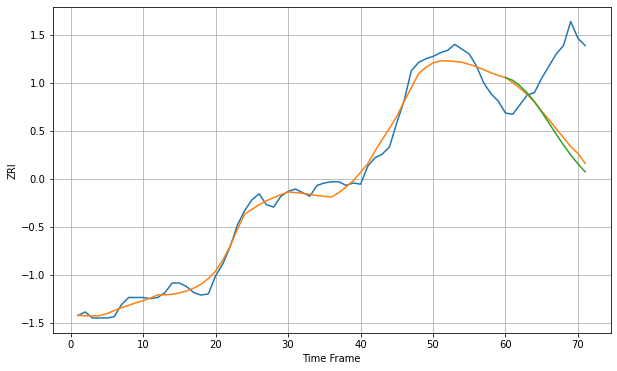

Wall time: 5.81 s
1013 7.787343690362597 60.326478341267176 64.75503604450242 [1128.52420836 1126.21325948 1121.54382289 1115.6578163  1108.37354717
 1099.86086942 1090.70485838 1081.4304884  1072.5167954  1064.28022114
 1056.84967158 1050.2211495 ]

Got an mse at 0.0098 in round 40 and stopped training

71 71 12


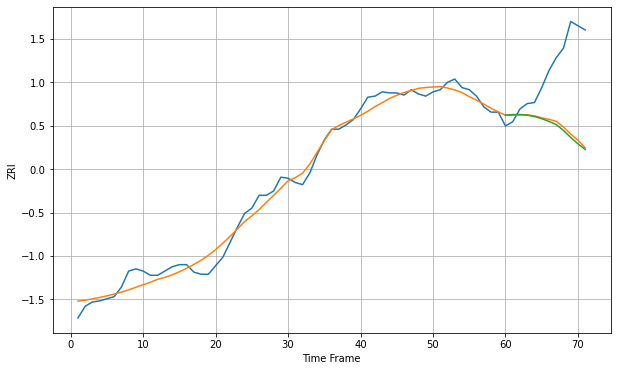

Wall time: 5.81 s
1020 8.011820336692784 62.74600329503929 64.62296688796681 [1125.17853892 1125.66361144 1125.74529418 1125.15894047 1123.84353824
 1121.83602187 1119.27082592 1116.35615558 1110.81218702 1104.27465516
 1098.26406188 1092.96061035]

Got an mse at 0.0099 in round 74 and stopped training

71 71 12


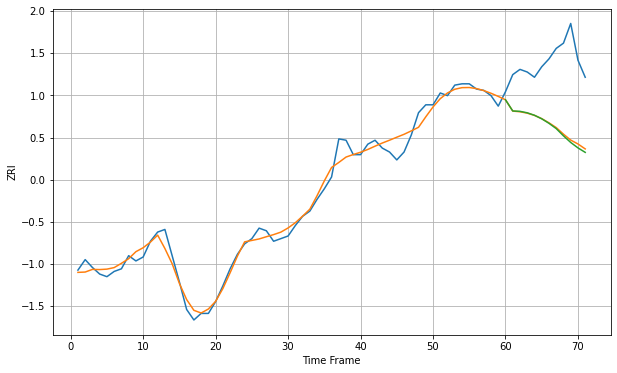

Wall time: 5.87 s
1040 6.351503060689156 50.85652268421754 51.89727791715781 [1105.80816531 1097.30232691 1097.02152225 1095.90110596 1094.02206399
 1091.34297393 1087.88782163 1083.86821717 1078.34963139 1073.29931787
 1069.15461944 1065.75691617]

Got an mse at 0.0099 in round 138 and stopped training

71 71 12


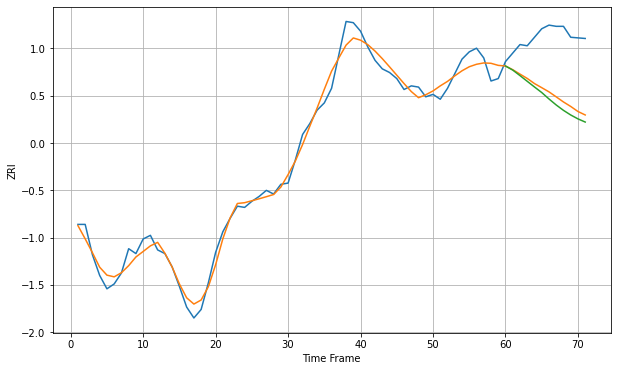

Wall time: 7.34 s
1085 7.698011568730215 46.951040191586074 51.70011609763723 [1168.33876622 1164.99361843 1160.45086712 1155.7595718  1151.08358595
 1146.51734436 1141.22487304 1136.26932907 1131.85337818 1128.03843925
 1124.83820036 1122.23162156]

Got an mse at 0.0099 in round 44 and stopped training

71 71 12


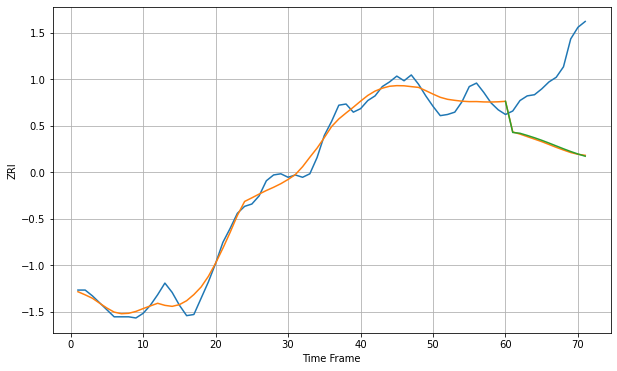

Wall time: 5.4 s
1104 7.879131993685647 66.08315342257389 65.60406625673335 [1124.31094605 1097.54618011 1096.84441013 1094.98656129 1092.99704728
 1090.80716492 1088.43835823 1085.96547418 1083.5000397  1081.15470848
 1079.01140119 1077.10869868]

Got an mse at 0.0097 in round 41 and stopped training

71 71 12


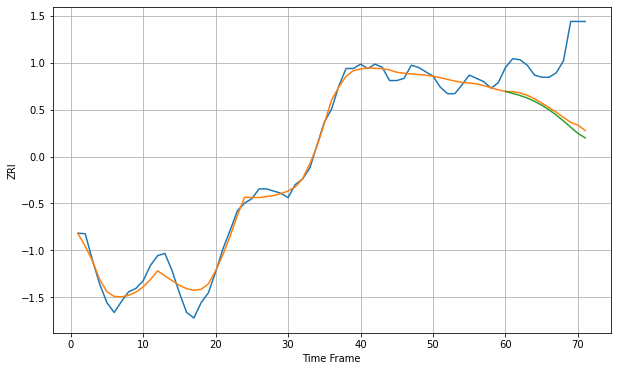

Wall time: 5.2 s
1108 8.272467227550944 54.93547803764682 58.585892337492425 [1176.01228603 1174.21902669 1172.38201723 1170.01468744 1167.05592976
 1163.48299613 1159.28289097 1154.46459112 1149.0903123  1143.31273152
 1137.7334077  1133.6201998 ]
71 71 12


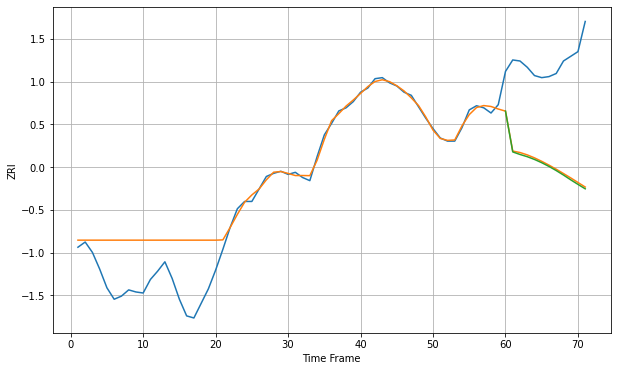

Wall time: 12.9 s
1109 26.627466253400083 99.53114223118719 100.9676842267129 [1150.81928596 1111.60916654 1109.16726199 1107.02542789 1104.37220025
 1101.23603203 1097.66165779 1093.69467981 1089.38458944 1084.78796731
 1080.42048353 1076.15713804]

Got an mse at 0.0100 in round 80 and stopped training

71 71 12


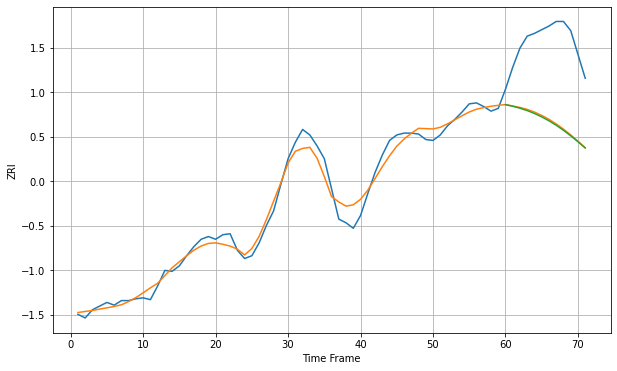

Wall time: 5.89 s
1420 9.595849134937012 88.22817556472222 89.27321091725732 [1235.15183984 1233.32561567 1231.22287065 1228.60818628 1225.45769643
 1221.74985992 1217.46343095 1212.58253182 1207.10764386 1201.07429196
 1194.57488672 1187.76744589]

Got an mse at 0.0100 in round 180 and stopped training

71 71 12


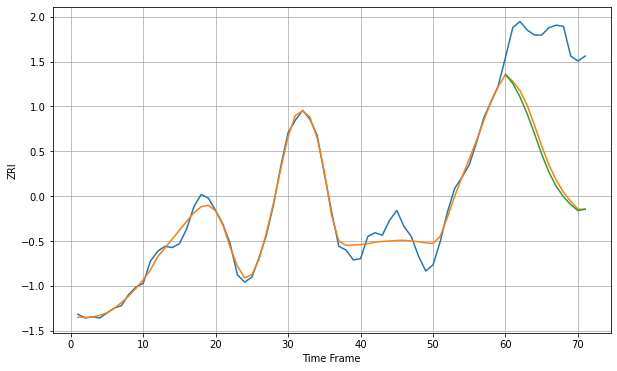

Wall time: 7.61 s
1440 7.225054282952016 96.66889607583565 100.20360648503166 [1201.07562081 1193.91978914 1182.92069774 1169.1481022  1153.12949805
 1136.55765056 1121.876835   1110.50819225 1102.12484433 1095.70514647
 1090.89212211 1092.08640856]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


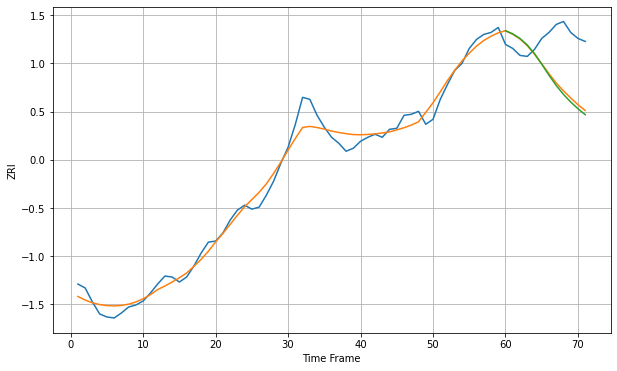

Wall time: 5.59 s
1453 9.549989209383007 45.563110828910446 47.95504009900055 [1332.73093853 1329.57677941 1324.96438264 1318.44541637 1309.79711581
 1299.2976516  1288.1978617  1277.87627288 1268.94345151 1261.29762858
 1254.62041203 1248.6443787 ]

Got an mse at 0.0100 in round 82 and stopped training

71 71 12


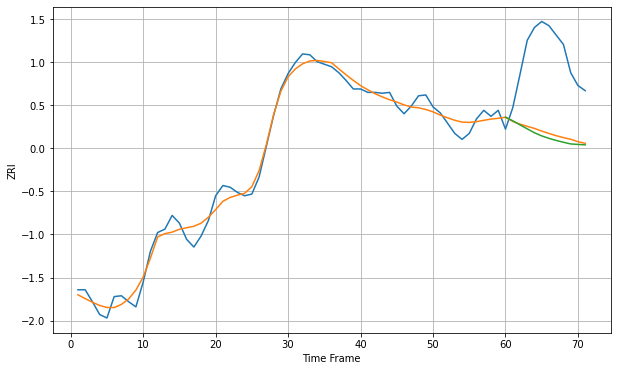

Wall time: 5.97 s
1545 10.00509303419539 91.3696193706644 95.37808392523489 [1514.95671367 1510.81801757 1505.96529124 1501.32135225 1496.73894473
 1493.06947432 1490.16191675 1487.74366629 1485.59818798 1483.65293629
 1483.11842953 1482.58983038]

Got an mse at 0.0100 in round 76 and stopped training

71 71 12


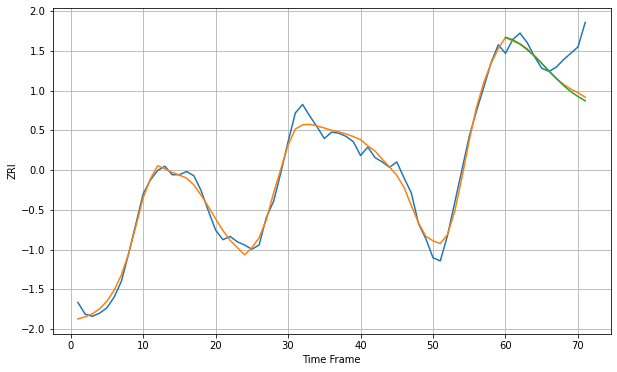

Wall time: 6.05 s
1550 7.338931180221097 27.28730121365461 28.800822847460633 [1247.94895806 1245.7859357  1241.71836885 1236.43889591 1230.29805882
 1223.59378495 1216.56345992 1209.51557736 1202.89379348 1197.12161416
 1192.45903154 1188.40849403]

Got an mse at 0.0100 in round 70 and stopped training

71 71 12


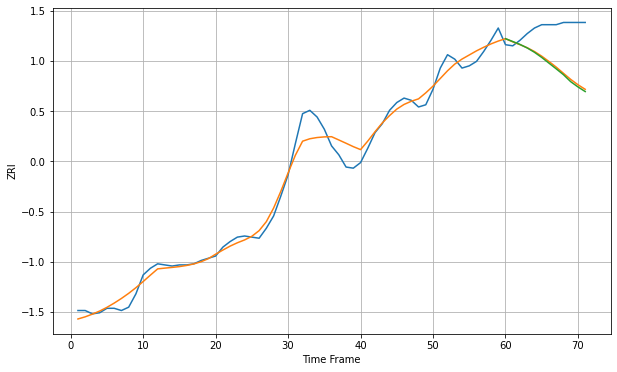

Wall time: 5.89 s
1602 8.981551104838285 35.91747876207793 37.193415185546826 [1395.42078208 1392.86733101 1390.24625601 1387.06587912 1383.17545178
 1378.54918849 1373.42231975 1368.28810334 1363.03910595 1356.75387252
 1352.04450363 1347.88034723]

Got an mse at 0.0094 in round 32 and stopped training

71 71 12


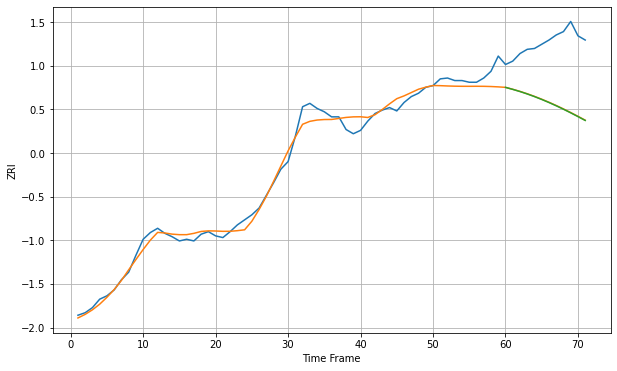

Wall time: 5.14 s
1603 9.643891311415834 73.39436765779143 73.66572133769145 [1273.93029673 1271.54306214 1268.98464143 1266.12741626 1262.99327844
 1259.60348735 1255.97359882 1252.11446571 1248.03711528 1243.7593527
 1239.31251065 1234.74682556]

Got an mse at 0.0095 in round 61 and stopped training

71 71 12


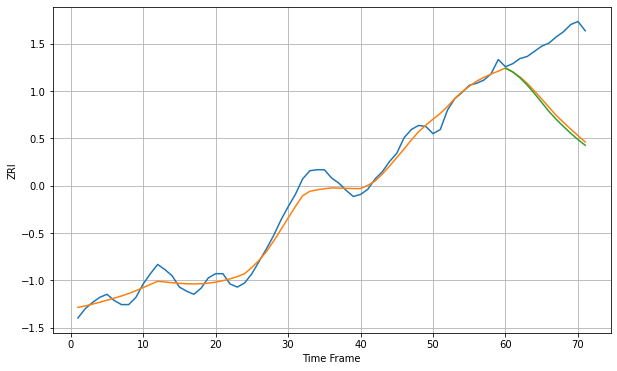

Wall time: 5.66 s
1604 8.69000616741614 68.87038544432451 71.7852689902592 [1342.719059   1338.90847728 1333.30910081 1326.16341169 1317.97941741
 1309.30986304 1300.59278986 1292.9337534  1285.97423237 1279.40343525
 1273.29482174 1267.75574522]

Got an mse at 0.0100 in round 43 and stopped training

71 71 12


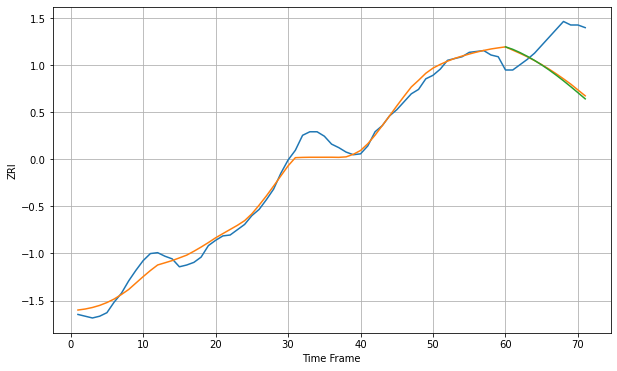

Wall time: 5.3 s
1605 10.392210371781152 46.40451140284245 48.167562456644724 [1325.21354866 1322.43598045 1318.74216247 1314.5491     1309.87488907
 1304.73118356 1299.14054444 1293.1404477  1286.78464958 1280.1414982
 1273.28928547 1266.30964833]

Got an mse at 0.0086 in round 31 and stopped training

71 71 12


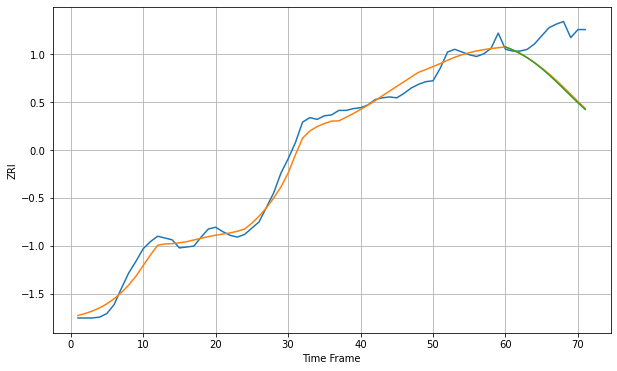

Wall time: 5.52 s
1610 9.498157791574599 51.48430263414449 52.458998744077064 [1322.65076953 1319.38802989 1315.47160454 1310.64397405 1304.99014079
 1298.60484978 1291.59202322 1284.0813535  1276.24448018 1268.3003707
 1260.49939436 1253.08718685]

Got an mse at 0.0100 in round 215 and stopped training

71 71 12


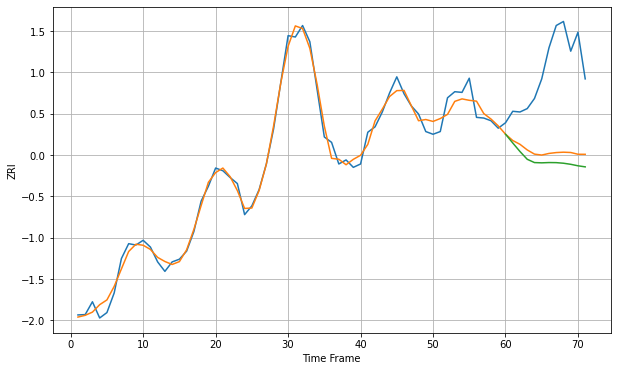

Wall time: 8.93 s
1702 12.174639756182454 126.68780794256328 139.71403693900845 [2260.14146251 2247.12274757 2234.41999664 2222.94349428 2218.07182453
 2217.69591451 2218.10137472 2217.98021529 2217.11581912 2215.51982622
 2213.32267196 2211.72867373]

Got an mse at 0.0098 in round 102 and stopped training

71 71 12


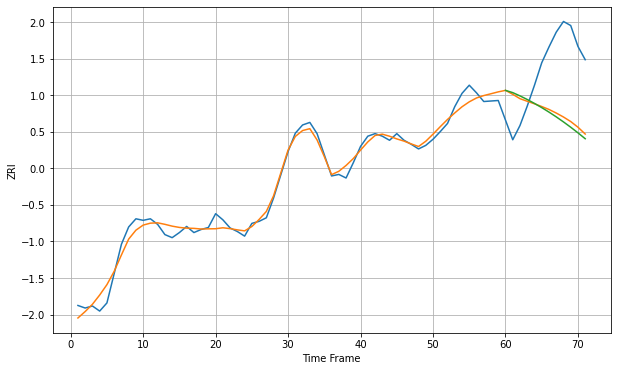

Wall time: 7.04 s
1752 14.12503899763613 122.46066855573996 128.99991963827247 [2086.88588535 2082.42777747 2076.04291531 2068.95605452 2061.27505515
 2053.03610148 2044.25054197 2034.91122871 2025.01469258 2014.57646355
 2003.59711616 1992.0371406 ]

Got an mse at 0.0100 in round 223 and stopped training

71 71 12


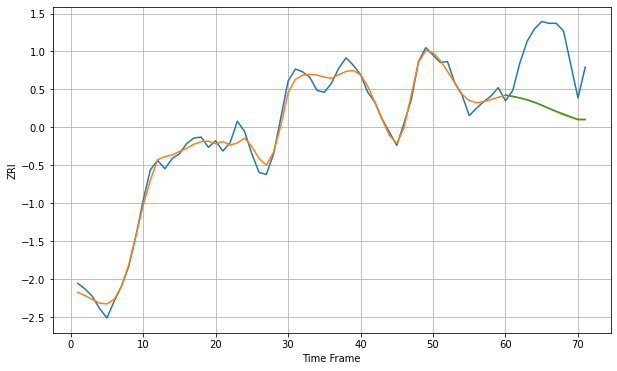

Wall time: 9.47 s
1757 8.096487163256741 65.88582429317022 65.7091328226726 [1448.0042462  1446.61787349 1444.9561375  1442.8108471  1440.19410431
 1437.16361996 1433.81592703 1430.61799921 1427.73248415 1424.77696692
 1421.91019418 1422.06257936]

Got an mse at 0.0100 in round 223 and stopped training

71 71 12


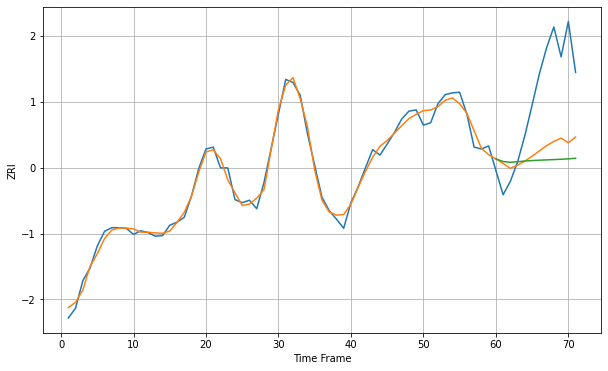

Wall time: 9.36 s
1760 10.707759964928915 114.60485777167361 133.5587833129908 [2273.76110769 2269.45641794 2268.129559   2269.11227749 2270.17877375
 2271.00298749 2271.61363734 2272.10803191 2272.59083577 2273.15339926
 2273.86349946 2274.76144856]

Got an mse at 0.0099 in round 140 and stopped training

71 71 12


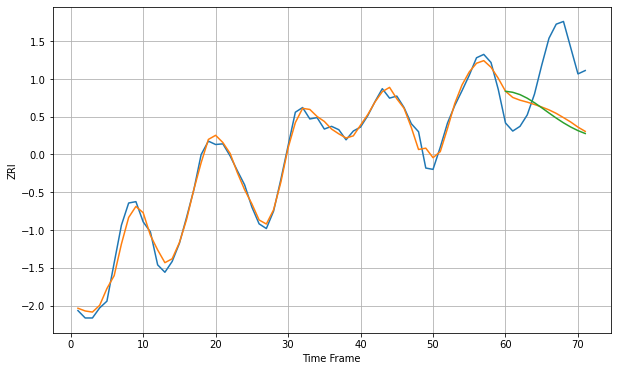

Wall time: 8.43 s
1801 11.11285679242667 85.0356197012106 89.89128972375117 [2250.22384296 2248.65985384 2245.20798296 2239.85216801 2233.13391198
 2225.63419782 2217.87766706 2210.30942819 2203.27756649 2197.01881323
 2191.65648522 2187.34465898]

Got an mse at 0.0100 in round 226 and stopped training

71 71 12


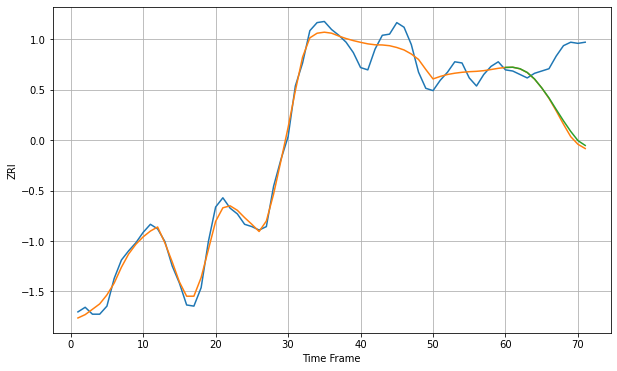

Wall time: 10.3 s
1830 8.69575117706445 50.64391395207327 48.71393905333535 [1628.11049073 1628.29544305 1626.99059783 1623.74875169 1618.12020418
 1610.3742658  1601.65877861 1591.62846772 1581.80631058 1572.61451013
 1564.60915786 1560.42859252]

Got an mse at 0.0100 in round 137 and stopped training

71 71 12


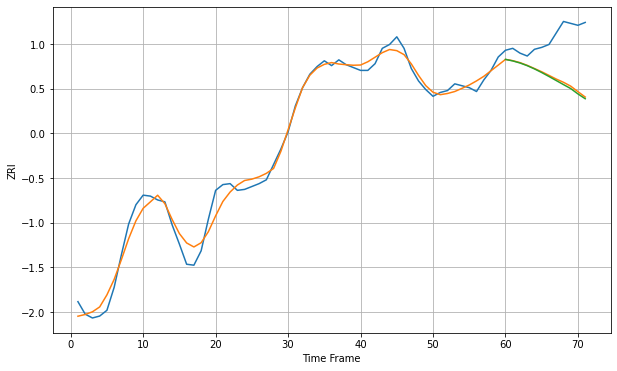

Wall time: 8.41 s
1832 9.22871066719263 44.68263612325001 46.12087867508478 [1577.47228653 1575.88958806 1573.72523088 1570.92986185 1567.56433979
 1563.7546974  1559.6615012  1555.44212585 1551.21919588 1547.06494066
 1541.46798116 1536.4827069 ]

Got an mse at 0.0099 in round 196 and stopped training

71 71 12


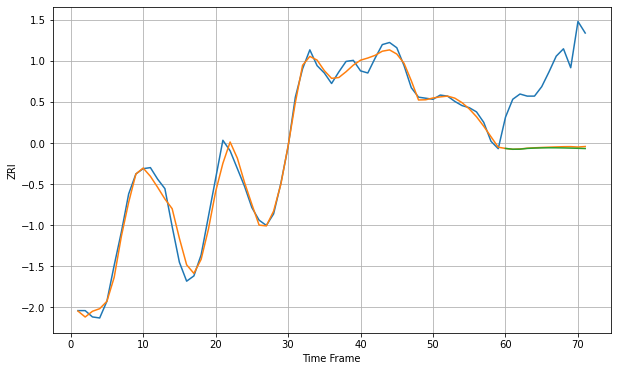

Wall time: 9.5 s
1841 7.710351105562269 74.6556721696161 75.46884013370988 [1562.24044745 1561.49406978 1561.55159287 1562.26588723 1562.58819315
 1562.78804741 1562.86540991 1562.83734464 1562.72893812 1562.56502499
 1562.36642634 1562.1496247 ]

Got an mse at 0.0099 in round 166 and stopped training

71 71 12


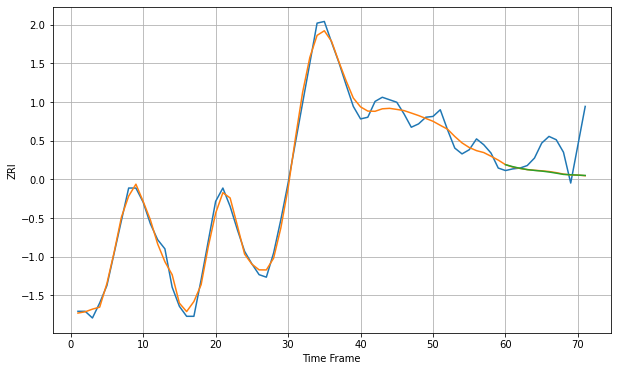

Wall time: 8.24 s
1843 9.14458048129405 33.878683412521234 34.00578602320087 [1679.06420588 1676.66843662 1674.70142719 1673.13784846 1672.17545991
 1671.36499355 1670.26112186 1668.8766044  1667.36375065 1666.95141005
 1666.51401776 1666.12272865]

Got an mse at 0.0098 in round 147 and stopped training

71 71 12


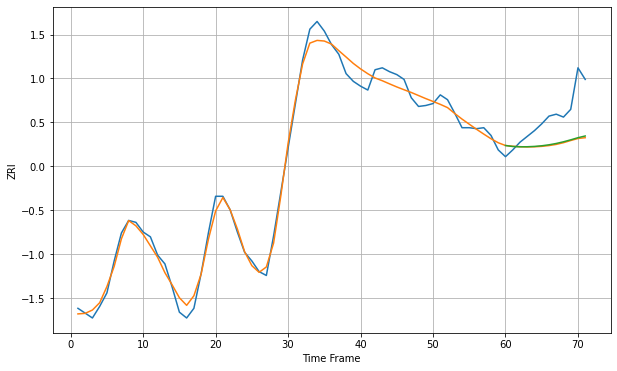

Wall time: 7.24 s
1844 8.952407663584452 33.8645513748114 33.14665684885654 [1678.57014432 1677.53322131 1677.21624995 1677.28981529 1677.63198999
 1678.28999288 1679.29830549 1680.67583645 1682.4094685  1684.43930676
 1686.65389585 1688.43249248]

Got an mse at 0.0099 in round 134 and stopped training

71 71 12


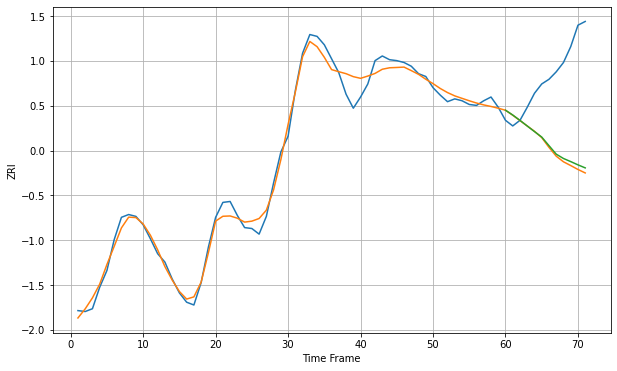

Wall time: 7.22 s
1845 9.511168624066901 89.91541540873948 87.22067777508167 [1804.82896123 1799.70093597 1793.93642268 1787.92750581 1781.91849757
 1776.05473788 1766.85310904 1757.72679404 1753.08257326 1749.75328689
 1746.26141705 1743.01468775]

Got an mse at 0.0098 in round 129 and stopped training

71 71 12


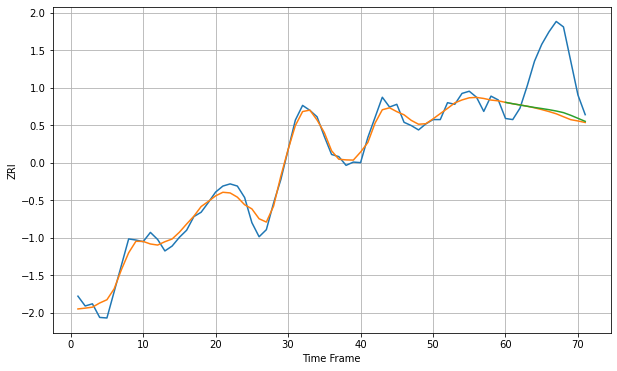

Wall time: 7.05 s
1850 13.558600180548135 98.35592157881693 94.97962820798057 [1994.58879995 1992.11020524 1989.75561768 1987.4205904  1985.19842824
 1983.25838052 1981.14384784 1978.70735058 1975.73344317 1970.87318688
 1965.31706822 1959.71740442]

Got an mse at 0.0100 in round 128 and stopped training

71 71 12


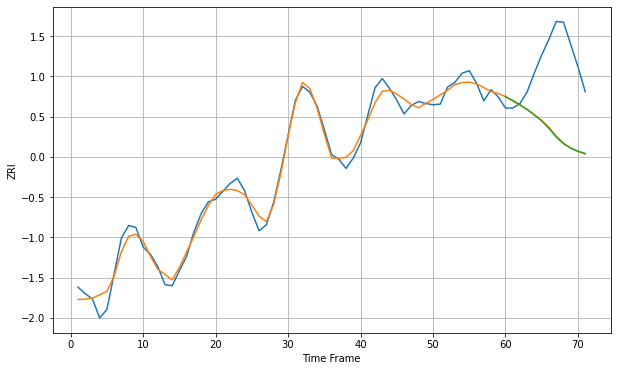

Wall time: 7.35 s
1851 12.169956241749476 111.22503641870016 111.8014860577025 [2002.53902075 1996.63453226 1990.02545052 1982.66895991 1974.33256932
 1965.29761316 1953.97746914 1940.64175521 1930.59052743 1923.82639944
 1919.21957082 1915.6928574 ]

Got an mse at 0.0099 in round 190 and stopped training

71 71 12


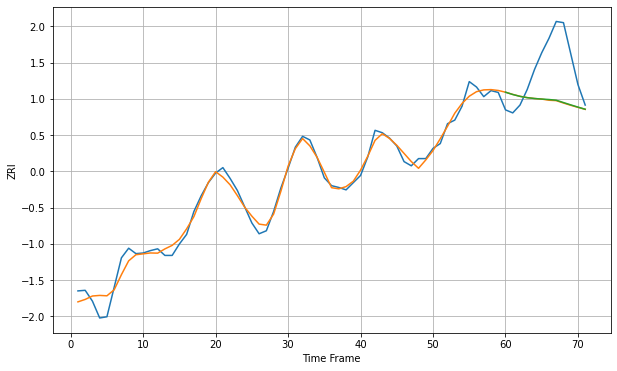

Wall time: 8.95 s
1852 11.886727885195285 73.65321013903016 73.19158428934325 [1994.39535672 1990.56215985 1987.4670948  1985.31109094 1983.91890097
 1982.98045244 1982.23375562 1981.05163009 1977.17289372 1973.33535774
 1969.61431995 1966.07988012]

Got an mse at 0.0100 in round 167 and stopped training

71 71 12


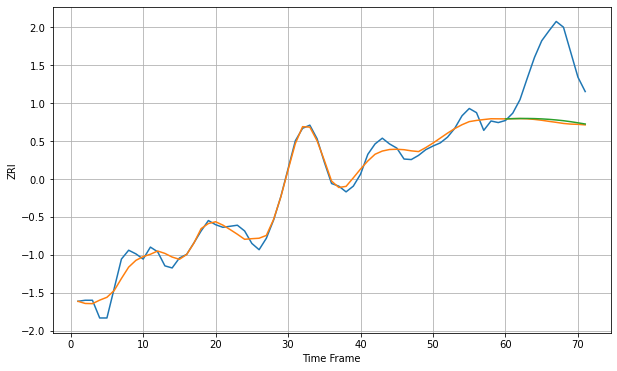

Wall time: 8.96 s
1854 14.449879437767784 121.78966151088854 118.93655328003173 [2015.08974726 2015.46555849 2015.79822272 2015.84380863 2015.59255559
 2015.03401511 2014.16433125 2012.99066292 2011.53491278 2009.64704217
 2007.51138935 2005.22076965]

Got an mse at 0.0100 in round 171 and stopped training

71 71 12


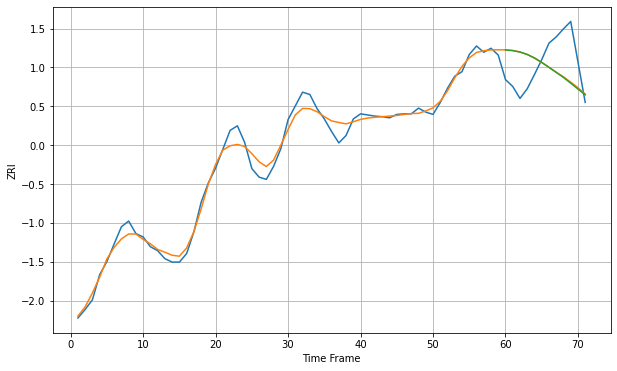

Wall time: 8.93 s
1876 13.474865033031936 60.62058606868675 61.145324004625934 [2203.1076539  2201.848998   2199.32971931 2195.12025949 2188.99976565
 2181.22240418 2172.51906172 2163.60244598 2154.80339171 2144.7586039
 2134.49947265 2124.3407682 ]

Got an mse at 0.0099 in round 181 and stopped training

71 71 12


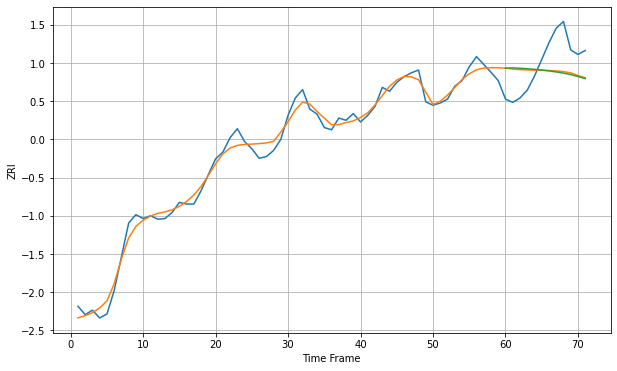

Wall time: 9.15 s
1880 13.587752474487752 52.39947532098758 54.014127484618975 [2232.48287634 2232.85011733 2232.18772106 2231.31944338 2230.26356861
 2228.99128792 2227.46335288 2225.63705509 2223.47088457 2220.9024914
 2217.48917387 2213.64676092]

Got an mse at 0.0099 in round 83 and stopped training

71 71 12


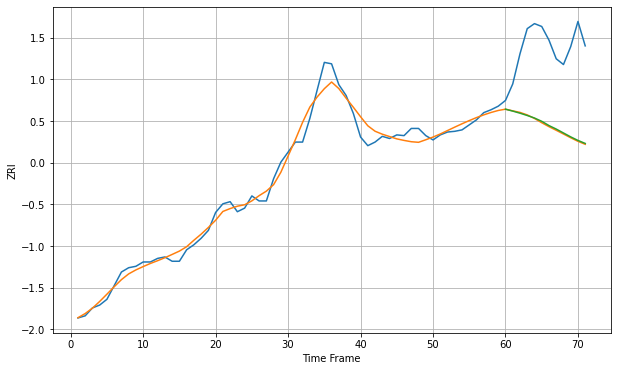

Wall time: 7.37 s
1902 11.511441745743832 113.53964890305811 112.68119803831378 [1749.80747017 1747.15182906 1744.22892656 1741.02240389 1737.51326444
 1732.93954449 1726.98520191 1722.11870488 1716.68479114 1711.23799265
 1706.30168621 1702.11085714]

Got an mse at 0.0099 in round 172 and stopped training

71 71 12


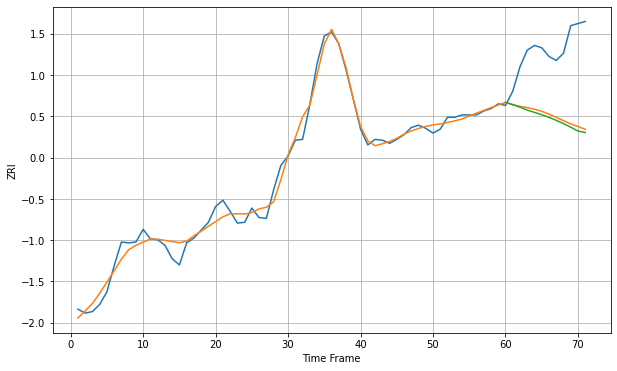

Wall time: 9.42 s
1905 10.368634026879088 86.60647123869875 90.14185184627824 [1759.91991758 1757.10903352 1753.768169   1750.11944167 1747.20347884
 1744.21617598 1740.8730976  1737.12842339 1732.97691344 1728.44326821
 1723.57528042 1721.73887881]

Got an mse at 0.0099 in round 135 and stopped training

71 71 12


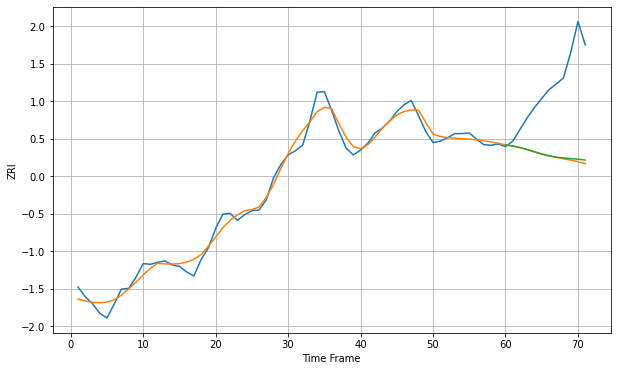

Wall time: 8.23 s
1915 10.790290617763722 109.46904359280246 107.87532554204847 [1820.62400933 1818.98111179 1816.68450333 1813.78444999 1810.45511781
 1807.20485241 1804.57800415 1802.77985866 1801.61172318 1800.70686072
 1799.7534812  1798.56222595]

Got an mse at 0.0099 in round 201 and stopped training

71 71 12


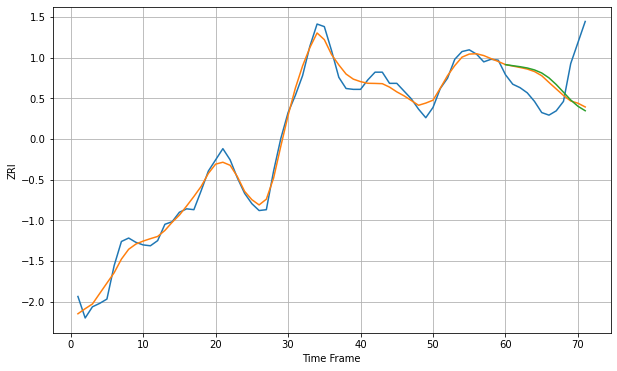

Wall time: 9.52 s
1930 9.371048048948754 44.594698658660405 47.00705135979523 [1778.7822774  1777.54399454 1776.3672075  1774.88224448 1772.61639214
 1769.05942427 1763.36488542 1755.63192075 1746.69337502 1737.62777921
 1730.30745069 1725.12653086]

Got an mse at 0.0099 in round 118 and stopped training

71 71 12


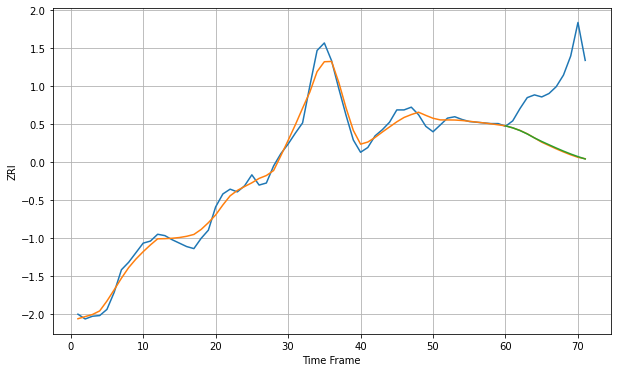

Wall time: 7.71 s
1960 11.002262593191162 99.85386704927079 99.26133439048067 [1794.68247211 1791.76747162 1787.79936236 1782.81364262 1776.99540699
 1771.82092028 1767.00054369 1762.24256014 1757.70371546 1753.48441731
 1749.64150585 1746.19664351]

Got an mse at 0.0099 in round 90 and stopped training

71 71 12


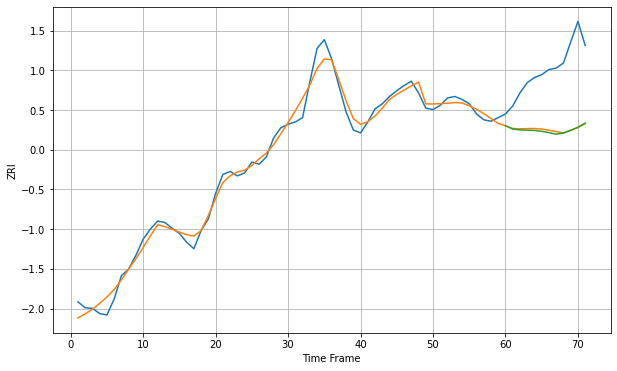

Wall time: 7.36 s
1970 10.767309007585899 86.29295794329144 87.36180398063469 [1820.82116224 1816.29135083 1815.13428732 1814.81043682 1814.35606771
 1813.20649594 1811.38709002 1809.24315168 1810.87762334 1814.57923445
 1818.7870144  1824.49212336]

Got an mse at 0.0099 in round 131 and stopped training

71 71 12


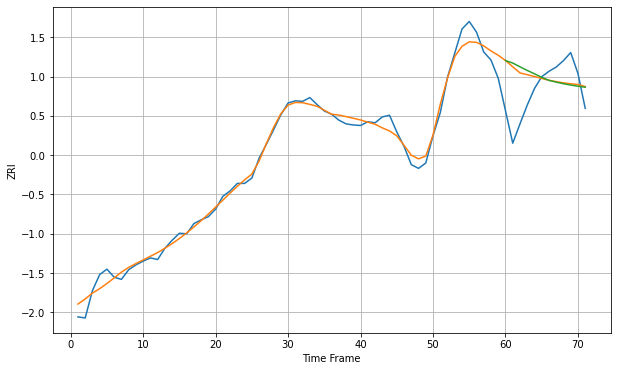

Wall time: 8.51 s
2026 14.487704951080998 64.56646012229895 68.36636558053101 [2292.15329572 2287.44346523 2280.40823728 2273.64980185 2267.39138371
 2260.81020763 2255.20534378 2251.77643865 2248.88157225 2246.38077848
 2244.23002949 2242.39145399]

Got an mse at 0.0099 in round 90 and stopped training

71 71 12


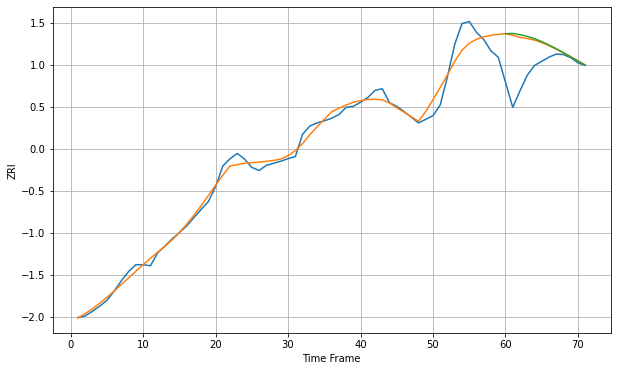

Wall time: 7.39 s
2062 16.11980745893703 63.403500251301615 65.51023890751551 [2231.37926136 2231.86699522 2229.65002577 2226.22444602 2221.66643839
 2216.06204232 2209.55840118 2202.35340629 2194.67047843 2186.7288341
 2178.71960652 2170.79337353]

Got an mse at 0.0100 in round 74 and stopped training

71 71 12


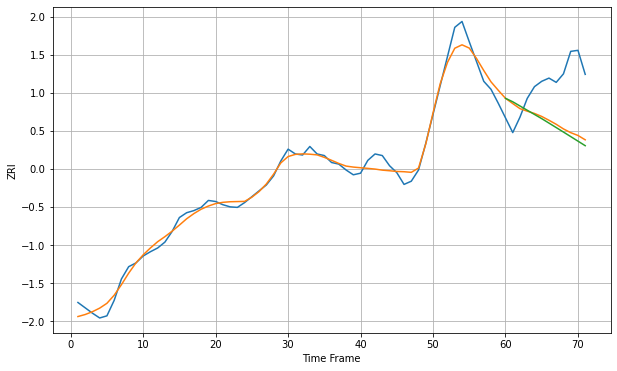

Wall time: 6.83 s
2072 14.038534641260377 90.6218415331628 96.3940920596649 [1967.16924532 1960.68284331 1952.76617695 1944.82283113 1936.97451658
 1929.08726791 1920.76484935 1912.39198657 1903.97522803 1895.50342946
 1886.98811151 1878.47573181]

Got an mse at 0.0099 in round 111 and stopped training

71 71 12


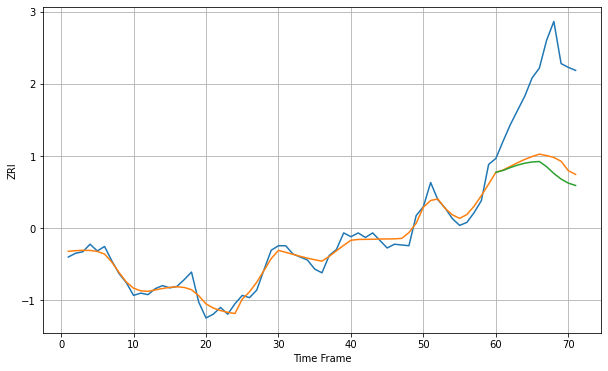

Wall time: 7.74 s
2111 9.47034518161814 112.44964849722238 124.45428693846544 [2835.53287985 2838.09702572 2841.84752801 2845.17396399 2847.70560553
 2849.27055631 2849.92096366 2843.0212952  2834.01962109 2826.60612099
 2821.18680969 2818.06779656]

Got an mse at 0.0099 in round 130 and stopped training

71 71 12


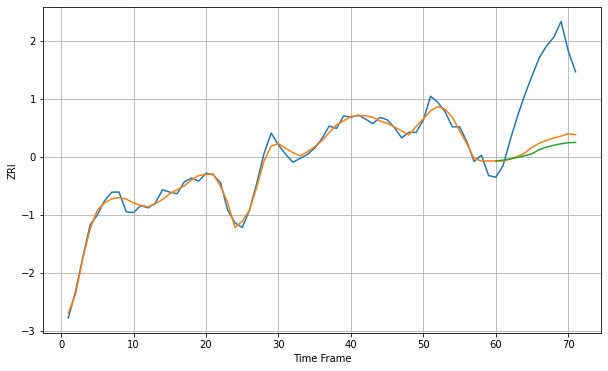

Wall time: 8.26 s
2113 7.293997962939041 90.74166033354803 97.70533108767415 [2614.66336958 2615.65970467 2617.32616654 2619.08973106 2621.37089598
 2623.84870176 2629.13185022 2632.29156129 2634.65782047 2636.48158146
 2637.86670134 2638.22651088]

Got an mse at 0.0099 in round 240 and stopped training

71 71 12


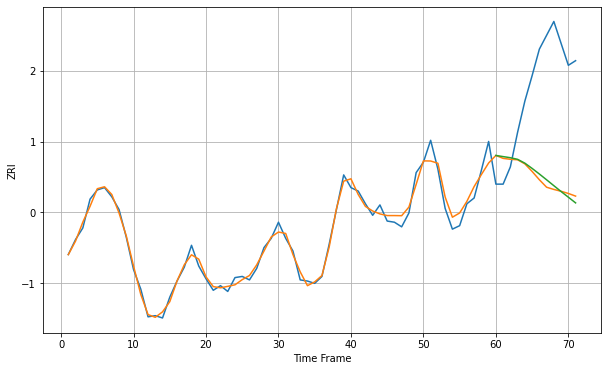

Wall time: 10.4 s
2114 6.0428964513100425 93.74747257466127 92.89573118225184 [2782.8856039  2781.86785072 2780.91356432 2779.49617626 2776.19384415
 2771.63560119 2766.78904766 2761.75907312 2756.65820272 2751.59792347
 2746.69135834 2741.75960238]

Got an mse at 0.0099 in round 205 and stopped training

71 71 12


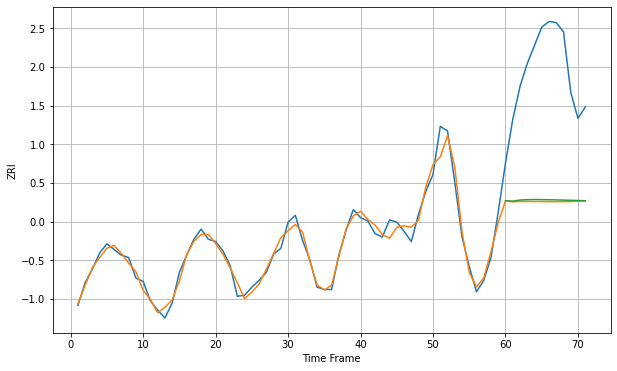

Wall time: 10.2 s
2115 6.707417042128485 117.7101462264135 116.48292720249304 [2919.75022867 2919.45093574 2920.38705078 2920.7510768  2920.84779627
 2920.80811784 2920.69663741 2920.5458555  2920.3722642  2920.18431641
 2919.98668822 2919.782655  ]

Got an mse at 0.0100 in round 144 and stopped training

71 71 12


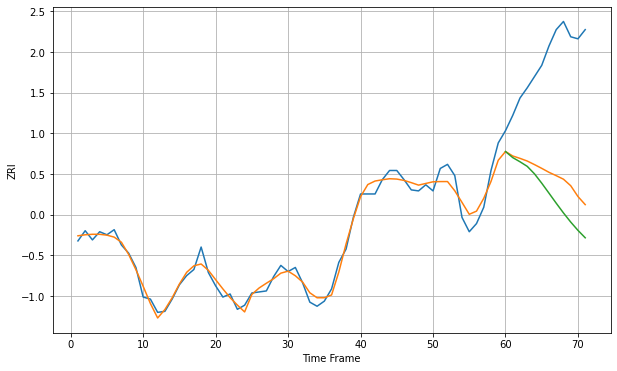

Wall time: 8.6 s
2116 7.882732144181725 116.36653895447186 138.14743119312695 [2801.58775782 2795.62517094 2791.53111106 2787.05131739 2779.72028313
 2770.56327967 2760.79235813 2750.94760373 2741.41026579 2732.47225709
 2724.3375039  2717.06964321]

Got an mse at 0.0100 in round 226 and stopped training

71 71 12


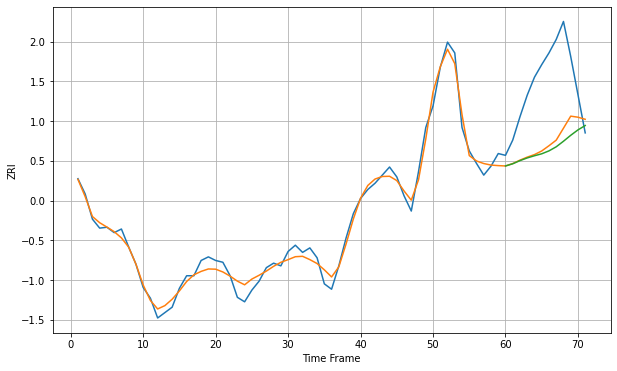

Wall time: 10.5 s
2118 8.753386785510221 74.82559424361607 81.05276545613101 [2941.17381989 2943.61701448 2947.14193625 2950.12431379 2952.5504437
 2954.72756656 2957.9720624  2962.51417431 2968.69354487 2975.3086901
 2981.31665734 2986.17687415]

Got an mse at 0.0099 in round 240 and stopped training

71 71 12


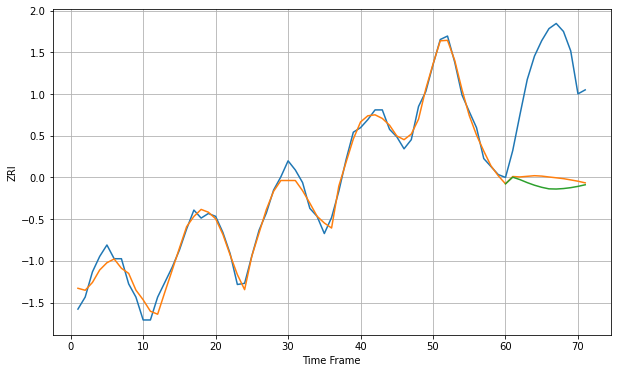

Wall time: 10.6 s
2119 14.468133241205019 193.37572738146932 206.5972539265761 [2771.84505701 2783.44043257 2779.19119684 2773.95226978 2769.40277518
 2765.76238874 2763.07609867 2762.76177612 2763.59025937 2765.14314386
 2767.39386678 2770.20059914]

Got an mse at 0.0100 in round 132 and stopped training

71 71 12


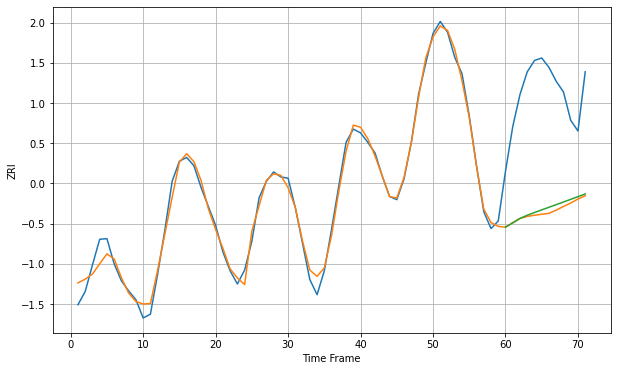

Wall time: 8.02 s
2120 12.618922440445537 191.7359762643343 187.30868624700202 [3092.23247475 3099.09413812 3106.1024758  3111.1864869  3115.50769749
 3119.72336906 3123.88030165 3128.03794471 3132.22945219 3136.46355469
 3140.72768323 3144.9924549 ]

Got an mse at 0.0099 in round 249 and stopped training

71 71 12


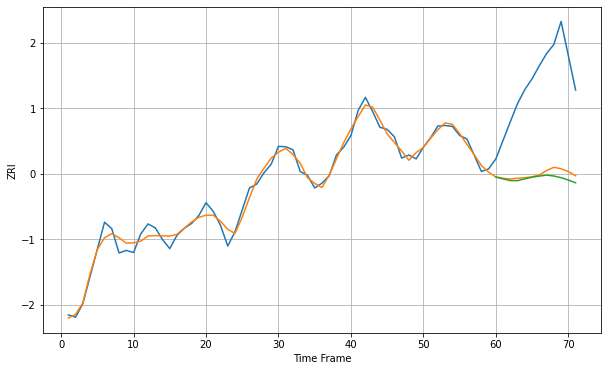

Wall time: 10.6 s
2121 14.994818093874883 222.03569565341846 232.27626932702685 [2370.27347165 2365.7775427  2361.97491511 2361.86455228 2366.12297441
 2369.7525695  2372.37160676 2374.64794602 2372.56847975 2368.62482157
 2363.21501454 2356.88752894]

Got an mse at 0.0099 in round 98 and stopped training

71 71 12


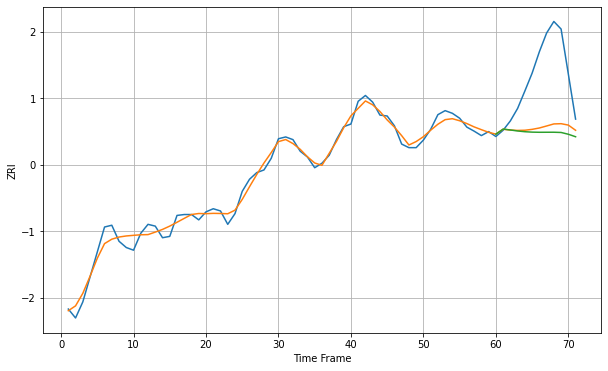

Wall time: 7.66 s
2122 14.728109405145652 132.51377304991198 143.23611878521965 [2413.31183005 2424.64847389 2422.63422954 2420.37441535 2418.74407578
 2417.79767506 2417.47143903 2417.53248784 2417.56775495 2417.03992396
 2413.04851307 2407.46938503]

Got an mse at 0.0100 in round 188 and stopped training

71 71 12


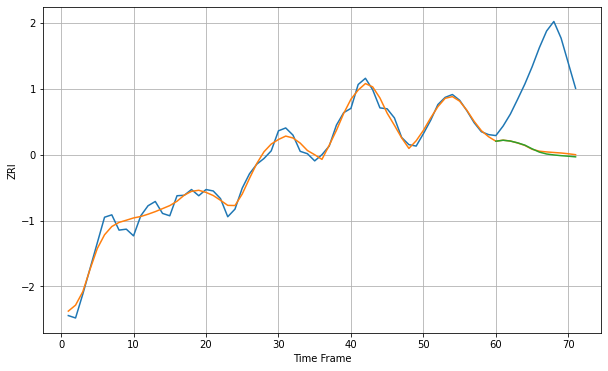

Wall time: 9.2 s
2124 13.713260545990321 172.8216023894313 175.533848621287 [2295.18485181 2297.23617264 2295.53222821 2291.81057449 2286.96732364
 2279.26807204 2272.40611765 2268.42525116 2266.46653671 2264.94798156
 2263.77657703 2262.45224437]

Got an mse at 0.0099 in round 185 and stopped training

71 71 12


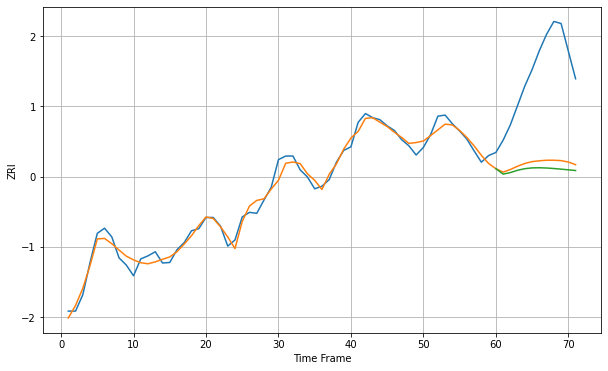

Wall time: 9.39 s
2125 13.574324126856304 184.68821882168263 196.5218160455813 [2472.3024105  2461.68198601 2464.67230135 2469.21828809 2472.32471417
 2473.84154567 2474.13574267 2473.62601532 2472.64172606 2471.40731773
 2470.0671685  2468.71301297]

Got an mse at 0.0100 in round 152 and stopped training

71 71 12


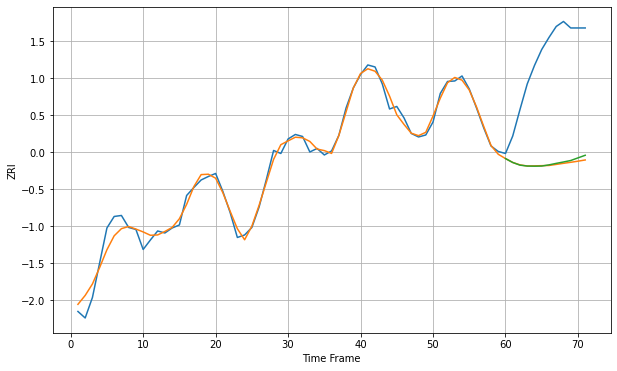

Wall time: 9.08 s
2126 14.683746855115684 218.21750329345863 215.77023475127115 [2276.77233488 2268.94808871 2263.64999198 2261.84653719 2261.59822219
 2261.84147514 2264.18130659 2267.18917124 2269.97115493 2272.9146366
 2278.17040787 2283.38686696]

Got an mse at 0.0099 in round 255 and stopped training

71 71 12


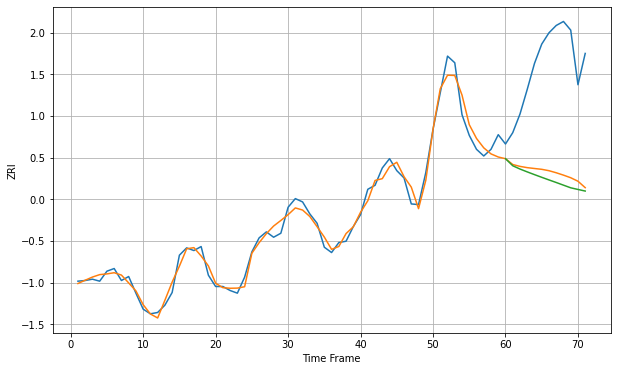

Wall time: 11 s
2127 12.390517411384232 168.038278095483 178.27611977443473 [2838.92354881 2828.33325014 2823.38917542 2819.10913748 2814.99778418
 2810.98202648 2807.04415363 2803.18193737 2799.18030432 2795.2157197
 2792.74653713 2790.33722059]

Got an mse at 0.0100 in round 88 and stopped training

71 71 12


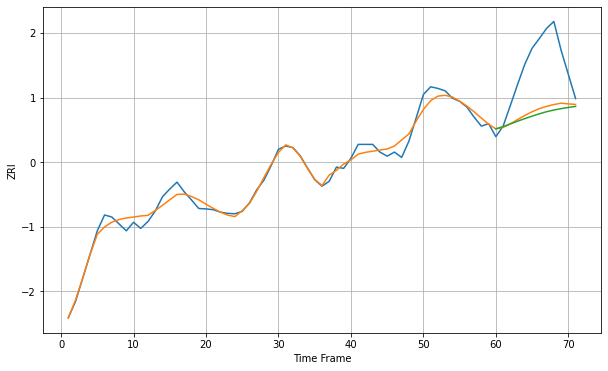

Wall time: 7.36 s
2128 15.73588925897351 123.07713850237425 131.89940492344877 [2479.17802736 2484.80814792 2491.51201538 2498.17728499 2504.59623431
 2510.67265786 2516.34371105 2521.56932892 2525.73472187 2529.10995794
 2532.07061124 2534.64423651]

Got an mse at 0.0100 in round 372 and stopped training

71 71 12


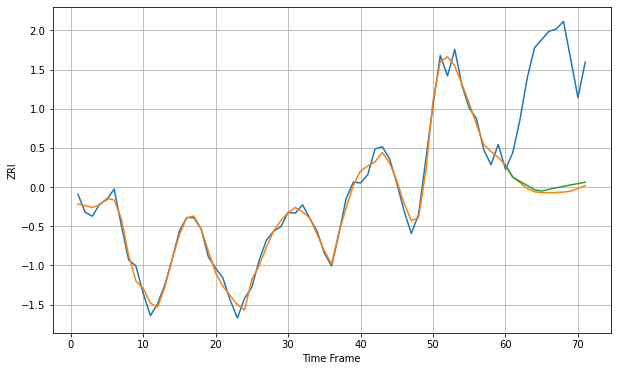

Wall time: 12.6 s
2129 10.340479552264087 163.97050048239487 159.5962691683146 [2781.36246046 2765.60021758 2760.08874334 2754.59843973 2748.9945152
 2747.34259997 2749.52720755 2751.52808653 2753.4724033  2755.3543455
 2757.16513072 2758.89225165]

Got an mse at 0.0099 in round 162 and stopped training

71 71 12


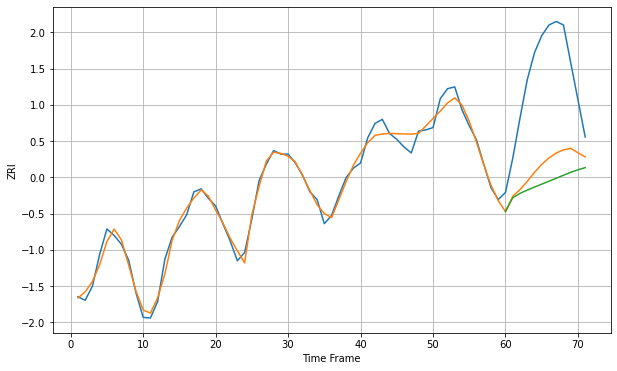

Wall time: 8.75 s
2130 12.166789783872497 161.83796036929385 189.20528330473047 [2588.43063757 2611.89975772 2619.31343709 2624.93147526 2630.05765887
 2635.01950999 2639.99093382 2645.0341327  2650.10431562 2655.07895524
 2659.40588472 2663.04387765]

Got an mse at 0.0097 in round 128 and stopped training

71 71 12


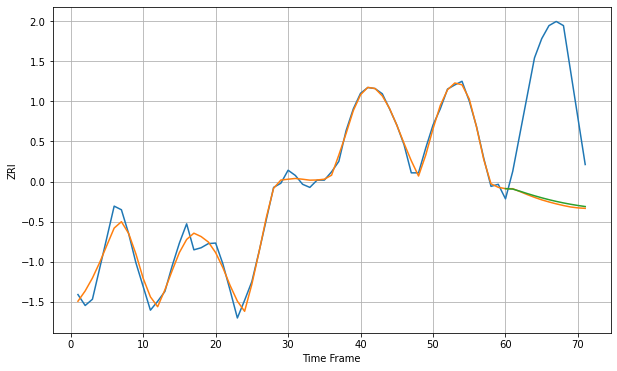

Wall time: 8.14 s
2131 15.035677798759888 238.01280314741544 234.58358407419084 [2386.60506735 2385.79013415 2381.66695693 2377.18258479 2372.95031241
 2369.01068762 2365.39300341 2362.10995502 2359.16226605 2356.54118465
 2354.22972384 2352.20331097]

Got an mse at 0.0099 in round 109 and stopped training

71 71 12


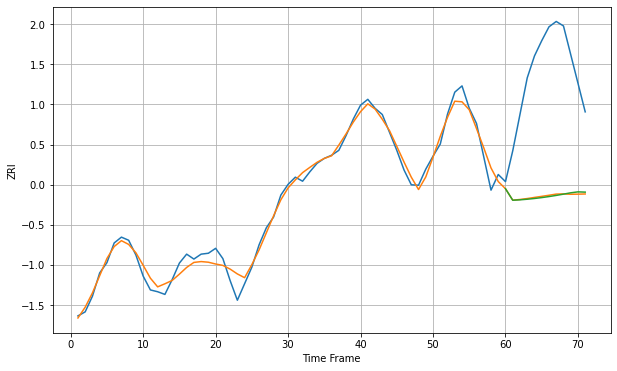

Wall time: 7.98 s
2132 17.697107279636175 283.78059039144034 284.29285415083183 [2357.16615303 2331.49755961 2332.39469062 2333.74665705 2335.40905711
 2337.39018736 2339.68548467 2342.27036887 2345.09396306 2348.07548326
 2350.18780139 2349.57625308]

Got an mse at 0.0100 in round 187 and stopped training

71 71 12


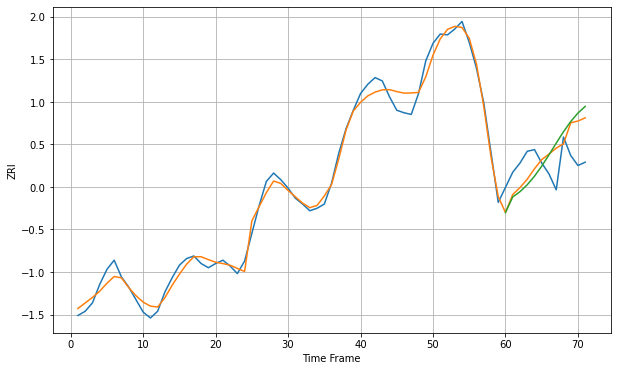

Wall time: 9.62 s
2134 10.094692775524114 34.610510136961 40.02847382310815 [2571.89903312 2590.49166801 2596.80024205 2605.06513877 2615.26323024
 2627.2876025  2640.71356556 2654.74432715 2668.34259724 2680.52777105
 2690.66638268 2698.57306772]

Got an mse at 0.0099 in round 164 and stopped training

71 71 12


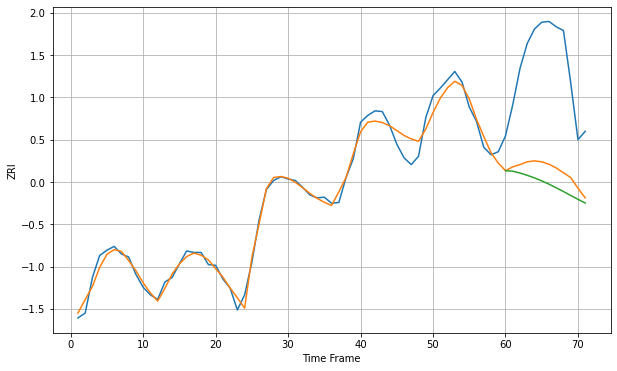

Wall time: 8.9 s
2135 11.041081217133778 143.38107734550334 162.1689716670625 [2701.96218397 2701.27902542 2698.83093753 2695.85329362 2692.44548654
 2688.52377751 2684.16895963 2679.43097858 2674.40778581 2669.25388196
 2664.16057799 2659.3181725 ]

Got an mse at 0.0096 in round 146 and stopped training

71 71 12


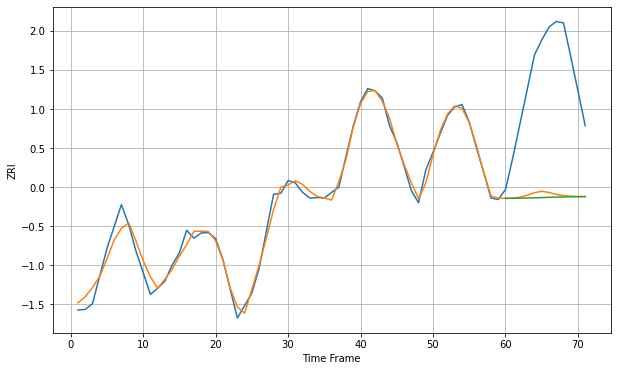

Wall time: 8.68 s
2136 15.837365559187404 261.5642599825101 266.7713767694474 [2349.43614677 2349.48531929 2349.71747245 2350.07245332 2350.50221992
 2350.99540227 2351.51739979 2352.00142065 2352.3899797  2352.66576328
 2352.8485055  2352.97369624]

Got an mse at 0.0100 in round 91 and stopped training

71 71 12


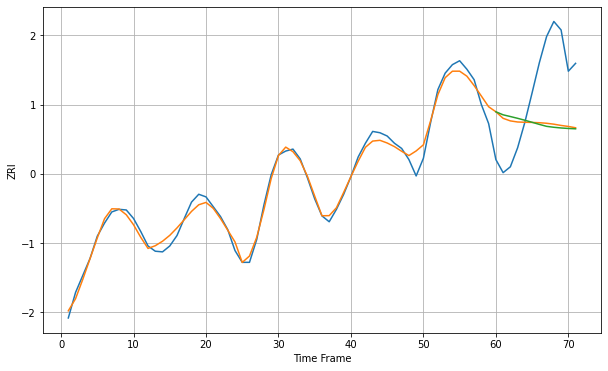

Wall time: 7.62 s
2138 10.405520891038643 95.48477768665067 98.74727083320357 [2594.00880953 2589.3830209  2586.7529685  2584.03054203 2581.07912578
 2577.94828815 2574.74581726 2571.76672108 2570.34372141 2569.29133115
 2568.52899759 2568.00453181]

Got an mse at 0.0099 in round 129 and stopped training

71 71 12


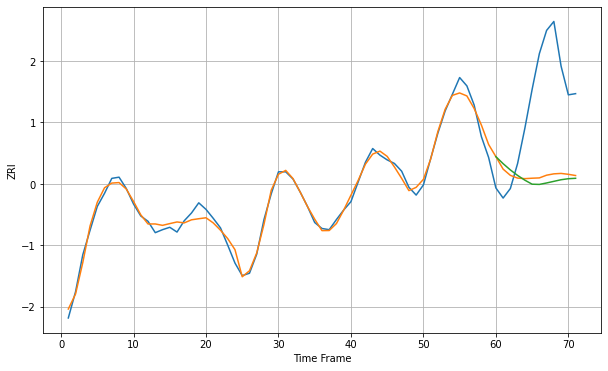

Wall time: 7.95 s
2139 10.067646925436824 150.49653481966303 158.5195661896464 [2634.40539244 2622.62752894 2612.12887152 2602.91061225 2594.96033643
 2588.24070966 2587.86153556 2590.29204539 2593.01101551 2595.71375904
 2597.42479554 2598.1387663 ]

Got an mse at 0.0098 in round 122 and stopped training

71 71 12


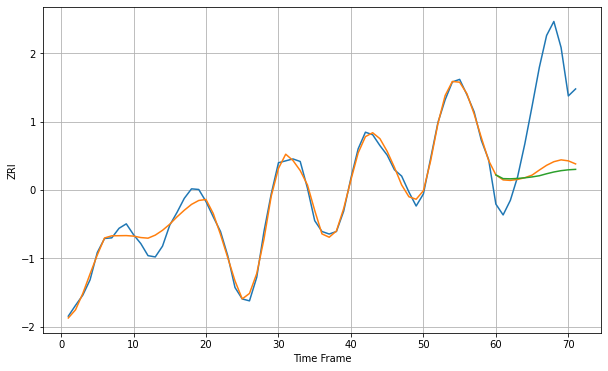

Wall time: 7.83 s
2140 10.58887380339515 126.63328963641243 135.65825647493875 [2557.90949844 2552.0482673  2551.77134388 2552.32572053 2553.3692034
 2554.73793324 2556.58165484 2559.71023473 2562.47028807 2564.561195
 2565.91400221 2566.6096949 ]

Got an mse at 0.0099 in round 141 and stopped training

71 71 12


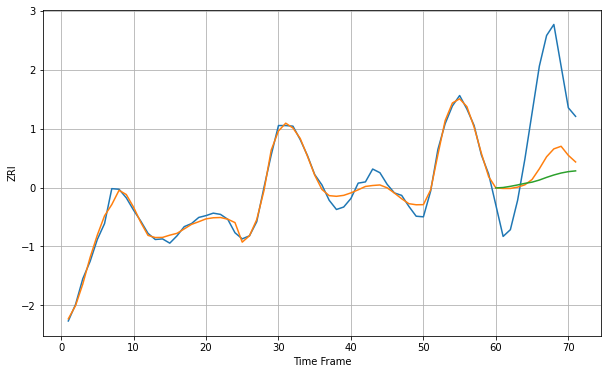

Wall time: 8.49 s
2141 9.49669387843067 116.4546934986878 136.9453029828017 [2541.15892791 2541.87113698 2543.76819917 2546.05041535 2548.60179814
 2550.61654879 2554.03861235 2558.40421851 2562.28940464 2565.49710537
 2567.75171847 2568.99844433]

Got an mse at 0.0100 in round 168 and stopped training

71 71 12


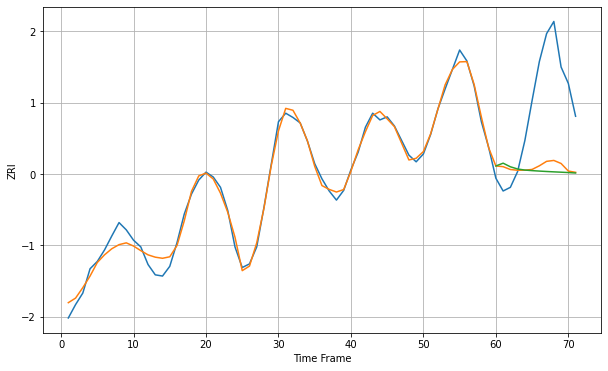

Wall time: 9.45 s
2143 11.598215425752057 128.63971645969065 136.8695552746884 [2444.1639093  2448.77006578 2442.83214131 2439.19936413 2437.42060243
 2436.50907748 2435.74796527 2435.08272883 2434.47620381 2433.92825409
 2433.33342488 2432.60688929]

Got an mse at 0.0099 in round 156 and stopped training

71 71 12


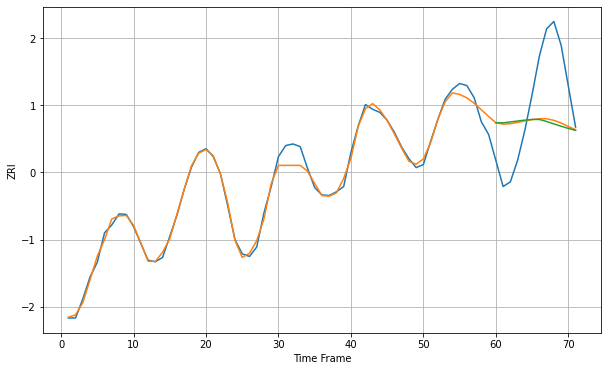

Wall time: 9.02 s
2144 12.669788268278811 110.27271848993117 113.58708338618214 [2617.33963509 2617.17223345 2618.89597821 2620.68385105 2622.32639471
 2623.64991607 2623.63565918 2619.74163506 2615.16443824 2610.73898686
 2606.59669736 2602.79369291]

Got an mse at 0.0100 in round 204 and stopped training

71 71 12


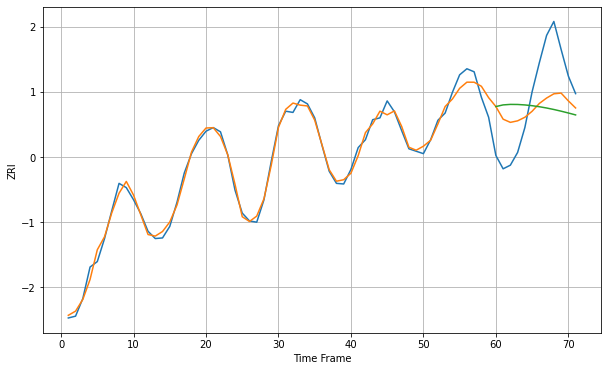

Wall time: 10.4 s
2145 10.646004729808707 70.16546946549518 87.49238482960985 [2420.66209504 2423.39242395 2424.22411631 2424.103294   2423.3502276
 2422.09121417 2420.38840937 2418.28398101 2415.82069588 2413.05248027
 2410.0473868  2406.88448804]

Got an mse at 0.0099 in round 157 and stopped training

71 71 12


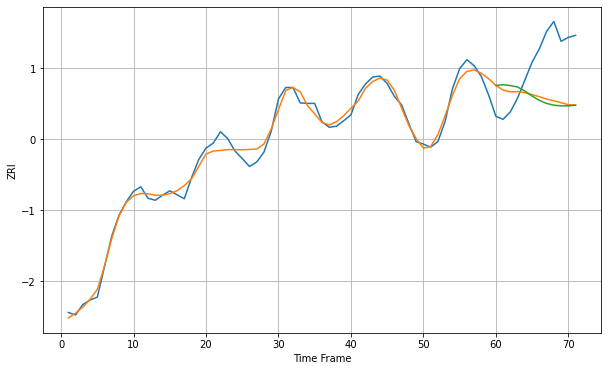

Wall time: 8.89 s
2148 14.163075406266785 100.31798690844228 105.31384438992959 [2258.13680069 2259.61257325 2257.94915788 2254.97696835 2246.81845901
 2236.77407793 2228.13697458 2221.97080239 2218.41032548 2217.01701262
 2217.15491036 2218.24681347]

Got an mse at 0.0099 in round 180 and stopped training

71 71 12


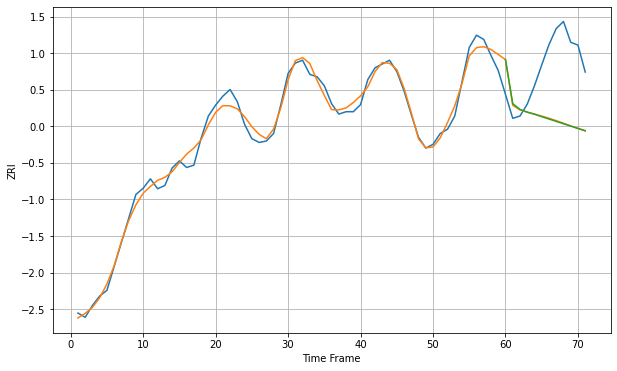

Wall time: 9.46 s
2149 15.346527444490642 131.81698463652538 132.48743785554421 [2325.28545929 2232.09281227 2219.90164494 2214.23076064 2209.68696201
 2204.56424953 2199.57138475 2194.55815312 2189.55697061 2184.60250626
 2179.73496787 2175.00119868]

Got an mse at 0.0099 in round 123 and stopped training

71 71 12


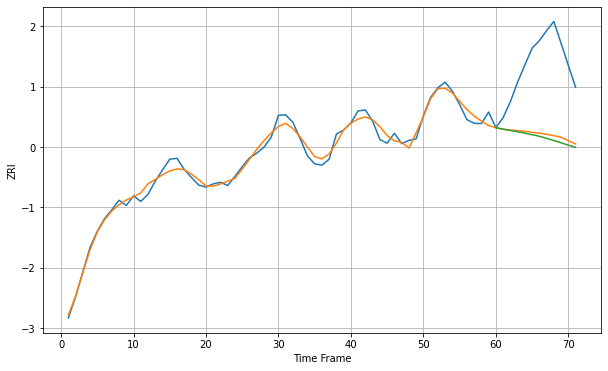

Wall time: 8.16 s
2150 14.95586375460087 184.11859327154318 191.82648833153746 [2378.81432329 2375.03561266 2371.94084573 2368.62946579 2365.08444274
 2361.31117274 2357.32117451 2352.14041694 2346.56335187 2341.02730515
 2334.97779127 2329.75929791]

Got an mse at 0.0100 in round 98 and stopped training

71 71 12


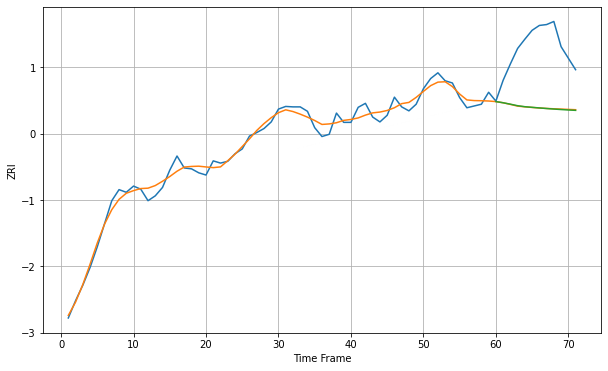

Wall time: 7.61 s
2151 14.897637403796075 139.26833591479541 139.44157249168353 [2359.94831886 2357.31420773 2354.1174501  2350.64541786 2348.38806785
 2346.98793034 2345.61182556 2344.30002491 2343.08226501 2341.97843538
 2340.99913335 2340.14667933]

Got an mse at 0.0099 in round 95 and stopped training

71 71 12


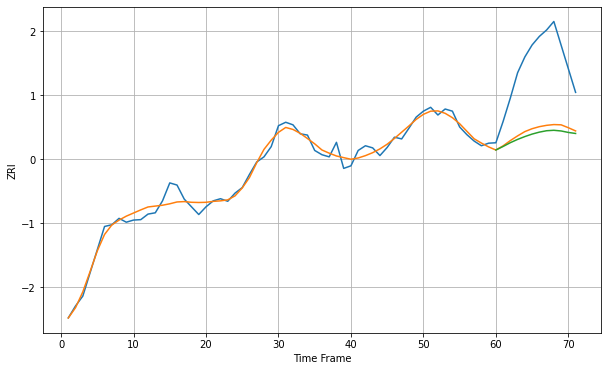

Wall time: 7.73 s
2152 14.91259853799453 163.1041828571835 173.2316785476759 [2426.01551973 2434.31100016 2443.21992036 2450.87987708 2457.51156709
 2463.31548991 2467.89066375 2471.16757302 2472.19204738 2470.62146742
 2467.17000911 2464.76958086]

Got an mse at 0.0097 in round 159 and stopped training

71 71 12


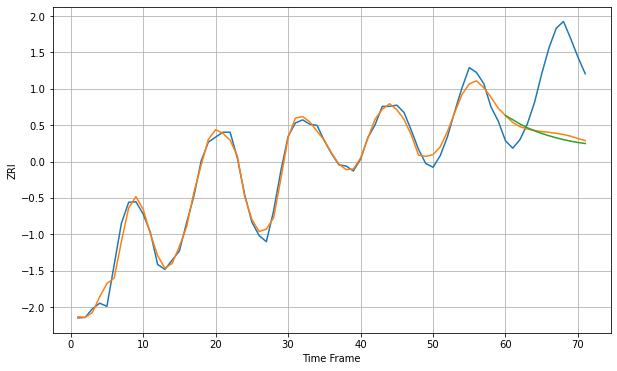

Wall time: 9.19 s
2155 11.565031468958688 112.20390381333624 117.20995577338323 [2388.03877796 2381.35450112 2374.25701202 2368.33050463 2363.34013941
 2359.02258468 2355.22556435 2351.87274444 2348.93280057 2346.39998385
 2344.28072013 2342.58311326]

Got an mse at 0.0100 in round 112 and stopped training

71 71 12


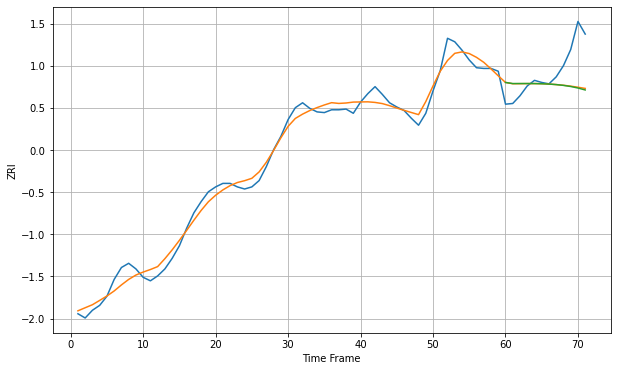

Wall time: 8.18 s
2169 11.951243370257371 41.36490780353609 42.0133275225055 [2010.99579103 2009.42873586 2009.46992676 2009.47948399 2009.39535302
 2009.15838693 2008.70010554 2007.94463695 2006.81085505 2005.21402715
 2003.0669632  2000.28158657]

Got an mse at 0.0099 in round 116 and stopped training

71 71 12


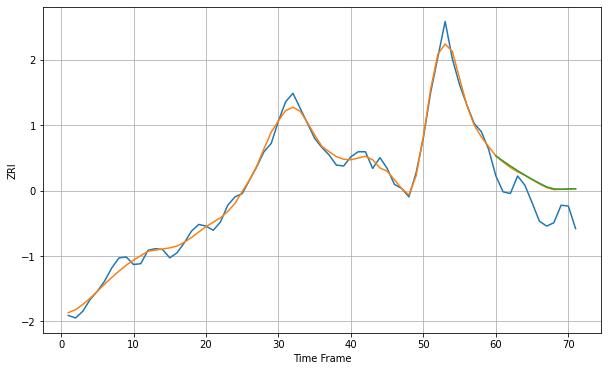

Wall time: 8.96 s
2170 7.753333713366525 32.27482802374222 32.88952077146866 [1931.08429303 1924.90948907 1919.01762149 1913.37688456 1908.0279727
 1903.00783689 1898.34761481 1894.07554932 1891.59051413 1891.15186262
 1891.46246279 1891.67320788]

Got an mse at 0.0100 in round 119 and stopped training

71 71 12


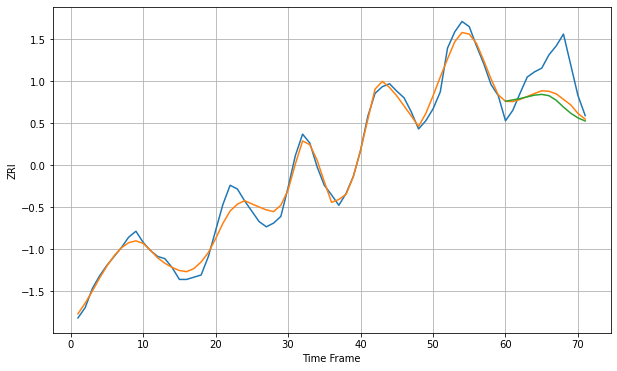

Wall time: 8.38 s
2171 11.193586830259814 42.09349097908345 47.633171046639276 [2192.36276827 2194.16630659 2195.91445047 2198.28256497 2200.63156797
 2201.59827428 2199.88389897 2193.69694977 2184.50540728 2176.23838872
 2169.90635038 2165.71654342]

Got an mse at 0.0099 in round 147 and stopped training

71 71 12


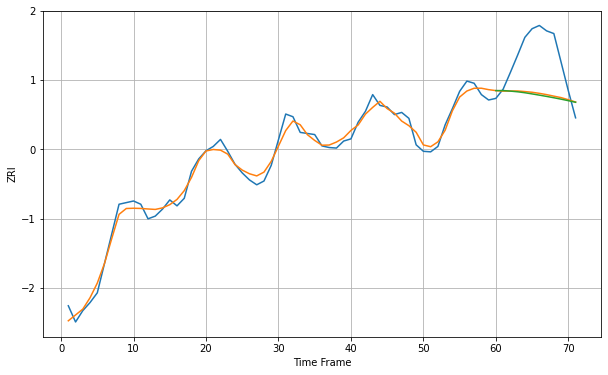

Wall time: 8.9 s
2176 12.626361849296648 80.77755838519549 82.88304752528387 [2281.37568664 2281.51580409 2280.45591433 2279.20602544 2277.43086585
 2275.26528439 2273.00744848 2270.64868711 2268.16521909 2265.53363578
 2262.73685261 2259.76868626]

Got an mse at 0.0098 in round 60 and stopped training

71 71 12


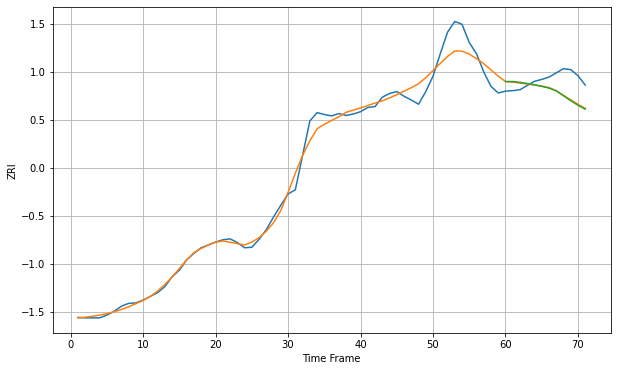

Wall time: 7.08 s
2184 20.08719286632298 37.440956123925375 38.511838030392504 [2215.47805095 2215.54025986 2213.67454147 2211.32553873 2208.52357606
 2205.24152383 2201.51530412 2195.48210958 2185.09690465 2174.57673298
 2164.79589097 2156.38682772]

Got an mse at 0.0100 in round 162 and stopped training

71 71 12


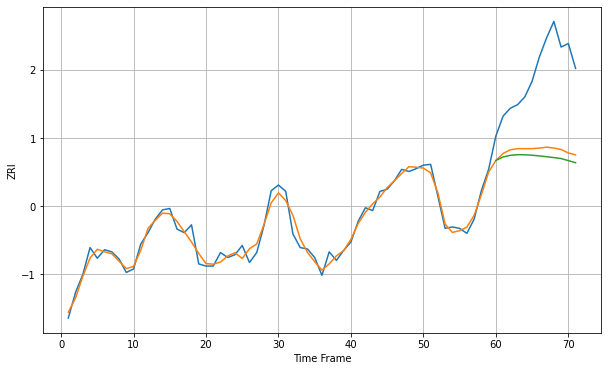

Wall time: 8.92 s
2210 9.5382060561766 114.19113495779789 124.01918852659108 [2889.53275827 2894.43686353 2896.7758186  2897.63342171 2897.53592089
 2896.87855521 2895.91718692 2894.78877857 2893.56619061 2892.19804743
 2889.30164126 2886.37304762]

Got an mse at 0.0099 in round 127 and stopped training

71 71 12


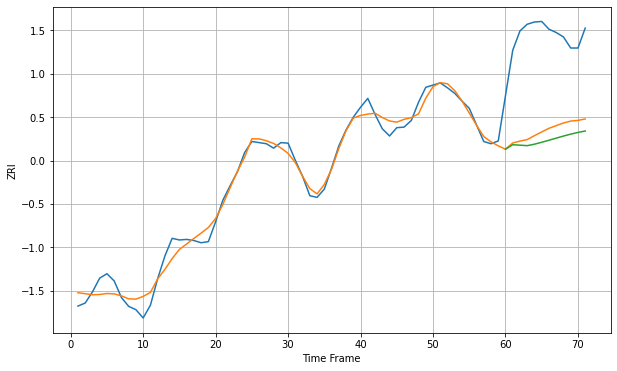

Wall time: 8.81 s
2215 15.532125457722925 170.5001203759592 186.3762954653095 [2356.1323954  2364.18481151 2363.37094297 2362.50063656 2365.17077805
 2368.59990699 2372.30054817 2376.11144678 2379.8425057  2383.31247625
 2386.39386096 2389.01806314]

Got an mse at 0.0099 in round 84 and stopped training

71 71 12


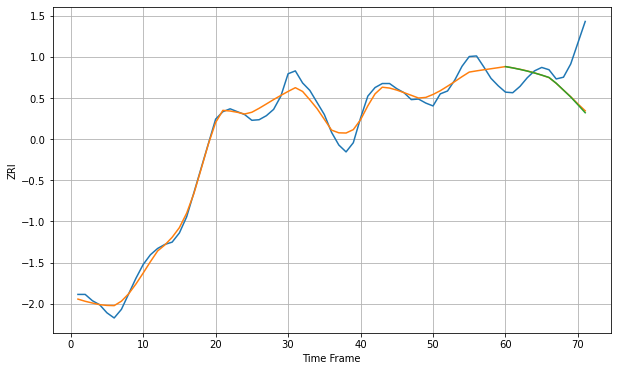

Wall time: 7.61 s
2301 14.17078599090011 60.9498706531059 61.90301485936874 [1699.48094544 1697.19480183 1694.58375141 1691.64198391 1688.34145779
 1684.66567768 1680.58370252 1670.4840591  1658.52446989 1646.55912774
 1632.9543663  1619.18381152]

Got an mse at 0.0098 in round 41 and stopped training

71 71 12


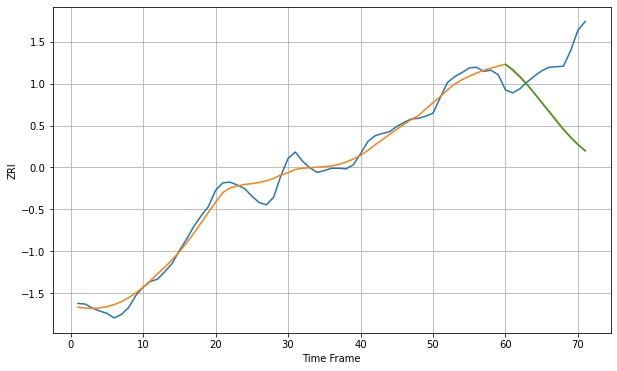

Wall time: 6.82 s
2302 14.092269647289008 109.58889913762725 110.1623180607352 [1745.24514233 1735.97408992 1724.01432963 1710.18684175 1694.94034841
 1679.05727888 1663.37943675 1647.84390606 1632.69815086 1618.9503025
 1606.67594746 1595.97788147]

Got an mse at 0.0098 in round 57 and stopped training

71 71 12


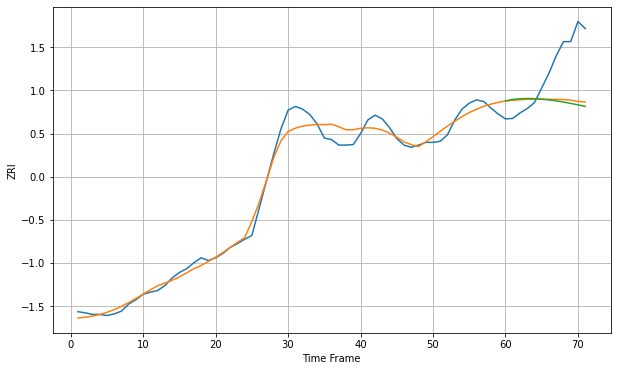

Wall time: 7.06 s
2360 15.599182876570094 79.00085927665027 82.7251163511362 [1802.02438862 1804.87020971 1806.06414353 1806.50527524 1806.26048384
 1805.39808417 1804.00580455 1802.17486343 1799.99187693 1797.53754179
 1794.88808549 1792.11671626]

Got an mse at 0.0098 in round 176 and stopped training

71 71 12


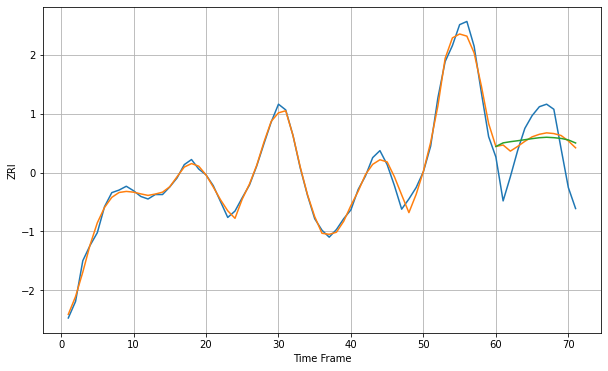

Wall time: 9.31 s
2445 9.121534241193137 51.18923453975293 55.550004417057096 [2806.52356581 2812.17611497 2814.04665478 2815.51704561 2817.14486304
 2818.8189086  2820.30692755 2821.01453666 2820.35257918 2819.19190252
 2816.83232433 2812.03292271]

Got an mse at 0.0098 in round 95 and stopped training

71 71 12


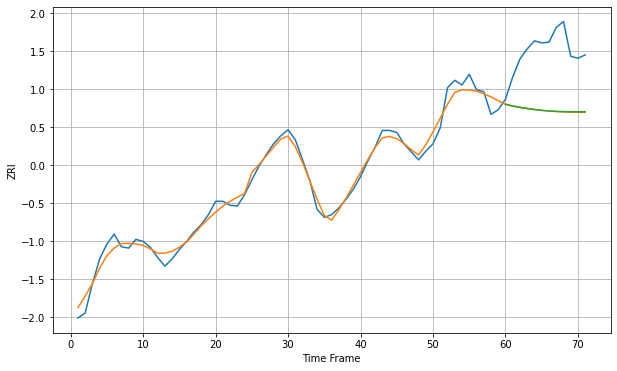

Wall time: 7.63 s
2446 11.10961629930047 91.92818593313415 91.75721353202097 [2905.17809744 2902.4119866  2900.48960656 2898.75430138 2897.25649743
 2896.03598137 2895.11420753 2894.48711102 2894.11867026 2893.94297448
 2893.87982871 2893.85677095]

Got an mse at 0.0099 in round 131 and stopped training

71 71 12


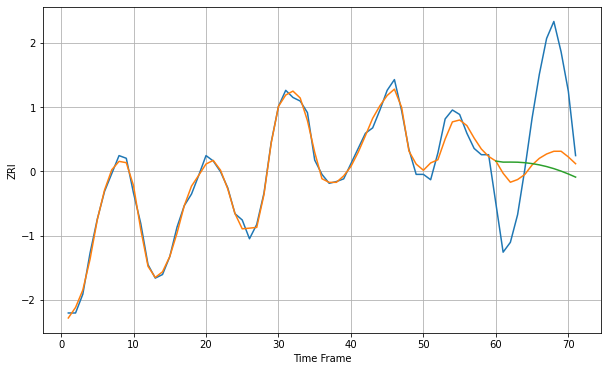

Wall time: 8.3 s
2451 7.114002084202068 83.32428689605037 96.32298516393381 [2426.88217746 2425.7026272  2425.73517178 2425.61590806 2425.05899652
 2424.05204053 2422.61264056 2420.73756136 2418.41347541 2415.64267173
 2412.46348419 2408.95547412]

Got an mse at 0.0100 in round 132 and stopped training

71 71 12


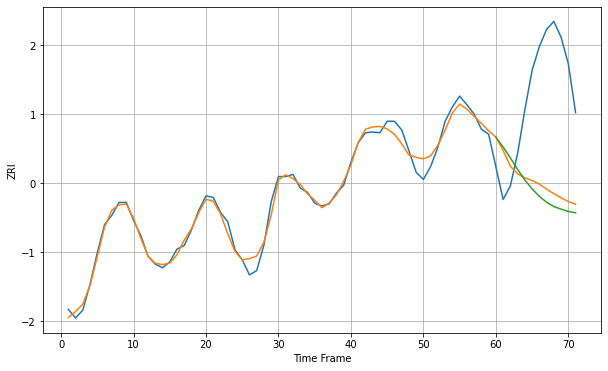

Wall time: 8.37 s
2453 9.495982576221625 154.7155672829433 166.57158282925215 [2413.87742012 2400.11619736 2384.91534016 2368.8779944  2354.14756556
 2341.76170676 2331.430966   2323.15805216 2317.22734887 2313.55190604
 2310.38311537 2308.55058425]

Got an mse at 0.0098 in round 140 and stopped training

71 71 12


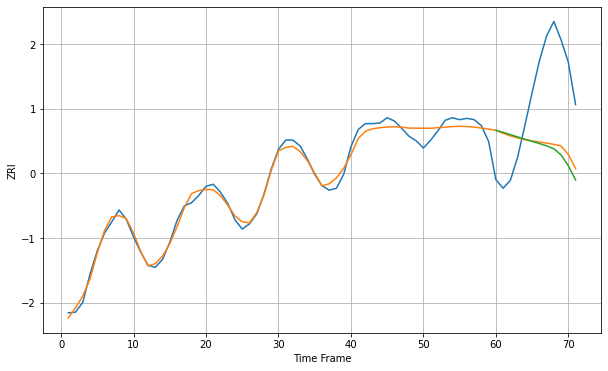

Wall time: 8.36 s
2458 9.670501462765213 113.6422677138382 120.20140391941399 [2563.80327226 2560.77117489 2557.33106137 2553.86884352 2550.46192421
 2547.11453998 2543.76893439 2540.35039229 2535.85114918 2526.45651319
 2510.04187405 2488.56390044]

Got an mse at 0.0099 in round 122 and stopped training

71 71 12


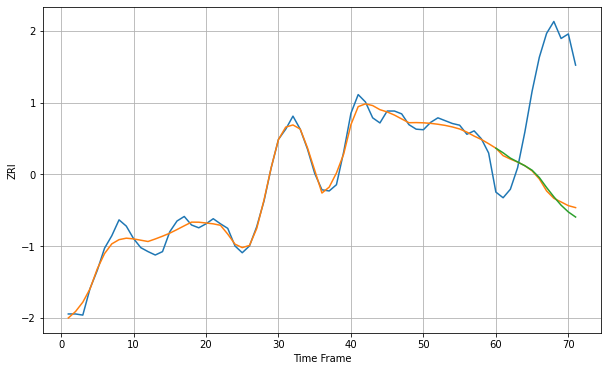

Wall time: 8.22 s
2460 12.547089168408656 203.43459230477157 206.1648081147735 [2626.4494183  2618.31070755 2608.92103786 2602.1967311  2595.44429132
 2587.56721855 2574.6199477  2557.01694213 2540.73691387 2525.90476273
 2513.97064442 2505.00804443]

Got an mse at 0.0099 in round 137 and stopped training

71 71 12


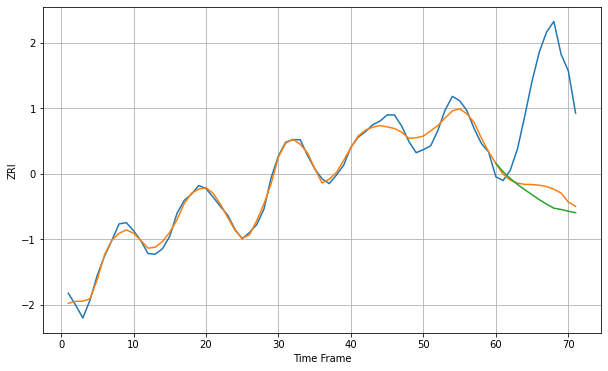

Wall time: 8.43 s
2472 10.418178064639408 169.4391249388731 186.6308628397205 [2372.78157401 2359.23549939 2348.14289192 2338.62772509 2330.18886087
 2322.09665925 2314.10366649 2306.79271057 2300.37842796 2298.30115782
 2295.4675309  2293.03983215]

Got an mse at 0.0096 in round 85 and stopped training

71 71 12


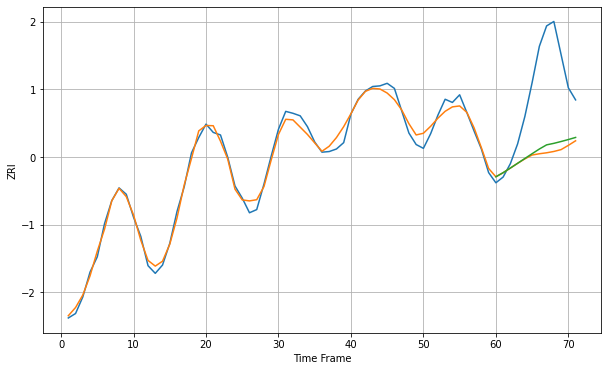

Wall time: 7.57 s
2474 10.178462412398051 116.33130438233384 109.44428855323356 [2348.42349107 2354.87185347 2362.11479798 2369.58728821 2377.12263351
 2384.60792101 2391.96369191 2398.48415587 2400.85999854 2403.73723153
 2406.82382976 2410.1121761 ]

Got an mse at 0.0099 in round 136 and stopped training

71 71 12


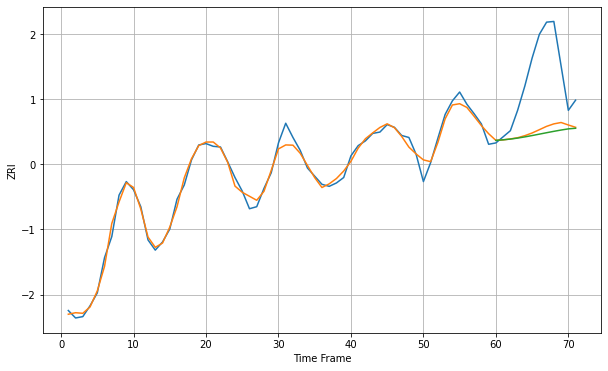

Wall time: 8.53 s
2476 9.427496277314992 88.73750414179679 94.1273134511316 [2285.74921299 2286.60433241 2287.66999435 2289.12603912 2290.88961649
 2292.85958864 2294.93820716 2297.03657395 2299.07593916 2300.98690273
 2302.70875736 2303.61722431]

Got an mse at 0.0099 in round 133 and stopped training

71 71 12


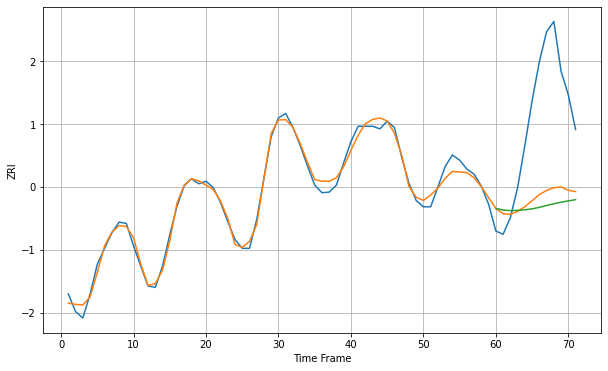

Wall time: 8.6 s
2478 9.735359466327177 151.21634161224083 166.2310562856064 [2434.38982502 2431.88412817 2431.06964629 2431.35608332 2432.35101631
 2433.74593279 2436.1623628  2438.97104139 2441.78735899 2444.2256297
 2446.2404808  2448.13378964]
71 71 12


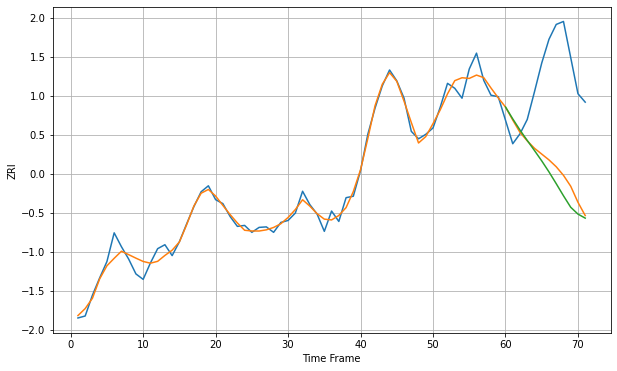

Wall time: 16.1 s
2494 15.86898555082494 195.47733980564544 216.5908841311235 [2822.18116529 2798.21177207 2775.60614526 2754.59710102 2734.24024198
 2713.35318132 2691.07832174 2667.30473329 2642.87582651 2619.64610895
 2605.8558489  2597.72673099]

Got an mse at 0.0099 in round 170 and stopped training

71 71 12


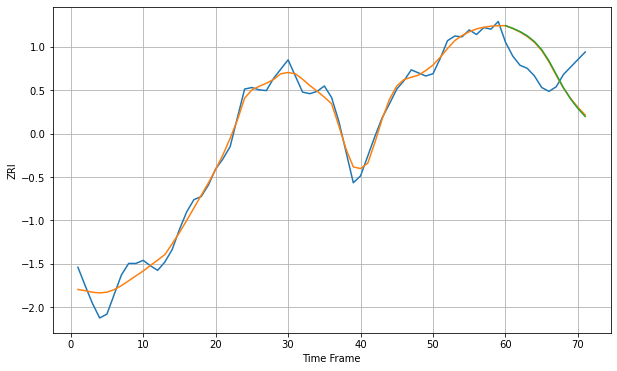

Wall time: 9.15 s
2703 11.250276302824012 44.634034077957054 45.57828942321227 [1451.52612984 1448.13699949 1443.8780519  1438.32519035 1430.78911156
 1420.21019684 1405.67640336 1388.13973779 1370.7213982  1355.98404316
 1343.64918779 1333.22431424]

Got an mse at 0.0099 in round 70 and stopped training

71 71 12


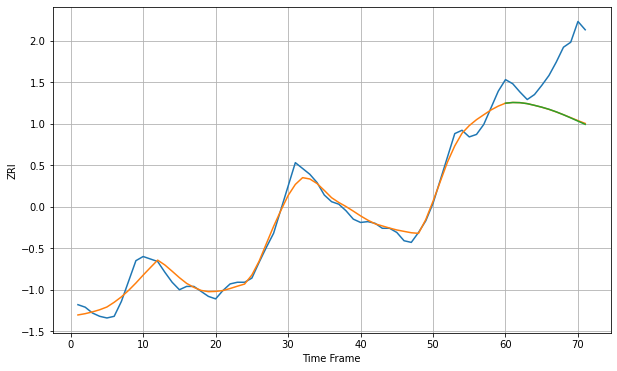

Wall time: 7.23 s
2721 9.847498711587518 64.18920941921618 64.46138988573907 [1076.61147521 1077.43614241 1077.24808737 1076.06259602 1074.01294822
 1071.83350475 1069.27573492 1066.18920498 1062.69538764 1058.92141614
 1055.01040004 1051.11924786]

Got an mse at 0.0096 in round 80 and stopped training

71 71 12


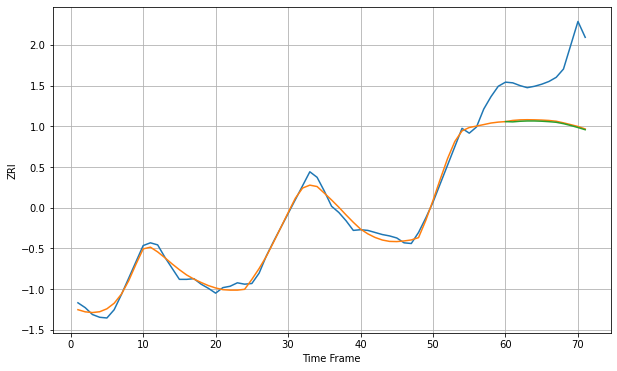

Wall time: 7.54 s
2723 11.298551273428203 83.36348420111237 84.64813851331172 [1123.78691037 1123.38348389 1124.26633624 1124.69639766 1124.69453776
 1124.3349649  1123.68046865 1122.78074962 1120.78777357 1118.12891687
 1115.18705164 1112.0045225 ]

Got an mse at 0.0098 in round 56 and stopped training

71 71 12


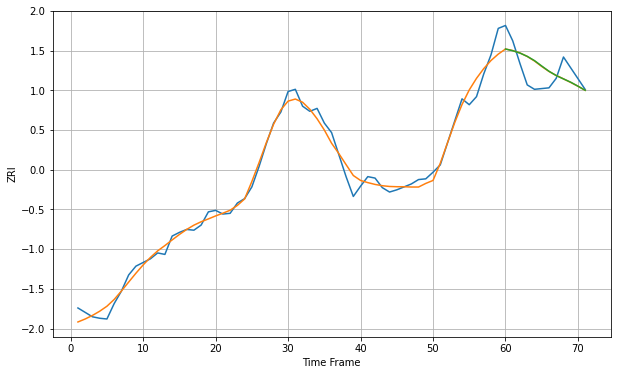

Wall time: 7.05 s
2740 10.562555783149254 24.515822789601575 24.679352594646247 [1270.90211789 1268.58366265 1265.38518705 1260.90164992 1255.11596292
 1247.74741935 1240.59360842 1234.74663918 1230.17992691 1225.67206571
 1220.2714949  1214.66564209]

Got an mse at 0.0100 in round 275 and stopped training

71 71 12


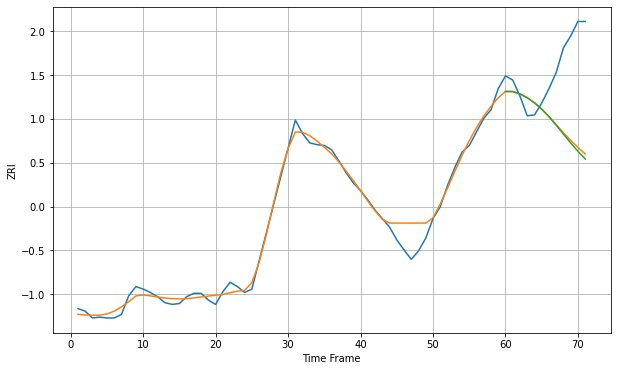

Wall time: 11.2 s
2746 10.301926119428819 80.40775547710824 82.65343714185923 [1129.65246212 1129.50346571 1126.69070984 1122.27974106 1116.31068365
 1108.80540328 1099.88692915 1089.89809973 1079.39163462 1068.97153203
 1059.11766529 1050.10463291]

Got an mse at 0.0100 in round 225 and stopped training

71 71 12


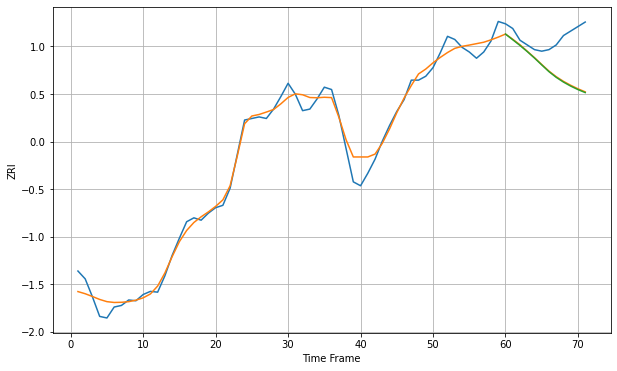

Wall time: 10.7 s
2780 12.09436257043358 46.34999577156908 47.021798791111664 [1402.8961628  1395.64194571 1388.33898502 1380.5345615  1372.24734829
 1363.49014185 1354.85071824 1347.57467361 1341.51993125 1336.37174598
 1331.94401562 1328.09569074]

Got an mse at 0.0100 in round 180 and stopped training

71 71 12


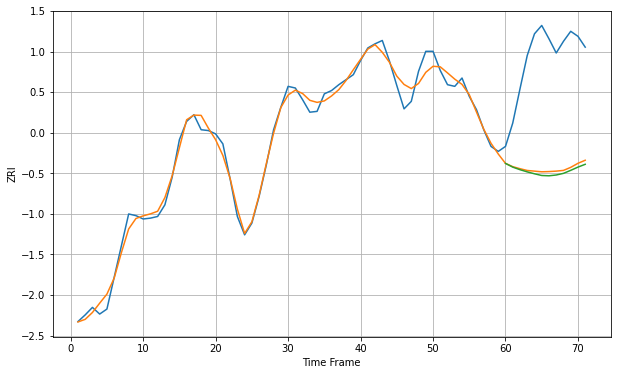

Wall time: 9.57 s
2840 9.674960981827907 137.45237912918466 140.86689150882142 [1794.63767957 1790.15314346 1787.09410984 1784.46230054 1782.17125901
 1780.1369243  1779.7674774  1780.72353913 1782.69538794 1786.29896982
 1790.18501249 1793.55080184]

Got an mse at 0.0099 in round 111 and stopped training

71 71 12


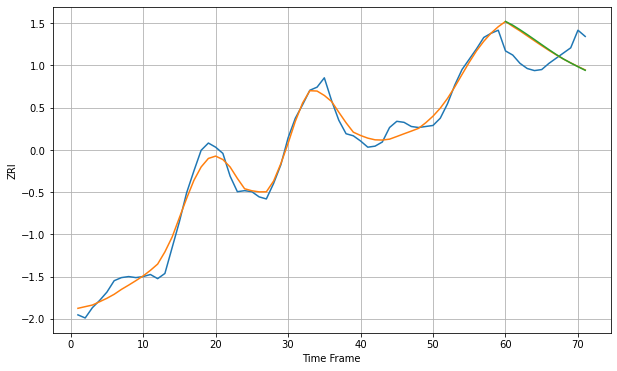

Wall time: 8.29 s
2860 8.039664997726865 25.172751318816662 25.818262472177885 [1228.4606893  1224.86602048 1220.47201682 1215.80294959 1210.96293906
 1206.06154161 1201.2202554  1196.54765984 1192.18066499 1188.35407249
 1184.74191069 1181.29416698]
71 71 12


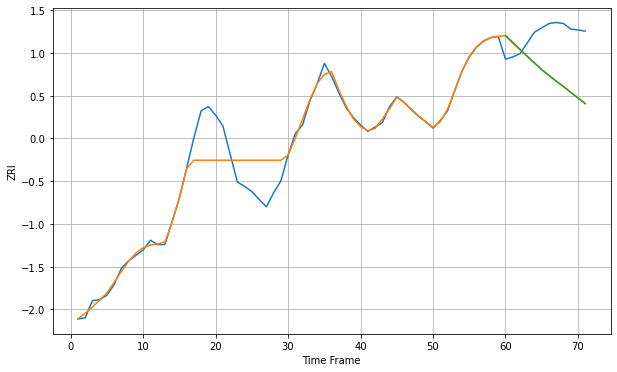

Wall time: 15.6 s
2861 15.635211204635915 44.364036278181 44.60684106748046 [1197.77260514 1191.67489659 1185.13545173 1178.66814138 1172.35034104
 1166.19212851 1160.70459167 1155.42413261 1150.45971669 1145.1850758
 1139.86626164 1134.64153507]

Got an mse at 0.0100 in round 97 and stopped training

71 71 12


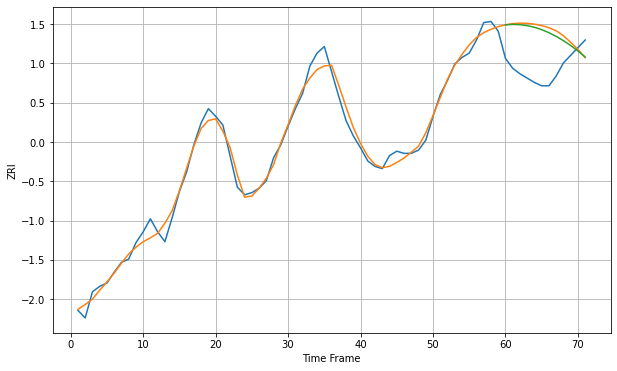

Wall time: 7.84 s
2863 7.144596581569699 39.60652724288157 37.17932411877735 [1230.93077676 1231.30474992 1231.06924793 1230.17863779 1228.65024734
 1226.48739848 1223.70050443 1220.31383151 1216.36000998 1211.87074574
 1206.87024534 1201.3739676 ]

Got an mse at 0.0099 in round 87 and stopped training

71 71 12


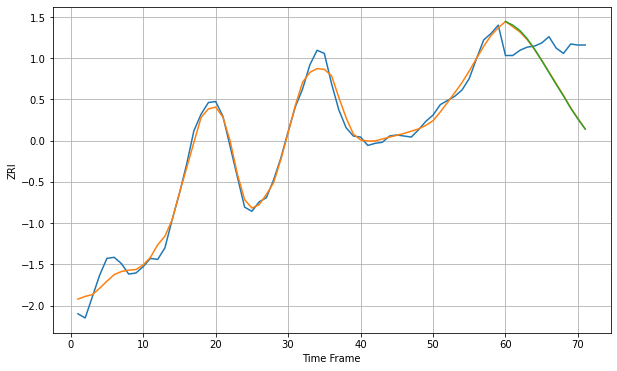

Wall time: 7.27 s
2864 7.747536046234764 42.30119294735777 42.68763231376393 [1291.54553792 1288.03763229 1282.82732846 1275.03222463 1265.13672476
 1254.21516761 1242.75571206 1231.31409476 1220.31575274 1208.62003188
 1198.26618363 1188.66487124]

Got an mse at 0.0098 in round 236 and stopped training

71 71 12


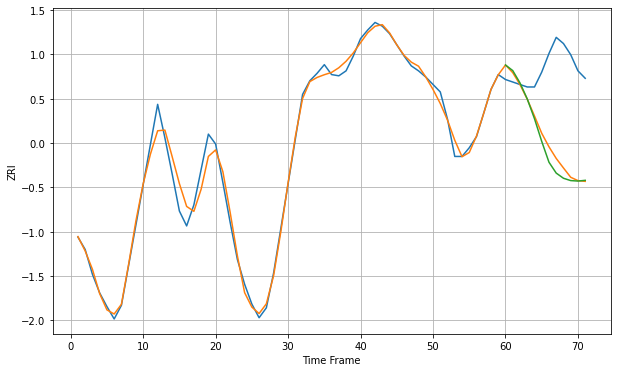

Wall time: 10.2 s
2891 7.058421122116388 66.45876450868626 70.99786820796889 [1215.72470509 1211.21080945 1201.27207051 1188.39479555 1172.43327948
 1154.1152361  1137.3501943  1128.57690103 1124.42175553 1122.53922606
 1122.16506653 1122.75435965]

Got an mse at 0.0099 in round 273 and stopped training

71 71 12


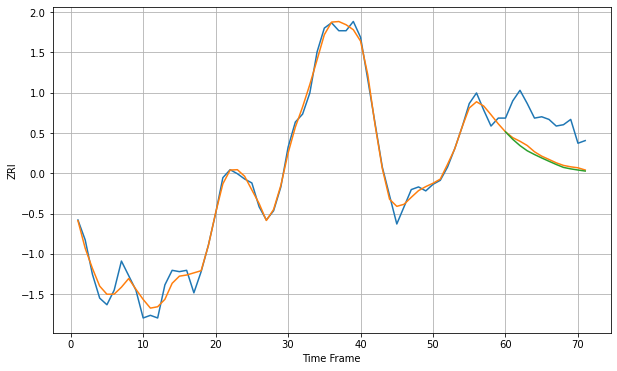

Wall time: 11.3 s
2893 6.030674050381892 28.359498834857146 30.159440502617436 [1221.58334889 1215.96074008 1211.21048501 1207.31110878 1204.47967272
 1201.87251564 1199.38887213 1196.96895776 1194.74755902 1193.638133
 1192.78152081 1191.97855369]

Got an mse at 0.0099 in round 164 and stopped training

71 71 12


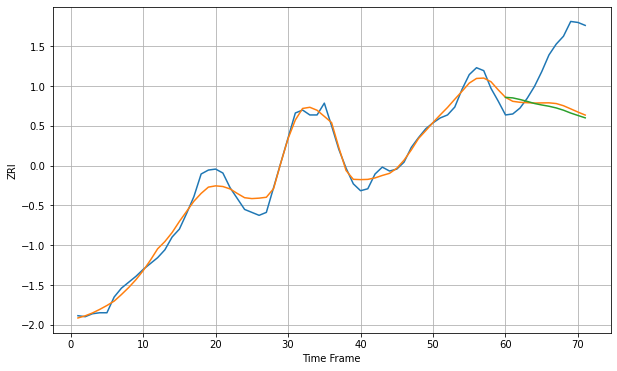

Wall time: 8.87 s
2895 7.992587750709791 55.77037649099946 58.53652735528505 [1085.88957501 1085.34228411 1083.70593862 1081.77358367 1079.65396463
 1078.14276298 1076.85179927 1075.13141611 1072.83298938 1069.93443927
 1067.47813935 1065.05978249]

Got an mse at 0.0099 in round 130 and stopped training

71 71 12


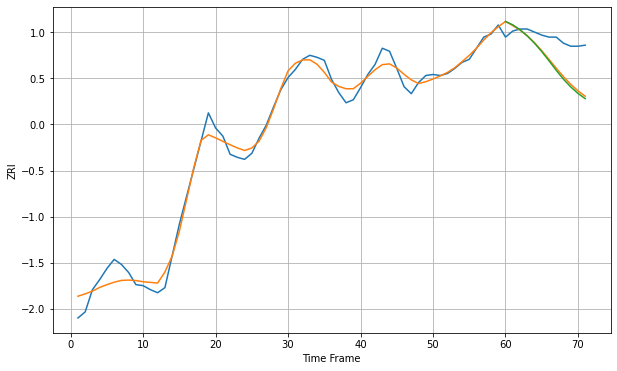

Wall time: 8.32 s
2904 9.04559933089281 27.56907650583462 29.172440915252288 [1254.48815596 1251.17172784 1246.3245595  1240.25264531 1232.99224117
 1224.6720191  1215.57504343 1206.16598576 1197.31922662 1189.75043762
 1183.30429187 1178.08298309]

Got an mse at 0.0100 in round 108 and stopped training

71 71 12


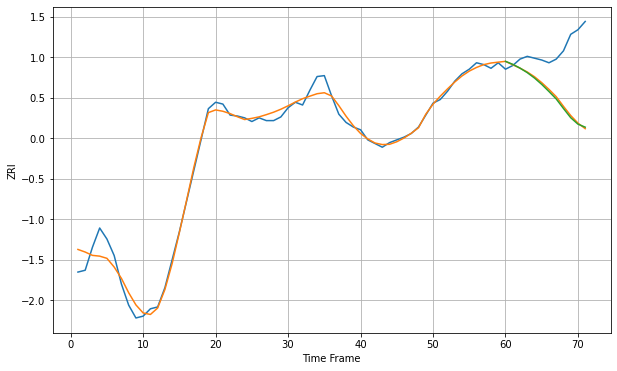

Wall time: 7.67 s
2905 8.776628598394034 57.351544106996975 58.13453740547357 [1278.54938819 1275.31505763 1271.20890514 1266.28267346 1260.38896446
 1253.46909636 1245.68949205 1237.5953043  1227.19684358 1217.16196551
 1210.13733731 1206.8516214 ]

Got an mse at 0.0097 in round 67 and stopped training

71 71 12


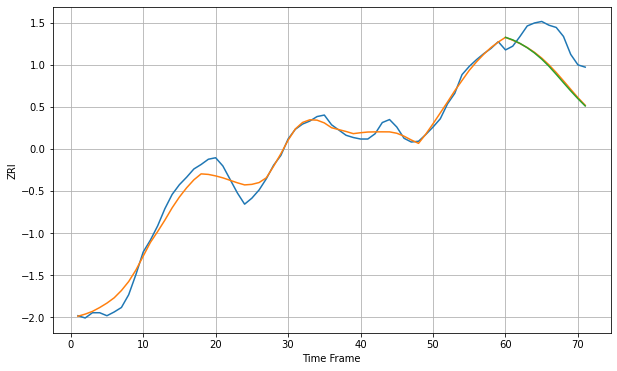

Wall time: 7.15 s
2906 10.659563715499088 42.63422545071849 44.03236515875572 [1567.8051119  1564.421865   1559.72880369 1553.89593995 1546.91928704
 1538.6927976  1529.15773276 1518.3848479  1507.25332872 1496.27525201
 1485.84102296 1476.15259132]

Got an mse at 0.0099 in round 72 and stopped training

71 71 12


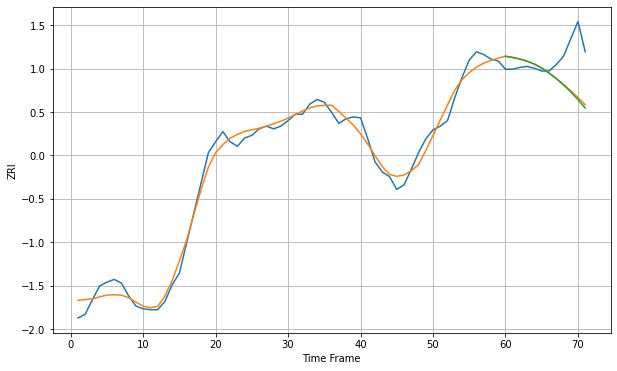

Wall time: 7.02 s
2907 9.348614866639897 35.39583222916354 36.56573810070899 [1266.09563376 1264.86522627 1263.13805559 1260.72282041 1257.63125584
 1253.22955003 1247.9162754  1241.78036903 1234.90498565 1227.32259329
 1218.94874765 1209.60760247]

Got an mse at 0.0100 in round 70 and stopped training

71 71 12


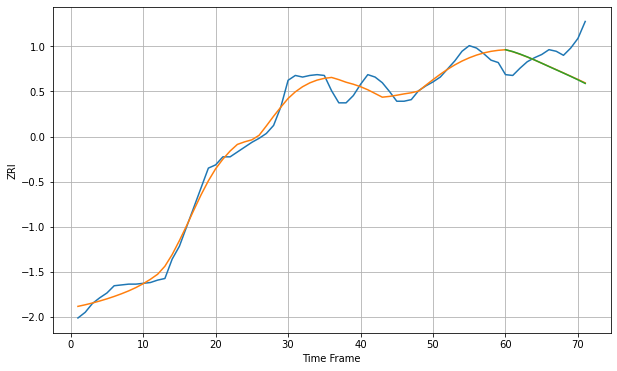

Wall time: 7.14 s
2908 11.11178721247144 33.34722802868501 33.61256755245805 [1291.95202172 1289.65382945 1286.56481576 1283.03290751 1279.24913675
 1275.18331143 1271.07308842 1267.00779448 1262.95709056 1258.84599855
 1254.57806888 1250.06946915]

Got an mse at 0.0096 in round 41 and stopped training

71 71 12


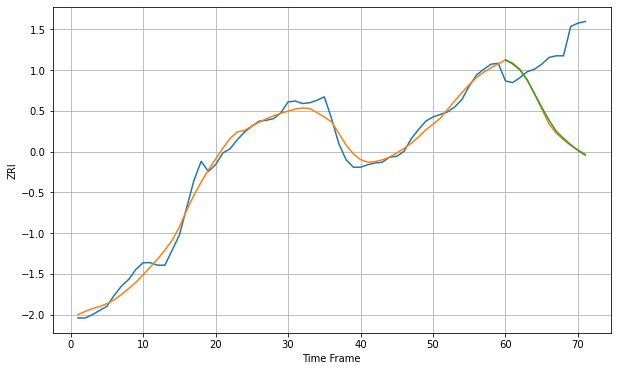

Wall time: 6.82 s
2909 9.37995288290252 90.42679969154557 89.77827756055602 [1259.09002602 1254.21044818 1247.06064007 1235.01601698 1218.85667685
 1202.65236287 1187.26063205 1173.87201653 1165.54842841 1157.83270476
 1151.0186119  1145.30378288]

Got an mse at 0.0100 in round 54 and stopped training

71 71 12


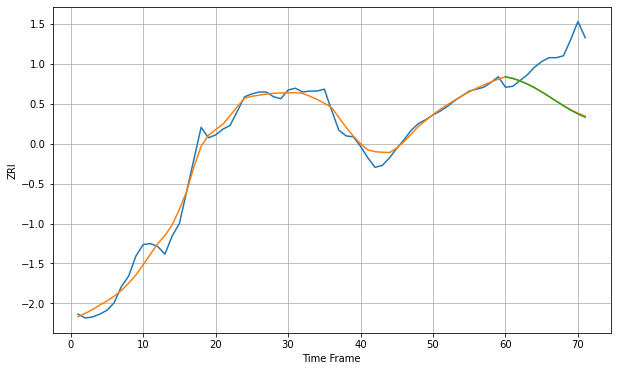

Wall time: 6.95 s
2910 8.310108530092874 49.69062697298711 50.089770229271394 [1215.97915579 1214.21876574 1211.6850619  1208.43836118 1204.5614476
 1200.15496325 1195.36221568 1190.39559118 1185.52383558 1180.9983962
 1176.96943099 1173.46329638]

Got an mse at 0.0098 in round 152 and stopped training

71 71 12


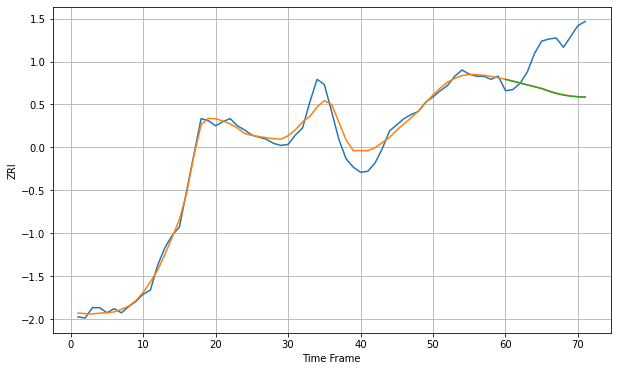

Wall time: 8.87 s
2914 8.196086273400624 45.01874901314598 45.23084940138189 [1263.00774746 1261.28677306 1259.5086635  1257.67715688 1255.84995734
 1253.95523333 1251.42178702 1249.28396112 1247.72081261 1246.6924628
 1246.05968045 1245.68937258]

Got an mse at 0.0099 in round 73 and stopped training

71 71 12


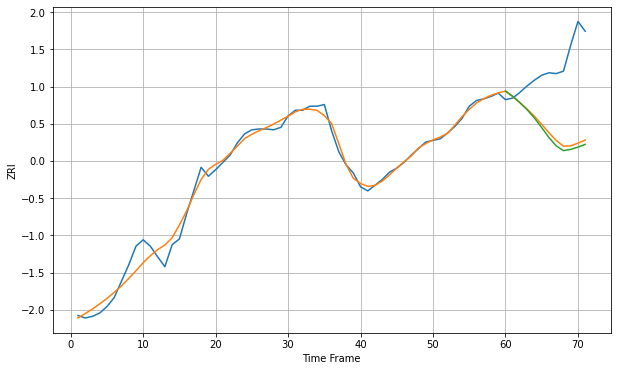

Wall time: 7.52 s
2920 9.054500736970516 83.08010110047033 86.91491986547688 [1239.54959427 1233.09921646 1225.25889398 1216.50554507 1206.36506122
 1194.69916291 1182.42741773 1172.28993363 1166.44638046 1167.96210053
 1170.72409134 1174.14639015]

Got an mse at 0.0097 in round 45 and stopped training

71 71 12


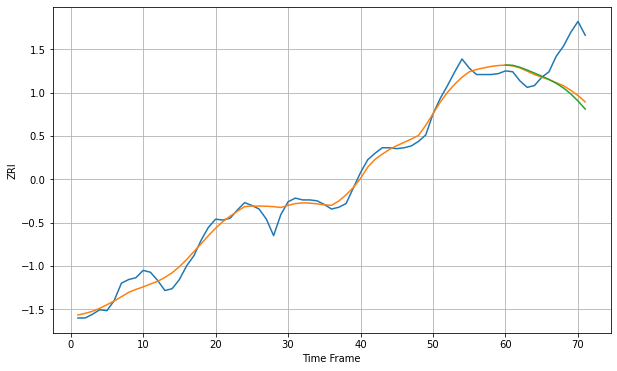

Wall time: 6.63 s
3038 9.233535858019174 40.18450019654418 43.25003734745017 [1372.38756854 1372.076597   1369.90503246 1366.9172411  1363.60978803
 1360.22070522 1356.63197505 1352.42822415 1347.34476834 1340.9108318
 1333.1203808  1324.30779229]

Got an mse at 0.0096 in round 37 and stopped training

71 71 12


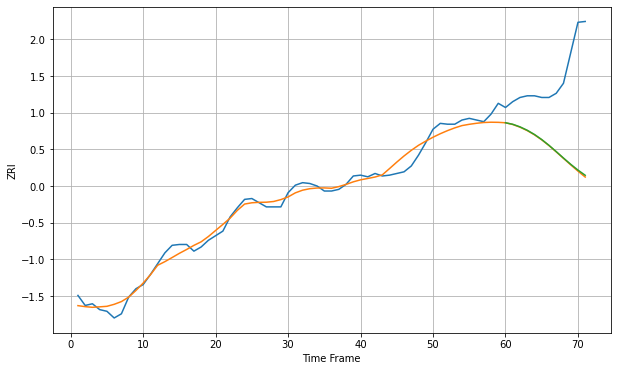

Wall time: 6.44 s
3060 8.368413575103013 95.57907446691758 94.82475764506493 [1417.70962523 1415.92104942 1412.81532366 1408.7526369  1403.68571682
 1397.63172491 1390.71379392 1383.19876565 1375.48297113 1367.99868393
 1361.06758934 1354.83478426]

Got an mse at 0.0099 in round 25 and stopped training

71 71 12


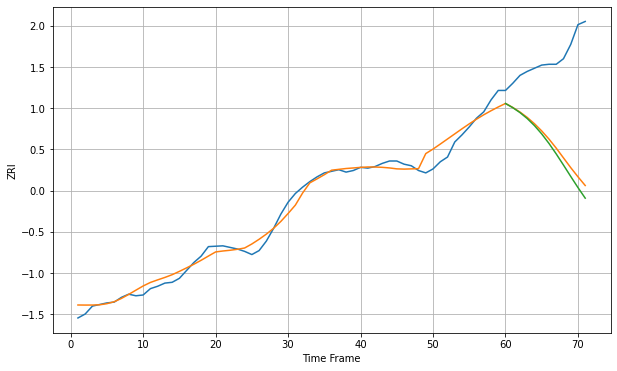

Wall time: 6.63 s
3102 9.754597881398356 114.75672805115255 122.50541495834675 [1287.55311712 1282.29976455 1276.05793611 1268.54924754 1259.6060146
 1249.12489259 1237.1485977  1223.92142158 1209.87582293 1195.55197576
 1181.48894006 1168.14199513]

Got an mse at 0.0098 in round 41 and stopped training

71 71 12


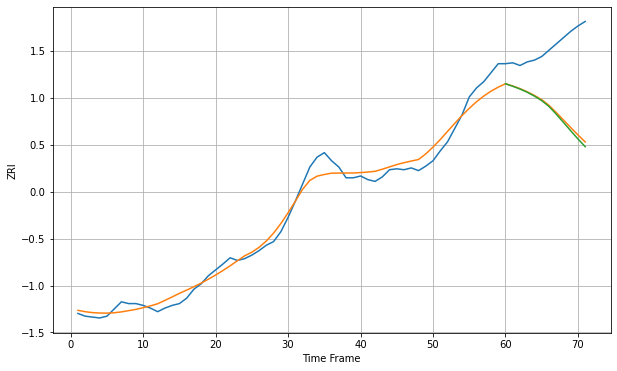

Wall time: 7.14 s
3103 10.026041417855227 75.79067121072494 78.23080049092786 [1257.67145441 1254.87806117 1251.83636262 1248.20933828 1243.9209501
 1238.89408877 1232.42665345 1223.84540386 1214.65383204 1205.33222696
 1196.24418017 1187.61181401]

Got an mse at 0.0099 in round 24 and stopped training

71 71 12


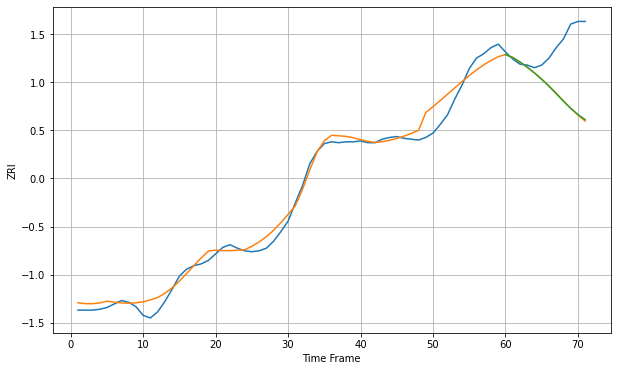

Wall time: 6.29 s
3104 10.74030321955088 59.87038562877062 59.63648569722885 [1286.04948954 1282.6146368  1277.47507417 1271.57946241 1264.96807517
 1257.66712644 1249.78560997 1241.19701945 1232.47009649 1224.33128124
 1217.32192593 1211.37593848]

Got an mse at 0.0099 in round 134 and stopped training

71 71 12


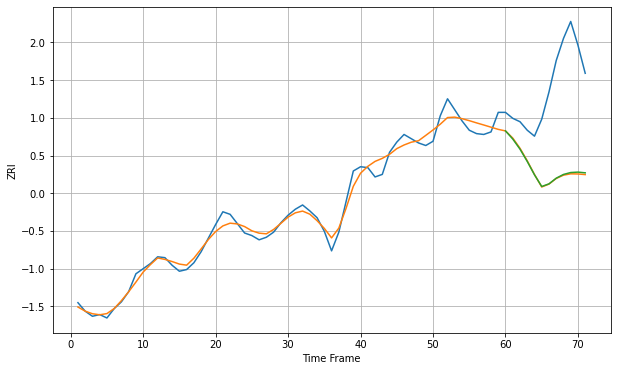

Wall time: 8.17 s
3301 8.780356481305228 107.21343378750913 106.42736375003776 [1289.18092504 1279.64524455 1267.72899684 1253.23853856 1237.49768579
 1223.78071168 1226.8620715  1233.54775788 1237.94156251 1240.20383924
 1240.68442947 1239.84605318]

Got an mse at 0.0094 in round 33 and stopped training

71 71 12


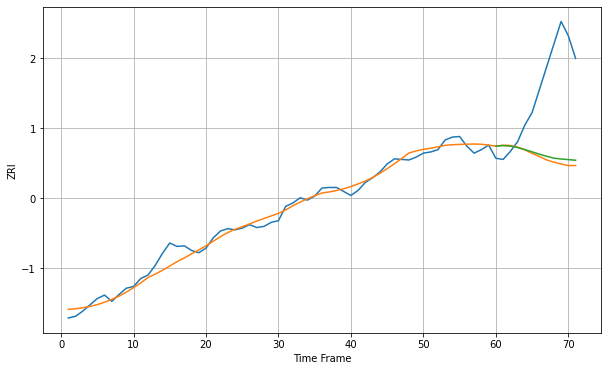

Wall time: 6.83 s
3820 11.38833015782314 141.14828217637407 135.56934907300592 [1382.18336376 1383.05944799 1382.2160939  1379.80434347 1376.26971239
 1372.21454273 1368.21212676 1364.53403419 1361.22758687 1359.77865119
 1358.63449319 1357.5832238 ]

Got an mse at 0.0100 in round 129 and stopped training

71 71 12


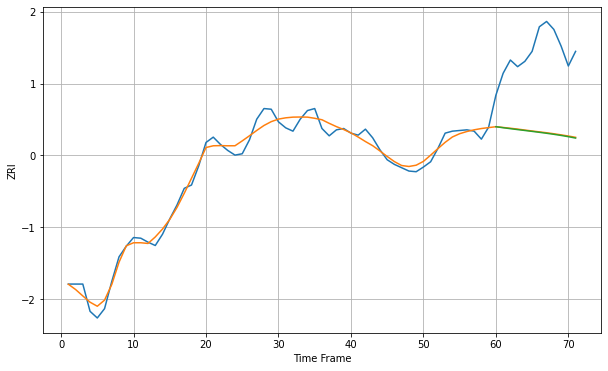

Wall time: 8.26 s
4101 10.74948415480232 121.27033001037856 121.99115309443727 [1678.69560007 1677.1816209  1675.74091453 1674.36517563 1673.01661688
 1671.66025572 1670.26713187 1668.8102518  1667.25833473 1665.57150163
 1663.7028522  1661.6109496 ]

Got an mse at 0.0099 in round 177 and stopped training

71 71 12


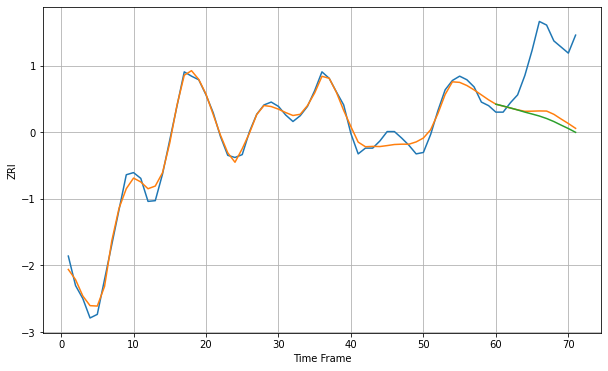

Wall time: 9.12 s
4102 9.168089062003583 85.05193732050633 90.73379895960718 [1653.06582969 1650.55046    1647.87256666 1645.05237703 1642.05017066
 1639.39992475 1636.62147595 1633.16444257 1628.94434803 1623.99469518
 1619.24372297 1613.94776482]

Got an mse at 0.0100 in round 142 and stopped training

71 71 12


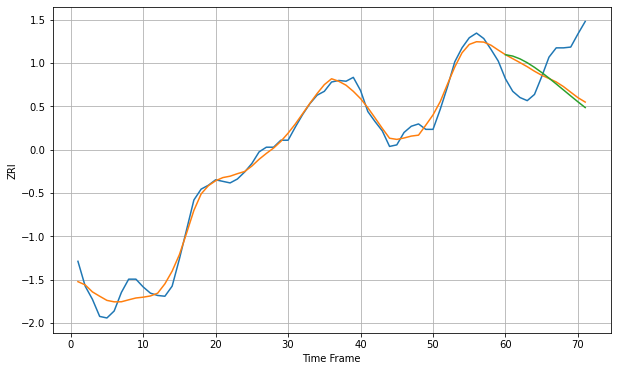

Wall time: 8.7 s
4103 11.108827271874018 52.96535246834839 56.94182232497042 [1602.16540465 1600.40521302 1596.80840866 1591.86937589 1585.87981411
 1579.20642279 1572.0205239  1564.48846635 1556.77906597 1549.05178207
 1541.44653114 1534.07875151]

Got an mse at 0.0100 in round 205 and stopped training

71 71 12


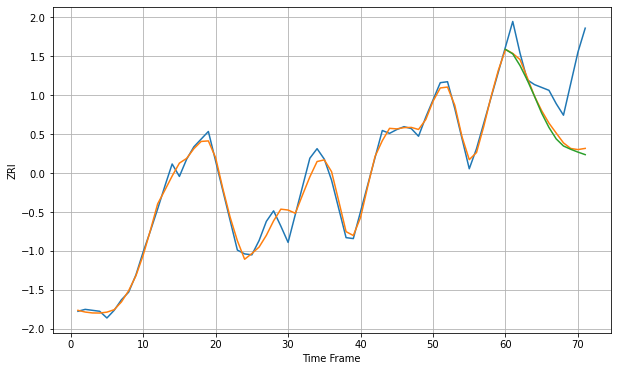

Wall time: 9.8 s
4210 8.075401884627874 54.51404547718917 57.18140293717628 [1083.74723033 1079.1196253  1066.94004163 1051.74928729 1034.79174582
 1017.00401115 1002.16526922  990.18390295  982.80980745  979.37710139
  976.41512552  973.76415435]

Got an mse at 0.0100 in round 179 and stopped training

71 71 12


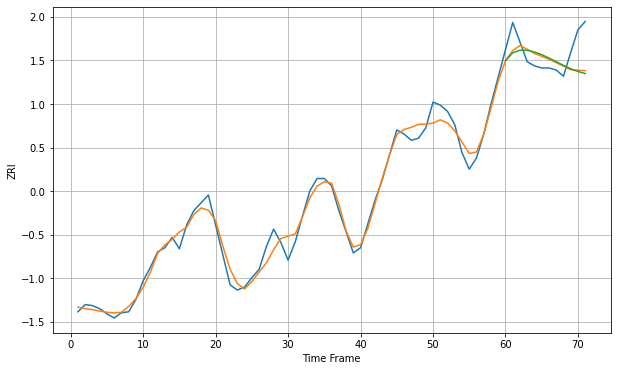

Wall time: 9.33 s
4240 8.371113748772622 21.547493414399977 22.726780720736823 [1061.01806256 1068.63246571 1071.1917348  1071.07468734 1069.439485
 1066.84292741 1063.62620667 1060.07536778 1056.49388696 1053.223829
 1050.57100965 1048.58504446]

Got an mse at 0.0099 in round 80 and stopped training

71 71 12


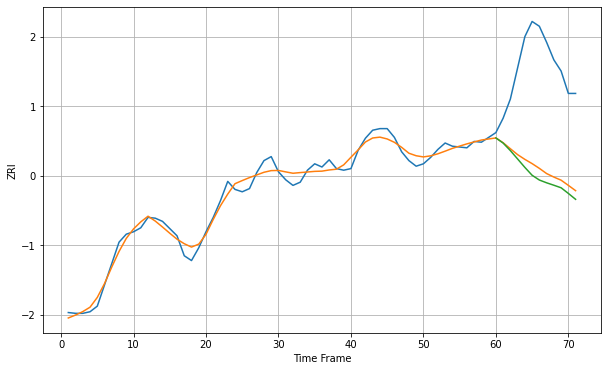

Wall time: 7.53 s
4401 8.601114499622453 128.58801258272638 138.0813560346658 [1121.34417367 1114.94541026 1105.50105196 1095.04371927 1084.49646997
 1074.67115513 1068.71878646 1065.24263521 1062.20706432 1059.02497756
 1051.98148485 1044.58463616]

Got an mse at 0.0100 in round 323 and stopped training

71 71 12


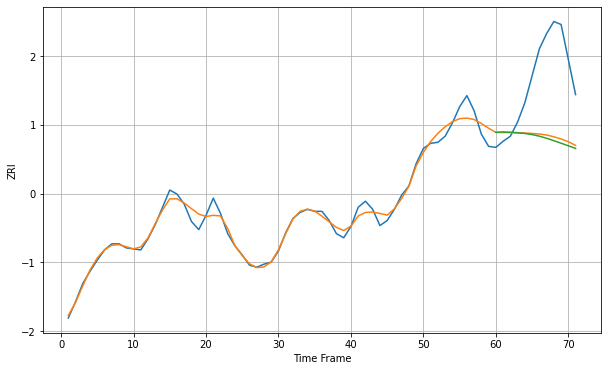

Wall time: 12 s
4901 6.740609866012539 68.42595800987976 70.81390564588231 [886.82019955 887.19967781 886.91369079 886.44592024 885.71795531
 884.61603377 883.04282418 880.98777867 878.59806357 876.0900789
 873.56100098 870.98259386]

Got an mse at 0.0099 in round 117 and stopped training

71 71 12


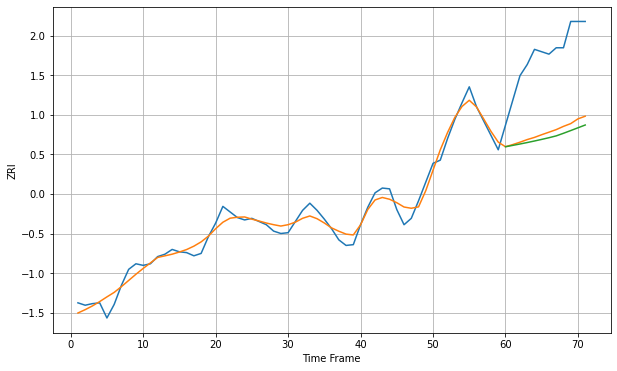

Wall time: 8.32 s
4937 9.829672211707907 99.16859321290174 105.78431045774386 [ 988.831646    990.53774813  992.27374207  994.10735598  996.03825097
  998.06089657 1000.16365973 1002.46316612 1005.7133241  1009.12805993
 1012.6064795  1016.09338943]

Got an mse at 0.0100 in round 60 and stopped training

71 71 12


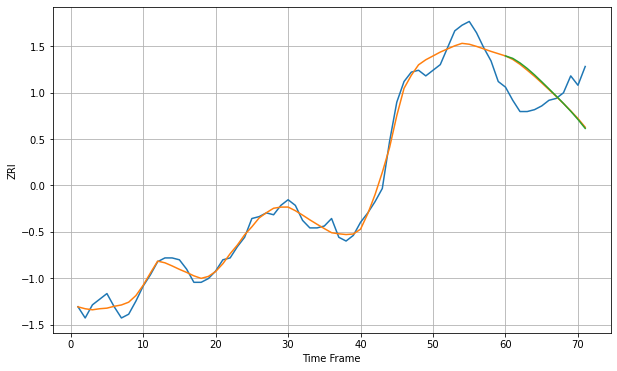

Wall time: 7.06 s
6010 4.920543879097495 18.506860263784727 18.99167195848257 [1079.62422571 1078.3367637  1075.9134733  1072.94862261 1069.55323839
 1065.87992396 1062.08702622 1058.2431171  1054.31242239 1050.19501881
 1045.7899496  1041.00809406]

Got an mse at 0.0099 in round 90 and stopped training

71 71 12


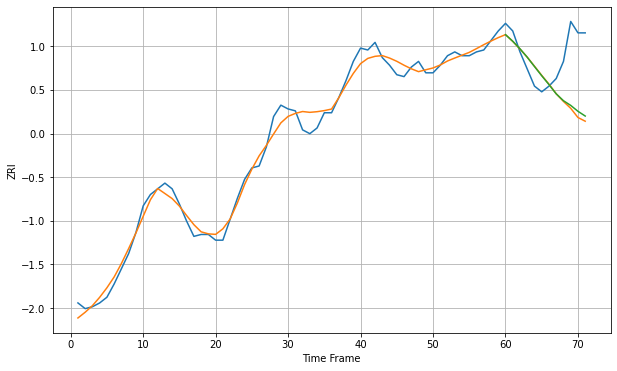

Wall time: 8.05 s
6040 4.53541907402439 24.192035635214975 22.979962198341504 [1194.07114408 1190.60000619 1186.63047146 1182.18539386 1177.29722536
 1172.45373108 1167.80220109 1162.92952204 1159.32750349 1156.85981384
 1153.76070899 1151.27296807]

Got an mse at 0.0100 in round 149 and stopped training

71 71 12


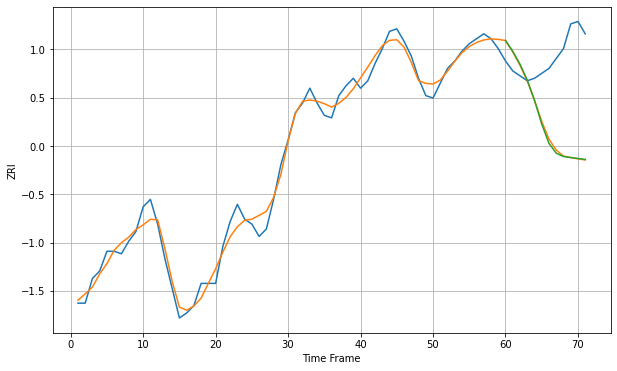

Wall time: 8.52 s
6051 3.881673783420753 33.302802180907854 33.577368623257286 [1109.30555704 1104.94403376 1099.68846586 1093.31075479 1085.13061458
 1075.47867763 1067.66558172 1063.68887056 1062.3453355  1061.93184685
 1061.55169513 1061.16902222]

Got an mse at 0.0098 in round 80 and stopped training

71 71 12


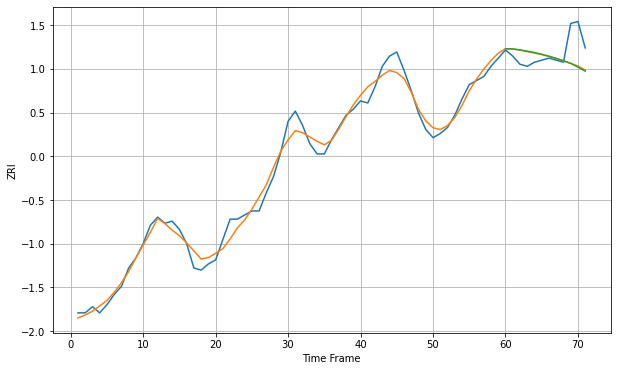

Wall time: 7.22 s
6053 4.206568898410059 9.660175801998093 9.844261615013027 [1166.60803525 1166.51301013 1166.05777455 1165.45840143 1164.73101747
 1163.88359785 1162.92422663 1161.86123301 1160.70301023 1159.45793066
 1157.62306487 1155.62654595]

Got an mse at 0.0100 in round 127 and stopped training

71 71 12


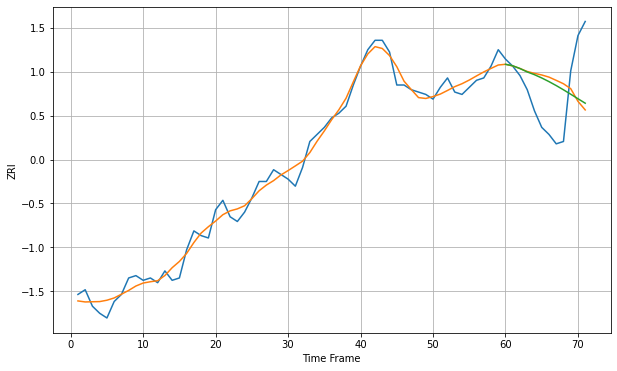

Wall time: 8.09 s
6082 3.7170407437121935 20.40544136415149 19.08661737170068 [1230.79753768 1230.16723848 1229.00089326 1227.5487049  1226.38056179
 1224.98888998 1223.44220999 1221.7586524  1219.9603076  1218.07991824
 1216.16439067 1214.27006283]

Got an mse at 0.0100 in round 206 and stopped training

71 71 12


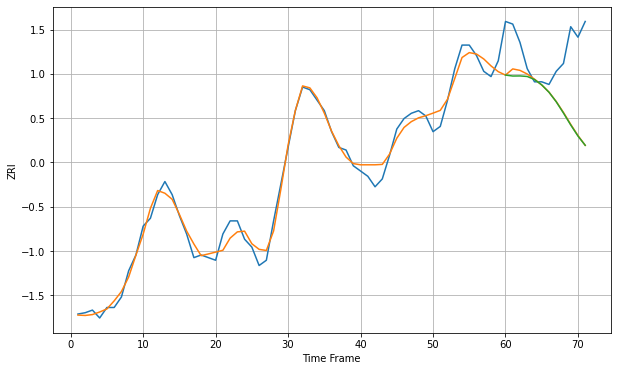

Wall time: 9.63 s
6106 3.3507232811076055 22.978411176879646 23.33175617636103 [1108.57071614 1108.20533128 1108.24014814 1108.03352571 1106.86466554
 1104.83425405 1102.03234475 1098.39984177 1094.08968206 1089.54889266
 1085.33473369 1081.80554368]

Got an mse at 0.0099 in round 73 and stopped training

71 71 12


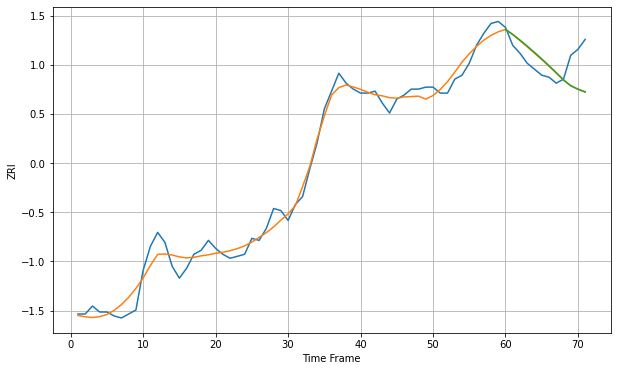

Wall time: 6.93 s
6108 4.904828771158809 11.719909462016002 11.851310173134248 [1206.9767122  1204.43436637 1201.63637648 1198.61882455 1195.45517365
 1192.17889149 1188.79086809 1185.28324057 1181.6661614  1178.71249503
 1176.95676363 1175.52065038]

Got an mse at 0.0100 in round 187 and stopped training

71 71 12


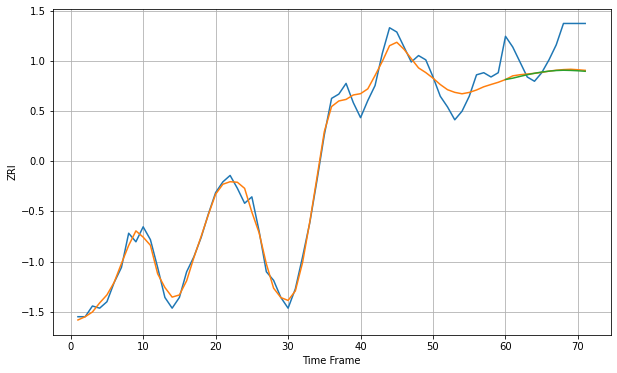

Wall time: 9.33 s
6112 4.639881001425435 14.93824223386325 15.267643487113828 [1132.81195772 1133.4394359  1134.26197797 1135.04949512 1135.73954045
 1136.30035365 1136.72416448 1137.0174533  1137.14889656 1137.06809338
 1136.90014291 1136.66687171]

Got an mse at 0.0100 in round 170 and stopped training

71 71 12


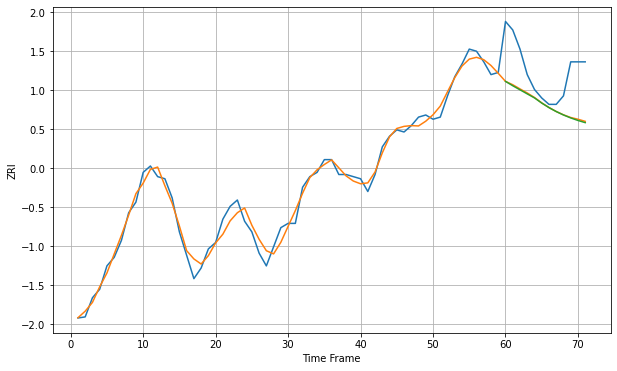

Wall time: 9.02 s
6114 3.633085963754279 18.696499290408017 18.97734380505511 [1110.81560392 1108.76441447 1106.84825971 1104.93053783 1103.03695673
 1100.61328208 1098.47412449 1096.61325136 1095.0036651  1093.61684767
 1092.42620351 1091.40900517]

Got an mse at 0.0099 in round 149 and stopped training

71 71 12


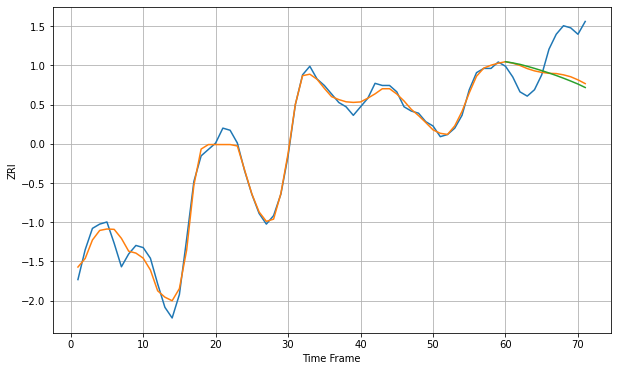

Wall time: 8.56 s
6119 3.6339278802605963 16.514788794468867 17.655998510841176 [1383.12860576 1382.56812221 1381.8847512  1380.98068767 1380.00521864
 1378.96461217 1377.85396035 1376.66853319 1375.40603102 1374.0681078
 1372.66148876 1371.03855313]

Got an mse at 0.0100 in round 206 and stopped training

71 71 12


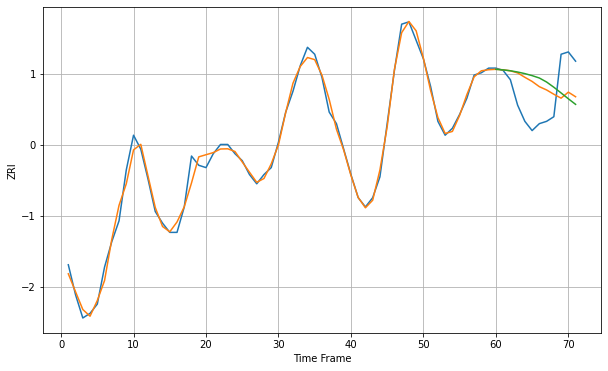

Wall time: 9.61 s
6320 3.0469438193807066 14.304557274078748 16.043063189755323 [1063.48149465 1063.23961813 1062.85727679 1062.31633667 1061.62064784
 1060.76306342 1059.72883096 1057.99210222 1055.73769409 1053.26673157
 1050.75097223 1048.33802487]

Got an mse at 0.0100 in round 113 and stopped training

71 71 12


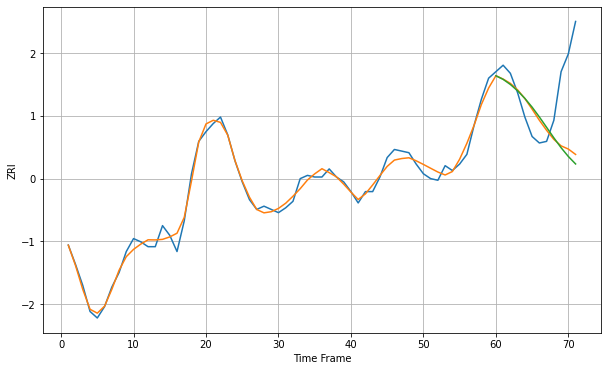

Wall time: 7.71 s
6360 3.848312183200101 33.165684584805746 35.3408198156529 [1107.50324918 1105.26761986 1102.11237569 1098.2011986  1093.52629045
 1088.11458284 1082.0778247  1075.64985083 1069.18701458 1063.08929898
 1057.66741189 1053.05995805]

Got an mse at 0.0100 in round 96 and stopped training

71 71 12


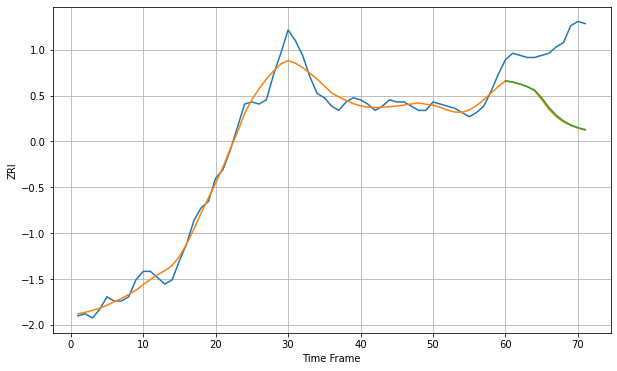

Wall time: 7.3 s
6401 4.294420602699386 31.378797412524104 31.06552675456416 [1224.96073609 1224.33671969 1223.416798   1222.22180574 1220.64874608
 1216.9042274  1212.36035497 1208.71807885 1206.04750549 1204.17763802
 1202.86587691 1201.91283863]

Got an mse at 0.0100 in round 129 and stopped training

71 71 12


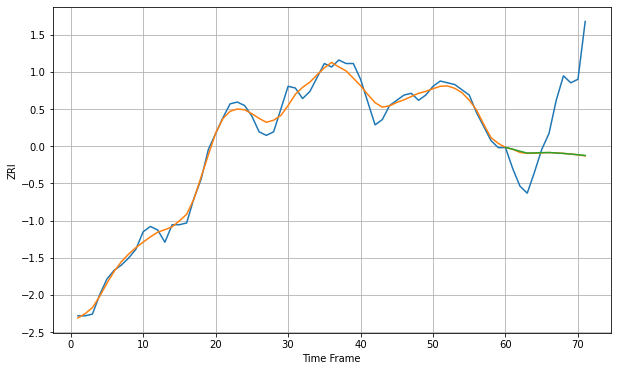

Wall time: 8.21 s
6405 4.221489739307985 33.5458232623522 33.55765692069862 [1298.10390446 1297.09331292 1295.93457491 1294.89542126 1294.98371653
 1295.14583174 1295.17870832 1294.9449026  1294.66313154 1294.33040272
 1293.9449671  1293.50988973]

Got an mse at 0.0100 in round 188 and stopped training

71 71 12


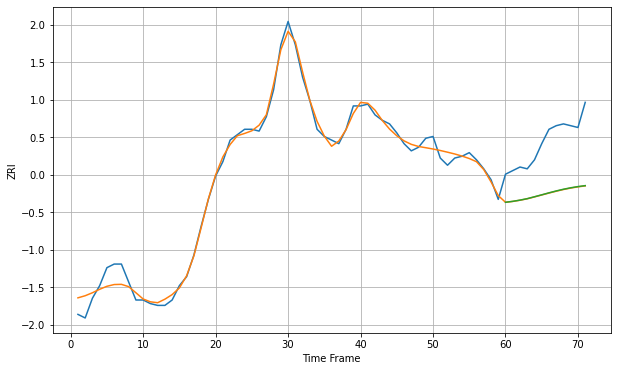

Wall time: 9.16 s
6418 4.146885292549072 29.97259903748832 29.857420709685695 [1192.38202621 1192.90798305 1193.58452984 1194.39925188 1195.45247963
 1196.53626365 1197.63920728 1198.69105306 1199.63762221 1200.44847667
 1201.11614879 1201.64996003]

Got an mse at 0.0100 in round 113 and stopped training

71 71 12


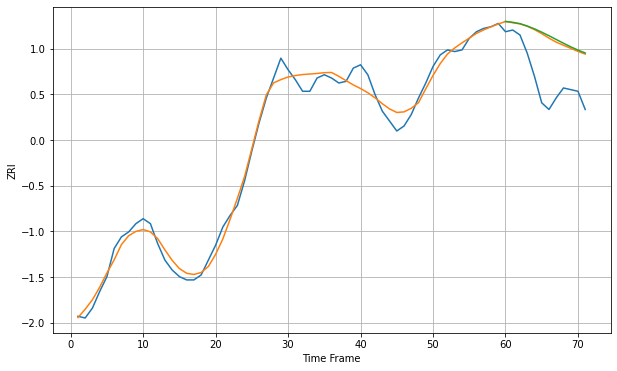

Wall time: 7.84 s
6450 5.48063901208064 27.232835760763482 28.05168337642298 [1167.18591098 1166.67917755 1165.84273009 1164.43270192 1162.70569087
 1160.72098306 1158.55443575 1156.29545728 1154.03839868 1151.8752895
 1149.8888813  1148.14261683]

Got an mse at 0.0099 in round 156 and stopped training

71 71 12


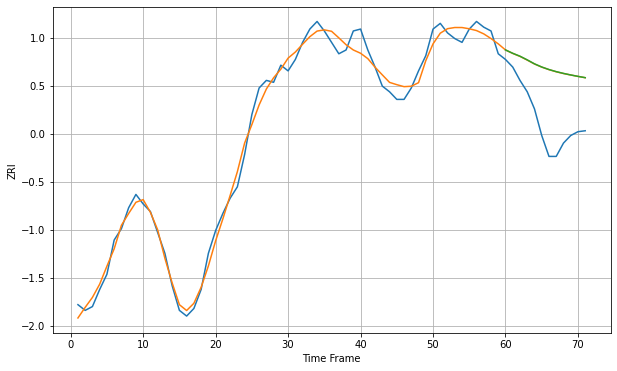

Wall time: 8.75 s
6451 5.0228708463508145 29.45601557554696 29.508565848853532 [1142.01458142 1140.25160206 1138.7172898  1136.79440588 1134.70503436
 1133.04257096 1131.70422092 1130.60322782 1129.67495598 1128.85783654
 1128.1159667  1127.43777432]

Got an mse at 0.0100 in round 116 and stopped training

71 71 12


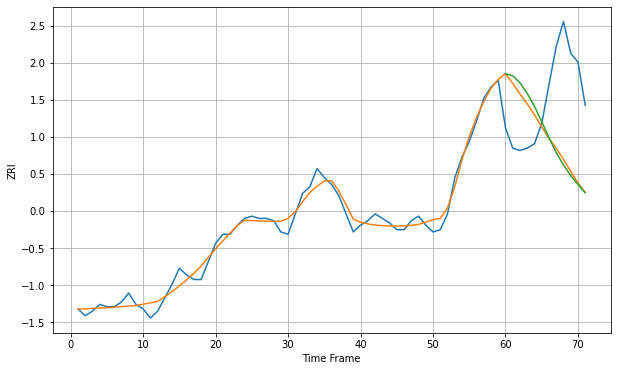

Wall time: 7.79 s
6457 3.2624321117544075 36.41880462522079 38.13999857082253 [1255.91633855 1254.98886565 1251.8824742  1247.1904652  1241.5262761
 1234.77613493 1227.57367476 1221.06985622 1215.57051393 1210.95322242
 1206.95558643 1203.36853043]

Got an mse at 0.0099 in round 117 and stopped training

71 71 12


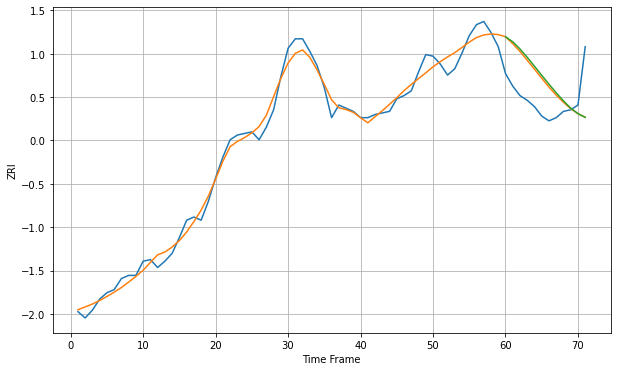

Wall time: 8.16 s
6460 5.445878730356192 23.38138181536449 24.398274596112675 [1460.33345688 1457.11854974 1452.55878908 1447.26271436 1441.59859734
 1435.85431906 1430.20285467 1424.76511364 1419.66362292 1415.02172257
 1411.55875394 1409.21686964]

Got an mse at 0.0100 in round 380 and stopped training

71 71 12


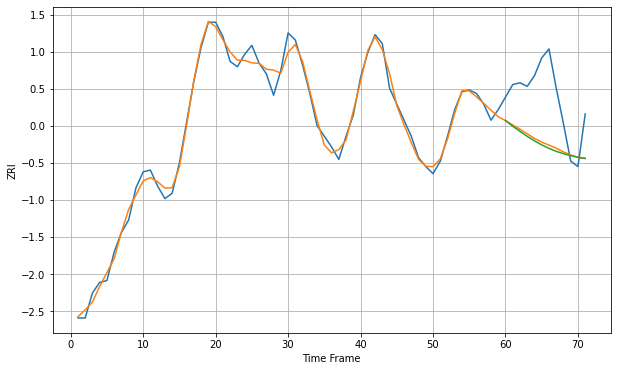

Wall time: 13.2 s
6484 4.132122399822316 29.609440820144663 30.667425572808135 [1419.79417005 1416.6136934  1413.76062381 1410.94227749 1408.39880419
 1406.15293596 1404.20550189 1402.5501662  1401.17668299 1400.07181249
 1399.21853621 1398.59485749]

Got an mse at 0.0100 in round 225 and stopped training

71 71 12


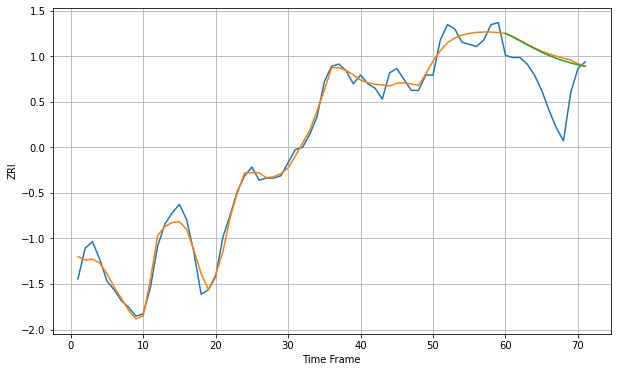

Wall time: 10.1 s
6489 4.117214822754337 18.66233291457094 18.06560341841504 [1258.01866878 1256.39987783 1254.59675094 1252.78435286 1251.03541495
 1249.40687136 1247.93462798 1246.63395431 1245.50323588 1244.52973048
 1243.69525364 1242.98045238]

Got an mse at 0.0098 in round 73 and stopped training

71 71 12


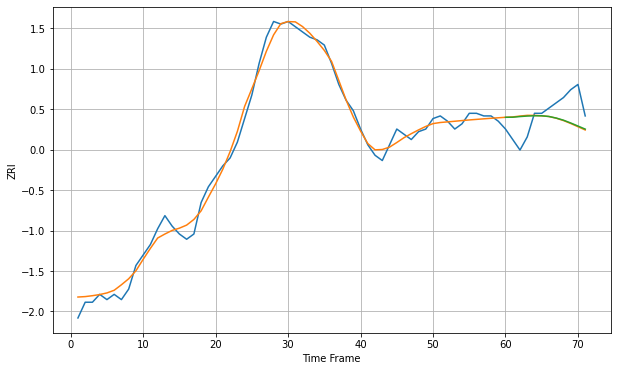

Wall time: 6.95 s
6492 3.0060260381574953 8.694736356646787 8.544859069432784 [1217.48165401 1217.51003426 1217.76005645 1217.95246594 1218.06102584
 1218.0534134  1217.78842635 1217.18872711 1216.3795965  1215.3102066
 1214.15191524 1212.97586455]

Got an mse at 0.0100 in round 112 and stopped training

71 71 12


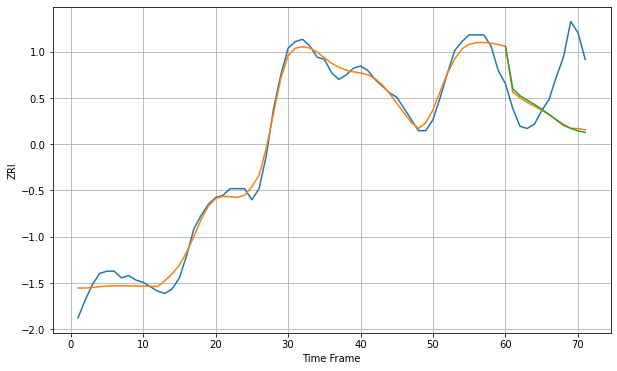

Wall time: 7.82 s
6511 4.124950844124017 24.433717437210554 24.91914315451235 [1273.78878745 1254.86847839 1251.70461919 1249.71451666 1247.79159645
 1245.65507327 1243.30677252 1240.844302   1238.38025931 1237.06814395
 1235.92495269 1235.22084437]

Got an mse at 0.0099 in round 49 and stopped training

71 71 12


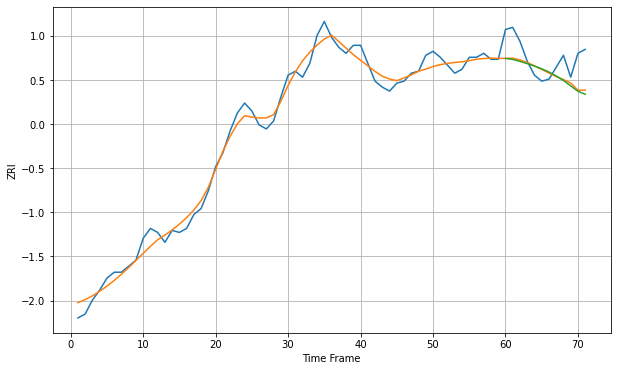

Wall time: 6.52 s
6512 4.373584109002114 11.359941119858938 11.962464679791074 [1315.43145634 1314.93862467 1313.93282448 1312.81748564 1311.59463756
 1310.21551078 1308.57905696 1306.60791269 1304.34322779 1301.61977004
 1298.95433977 1297.41041589]

Got an mse at 0.0099 in round 138 and stopped training

71 71 12


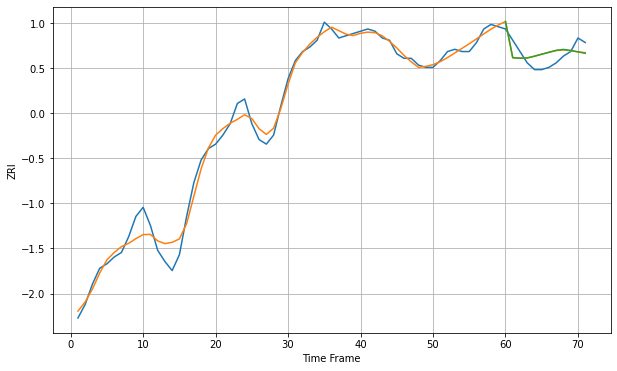

Wall time: 8.45 s
6513 3.9554516756958615 5.04252087083941 5.086598108106152 [1254.32319133 1238.29107389 1238.03666562 1238.1646043  1238.94067818
 1239.83305467 1240.69547455 1241.52554586 1241.94649756 1241.47441036
 1240.87691177 1240.22492862]

Got an mse at 0.0098 in round 76 and stopped training

71 71 12


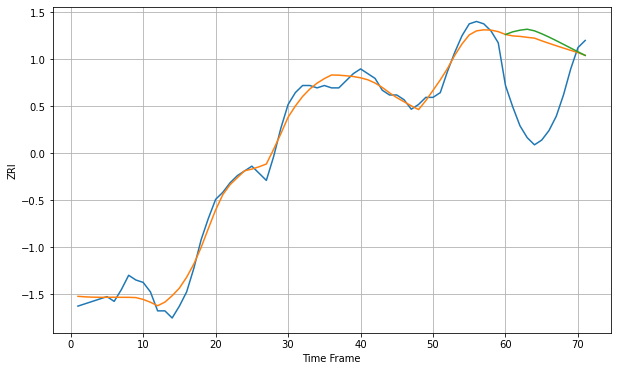

Wall time: 7.05 s
6515 3.905064103590265 30.38500917069532 32.464811049501854 [1243.51620963 1244.63008018 1245.32120489 1245.7291255  1245.05316527
 1243.81721036 1242.41819862 1240.91901956 1239.36348055 1237.7867332
 1236.21482572 1234.66701589]

Got an mse at 0.0100 in round 104 and stopped training

71 71 12


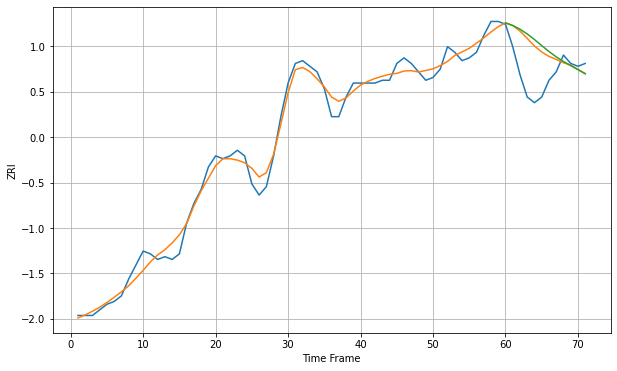

Wall time: 7.73 s
6516 3.214041983188081 11.258768603471726 12.347593907515064 [1272.49800548 1271.56606169 1270.24242565 1268.54148286 1266.53311967
 1264.37006232 1262.25785171 1260.35718006 1258.70425808 1257.22467083
 1255.79722636 1254.30041054]

Got an mse at 0.0099 in round 63 and stopped training

71 71 12


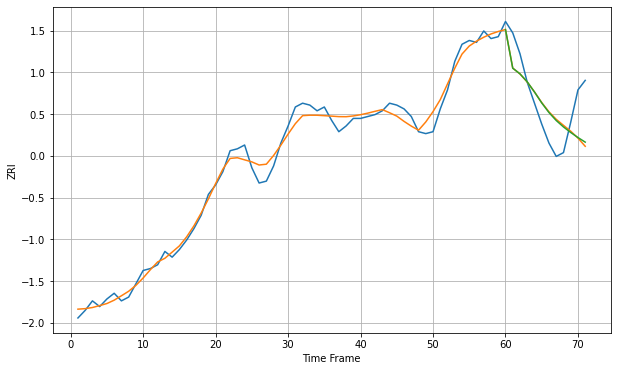

Wall time: 6.8 s
6519 4.350242169926322 16.74050045898024 16.1870816307092 [1289.75199201 1269.42320017 1266.42545989 1262.24760099 1256.90138623
 1251.14501431 1246.06548455 1241.89447173 1238.509669   1235.58719515
 1232.93837848 1230.51614206]

Got an mse at 0.0099 in round 93 and stopped training

71 71 12


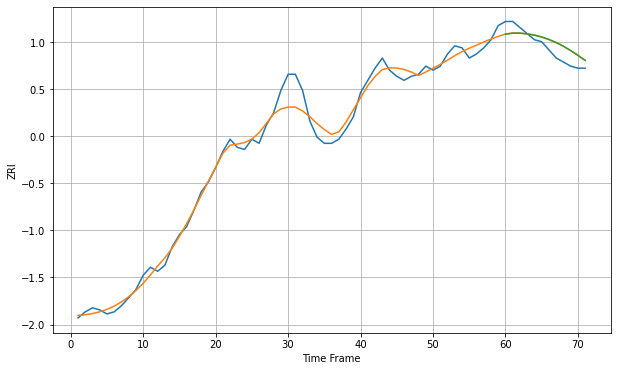

Wall time: 7.55 s
6604 4.574747355102951 5.3637167149421545 5.387876765991928 [1349.76965495 1350.24205808 1350.21140338 1349.88422951 1349.26264156
 1348.34306319 1347.12179176 1345.59720932 1343.77266079 1341.66046625
 1339.3423898  1336.83498167]

Got an mse at 0.0099 in round 145 and stopped training

71 71 12


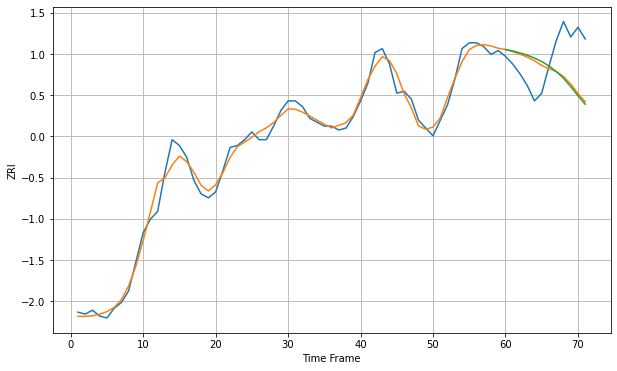

Wall time: 8.55 s
6605 4.219779068611568 20.151613188062505 21.04781861543154 [1412.53718432 1411.75552119 1410.75267518 1409.56958558 1408.13031867
 1406.32544299 1404.03349523 1401.16340264 1397.7267451  1393.40176324
 1388.72001252 1384.29530392]

Got an mse at 0.0099 in round 86 and stopped training

71 71 12


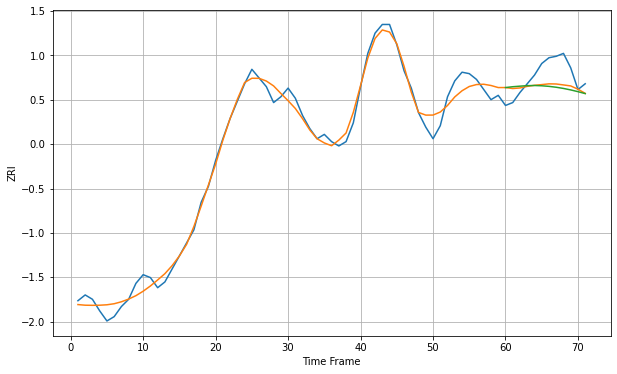

Wall time: 7.32 s
6606 6.062162310709539 12.55466645077597 13.847095711841568 [1423.38241439 1423.95316864 1424.34746665 1424.69663867 1424.7976482
 1424.6115362  1424.20807544 1423.59232017 1422.76733139 1421.74392057
 1420.54383426 1419.2006559 ]

Got an mse at 0.0099 in round 97 and stopped training

71 71 12


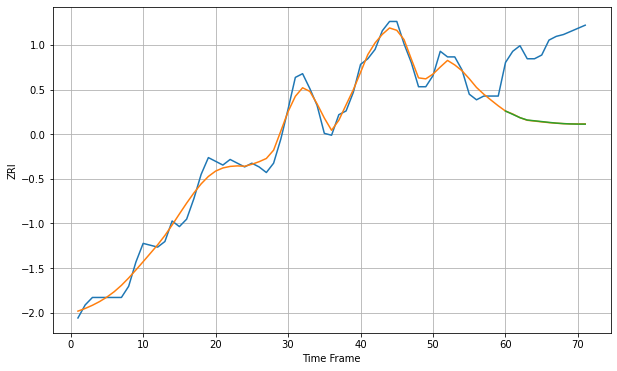

Wall time: 7.7 s
6607 4.726890808719427 41.92115856114815 41.91271023190633 [1300.95631494 1299.18261023 1297.40884001 1296.14877276 1295.73190167
 1295.31668882 1294.8802647  1294.49485917 1294.21772088 1294.0447754
 1293.95906398 1293.93781824]

Got an mse at 0.0100 in round 110 and stopped training

71 71 12


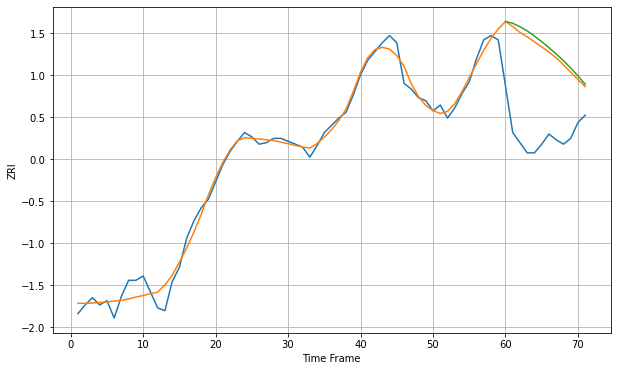

Wall time: 7.91 s
6608 5.77594696077861 59.64588628139421 62.52631300863474 [1385.7074374  1384.45328478 1382.04152637 1379.17018258 1375.61511944
 1371.73852602 1367.61580694 1363.24801774 1358.6378302  1353.56935365
 1348.06137922 1342.33346874]

Got an mse at 0.0099 in round 80 and stopped training

71 71 12


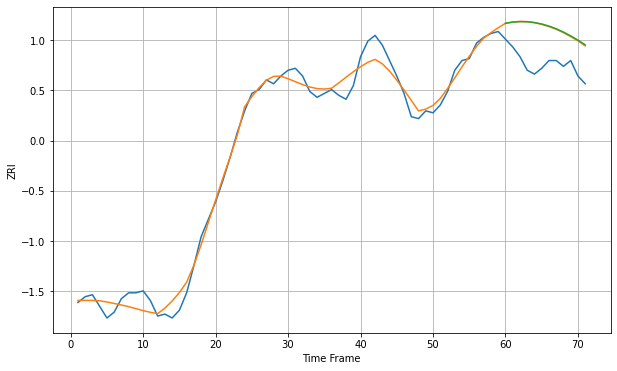

Wall time: 7.31 s
6610 5.1302888233965716 18.59572308264442 18.77828755135322 [1336.24335366 1336.84090706 1337.12452732 1337.05327059 1336.63496282
 1335.87851722 1334.79443088 1333.39603045 1331.7014329  1329.73550362
 1327.5311953  1325.13017662]

Got an mse at 0.0099 in round 299 and stopped training

71 71 12


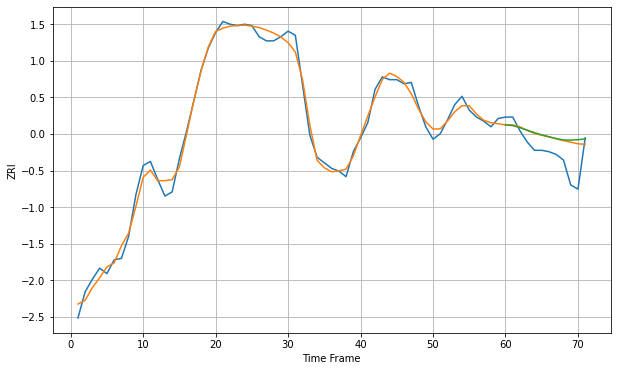

Wall time: 11.9 s
6614 5.246896839515513 15.521893428978625 16.35625423210971 [1478.355416   1477.85162532 1476.33371485 1474.52838107 1472.76288902
 1471.1300169  1469.79626741 1468.47014802 1467.49118736 1467.34268019
 1467.65116456 1468.26516897]

Got an mse at 0.0098 in round 168 and stopped training

71 71 12


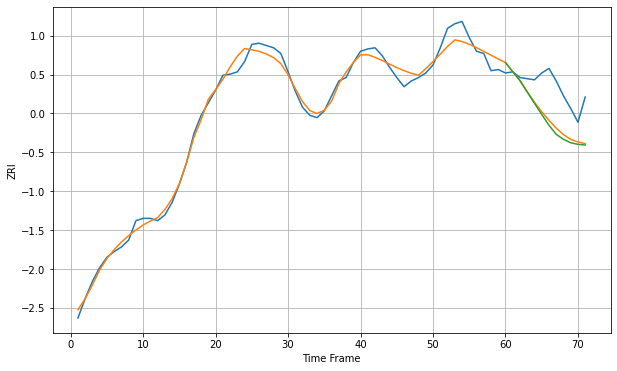

Wall time: 8.76 s
6615 6.669788848993285 27.893792841340723 30.35481945900259 [1479.09597648 1471.10516004 1463.35367258 1453.399221   1443.44668412
 1433.85515676 1424.29998727 1416.41959685 1412.08699449 1409.03715837
 1407.67034681 1407.1056718 ]

Got an mse at 0.0100 in round 138 and stopped training

71 71 12


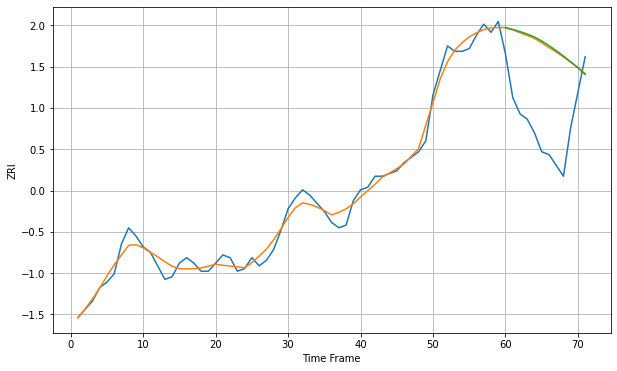

Wall time: 8.2 s
6704 3.0301322388532737 30.692267878889133 31.074810310087805 [986.73429023 986.06498435 985.27779037 984.34421161 983.26149349
 981.82778289 980.09962999 978.24319951 976.25812069 974.14127557
 971.89014416 969.50801372]

Got an mse at 0.0100 in round 152 and stopped training

71 71 12


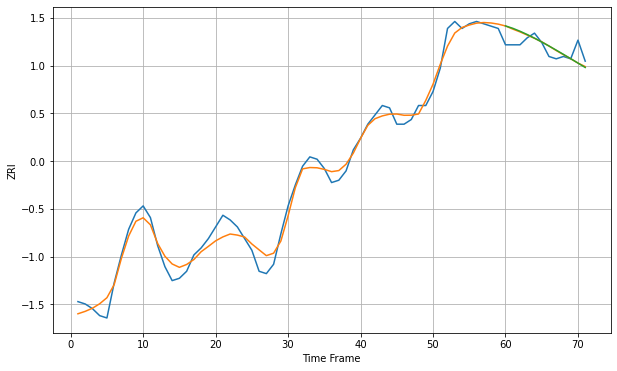

Wall time: 8.6 s
6705 4.03437651378824 4.853118100066839 4.953295072411141 [1014.07670832 1013.08029392 1011.81911266 1010.39758929 1008.85004715
 1007.20649672 1005.49064577 1003.71927587 1001.90414707 1000.05470364
  998.18038832  996.29197876]

Got an mse at 0.0098 in round 125 and stopped training

71 71 12


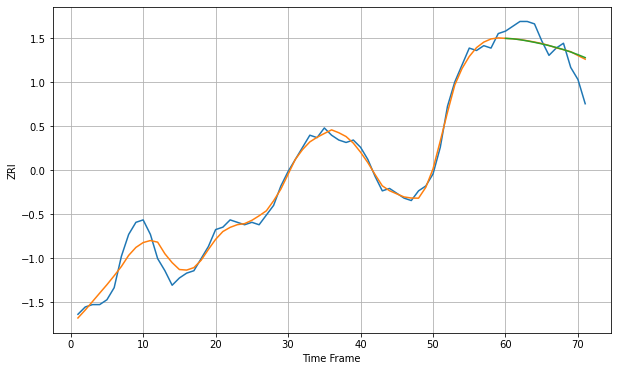

Wall time: 8.09 s
6708 3.5684853064324535 7.719277184514871 7.905980789023089 [1011.01438136 1010.83634329 1010.4653234  1009.95943024 1009.37498955
 1008.73476151 1008.03247946 1007.2504498  1006.37137066 1005.38324592
 1004.2813129  1003.06905504]

Got an mse at 0.0100 in round 183 and stopped training

71 71 12


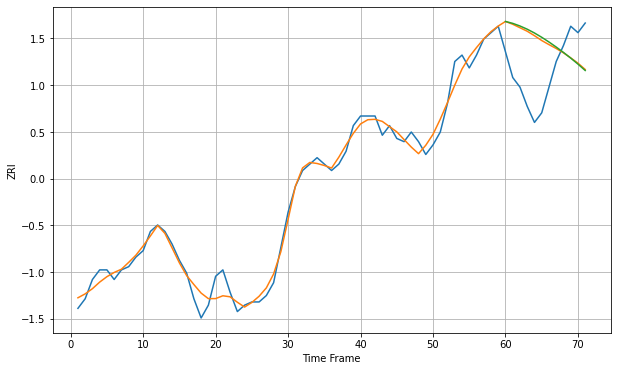

Wall time: 9.23 s
6710 2.9088873623136133 16.057977783253456 16.555426523413722 [925.49048755 924.89769668 924.07735031 923.07329386 921.89152933
 920.55189227 919.0825713  917.50716499 915.83587846 914.0663684
 912.19021421 910.19929916]

Got an mse at 0.0100 in round 107 and stopped training

71 71 12


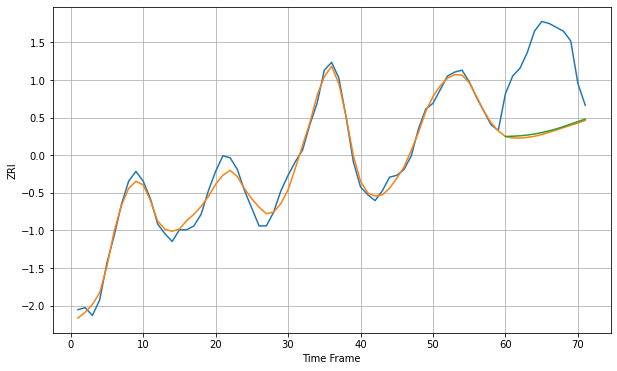

Wall time: 7.68 s
6770 3.806872981480591 42.50565566743762 41.74420850962078 [1108.9200514  1109.06695388 1109.27420369 1109.66066602 1110.21007909
 1110.92626178 1111.80453674 1112.82749528 1113.98051431 1115.28882853
 1116.59066785 1117.82388347]

Got an mse at 0.0099 in round 223 and stopped training

71 71 12


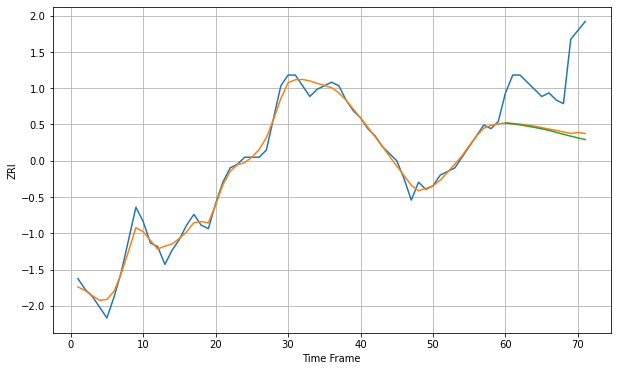

Wall time: 10.2 s
6790 1.99961684263823 17.078368244173763 17.78215798350965 [863.59544768 863.35358976 863.061798   862.72361588 862.34755381
 861.94510178 861.51734736 860.96672906 860.41979543 859.89848666
 859.40933239 858.95297863]

Got an mse at 0.0100 in round 208 and stopped training

71 71 12


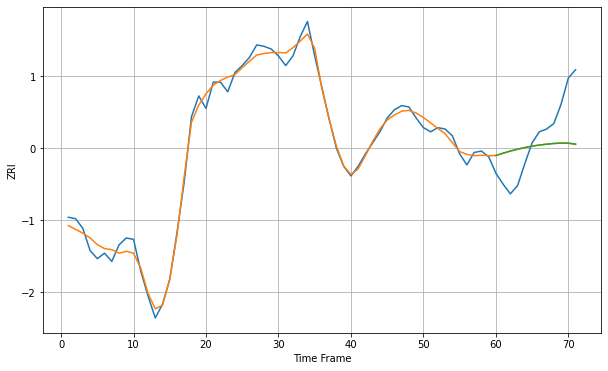

Wall time: 9.77 s
6810 5.195380789446147 27.171145436938293 27.112422288030768 [1648.79917521 1650.51420178 1652.0401397  1653.38742069 1654.56906347
 1655.59723886 1656.38343854 1656.99937051 1657.51026171 1657.80924667
 1657.78510311 1657.11604388]

Got an mse at 0.0098 in round 203 and stopped training

71 71 12


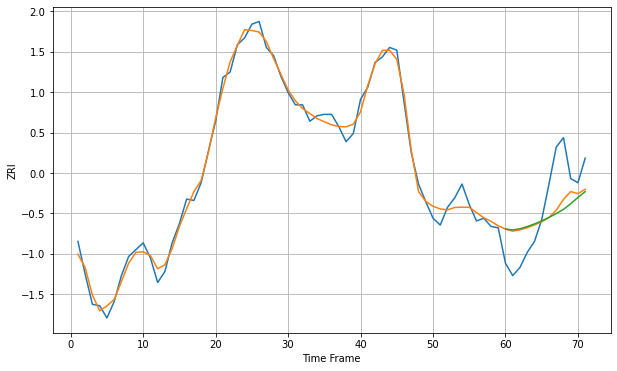

Wall time: 9.53 s
6824 5.815752578993156 26.413246722271563 28.640581053928617 [1837.06920573 1836.45072322 1837.27154514 1838.89266772 1840.83547306
 1843.05743014 1845.56727099 1848.41661887 1851.46164334 1855.6047044
 1860.23560478 1864.45847439]

Got an mse at 0.0100 in round 201 and stopped training

71 71 12


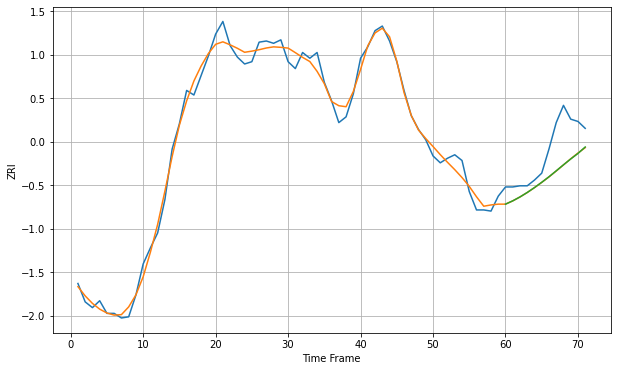

Wall time: 9.46 s
6825 7.546289701058227 25.63104507082153 25.59929590361016 [1629.04345596 1631.91974853 1635.32207215 1639.19798643 1643.46413601
 1648.04666909 1652.86876047 1658.02507974 1663.26525561 1668.33838661
 1673.15237081 1678.77206848]

Got an mse at 0.0100 in round 410 and stopped training

71 71 12


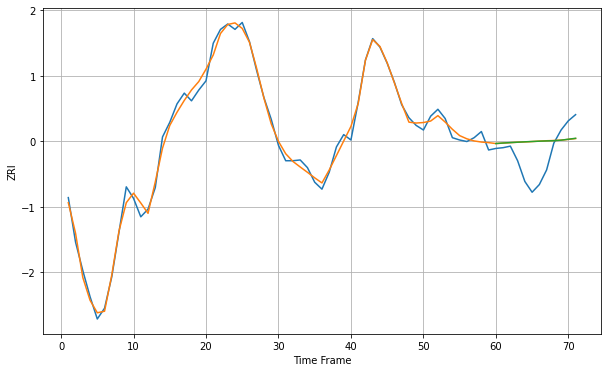

Wall time: 13.6 s
6830 8.492430953095674 34.22780075842019 34.19700131588162 [2319.37980818 2320.08474121 2320.61337337 2321.13170843 2321.61843443
 2322.05841324 2322.44633771 2322.78572895 2323.08726756 2323.7681468
 2324.97531872 2326.21129041]

Got an mse at 0.0098 in round 151 and stopped training

71 71 12


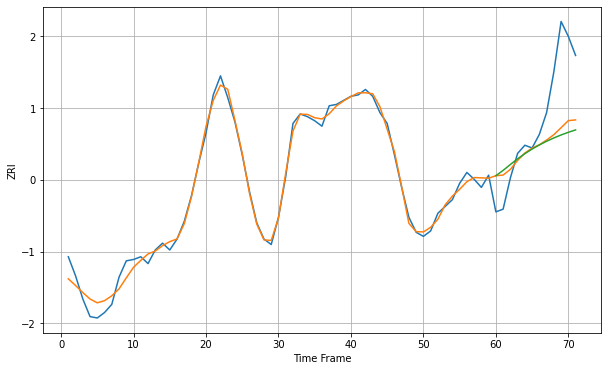

Wall time: 8.55 s
6851 5.19754882372825 36.76167587559759 40.277864465468625 [1817.59708693 1821.49805608 1825.85005151 1830.00729469 1833.80176558
 1837.19885553 1840.22640366 1842.93395311 1845.36726986 1847.5575201
 1849.52010504 1851.25792855]

Got an mse at 0.0099 in round 128 and stopped training

71 71 12


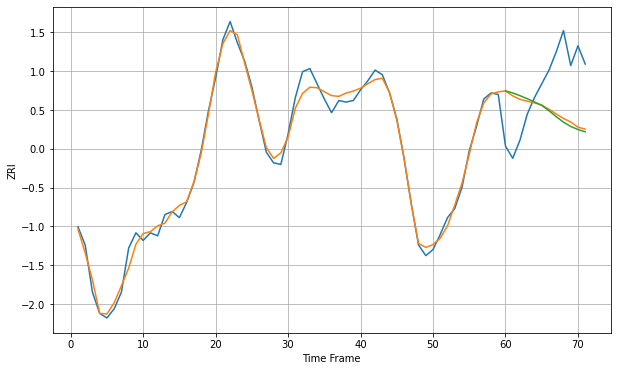

Wall time: 8.16 s
6854 5.043749732933164 36.23719561190941 37.766888858153315 [1834.34556453 1832.97418853 1831.19895942 1829.20080131 1827.0443837
 1824.82317316 1821.27899899 1817.36488159 1813.77057396 1810.96663
 1808.91191047 1807.44438505]

Got an mse at 0.0099 in round 160 and stopped training

71 71 12


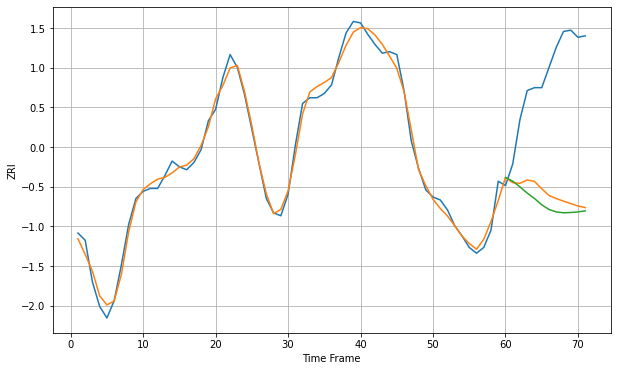

Wall time: 8.61 s
6855 5.448702746065392 86.84533158429589 93.18576785871777 [1803.64334806 1801.05185929 1797.04413643 1792.75862662 1789.02085679
 1784.63639292 1781.39107903 1779.69679993 1779.07654375 1779.26815435
 1779.69640845 1780.42183016]

Got an mse at 0.0097 in round 174 and stopped training

71 71 12


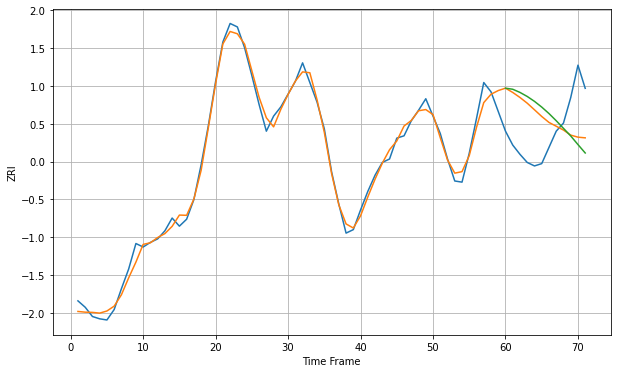

Wall time: 9.01 s
6902 6.462499709251142 40.55328702375254 45.792197110871 [2139.12797223 2138.19676384 2135.45752986 2131.97233938 2127.74146466
 2122.80046508 2117.22108454 2111.02041061 2104.44360312 2097.88589116
 2090.43623988 2083.17881718]

Got an mse at 0.0097 in round 192 and stopped training

71 71 12


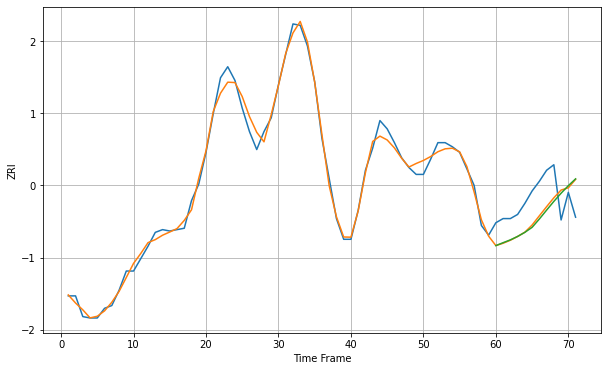

Wall time: 9.39 s
6906 5.116861656535294 20.943075242472467 21.71718310349014 [1899.42413695 1901.53582938 1903.57814529 1906.06549613 1909.03056565
 1912.64950369 1918.69370963 1925.12417168 1931.44464309 1937.38358567
 1942.82403719 1947.75679196]

Got an mse at 0.0095 in round 39 and stopped training

71 71 12


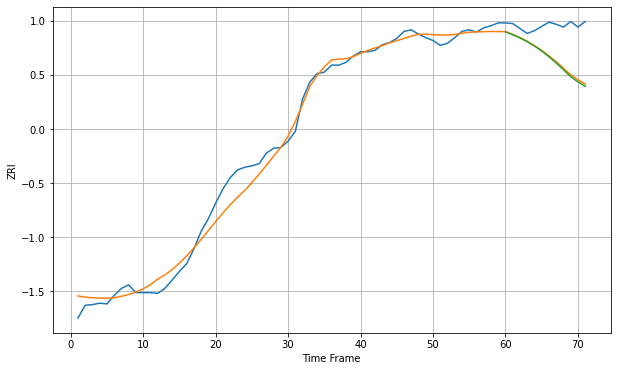

Wall time: 6.35 s
7002 14.330248272932218 50.02349482960247 51.80122703014076 [1821.45493605 1817.06206884 1812.54091246 1807.29914603 1801.16757373
 1794.0551909  1785.9573153  1776.98899128 1767.40870098 1757.60207052
 1750.26468866 1743.90525451]

Got an mse at 0.0098 in round 60 and stopped training

71 71 12


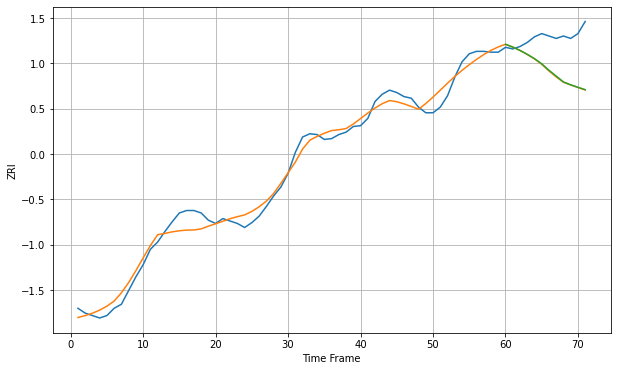

Wall time: 6.85 s
7003 10.966466011952663 45.51024523292032 45.12254524207639 [1650.75270363 1647.27653232 1643.13112901 1638.3140877  1632.97742904
 1626.58518533 1618.60311767 1611.37203362 1604.15314431 1600.57165144
 1597.51322139 1594.60770631]

Got an mse at 0.0097 in round 120 and stopped training

71 71 12


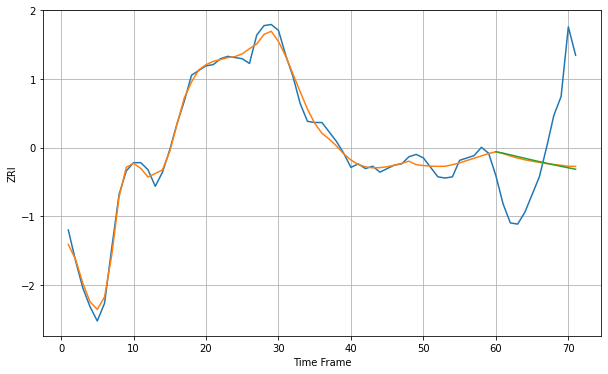

Wall time: 7.85 s
7030 5.6658863408568845 57.447284720969684 58.42213153300285 [2521.25697551 2520.06498899 2518.61515799 2517.16257382 2515.7209556
 2514.29768686 2512.8985395  2511.5282807  2510.1916234  2508.89443077
 2507.64436094 2506.44978611]
71 71 12


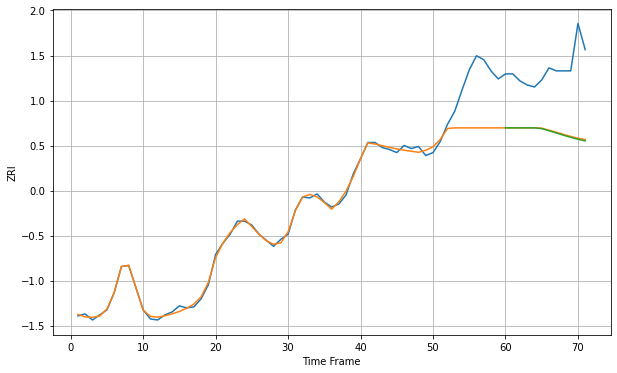

Wall time: 15.6 s
7055 18.67132847524113 64.69747453587375 65.2698061886221 [1682.48548925 1682.48548925 1682.48548925 1682.48548925 1682.48548925
 1681.73327826 1679.62431223 1677.39855117 1675.19407449 1673.11432106
 1671.22421537 1669.55158568]

Got an mse at 0.0100 in round 75 and stopped training

71 71 12


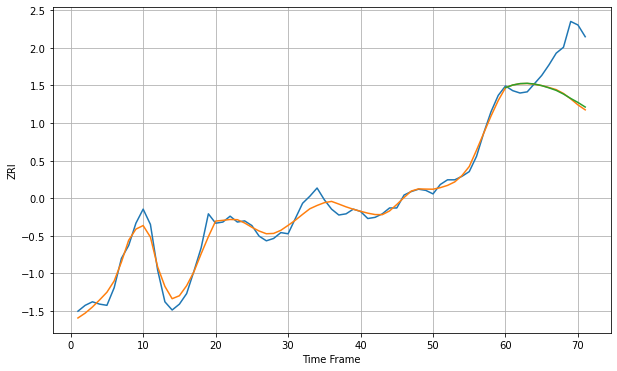

Wall time: 7.01 s
7093 6.29502680087809 36.50459847004387 35.90008078220114 [1986.51818888 1988.80616626 1990.02865429 1990.28536659 1989.66814782
 1988.30476107 1986.39773771 1984.23323767 1981.12340264 1977.36719568
 1973.94945606 1970.05516543]

Got an mse at 0.0098 in round 35 and stopped training

71 71 12


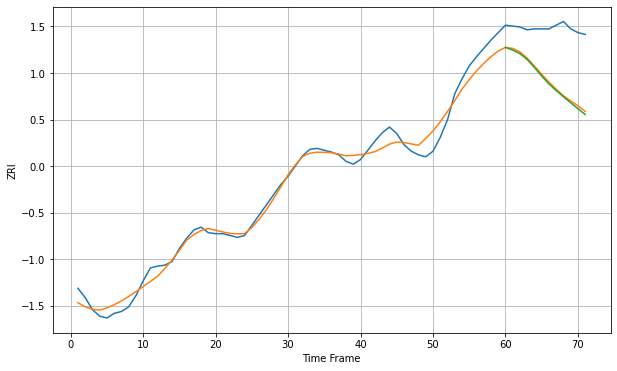

Wall time: 6.3 s
7109 9.649940476500195 58.11408763202543 59.93691042421857 [1595.02338966 1592.13733345 1588.22960342 1581.8850745  1573.26041052
 1564.06400818 1555.55391115 1548.49731909 1541.7666214  1535.27616219
 1528.85177829 1522.61642101]

Got an mse at 0.0090 in round 29 and stopped training

71 71 12


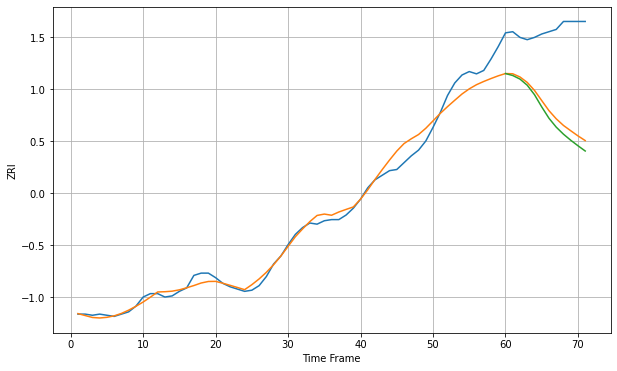

Wall time: 6.17 s
7111 8.008610228162775 70.94199678080743 76.9164030163437 [1407.26429576 1405.54559532 1402.38890162 1397.00866068 1388.706788
 1377.95942318 1368.00182526 1360.19776195 1354.00767811 1348.70489478
 1343.85556983 1339.24442686]

Got an mse at 0.0100 in round 47 and stopped training

71 71 12


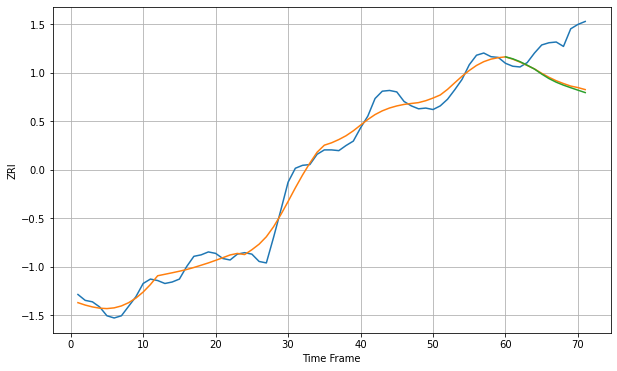

Wall time: 6.53 s
7201 13.114211241662392 51.530956259234344 53.48684785811112 [1748.78813664 1746.13035483 1742.22748976 1737.40637575 1732.12600166
 1725.29259688 1719.18115832 1714.22776417 1710.21103943 1706.74691577
 1703.38596082 1700.10431457]

Got an mse at 0.0099 in round 82 and stopped training

71 71 12


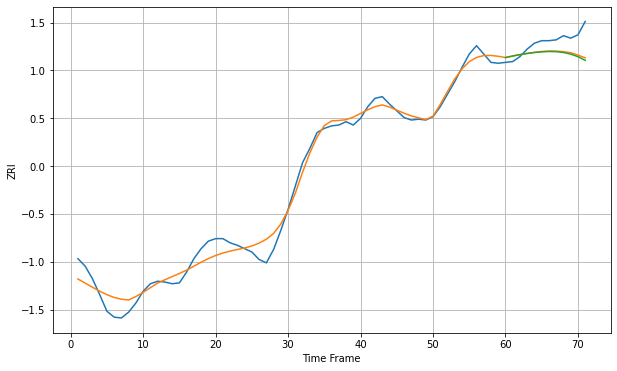

Wall time: 7.42 s
7202 11.330032965883168 18.015410174920337 19.160497325483778 [1699.7758152  1701.68789123 1703.34122488 1704.74097212 1705.8643283
 1706.66154454 1707.03281746 1706.82995112 1705.86574592 1703.93111362
 1700.82781414 1696.4229709 ]

Got an mse at 0.0099 in round 25 and stopped training

71 71 12


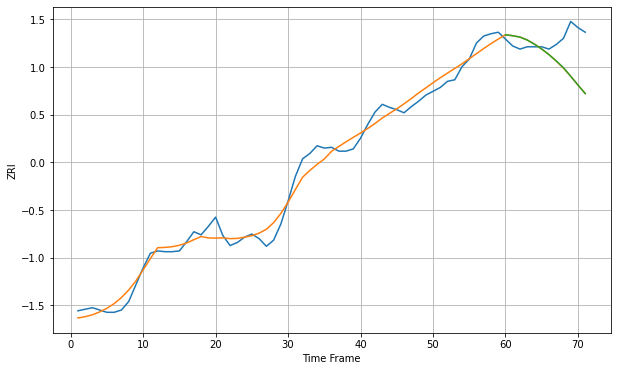

Wall time: 6.17 s
7206 12.113915629148766 40.490436849427205 40.43906288169825 [1726.62498064 1725.42509241 1723.64812432 1719.7403967  1714.38929265
 1708.07268583 1700.7812695  1692.60027578 1683.71094158 1672.56942805
 1661.17208774 1650.0439368 ]

Got an mse at 0.0097 in round 40 and stopped training

71 71 12


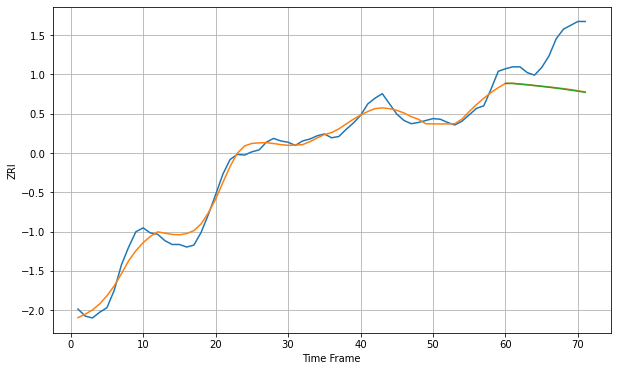

Wall time: 6.54 s
7302 11.97306991055168 67.27540875165857 67.7445475959697 [2488.08593286 2488.03754648 2486.94993689 2485.83541374 2484.6725981
 2483.43704271 2482.11509943 2480.70196251 2479.19745204 2477.60242326
 2475.91745614 2474.14363594]

Got an mse at 0.0098 in round 98 and stopped training

71 71 12


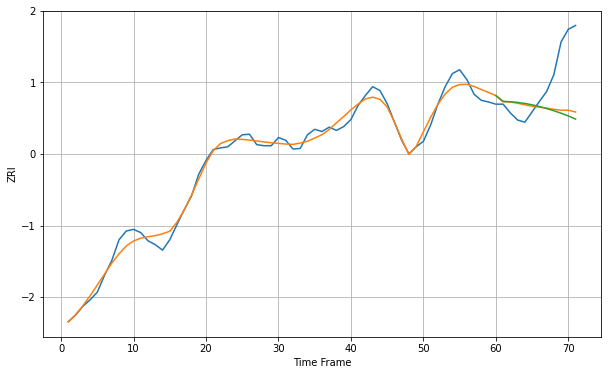

Wall time: 7.51 s
7960 12.815720825705192 76.59253007573975 81.63434328245495 [2236.67374445 2226.30607174 2225.32547217 2224.206826   2222.35921318
 2219.83043905 2216.6945583  2213.03254376 2208.96443439 2204.48140556
 2199.48969159 2193.72916379]

Got an mse at 0.0099 in round 163 and stopped training

71 71 12


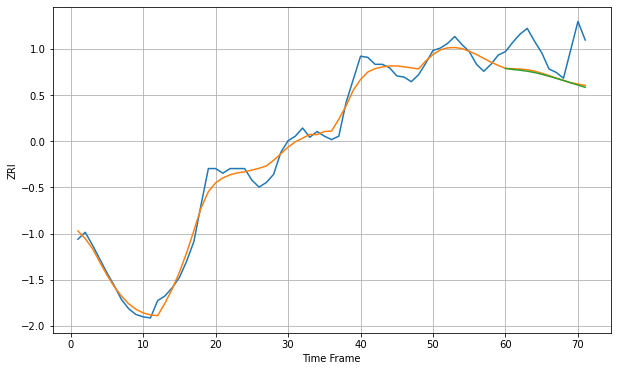

Wall time: 9.01 s
8901 7.913475784411635 27.70901957091166 28.474162335745916 [1731.45121069 1730.57751044 1729.93091142 1729.06158664 1727.94693187
 1726.43132736 1724.71914224 1722.90099704 1721.00336729 1719.05625396
 1717.09228669 1715.1427265 ]

Got an mse at 0.0099 in round 68 and stopped training

71 71 12


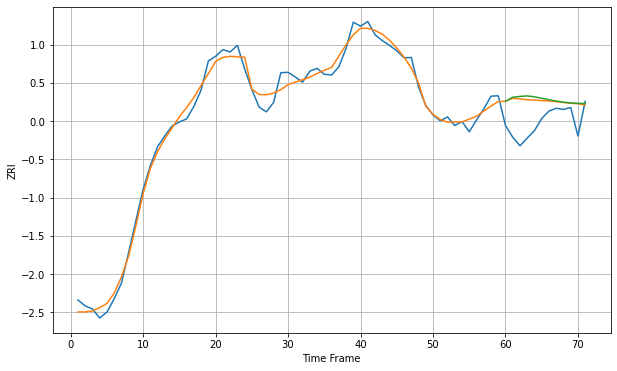

Wall time: 7.05 s
10001 19.34255320898331 67.29441064990743 71.13211597060592 [3717.1023335  3727.34475978 3729.3670903  3730.64287521 3728.40195272
 3724.71308913 3720.96148065 3717.53065024 3714.70709227 3712.70797044
 3711.60908459 3711.40080229]

Got an mse at 0.0100 in round 369 and stopped training

71 71 12


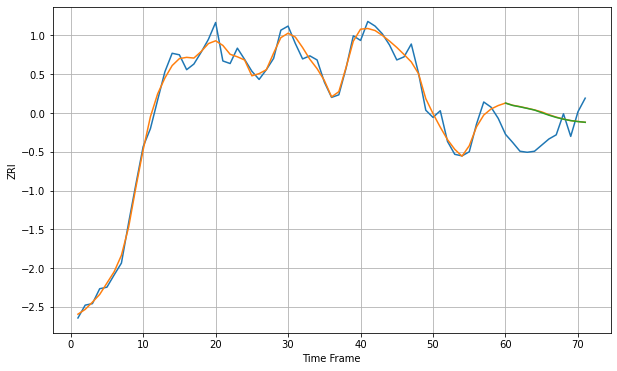

Wall time: 13.4 s
10002 15.093838747033324 58.93923797449977 58.54042616673562 [3501.92764893 3497.2844782  3494.58660933 3491.51546958 3488.35044565
 3483.18700899 3478.22126208 3473.95561288 3470.4840465  3467.80174066
 3465.83464116 3464.47242423]

Got an mse at 0.0100 in round 277 and stopped training

71 71 12


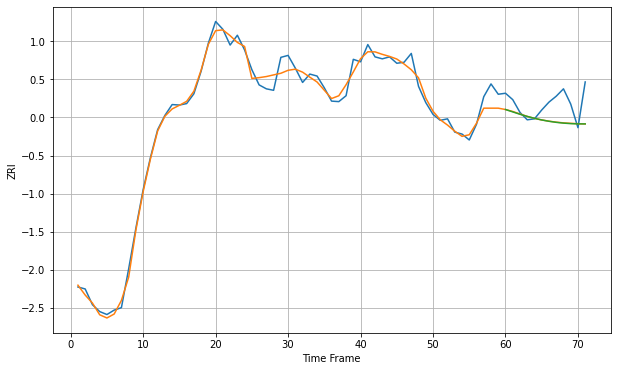

Wall time: 11.3 s
10003 15.530072464473676 40.93768001899928 41.149804368041366 [3629.9351583  3625.07704158 3620.25441984 3615.87998964 3612.01715323
 3608.71014753 3605.9842491  3603.84251542 3602.27021515 3601.24127489
 3600.72227814 3600.67366669]

Got an mse at 0.0099 in round 107 and stopped training

71 71 12


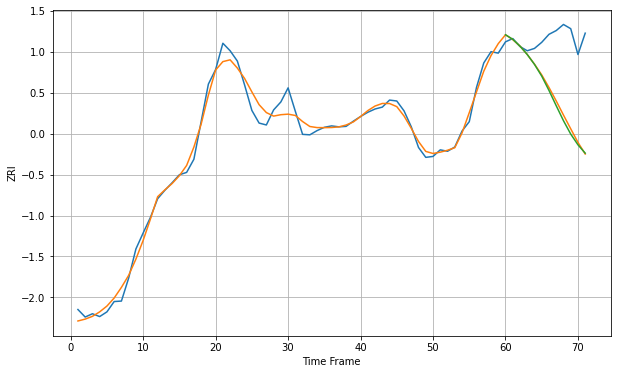

Wall time: 7.7 s
10005 17.228669658221694 137.05337321684627 141.755635532146 [3716.06505583 3706.46912016 3691.88184082 3674.09252709 3653.02639486
 3627.95226606 3597.55733935 3564.93866305 3533.08118065 3504.6105192
 3481.71756427 3463.96691427]

Got an mse at 0.0099 in round 137 and stopped training

71 71 12


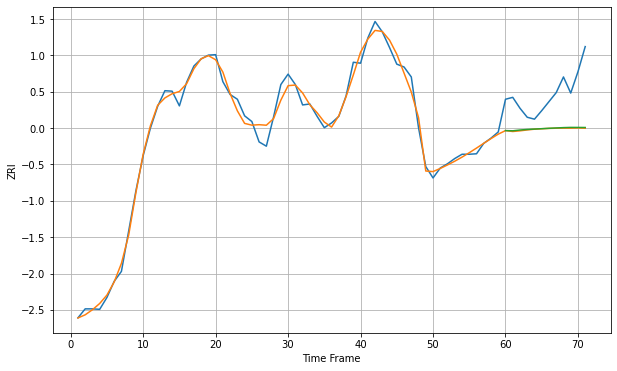

Wall time: 8.53 s
10009 15.263635029259694 83.70164873242169 82.79511585020462 [3673.8881874  3673.47710791 3675.11696767 3676.32903755 3677.07375844
 3677.9176448  3678.7161256  3679.46368658 3680.1808641  3680.61436205
 3680.55674884 3680.42087484]

Got an mse at 0.0100 in round 102 and stopped training

71 71 12


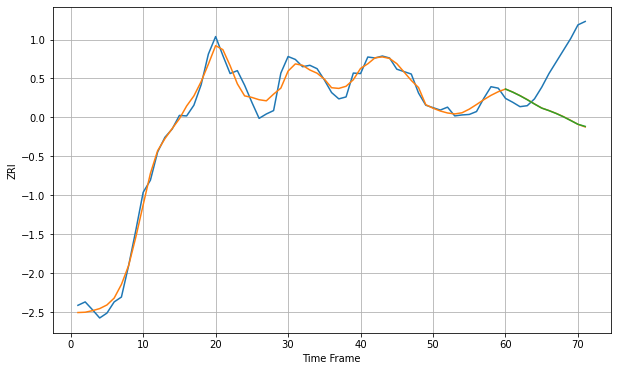

Wall time: 7.81 s
10010 15.834701770136643 114.00145650579934 113.90890172608492 [3678.19044757 3671.82697516 3664.49103964 3656.30167268 3647.44371606
 3639.10919656 3633.8842818  3627.9501469  3621.15827582 3613.53604938
 3605.8130825  3601.46728077]

Got an mse at 0.0100 in round 123 and stopped training

71 71 12


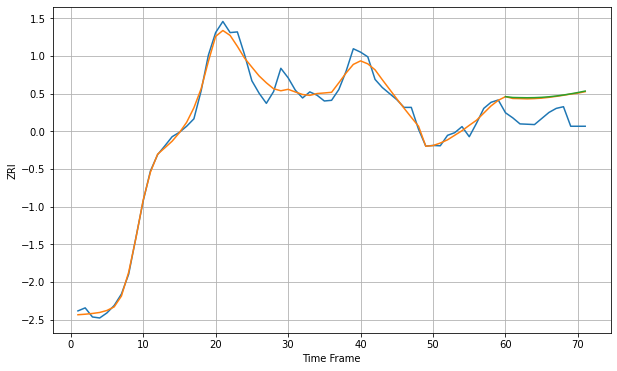

Wall time: 8.07 s
10011 22.134565750204615 70.8751513081161 72.73463122031188 [3834.88362578 3832.45063696 3831.9627744  3831.63510895 3831.96661996
 3832.86171421 3834.49004744 3836.81171399 3839.75677083 3843.24052603
 3847.16914579 3851.44286146]

Got an mse at 0.0100 in round 295 and stopped training

71 71 12


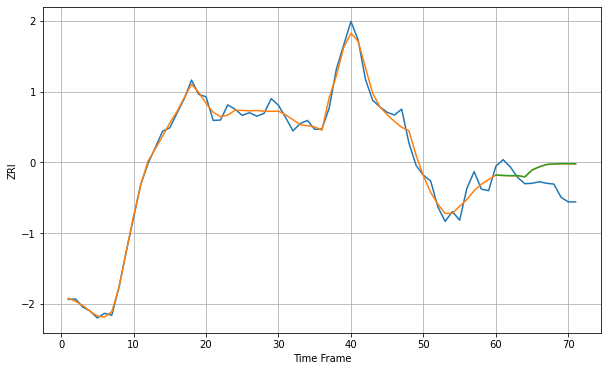

Wall time: 11.4 s
10012 18.13234399880842 55.83239423764019 56.01928672645541 [3549.16962336 3548.24478711 3547.86389652 3547.84667774 3544.65543321
 3562.30504813 3570.49476124 3576.5565659  3577.92564138 3578.65801663
 3578.65775164 3578.46238654]

Got an mse at 0.0100 in round 113 and stopped training

71 71 12


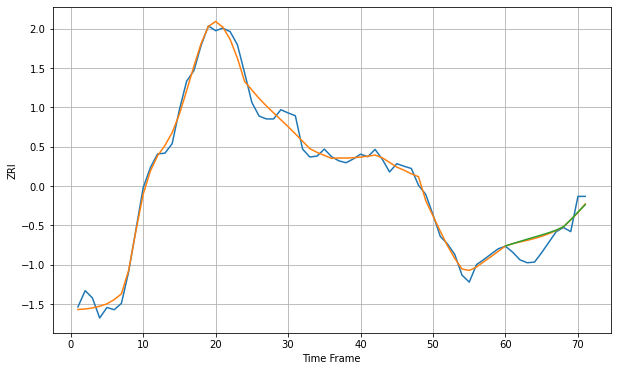

Wall time: 7.54 s
10013 24.64091745457017 43.1651102934924 45.05926957775138 [4442.88641523 4450.17338429 4457.25304869 4464.16176963 4470.89485831
 4477.60184381 4484.68964947 4492.76411418 4503.22737606 4525.34772839
 4549.71016416 4572.88388837]

Got an mse at 0.0099 in round 126 and stopped training

71 71 12


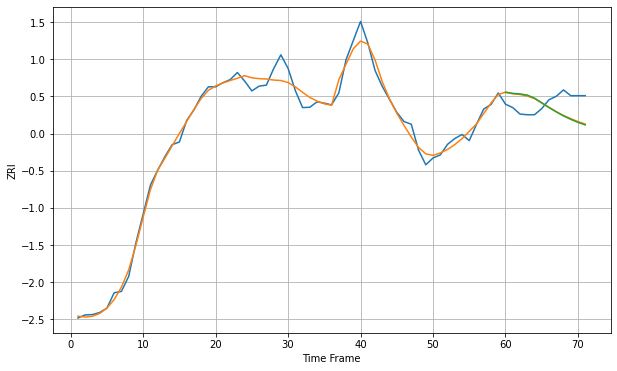

Wall time: 8.11 s
10014 21.616453939609997 55.67840993307306 57.171309702262924 [3865.12642727 3861.85839619 3860.04064854 3856.83749509 3847.64236951
 3834.28542493 3820.58999495 3807.52001472 3795.72632217 3785.46238253
 3776.66155706 3769.09208789]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


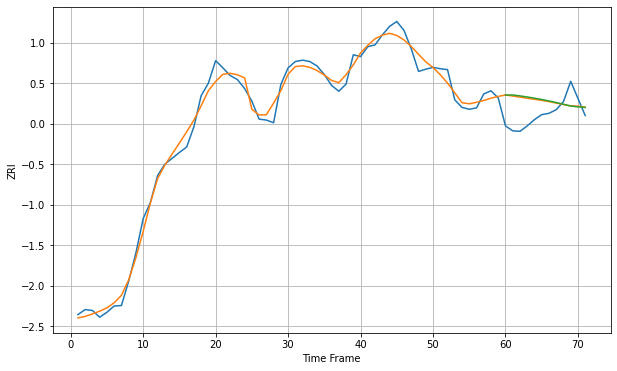

Wall time: 6.98 s
10016 17.744184776094002 48.14212808676916 49.57912389748617 [3583.66072331 3583.67621879 3581.6463139  3579.26939218 3576.5955406
 3573.63093049 3570.38791378 3566.88373938 3563.13354787 3559.13925799
 3557.30809659 3556.06689217]

Got an mse at 0.0098 in round 85 and stopped training

71 71 12


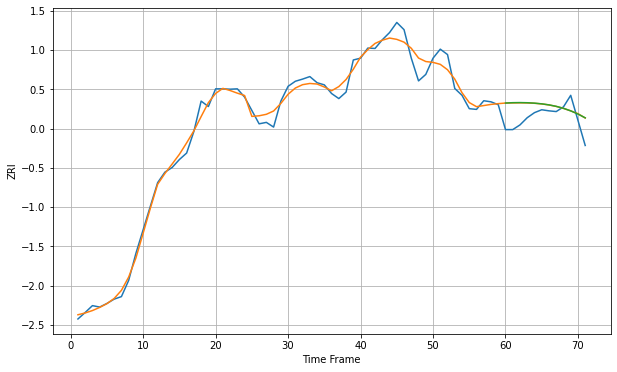

Wall time: 7.21 s
10017 21.44644504260148 46.275292700877806 46.57948653706712 [3517.61316648 3518.61613334 3518.88264043 3518.46560251 3517.3442459
 3515.42207459 3512.53566638 3508.47441551 3503.00187499 3495.89973543
 3487.06071829 3476.62781707]

Got an mse at 0.0100 in round 115 and stopped training

71 71 12


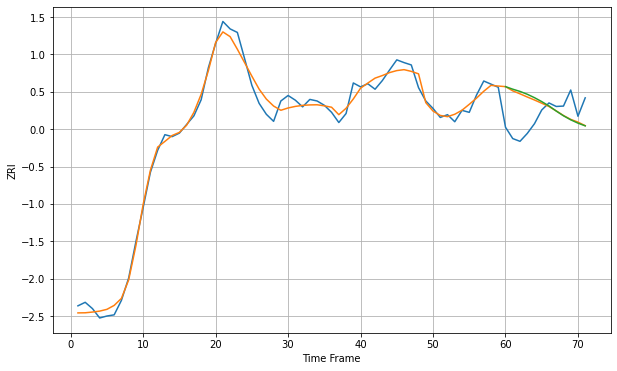

Wall time: 7.75 s
10018 18.877613462397854 73.38562611628049 76.27506108375042 [3692.63481739 3686.12008512 3680.40280512 3673.20768086 3664.45296646
 3654.39506062 3643.34193542 3630.27707301 3618.23696314 3607.91791702
 3599.41084182 3592.48618422]

Got an mse at 0.0100 in round 123 and stopped training

71 71 12


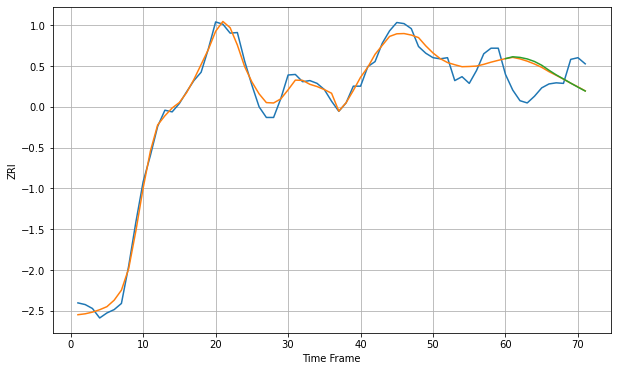

Wall time: 7.86 s
10019 14.50096187099041 48.07132465991645 49.927663333753564 [3628.33358978 3631.64357687 3630.51389808 3627.78475142 3623.2072864
 3616.47724399 3607.51131571 3599.22091423 3591.91130237 3584.46986681
 3577.22179298 3570.32212067]

Got an mse at 0.0099 in round 83 and stopped training

71 71 12


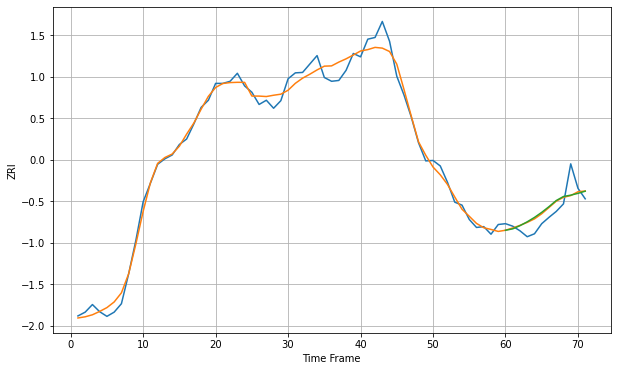

Wall time: 6.99 s
10021 19.442863921706234 30.095300689090966 31.011031100424102 [3101.38950134 3104.7119675  3112.27691972 3121.43497735 3131.85777505
 3143.89475999 3157.35355423 3171.90495464 3181.4860458  3184.68061283
 3188.93837821 3194.13508174]

Got an mse at 0.0100 in round 63 and stopped training

71 71 12


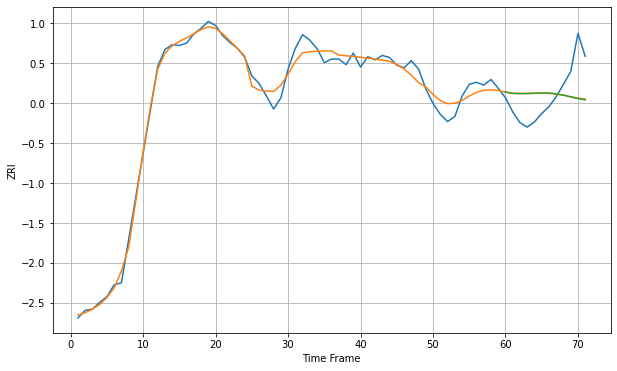

Wall time: 6.64 s
10022 19.7553110205958 74.1382939502368 74.55865641725191 [3966.67414886 3963.25307132 3962.80711694 3962.98437249 3963.51372704
 3964.18950354 3964.22463361 3962.04533334 3958.9328983  3954.48937684
 3950.48306652 3947.07126642]

Got an mse at 0.0099 in round 92 and stopped training

71 71 12


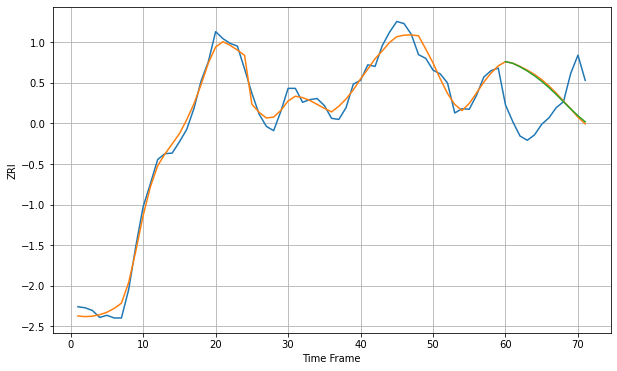

Wall time: 7.25 s
10023 15.004656176998154 91.74669374370966 90.14444568339513 [3595.97602001 3592.79718368 3586.29444184 3578.55327026 3569.52550997
 3559.13844944 3547.40231322 3534.52785806 3521.01438625 3507.58157882
 3494.93480515 3483.53280582]

Got an mse at 0.0100 in round 301 and stopped training

71 71 12


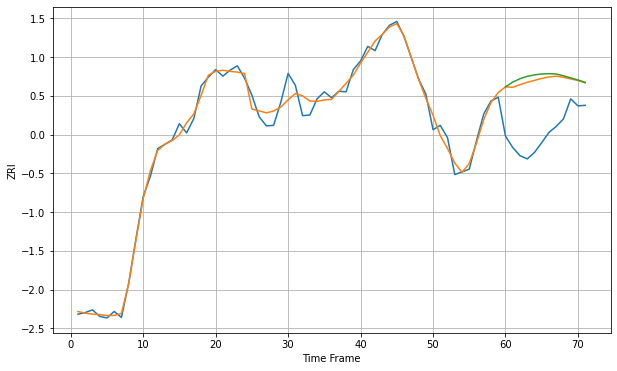

Wall time: 12.2 s
10024 14.282960132623252 100.04481407682641 106.52309319085197 [3469.10706744 3478.00069071 3484.23927584 3488.54066098 3491.2975365
 3492.90426723 3493.47714563 3492.91503959 3489.56800424 3485.79624141
 3481.75156721 3477.52742657]

Got an mse at 0.0100 in round 382 and stopped training

71 71 12


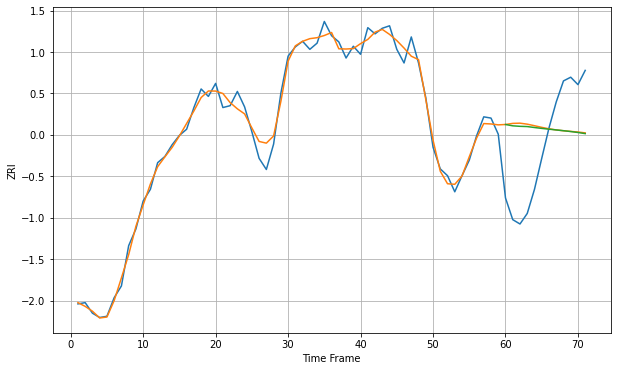

Wall time: 12.6 s
10025 13.333687626365332 104.39462862003373 102.65699269231217 [3627.65532959 3625.50021514 3624.69853044 3624.3024632  3622.77314369
 3621.35979743 3620.08628173 3618.87274411 3617.63555665 3616.28409401
 3614.7334235  3612.91984445]

Got an mse at 0.0100 in round 194 and stopped training

71 71 12


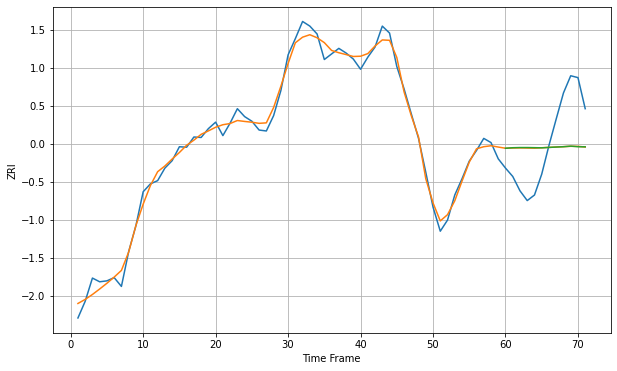

Wall time: 9.18 s
10027 16.208611337737842 95.47534106416317 95.78365061446202 [3002.76502971 3003.89222458 3004.27700635 3004.27655838 3004.01383008
 3003.69179758 3004.56279558 3005.36991526 3006.09025021 3007.31743037
 3006.11385242 3005.84994586]

Got an mse at 0.0100 in round 99 and stopped training

71 71 12


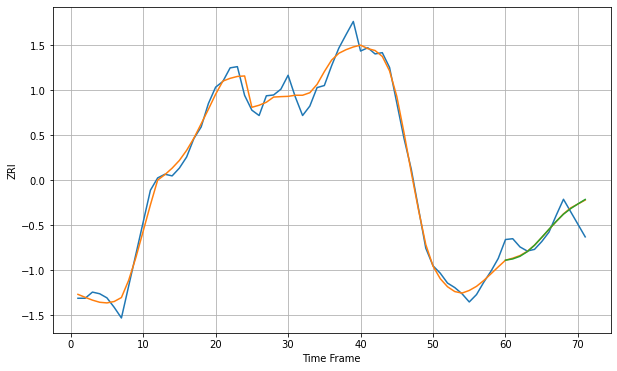

Wall time: 7.44 s
10028 21.7725924666032 38.236685027842945 38.84877041163181 [2998.69632482 3001.77633574 3008.20283505 3019.35519443 3035.10261875
 3054.33418739 3074.0648151  3093.23916535 3110.71742764 3124.35896591
 3135.79016946 3146.60969768]

Got an mse at 0.0099 in round 272 and stopped training

71 71 12


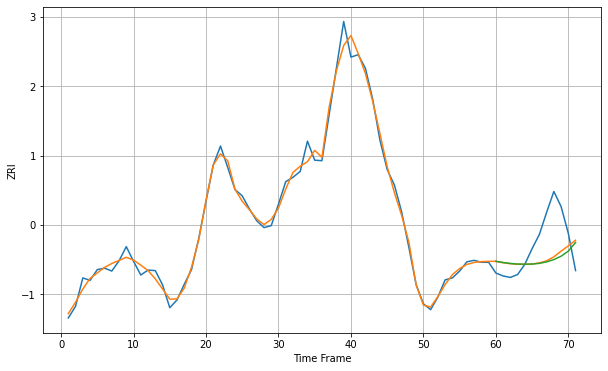

Wall time: 10.8 s
10029 14.130245647674856 62.9044235452253 65.66865806032136 [2790.98968711 2788.54644031 2786.59965195 2785.4096868  2785.14213633
 2785.39429867 2786.80874386 2789.77001801 2794.55293272 2801.40596811
 2811.88468392 2829.59030314]

Got an mse at 0.0100 in round 365 and stopped training

71 71 12


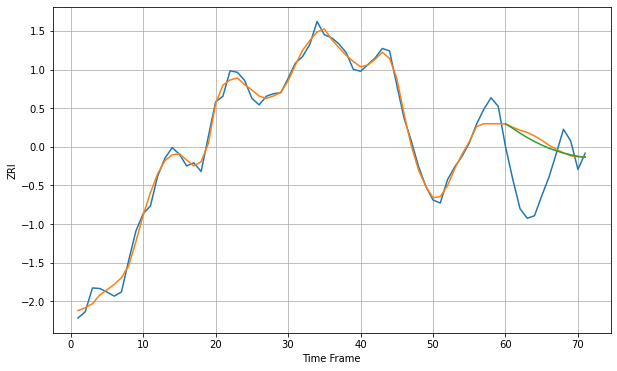

Wall time: 12.3 s
10031 15.062616839903919 95.29632926807842 90.11799557677709 [2749.65580204 2741.00763842 2731.39951331 2722.76071762 2714.95753436
 2707.98892655 2701.88275909 2696.66025379 2692.30544253 2688.76151403
 2685.9523812  2683.81030012]

Got an mse at 0.0099 in round 87 and stopped training

71 71 12


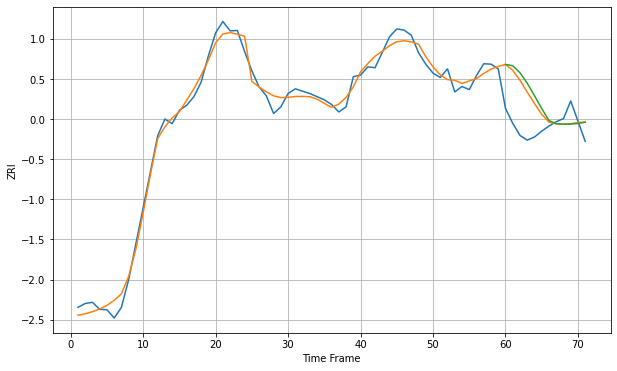

Wall time: 7.33 s
10036 20.30553823144587 82.24391193256012 92.06641150341802 [3598.32099821 3595.08043729 3576.90011964 3550.49151015 3518.32234297
 3485.69342853 3455.07317598 3447.0263233  3445.73450718 3446.09864395
 3447.55107847 3450.76286499]
71 71 12


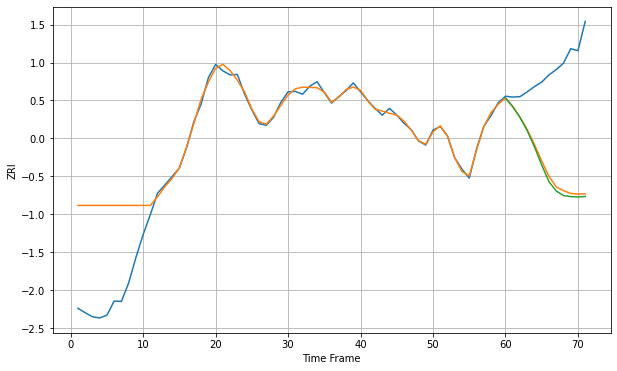

Wall time: 15.3 s
10038 95.58407870864286 251.14200844135183 258.318816144856 [3885.62002349 3864.14571148 3837.31538865 3804.64336795 3764.29632717
 3719.35405342 3677.93481776 3655.03417566 3643.68369601 3641.01636445
 3640.14994293 3641.30068285]

Got an mse at 0.0100 in round 137 and stopped training

71 71 12


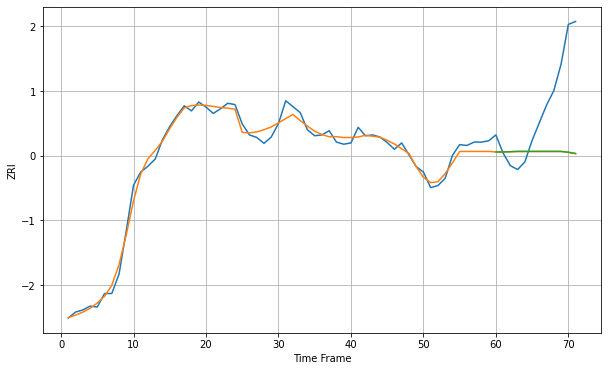

Wall time: 8.06 s
10065 15.228653497438744 151.8816340056091 151.66500189694182 [3931.61606333 3931.59104343 3932.19365398 3932.84278485 3932.84278485
 3932.84278485 3932.84278485 3932.84278485 3932.84278485 3932.84278485
 3931.11024758 3928.05691189]

Got an mse at 0.0099 in round 53 and stopped training

71 71 12


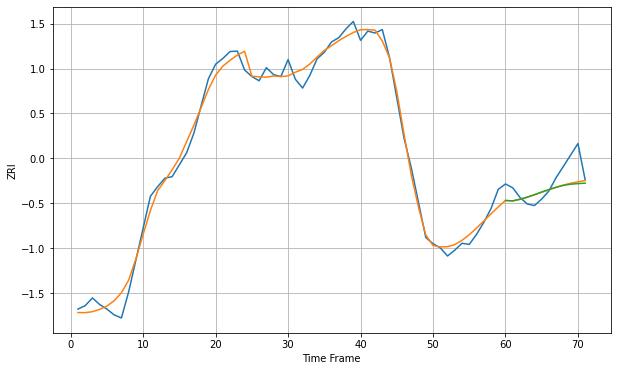

Wall time: 6.42 s
10075 23.0290678686976 43.54771341032884 44.959360468923826 [3026.09765944 3025.22725742 3028.97344029 3034.65809469 3041.30171008
 3048.202072   3054.5933757  3060.49789498 3065.41582581 3068.41655502
 3069.91923792 3071.11408494]

Got an mse at 0.0100 in round 105 and stopped training

71 71 12


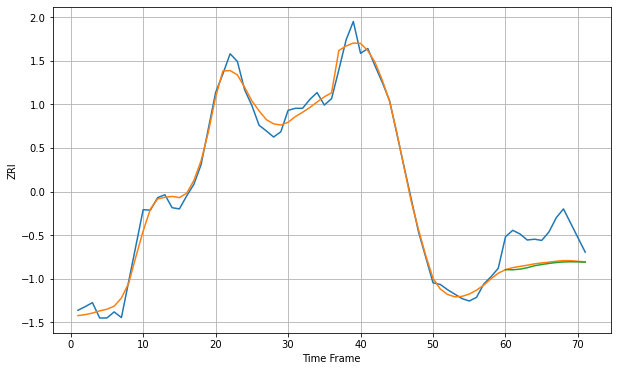

Wall time: 7.47 s
10128 21.393993858875813 80.84473610643165 84.26746206717118 [2837.61283658 2837.27978479 2838.92928028 2842.38183432 2847.31017459
 2850.29017148 2853.03940262 2855.2590002  2856.6167537  2857.07664645
 2856.85016491 2856.22218767]

Got an mse at 0.0099 in round 63 and stopped training

71 71 12


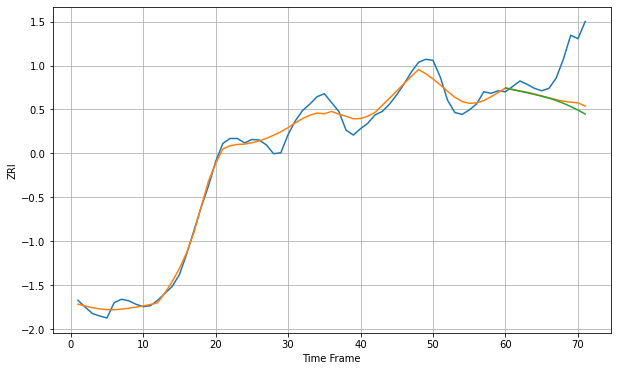

Wall time: 6.76 s
10302 17.652115493301018 79.51478632378456 86.25060396980238 [1874.63757815 1871.58554246 1868.26816788 1864.98002137 1861.65116319
 1857.95432831 1854.04576359 1849.26754634 1843.58876846 1837.04452742
 1829.80965223 1821.79695164]

Got an mse at 0.0100 in round 67 and stopped training

71 71 12


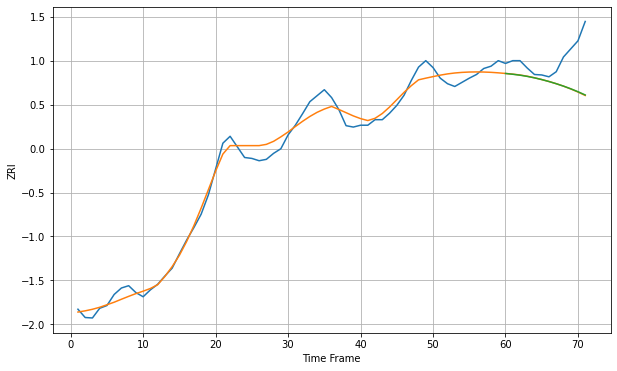

Wall time: 6.82 s
10303 18.921167999973466 66.5458813687722 66.23662865141752 [2043.23525356 2041.49984509 2039.50359746 2036.89262257 2033.71325142
 2029.99764678 2025.76512396 2021.02881298 2015.78719541 2010.01129117
 2003.64666476 1996.63496353]

Got an mse at 0.0099 in round 82 and stopped training

71 71 12


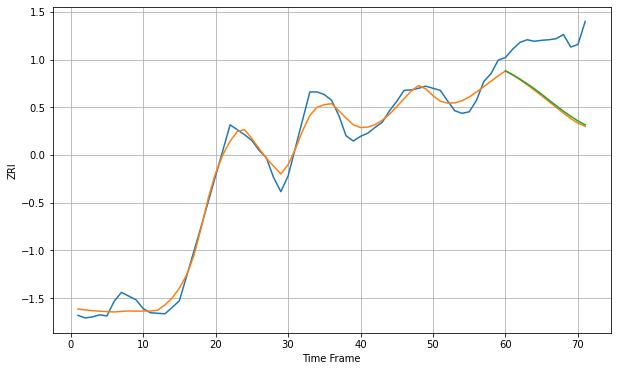

Wall time: 7.01 s
10304 17.93576617244342 119.56136096371387 116.83920925733582 [1907.35005473 1899.93908619 1891.58974126 1882.55541195 1872.9225867
 1862.53775812 1851.48184186 1840.62784895 1830.19741264 1820.4048831
 1811.4197459  1803.95504654]

Got an mse at 0.0098 in round 58 and stopped training

71 71 12


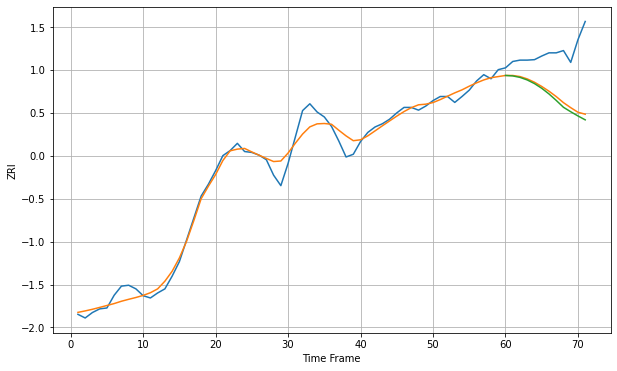

Wall time: 6.5 s
10305 18.520535767395007 99.00153128821935 105.59698339899712 [1930.27109045 1929.28859304 1926.03660307 1920.38480905 1912.37963851
 1902.0858204  1889.65482701 1875.40806519 1860.27463809 1850.47614152
 1841.23948533 1832.6604053 ]

Got an mse at 0.0100 in round 80 and stopped training

71 71 12


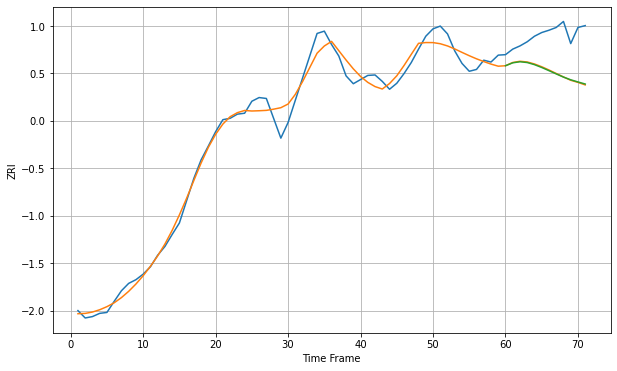

Wall time: 6.92 s
10306 20.449533435593313 82.91020734594649 83.05499270458776 [1889.9901664  1896.30438802 1898.63354917 1896.92345817 1892.34495747
 1886.20214965 1879.31681459 1872.25672201 1865.35686139 1859.51149969
 1854.85795209 1850.31389105]

Got an mse at 0.0100 in round 126 and stopped training

71 71 12


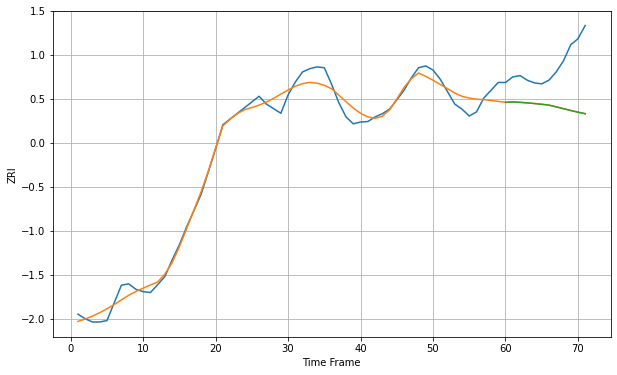

Wall time: 7.68 s
10310 18.978467218619 98.74827605334528 98.70290619951334 [1893.71150051 1894.48786669 1893.65842528 1892.53207393 1891.15994512
 1889.54842773 1887.72694822 1883.93285755 1879.99980559 1876.11832589
 1872.458039   1869.14671041]

Got an mse at 0.0099 in round 111 and stopped training

71 71 12


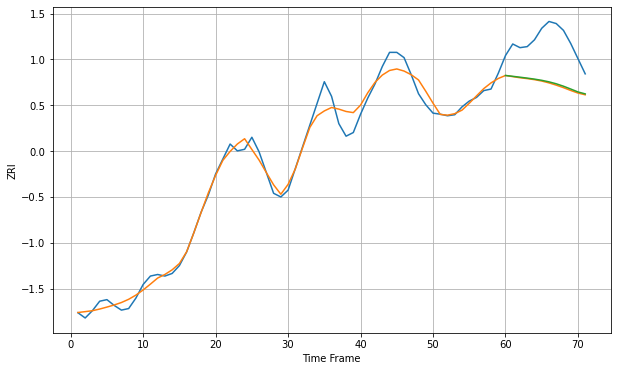

Wall time: 7.57 s
10312 17.33798355959361 82.5613647228063 80.86415287819703 [1768.89710113 1767.30885493 1765.61550085 1763.85520324 1761.93788234
 1759.66072553 1756.76255985 1753.04029421 1748.43468006 1743.04087245
 1737.48170388 1733.74751906]

Got an mse at 0.0100 in round 150 and stopped training

71 71 12


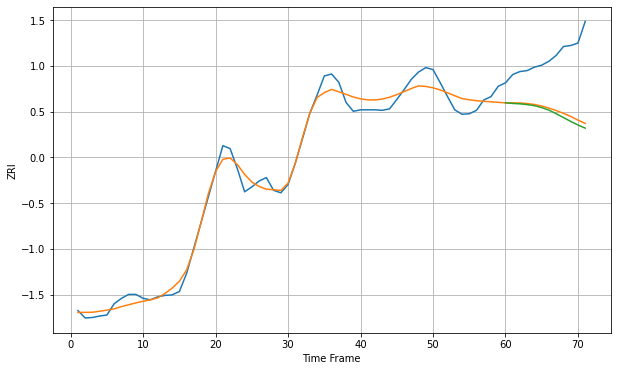

Wall time: 8.51 s
10314 18.562769444569188 113.73577297945114 119.69480045778833 [1819.27308873 1818.04100095 1817.19844188 1815.72629593 1813.43582209
 1809.54546864 1804.34130772 1797.1172874  1789.20762961 1781.36550221
 1774.1278496  1767.68924617]

Got an mse at 0.0098 in round 26 and stopped training

71 71 12


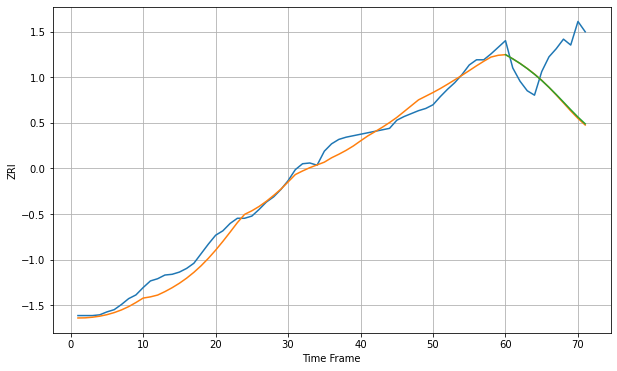

Wall time: 6.2 s
10453 11.403134216657387 69.14445559281397 68.23726625493875 [1667.98307595 1662.36621392 1656.07177257 1649.08155032 1641.36795492
 1632.91465075 1623.73989918 1613.93130505 1603.68641694 1593.33870238
 1583.33249086 1574.12130408]

Got an mse at 0.0095 in round 35 and stopped training

71 71 12


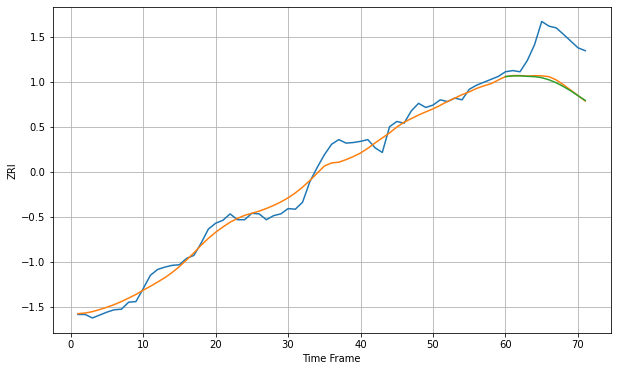

Wall time: 6.29 s
10455 14.682095769548695 68.42091468165293 70.40142241695803 [1882.78192893 1883.92377535 1883.96708844 1883.19333137 1882.64897202
 1880.91750764 1877.23102782 1872.15456082 1865.70623478 1858.41429617
 1850.11812892 1841.99197179]

Got an mse at 0.0082 in round 18 and stopped training

71 71 12


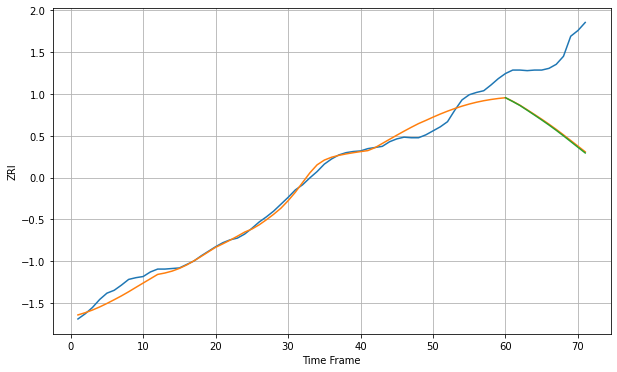

Wall time: 5.81 s
10456 12.265300614526446 126.53644631133879 127.89378205971353 [1745.78735729 1739.14441132 1732.16381448 1723.93517923 1715.53166871
 1706.99670393 1698.18787063 1688.97377693 1679.33668393 1669.39183588
 1659.35380232 1649.48261754]

Got an mse at 0.0099 in round 20 and stopped training

71 71 12


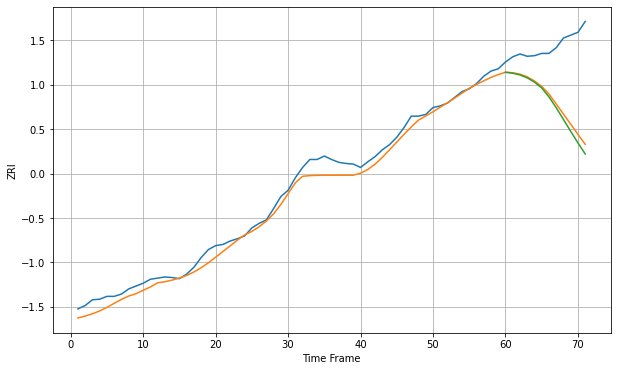

Wall time: 6.04 s
10457 14.156213716963759 109.69071551855514 118.0054258608837 [1845.95996075 1844.26480436 1841.19224007 1836.1182051  1828.61725489
 1818.39614246 1802.6822913  1783.78943084 1763.19309274 1742.32749603
 1722.0541453  1702.65261719]

Got an mse at 0.0085 in round 26 and stopped training

71 71 12


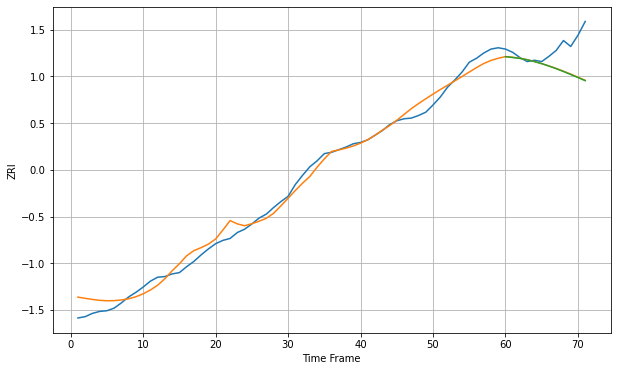

Wall time: 6.08 s
10458 12.38127615860899 37.866878989087894 38.17554992748165 [1745.51886006 1744.14990135 1742.77025367 1740.73839268 1738.02321804
 1734.82141216 1731.18615284 1727.17968978 1722.87473039 1718.35113976
 1713.69241142 1708.98107658]

Got an mse at 0.0097 in round 30 and stopped training

71 71 12


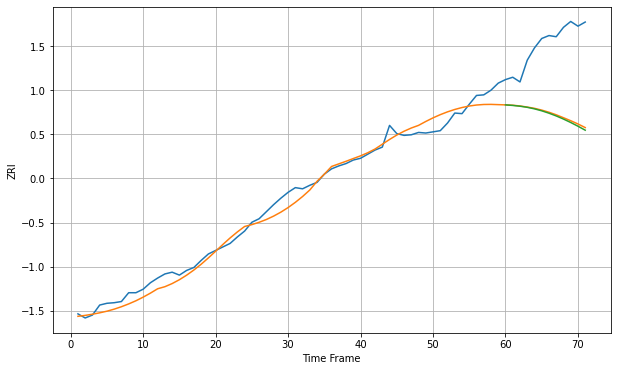

Wall time: 6.09 s
10459 14.08419631395075 124.05970845010842 126.13327908173272 [1786.93150541 1785.99172954 1784.65361525 1782.78037434 1780.16585975
 1776.81954806 1772.77369808 1768.0746774  1762.7760575  1756.93320129
 1750.60036434 1743.8307336 ]

Got an mse at 0.0086 in round 22 and stopped training

71 71 12


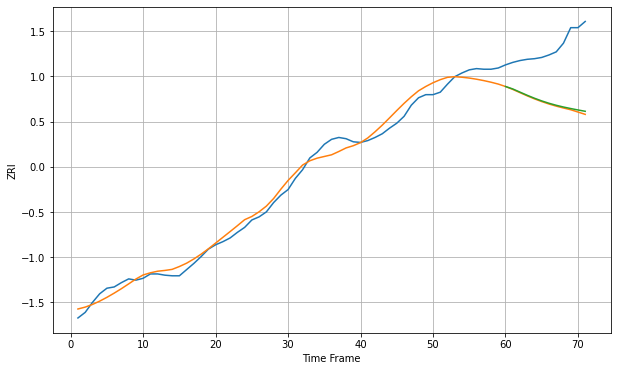

Wall time: 5.92 s
10460 12.552777611766457 92.09968588936533 90.18965419214774 [1774.15597948 1770.22423042 1765.09197175 1759.98958239 1755.22596211
 1750.92434366 1747.14413581 1743.89020064 1741.09019605 1738.62073093
 1736.3538816  1734.18617598]

Got an mse at 0.0095 in round 64 and stopped training

71 71 12


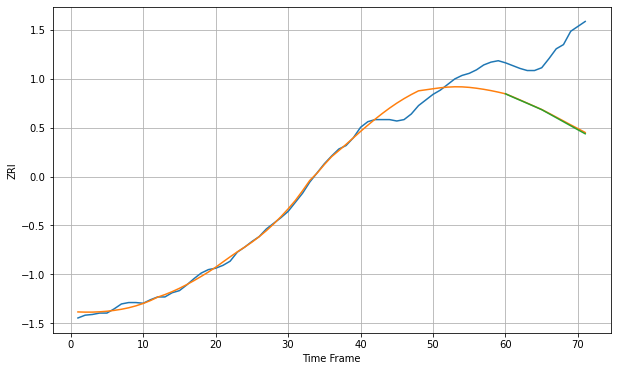

Wall time: 7.23 s
10461 13.18709877650738 93.92329163218128 94.85919292825244 [1790.77121058 1786.11074012 1781.69126356 1777.22398281 1772.715645
 1768.14752031 1762.44306309 1756.71435917 1750.9627835  1745.1950968
 1739.44526638 1733.77991802]

Got an mse at 0.0088 in round 20 and stopped training

71 71 12


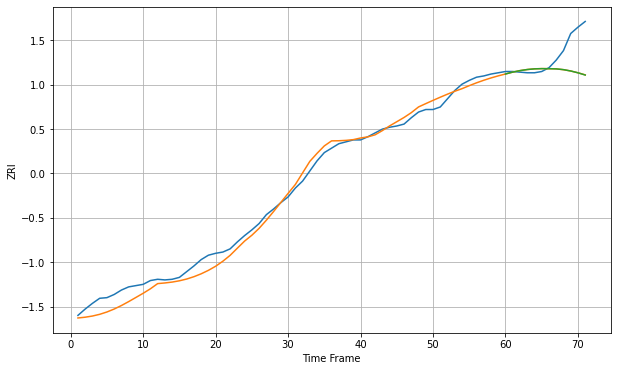

Wall time: 5.71 s
10462 12.30766955184994 37.64697440385733 37.69103750212812 [1806.09222221 1809.09670521 1811.4079783  1813.10561926 1814.1613048
 1814.52575386 1814.42615054 1814.15904922 1812.94198223 1810.84196595
 1807.95768733 1804.42060515]

Got an mse at 0.0099 in round 78 and stopped training

71 71 12


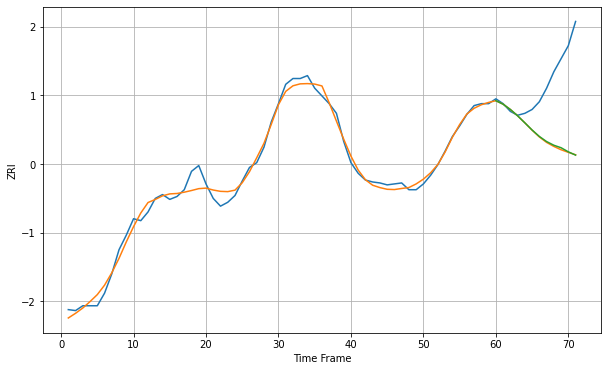

Wall time: 6.84 s
10463 7.010617370228702 65.23161129834314 64.75427353157514 [1798.04035676 1794.43937859 1788.96332047 1782.44626244 1775.15204302
 1767.74146426 1761.08434477 1755.79503222 1752.00018662 1749.40407597
 1745.16622773 1741.79161823]

Got an mse at 0.0094 in round 29 and stopped training

71 71 12


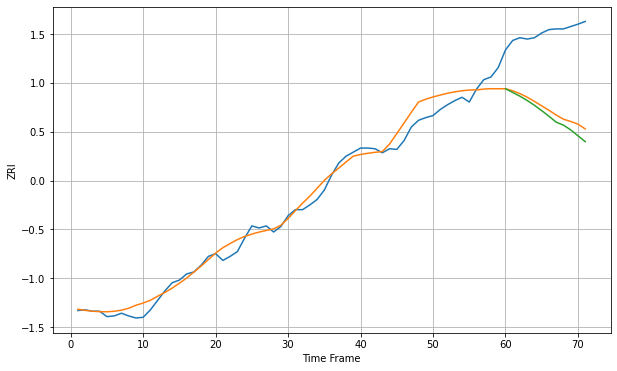

Wall time: 6.06 s
10465 13.401964973473774 114.86451871161543 124.38886413734166 [1872.61728237 1867.05201749 1861.55939031 1855.22375726 1848.09617809
 1840.28621321 1831.93192558 1823.20270325 1818.83402512 1811.82789244
 1803.11575767 1794.49310628]

Got an mse at 0.0086 in round 21 and stopped training

71 71 12


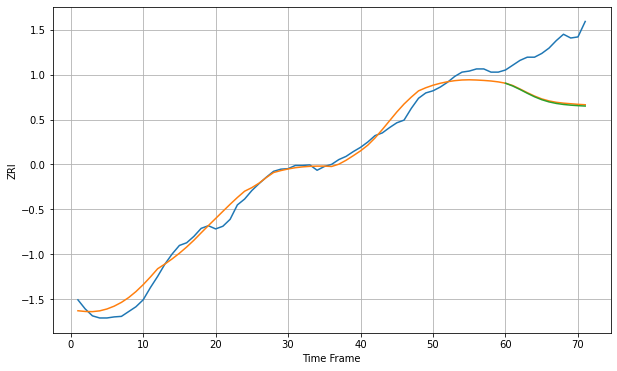

Wall time: 5.87 s
10466 14.68741165259138 98.87149046939206 100.69403848811274 [1868.21861049 1862.94247246 1856.478169   1849.40978622 1842.8018707
 1837.30509648 1833.18277144 1830.31046573 1828.37595531 1827.06009013
 1826.11743877 1825.38718684]

Got an mse at 0.0087 in round 36 and stopped training

71 71 12


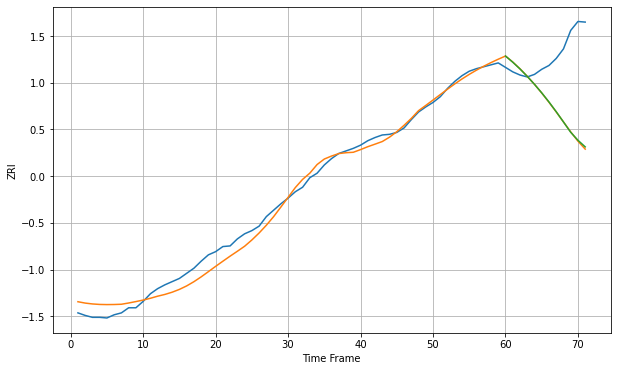

Wall time: 6.14 s
10467 12.711942510398075 102.48979613931766 101.72405015750697 [1806.78600978 1797.15492075 1786.52411267 1774.90889906 1762.42215842
 1749.05425366 1734.74116192 1719.46490747 1703.39941277 1687.19230901
 1674.68489438 1664.33092947]

Got an mse at 0.0098 in round 58 and stopped training

71 71 12


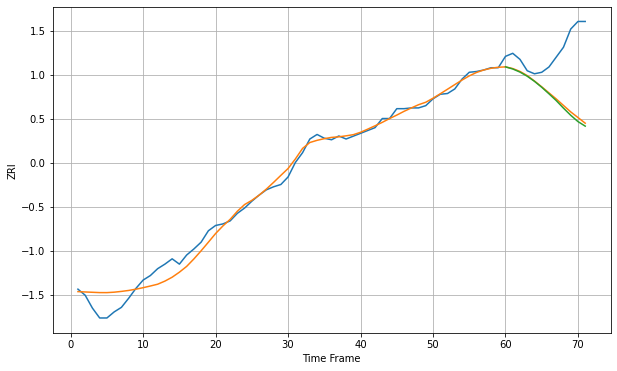

Wall time: 6.54 s
10468 11.255009298115079 69.17721670059703 71.78083595374228 [1547.11970766 1544.36269336 1540.2359169  1534.78127542 1528.04943012
 1520.21652433 1511.60763109 1502.68422696 1492.72337146 1483.30666804
 1474.98124865 1468.97617373]

Got an mse at 0.0098 in round 23 and stopped training

71 71 12


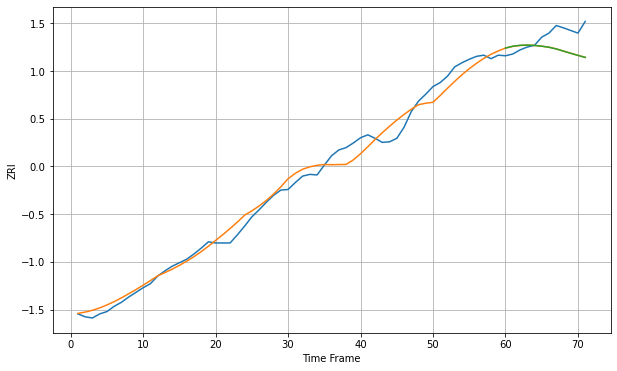

Wall time: 5.83 s
10469 15.221233148842666 30.605248135810513 30.728348283994876 [1913.25319681 1916.39814762 1918.0012441  1918.40466331 1917.82113488
 1916.48029501 1914.57604066 1911.75612663 1907.94400931 1904.24363402
 1900.60086417 1897.1697746 ]

Got an mse at 0.0098 in round 36 and stopped training

71 71 12


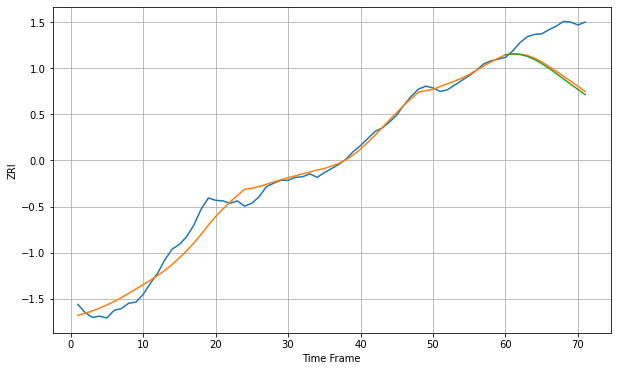

Wall time: 6.02 s
10470 15.114621047821196 69.8665951027844 73.3417448020186 [1878.37980935 1879.98266204 1879.02697174 1875.77284213 1870.45842074
 1863.48523587 1855.35301657 1846.55199767 1837.47980593 1828.40608898
 1819.47200804 1810.70669975]

Got an mse at 0.0097 in round 82 and stopped training

71 71 12


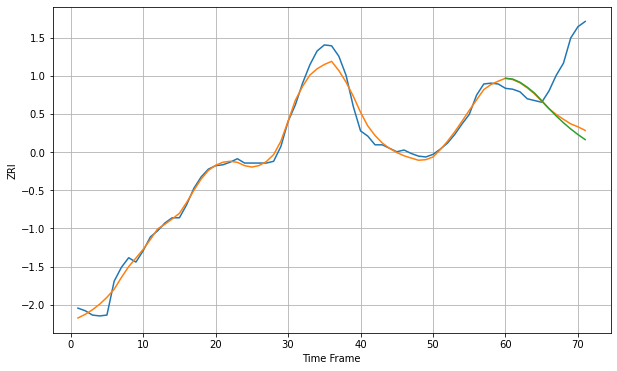

Wall time: 7 s
10471 8.468992164575605 61.922370123574716 66.37016838963223 [1861.60165265 1860.64969542 1857.00080561 1851.34257847 1844.59934432
 1835.84208485 1826.67484818 1818.22097083 1810.39181402 1803.24091863
 1796.79793284 1790.96984898]

Got an mse at 0.0092 in round 22 and stopped training

71 71 12


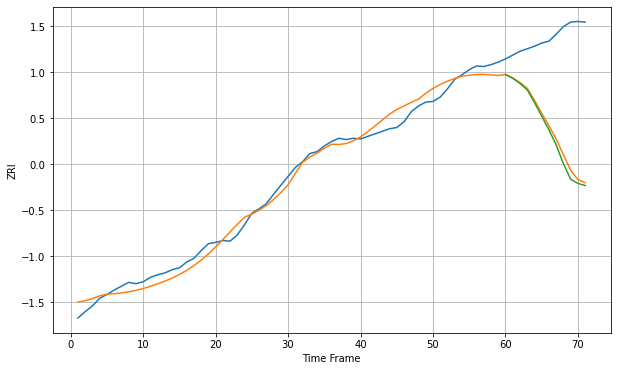

Wall time: 5.78 s
10472 12.876173038679289 156.58567409690707 163.10979548444936 [1802.45272567 1796.5739639  1788.3508353  1778.18720969 1758.40903121
 1736.77699955 1715.18106052 1691.42703632 1661.66291217 1637.39344353
 1630.96325361 1627.59377496]

Got an mse at 0.0099 in round 39 and stopped training

71 71 12


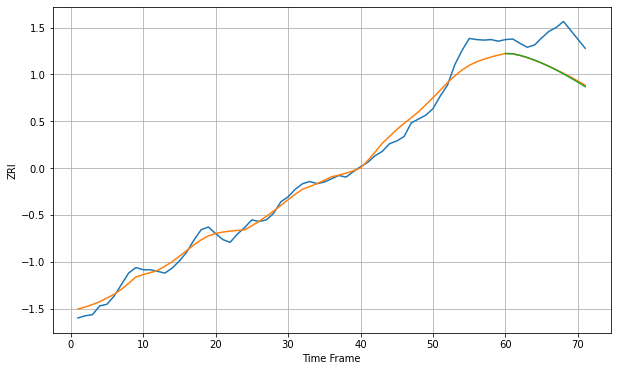

Wall time: 6.09 s
10473 16.18179167928845 58.93475749729821 59.71621595880137 [2012.50926529 2011.94190735 2009.22804672 2005.25592014 2000.53814435
 1995.13648034 1989.11969576 1982.55436721 1975.50153892 1968.01547491
 1960.14630476 1951.94781108]

Got an mse at 0.0100 in round 109 and stopped training

71 71 12


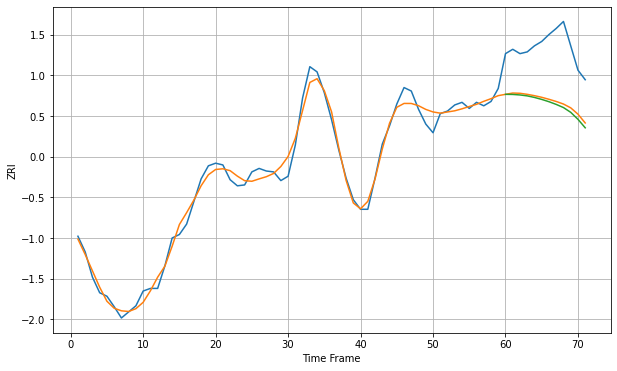

Wall time: 7.44 s
10528 9.290847795962478 63.473460063872146 66.57808352615449 [2480.19160889 2480.08028291 2479.48654094 2478.42488279 2476.62367205
 2474.36021353 2471.7016351  2468.59666667 2464.97699689 2459.5043798
 2451.47915084 2441.70886238]

Got an mse at 0.0097 in round 87 and stopped training

71 71 12


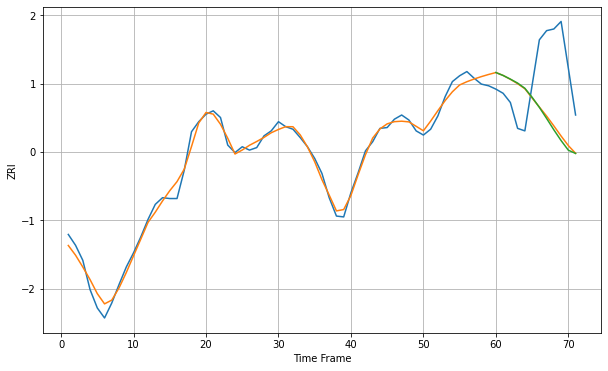

Wall time: 7.21 s
10543 7.950873502574641 74.80399433310153 77.24479164115014 [2448.86641011 2445.35531148 2440.95116271 2436.23274836 2430.00190567
 2419.25126337 2407.17440388 2393.93392989 2380.27343983 2367.41484755
 2355.87538772 2351.97644689]

Got an mse at 0.0099 in round 68 and stopped training

71 71 12


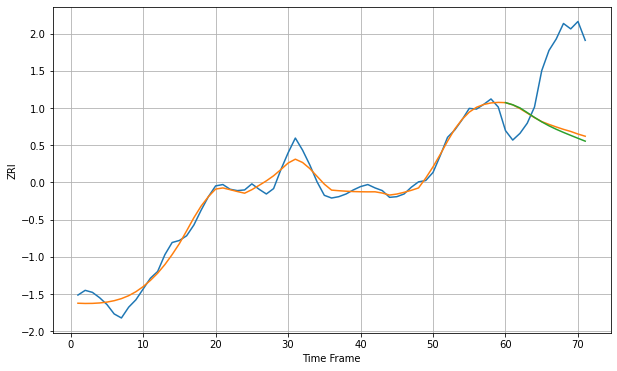

Wall time: 6.79 s
10562 10.87650867112689 106.8772749339497 110.36302824036107 [2117.54884328 2114.39847387 2109.74293909 2102.77902269 2095.65549916
 2089.00776535 2083.16036769 2078.02808735 2073.36642661 2068.94969953
 2064.63636375 2060.37562861]

Got an mse at 0.0099 in round 135 and stopped training

71 71 12


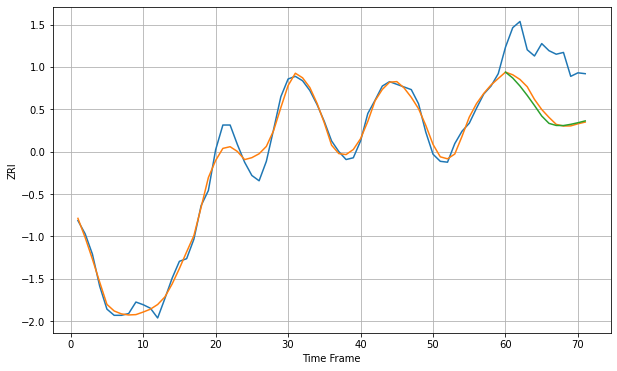

Wall time: 7.89 s
10573 9.467874805299378 61.87188228671328 65.10070724633559 [2263.77273386 2257.09301128 2248.03616293 2237.44441664 2226.03762136
 2214.17463033 2205.87727844 2203.52119091 2203.3919947  2204.77636684
 2206.59464258 2208.64896383]

Got an mse at 0.0094 in round 19 and stopped training

71 71 12


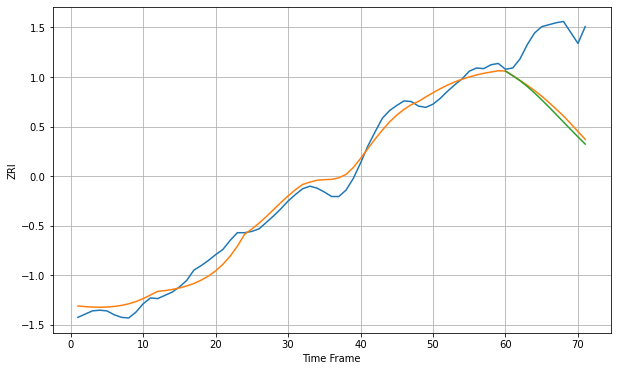

Wall time: 5.71 s
10701 14.297766166287225 110.84446819073628 116.92965801228154 [2034.23560297 2027.05479872 2019.26128465 2010.35312009 2000.39780673
 1989.68199067 1978.4881407  1967.01576915 1955.40885589 1943.79962118
 1932.32895932 1921.15037006]

Got an mse at 0.0099 in round 58 and stopped training

71 71 12


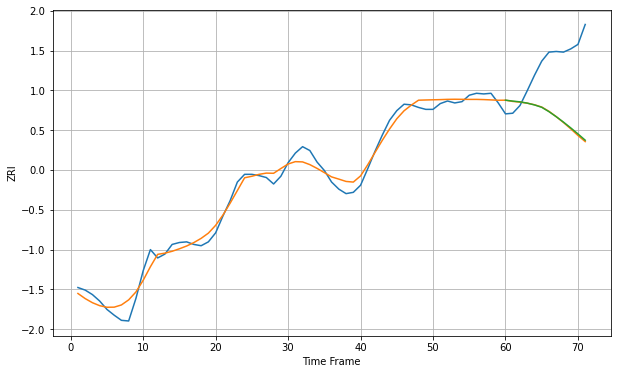

Wall time: 6.28 s
10703 12.18326192347093 94.75810541127069 93.9900460005402 [2125.28259744 2123.86255613 2122.68715207 2120.72262526 2117.90018446
 2114.20377142 2107.42418668 2099.6124237  2091.18773084 2082.22869735
 2072.81291284 2063.05201326]

Got an mse at 0.0100 in round 151 and stopped training

71 71 12


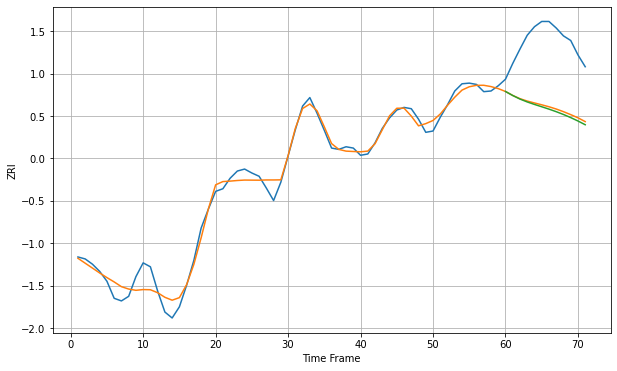

Wall time: 8.03 s
10704 12.880740439225319 101.09199539237866 104.1227648634479 [2177.26439815 2171.1240996  2165.70305203 2161.30605284 2157.52986
 2153.98341848 2150.36556862 2146.47533227 2142.19505243 2137.46501742
 2132.25923768 2126.57344334]

Got an mse at 0.0099 in round 70 and stopped training

71 71 12


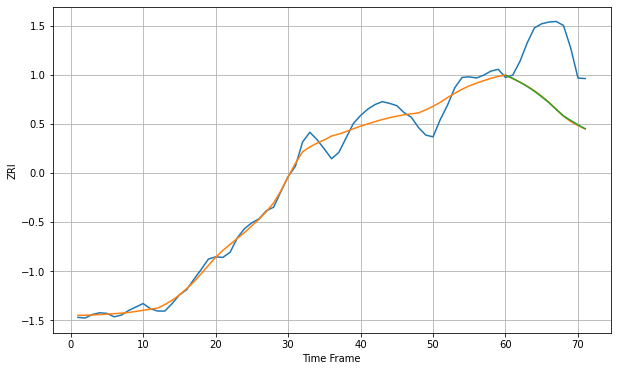

Wall time: 6.56 s
10705 16.80252815359036 105.12153052580658 105.0847562394692 [1995.0343767  1989.23045077 1982.7210404  1975.29310966 1966.85436709
 1957.40425216 1947.09778272 1935.50461751 1924.38156456 1916.45452732
 1908.96977307 1901.97415171]

Got an mse at 0.0099 in round 80 and stopped training

71 71 12


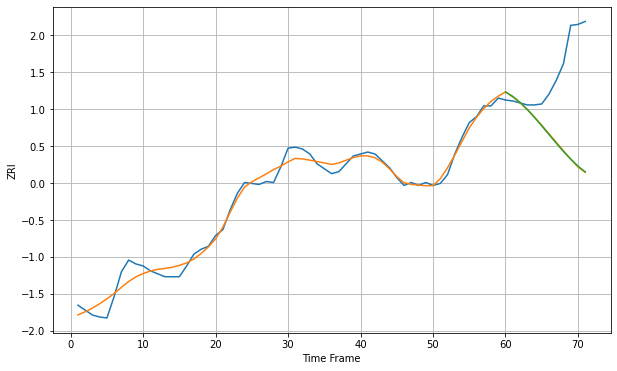

Wall time: 6.8 s
10940 7.486489438441072 80.32914903218064 80.3154933470111 [1441.22851548 1436.66881715 1430.59815554 1423.40553751 1415.32642756
 1406.70127339 1397.85872134 1389.07522835 1380.61989974 1372.76685459
 1365.74661149 1359.69695944]

Got an mse at 0.0099 in round 101 and stopped training

71 71 12


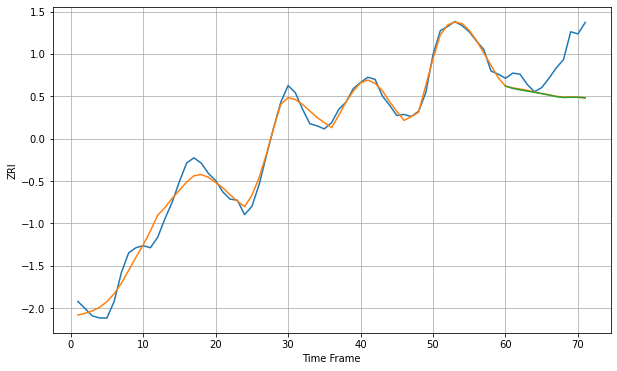

Wall time: 7.16 s
10960 8.086897301919954 36.41053340420787 36.57261793073947 [1846.4574187  1844.2411505  1842.8464275  1841.61945802 1840.42724475
 1839.17840056 1837.79775975 1836.22402508 1835.42490685 1835.69057278
 1835.57799067 1835.06921325]

Got an mse at 0.0100 in round 68 and stopped training

71 71 12


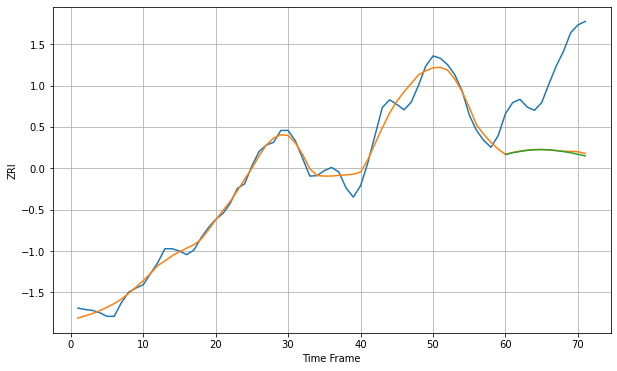

Wall time: 6.49 s
10977 18.033686745531394 180.44372270007358 182.44115834177666 [2017.38149011 2021.19585572 2023.98058632 2026.19013681 2027.57432709
 2027.97867195 2027.38332372 2025.89052149 2023.67890789 2020.94526351
 2017.85744177 2014.2076052 ]

Got an mse at 0.0099 in round 68 and stopped training

71 71 12


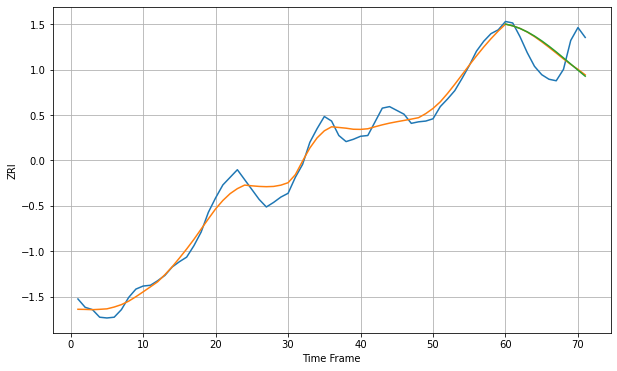

Wall time: 6.54 s
11001 11.773463989499021 34.16588463926516 35.01432000742537 [2197.49519054 2195.22325419 2191.80957557 2187.31266128 2181.82842352
 2175.49644791 2168.47985907 2160.94848481 2153.07382288 2145.02627631
 2136.96413129 2129.0174318 ]

Got an mse at 0.0099 in round 81 and stopped training

71 71 12


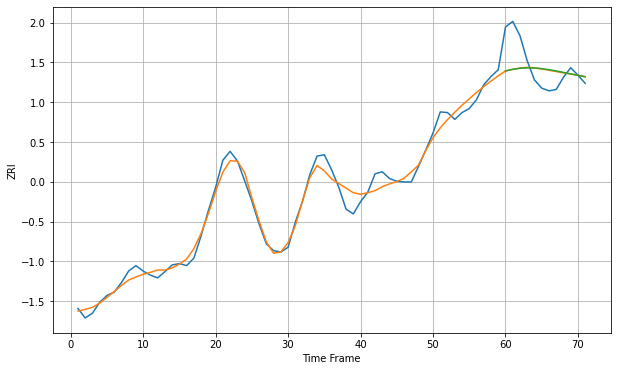

Wall time: 6.86 s
11003 11.557472978532305 34.705517373255965 34.86708100093198 [2220.24153972 2222.68367966 2224.1983771  2224.806224   2224.57269122
 2223.61723698 2222.09912823 2220.19596886 2218.07938031 2215.89390209
 2213.74446746 2211.69446115]

Got an mse at 0.0099 in round 172 and stopped training

71 71 12


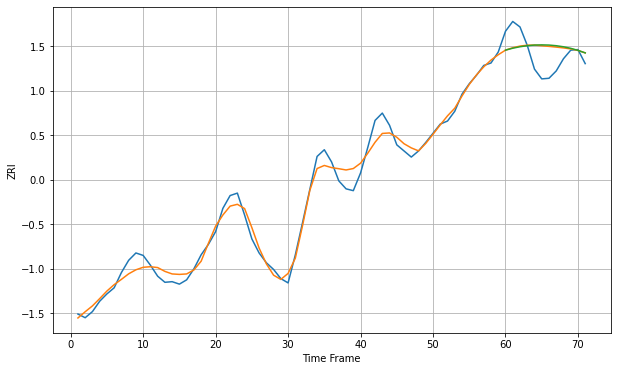

Wall time: 8.47 s
11010 14.444832375156468 33.1243877002479 34.0804434945789 [2402.0454724  2405.19604116 2407.60947788 2409.31314435 2410.33610283
 2410.68685235 2410.35594274 2409.32101824 2407.55258577 2405.01899567
 2401.68999622 2397.53991553]

Got an mse at 0.0094 in round 35 and stopped training

71 71 12


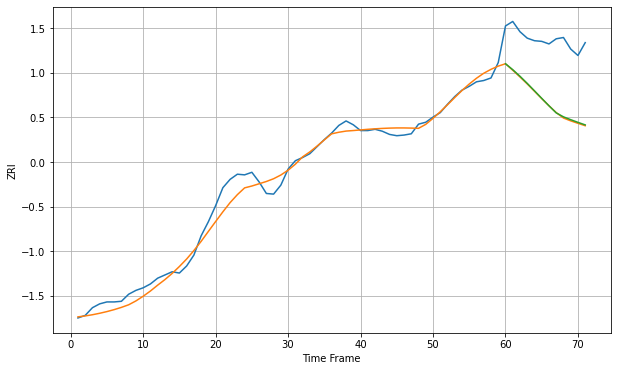

Wall time: 5.94 s
11050 13.13971237064481 96.67653983066366 95.81295843847518 [2601.11309455 2591.87091072 2581.61988847 2570.52313925 2558.92569783
 2547.18868385 2535.62716063 2524.54961855 2518.40544665 2513.96489745
 2509.77511364 2505.84729825]
71 71 12


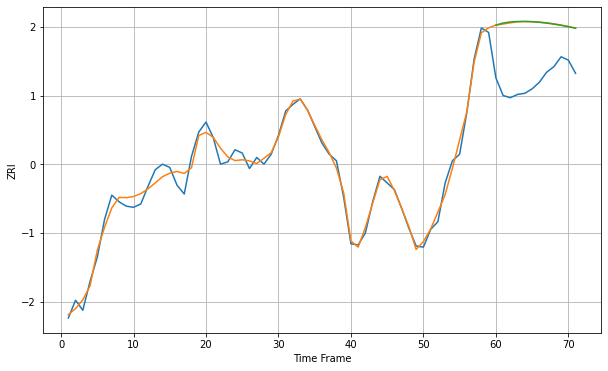

Wall time: 14.5 s
11101 6.859229202362449 52.51475939543696 52.6246176971875 [2535.58900887 2537.49560633 2538.46371974 2538.87668418 2538.89815249
 2538.62691469 2538.12016947 2537.40866896 2536.50740005 2535.42442465
 2534.16918427 2532.75947668]

Got an mse at 0.0100 in round 305 and stopped training

71 71 12


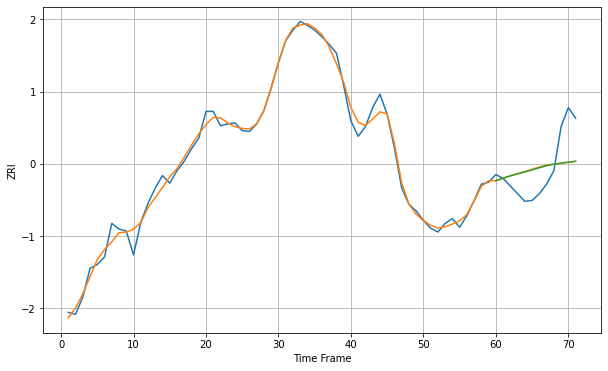

Wall time: 10.9 s
11102 7.502807787968285 29.700821094700665 29.50792341321142 [2181.59479367 2184.22290775 2186.74980834 2188.77447167 2190.78413276
 2192.89889502 2195.08813654 2197.31465129 2198.84249248 2199.9441499
 2200.9506585  2201.848288  ]

Got an mse at 0.0100 in round 74 and stopped training

71 71 12


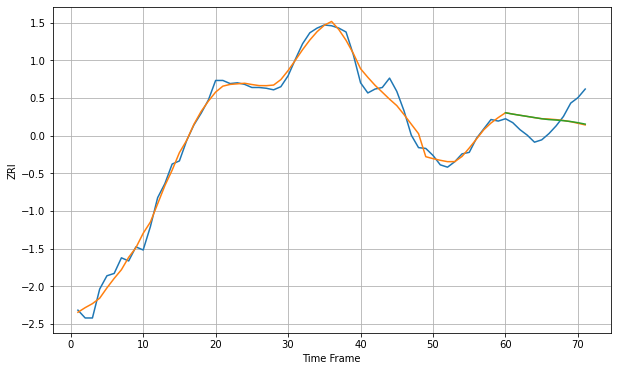

Wall time: 6.77 s
11103 9.564203313471756 24.14217848800676 23.831012629913317 [2161.66557887 2159.9337366  2158.4193672  2156.96409989 2155.50561496
 2153.97143216 2152.8978044  2152.33811049 2151.52545342 2150.41403906
 2148.95254104 2147.10458759]

Got an mse at 0.0100 in round 245 and stopped training

71 71 12


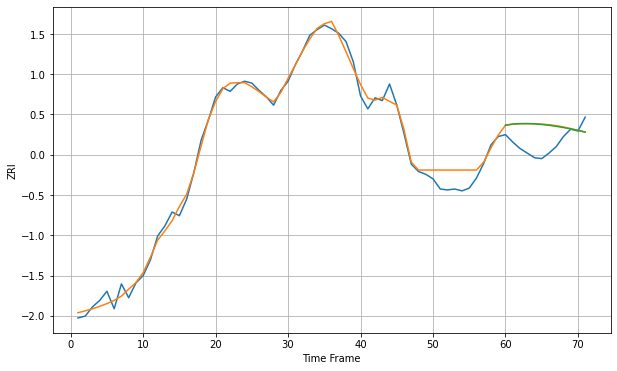

Wall time: 10.3 s
11104 8.712774048956632 23.84996866113141 23.65933262944609 [2114.29694268 2115.53475988 2115.98887029 2116.01860253 2115.69428737
 2115.06815296 2114.18171519 2113.06822921 2111.75464949 2110.26313229
 2108.61211788 2106.81711181]
71 71 12


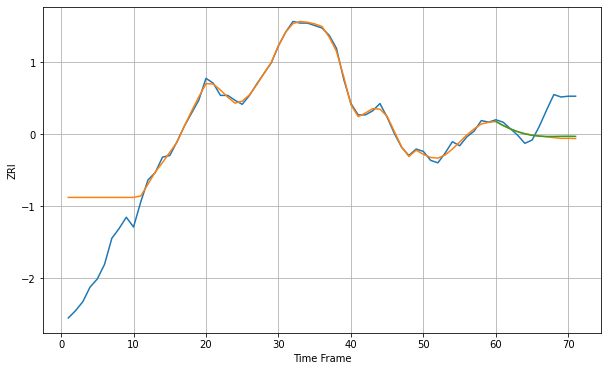

Wall time: 14.7 s
11105 39.82255244884567 31.93235685953607 30.640905198650263 [2184.90984143 2179.89769433 2175.81700864 2172.35362972 2169.65310756
 2167.8139768  2166.81332425 2166.46820287 2166.5126522  2166.70003554
 2166.7469272  2166.60296829]

Got an mse at 0.0100 in round 242 and stopped training

71 71 12


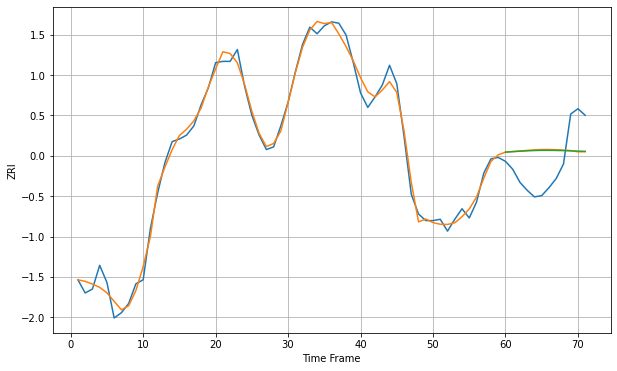

Wall time: 9.74 s
11106 6.077621862435665 26.248349168389666 25.904910008035127 [2141.03231016 2141.39384648 2141.71935268 2142.00643994 2142.24425501
 2142.40008262 2142.39320731 2142.31220208 2142.17149751 2141.9921629
 2141.79785931 2141.61120354]

Got an mse at 0.0100 in round 479 and stopped training

71 71 12


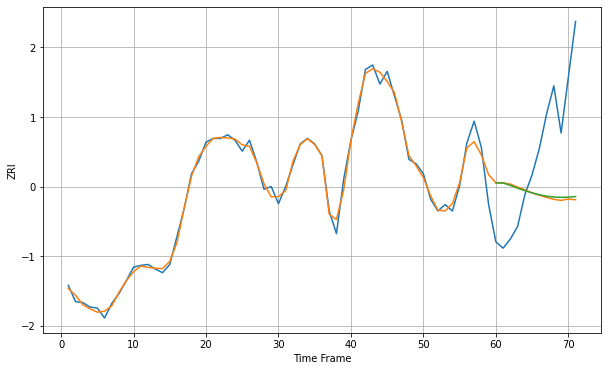

Wall time: 14.4 s
11201 7.574979316307097 93.2861922992233 91.63505795189145 [2903.98873678 2903.89490375 2901.16637466 2898.14735293 2895.39160412
 2892.93569158 2890.87436474 2889.32252255 2888.36906052 2888.03460263
 2888.25312027 2888.93896429]

Got an mse at 0.0099 in round 124 and stopped training

71 71 12


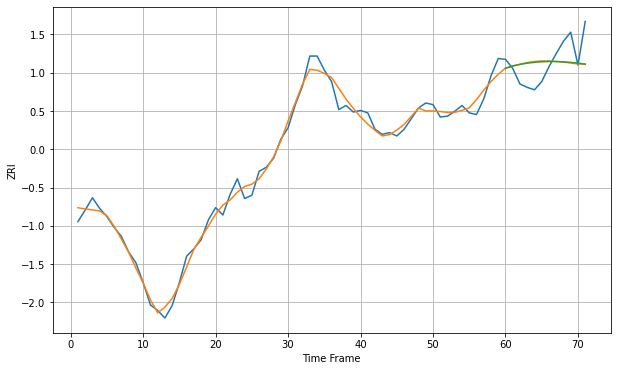

Wall time: 7.7 s
11203 9.239362623702178 26.284442978625908 25.905828458525345 [2146.25320814 2149.09024861 2150.91079351 2152.3473484  2153.39024959
 2154.05516959 2154.36141463 2154.33780638 2153.94617353 2153.29840454
 2152.46649537 2151.16239937]

Got an mse at 0.0099 in round 45 and stopped training

71 71 12


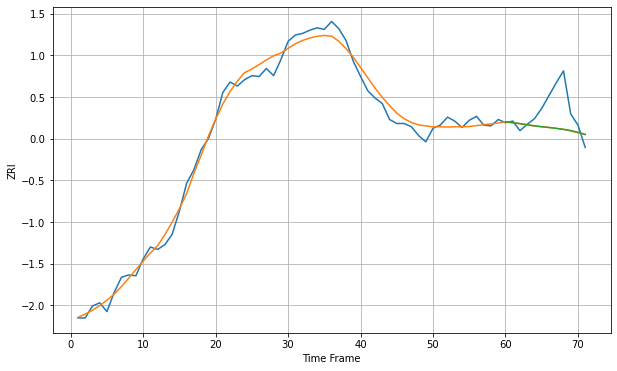

Wall time: 6.25 s
11204 10.238317166073161 31.27677937686185 31.26727199155039 [1999.04171331 1997.98874312 1996.78759704 1995.43152394 1993.97631386
 1992.92526405 1991.99699903 1990.86990468 1989.58100651 1988.19027925
 1985.89289705 1983.27088166]

Got an mse at 0.0099 in round 319 and stopped training

71 71 12


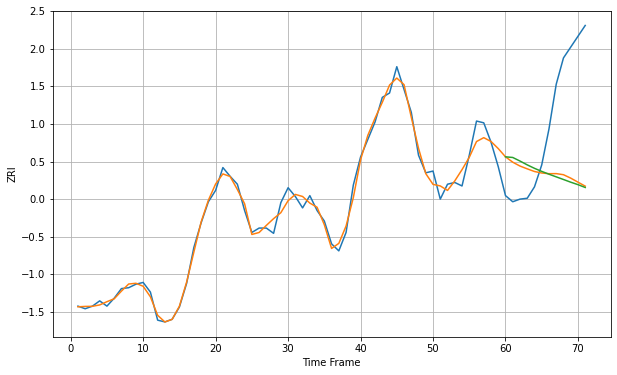

Wall time: 11.5 s
11205 8.519553209574388 100.49292511620057 103.20888448986241 [2829.23314956 2828.48467444 2824.41556443 2820.0576234  2816.11203589
 2812.61102437 2809.42189075 2806.38778696 2803.37910933 2800.31008414
 2797.51369061 2794.28367588]

Got an mse at 0.0099 in round 246 and stopped training

71 71 12


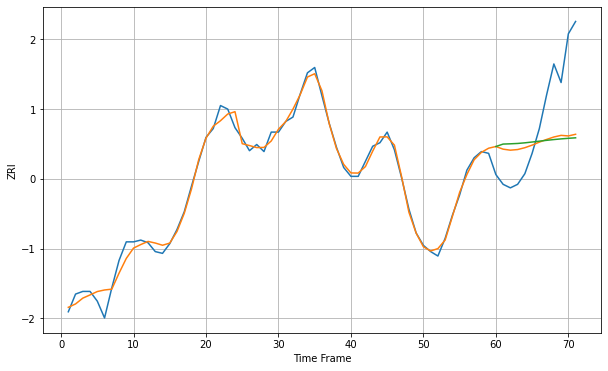

Wall time: 10.2 s
11206 7.823996082357869 64.27768768021937 67.36513386444068 [2573.72475293 2576.47550847 2576.77841269 2577.16987657 2577.88856246
 2578.7985329  2579.76618004 2580.70552347 2581.5687928  2582.33332541
 2582.99186837 2583.5461659 ]

Got an mse at 0.0099 in round 50 and stopped training

71 71 12


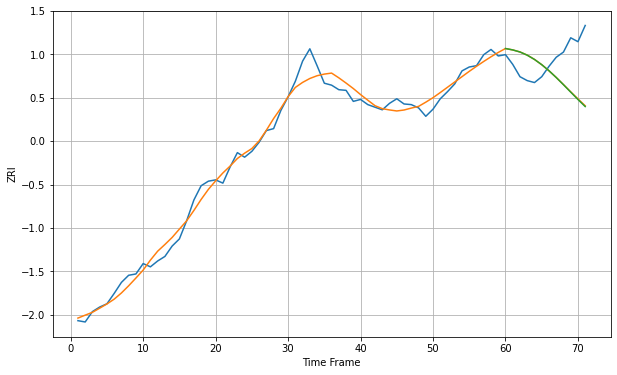

Wall time: 6.35 s
11207 13.256925513391993 56.847914718637874 57.23096546717444 [2271.45981735 2269.29492384 2266.12110551 2261.19293629 2254.60817525
 2246.55666964 2237.20936571 2226.82230547 2215.72218594 2204.2865753
 2192.8973708  2182.00713576]

Got an mse at 0.0099 in round 52 and stopped training

71 71 12


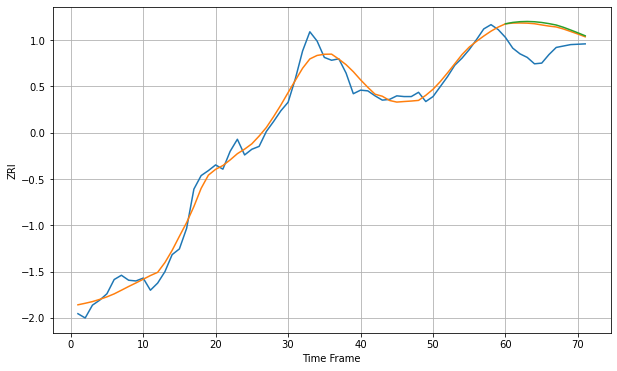

Wall time: 6.56 s
11208 12.857962664961756 35.91910770874496 38.05518300578107 [2271.18394815 2273.1299968  2274.15894066 2274.48004177 2274.08964175
 2273.03775234 2271.44652942 2269.46793603 2266.28228404 2262.46176573
 2258.50251351 2254.36453908]

Got an mse at 0.0100 in round 43 and stopped training

71 71 12


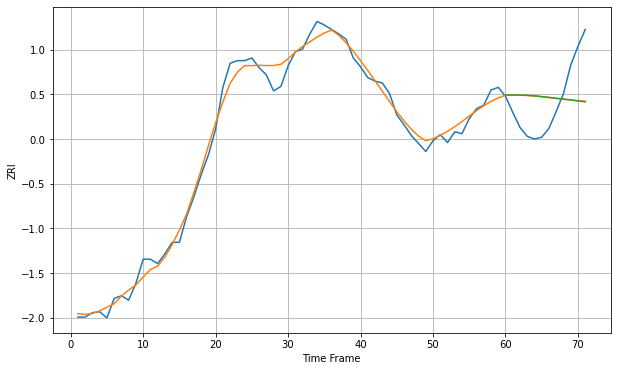

Wall time: 6.04 s
11209 9.907902369520574 42.18616421625556 42.43604014042693 [2083.29829052 2083.43888965 2083.35730833 2083.05549459 2082.4701124
 2081.667578   2080.76710634 2079.8015978  2078.79913479 2077.7822555
 2076.76781894 2075.76755005]

Got an mse at 0.0100 in round 56 and stopped training

71 71 12


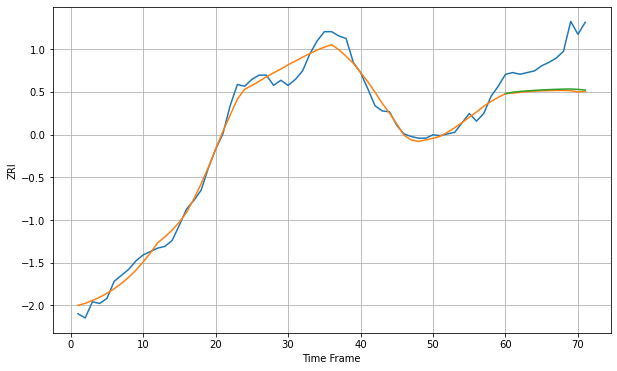

Wall time: 6.88 s
11210 9.951501071225696 46.41683053786785 45.04731836549397 [1937.29504764 1938.99590144 1939.85404223 1940.54477185 1941.12113381
 1941.61767198 1942.03878893 1942.37551894 1942.61690672 1942.75635047
 1942.29072828 1941.55400974]

Got an mse at 0.0100 in round 485 and stopped training

71 71 12


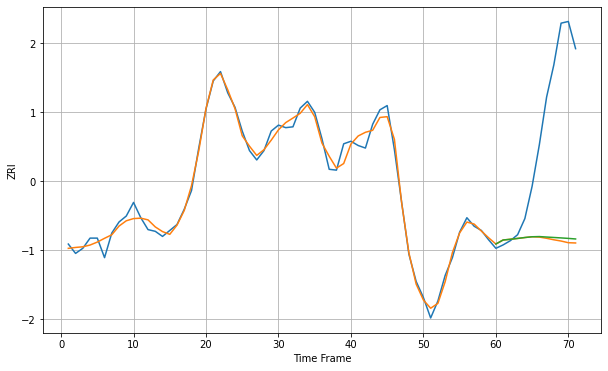

Wall time: 15.1 s
11211 8.094363228803592 150.5236619620298 148.1895332258464 [2711.04208432 2715.77578451 2716.60986087 2717.61970338 2718.70677341
 2719.57967966 2719.81751492 2719.26705165 2718.74822078 2718.2328188
 2717.66792671 2717.00014717]

Got an mse at 0.0100 in round 174 and stopped training

71 71 12


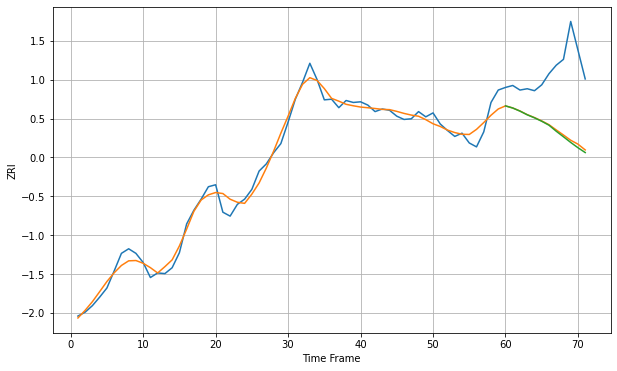

Wall time: 8.88 s
11212 11.819977192159056 93.18573497092768 95.40140485345873 [2130.74558191 2127.51332142 2122.72945234 2117.12267867 2112.48861616
 2107.22657496 2101.18044762 2091.96849746 2083.45984169 2074.79312724
 2066.69257601 2059.31421362]

Got an mse at 0.0099 in round 139 and stopped training

71 71 12


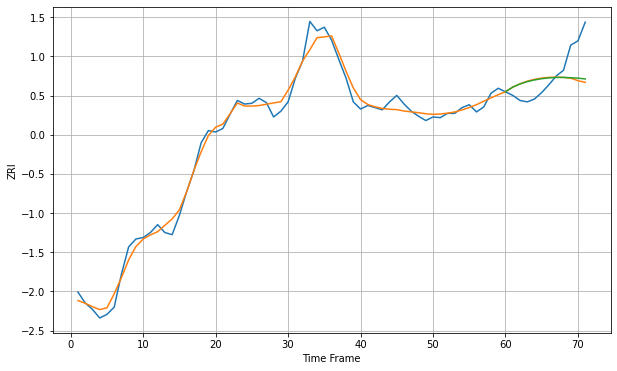

Wall time: 7.89 s
11213 10.751963610942264 35.44628546398013 33.83168661346912 [2304.18355804 2310.5129529  2314.96724651 2318.2086661  2320.5805231
 2322.28551922 2323.4252174  2324.03415273 2324.10413206 2323.60256117
 2323.07069008 2321.92707433]

Got an mse at 0.0098 in round 37 and stopped training

71 71 12


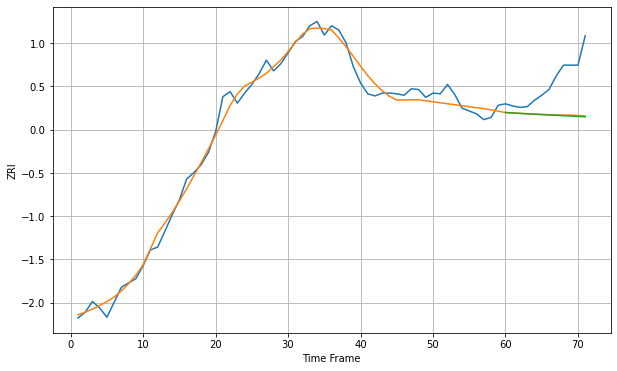

Wall time: 6.17 s
11214 11.766855577173818 52.34877472750101 53.04070355530239 [2067.86731825 2067.21023554 2066.64022078 2066.07395626 2065.51452808
 2064.96685012 2064.43686139 2063.93135826 2063.44435928 2062.92141305
 2062.42451282 2061.91923315]

Got an mse at 0.0100 in round 307 and stopped training

71 71 12


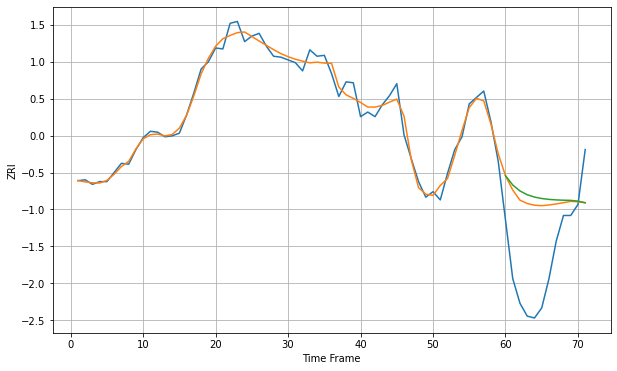

Wall time: 11.3 s
11215 8.028595561868334 81.21953892306865 86.93471367672437 [2534.43863427 2524.29452005 2517.78124914 2513.67736777 2511.1160568
 2509.53505283 2508.57866366 2508.0154342  2507.69008012 2507.49769016
 2506.68102858 2504.92310304]

Got an mse at 0.0100 in round 181 and stopped training

71 71 12


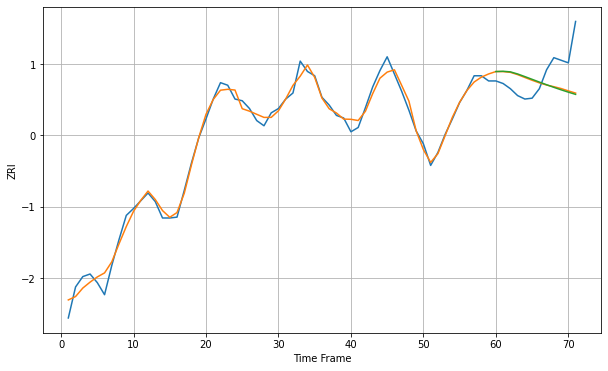

Wall time: 8.94 s
11216 8.191205391538185 32.725450027856354 33.56685752921191 [2516.89465251 2517.21576017 2516.53104825 2514.0883258  2511.03842139
 2507.86985716 2504.6957647  2501.5855968  2498.58205589 2495.71059616
 2492.98743791 2490.42369647]
71 71 12


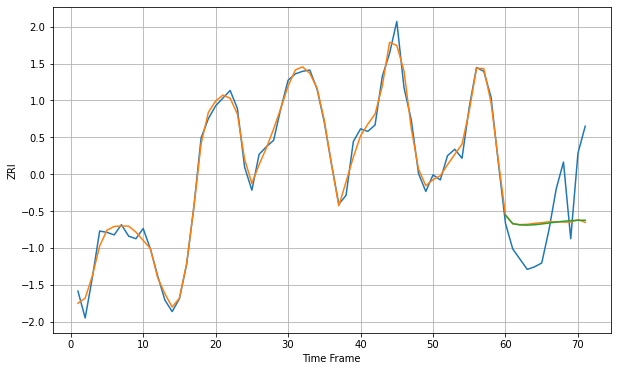

Wall time: 14.7 s
11217 6.4981962418352985 36.518905725702226 36.037865292189096 [2797.46170155 2790.80060011 2789.80340759 2789.62853389 2789.94281056
 2790.55622789 2791.30407434 2792.04899737 2792.68672122 2793.15096136
 2793.41655846 2793.49714255]

Got an mse at 0.0099 in round 94 and stopped training

71 71 12


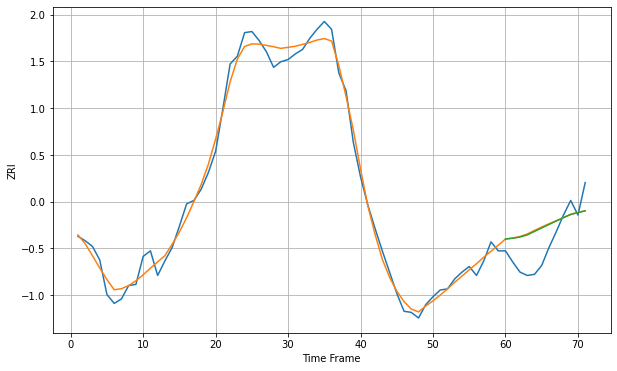

Wall time: 7.56 s
11218 8.294190571171919 24.195415114653077 23.738596899843984 [2045.56105886 2046.2403272  2047.35132733 2049.20416509 2052.34428856
 2055.45114579 2058.54976833 2061.62754464 2064.66686021 2067.53241586
 2069.22702263 2070.78438987]

Got an mse at 0.0097 in round 39 and stopped training

71 71 12


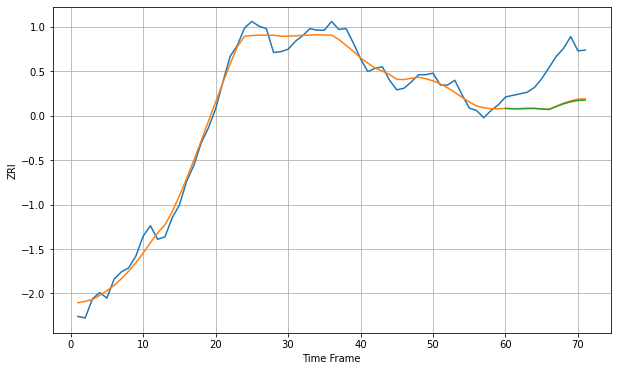

Wall time: 6.15 s
11219 10.789903285175983 48.95188306908056 49.66150304697593 [2096.61008323 2096.1676372  2096.26531668 2096.54384443 2096.57993387
 2095.87093624 2095.22522082 2098.92504428 2102.3458353  2104.97108241
 2106.58107249 2107.20432683]

Got an mse at 0.0100 in round 63 and stopped training

71 71 12


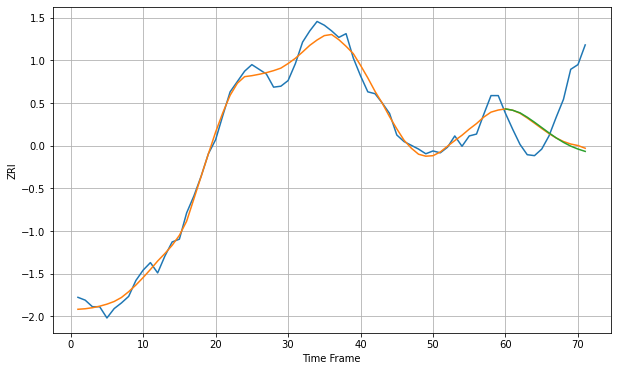

Wall time: 6.55 s
11220 9.026222904189078 52.564659550292404 54.18896182730911 [2069.81135248 2068.36320163 2065.64817039 2060.95433737 2055.63174674
 2049.9606984  2044.27142862 2038.90184385 2034.13333536 2030.1495845
 2027.02700455 2024.52428314]

Got an mse at 0.0099 in round 389 and stopped training

71 71 12


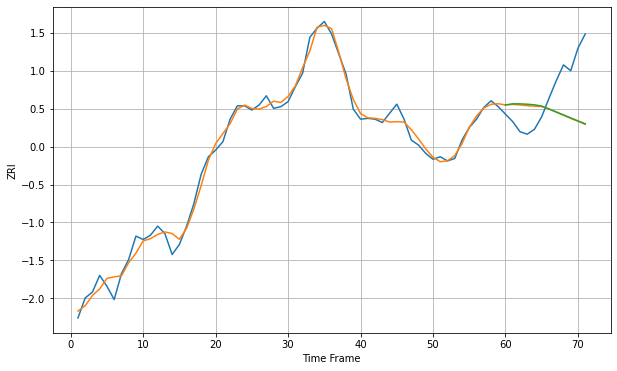

Wall time: 12.6 s
11221 9.020199708904045 51.154160574553934 51.22650637051387 [2446.05833133 2447.41029046 2447.34116364 2446.90683306 2446.19962439
 2444.64231283 2441.18311521 2437.64703778 2434.06794684 2430.48465928
 2426.9315634  2423.43825713]

Got an mse at 0.0098 in round 261 and stopped training

71 71 12


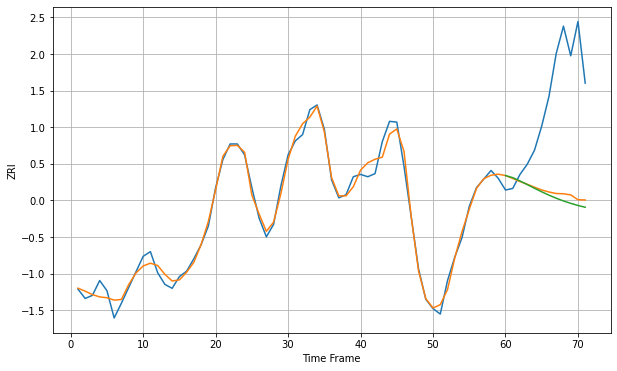

Wall time: 10.5 s
11222 9.254426101921126 132.28468677230458 137.864267253084 [2733.52315478 2730.8153373  2726.59278121 2721.97423144 2717.26129171
 2712.67683168 2708.38054179 2704.46580838 2700.97080143 2697.89553208
 2695.21727855 2692.90152024]

Got an mse at 0.0100 in round 86 and stopped training

71 71 12


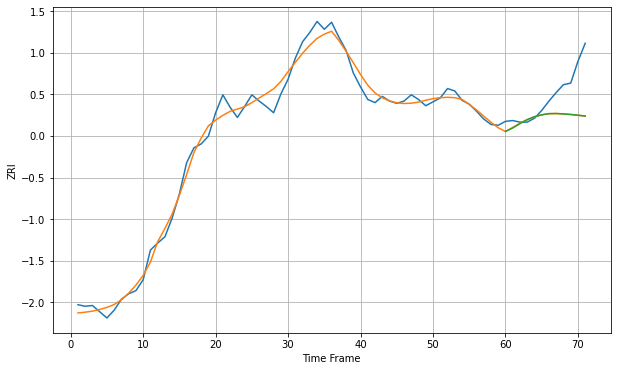

Wall time: 7.3 s
11223 10.55514537174099 38.51023119839382 38.48934032452662 [1994.04915555 1998.47946368 2004.10935053 2009.17745845 2012.91436176
 2015.35396912 2016.86179826 2017.01313614 2016.54644819 2015.80432542
 2014.87273788 2013.81308003]

Got an mse at 0.0100 in round 29 and stopped training

71 71 12


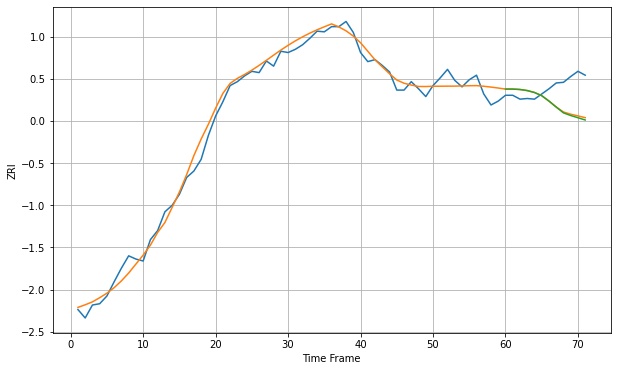

Wall time: 6.04 s
11224 12.64744343310536 37.56861916999723 38.957886426494454 [2119.56390258 2119.54170304 2118.9050573  2117.23639168 2114.27154503
 2109.36819951 2101.01634172 2091.70976405 2082.79526735 2078.71536176
 2075.2738863  2071.80701722]

Got an mse at 0.0100 in round 127 and stopped training

71 71 12


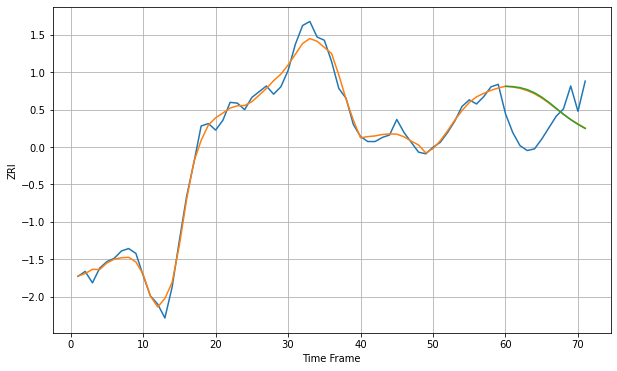

Wall time: 7.91 s
11225 9.057717327293542 48.23345645498131 48.8721810757825 [2310.62861383 2310.26547077 2309.00658558 2306.5582184  2302.70980243
 2297.40680998 2290.88000832 2283.67344881 2276.46999075 2269.82029833
 2263.99837591 2259.04292459]

Got an mse at 0.0099 in round 121 and stopped training

71 71 12


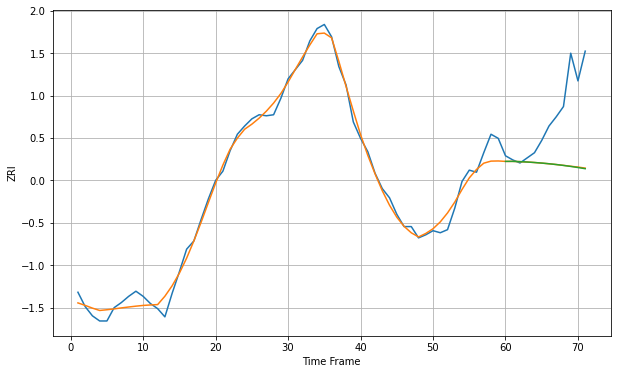

Wall time: 7.71 s
11226 8.126707742173672 57.46697544542008 57.64522123656097 [2019.53692793 2019.57306657 2019.2991035  2018.92715324 2018.46089497
 2017.8996166  2017.2395689  2016.47683913 2015.60935894 2014.63852573
 2013.57086455 2012.41934513]

Got an mse at 0.0098 in round 36 and stopped training

71 71 12


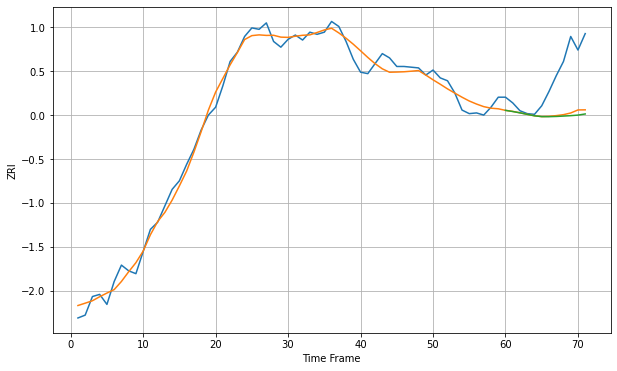

Wall time: 6.51 s
11228 11.958817671965011 58.06791365132632 60.740587123931206 [2092.57965626 2090.95160854 2089.08418349 2086.99614244 2084.98385153
 2083.80489641 2083.73835338 2084.05042239 2084.57288364 2085.1777973
 2085.94494707 2087.55551128]

Got an mse at 0.0099 in round 61 and stopped training

71 71 12


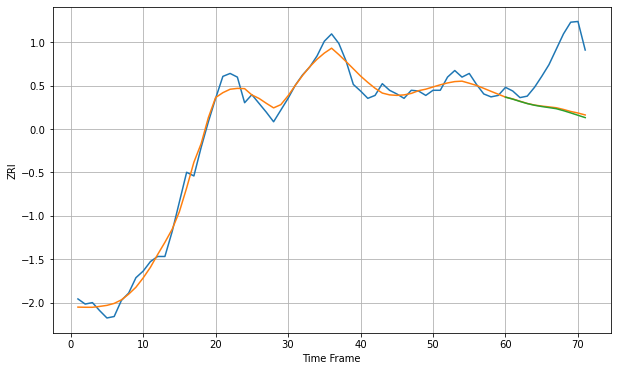

Wall time: 6.73 s
11229 11.747827623007204 71.51199702949205 73.04290177091221 [2063.6660766  2060.89005826 2057.77231054 2054.87041813 2052.55904667
 2050.81477083 2049.37516726 2047.87629396 2045.17159704 2042.09822661
 2038.87625571 2035.67352957]

Got an mse at 0.0095 in round 41 and stopped training

71 71 12


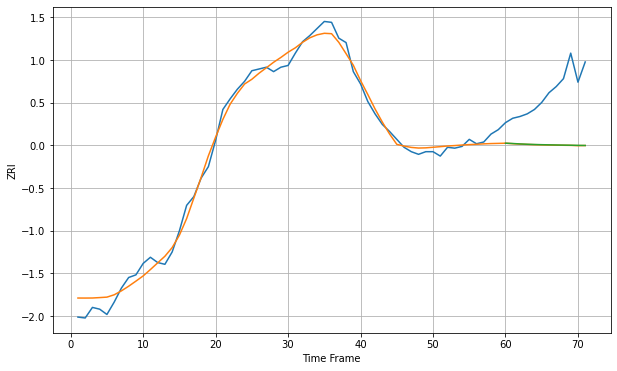

Wall time: 6.62 s
11230 9.263627307393367 62.19977885156173 62.033036103268635 [1946.63613531 1946.28922614 1945.82282186 1945.45054818 1945.16759294
 1944.94901825 1944.77069193 1944.61509883 1944.47096301 1944.33161392
 1944.19356371 1944.05550702]
71 71 12


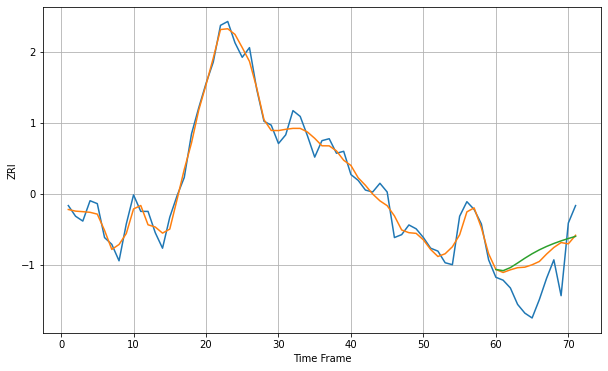

Wall time: 14.8 s
11231 10.030722013487424 34.05679067108406 39.26045888654992 [2714.03683429 2712.83541668 2715.98707739 2720.72603089 2725.68102938
 2730.27572103 2734.32168058 2737.82852366 2740.88300599 2743.58202027
 2746.00666174 2748.21759303]

Got an mse at 0.0100 in round 186 and stopped training

71 71 12


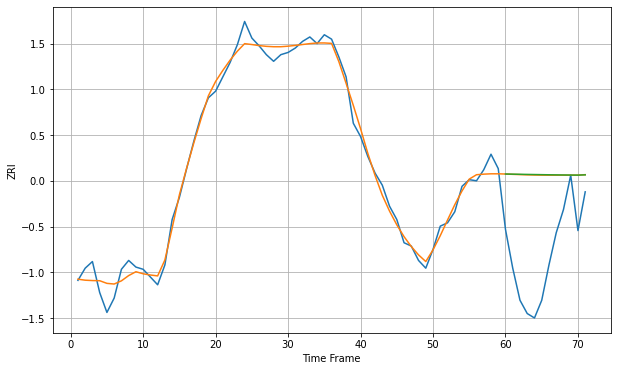

Wall time: 8.99 s
11232 8.242408458810878 82.05751145173525 82.314356798783 [2137.1122175  2136.98727072 2136.87338364 2136.75824669 2136.64400839
 2136.53339638 2136.429276   2136.33423144 2136.25023589 2136.17847841
 2136.119356   2136.35990439]

Got an mse at 0.0100 in round 54 and stopped training

71 71 12


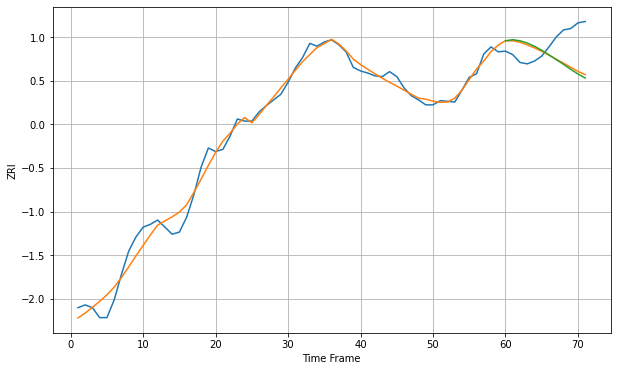

Wall time: 6.37 s
11233 12.273661962233378 40.03200119936339 42.2957149800821 [2327.73136674 2329.21224955 2327.6800625  2324.49455725 2319.92388995
 2314.22924851 2307.77527557 2301.00420956 2294.37470775 2287.23107299
 2280.67178306 2274.99582172]

Got an mse at 0.0100 in round 32 and stopped training

71 71 12


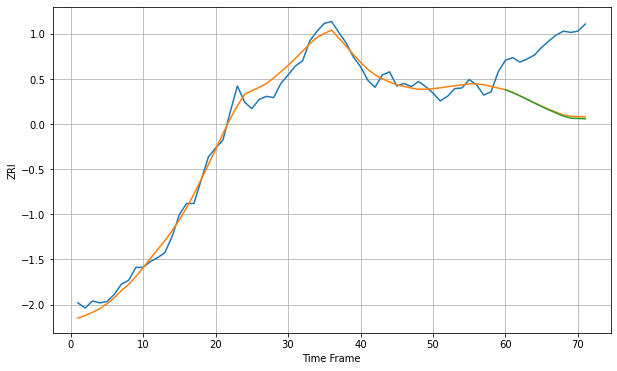

Wall time: 6.02 s
11234 13.477224848245783 101.30489720921447 102.73691085594469 [2052.27245058 2047.71512774 2042.63221233 2037.17519376 2031.61460949
 2026.16095077 2020.94033973 2015.99622453 2011.30755864 2008.19406412
 2007.60242872 2007.21043366]

Got an mse at 0.0100 in round 70 and stopped training

71 71 12


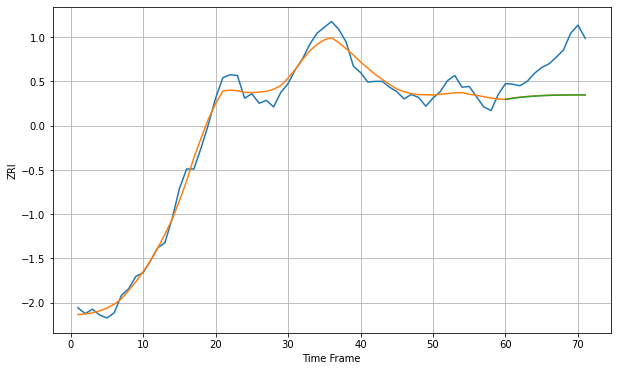

Wall time: 7.14 s
11235 12.029285459811938 53.60608231475427 53.78784356647974 [2090.31313394 2091.7487801  2093.03480957 2094.02663703 2094.77869303
 2095.33969939 2095.74884409 2096.03718094 2096.22933574 2096.3450633
 2096.40048945 2096.40901529]

Got an mse at 0.0099 in round 33 and stopped training

71 71 12


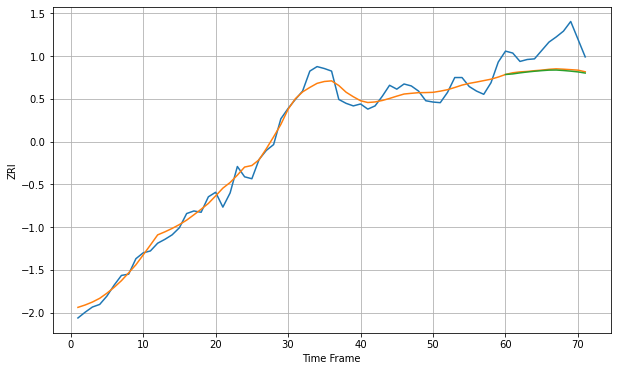

Wall time: 6.16 s
11236 13.106286847868411 41.104043705582576 42.63145195134923 [2103.74526192 2104.62218353 2106.24400956 2107.62572405 2108.76551392
 2109.71034592 2110.50396929 2110.65900097 2109.89452024 2108.91489901
 2107.75674497 2105.93527597]

Got an mse at 0.0099 in round 113 and stopped training

71 71 12


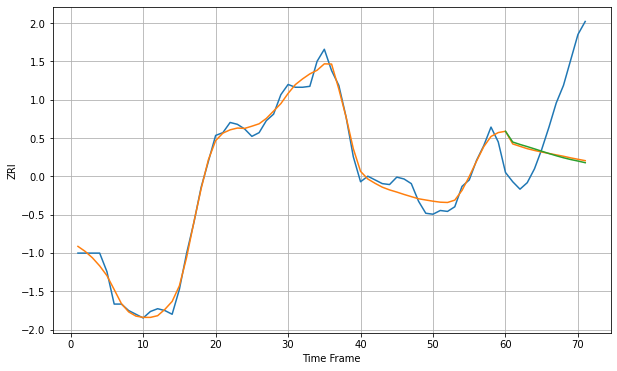

Wall time: 7.79 s
11237 8.189027530505458 75.94649500326443 77.31819336662824 [2461.48612777 2449.88202689 2447.27913008 2444.95100871 2442.50635403
 2439.98186625 2437.47336242 2435.08858074 2432.91512231 2431.00294018
 2429.36434059 2427.58657279]
71 71 12


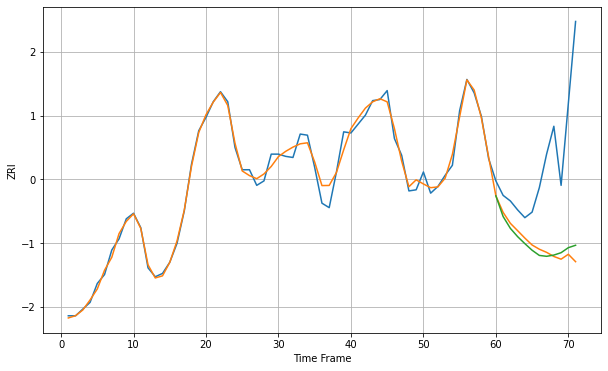

Wall time: 14.8 s
11238 6.162793729008006 89.4158255950003 86.39514498074513 [2689.58864476 2671.05316471 2660.42045232 2653.00832185 2646.71892832
 2640.79597612 2636.13935188 2635.35991851 2636.45657684 2638.59797418
 2643.10432013 2645.26366744]

Got an mse at 0.0099 in round 84 and stopped training

71 71 12


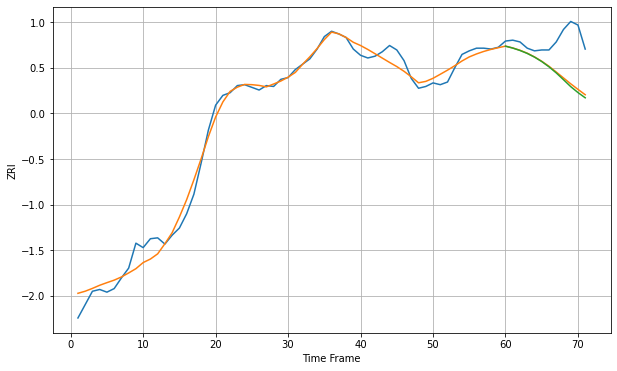

Wall time: 7.35 s
11354 10.10815965987577 38.32290239158492 40.108275148335395 [2118.26049903 2116.12767843 2113.42838959 2110.08812787 2105.98406979
 2101.00119576 2095.065067   2088.23630364 2080.60965021 2072.82591221
 2066.16491414 2060.27028664]

Got an mse at 0.0098 in round 31 and stopped training

71 71 12


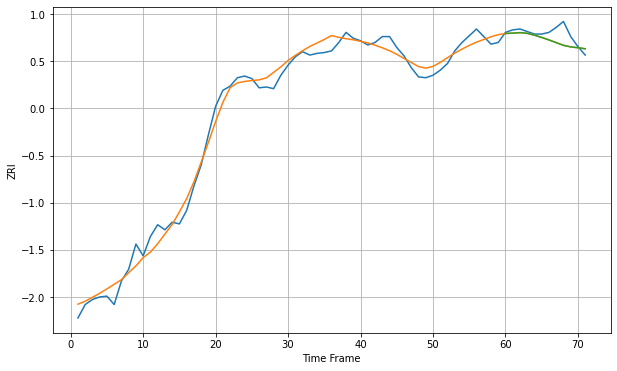

Wall time: 5.99 s
11355 10.962704776111147 11.108344904009698 11.140890309660263 [2185.69571589 2186.08764394 2186.78718463 2185.87078959 2183.66145584
 2180.99304322 2177.98049405 2174.77565299 2171.50729081 2169.80334683
 2168.70328228 2167.51958698]

Got an mse at 0.0094 in round 29 and stopped training

71 71 12


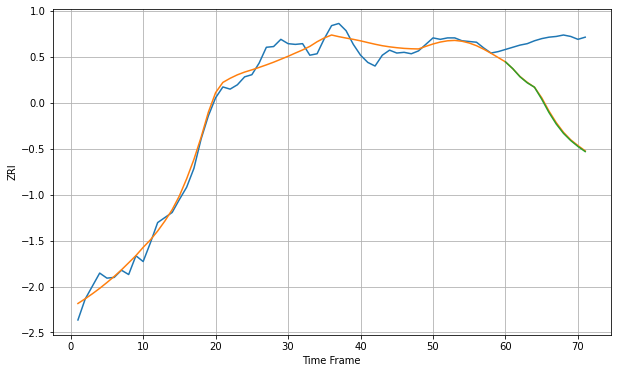

Wall time: 5.94 s
11356 12.353629294679465 102.79560010541623 103.8763438427436 [2184.69894979 2175.38960189 2164.11777117 2155.76325962 2149.60370516
 2133.03134997 2114.5505305  2098.65050136 2085.6831841  2075.71019111
 2067.48876975 2060.41329356]

Got an mse at 0.0100 in round 53 and stopped training

71 71 12


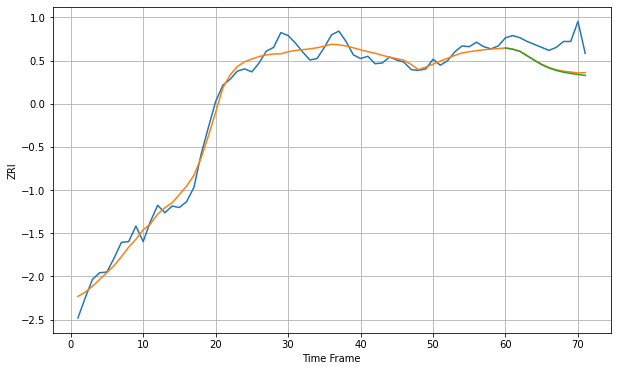

Wall time: 6.44 s
11357 11.5571695181858 32.19185932572576 33.38923392911911 [2219.23261254 2217.44761948 2214.56427845 2208.48022584 2202.49234651
 2196.69055695 2192.20670205 2188.92702911 2186.56954145 2184.8297781
 2183.44846952 2182.23206749]

Got an mse at 0.0097 in round 61 and stopped training

71 71 12


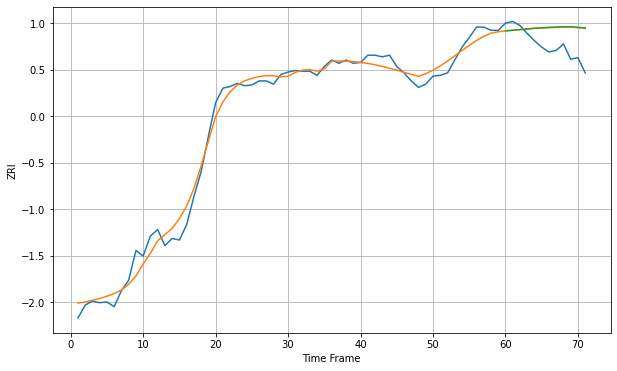

Wall time: 6.45 s
11358 11.192906842576681 27.882796323365163 28.17498469180145 [2209.34124763 2210.03476652 2210.81964175 2211.65954182 2212.5148923
 2213.12925325 2213.64110613 2214.05434347 2214.36379857 2214.45692817
 2213.75476964 2212.93746704]

Got an mse at 0.0098 in round 61 and stopped training

71 71 12


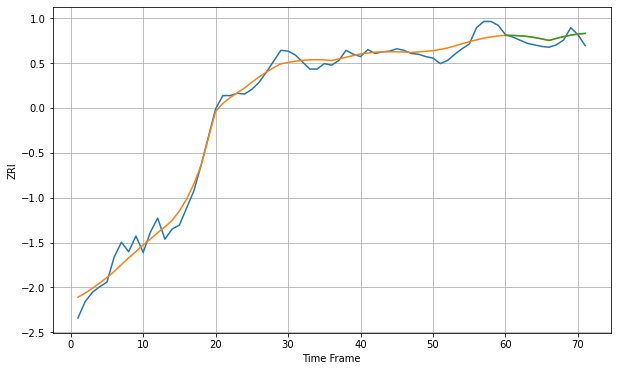

Wall time: 6.97 s
11360 11.319547147831424 8.122124892280317 8.213726037907207 [2273.21463816 2273.05138305 2272.69305247 2271.87664641 2270.57131016
 2268.76963354 2266.79468213 2269.32380424 2271.59983472 2273.44606631
 2274.81963715 2275.70850343]

Got an mse at 0.0096 in round 52 and stopped training

71 71 12


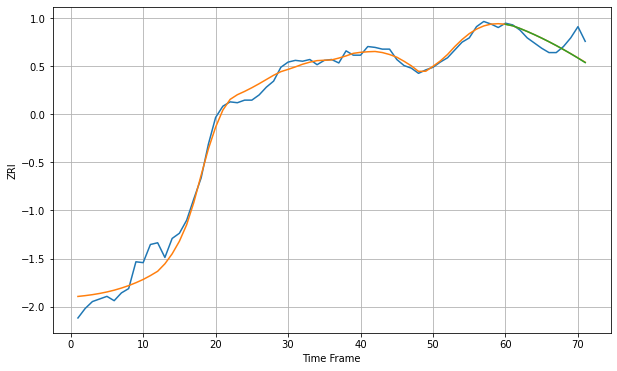

Wall time: 6.81 s
11361 10.453314764425999 15.151441235496018 15.237071606587062 [2207.73446661 2205.98129744 2202.904965   2199.42579567 2195.70337246
 2191.74629935 2187.56211393 2183.15805883 2178.54063666 2173.71470008
 2168.68293162 2163.44660733]

Got an mse at 0.0098 in round 37 and stopped training

71 71 12


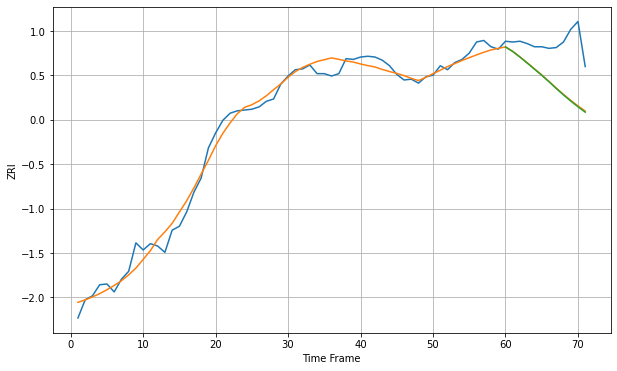

Wall time: 6.12 s
11364 11.01420607635664 53.709344861318264 54.3309061643487 [2244.78602235 2238.98130098 2231.89485625 2224.3718806  2216.65041409
 2208.9580736  2200.78083596 2192.29141462 2184.13371846 2176.3811848
 2169.08902033 2162.30846854]

Got an mse at 0.0097 in round 47 and stopped training

71 71 12


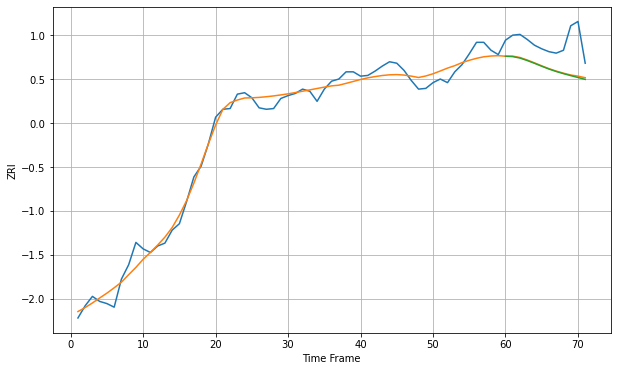

Wall time: 6.18 s
11365 11.931774127224106 38.07524362304791 38.938415294195345 [2217.70607823 2217.17070019 2215.14898262 2211.7206068  2207.86042418
 2203.80001847 2199.87518121 2196.47426924 2193.49272173 2190.75523441
 2188.13965265 2185.50283661]

Got an mse at 0.0099 in round 49 and stopped training

71 71 12


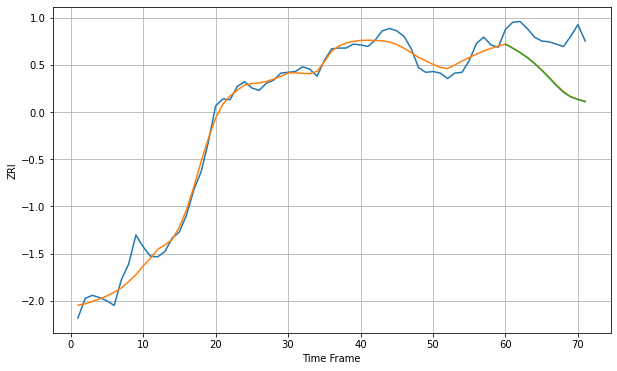

Wall time: 6.22 s
11366 11.896295855715143 54.685855500531744 55.08158342734257 [2207.99521535 2202.94013571 2197.29878857 2190.93084031 2183.22794973
 2174.57754235 2165.06475722 2155.35832205 2146.51063722 2140.61500244
 2137.23213945 2134.53895355]

Got an mse at 0.0095 in round 26 and stopped training

71 71 12


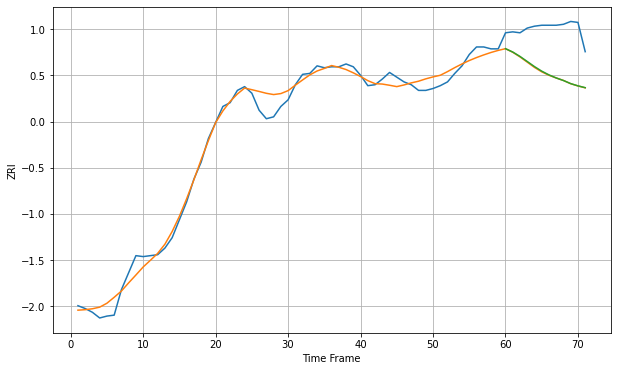

Wall time: 5.87 s
11367 9.151008062315585 47.3028987602838 47.02317081380049 [2062.17744555 2058.64653127 2053.98404135 2048.6181748  2043.2171649
 2038.39402369 2034.41605836 2031.18030286 2028.44357717 2025.18870032
 2022.80708912 2020.91195653]

Got an mse at 0.0098 in round 41 and stopped training

71 71 12


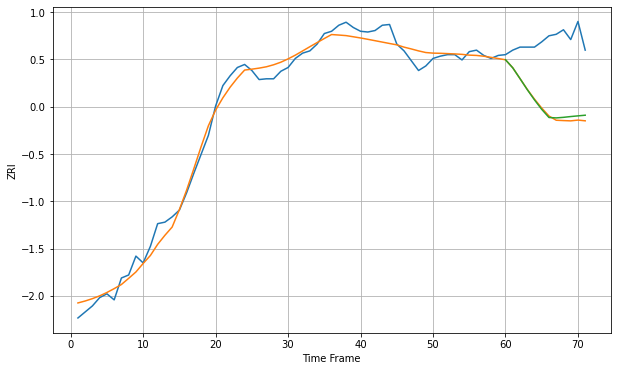

Wall time: 6.07 s
11368 12.190366421610415 88.58925287117448 86.31129814380242 [2206.2243765  2195.55668699 2181.31211329 2166.7066538  2153.0403987
 2140.47580059 2129.70887346 2129.1816308  2129.92937009 2130.97246452
 2131.87804285 2132.74895303]

Got an mse at 0.0098 in round 38 and stopped training

71 71 12


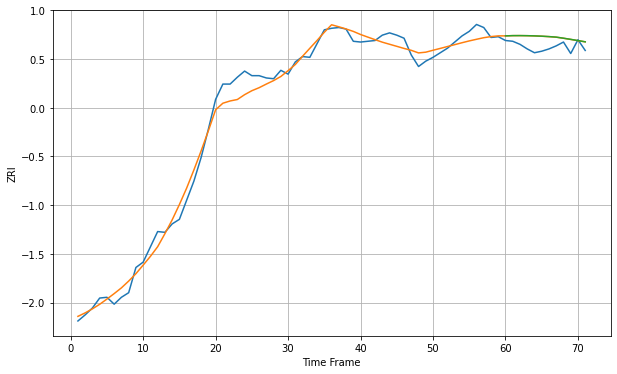

Wall time: 6.22 s
11369 12.195763273414427 13.746419018071634 13.7988630608449 [2251.06355365 2251.40320299 2251.44157829 2251.32827367 2251.07396295
 2250.67712753 2250.1345809  2249.44635458 2248.0389879  2246.50257483
 2244.93246916 2243.29076451]

Got an mse at 0.0099 in round 58 and stopped training

71 71 12


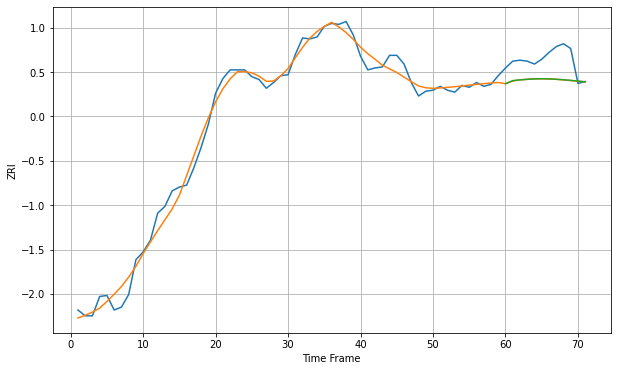

Wall time: 6.79 s
11370 9.033927943890824 23.222639242584336 23.132939444320296 [2145.72193848 2148.88514988 2149.70643303 2150.23901478 2150.69498542
 2150.82736171 2150.68836093 2150.33177211 2149.80824772 2149.16274131
 2148.43262081 2147.64631357]

Got an mse at 0.0099 in round 35 and stopped training

71 71 12


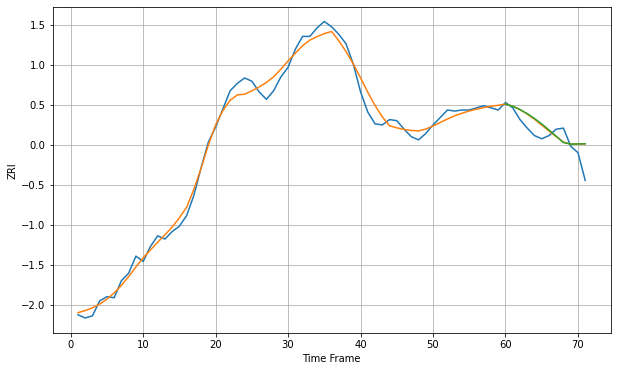

Wall time: 6.38 s
11372 7.374441953811414 13.388111901239013 13.626510578101275 [1988.5558136  1986.48579657 1983.41725125 1979.56579627 1975.03093956
 1969.90734875 1964.27625831 1958.357074   1952.43167816 1951.02246177
 1951.15864563 1951.26436668]

Got an mse at 0.0100 in round 67 and stopped training

71 71 12


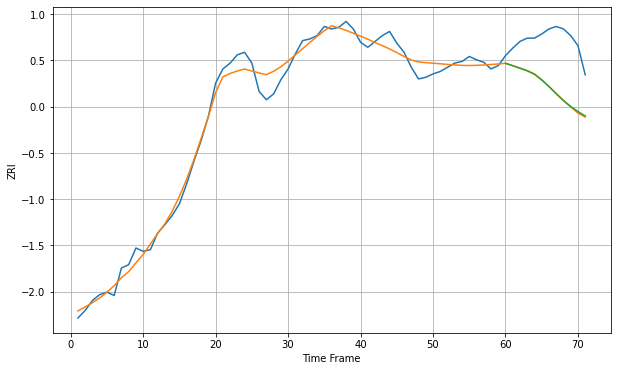

Wall time: 6.76 s
11373 11.035543241572949 59.93317976397135 59.628742763990644 [2152.75049242 2149.86277073 2146.88682351 2143.86392155 2139.64075916
 2132.80735088 2124.85518081 2116.24981192 2108.015522   2100.89250185
 2094.86060307 2089.56006729]

Got an mse at 0.0099 in round 90 and stopped training

71 71 12


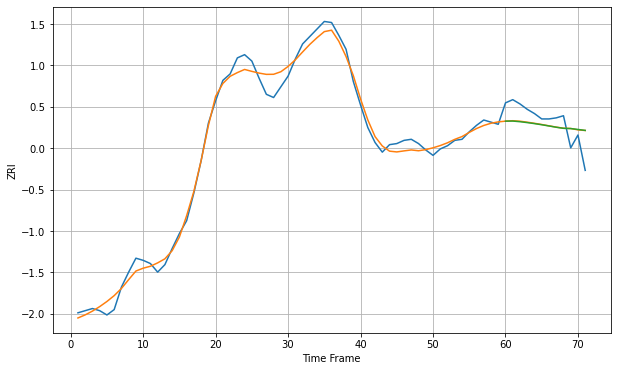

Wall time: 6.96 s
11374 7.625891670648107 16.27326558047909 16.42476022437922 [1999.9464236  2000.01946662 1999.41546977 1998.57937283 1997.63188467
 1996.58211773 1995.44163954 1994.24181566 1993.25276954 1993.00636342
 1992.19058877 1991.30826315]

Got an mse at 0.0100 in round 68 and stopped training

71 71 12


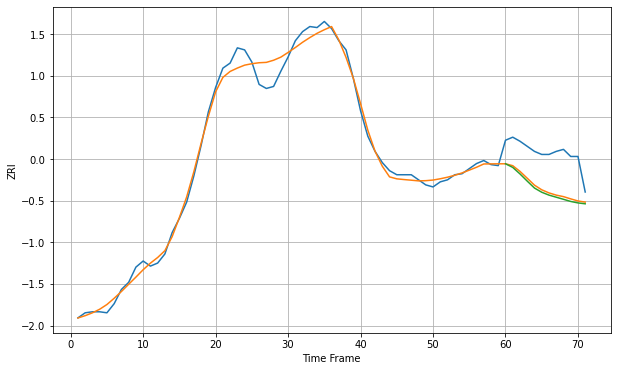

Wall time: 6.49 s
11375 8.182219576625567 35.04779297929174 37.16854522548769 [1984.78994484 1981.23943891 1974.8064186  1967.72305293 1960.89392951
 1956.76567504 1953.93333654 1951.87915706 1949.80498506 1947.68783662
 1946.2582666  1945.38187422]

Got an mse at 0.0094 in round 40 and stopped training

71 71 12


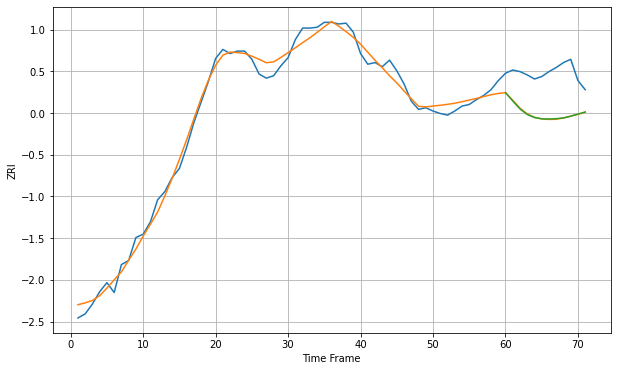

Wall time: 6 s
11377 9.518552044689532 50.12047015089441 50.131663188379804 [2118.3752749  2108.26784979 2098.55737378 2091.79413667 2088.11554986
 2086.5459804  2086.2549102  2086.71751561 2087.60304874 2089.80100941
 2092.28728564 2094.79930125]

Got an mse at 0.0098 in round 87 and stopped training

71 71 12


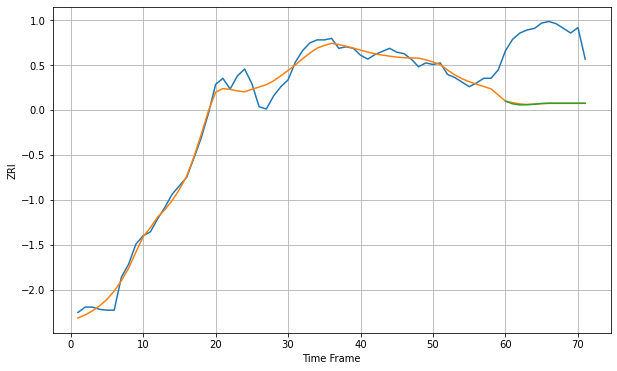

Wall time: 6.95 s
11378 11.524884044971563 92.60068599524716 92.85488315086555 [2095.21111864 2091.70128089 2090.29083657 2090.6120311  2091.24098297
 2092.10889646 2092.4395782  2092.4395782  2092.4395782  2092.4395782
 2092.4395782  2092.4395782 ]

Got an mse at 0.0100 in round 28 and stopped training

71 71 12


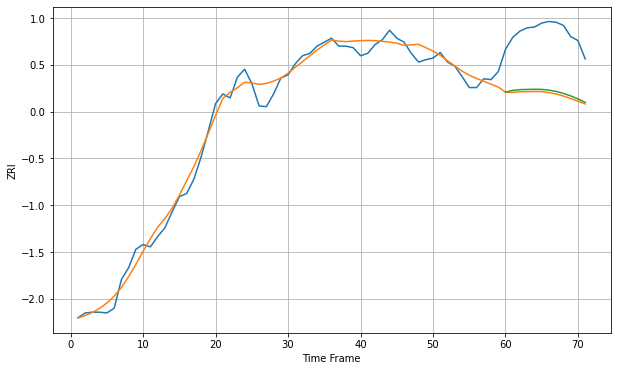

Wall time: 5.8 s
11379 11.346536960459565 77.90972323576054 75.22706048882121 [2094.28168338 2096.48291096 2097.40794063 2097.63790118 2097.87433992
 2097.67357558 2096.79571608 2095.13225428 2092.67564092 2089.49408646
 2085.71133442 2081.48614986]

Got an mse at 0.0087 in round 28 and stopped training

71 71 12


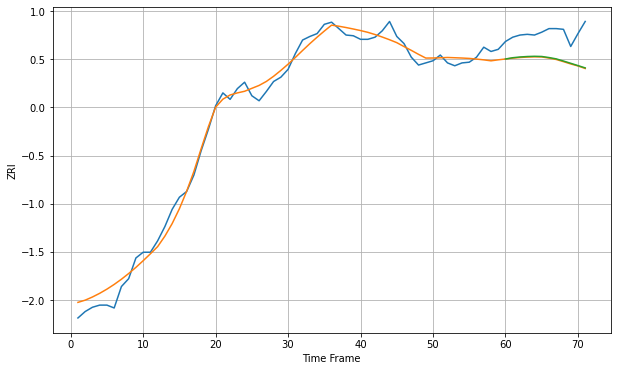

Wall time: 5.93 s
11385 12.090672287074664 38.94153264021372 38.254523377034296 [2147.46481497 2149.27089018 2150.2843759  2150.93631139 2151.243962
 2150.99383894 2149.49893557 2147.64921569 2144.62142996 2141.45678312
 2138.23056513 2135.0280479 ]

Got an mse at 0.0098 in round 27 and stopped training

71 71 12


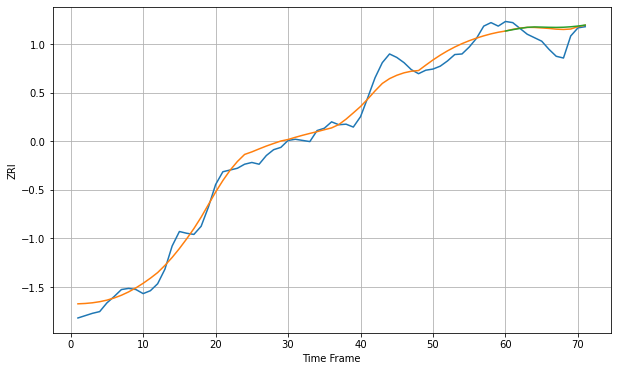

Wall time: 5.86 s
11412 16.321322813471316 24.90616115884248 26.607265242842264 [2198.5269321  2200.83720977 2203.0461375  2204.85143896 2205.56322912
 2205.31553141 2204.94473337 2204.77847671 2205.04488494 2205.8394945
 2207.12377652 2208.76751453]

Got an mse at 0.0088 in round 22 and stopped training

71 71 12


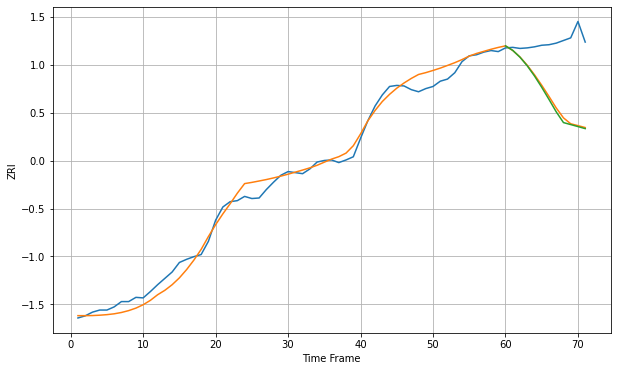

Wall time: 5.64 s
11413 15.847607313945698 110.81557594122899 113.96525024253744 [2244.81662346 2236.31106721 2223.38324647 2207.07775517 2187.86364497
 2166.40835369 2143.51683088 2120.0117379  2099.68262898 2095.90485521
 2092.13488033 2088.27897843]

Got an mse at 0.0098 in round 20 and stopped training

71 71 12


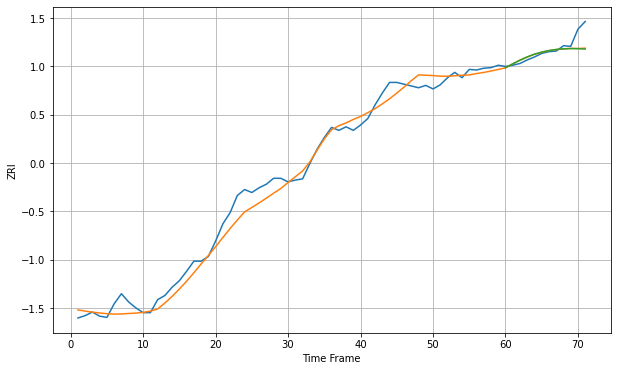

Wall time: 5.68 s
11414 16.157371259144757 16.43708236995795 16.85383599182558 [2189.74655653 2196.34096033 2202.66538314 2208.16928769 2212.81980467
 2216.25746639 2218.82909874 2220.64551903 2221.75767036 2222.21460697
 2222.06895549 2221.37051051]

Got an mse at 0.0097 in round 23 and stopped training

71 71 12


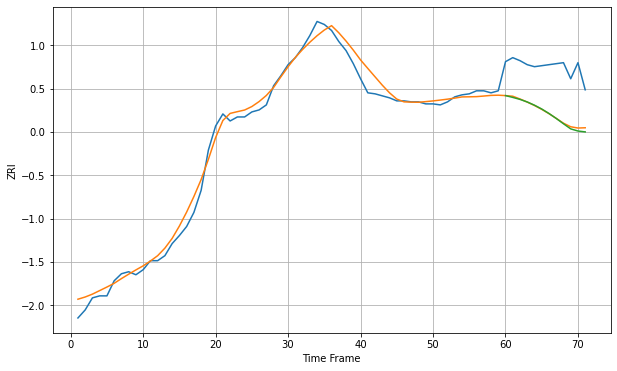

Wall time: 5.7 s
11415 8.46104333549906 46.29933214753091 47.23006255297367 [1916.24541809 1914.45277944 1912.46830177 1909.89993675 1906.69349659
 1902.90811657 1898.46516531 1893.51998489 1888.23362842 1883.12588695
 1881.00942117 1880.13132356]

Got an mse at 0.0098 in round 29 and stopped training

71 71 12


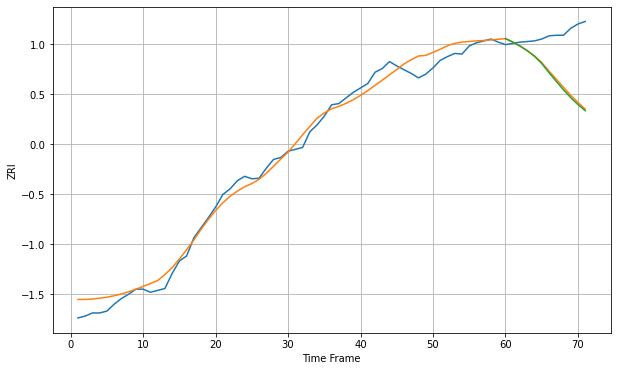

Wall time: 5.79 s
11416 14.73817339855572 72.95149981665418 75.21022393476404 [2183.62291227 2178.29564233 2171.86115903 2164.35429544 2155.48260586
 2144.00286714 2129.36952319 2115.46987096 2101.98592289 2089.5234587
 2078.43010232 2068.6762321 ]

Got an mse at 0.0099 in round 21 and stopped training

71 71 12


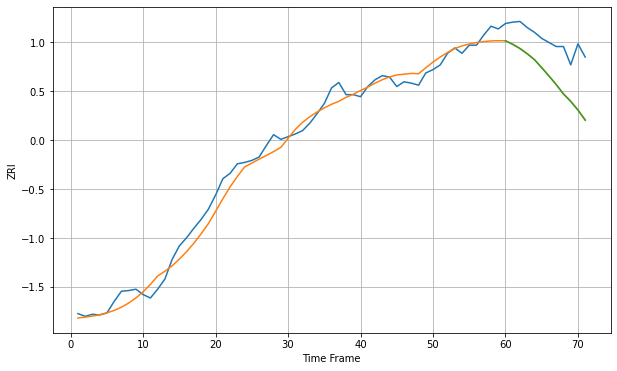

Wall time: 5.63 s
11417 14.167941999842098 57.46934345870929 57.75780956408214 [2098.47697772 2093.18293763 2086.98168417 2079.27690973 2070.61219898
 2058.72890138 2046.53897679 2033.75052735 2019.9588706  2009.01701618
 1996.19764382 1981.20977782]

Got an mse at 0.0097 in round 30 and stopped training

71 71 12


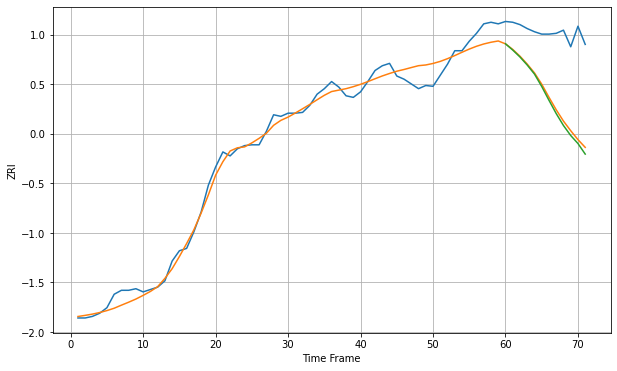

Wall time: 5.91 s
11418 12.136827063145402 86.65126964849243 90.74773714451315 [2052.70765728 2044.82903485 2036.05089576 2025.8570665  2014.45848567
 1998.7389499  1981.31654029 1964.46722985 1949.39380136 1936.75778513
 1926.61935883 1913.26161785]

Got an mse at 0.0097 in round 28 and stopped training

71 71 12


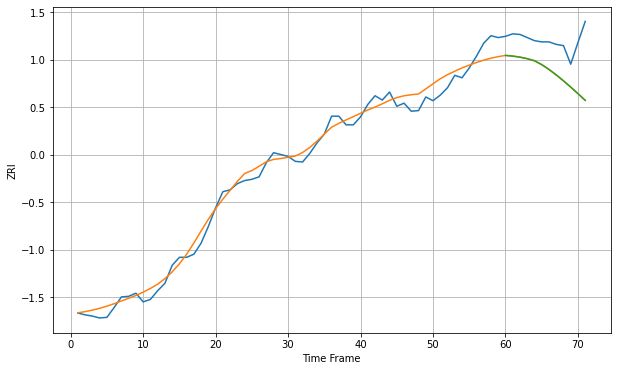

Wall time: 5.8 s
11419 14.612388829331891 57.14470722637228 57.19886507347439 [2153.1636609  2151.98370575 2150.25140498 2147.76303262 2144.39915964
 2138.34520692 2130.70078526 2121.77973631 2112.2136571  2102.04064697
 2091.37472436 2080.40385025]

Got an mse at 0.0092 in round 24 and stopped training

71 71 12


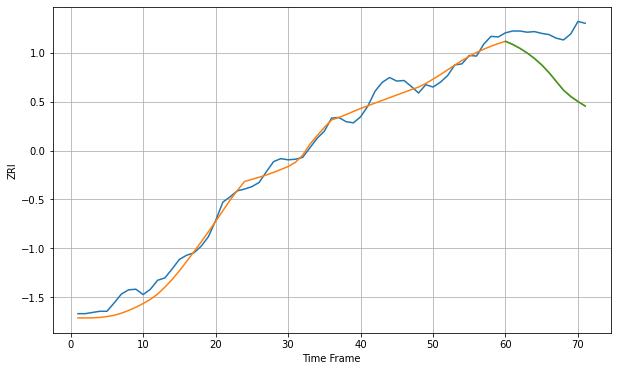

Wall time: 5.9 s
11420 14.798776170169987 77.47395692219277 77.67298609806483 [2166.75216881 2161.4219515  2154.88949049 2147.05065764 2137.84102855
 2127.03729122 2114.18143405 2099.40484831 2084.85575697 2073.95784599
 2065.69945727 2058.15665012]

Got an mse at 0.0089 in round 34 and stopped training

71 71 12


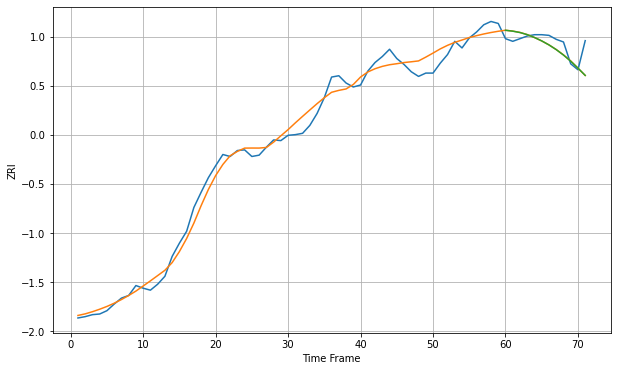

Wall time: 6.04 s
11421 13.55894119902615 18.73709517125641 18.72670751525189 [2145.70778008 2144.33318538 2142.2688062  2139.07534004 2134.74702146
 2129.61124625 2123.55539816 2116.46626315 2108.25458996 2098.90657603
 2088.55300631 2077.52503056]

Got an mse at 0.0100 in round 31 and stopped training

71 71 12


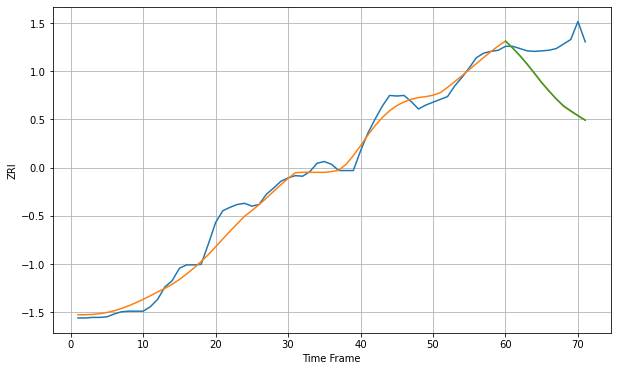

Wall time: 5.98 s
11422 16.275347907505928 88.55283992200145 88.24545481419985 [2238.26789132 2225.83794441 2212.28985454 2197.29522139 2181.27035872
 2164.77762445 2150.04394943 2136.06487754 2123.77585778 2114.876657
 2106.34777258 2098.18457878]

Got an mse at 0.0094 in round 39 and stopped training

71 71 12


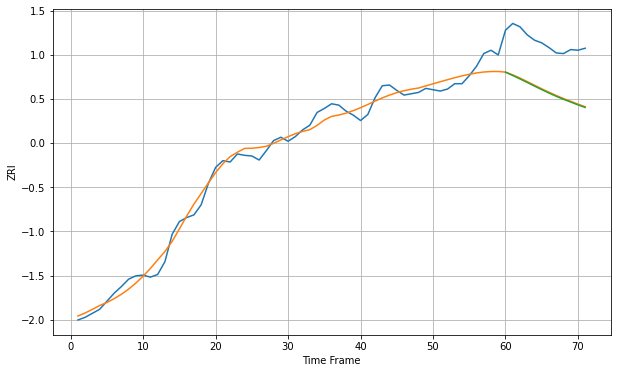

Wall time: 6.02 s
11423 12.402272872842959 72.39369519378948 73.47665832339982 [2043.29145717 2038.25165969 2033.16054254 2027.84979971 2022.46836258
 2017.15753532 2012.03819669 2007.20401113 2002.71663279 1998.60499463
 1994.35694333 1990.56093608]

Got an mse at 0.0099 in round 86 and stopped training

71 71 12


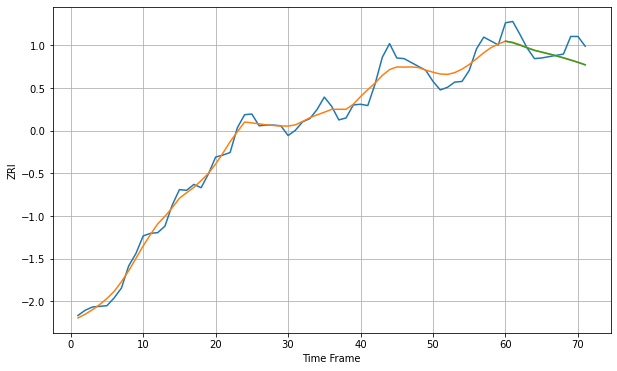

Wall time: 6.76 s
11426 12.92450665041447 22.43709108864846 22.597295615782798 [2135.76877644 2133.36416477 2129.54003834 2125.52593543 2121.69277887
 2119.06263034 2116.29115771 2113.3449481  2110.20175587 2106.84040354
 2103.26049758 2099.50611603]

Got an mse at 0.0100 in round 89 and stopped training

71 71 12


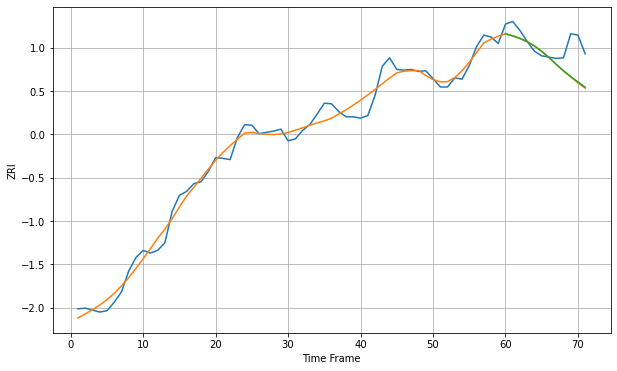

Wall time: 6.95 s
11427 13.294307534352992 34.276793278509615 33.750602916630015 [2163.98063074 2160.88184162 2156.90856858 2151.77475654 2145.18597078
 2136.95422363 2127.27082519 2116.9010535  2106.93453301 2098.19545963
 2089.6639522  2081.57887245]

Got an mse at 0.0099 in round 70 and stopped training

71 71 12


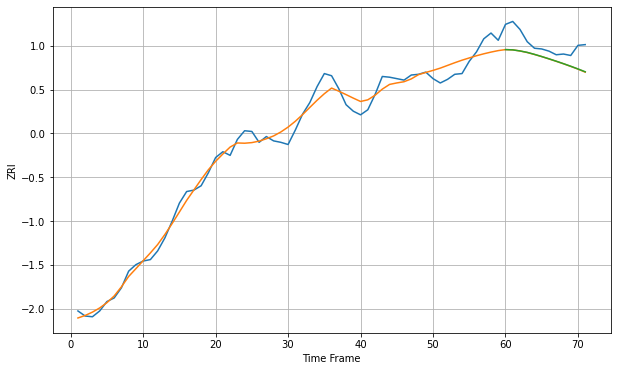

Wall time: 6.62 s
11428 11.966353538160375 24.454161050202597 24.32098984454069 [2046.14158523 2045.74915885 2044.26907206 2042.29391337 2039.5231033
 2036.53232265 2033.37461891 2030.08616929 2026.67459767 2023.12309973
 2019.40289618 2015.49070705]

Got an mse at 0.0099 in round 68 and stopped training

71 71 12


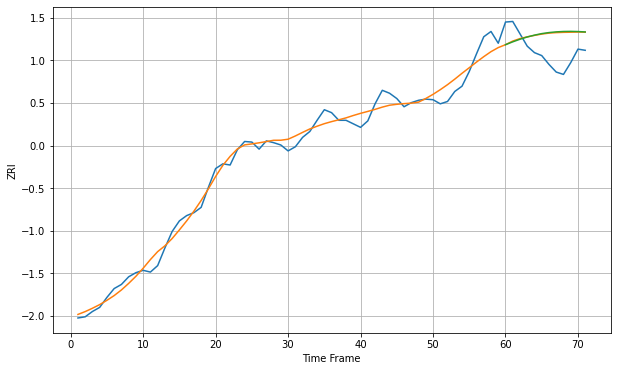

Wall time: 6.55 s
11429 14.332542771480613 42.823137534611554 43.686140660481804 [2120.49769161 2125.34765969 2129.80686458 2133.60643397 2136.77399348
 2139.34977873 2141.11874022 2142.30764417 2142.97140069 2143.14659945
 2142.87077944 2142.185588  ]

Got an mse at 0.0093 in round 36 and stopped training

71 71 12


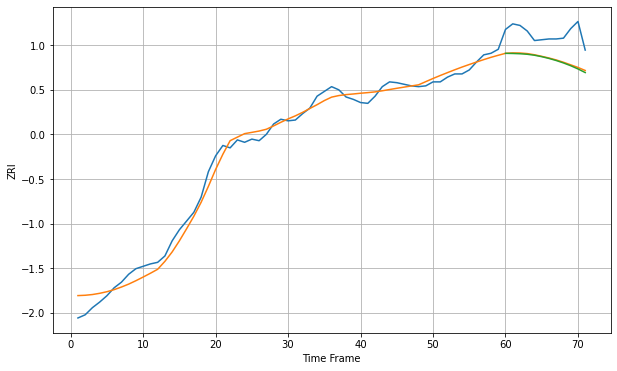

Wall time: 5.92 s
11432 10.079009895063756 33.260818864306 34.23596603722296 [1985.91339634 1985.73445948 1985.39687819 1984.73671929 1983.51199132
 1981.69999605 1979.48836239 1976.86915839 1973.82186133 1970.31385786
 1966.30029444 1961.72910128]

Got an mse at 0.0097 in round 38 and stopped training

71 71 12


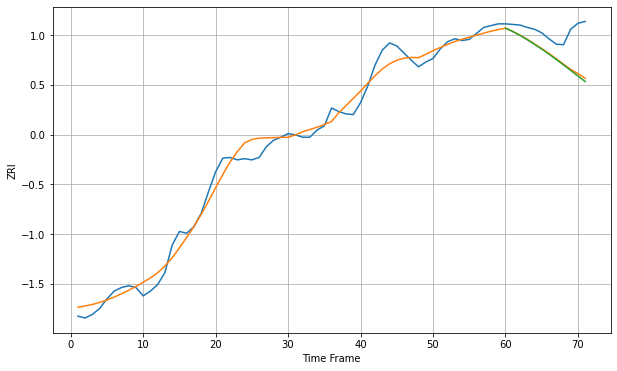

Wall time: 5.98 s
11433 16.2017009646362 45.78602129048936 47.911136847344736 [2200.81200032 2195.14432138 2188.63823404 2181.42611748 2173.70663696
 2165.59274856 2157.12714495 2148.32662009 2139.22328684 2129.89630018
 2120.49000833 2111.20744384]

Got an mse at 0.0098 in round 26 and stopped training

71 71 12


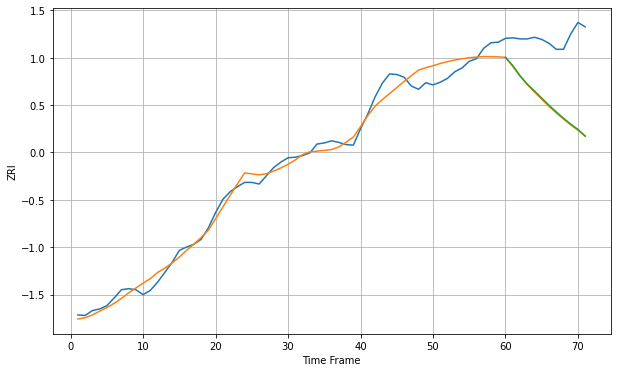

Wall time: 5.73 s
11434 16.309867494716944 124.62055715766842 123.43870972261799 [2160.40887838 2145.17399843 2126.92756882 2111.39945542 2098.89422169
 2085.75394292 2072.9694463  2060.74562743 2049.22123423 2038.51687173
 2028.72405005 2016.55108591]

Got an mse at 0.0091 in round 50 and stopped training

71 71 12


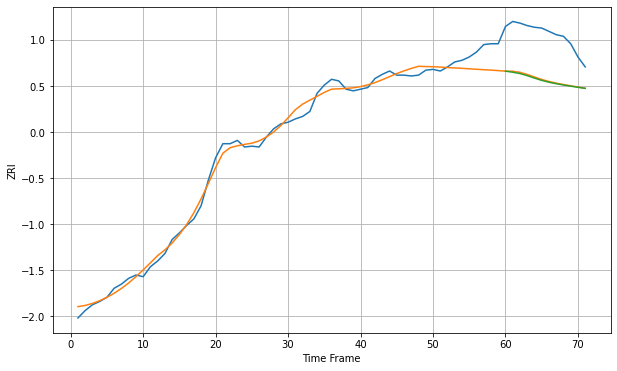

Wall time: 6.35 s
11435 10.243829405772573 54.940106793626924 55.80361312909132 [1957.83573642 1956.53685331 1954.90822322 1952.39940137 1949.42983564
 1946.66308306 1944.43616615 1942.63543749 1941.07149152 1939.6408531
 1938.28814075 1936.96931683]

Got an mse at 0.0097 in round 36 and stopped training

71 71 12


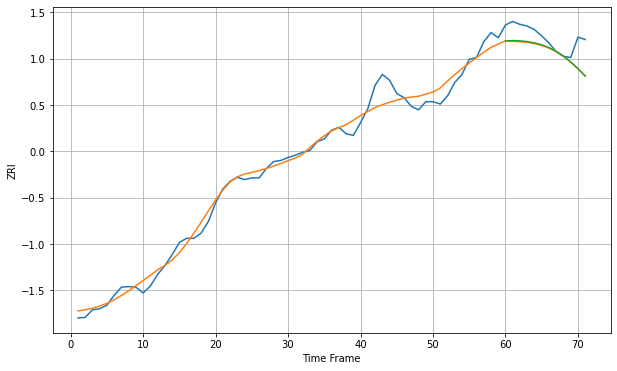

Wall time: 5.92 s
11436 15.54736497762903 30.936853823877023 30.356802413857288 [2112.61595881 2113.13238042 2112.68215145 2111.43537606 2109.21525948
 2105.81080627 2100.98111146 2094.5060723  2086.2589093  2076.281942
 2064.84334932 2052.44053583]

Got an mse at 0.0100 in round 51 and stopped training

71 71 12


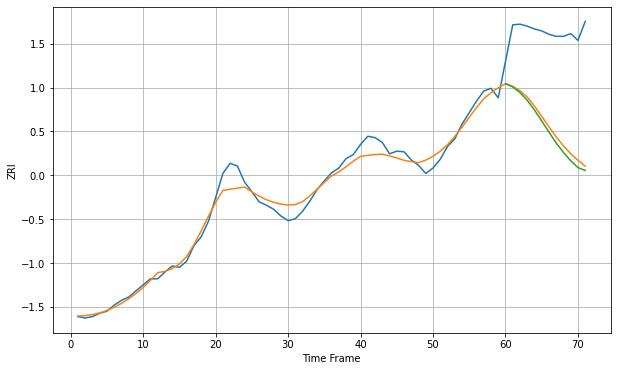

Wall time: 6.2 s
11542 12.704584921854993 140.08561177696058 146.939803714814 [2366.87146    2362.16921024 2353.62668807 2342.23553238 2327.89490452
 2311.69951769 2295.07488005 2279.03306858 2265.07669313 2252.85290224
 2242.58993479 2238.46862064]

Got an mse at 0.0100 in round 209 and stopped training

71 71 12


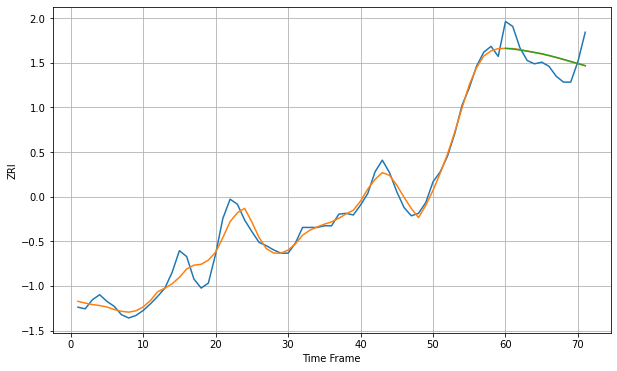

Wall time: 9.69 s
11550 10.720037554494485 22.00856863977888 22.170833215229685 [2255.61118846 2254.83104815 2253.64470396 2252.2885855  2250.78453838
 2249.14968838 2247.03459525 2244.75901546 2242.37356725 2239.89504862
 2237.34160577 2234.7341623 ]

Got an mse at 0.0095 in round 34 and stopped training

71 71 12


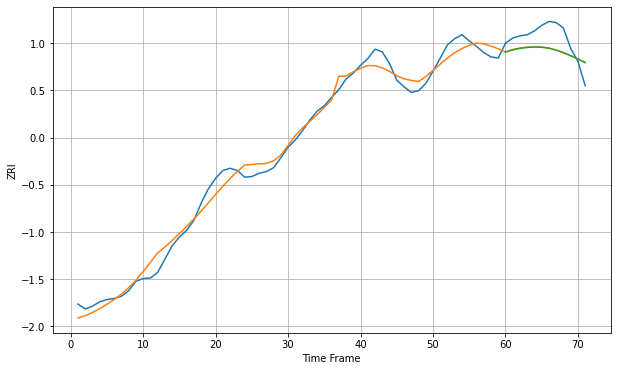

Wall time: 5.91 s
11561 16.244018460210285 32.58173656086907 32.69796358300382 [2482.89470187 2486.79829902 2489.50533556 2491.19340638 2491.85768373
 2491.52071039 2489.83577644 2486.2421351  2481.65298918 2476.23852692
 2470.20277263 2463.7628562 ]

Got an mse at 0.0100 in round 147 and stopped training

71 71 12


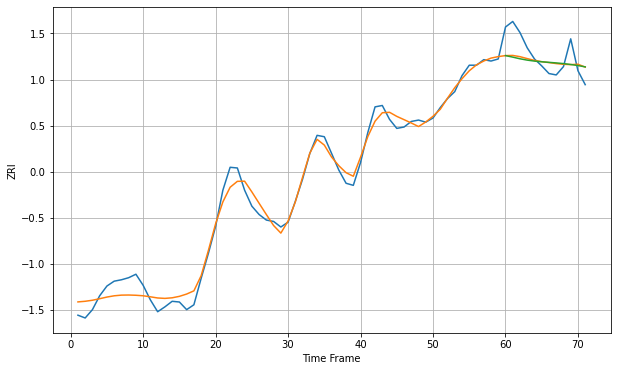

Wall time: 8.05 s
11563 13.188205231147391 26.149453009424917 27.031769741296802 [2295.8486431  2293.63927729 2291.25231726 2289.3172083  2287.91608185
 2286.92459911 2286.12608993 2285.31005436 2284.32069831 2283.06423626
 2281.49814704 2279.61700114]

Got an mse at 0.0099 in round 126 and stopped training

71 71 12


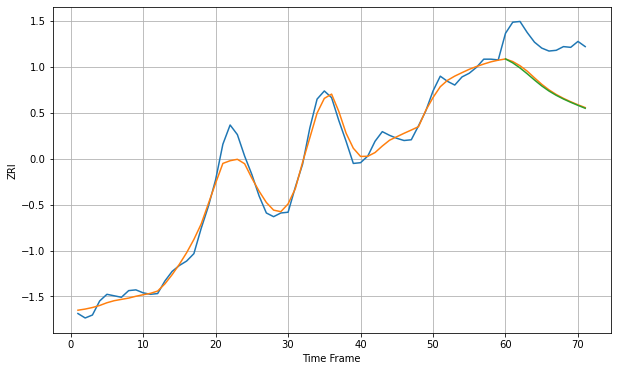

Wall time: 7.6 s
11580 12.287898279222908 61.81217533878337 63.33087138451804 [2209.29925069 2204.00536684 2197.17186088 2189.23258015 2180.81234887
 2172.83679415 2165.93024981 2160.11940985 2155.12747867 2150.67549506
 2146.5549148  2142.59720083]

Got an mse at 0.0099 in round 56 and stopped training

71 71 12


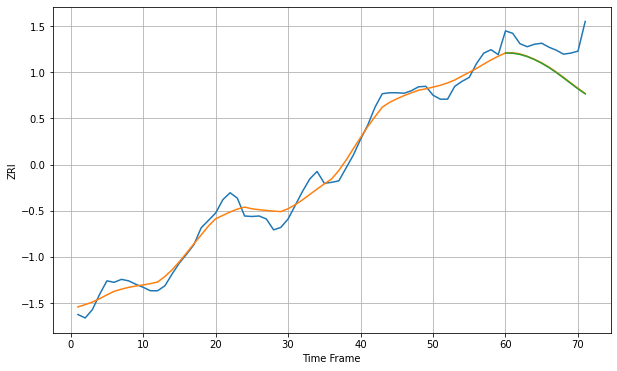

Wall time: 6.86 s
11590 18.460165598066997 59.849862825345824 60.57562766997426 [2565.28546815 2564.79468098 2562.36740574 2558.10297223 2551.99589043
 2544.50500233 2535.75340113 2525.87117814 2515.10583904 2503.91612588
 2492.92621438 2482.70625848]

Got an mse at 0.0095 in round 36 and stopped training

71 71 12


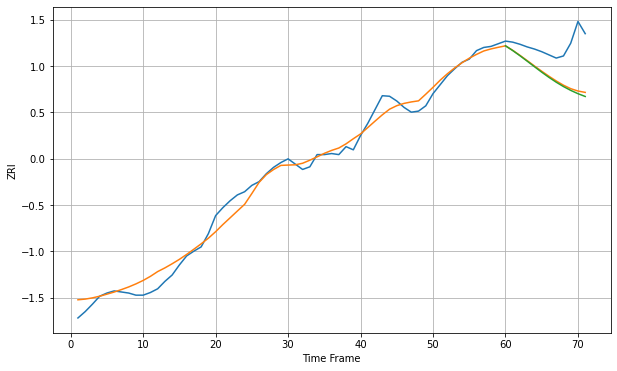

Wall time: 6.26 s
11691 16.782850870415956 62.663407794362826 65.68786011580195 [2204.06096764 2195.13376401 2185.34583102 2175.09161879 2164.66349666
 2154.38876678 2144.58316702 2135.49852748 2127.30397248 2120.09057553
 2113.87435045 2108.60025119]

Got an mse at 0.0091 in round 29 and stopped training

71 71 12


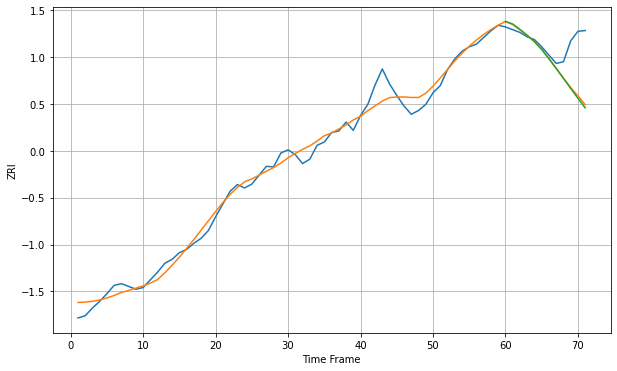

Wall time: 5.96 s
11692 15.670959990972786 57.73786020659161 59.81488277441703 [2217.84269634 2213.1223774  2203.42453564 2192.82685313 2181.46092283
 2167.15651298 2150.4084699  2132.84528166 2114.86673427 2096.80724187
 2078.9851793  2061.67135173]

Got an mse at 0.0096 in round 36 and stopped training

71 71 12


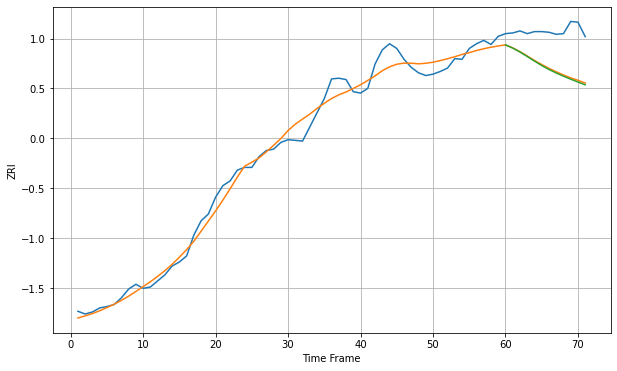

Wall time: 5.93 s
11694 14.026451833788467 54.60273960987047 56.153640132771244 [2142.32412456 2137.59683334 2131.79823787 2125.14297835 2118.33864167
 2111.77987239 2105.92963313 2100.74382928 2096.01382789 2091.57269374
 2087.33236373 2083.27838141]
71 71 12


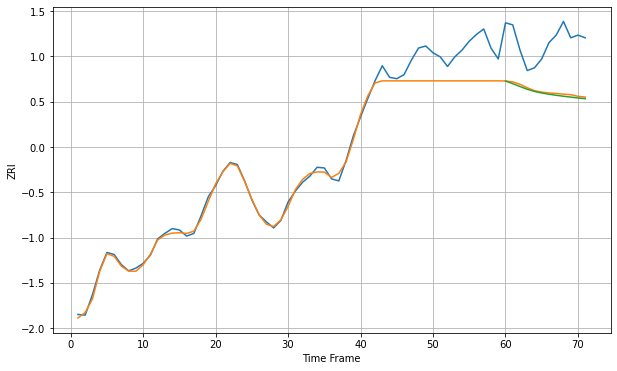

Wall time: 14.4 s
11758 22.91252274955684 75.12300669615028 77.30532557866772 [2376.6333997  2372.63790269 2368.52737869 2364.49309375 2361.32584027
 2359.01850044 2357.21457894 2355.66007237 2354.25872502 2353.00552259
 2351.73775719 2350.6679652 ]

Got an mse at 0.0100 in round 166 and stopped training

71 71 12


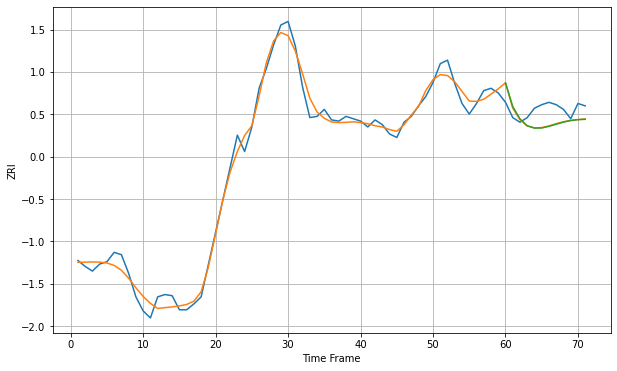

Wall time: 8.45 s
12047 7.1839386425517855 13.393626864866304 13.68661353944021 [1147.62714554 1127.41374224 1116.87174954 1110.95868171 1109.02184151
 1109.10927025 1110.51858212 1112.33828457 1114.07455459 1115.42323709
 1116.23641654 1116.48109997]

Got an mse at 0.0099 in round 169 and stopped training

71 71 12


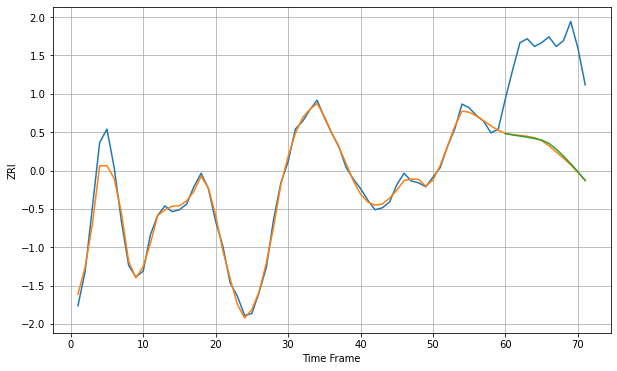

Wall time: 8.38 s
12180 3.9433611852344876 52.789332508366385 52.439682399190815 [999.64890421 998.9090902  998.36456315 997.75959607 997.06698944
 996.26378019 994.49065539 991.55584063 987.91550644 983.97365636
 979.73952956 975.19689839]

Got an mse at 0.0099 in round 131 and stopped training

71 71 12


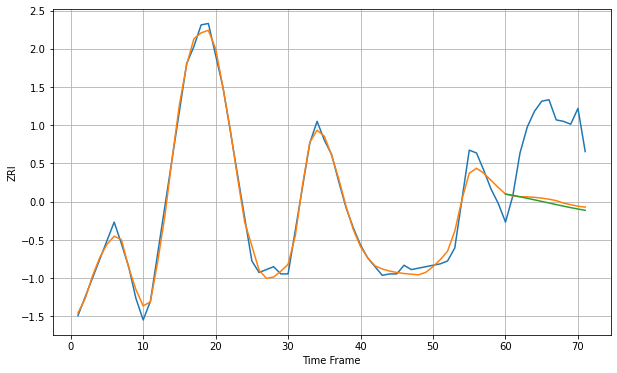

Wall time: 7.89 s
12182 5.232952632587536 51.75209064255703 53.518456772433716 [998.47492173 997.65232175 996.61258306 995.54783876 994.46674053
 993.37281229 992.27130701 991.17229821 990.0927911  989.05515863
 988.08127478 987.18566549]

Got an mse at 0.0099 in round 91 and stopped training

71 71 12


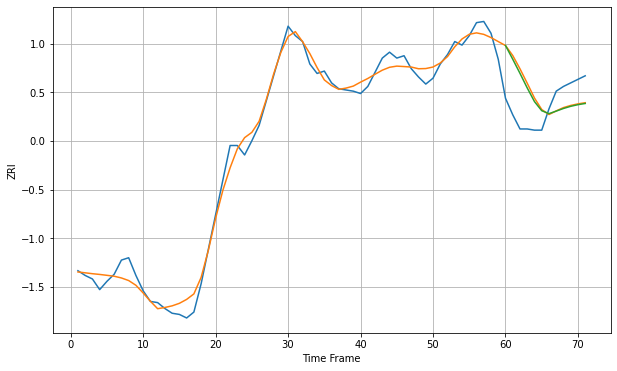

Wall time: 6.95 s
12189 8.129611575791055 31.06468787478938 29.6205151808754 [1140.62623059 1129.04362993 1117.06124962 1104.70737633 1093.15007744
 1085.46288345 1082.96516947 1085.1182418  1087.34915758 1089.18248411
 1090.56416142 1091.57089738]

Got an mse at 0.0100 in round 148 and stopped training

71 71 12


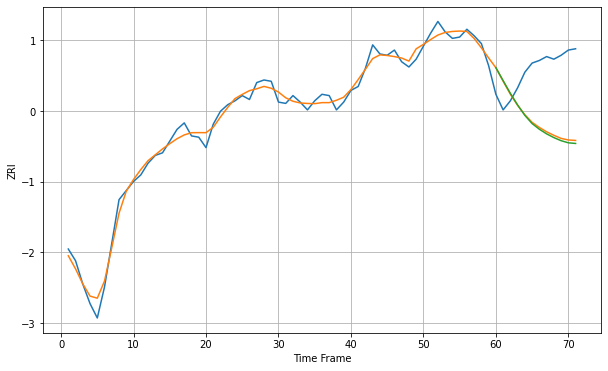

Wall time: 8.14 s
12202 5.387821597019701 47.88301360705924 49.21141895698163 [1101.44319385 1091.50811483 1081.72941727 1072.7343522  1064.79258144
 1058.47798478 1054.12376769 1050.58630916 1047.69447618 1045.32290206
 1043.69826809 1043.19385667]

Got an mse at 0.0099 in round 77 and stopped training

71 71 12


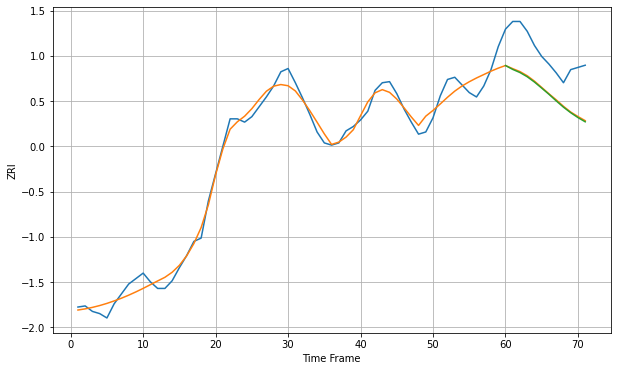

Wall time: 6.9 s
12203 8.165709990179026 37.05035340664285 37.77833494568585 [1280.72554783 1277.16706961 1274.30704409 1270.46494901 1265.60474591
 1260.06744114 1254.42607138 1248.42076101 1242.6718119  1237.59629898
 1233.15654066 1229.30139092]

Got an mse at 0.0098 in round 52 and stopped training

71 71 12


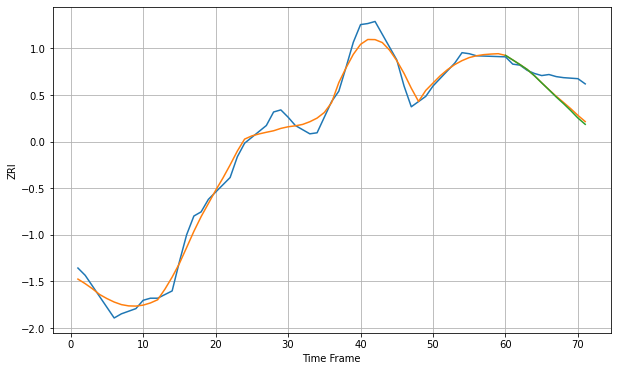

Wall time: 6.38 s
12206 8.665140884059776 19.635344714871852 20.827806506474964 [1238.40082954 1234.00093637 1229.5268928  1224.82419967 1218.78749576
 1211.96953209 1205.27746247 1198.41204585 1192.09105562 1185.3591962
 1178.15472074 1172.14888028]

Got an mse at 0.0099 in round 143 and stopped training

71 71 12


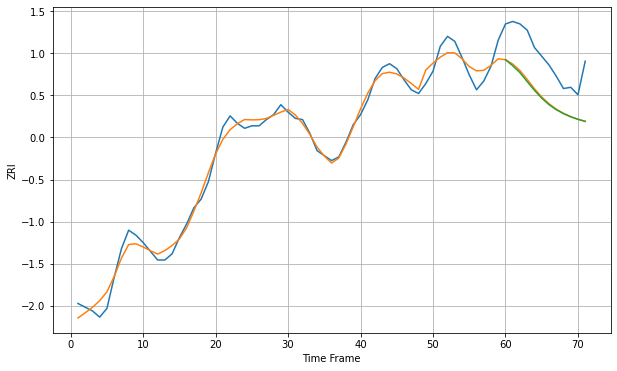

Wall time: 7.94 s
12208 6.693178377595794 32.323516374829765 33.083961387849534 [1268.19568298 1263.33873396 1257.777654   1250.55028197 1243.55733557
 1237.2630596  1232.07010526 1228.0033391  1224.81443562 1222.27767552
 1220.23813381 1218.5939809 ]

Got an mse at 0.0099 in round 107 and stopped training

71 71 12


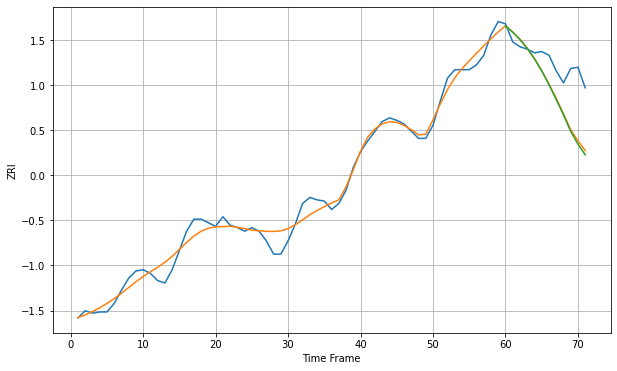

Wall time: 7.29 s
12209 7.407109761432687 30.45884204103658 31.80837487370328 [1193.3646464  1188.17584414 1182.05746496 1174.75204227 1166.07223002
 1155.99384436 1144.62631518 1132.21038225 1119.56337665 1105.77803885
 1095.16558522 1086.3840658 ]

Got an mse at 0.0099 in round 231 and stopped training

71 71 12


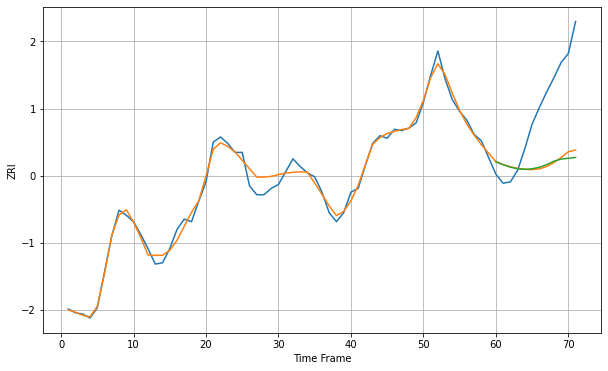

Wall time: 9.75 s
12210 5.186677815476572 52.702150489981435 54.02575487243051 [1050.75247987 1048.39779474 1046.49343097 1045.24619212 1044.79334943
 1045.19155138 1046.42694876 1048.43591531 1051.12273573 1052.80966091
 1053.37670806 1054.06846422]

Got an mse at 0.0099 in round 121 and stopped training

71 71 12


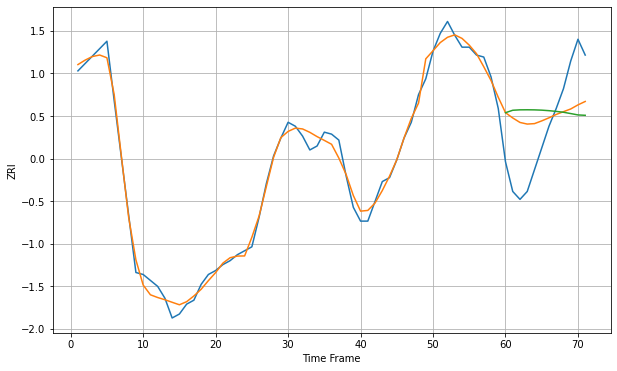

Wall time: 7.8 s
12303 4.25926266302093 25.517204541664853 29.79798262954643 [1017.85003535 1019.08207528 1019.29528033 1019.32302298 1019.27552875
 1019.13362275 1018.8725024  1018.49968287 1018.06908481 1017.40834537
 1016.7172544  1016.52772472]

Got an mse at 0.0099 in round 148 and stopped training

71 71 12


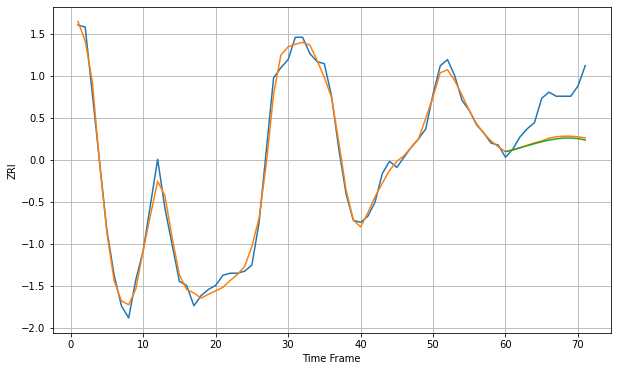

Wall time: 8.15 s
12304 4.107743301103877 18.707301276767677 19.38683960980732 [1018.80023281 1019.63036639 1020.64759144 1021.67897637 1022.68481481
 1023.61960374 1024.42761133 1025.04640347 1025.41277125 1025.46928923
 1025.1697135  1024.48224982]

Got an mse at 0.0097 in round 64 and stopped training

71 71 12


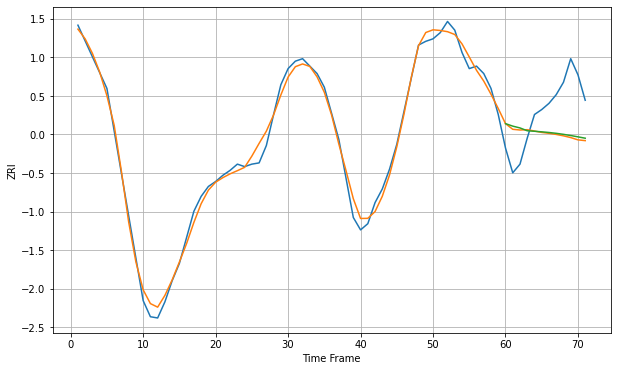

Wall time: 6.56 s
12306 5.985596320040283 34.48124348817198 33.85210540874775 [1056.64920404 1054.6404739  1053.1776522  1050.90949248 1050.49395375
 1050.03990059 1049.50885711 1048.841906   1048.02125005 1047.06192044
 1046.00238645 1044.89795881]

Got an mse at 0.0099 in round 215 and stopped training

71 71 12


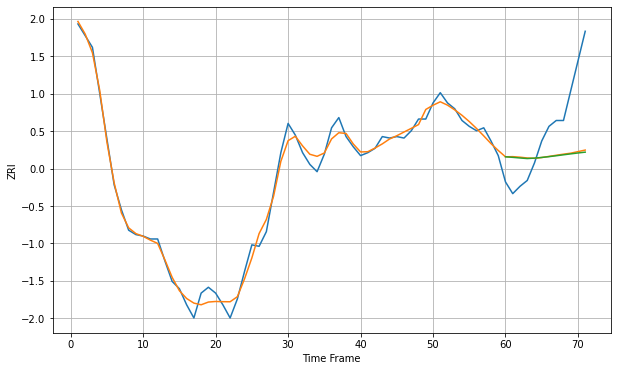

Wall time: 9.51 s
12307 5.073603234184598 35.91221403841453 36.3454737387714 [953.18057546 952.81136046 952.38197785 951.98805476 952.27792321
 952.73615699 953.28777943 953.90269273 954.54569895 955.18433881
 955.79499204 956.36368699]

Got an mse at 0.0100 in round 357 and stopped training

71 71 12


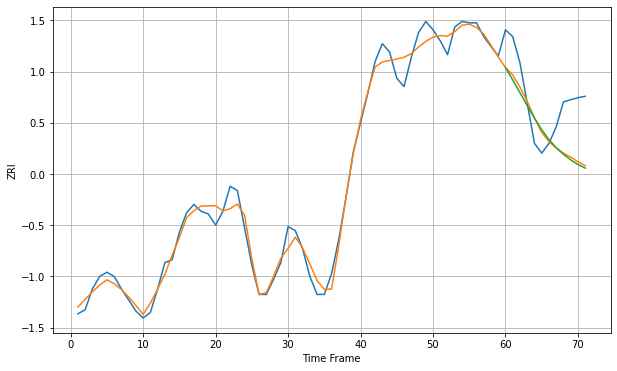

Wall time: 12.3 s
12401 7.339195123389648 29.361986711507967 30.77461503073098 [1414.67079662 1405.79935302 1396.54495155 1387.22492301 1378.17295836
 1369.85811474 1362.74716357 1356.88563137 1352.13383136 1348.09661546
 1344.75463511 1342.17984767]

Got an mse at 0.0098 in round 29 and stopped training

71 71 12


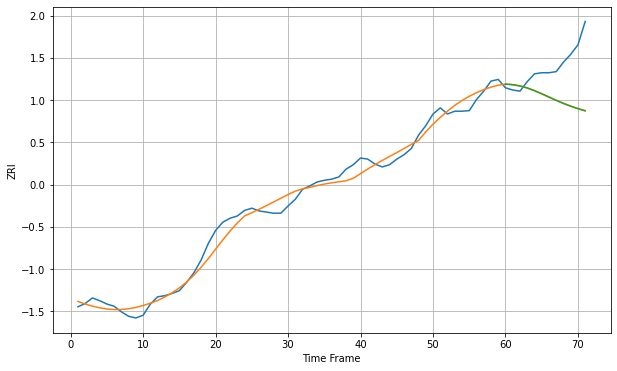

Wall time: 6.04 s
12508 14.68471401181657 70.69456839274834 70.85372411047916 [1589.65021118 1588.51029175 1586.19328494 1582.68575871 1577.88062723
 1572.31325242 1566.38252222 1560.48427032 1554.93157261 1549.90831894
 1545.46554123 1541.55796827]

Got an mse at 0.0099 in round 120 and stopped training

71 71 12


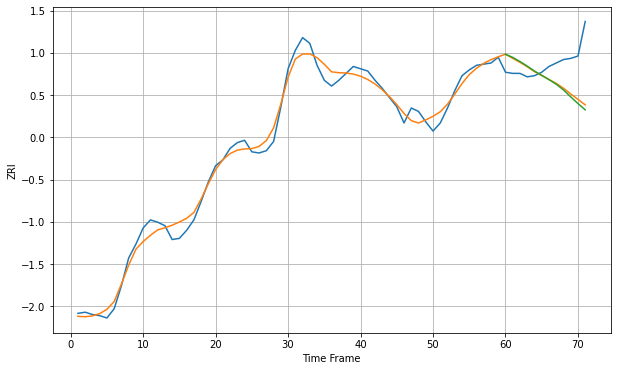

Wall time: 7.63 s
12550 7.226575220269808 27.74709530440734 29.557751007812723 [1417.61548118 1414.84193935 1411.27674726 1407.29392386 1403.01613503
 1399.32367384 1395.57708396 1391.6061109  1386.68532345 1380.61489175
 1374.86238465 1369.41635056]

Got an mse at 0.0100 in round 72 and stopped training

71 71 12


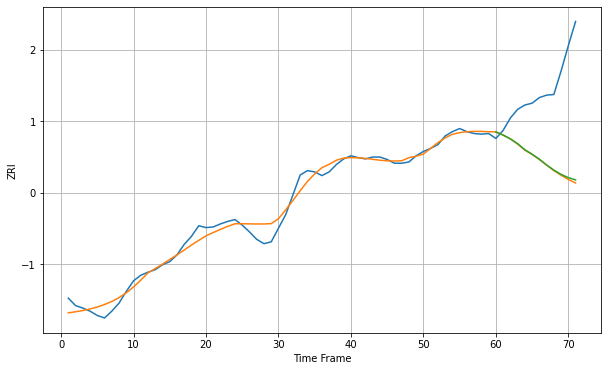

Wall time: 6.78 s
12590 11.492459348778166 128.37927132785055 126.74735585652769 [1500.5908589  1495.41013164 1489.37722044 1481.61925817 1471.86217667
 1464.59748093 1456.53284983 1447.28262462 1438.87317821 1431.94946259
 1426.72139647 1423.05108013]

Got an mse at 0.0100 in round 73 and stopped training

71 71 12


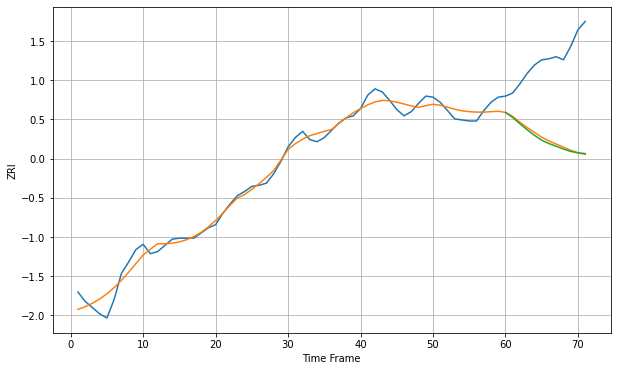

Wall time: 6.78 s
12601 7.514507654476058 79.42231227313773 80.66220699156537 [1231.30568397 1226.31740442 1220.26029115 1214.47038027 1209.12406714
 1204.45734814 1201.23951827 1198.64157703 1195.90438116 1193.66572981
 1192.252312   1191.52209496]

Got an mse at 0.0097 in round 108 and stopped training

71 71 12


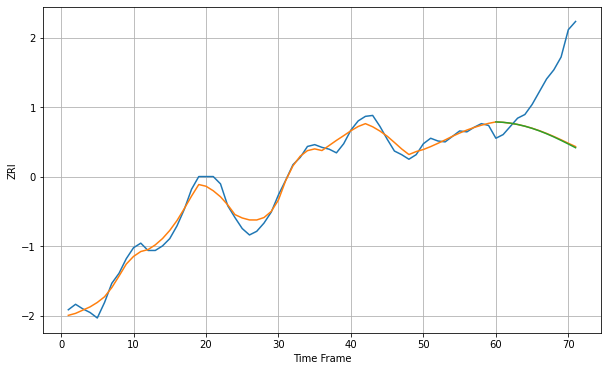

Wall time: 7.65 s
12603 7.412657016952014 67.48660942827698 67.98947726279677 [1407.91189456 1407.47653162 1406.53168499 1405.10324418 1403.2090782
 1400.86498488 1398.0939715  1394.93223444 1391.43115651 1387.65639081
 1383.68564136 1379.60596573]

Got an mse at 0.0099 in round 146 and stopped training

71 71 12


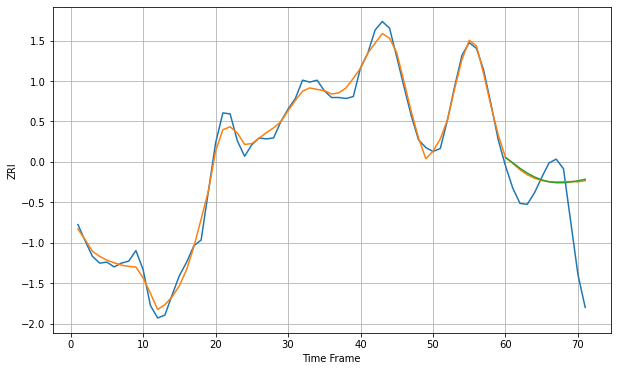

Wall time: 8.19 s
12866 8.301204470754517 52.15439495467298 52.86477940994336 [1692.7870956  1687.2067962  1681.45848643 1676.53726125 1672.49923473
 1669.43133453 1667.43356924 1666.51006788 1666.52945094 1667.27346017
 1668.51108146 1670.04729955]

Got an mse at 0.0100 in round 195 and stopped training

71 71 12


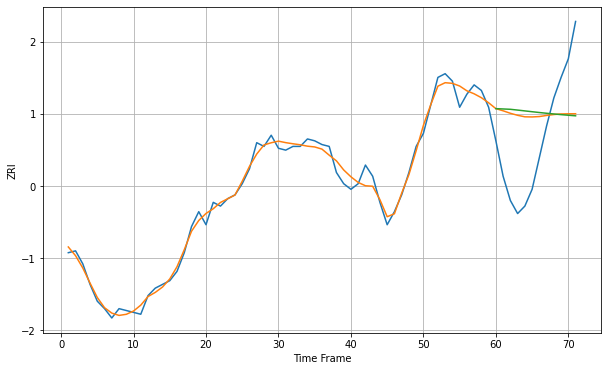

Wall time: 9.05 s
13203 3.8599244848606737 34.86269296961867 36.49592568758872 [903.24836416 903.07787527 902.90008601 902.48219743 902.03856507
 901.59950016 901.1741534  900.76993337 900.39164051 900.0405027
 899.71441075 899.40907416]

Got an mse at 0.0099 in round 209 and stopped training

71 71 12


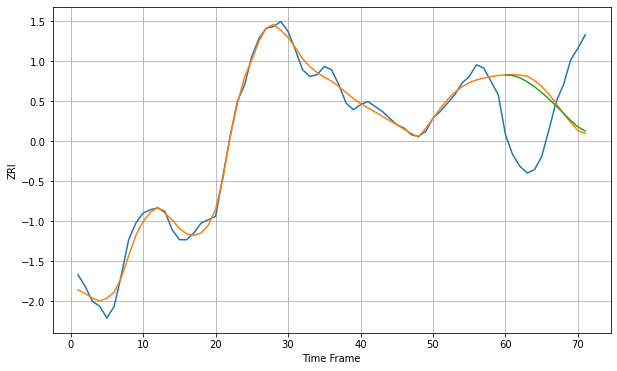

Wall time: 9.32 s
13204 4.755530351306979 43.52165324228878 41.7012640085436 [914.94752231 914.55171073 913.17949803 910.77957435 907.80650309
 904.31322099 900.42620243 896.27796373 891.96915631 887.5537358
 883.67797447 881.27292033]

Got an mse at 0.0100 in round 245 and stopped training

71 71 12


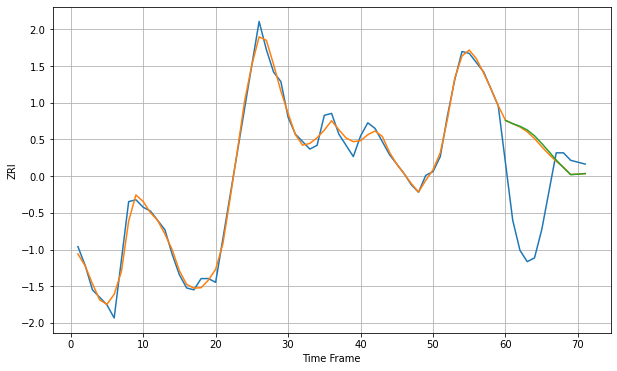

Wall time: 10.4 s
13205 3.8720270130845535 39.67414879942606 40.28704069083981 [926.29452113 924.52111974 923.14942809 921.18322483 918.0971593
 913.99440852 909.62878695 905.16427939 901.09839087 897.38376879
 897.63141354 897.91723878]

Got an mse at 0.0100 in round 186 and stopped training

71 71 12


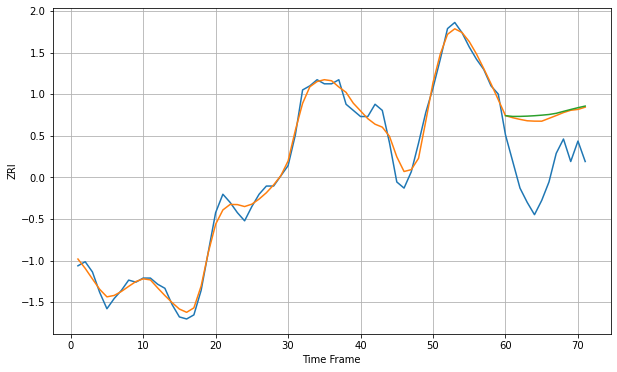

Wall time: 9.18 s
13206 4.035059193777544 28.741609127012463 30.231760038031233 [892.42996343 892.05052862 892.0715629  892.19186289 892.3948151
 892.66731271 892.99270753 893.57623051 894.52387353 895.4481086
 896.31990671 897.11793817]

Got an mse at 0.0100 in round 150 and stopped training

71 71 12


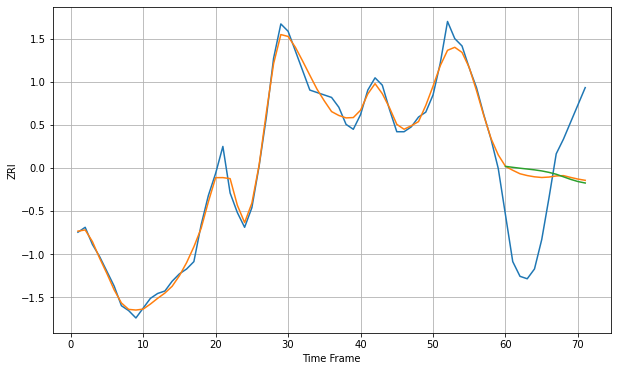

Wall time: 8.28 s
13208 3.4889189349401883 29.727922562648207 31.23587538897444 [877.86872439 877.4777193  877.10960731 876.78719934 876.44485671
 876.00853984 875.41726948 874.65092524 873.60884021 872.56066279
 871.67508096 871.07346675]

Got an mse at 0.0100 in round 211 and stopped training

71 71 12


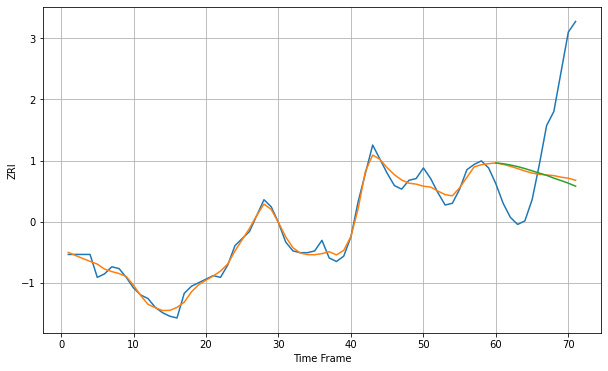

Wall time: 9.41 s
13440 3.4385887388614695 44.8624618314241 46.396808739111485 [753.84346947 753.40233707 752.69407346 751.77420682 750.64975181
 749.38287328 748.07960195 746.83056417 745.22969045 743.83237835
 742.37381108 740.68667081]

Got an mse at 0.0100 in round 231 and stopped training

71 71 12


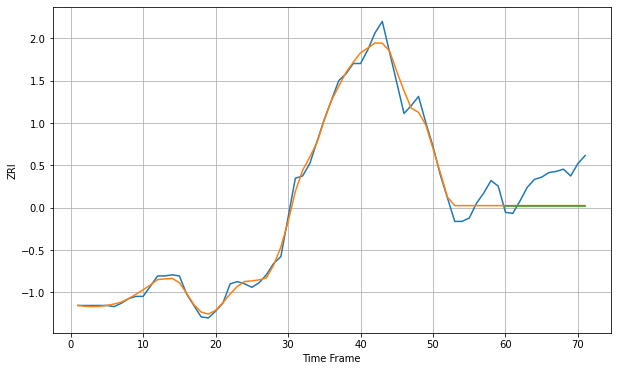

Wall time: 9.64 s
13501 7.433214747949466 26.304449115337498 26.304449115337498 [815.90911187 815.90911187 815.90911187 815.90911187 815.90911187
 815.90911187 815.90911187 815.90911187 815.90911187 815.90911187
 815.90911187 815.90911187]

Got an mse at 0.0100 in round 87 and stopped training

71 71 12


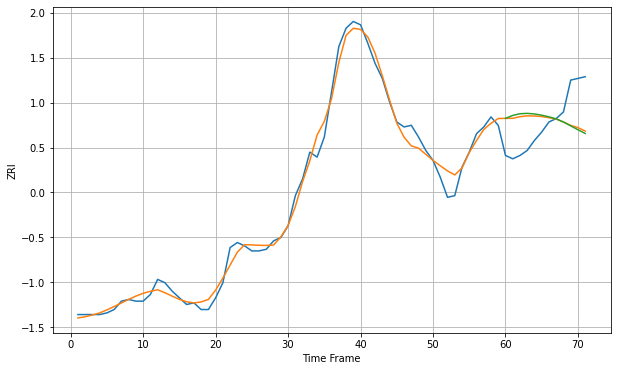

Wall time: 6.96 s
13502 5.323904442227939 20.465634564990374 21.412542860185958 [827.14906139 828.89057598 829.90251054 830.12104687 829.77399802
 829.04147231 828.04330834 826.85709668 824.95546311 822.64958298
 820.34576603 818.11210858]

Got an mse at 0.0100 in round 378 and stopped training

71 71 12


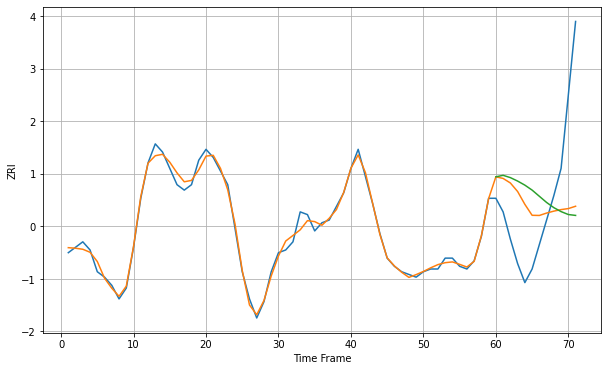

Wall time: 12.5 s
13601 1.9212703891781446 27.84207689892906 30.882725533828985 [857.89104596 858.44169814 857.59821644 856.32823297 854.83415709
 853.00864412 850.73359319 848.46600163 846.55234372 845.10045848
 844.02964033 843.70037496]
71 71 12


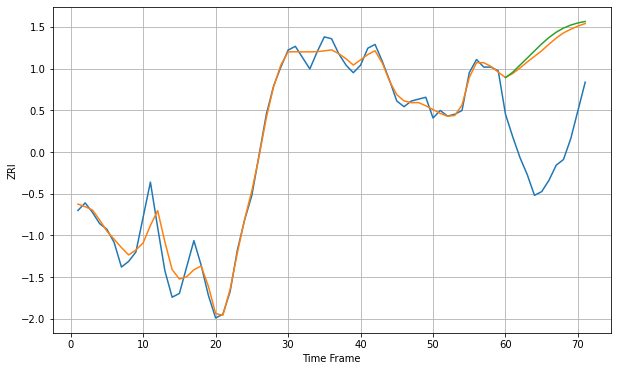

Wall time: 14.9 s
13760 5.958954456722118 56.94486042194745 59.25679319105688 [891.47730467 894.26107911 898.04918837 901.77569592 905.56356461
 909.30570453 912.68295036 915.48612067 917.65918188 919.25911996
 920.3935262  921.17571512]

Got an mse at 0.0100 in round 288 and stopped training

71 71 12


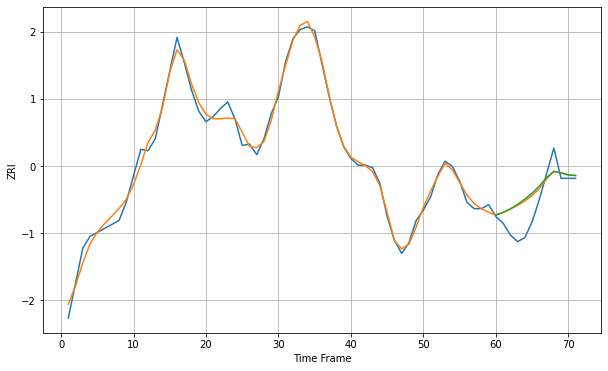

Wall time: 11 s
13903 5.046702577585288 15.269195150457238 15.923155528424308 [827.17372315 829.14060275 831.89674548 835.30230488 839.22016525
 843.73196668 849.10649732 855.6493541  860.30104617 859.10361164
 857.63150384 857.15250828]

Got an mse at 0.0099 in round 222 and stopped training

71 71 12


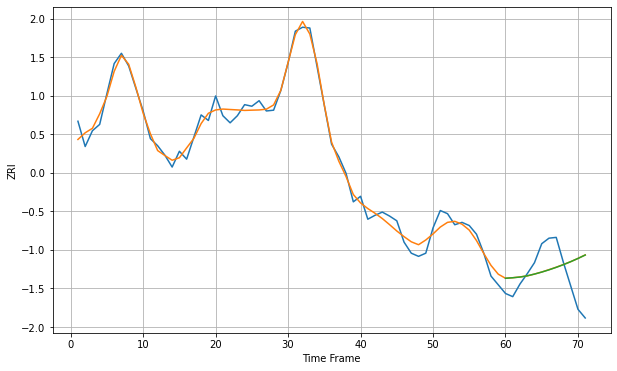

Wall time: 9.72 s
14020 9.665168615016245 37.641277943251545 37.64873140150215 [1218.26407502 1218.92078914 1219.80240052 1221.35567021 1223.5633547
 1226.08569732 1228.92111956 1232.06846718 1235.52347027 1239.27938745
 1243.32849345 1247.6637281 ]

Got an mse at 0.0100 in round 179 and stopped training

71 71 12


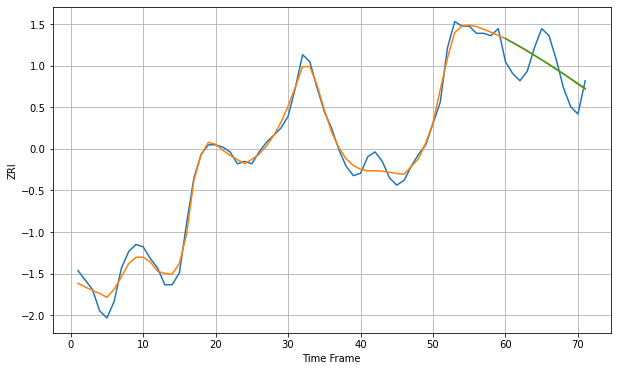

Wall time: 8.98 s
14043 3.48260723092642 10.102591895569516 10.214445867049367 [966.76038173 965.14441179 963.44604006 961.64622769 959.76148412
 957.81314854 955.82795864 953.83620081 951.86563684 949.8839772
 947.83899824 945.80914176]
71 71 12


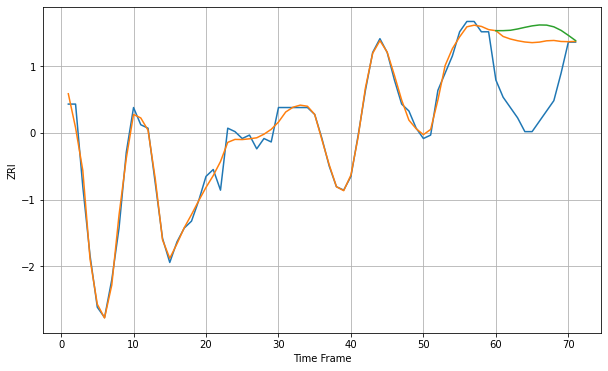

Wall time: 15 s
14150 2.2868559287922143 18.473561484609107 21.66626278608894 [898.32565474 898.32987435 898.43888199 898.81890088 899.28916198
 899.71780236 899.98330317 899.94278703 899.44328949 898.41038421
 896.96923058 895.44839426]

Got an mse at 0.0097 in round 205 and stopped training

71 71 12


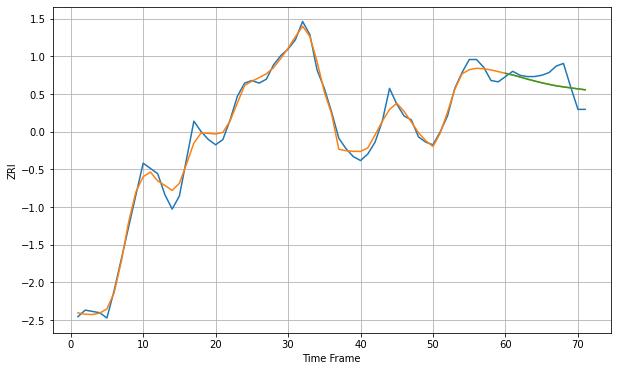

Wall time: 9.41 s
14201 5.620954358804821 9.765001142412373 9.844901690638274 [942.46426834 941.23625856 939.65718208 938.09967617 936.6204642
 935.25064382 934.0047947  932.8861536  932.06957602 931.31781113
 930.62066596 929.97166239]

Got an mse at 0.0100 in round 261 and stopped training

71 71 12


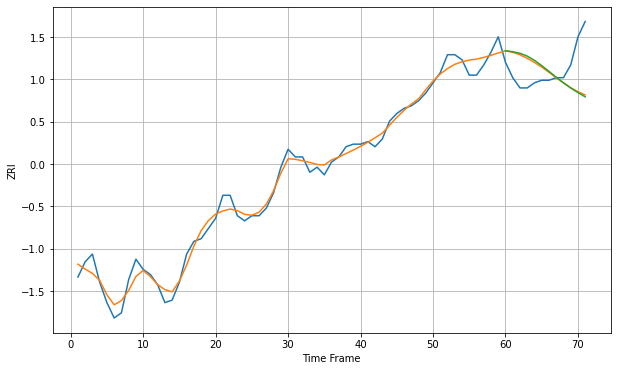

Wall time: 10.7 s
14206 3.294598272841212 12.553729957969702 12.961506921654737 [812.55496637 812.16579912 811.55616626 810.43620426 808.79209417
 806.72979978 804.46580281 802.18523543 800.00235853 797.97696401
 796.15718337 794.52465582]

Got an mse at 0.0098 in round 106 and stopped training

71 71 12


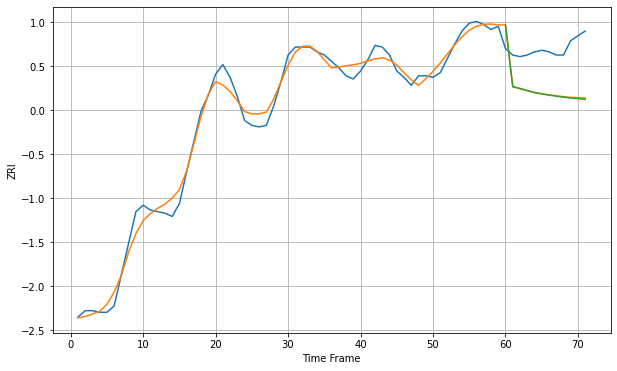

Wall time: 7.81 s
14207 5.417065957028499 28.094459656223094 28.348160217385832 [827.81248594 789.25234632 788.08095463 786.79071735 785.54109501
 784.68116046 783.92535109 783.23992122 782.63333119 782.10961881
 781.66879305 781.30737245]

Got an mse at 0.0100 in round 98 and stopped training

71 71 12


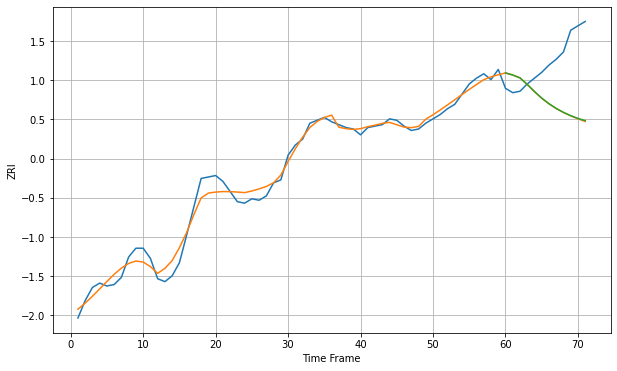

Wall time: 7.48 s
14208 5.3540135254257155 37.235342820028414 37.076017476921464 [814.59752526 813.16046431 811.20136656 806.65422122 801.74193667
 797.27210488 793.42518336 790.17630028 787.44679136 785.1679678
 783.29645582 781.777339  ]
71 71 12


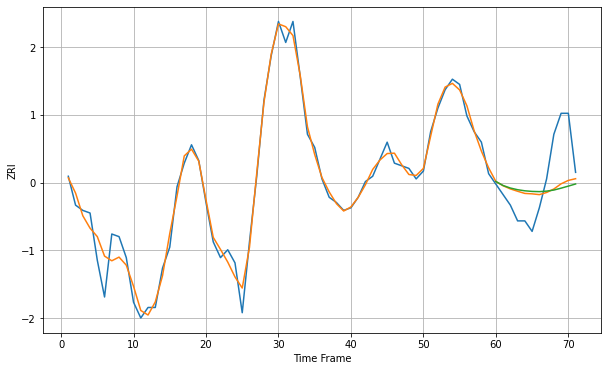

Wall time: 15.2 s
14209 4.143543368258734 14.02617603980099 14.929282412428861 [1042.00046309 1040.48499381 1039.52179809 1038.879396   1038.46549182
 1038.23226122 1038.15075365 1038.34156534 1038.75452116 1039.46895578
 1040.25624335 1041.06347931]

Got an mse at 0.0100 in round 150 and stopped training

71 71 12


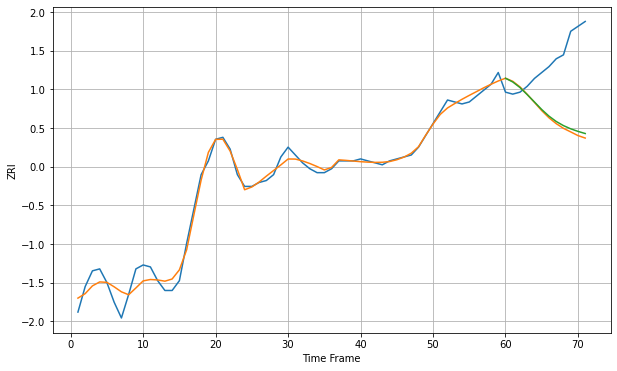

Wall time: 8.45 s
14210 3.916584882983092 32.98865106714856 31.820392902378817 [795.0879522  793.19825334 790.35461033 786.7440087  782.9708159
 779.15655143 775.78471076 773.06316724 770.95818413 769.32744643
 768.02414738 766.93387181]

Got an mse at 0.0100 in round 61 and stopped training

71 71 12


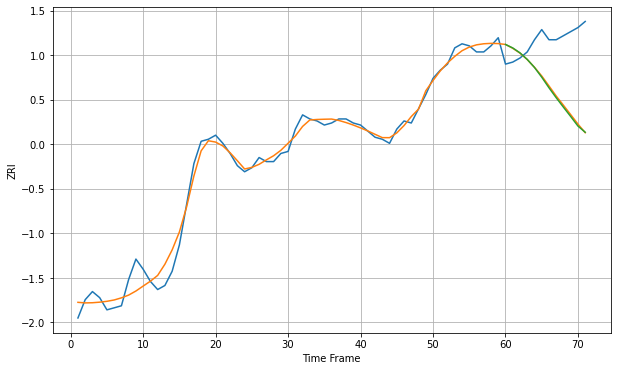

Wall time: 6.77 s
14211 4.3491857442957995 29.238259841075475 29.706764754618884 [793.67937082 791.9641048  789.5374198  786.30951096 782.3529153
 777.56539825 772.35461227 767.43938336 762.771961   758.18946112
 753.49600611 750.45052427]

Got an mse at 0.0100 in round 297 and stopped training

71 71 12


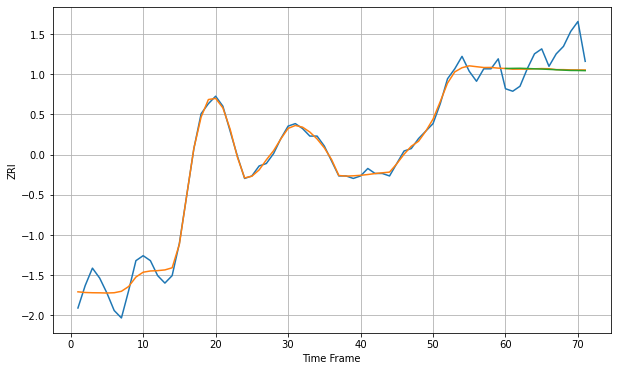

Wall time: 11.5 s
14212 3.221127164891834 9.338270228833506 9.502755454536294 [782.12865446 782.18063002 782.21953722 782.11438472 782.00745621
 781.89500874 781.77032915 781.62902577 781.46911611 781.33817508
 781.31909407 781.2632756 ]

Got an mse at 0.0100 in round 117 and stopped training

71 71 12


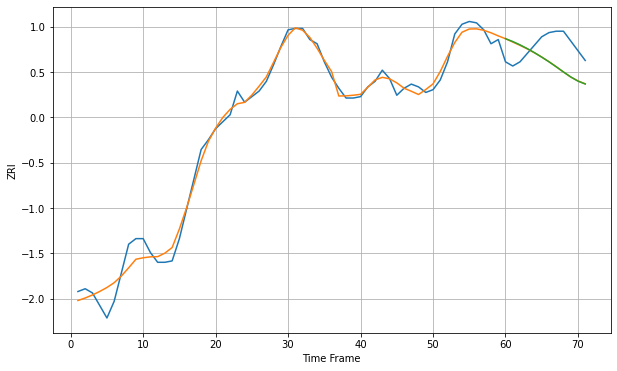

Wall time: 7.99 s
14213 6.490512607155176 19.00768362620389 19.09731350808825 [881.62931323 879.59383221 877.20974326 874.52081365 871.55795888
 868.37501322 865.00285165 861.43129475 857.7119034  854.13690256
 851.16364523 849.05084453]

Got an mse at 0.0100 in round 88 and stopped training

71 71 12


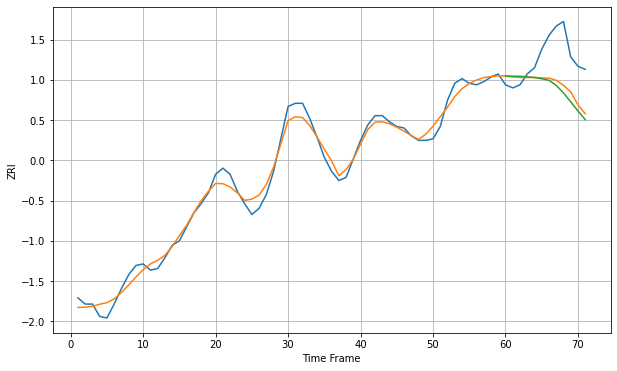

Wall time: 7.48 s
14214 5.127090129878579 22.648549305986485 25.374702089110183 [925.6619594  925.5996605  925.47317876 925.16627372 924.657004
 923.91496387 922.9075059  919.65905794 914.75831645 908.92228689
 903.06304216 897.42166775]

Got an mse at 0.0100 in round 102 and stopped training

71 71 12


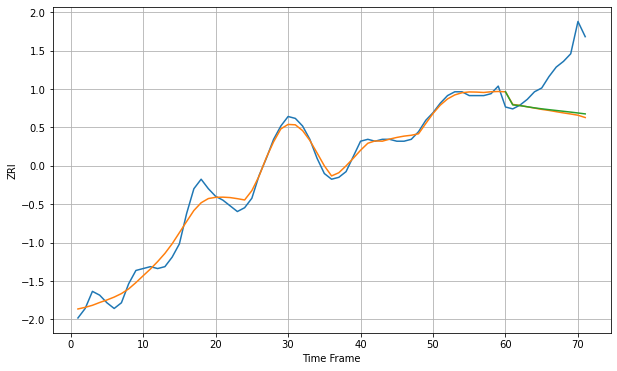

Wall time: 7.43 s
14215 4.009684141891707 24.38471408566846 23.628635032843572 [781.98628898 775.09625331 774.73074515 774.12852583 773.55022159
 773.03817373 772.59528029 772.16806461 771.74387777 771.3091762
 770.85242887 770.36465007]

Got an mse at 0.0099 in round 134 and stopped training

71 71 12


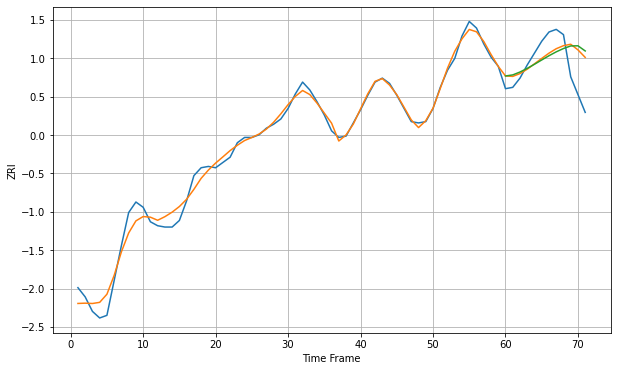

Wall time: 8.12 s
14216 5.746187389351961 19.292401509630732 21.024738073397813 [1035.63979091 1036.44586391 1038.63812694 1041.40521551 1044.52211623
 1047.78987755 1050.99777273 1053.94557997 1056.46528871 1058.42916795
 1058.54053243 1054.62014234]

Got an mse at 0.0099 in round 176 and stopped training

71 71 12


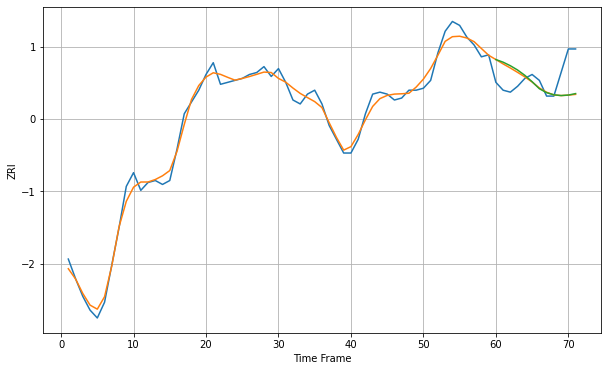

Wall time: 8.99 s
14217 3.6314425900315848 12.16192187481082 12.349783039583714 [895.59934589 894.267857   892.45481715 890.26056655 887.56040346
 884.32599868 880.75702246 878.73574069 877.65113657 877.26792997
 877.52148796 878.27192731]

Got an mse at 0.0100 in round 315 and stopped training

71 71 12


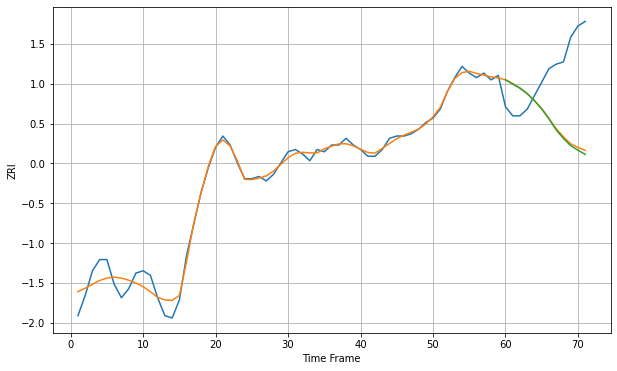

Wall time: 11.3 s
14218 3.536542032173152 31.089913796114672 31.761155600689456 [827.02519038 825.12463593 823.28291221 820.842878   817.75156885
 814.10550684 809.58853013 804.73231602 800.89477868 797.71909016
 795.68270425 793.8068813 ]

Got an mse at 0.0100 in round 421 and stopped training

71 71 12


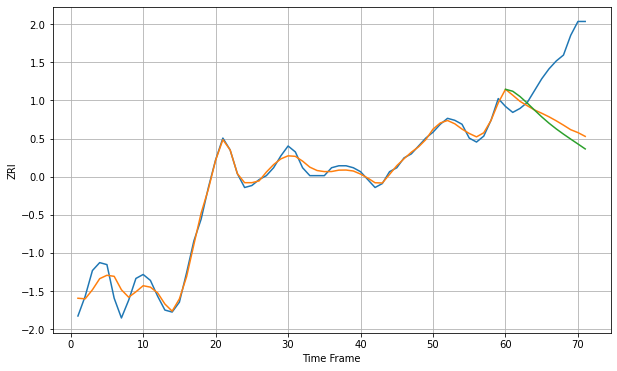

Wall time: 13.6 s
14220 3.8445166758505938 31.81416235451764 35.33468795107991 [816.69135661 815.70095784 813.03269521 809.71364878 806.18390371
 802.74116013 799.55605879 796.66361747 794.00581966 791.48795657
 789.01679414 786.52074926]
71 71 12


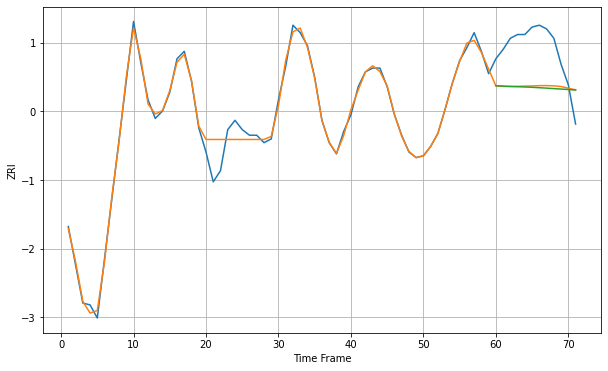

Wall time: 15.1 s
14221 4.4909919483881495 24.003776082611957 24.594129567238816 [1131.49166313 1131.34107947 1131.16064618 1131.01735148 1130.86757418
 1130.68860894 1130.47776251 1130.24443571 1130.00057198 1129.75367656
 1129.50258177 1129.23463053]

Got an mse at 0.0099 in round 159 and stopped training

71 71 12


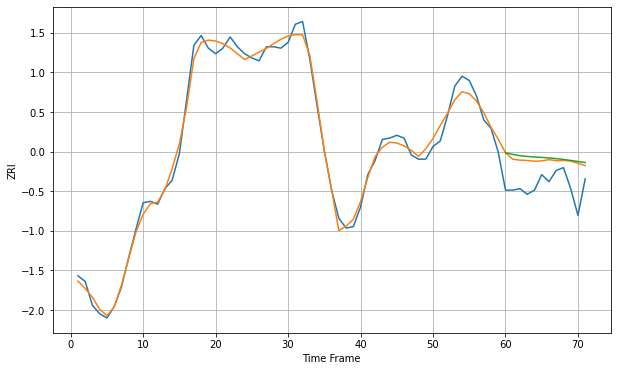

Wall time: 8.56 s
14222 5.531866677159255 20.143283639231843 21.85966847257932 [1084.55855544 1083.3984181  1082.50011073 1081.93613617 1081.57586004
 1081.26505607 1080.88819802 1080.39702735 1079.79057889 1079.09743901
 1078.35957423 1077.62003666]

Got an mse at 0.0100 in round 166 and stopped training

71 71 12


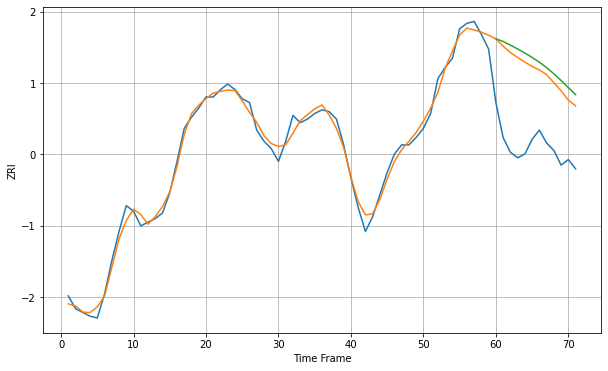

Wall time: 8.55 s
14224 3.8362880573963176 42.092387269585856 46.36757964569773 [983.59614268 982.14462071 980.15374462 978.05943998 975.85322676
 973.47949364 970.86359482 967.92450208 964.6086061  960.94904776
 957.09985496 953.26373308]

Got an mse at 0.0100 in round 165 and stopped training

71 71 12


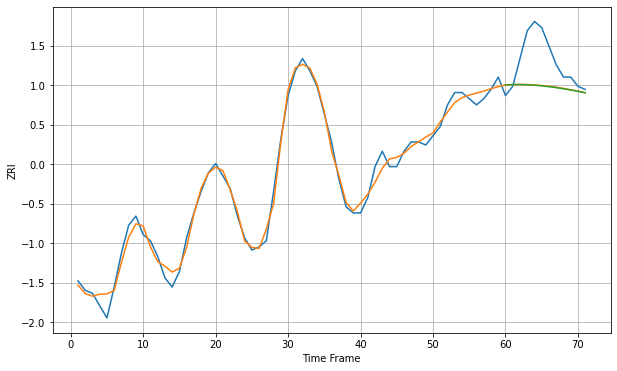

Wall time: 8.5 s
14225 2.5419948775960957 10.859162630570179 10.925536171888401 [862.4564245  862.56642048 862.58528947 862.5148121  862.36757709
 862.15607714 861.88969136 861.57420279 861.21321949 860.80989205
 860.36793342 859.89188324]
71 71 12


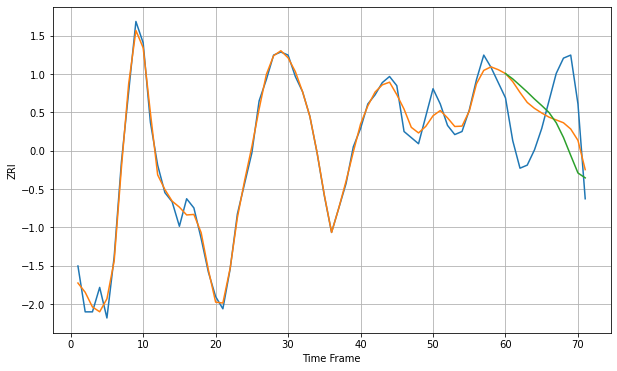

Wall time: 15.2 s
14228 3.126664176912124 16.342877979439955 19.77047039686186 [1100.95605241 1099.20058229 1097.08013826 1094.92363169 1092.62774966
 1090.48986185 1088.23048658 1084.86252163 1080.05528542 1074.18204739
 1068.43088002 1066.83393937]

Got an mse at 0.0099 in round 181 and stopped training

71 71 12


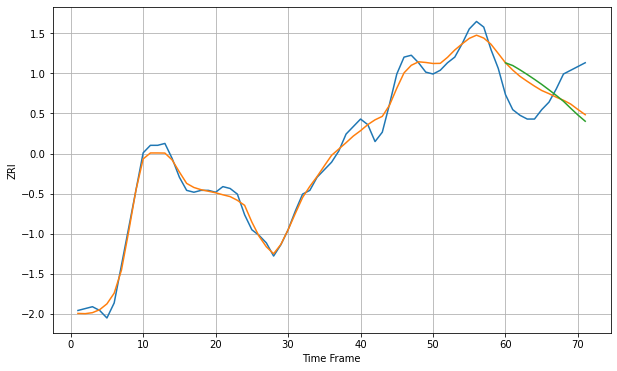

Wall time: 9.42 s
14301 4.2472822606723675 17.866105106906232 20.27909274504327 [656.94698479 655.51540336 653.2167848  650.74005349 648.15771239
 645.45644062 642.57682217 639.61107874 636.47325766 632.74076212
 629.13523529 625.8428346 ]

Got an mse at 0.0100 in round 167 and stopped training

71 71 12


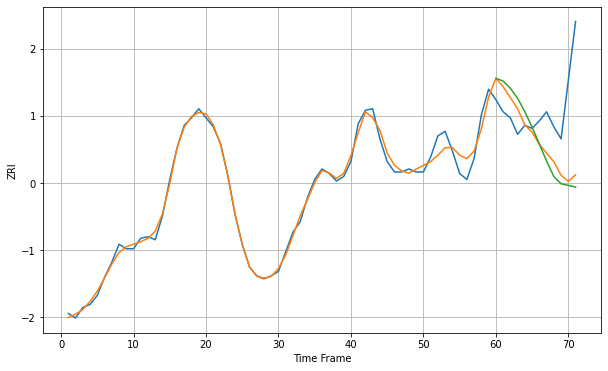

Wall time: 8.94 s
14607 4.424297279072169 38.70349743730866 42.760247787620145 [1093.21606923 1091.38822141 1086.63021836 1079.95521853 1071.00444319
 1060.77003673 1049.59549193 1038.20561463 1027.95649543 1023.15107336
 1022.07384621 1021.01204979]

Got an mse at 0.0099 in round 217 and stopped training

71 71 12


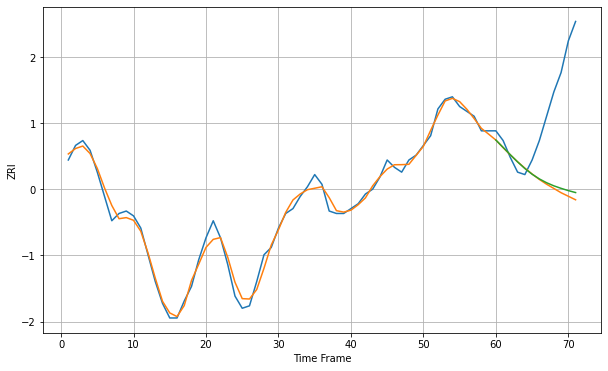

Wall time: 9.7 s
14609 2.6755311637023036 34.89730896804024 33.657062545184765 [828.20075309 825.18638959 822.1555732  819.2130178  816.49577257
 814.1479183  812.21603507 810.64740674 809.37019972 808.33429624
 807.4022349  806.60255926]

Got an mse at 0.0100 in round 219 and stopped training

71 71 12


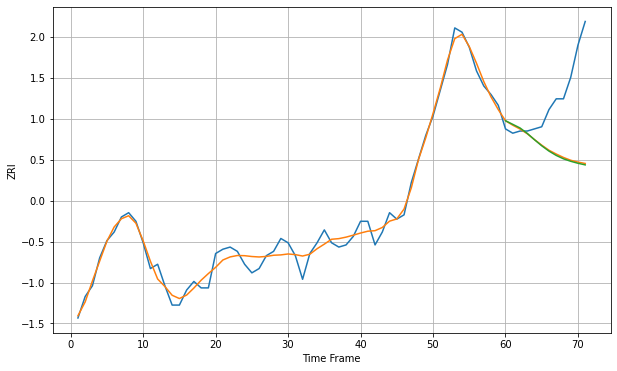

Wall time: 9.84 s
14611 3.804825481095057 29.880254066483044 30.26569630422119 [871.78359295 870.12920725 868.44110601 865.92111397 862.95250704
 860.13615993 857.66910291 855.66005795 854.07991393 852.92270312
 852.00368478 851.25526415]

Got an mse at 0.0100 in round 150 and stopped training

71 71 12


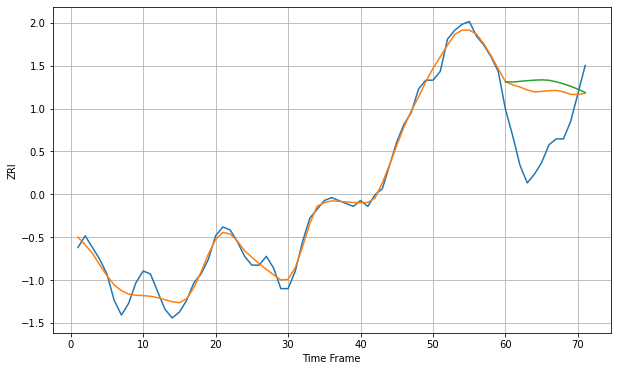

Wall time: 8.39 s
14613 2.9066336155641754 19.407108116089482 21.82437425316589 [769.47151583 769.37927465 769.60297289 769.83284894 770.01405223
 770.11099307 769.96339363 769.4471544  768.75879727 767.91756999
 766.92382576 765.77954489]

Got an mse at 0.0099 in round 126 and stopped training

71 71 12


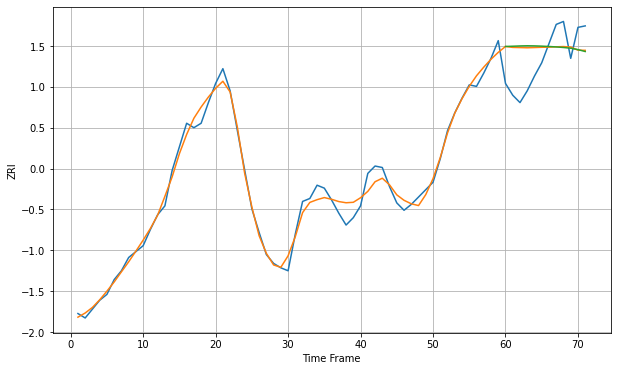

Wall time: 8.18 s
14620 5.499909475733225 21.410383010357084 21.99733141031324 [1100.05394331 1100.212819   1100.40507523 1100.51787092 1100.4414934
 1100.2678471  1100.0366896  1099.73771231 1099.35357712 1098.86544604
 1097.91817588 1096.62454756]

Got an mse at 0.0099 in round 197 and stopped training

71 71 12


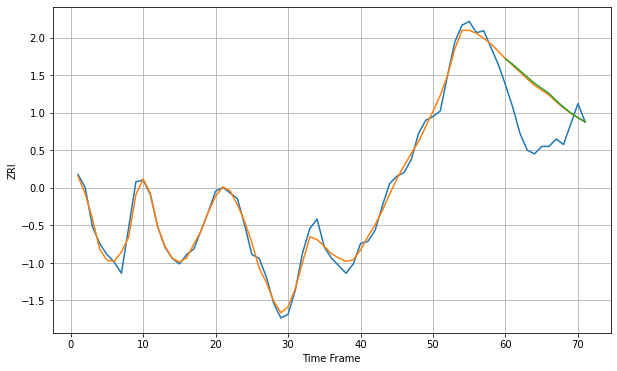

Wall time: 9.13 s
14621 3.988039302850124 24.390058783643102 25.050770949996036 [833.00736821 830.02221946 826.61888013 823.21941302 819.90608593
 817.11993275 814.46101617 810.5743306  807.07689996 804.02523161
 801.3965839  799.1474417 ]

Got an mse at 0.0100 in round 78 and stopped training

71 71 12


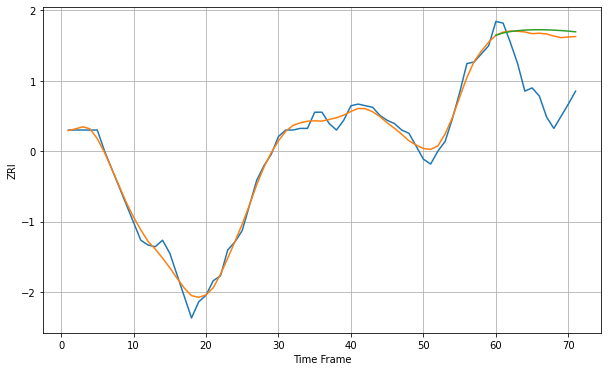

Wall time: 7.4 s
14701 4.3095429616424 36.0404629995829 38.38783527317373 [678.49689418 679.93507352 680.75595104 681.31155717 681.66491699
 681.85097139 681.89608369 681.82143563 681.64429359 681.37850787
 681.03470633 680.62043095]

Got an mse at 0.0100 in round 285 and stopped training

71 71 12


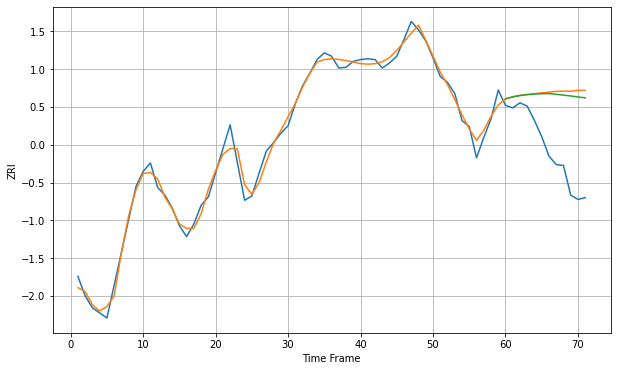

Wall time: 11 s
14850 8.875951097693763 77.84828082220763 73.8683590387106 [1552.62872218 1554.98959488 1556.54042368 1557.61359911 1558.31564436
 1558.7212116  1558.88749104 1557.99190866 1557.05454845 1556.02651429
 1554.93000004 1553.79456954]

Got an mse at 0.0097 in round 43 and stopped training

71 71 12


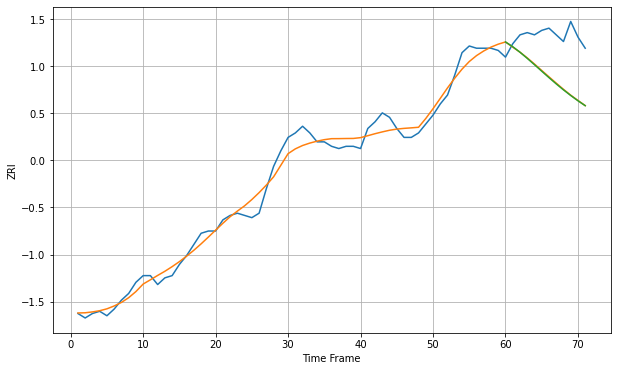

Wall time: 6.33 s
15202 4.120750621857711 19.796454029989583 19.971498187718144 [839.80865754 837.68460994 835.19285941 832.45701058 829.60389223
 826.69839791 823.81010363 821.00218573 818.32140733 815.79441979
 813.42959924 811.22192118]

Got an mse at 0.0099 in round 134 and stopped training

71 71 12


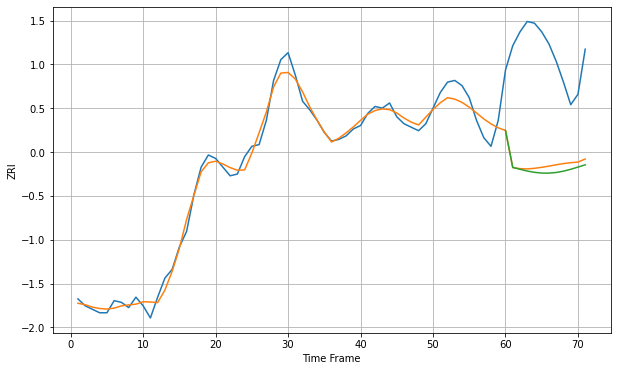

Wall time: 8.11 s
15206 4.979306230121177 64.60408244646689 66.94136620823672 [1059.14191507 1037.83214505 1036.75787804 1035.74240892 1034.98669882
 1034.56540904 1034.53109597 1034.90560261 1035.6686503  1036.74696681
 1038.01508403 1039.31837502]

Got an mse at 0.0100 in round 162 and stopped training

71 71 12


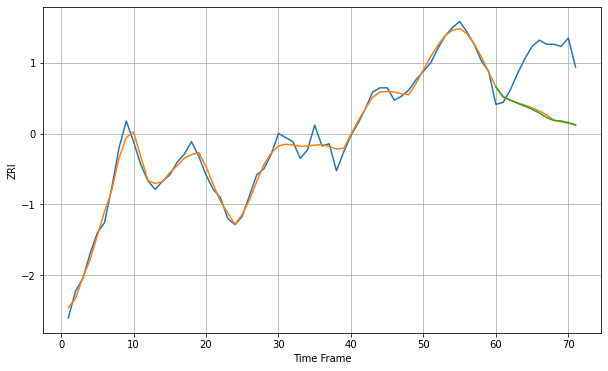

Wall time: 8.66 s
15210 3.3898329809982757 27.5982200988889 27.87142314944614 [870.42348573 865.81518118 864.09279932 862.5631178  861.16808025
 859.65185489 857.84249504 855.67558192 854.22088321 854.00982158
 853.21468668 852.20070323]

Got an mse at 0.0097 in round 93 and stopped training

71 71 12


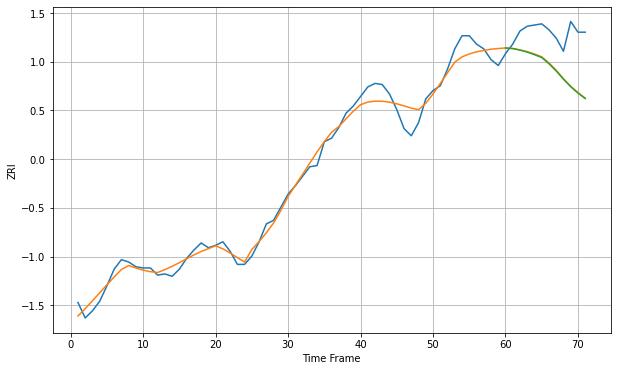

Wall time: 7.44 s
15212 7.999702711423032 32.610600100636645 32.94413400414014 [967.74004542 967.32211605 965.99513946 964.25217179 962.12639236
 959.70431046 954.47835863 948.42295875 941.52592313 935.22597542
 929.86457203 925.32868379]

Got an mse at 0.0100 in round 170 and stopped training

71 71 12


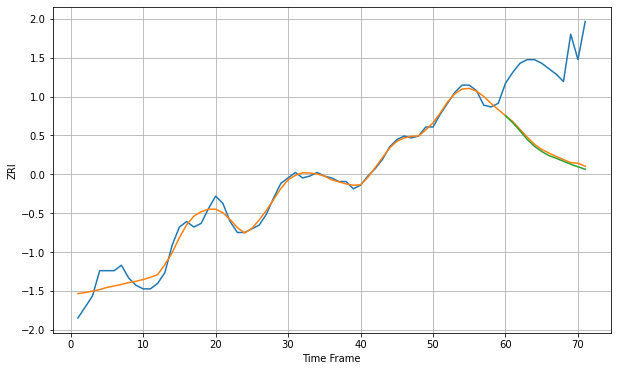

Wall time: 8.92 s
15216 4.2537809283313806 49.30631386245699 50.43152932247989 [894.19870263 890.33612164 885.85233456 881.15461183 877.36000779
 874.51677483 872.2415665  870.79117307 869.13005095 867.54780705
 866.0866517  864.76921902]

Got an mse at 0.0100 in round 492 and stopped training

71 71 12


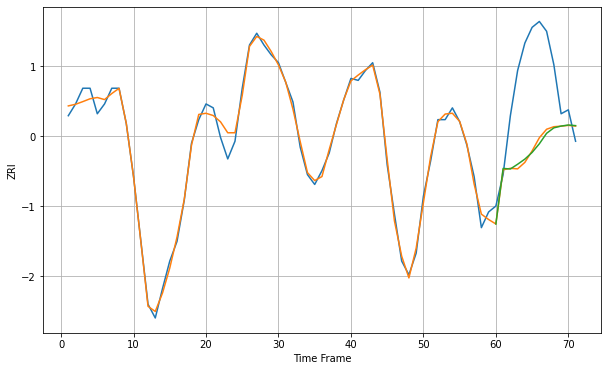

Wall time: 15 s
15217 3.545262570705281 38.858813385997784 39.19415062651703 [1174.86891002 1203.15614195 1202.87960852 1205.2854915  1207.89800353
 1211.29795514 1215.71174462 1221.04188355 1223.81781054 1224.72610986
 1225.26741243 1224.95815759]

Got an mse at 0.0099 in round 140 and stopped training

71 71 12


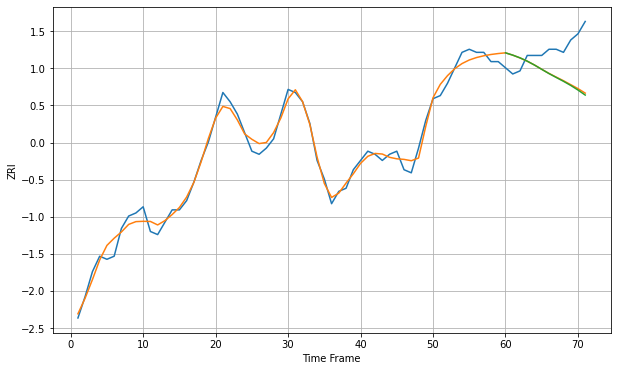

Wall time: 8.01 s
15221 2.375724696305874 10.80023263129913 11.030181594009262 [902.84141466 902.10274481 901.21648827 900.15150472 898.89041499
 897.4991008  896.13315941 894.86916249 893.63013553 892.29181201
 890.80582486 889.17228035]
71 71 12


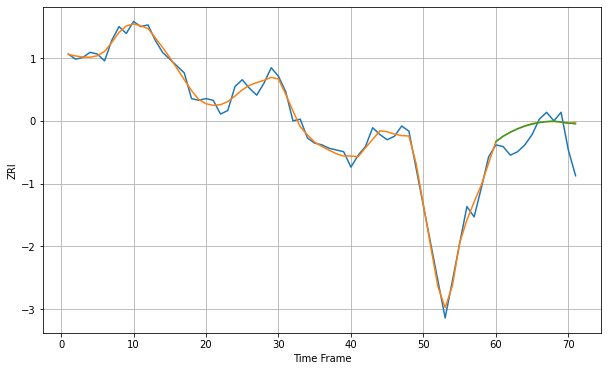

Wall time: 14.9 s
16365 3.724002373645731 12.39546131476502 12.192782362210911 [857.94398532 861.03508668 863.42658116 865.38012765 866.92682438
 868.10693865 868.97866125 869.60987267 869.91686628 869.33784444
 868.78724554 868.22137556]

Got an mse at 0.0099 in round 130 and stopped training

71 71 12


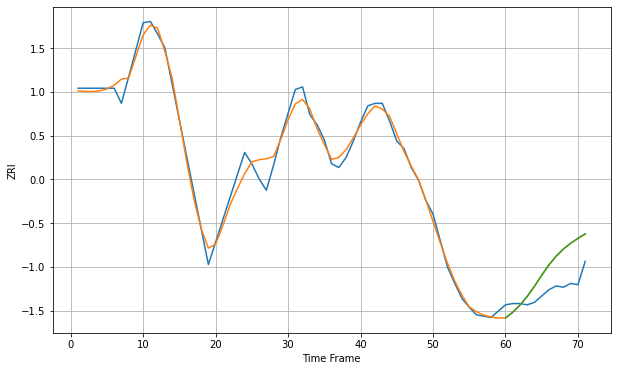

Wall time: 7.85 s
16502 6.88555979397402 21.128224728122152 21.1279714446253 [636.60692889 641.04626185 646.76780076 653.70134282 661.78959693
 670.45975084 678.69404459 685.69817379 691.33295599 695.90316087
 699.803838   703.35220839]

Got an mse at 0.0099 in round 135 and stopped training

71 71 12


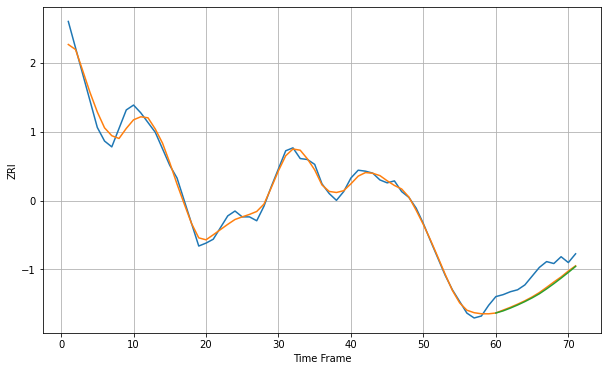

Wall time: 8.03 s
16503 7.003182902593656 18.550924334676814 19.560804169129547 [589.12692742 591.29591902 594.16693049 597.34865926 600.84058066
 604.65787641 608.89839357 613.93549295 619.31093324 624.97930536
 630.89817452 637.0103125 ]

Got an mse at 0.0100 in round 240 and stopped training

71 71 12


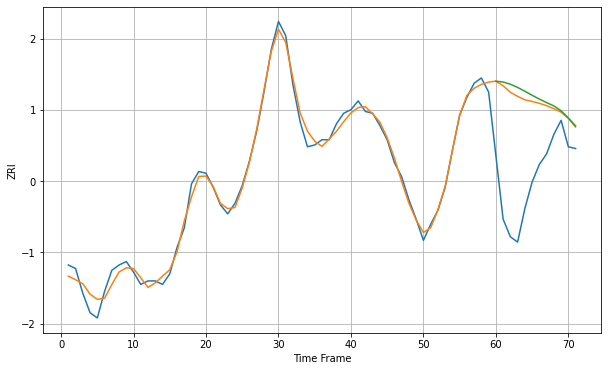

Wall time: 10 s
17013 3.998801439114104 49.566226854731305 52.23405552955985 [1031.18010067 1030.69296759 1029.45041166 1027.62411416 1025.46734744
 1023.1960514  1021.02310308 1019.03153877 1017.16636303 1014.42091988
 1010.32550172 1005.83673218]

Got an mse at 0.0099 in round 77 and stopped training

71 71 12


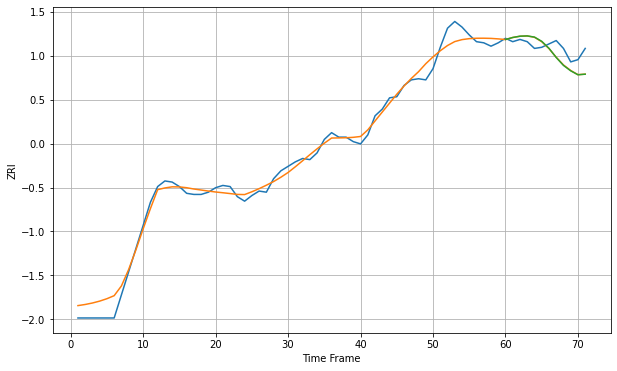

Wall time: 7.05 s
17022 7.391332131136504 10.76049903017127 10.885311199601318 [887.91929746 889.72599861 890.89843796 891.14733655 890.08302788
 886.32907702 880.09624226 871.93290713 864.87644784 860.05221259
 856.53366712 857.05705777]

Got an mse at 0.0100 in round 351 and stopped training

71 71 12


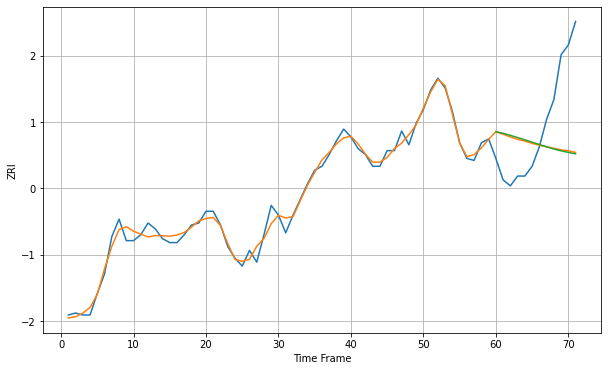

Wall time: 12.2 s
17401 3.3698768718102996 32.58357554393434 33.08523703024697 [823.6770502  822.8478947  821.79225098 820.66785584 819.50142416
 818.31462159 817.12754882 815.95827051 814.82222803 813.87668388
 813.10132739 812.36518953]

Got an mse at 0.0099 in round 139 and stopped training

71 71 12


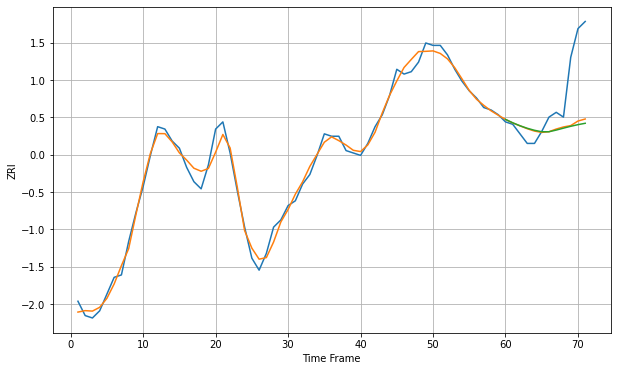

Wall time: 8.49 s
17404 3.0950532278283465 18.601541701220885 19.266063402945484 [858.04048284 856.61559879 855.38180821 854.33159096 853.49026272
 852.88075526 852.88238283 853.57581048 854.38420312 855.16205192
 855.84521353 856.41894305]

Got an mse at 0.0100 in round 128 and stopped training

71 71 12


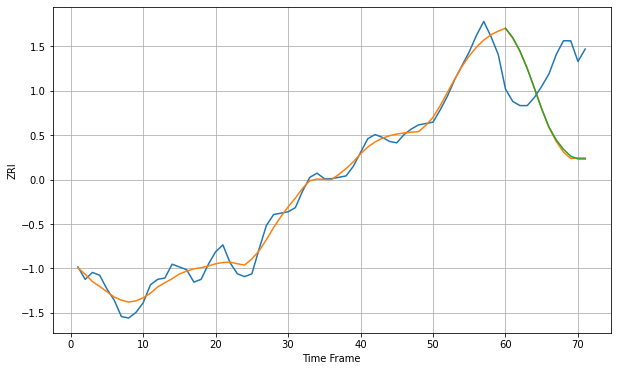

Wall time: 7.92 s
17512 6.419264071790948 55.55535572611455 55.168754186898724 [1056.04978919 1049.30964533 1039.50594283 1026.89711483 1012.30914748
  997.51347185  984.43913767  975.16915409  968.34512901  963.32497247
  961.32611736  961.31653518]

Got an mse at 0.0100 in round 202 and stopped training

71 71 12


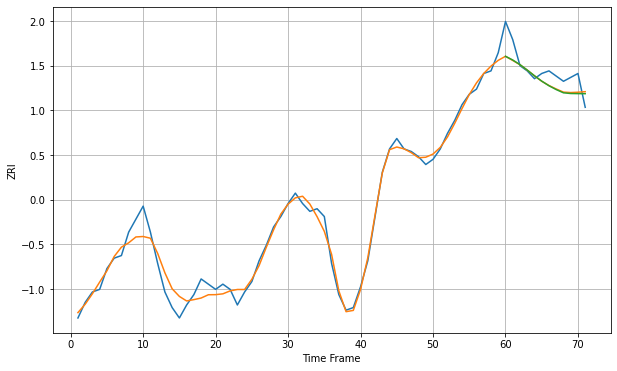

Wall time: 9.24 s
17522 3.4047005715922722 6.118349157714858 6.162849854632264 [856.60521776 855.18325202 853.39369746 851.30379636 849.10877765
 847.0535332  845.28299023 843.80802668 842.56517594 842.30036896
 842.25568706 842.23166084]

Got an mse at 0.0099 in round 40 and stopped training

71 71 12


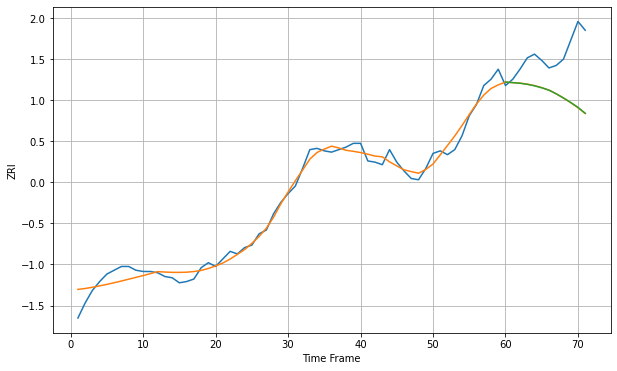

Wall time: 6.12 s
17543 6.455914196162249 35.377274568389346 35.30334670306396 [1107.75623676 1107.34689069 1106.84495875 1105.98972283 1104.77816842
 1103.21686243 1101.31707308 1098.42262401 1095.11979845 1091.50045663
 1087.62938074 1082.93934577]

Got an mse at 0.0098 in round 54 and stopped training

71 71 12


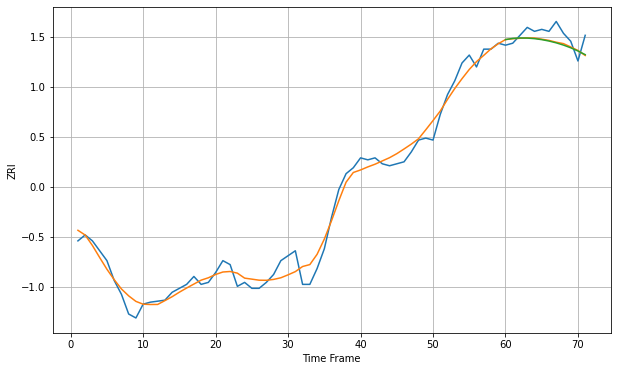

Wall time: 6.38 s
17552 4.946084112520897 5.622493208535106 5.735339538614035 [982.8367589  983.41617274 983.63722735 983.58974436 983.30718605
 982.80798518 982.09948764 981.18011684 980.0418066  978.67319677
 977.06403058 975.21095262]

Got an mse at 0.0095 in round 35 and stopped training

71 71 12


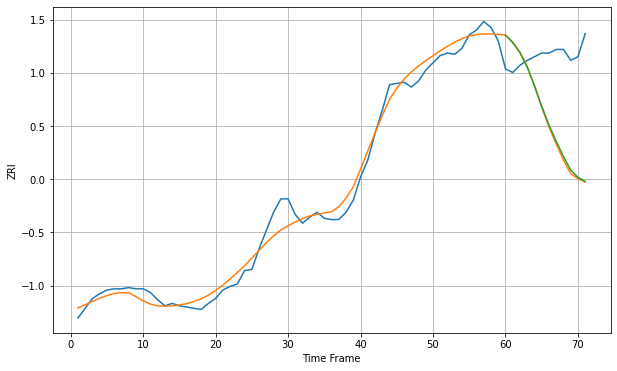

Wall time: 6.6 s
17602 8.287601312285446 68.21974665324417 66.93387055843722 [1096.79510357 1090.62872292 1082.15043709 1070.3961996  1055.08593741
 1038.22310067 1022.75591527 1009.45649113  996.88511591  985.6842783
  979.81546708  976.40878304]

Got an mse at 0.0096 in round 64 and stopped training

71 71 12


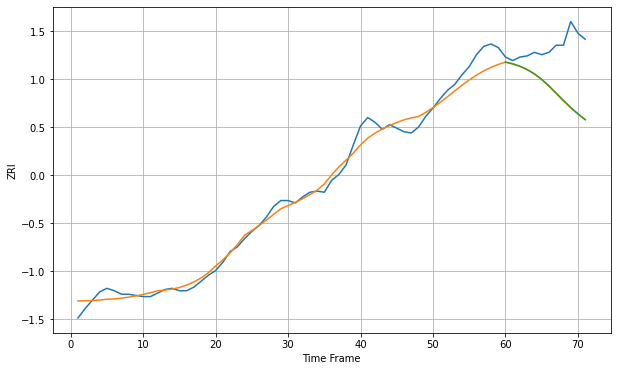

Wall time: 6.71 s
17603 7.665373173676213 41.04905085058543 40.87722782382142 [1131.69655555 1130.24946349 1128.19599623 1125.40750194 1121.76089497
 1117.15681889 1111.64073797 1105.53970252 1099.36806216 1093.52197488
 1088.14935076 1083.2482431 ]

Got an mse at 0.0100 in round 259 and stopped training

71 71 12


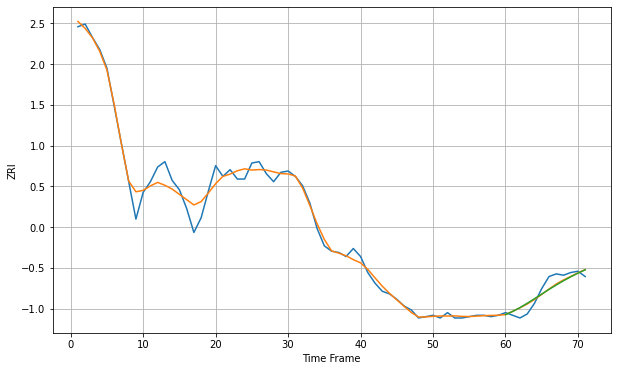

Wall time: 10.8 s
17701 6.0855525953787675 5.371041239601919 5.640360140125342 [765.52651178 767.90839258 770.79002181 773.99949116 777.41102703
 780.89675289 784.34715286 787.68014521 790.84084269 793.79942361
 796.54766654 799.09283823]

Got an mse at 0.0100 in round 37 and stopped training

71 71 12


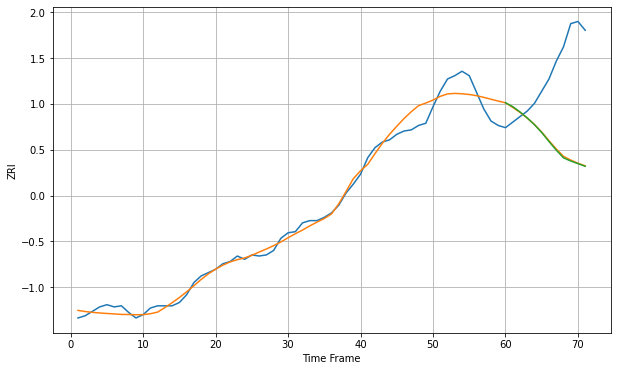

Wall time: 6.22 s
18018 8.219462239174813 75.4206763676501 75.9561379788656 [1109.48691458 1106.03588847 1101.22640033 1095.79149234 1089.65636325
 1082.64142346 1074.50429066 1066.72511274 1059.78542686 1056.87458523
 1054.49097938 1052.10722813]

Got an mse at 0.0098 in round 48 and stopped training

71 71 12


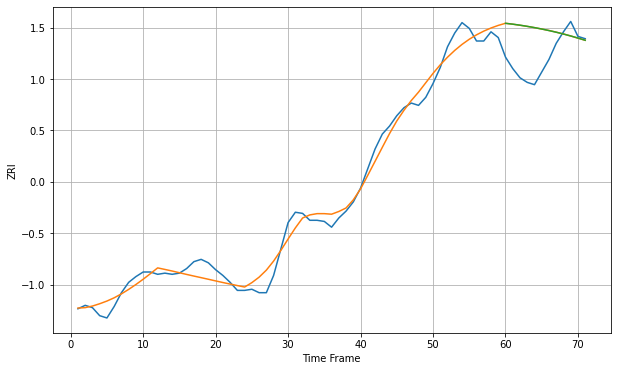

Wall time: 6.26 s
18042 8.756454831659418 31.056202253404425 31.07488331618413 [1159.40835866 1158.6592655  1157.77070937 1156.76711983 1155.65200626
 1154.4258872  1153.08737149 1151.63421844 1150.06426485 1148.3761383
 1146.56971262 1144.64630543]

Got an mse at 0.0099 in round 81 and stopped training

71 71 12


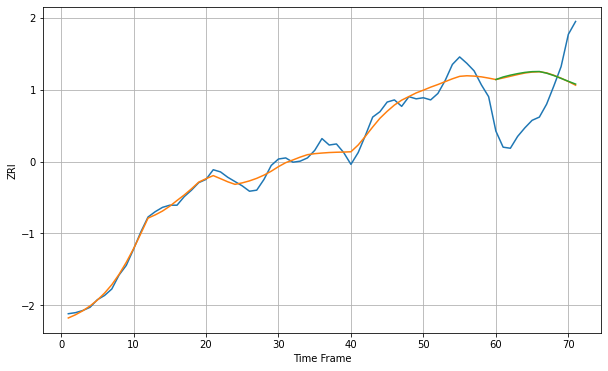

Wall time: 6.86 s
18102 6.644190525175929 47.57384500143547 47.850639880241665 [1104.94935755 1107.31851934 1109.04189525 1110.44415428 1111.59391591
 1112.28582433 1112.42819017 1110.87186339 1108.63287945 1106.02629868
 1103.30678092 1100.72178309]

Got an mse at 0.0099 in round 369 and stopped training

71 71 12


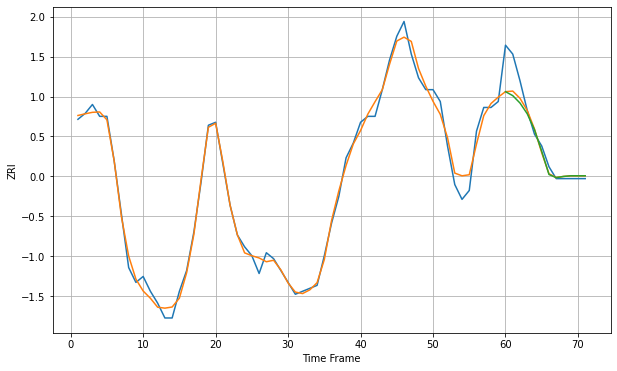

Wall time: 12.2 s
18232 2.6775067677874476 6.147750149562802 6.55382522881442 [787.32455842 785.98667118 783.49265131 779.86237689 774.50018811
 767.1930987  759.38956642 758.33786827 758.7336311  758.94903245
 758.94903245 758.94903245]

Got an mse at 0.0099 in round 121 and stopped training

71 71 12


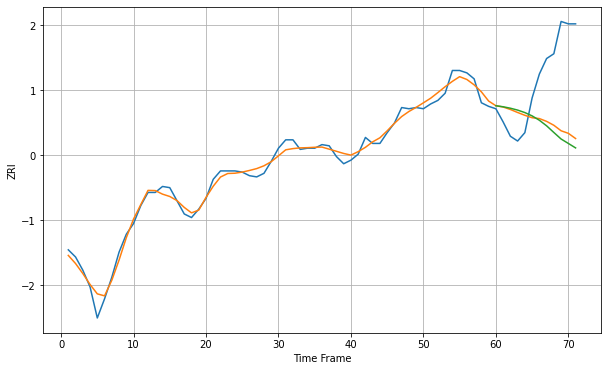

Wall time: 7.72 s
18951 5.3856112691081135 54.29923223416838 58.680121948440224 [1357.51438425 1356.65095573 1355.44595896 1353.87688916 1351.79899919
 1349.03036661 1345.38310518 1340.72687204 1335.14233407 1329.6881383
 1325.98431907 1322.24659614]

Got an mse at 0.0096 in round 33 and stopped training

71 71 12


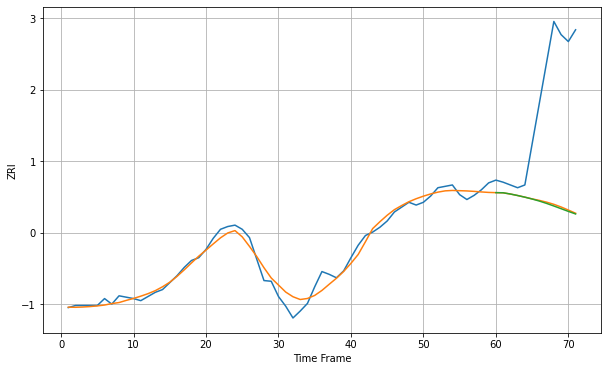

Wall time: 6.05 s
19007 9.786081989584272 165.49458671801776 166.76107266110623 [1231.90148625 1231.73500963 1229.93794913 1227.76512547 1225.35890418
 1222.73421336 1219.75662398 1216.37241192 1212.64583925 1208.74500563
 1204.86145884 1201.14482523]

Got an mse at 0.0100 in round 378 and stopped training

71 71 12


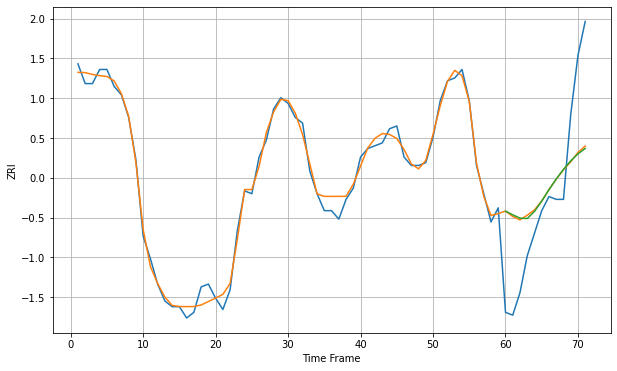

Wall time: 12.4 s
19103 2.806642222725721 24.203277084186922 24.43899452150296 [1681.83973408 1680.52795643 1679.36542405 1679.2110967  1681.71772162
 1685.40149874 1689.4373578  1693.20253    1696.62728472 1699.62912317
 1702.11053241 1704.01542219]

Got an mse at 0.0100 in round 160 and stopped training

71 71 12


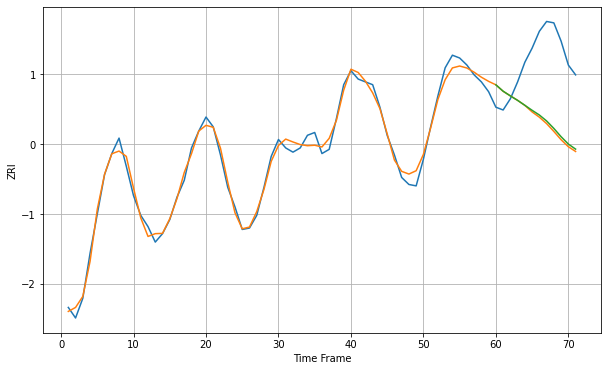

Wall time: 8.58 s
19104 4.898361914874423 49.8890506221619 48.550030518213006 [1285.90986868 1281.39707864 1278.02290718 1274.8500418  1271.34880159
 1267.78366956 1264.44815253 1260.20025127 1254.87887394 1248.98688006
 1243.78234222 1240.15450391]

Got an mse at 0.0100 in round 83 and stopped training

71 71 12


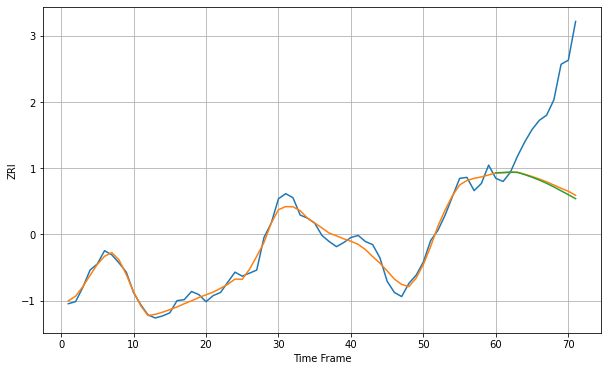

Wall time: 7.13 s
19106 6.440364464004906 80.9216977863839 82.61448585265741 [1771.44743033 1771.75105432 1772.19572822 1771.89133444 1769.64983957
 1767.1102364  1764.30904795 1761.15495322 1757.60413621 1753.79134454
 1749.99589773 1746.12458826]

Got an mse at 0.0100 in round 230 and stopped training

71 71 12


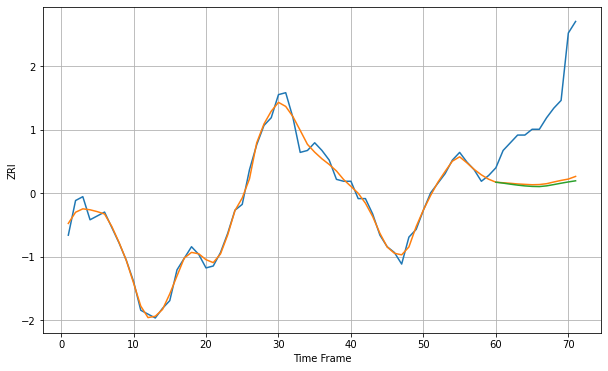

Wall time: 9.74 s
19107 3.2708890503301724 41.16804115857497 42.28401792715716 [1563.52526619 1563.04014612 1562.49464134 1562.00109183 1561.59468157
 1561.32875997 1561.2396454  1561.6166711  1562.28690516 1562.99243236
 1563.65582082 1564.24046113]

Got an mse at 0.0100 in round 137 and stopped training

71 71 12


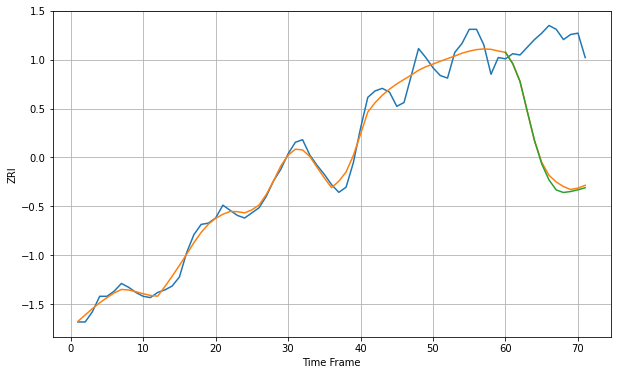

Wall time: 8.02 s
19120 7.595440451887537 90.9451749827307 93.10331796271417 [993.06756783 984.31717908 970.42349547 947.26576908 924.43039016
 906.11943851 893.67250608 885.85959433 883.86884527 884.6504874
 885.95374033 887.56747337]
71 71 12


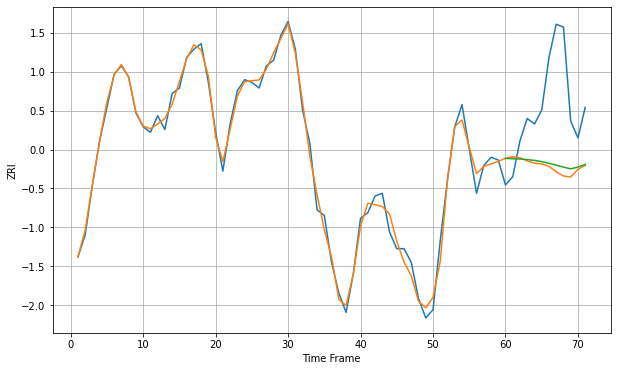

Wall time: 15 s
19121 3.0116955538610792 27.74564923317945 26.370654874709572 [1345.59815464 1345.44360174 1345.35045873 1345.16095355 1344.85634935
 1344.4125894  1343.83038008 1343.14961155 1342.44881973 1341.81853704
 1342.46932142 1343.39830043]

Got an mse at 0.0100 in round 95 and stopped training

71 71 12


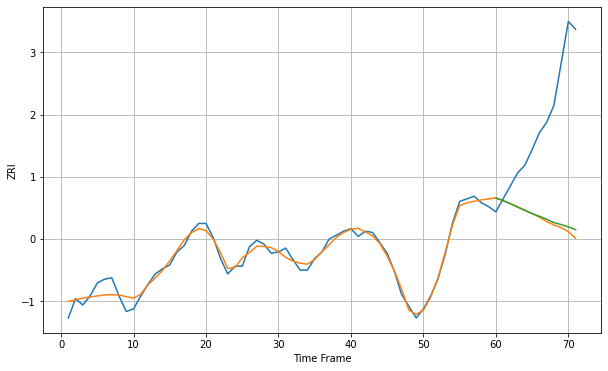

Wall time: 7.2 s
19123 4.766365351198348 87.38533235162409 85.20392710973931 [1550.6822159  1548.68927773 1546.2305964  1543.63552679 1541.07332707
 1538.69479781 1536.54059279 1534.26615663 1531.71891874 1530.13547013
 1528.39796655 1526.23195491]

Got an mse at 0.0100 in round 151 and stopped training

71 71 12


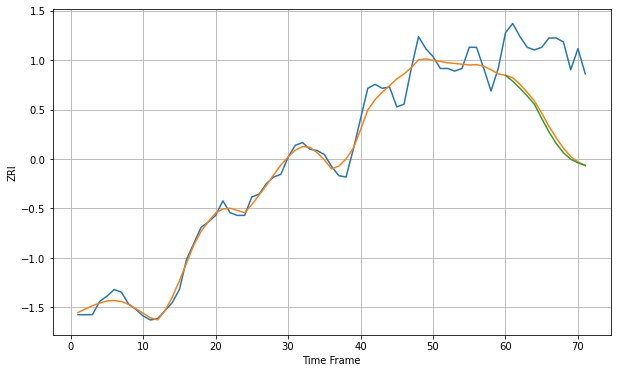

Wall time: 8.45 s
19124 7.444990459038857 59.24380304678653 61.63184166515559 [961.88258256 957.33187928 952.00316929 946.22125512 939.83160714
 929.2240202  919.11387329 910.33112183 903.3221913  898.45061537
 895.71772515 893.70531719]

Got an mse at 0.0099 in round 93 and stopped training

71 71 12


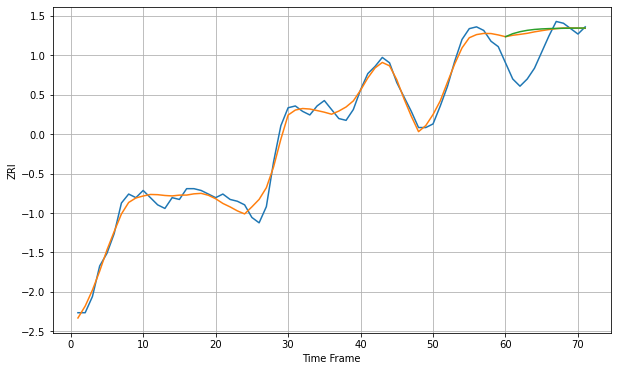

Wall time: 7.19 s
19128 4.3273539627939135 15.481271534408057 16.271577372223582 [1262.52583906 1264.19733871 1265.29963737 1266.06590707 1266.56075262
 1266.8572435  1267.0295773  1267.13667764 1267.21411918 1267.27548324
 1267.31867729 1267.33263636]

Got an mse at 0.0098 in round 129 and stopped training

71 71 12


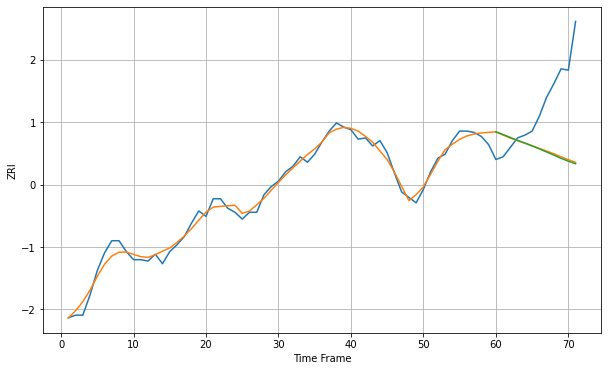

Wall time: 8.34 s
19130 4.545995971162018 45.76954945072198 46.404917549456435 [1536.45542909 1534.43844449 1532.27100256 1530.15329925 1528.10252853
 1526.0277075  1523.8536434  1521.58445609 1519.25108345 1516.89219975
 1514.75853421 1512.87943406]

Got an mse at 0.0099 in round 95 and stopped training

71 71 12


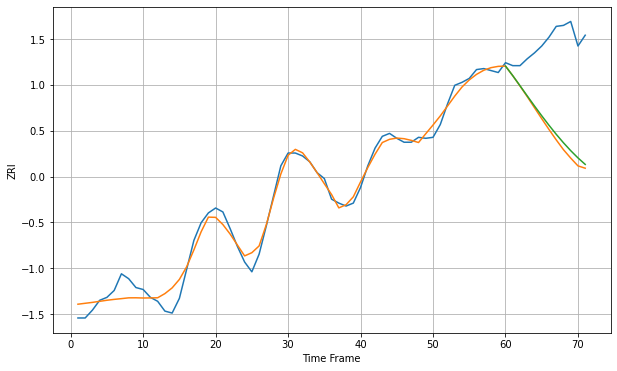

Wall time: 7.21 s
19131 9.22223444028868 91.96042496346027 87.54713579978905 [1165.56099758 1155.80500652 1145.56776794 1135.19078417 1124.93350677
 1114.93327437 1105.28855496 1096.09531284 1087.44555964 1079.41160853
 1072.03003243 1065.42316692]

Got an mse at 0.0100 in round 127 and stopped training

71 71 12


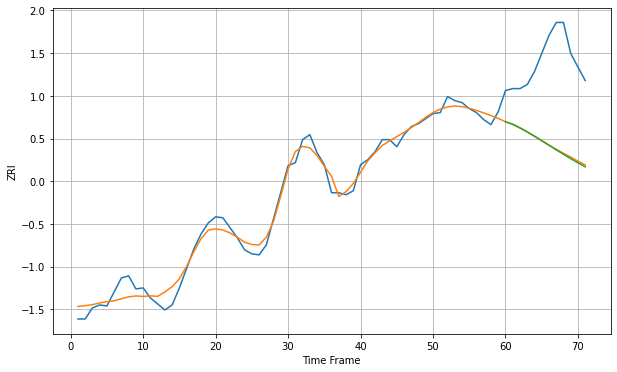

Wall time: 7.8 s
19139 8.455044145423427 86.35402028201963 86.96975332441124 [1112.918356   1110.43859535 1106.83657405 1102.82941968 1098.51495178
 1094.00682207 1089.42158089 1084.86385791 1080.40899985 1076.09322296
 1071.91692686 1067.85810441]

Got an mse at 0.0097 in round 279 and stopped training

71 71 12


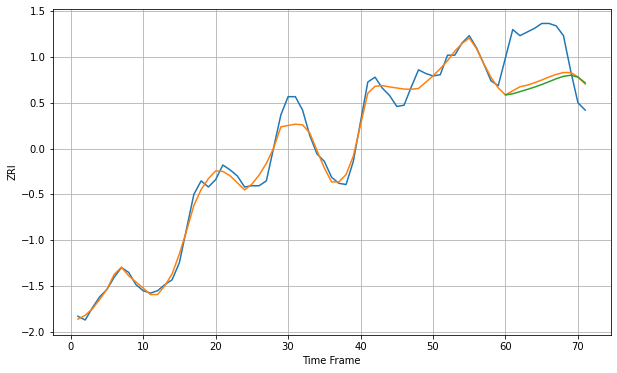

Wall time: 10.9 s
19140 7.309607307387136 37.1536533670482 39.852959938455264 [ 988.41550214  989.41225018  991.13044439  992.93630082  994.83979294
  996.9415451   999.28922028 1001.70079192 1003.66843818 1004.56431541
 1003.009726    998.32958208]

Got an mse at 0.0099 in round 134 and stopped training

71 71 12


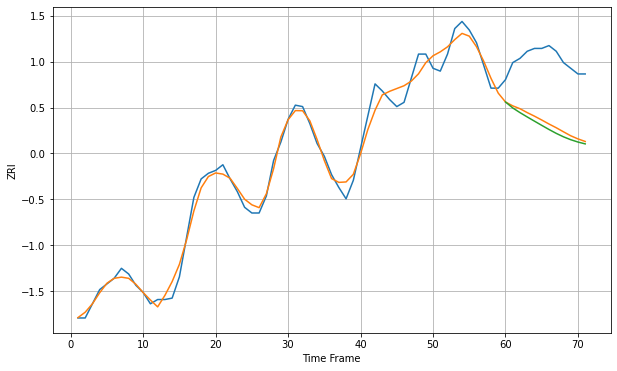

Wall time: 8 s
19141 6.389313922909969 44.810769041774996 47.693976533445905 [959.2355188  955.0447076  951.74505547 948.69376696 945.72339376
 942.77118323 939.86734273 937.12768387 934.69407549 932.65466322
 931.01152388 929.70669792]

Got an mse at 0.0099 in round 157 and stopped training

71 71 12


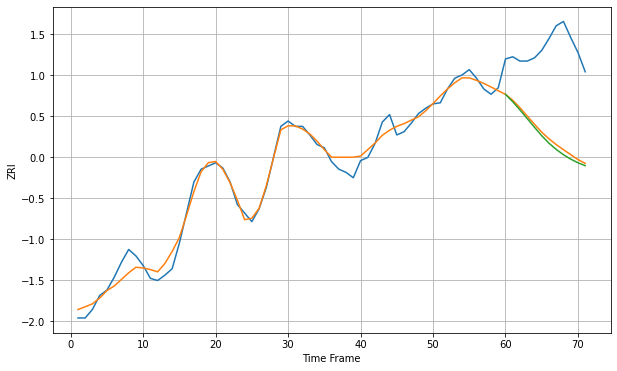

Wall time: 8.44 s
19143 7.578274798201856 82.51360519178972 85.63302242828296 [1114.91992978 1107.98715211 1100.35148024 1092.27558619 1084.12680152
 1076.28712741 1069.25891313 1063.47323573 1058.51696541 1054.37853742
 1051.0036413  1048.30641924]

Got an mse at 0.0100 in round 231 and stopped training

71 71 12


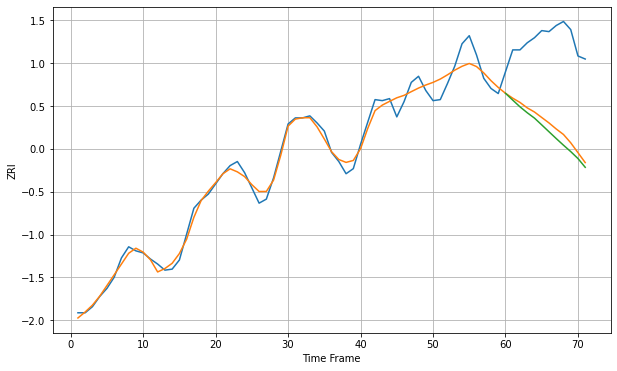

Wall time: 9.92 s
19144 8.398740657570547 84.15698499539633 90.70654073286634 [1060.24262837 1053.48880899 1046.90114754 1041.07797276 1035.77448599
 1029.09985121 1022.3475002  1015.64826244 1009.10132547 1002.80946589
  995.95536421  987.33302874]

Got an mse at 0.0100 in round 383 and stopped training

71 71 12


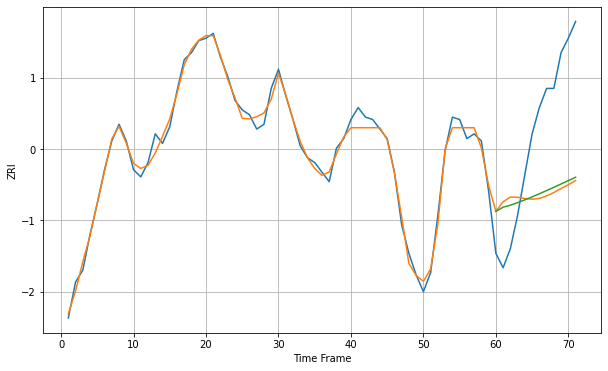

Wall time: 12.8 s
19146 2.9704773472530634 40.014034756050414 38.47134958025012 [1470.54269075 1472.32437418 1473.15978327 1474.23894418 1475.39894942
 1476.63620249 1477.93289961 1479.27498283 1480.64945102 1482.04431965
 1483.44862387 1484.85257753]

Got an mse at 0.0100 in round 480 and stopped training

71 71 12


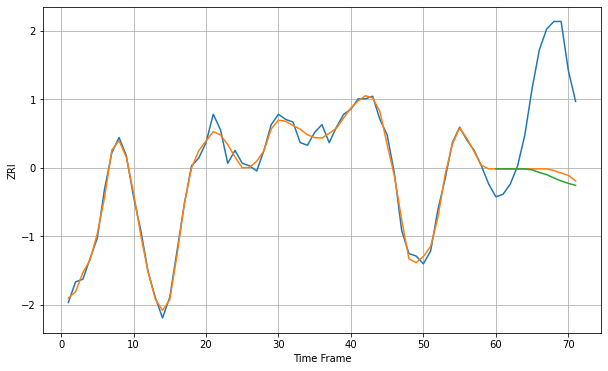

Wall time: 14.5 s
19147 2.635825981016066 36.36047803268329 38.02315579250421 [1431.82847474 1431.82847474 1431.82847474 1431.82847474 1431.82847474
 1431.44056791 1430.41765992 1429.59830873 1428.31240242 1427.15547332
 1426.22314634 1425.42598346]

Got an mse at 0.0100 in round 165 and stopped training

71 71 12


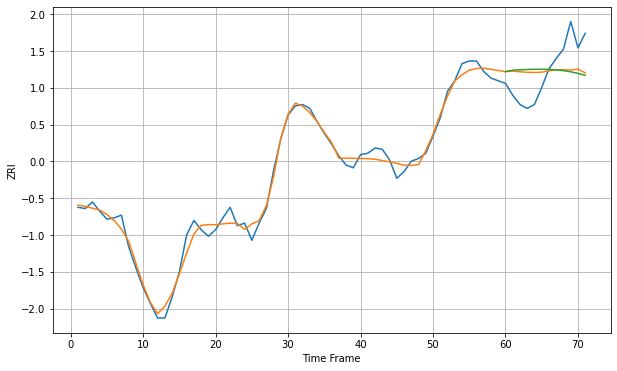

Wall time: 8.99 s
19148 5.546596185027763 21.11294084810866 22.554815399114037 [1265.93698023 1267.01472109 1267.29786156 1267.53832129 1267.7074906
 1267.74405705 1267.60436695 1267.25634188 1266.66935304 1265.80672065
 1264.62330242 1263.07122108]

Got an mse at 0.0099 in round 122 and stopped training

71 71 12


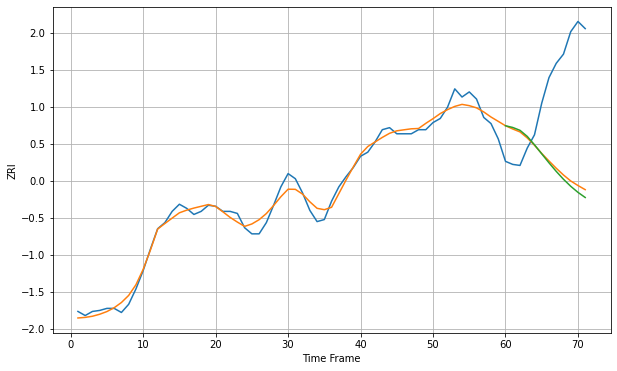

Wall time: 7.93 s
19401 7.148712509114817 95.49171325156132 99.10527489093475 [1225.86530155 1224.18021437 1221.38885294 1215.441401   1207.22700833
 1198.35728767 1189.57247166 1181.18623577 1173.46190499 1166.58508096
 1160.63762633 1155.60553785]

Got an mse at 0.0100 in round 245 and stopped training

71 71 12


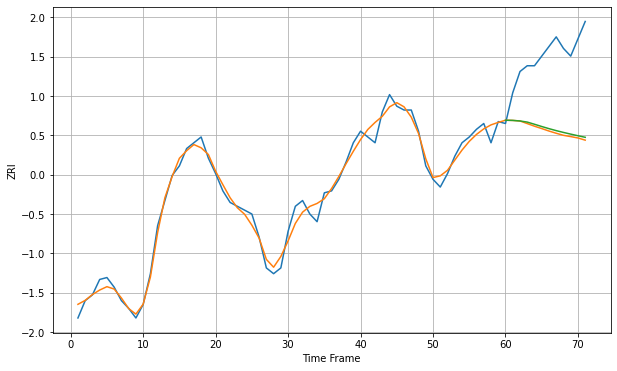

Wall time: 10.3 s
19464 4.058179768195378 39.6315575549066 38.597103593713015 [1102.70510735 1102.61032188 1102.31997226 1101.74010517 1100.61283756
 1099.44424473 1098.32943354 1097.30642836 1096.36579741 1095.48529463
 1094.64738975 1093.84231569]

Got an mse at 0.0098 in round 145 and stopped training

71 71 12


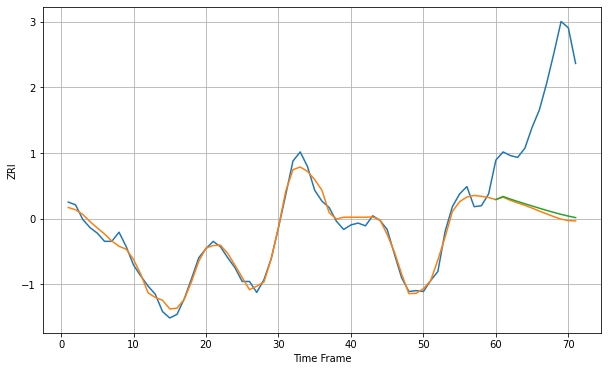

Wall time: 8.09 s
20001 7.1354896644048385 131.35746003842655 128.17033957915572 [2304.79005991 2308.19186882 2305.28498149 2302.71008018 2300.21550521
 2297.75045345 2295.31491228 2292.94213942 2290.67995802 2288.57829836
 2286.68157442 2285.02412022]

Got an mse at 0.0099 in round 299 and stopped training

71 71 12


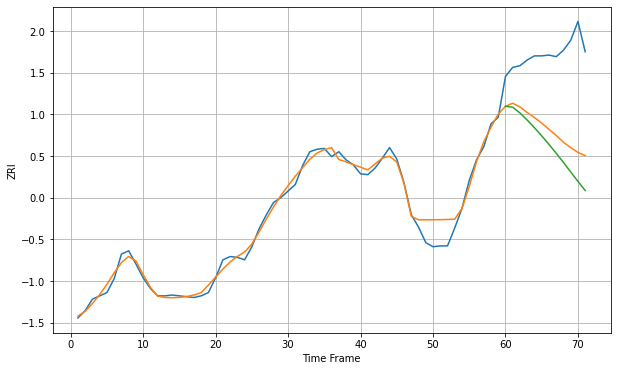

Wall time: 11.3 s
20002 9.939442189217743 96.30407998944071 117.95112038159542 [2164.50194304 2163.21499578 2156.23593371 2147.59315264 2138.23462928
 2128.32814731 2117.91934498 2107.04694011 2095.7865656  2084.28562723
 2072.78503313 2061.61086229]

Got an mse at 0.0099 in round 308 and stopped training

71 71 12


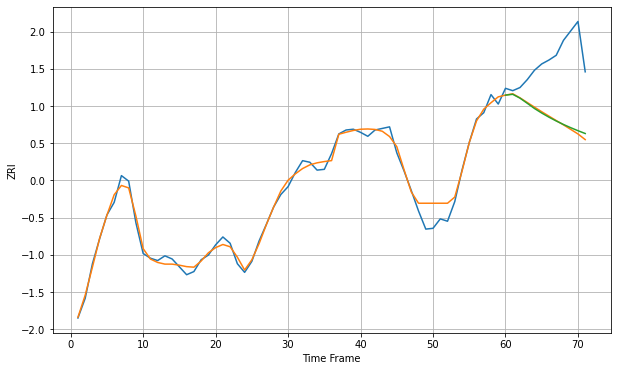

Wall time: 11.3 s
20003 9.368782062361628 78.57686316000152 77.31959688250866 [2312.36248574 2313.37904247 2308.51385221 2301.99364782 2295.3249444
 2289.56794932 2284.29079525 2279.46123524 2275.03142624 2270.93756641
 2267.12274621 2263.54161693]

Got an mse at 0.0100 in round 153 and stopped training

71 71 12


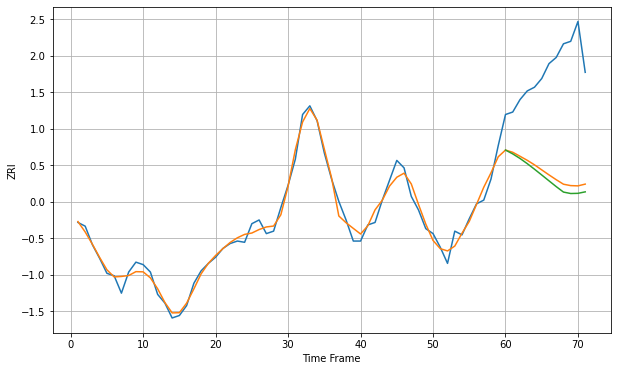

Wall time: 8.4 s
20005 5.830146812020119 84.74742933467394 89.26706000208574 [2266.34948406 2263.25143521 2259.58118673 2255.40899092 2250.91455127
 2246.26083135 2241.55408084 2236.88108526 2232.47538965 2231.32224172
 2231.46348398 2232.65555504]

Got an mse at 0.0099 in round 405 and stopped training

71 71 12


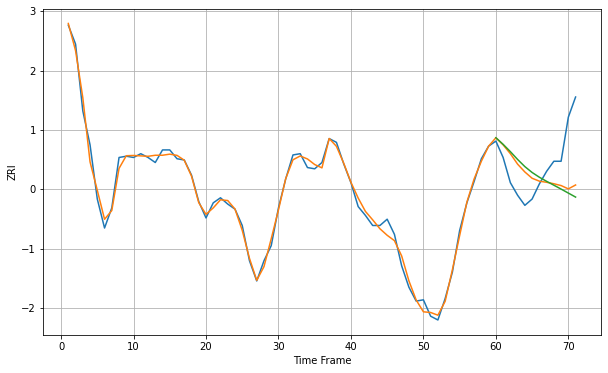

Wall time: 13.1 s
20007 4.68046930820319 30.426387969123756 33.91546369544452 [2171.67001193 2166.4397388  2160.62298028 2154.41676216 2148.75022827
 2144.0940505  2140.32312232 2137.06973646 2133.99932379 2130.91061017
 2127.74414582 2124.55386432]

Got an mse at 0.0099 in round 156 and stopped training

71 71 12


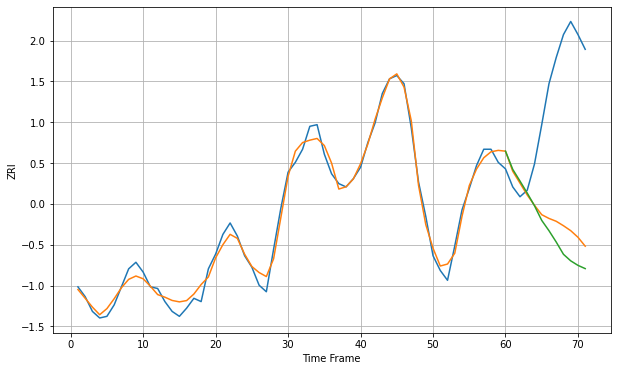

Wall time: 8.89 s
20008 4.889378270415591 81.8427262694294 92.30600785576785 [2055.81913797 2044.71902078 2037.56857035 2030.2383826  2022.49777875
 2013.56822433 2007.27447821 2000.34966978 1992.86241948 1988.87699865
 1986.11848313 1984.13308338]

Got an mse at 0.0099 in round 88 and stopped training

71 71 12


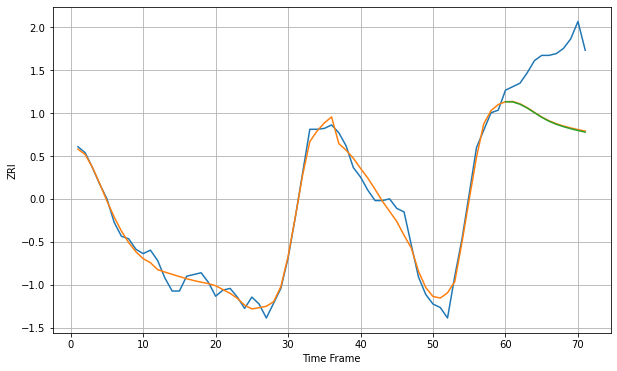

Wall time: 7.21 s
20009 9.766253814828017 74.13198221796465 74.77924027935887 [2333.68419101 2333.46174776 2330.80335037 2326.42917724 2321.06720386
 2315.76466115 2311.2885961  2307.77496919 2304.98810874 2302.65850637
 2300.60654715 2298.73660311]

Got an mse at 0.0100 in round 331 and stopped training

71 71 12


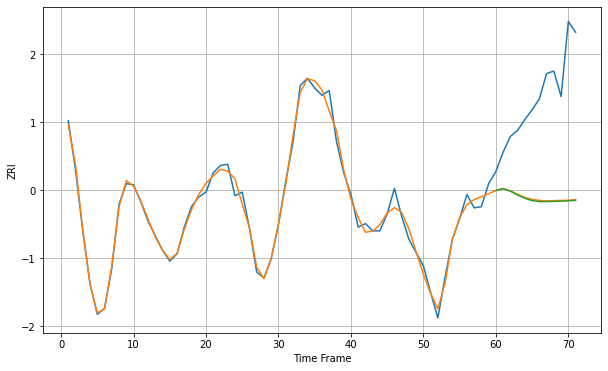

Wall time: 11.8 s
20010 5.584988724224868 88.23163793883127 88.79189311948491 [2122.29894057 2123.90092897 2121.72621564 2118.66042872 2115.84494635
 2113.99116919 2113.16716736 2113.1826875  2113.33055096 2113.55658784
 2113.83534788 2114.1571251 ]

Got an mse at 0.0100 in round 195 and stopped training

71 71 12


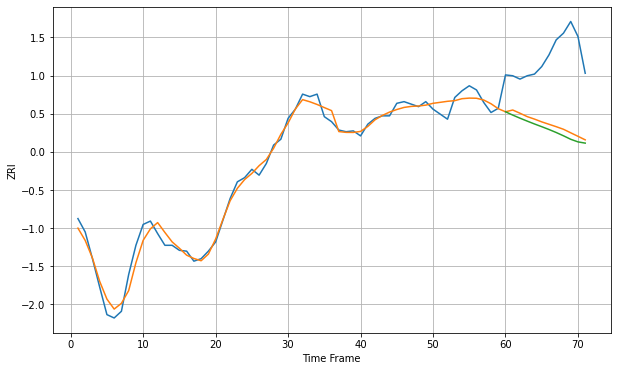

Wall time: 9.35 s
20011 9.096501522037261 83.83837302823002 89.56499679155995 [1892.87840953 1888.89757366 1885.20747974 1881.69153971 1878.27063713
 1875.02573039 1871.65432197 1868.03828009 1864.12240656 1859.93058419
 1856.83691788 1855.34170933]

Got an mse at 0.0099 in round 112 and stopped training

71 71 12


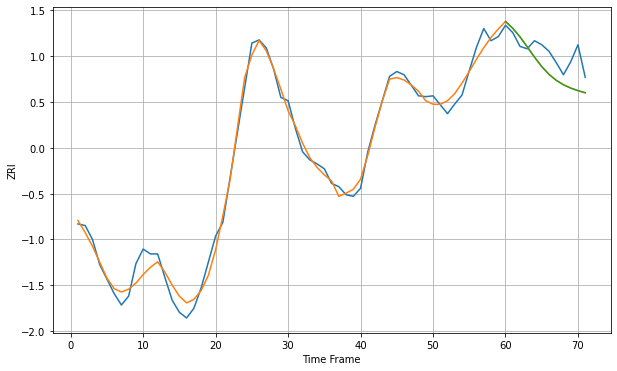

Wall time: 7.91 s
20019 11.194521615359506 24.873723477500985 24.789270905115025 [1715.73311636 1707.38607619 1696.72605938 1684.43904222 1671.73650813
 1660.10823927 1650.53178525 1643.17185525 1637.68381554 1633.58980895
 1630.46911492 1628.00787223]

Got an mse at 0.0099 in round 123 and stopped training

71 71 12


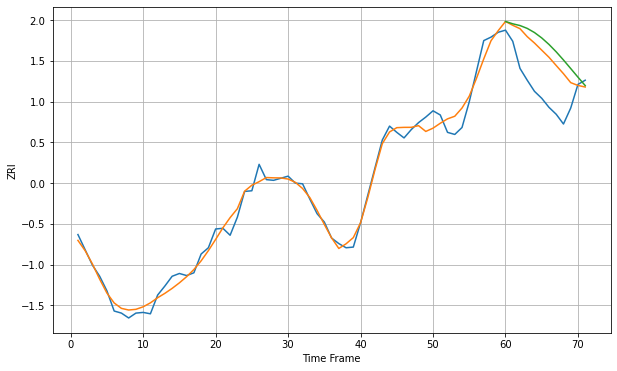

Wall time: 7.91 s
20020 11.615126002754309 53.44247359526059 66.43456129628106 [1690.51507414 1687.15398673 1684.64866917 1680.54438578 1674.56844378
 1666.81963835 1657.48276687 1646.79848491 1635.09579353 1622.80124945
 1610.38615823 1598.28135143]

Got an mse at 0.0099 in round 48 and stopped training

71 71 12


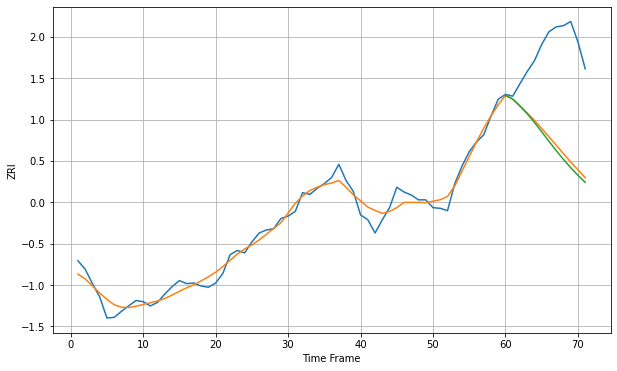

Wall time: 6.33 s
20024 13.580236156894061 153.1927497380678 159.62353366232384 [2346.3004721  2340.17995924 2328.62433571 2315.69251586 2301.43990156
 2285.93889534 2270.16477691 2254.72158835 2240.03675327 2226.31496617
 2213.72100925 2202.09301134]

Got an mse at 0.0099 in round 175 and stopped training

71 71 12


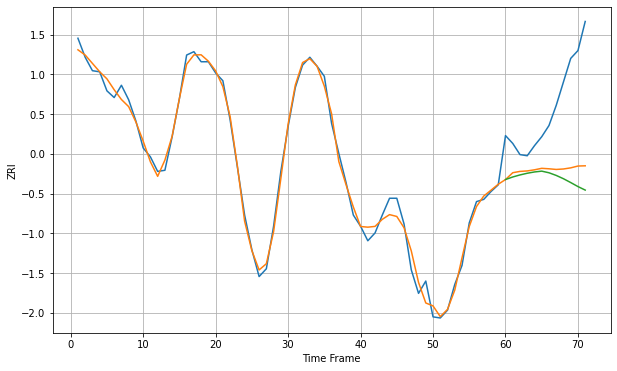

Wall time: 8.66 s
20037 7.038214050856676 65.57330079468586 75.00686378556502 [2380.72718259 2383.01393319 2384.8382275  2386.34434685 2387.50013699
 2388.22714043 2386.77375318 2384.39758668 2381.44272353 2378.02393042
 2374.43912565 2371.30275148]

Got an mse at 0.0097 in round 35 and stopped training

71 71 12


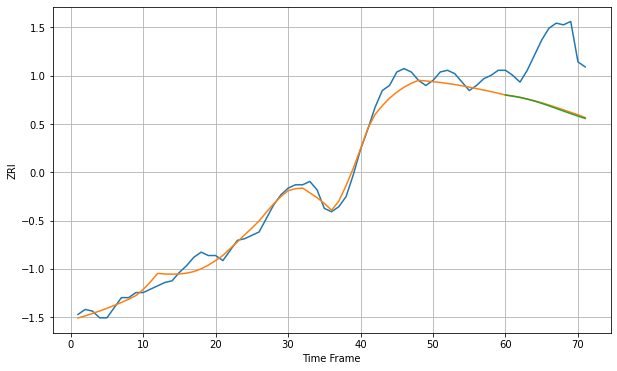

Wall time: 6.16 s
20109 5.265874095722517 35.12100782699874 35.57270511791282 [1445.31637988 1444.62854062 1443.86097736 1442.88552021 1441.71394943
 1440.37233645 1438.9022801  1437.35810575 1435.79737995 1434.26848612
 1432.80158811 1431.40647388]

Got an mse at 0.0099 in round 160 and stopped training

71 71 12


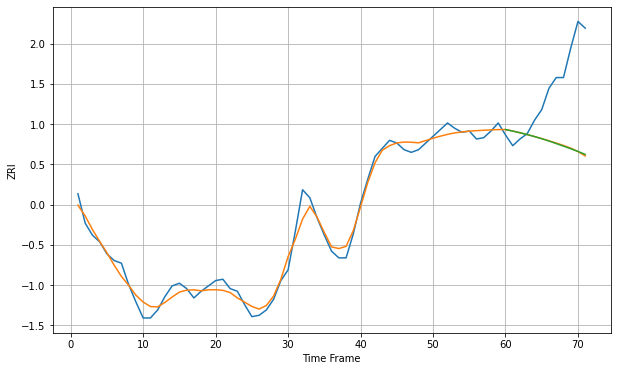

Wall time: 8.46 s
20110 5.946231636175968 51.276836393847404 51.227537195056705 [1408.09633584 1406.93657287 1405.66758013 1404.30419354 1402.8292672
 1401.22575402 1399.47927241 1397.58155831 1395.6772811  1393.713505
 1391.69863158 1389.46683733]

Got an mse at 0.0099 in round 242 and stopped training

71 71 12


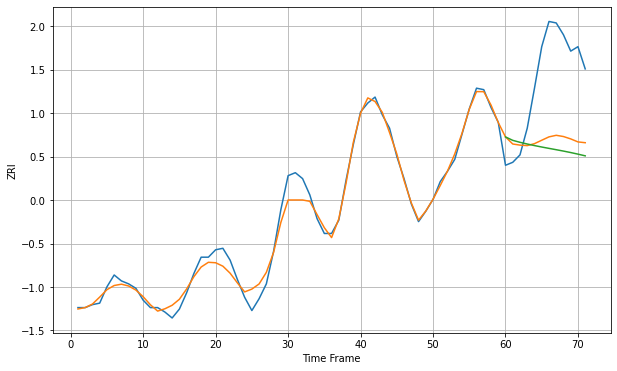

Wall time: 10.3 s
20147 5.8034585541497625 52.20607875594806 58.46361971612225 [1612.1148521  1609.81534449 1608.48572974 1607.33649393 1606.28459792
 1605.31383034 1604.39741977 1603.49646927 1602.5689048  1601.57953787
 1600.50929943 1599.35961666]

Got an mse at 0.0097 in round 34 and stopped training

71 71 12


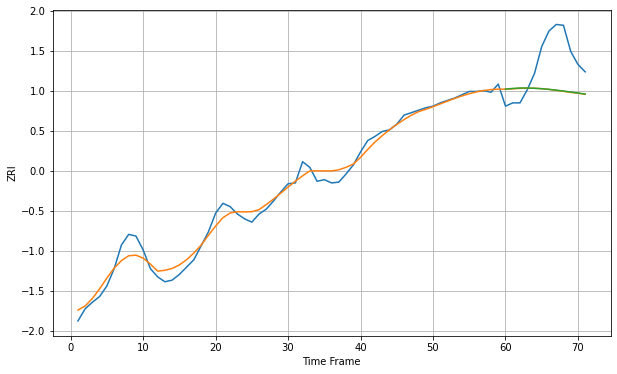

Wall time: 6.05 s
20175 9.466976612812779 47.16330255450339 47.05143732356105 [1641.86530719 1642.69569521 1643.18082217 1643.21834341 1642.90388639
 1642.31962479 1641.52902596 1640.57874913 1639.50229368 1638.32556613
 1637.07426521 1635.78151821]

Got an mse at 0.0100 in round 127 and stopped training

71 71 12


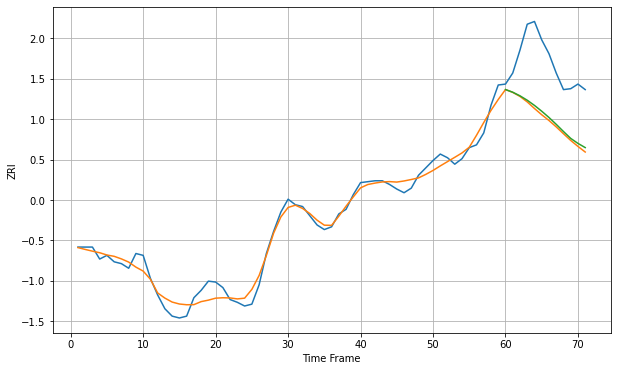

Wall time: 7.91 s
20176 8.727677254359019 63.902899323803666 61.29117948588699 [1618.07164714 1615.15371102 1611.24761668 1606.4525573  1600.83287311
 1594.52103254 1587.71374627 1580.285699   1572.49593473 1565.00072371
 1559.58104141 1555.03363294]

Got an mse at 0.0099 in round 105 and stopped training

71 71 12


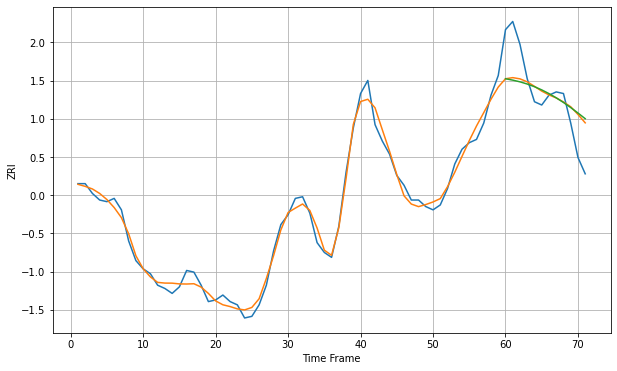

Wall time: 7.32 s
20740 4.619306670762927 19.31100628900422 20.17245678858657 [1641.03307583 1640.18718571 1639.13989564 1637.80649869 1636.17095422
 1634.22408225 1631.96369904 1629.39732881 1626.54444047 1623.43760548
 1620.12152014 1616.64925986]

Got an mse at 0.0099 in round 143 and stopped training

71 71 12


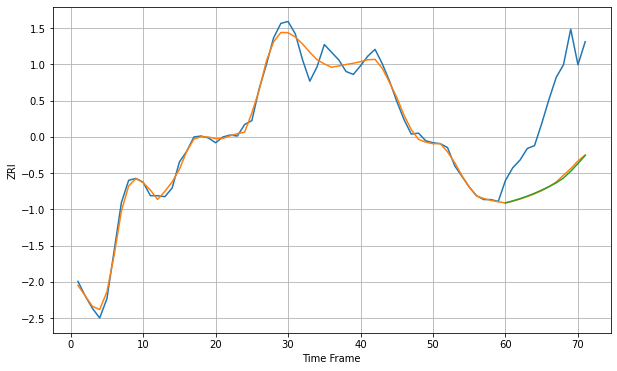

Wall time: 8.15 s
20814 7.4661055987429865 87.21824816115256 88.1949669718081 [1947.53354549 1949.56847957 1951.88440087 1954.52946157 1957.51523396
 1960.83617204 1964.46521979 1968.3537489  1973.40075901 1980.37041007
 1988.43934342 1996.87533163]

Got an mse at 0.0099 in round 107 and stopped training

71 71 12


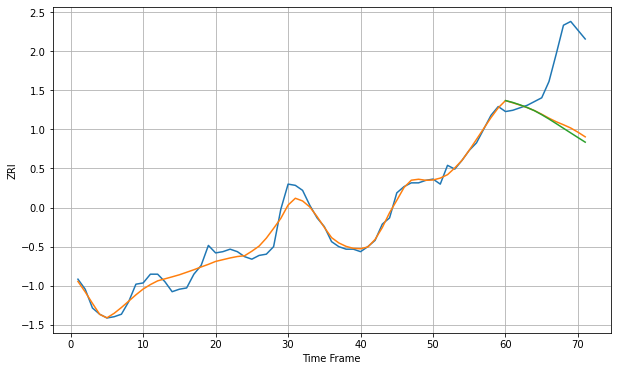

Wall time: 7.45 s
20850 6.199925904132181 50.397499324751934 52.63211234224314 [1860.76762158 1859.27781706 1857.35866242 1855.19887283 1852.6646201
 1849.4848539  1846.02360748 1842.35739183 1838.61792167 1834.91499064
 1831.20331434 1827.52931699]

Got an mse at 0.0099 in round 56 and stopped training

71 71 12


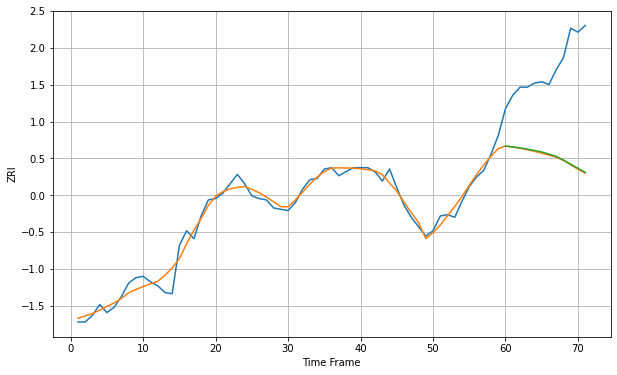

Wall time: 6.52 s
20852 5.444794556824187 69.37118533263313 68.86845445855164 [1763.13266597 1762.49928684 1761.72127233 1760.82499061 1759.823749
 1758.73357517 1757.12291808 1755.42503254 1752.74513978 1749.63586081
 1746.54916749 1743.54305356]

Got an mse at 0.0100 in round 114 and stopped training

71 71 12


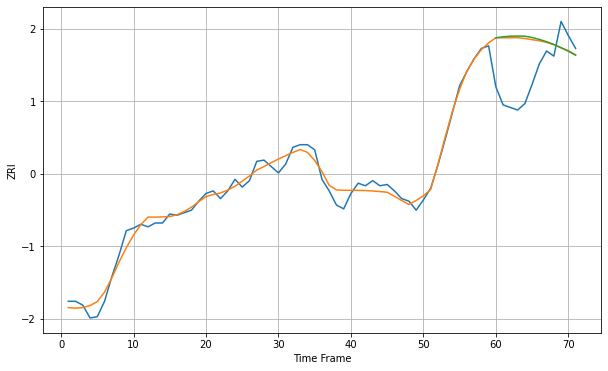

Wall time: 7.59 s
20878 5.598254351563179 35.520287368233255 36.36369492521555 [1709.29309024 1710.07798421 1710.51155293 1710.65913538 1710.51306813
 1709.49792989 1708.02887455 1706.22503735 1704.08566183 1701.61374554
 1698.82331776 1695.74286379]

Got an mse at 0.0099 in round 192 and stopped training

71 71 12


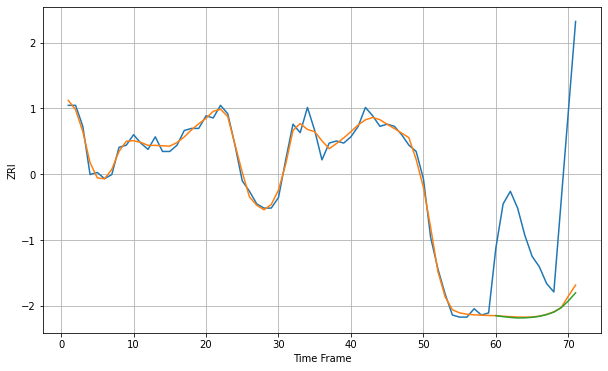

Wall time: 9.05 s
20902 3.1118372128623437 57.37196295150811 58.46507412385139 [1717.69446071 1717.22542687 1716.85805999 1716.5920488  1716.65880076
 1716.89789729 1717.37645357 1718.18589449 1719.40821334 1721.46303118
 1724.70107728 1728.59016736]

Got an mse at 0.0100 in round 161 and stopped training

71 71 12


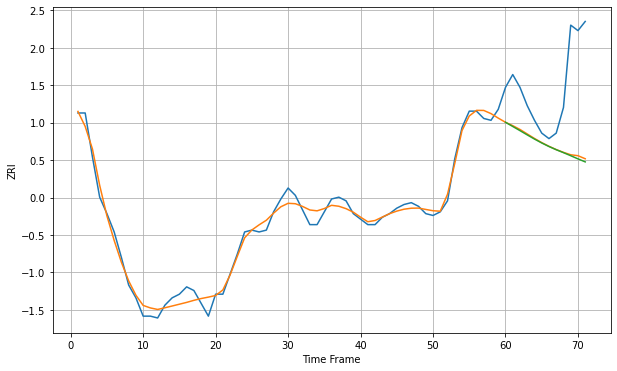

Wall time: 8.34 s
20906 4.0660597491688595 38.78222417675461 39.4890583508774 [1567.9175814  1565.62761667 1563.35172749 1561.02752669 1558.7492792
 1556.61759126 1554.68181593 1552.93012243 1551.32224582 1549.65617494
 1547.93074058 1546.28268653]

Got an mse at 0.0099 in round 106 and stopped training

71 71 12


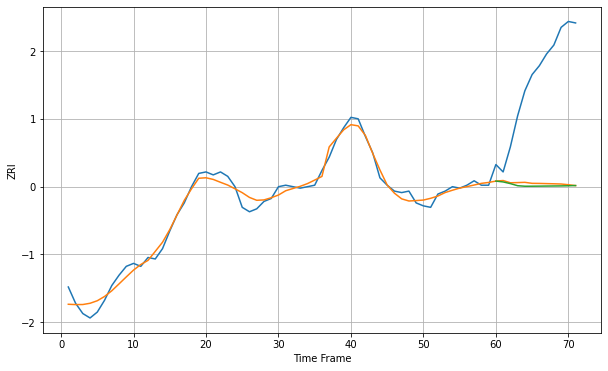

Wall time: 7.85 s
20910 4.546483956840824 76.76028765003247 77.92212658962183 [1712.79380676 1712.22575288 1711.08800779 1709.66245285 1709.3097331
 1709.32681238 1709.37378637 1709.42866276 1709.47501612 1709.52461474
 1709.61496815 1709.77458386]

Got an mse at 0.0099 in round 148 and stopped training

71 71 12


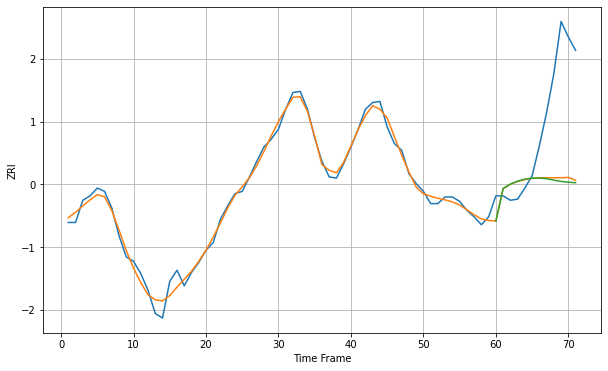

Wall time: 8.3 s
21043 5.588867892985968 72.82220296422892 74.57382165462876 [1543.23489274 1572.50294189 1576.54153743 1579.20808528 1580.96697785
 1581.88372182 1582.01141777 1581.40384316 1580.10601619 1578.97888236
 1578.24273548 1577.81455646]

Got an mse at 0.0100 in round 79 and stopped training

71 71 12


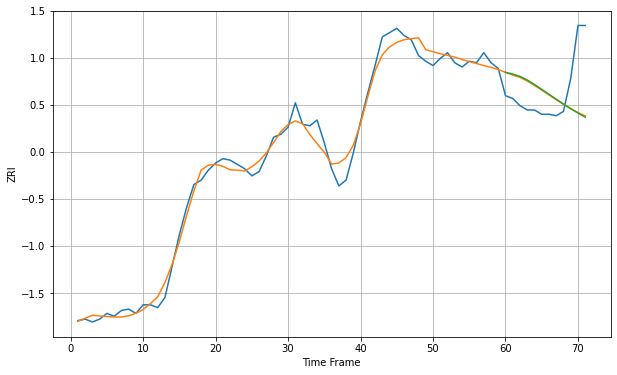

Wall time: 6.83 s
21044 6.515247987106708 29.398622899078894 29.812998013354974 [1647.3068755  1646.04412427 1644.44238352 1641.9228653  1638.74940786
 1635.37979742 1631.94302956 1628.51425732 1625.16533311 1621.94211964
 1618.86656191 1615.95152435]

Got an mse at 0.0100 in round 141 and stopped training

71 71 12


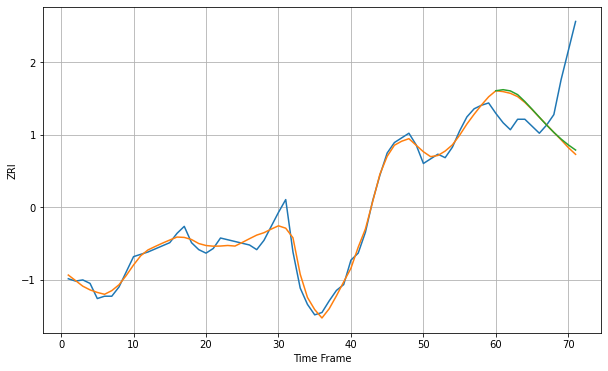

Wall time: 8.12 s
21046 6.188928909888342 46.47798305607868 45.62229623115177 [1664.49466912 1665.40569716 1664.3493951  1661.14397102 1655.22699699
 1648.61239419 1641.76296088 1635.03746415 1628.72001551 1623.0045348
 1617.9687371  1613.56600804]

Got an mse at 0.0099 in round 105 and stopped training

71 71 12


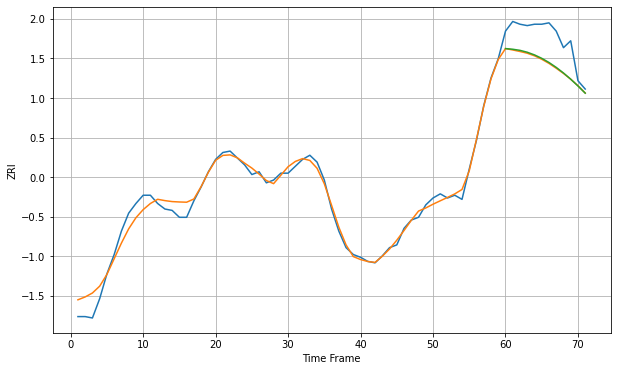

Wall time: 7.23 s
21061 5.604160091843604 20.991822597971534 20.526312852184798 [1450.33635609 1449.8559727  1449.05973036 1447.69134239 1445.76383321
 1443.2822315  1440.25721186 1436.70635544 1432.65629441 1428.14709382
 1423.23870992 1418.01597288]

Got an mse at 0.0099 in round 48 and stopped training

71 71 12


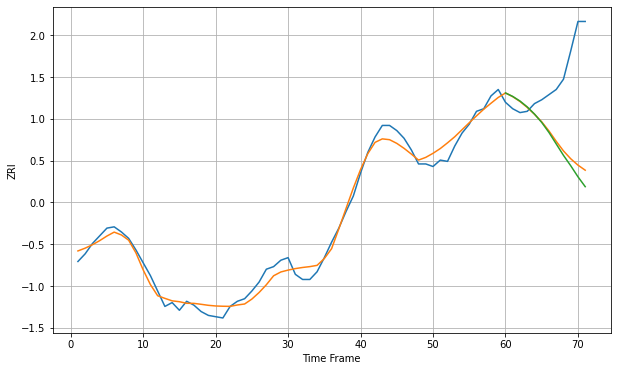

Wall time: 6.33 s
21117 6.393704078113087 57.11236171599521 61.91349881243928 [1353.29846024 1350.59839262 1346.99902386 1342.43229998 1336.86136313
 1330.32228464 1322.5057883  1313.59553128 1304.69407518 1296.60543565
 1287.99663137 1280.29866493]

Got an mse at 0.0100 in round 135 and stopped training

71 71 12


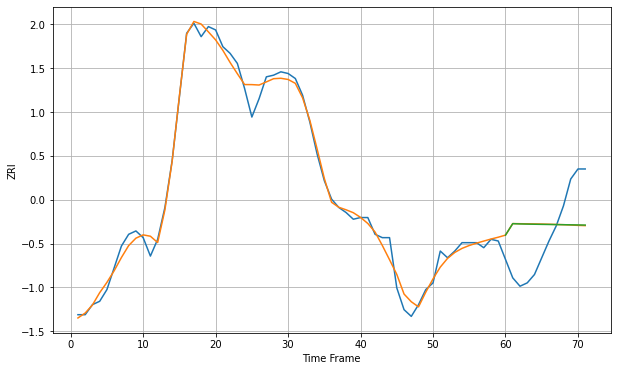

Wall time: 7.91 s
21202 5.201266298935183 26.570711482981412 26.42508757619746 [1246.51241464 1253.35456858 1253.19123102 1253.08636962 1253.00065997
 1252.92754667 1252.86126664 1252.79697869 1252.73072372 1252.65940141
 1252.58544869 1252.50835734]

Got an mse at 0.0099 in round 197 and stopped training

71 71 12


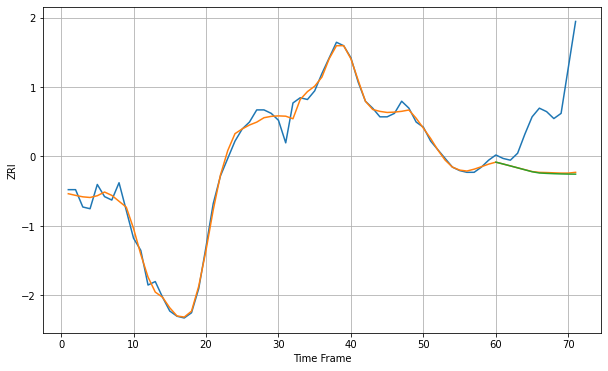

Wall time: 9.08 s
21204 3.983514497963082 38.27587757085596 38.6961614559424 [1296.86272466 1295.79461499 1294.69769865 1293.58239715 1292.45835616
 1291.33601482 1290.60825702 1290.39022029 1290.20954796 1290.07027379
 1289.98052265 1289.94642815]
71 71 12


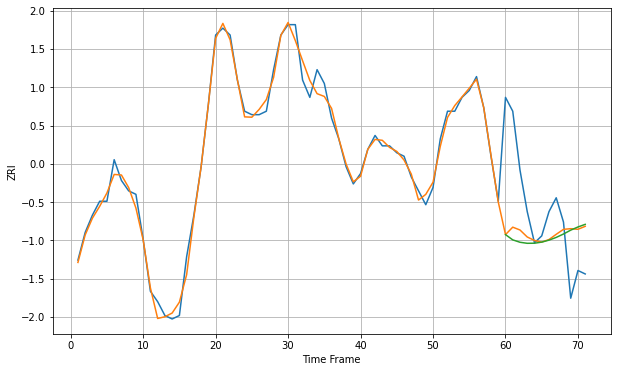

Wall time: 15.3 s
21217 2.3553164565994735 18.173881748680863 19.220577057513037 [1029.36468619 1027.8457146  1027.15449748 1026.85394645 1026.88074465
 1027.19631571 1027.76639158 1028.55742729 1029.53395555 1030.65648637
 1031.5693627  1032.32517427]

Got an mse at 0.0098 in round 127 and stopped training

71 71 12


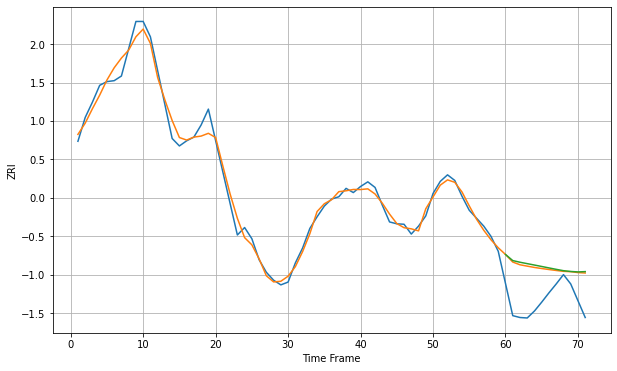

Wall time: 8.16 s
21231 16.229495710539766 77.98385741118625 81.19955031778555 [1765.21481332 1752.13579436 1748.54432557 1745.51928992 1742.50940955
 1739.44367345 1736.34967873 1733.31060519 1730.41627355 1728.74441919
 1727.79383849 1728.4138985 ]

Got an mse at 0.0100 in round 221 and stopped training

71 71 12


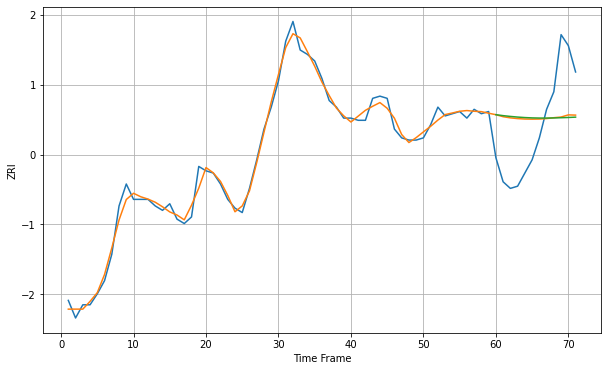

Wall time: 9.47 s
22030 3.1501160209903816 24.500227263226915 25.031783675941696 [1729.55590245 1729.12265122 1728.76561237 1728.47075132 1728.24685643
 1728.09783196 1728.02300001 1728.01824905 1728.07698794 1728.17250685
 1728.28774603 1728.44002629]

Got an mse at 0.0099 in round 484 and stopped training

71 71 12


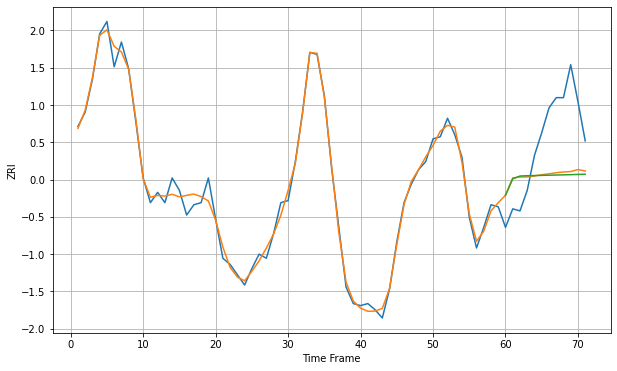

Wall time: 14.7 s
22031 3.599845236988177 27.306201459122995 28.2299817925171 [1804.60283987 1812.56389134 1813.94014072 1814.0821074  1814.17217738
 1814.25538654 1814.33734835 1814.42102417 1814.5092504  1814.60387016
 1814.70486423 1814.81051608]

Got an mse at 0.0098 in round 54 and stopped training

71 71 12


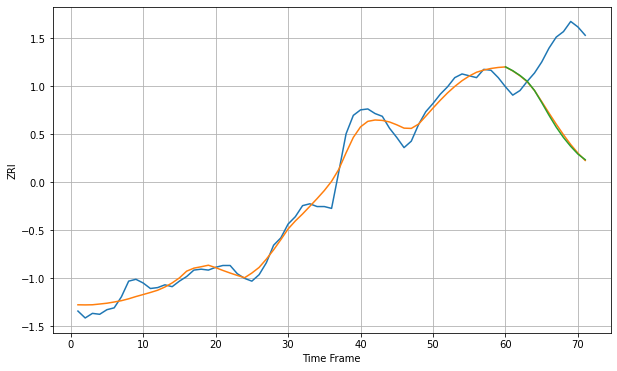

Wall time: 6.57 s
22033 10.212797519922109 84.25107630112296 85.40629238606034 [1828.64719956 1824.53695049 1819.32773107 1813.01841893 1803.06838729
 1789.9230311  1776.19124804 1763.26767517 1751.97412577 1742.33320319
 1733.96081517 1727.92129573]

Got an mse at 0.0099 in round 156 and stopped training

71 71 12


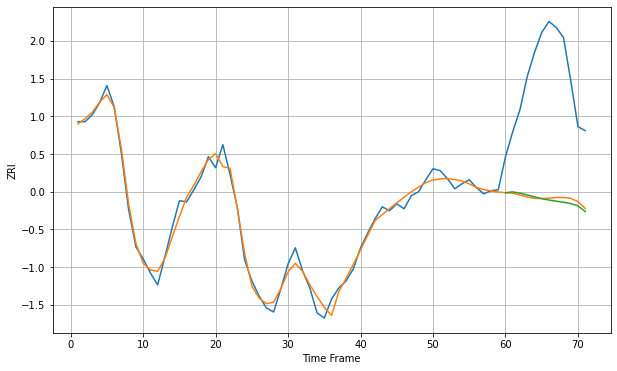

Wall time: 8.41 s
22102 7.462530463507025 124.6267903988645 126.11565028276642 [2038.00466633 2038.89605191 2037.5973685  2035.84847839 2033.9024472
 2032.13084214 2030.71100946 2029.59399822 2028.54192345 2027.16478252
 2024.97435858 2019.22458368]

Got an mse at 0.0099 in round 266 and stopped training

71 71 12


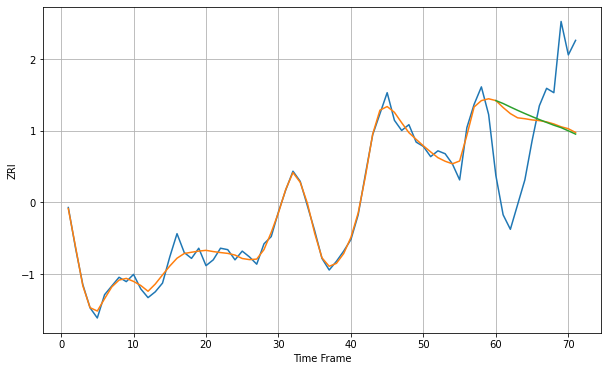

Wall time: 10.6 s
22180 4.894989916238436 52.38628150220427 54.41488576682847 [1880.5583439  1878.56088657 1876.16093418 1873.85289581 1871.64907358
 1869.53861036 1867.50666506 1865.53526165 1863.62480867 1861.95818747
 1859.76161166 1857.49977741]

Got an mse at 0.0100 in round 241 and stopped training

71 71 12


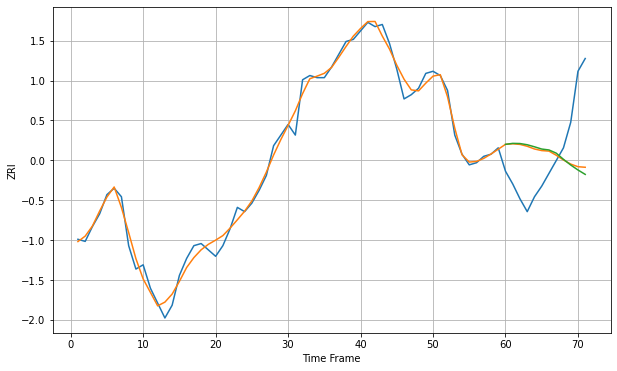

Wall time: 10.5 s
22191 3.7392985250673783 25.919750874224487 26.98009053707012 [1479.64138434 1480.10065971 1480.02347813 1479.45205081 1478.48638228
 1477.43226926 1477.00157632 1475.50308292 1472.59359794 1469.92449784
 1467.58922768 1465.51151022]
71 71 12


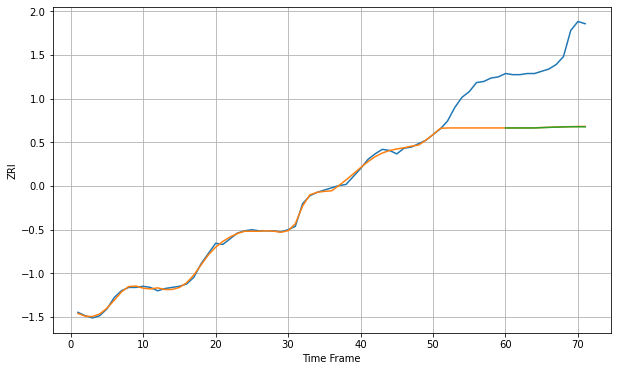

Wall time: 14.9 s
22192 12.717107972747186 62.88527798351544 62.995475325562964 [1408.92014973 1408.92014973 1408.92014973 1408.92014973 1408.92356654
 1409.17457579 1409.40949785 1409.6241097  1409.81588193 1409.98291258
 1409.9901576  1409.91100855]

Got an mse at 0.0100 in round 191 and stopped training

71 71 12


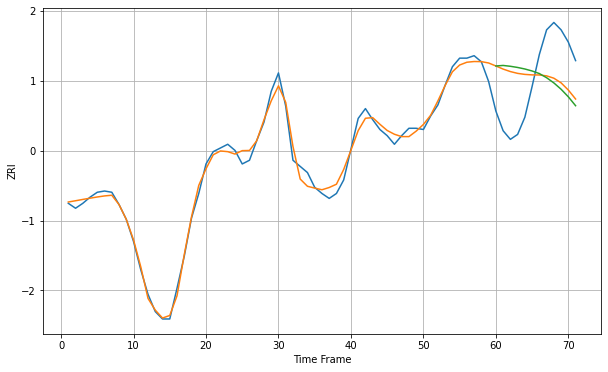

Wall time: 9.18 s
22201 5.616438355081868 39.50117116666238 42.970034797538744 [2150.63676846 2151.06123617 2150.38471162 2149.42583526 2148.18292997
 2146.56418585 2144.46345754 2141.09384833 2136.87467251 2131.72187467
 2125.56424561 2118.34241457]

Got an mse at 0.0099 in round 113 and stopped training

71 71 12


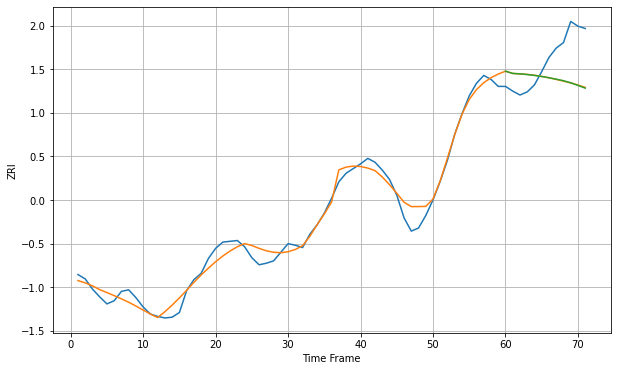

Wall time: 7.47 s
22202 11.06257616206066 45.188550666270416 45.2873189628087 [2178.44949864 2175.56895833 2175.01116462 2174.16013378 2173.0380069
 2171.66634715 2170.06628265 2168.25826999 2166.26141945 2163.5982718
 2160.26366278 2156.79163351]

Got an mse at 0.0099 in round 162 and stopped training

71 71 12


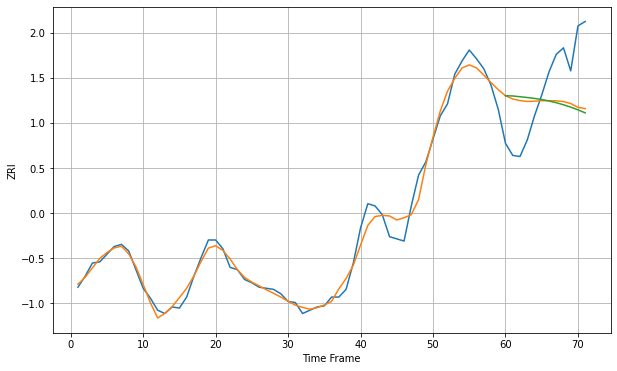

Wall time: 8.7 s
22203 8.145299086419172 46.64704867065478 48.939359724184534 [2112.32533475 2112.16228159 2111.45202645 2110.73943871 2109.91658159
 2108.88541959 2107.59133582 2106.01175745 2104.14062846 2101.97601929
 2099.51338899 2096.74438915]

Got an mse at 0.0098 in round 206 and stopped training

71 71 12


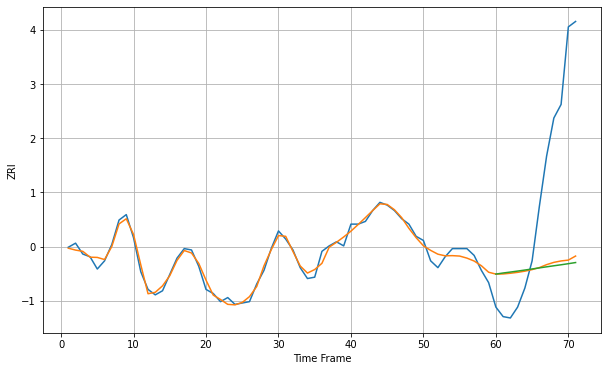

Wall time: 9.51 s
22204 3.9122506345324384 89.22393782904874 91.1745843608671 [1781.26437429 1782.07150884 1782.75040819 1783.47657966 1784.24090641
 1785.02720513 1785.82000904 1786.6056843  1787.37300751 1788.11338373
 1788.91643464 1789.75218048]

Got an mse at 0.0100 in round 244 and stopped training

71 71 12


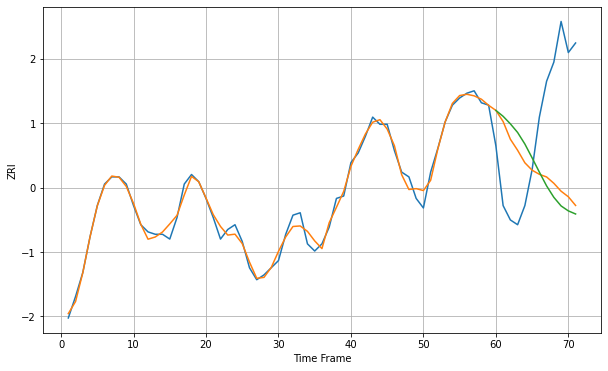

Wall time: 10.4 s
22206 2.6753068751953775 42.73827660005769 46.98980682380036 [1890.81089593 1888.32927908 1885.19075942 1881.57639765 1876.75260621
 1870.95949123 1865.00718216 1859.23225373 1854.45068444 1850.85105643
 1848.78481195 1847.48835234]

Got an mse at 0.0099 in round 135 and stopped training

71 71 12


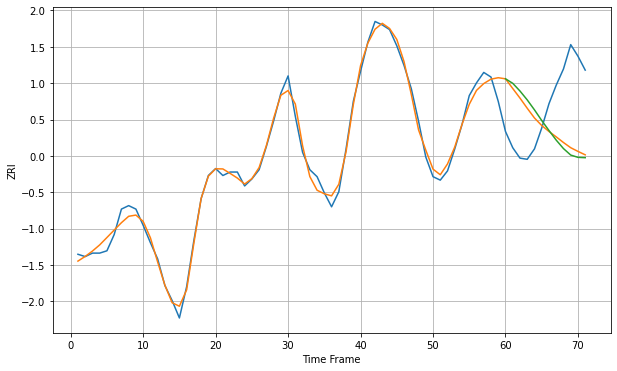

Wall time: 8.67 s
22209 6.219521272005858 55.26495329774191 59.34562647484337 [2274.48138248 2270.59436544 2263.93564966 2256.26015012 2247.66228822
 2238.47687168 2229.84573715 2221.55126162 2214.25730297 2208.65341319
 2206.68905135 2206.38866139]
71 71 12


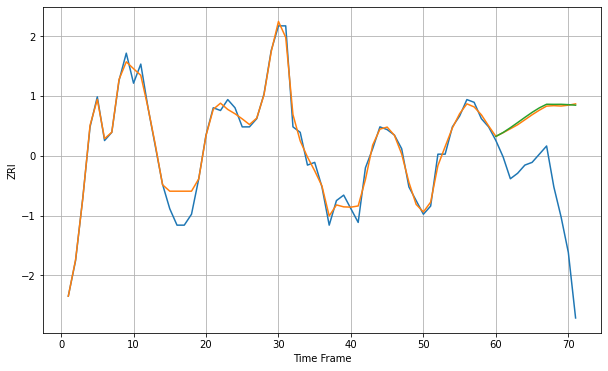

Wall time: 15.1 s
22303 3.4922624552414727 33.39599915931288 33.620113044028855 [1724.51454599 1725.94173535 1727.70015412 1729.56678451 1731.47059497
 1733.31499983 1734.96972616 1736.28806789 1736.25045142 1736.2695408
 1736.14404417 1735.94148075]

Got an mse at 0.0100 in round 132 and stopped training

71 71 12


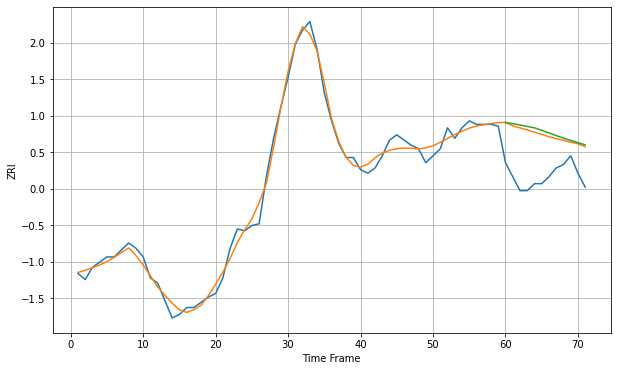

Wall time: 7.94 s
22304 4.166003653800871 24.900014766753078 26.406304227739867 [1601.12058383 1600.42903124 1599.62357917 1598.82567607 1598.00854965
 1596.60019981 1595.06728222 1593.5732639  1592.13871031 1590.77292685
 1589.48342252 1588.27538387]

Got an mse at 0.0099 in round 390 and stopped training

71 71 12


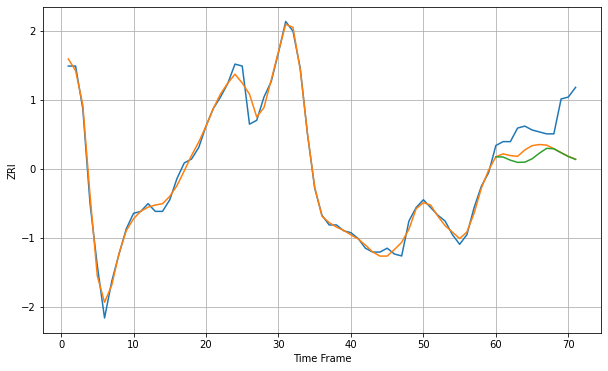

Wall time: 13.2 s
22305 3.5410680424240386 17.70866320409011 19.14989380185547 [1762.14786664 1762.04762115 1760.42221702 1759.29080177 1759.40733082
 1761.12439708 1764.027048   1766.5134473  1766.33116938 1764.25731574
 1762.29942757 1760.80637056]

Got an mse at 0.0100 in round 364 and stopped training

71 71 12


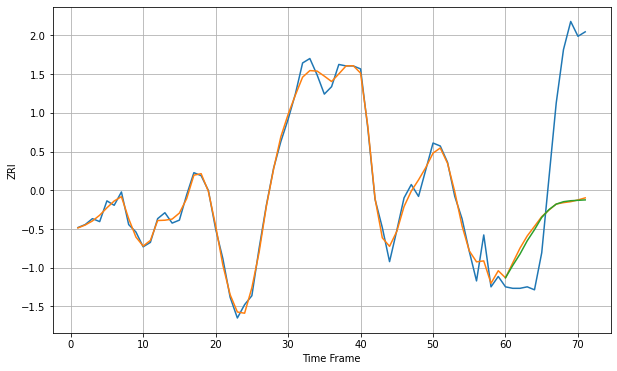

Wall time: 12.5 s
22312 5.172033089774423 70.67397754539637 70.31751907301035 [1697.09173617 1705.45860088 1713.12254703 1722.09246118 1729.54193269
 1737.82755532 1743.10446949 1746.79025399 1748.42019643 1749.07844644
 1749.36397496 1749.64011371]

Got an mse at 0.0099 in round 52 and stopped training

71 71 12


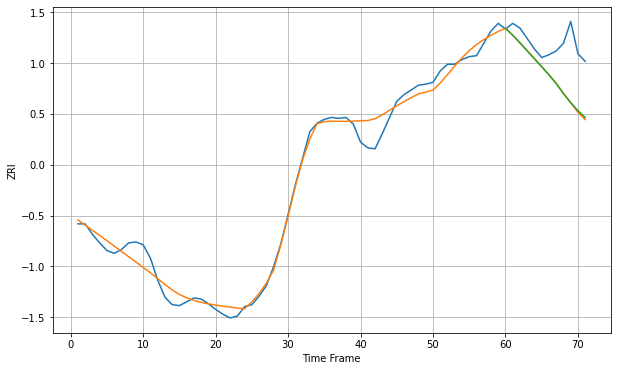

Wall time: 6.31 s
22901 10.50085742589738 40.79961993841042 40.392825633874494 [1279.81822829 1272.52507067 1264.39995905 1256.00172187 1247.65595695
 1239.33652599 1230.79080582 1221.57604541 1210.98079288 1201.58748602
 1193.1349818  1185.96628349]

Got an mse at 0.0098 in round 49 and stopped training

71 71 12


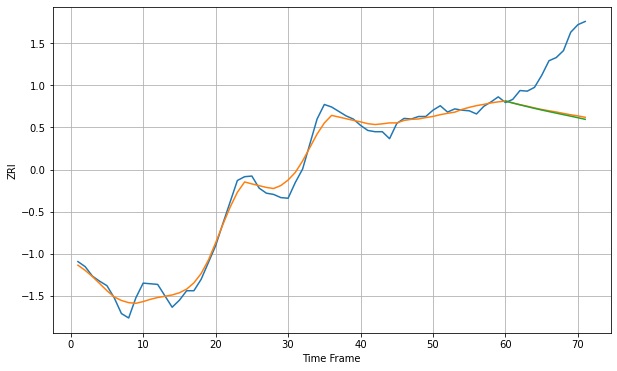

Wall time: 6.32 s
22903 12.845403364419962 86.16344416037992 87.8427558104028 [1430.42359415 1427.36408879 1424.43075934 1421.5779531  1418.84290785
 1416.23314071 1413.73109984 1411.30308757 1408.90830634 1406.50638491
 1404.06221869 1401.54836965]

Got an mse at 0.0099 in round 90 and stopped training

71 71 12


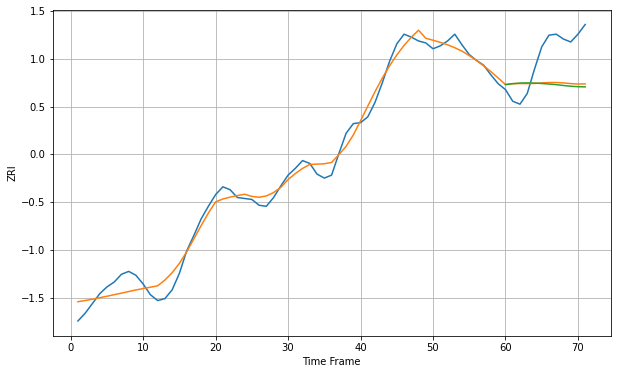

Wall time: 7.09 s
23220 9.760031238841215 38.27598963831614 39.98223675866336 [1160.16510002 1161.12137053 1161.72190187 1161.87937849 1161.70798516
 1161.29742332 1160.74232632 1160.10071491 1159.21369783 1158.48159734
 1157.99810905 1157.80567444]

Got an mse at 0.0099 in round 70 and stopped training

71 71 12


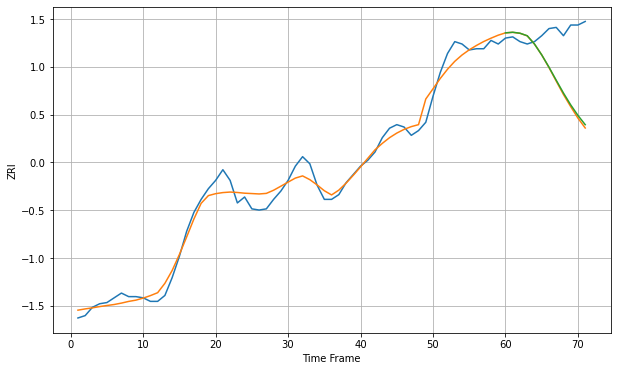

Wall time: 6.68 s
23223 7.981729314851053 45.608137580133715 44.438050917703144 [1147.39471706 1147.90622195 1147.09566052 1144.95886752 1137.93721973
 1128.80130075 1118.48770725 1107.47320724 1096.64311073 1086.66103059
 1077.76721772 1069.97794486]

Got an mse at 0.0099 in round 110 and stopped training

71 71 12


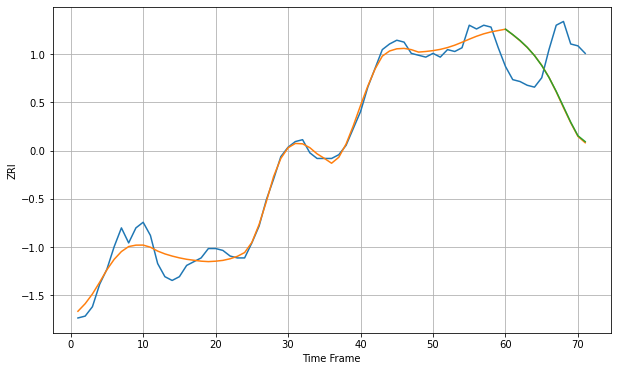

Wall time: 7.4 s
23294 5.100216849010237 31.776501317288123 31.56557310576014 [1092.88425918 1090.00964626 1086.89088819 1083.21924993 1078.83252175
 1073.53693958 1067.17148267 1059.74663792 1051.5881638  1043.32090226
 1036.07943748 1032.96557923]

Got an mse at 0.0099 in round 119 and stopped training

71 71 12


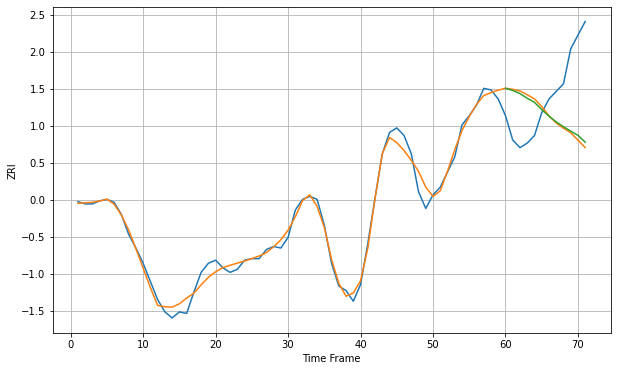

Wall time: 7.9 s
23451 4.818216877176501 41.37123738415463 39.6826861596808 [1205.06962768 1203.65339207 1201.55909952 1198.47878522 1195.78926317
 1191.05059639 1186.70541349 1182.95673027 1179.76682746 1176.89727945
 1174.12269196 1169.63962086]

Got an mse at 0.0099 in round 98 and stopped training

71 71 12


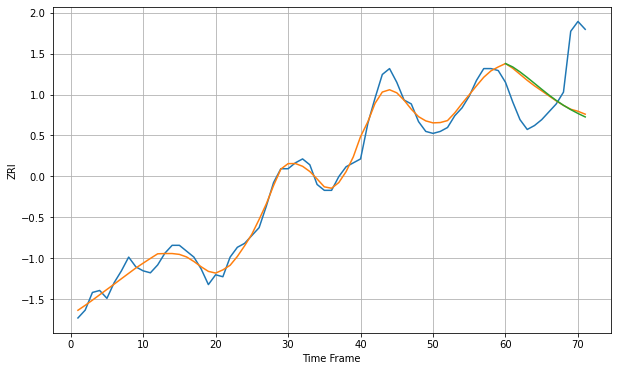

Wall time: 7.22 s
23452 4.1116581331653625 25.52576557638194 26.29769723857505 [1206.5627313  1204.83623882 1202.32108895 1199.47581547 1196.4803548
 1193.46241292 1190.52928979 1187.78581778 1185.3083612  1183.11206569
 1181.15823304 1179.38656152]

Got an mse at 0.0099 in round 158 and stopped training

71 71 12


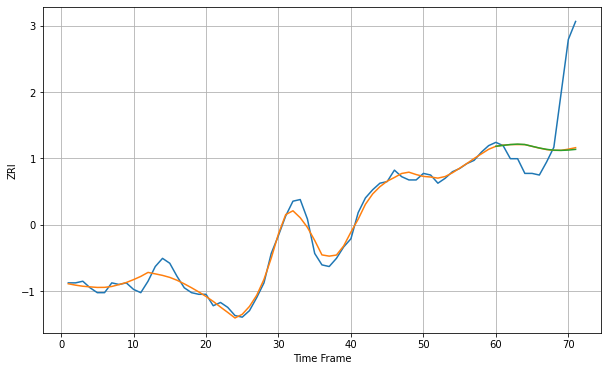

Wall time: 8.35 s
23454 4.019347163574136 32.61978346661547 32.94309926809157 [1159.597333   1160.15908122 1160.65113688 1160.9454791  1160.67040107
 1159.60331163 1158.55424795 1157.71816404 1157.21811707 1157.08283022
 1157.26933676 1157.69956077]

Got an mse at 0.0100 in round 208 and stopped training

71 71 12


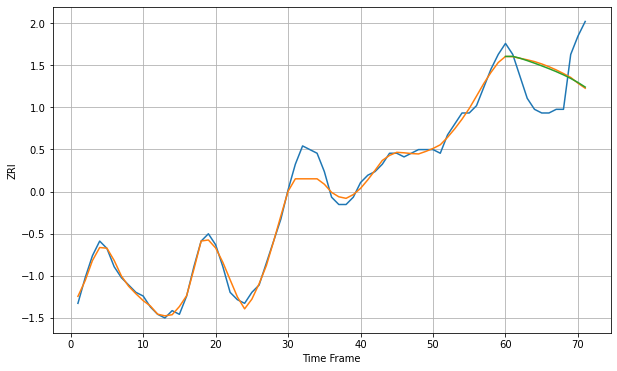

Wall time: 9.55 s
23503 2.2927400579984334 10.827131185323195 10.544700527090162 [829.44283805 829.46589195 828.96158873 828.30325805 827.60731863
 826.87686774 826.11026013 825.29569837 824.41319746 823.43669474
 822.33619195 821.08073548]

Got an mse at 0.0100 in round 151 and stopped training

71 71 12


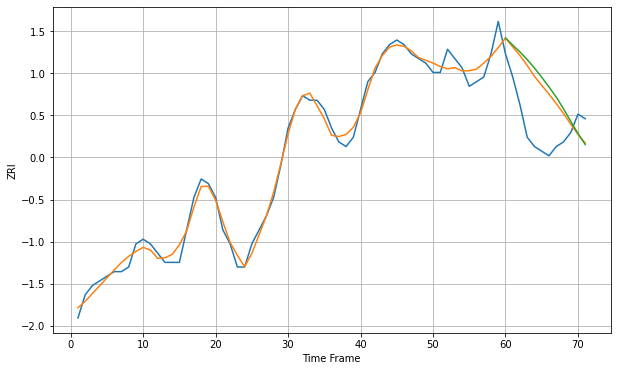

Wall time: 8.29 s
23518 1.7970700485379418 9.964254351257937 11.007131397859792 [827.42519346 825.90125073 824.42066002 822.76823301 820.94324553
 818.96936805 816.87254305 814.68270105 812.15679564 809.4637034
 806.83069535 804.44667753]

Got an mse at 0.0099 in round 111 and stopped training

71 71 12


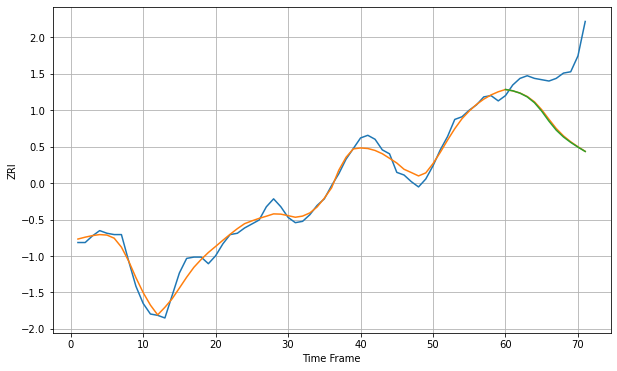

Wall time: 7.77 s
23602 5.433498028253981 43.68555562227841 44.1056063000761 [1007.61833328 1006.64294734 1004.86119582 1002.03062021  997.60976166
  991.20733134  983.66170477  976.91723054  971.74414545  967.63958834
  964.07494237  960.78871984]

Got an mse at 0.0099 in round 72 and stopped training

71 71 12


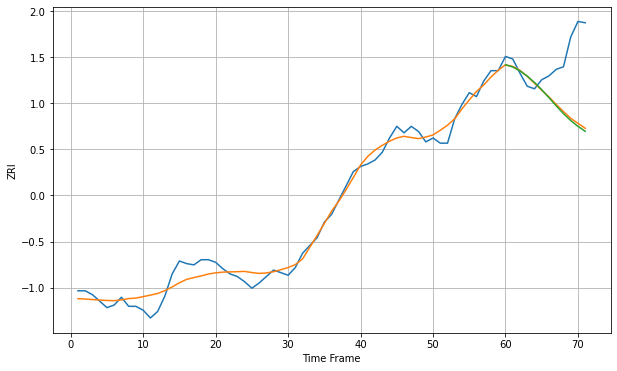

Wall time: 6.86 s
23666 7.067342700937044 39.99033906513472 41.192104182504856 [1065.53440056 1063.86365026 1060.79433561 1056.76524838 1051.88450509
 1046.26526588 1040.12406619 1033.83547483 1027.84646571 1022.48361981
 1017.98681983 1014.18951713]

Got an mse at 0.0099 in round 110 and stopped training

71 71 12


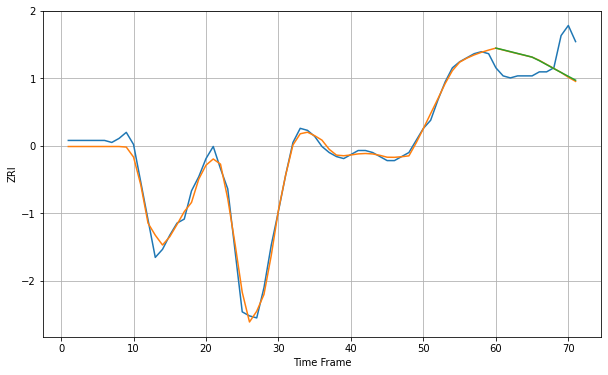

Wall time: 7.37 s
23803 3.3095708597072444 13.440370974272371 13.317667481112899 [931.76982213 930.92805627 930.02931231 929.12451766 928.2242051
 927.2987769  925.53043792 923.56920133 921.61946848 919.69042392
 917.78008116 915.85672391]

Got an mse at 0.0099 in round 116 and stopped training

71 71 12


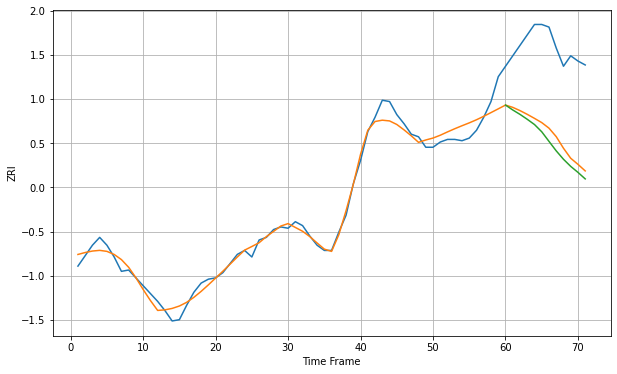

Wall time: 7.89 s
23831 6.681815310725879 66.43417964692797 72.54364301796367 [1074.28697358 1070.549218   1067.1625284  1063.40860287 1059.39125416
 1053.8518266  1046.51306567 1039.23405072 1032.80225331 1027.34255123
 1022.76253065 1017.76816103]

Got an mse at 0.0098 in round 113 and stopped training

71 71 12


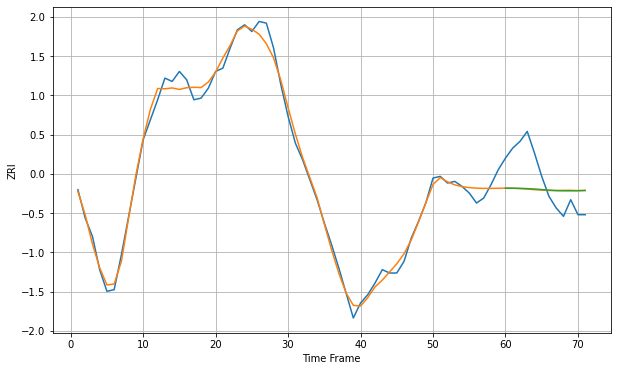

Wall time: 7.77 s
26003 4.650539142595126 18.88595113910978 18.747061538556757 [813.93183485 813.8894072  813.80413605 813.64614227 813.40632974
 813.084717   812.71010102 812.44730735 812.34604783 812.33316881
 812.40263274 812.53358696]
71 71 12


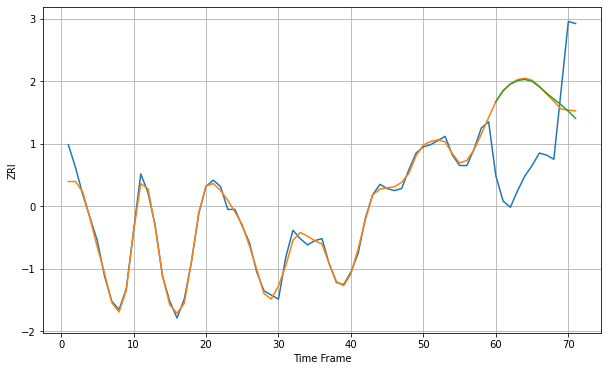

Wall time: 14.9 s
26505 3.234867391156242 41.34023413494632 41.603866470614705 [973.60041085 978.97293721 981.98055424 983.71565104 984.24112236
 983.28055369 980.71814669 977.66642014 974.85113495 972.06109491
 968.99736677 965.58250427]

Got an mse at 0.0094 in round 36 and stopped training

71 71 12


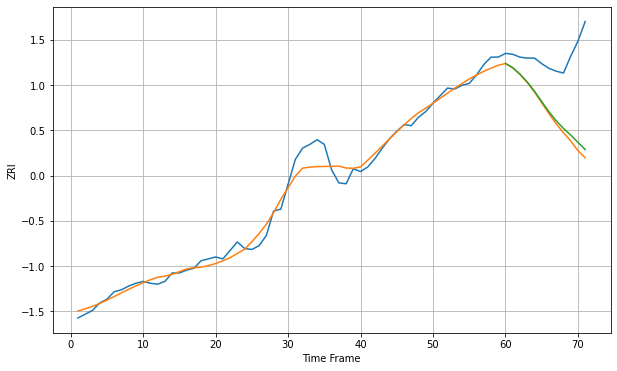

Wall time: 6.02 s
27513 9.236851579263165 68.79511879710803 64.4898795826947 [1190.2302019  1185.76856006 1178.89964284 1170.5700668  1160.65830615
 1149.64521547 1138.74872398 1129.13717408 1121.02598743 1113.9708842
 1106.14501807 1098.50171609]

Got an mse at 0.0098 in round 36 and stopped training

71 71 12


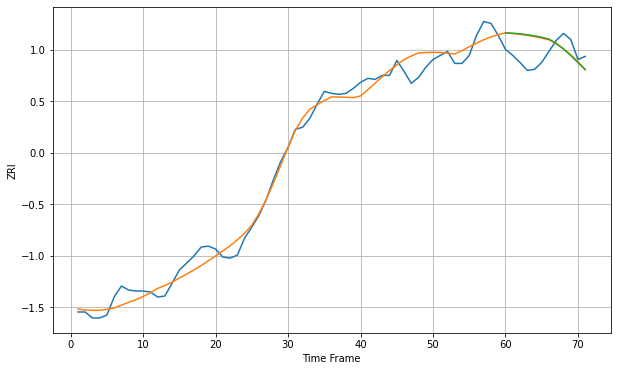

Wall time: 5.94 s
27560 10.073265965834457 20.910724496176893 21.34955366917336 [1324.56878606 1324.21802036 1323.6007661  1322.73856013 1321.60310793
 1320.15096547 1318.32282639 1314.10673935 1308.47807449 1301.93955809
 1294.81963987 1287.76058498]

Got an mse at 0.0092 in round 28 and stopped training

71 71 12


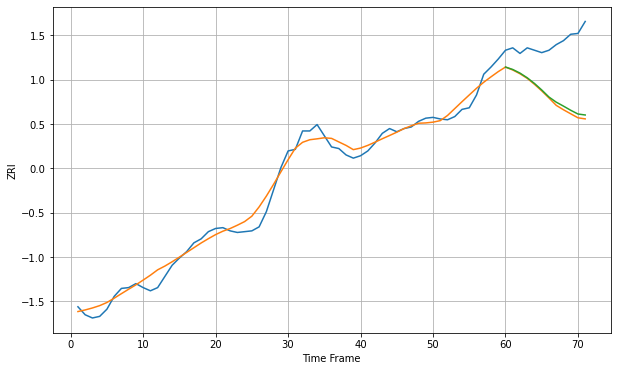

Wall time: 5.88 s
27606 10.22993881337458 70.79767510847257 67.89276694419364 [1175.95932542 1172.93126793 1168.38610379 1162.52719077 1155.42067136
 1147.27608385 1138.44007198 1132.04511482 1127.07335015 1121.88797343
 1117.21495405 1115.98283264]

Got an mse at 0.0097 in round 50 and stopped training

71 71 12


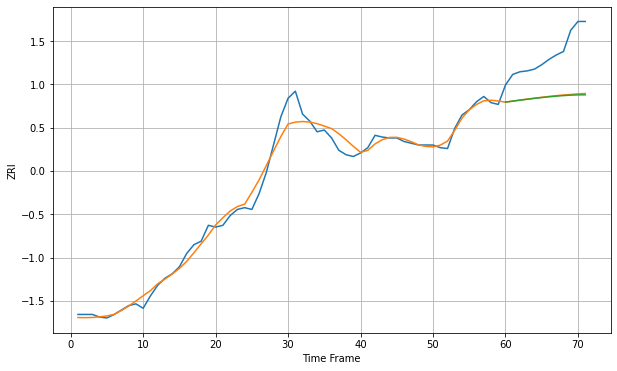

Wall time: 6.23 s
27609 9.551704213404168 50.63742382101511 51.27397520155809 [1114.61780525 1115.71500756 1116.79304032 1117.83865352 1118.83609166
 1119.76973153 1120.62289872 1121.37653725 1122.00833332 1122.49275842
 1122.80232495 1122.91018377]

Got an mse at 0.0095 in round 39 and stopped training

71 71 12


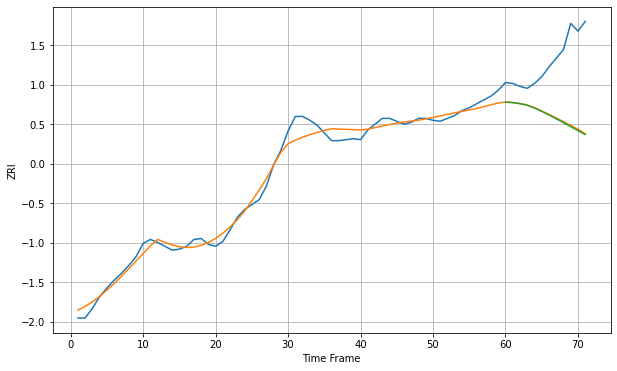

Wall time: 6.03 s
27612 7.828238538519353 64.3910362046852 65.11059527175617 [1079.85282975 1079.29210043 1078.16462747 1076.59130142 1073.67616125
 1070.16764425 1066.44653103 1062.56748742 1058.56036083 1054.46539849
 1050.36027404 1046.36849026]

Got an mse at 0.0096 in round 27 and stopped training

71 71 12


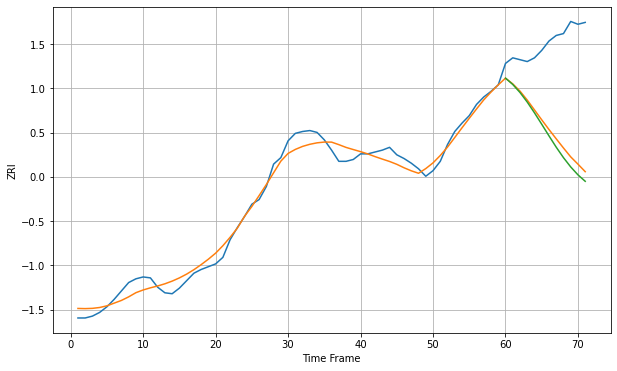

Wall time: 6.04 s
27613 9.125941986693727 99.21422785678524 106.38688762076112 [1132.19970905 1125.4386494  1116.83378077 1106.56618804 1095.00800628
 1082.77077824 1070.30932175 1058.17328186 1046.94314624 1036.98037833
 1028.48544224 1021.59015   ]

Got an mse at 0.0100 in round 101 and stopped training

71 71 12


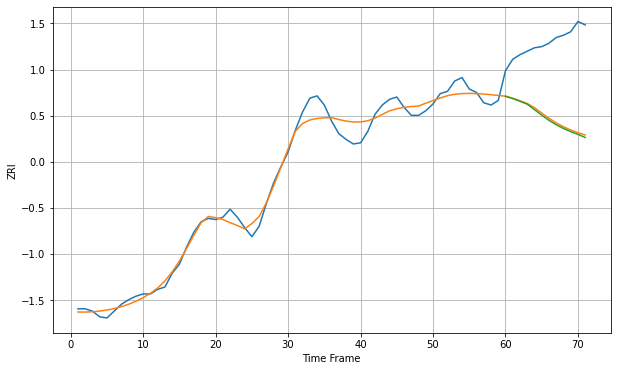

Wall time: 7.19 s
27615 8.014961294515103 66.94009066843243 68.303024368854 [1107.71465246 1105.5993329  1103.2494274  1100.74723213 1095.94367896
 1091.12137275 1086.6489504  1082.77029779 1079.52708729 1076.78219691
 1074.31755157 1071.68421387]

Got an mse at 0.0099 in round 91 and stopped training

71 71 12


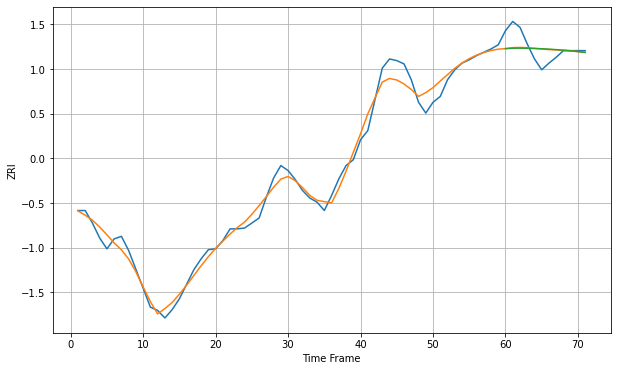

Wall time: 6.96 s
27703 10.616466957519844 16.314788758687747 16.63308598654812 [1098.37939307 1098.88339432 1098.94801212 1098.83619358 1098.59161421
 1098.23114905 1097.76109635 1097.18384666 1096.50126476 1095.71619425
 1094.83298999 1093.8576066 ]

Got an mse at 0.0099 in round 98 and stopped training

71 71 12


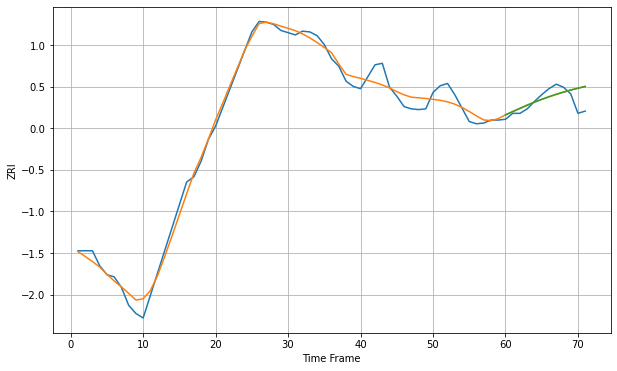

Wall time: 7.29 s
27705 11.029475982372182 15.233964942172602 15.038929353075778 [1218.92045222 1223.231014   1227.60909769 1231.84838212 1235.90191208
 1239.7237152  1243.28169801 1246.55695158 1249.54054614 1252.22959202
 1254.6241562  1256.72559305]

Got an mse at 0.0099 in round 53 and stopped training

71 71 12


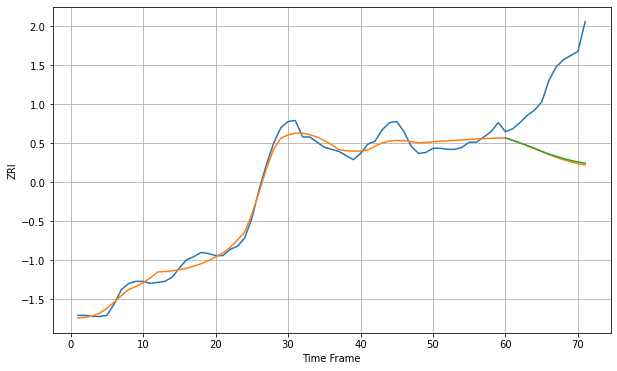

Wall time: 6.31 s
27707 7.441788699945684 75.94549836034201 75.09370660370767 [1034.09414803 1031.68408453 1029.22285665 1026.62483571 1023.91618862
 1020.98973946 1018.49616348 1016.22066793 1014.13220617 1012.313187
 1010.79098674 1009.50980798]

Got an mse at 0.0096 in round 37 and stopped training

71 71 12


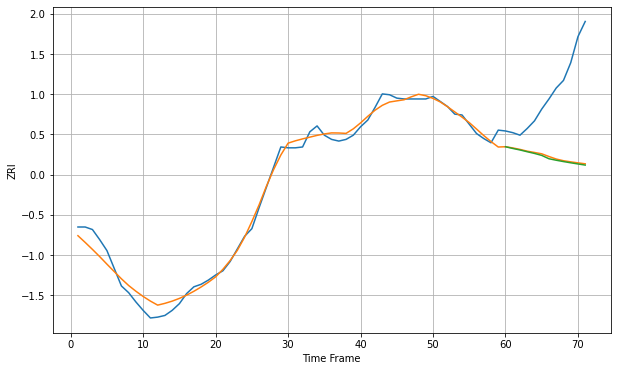

Wall time: 6.06 s
27713 9.145027683328182 87.38886676735716 88.49986254757472 [1041.27905034 1039.25212152 1037.45319521 1035.35104232 1033.34324064
 1031.00257679 1027.0209635  1025.25065815 1023.67341015 1022.22221536
 1020.84703112 1019.50610851]

Got an mse at 0.0100 in round 81 and stopped training

71 71 12


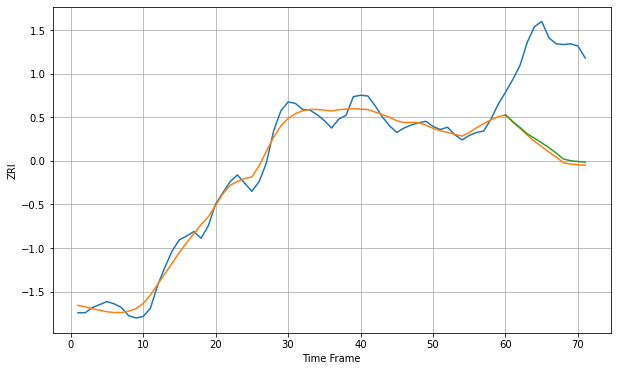

Wall time: 6.85 s
28202 11.624621617610503 136.20206774764796 132.3250531513873 [1503.68518488 1494.67361128 1486.79282433 1478.22048735 1472.33033235
 1466.14551088 1459.55486623 1452.30399291 1444.31727804 1442.0854216
 1441.00638874 1440.06008461]

Got an mse at 0.0100 in round 97 and stopped training

71 71 12


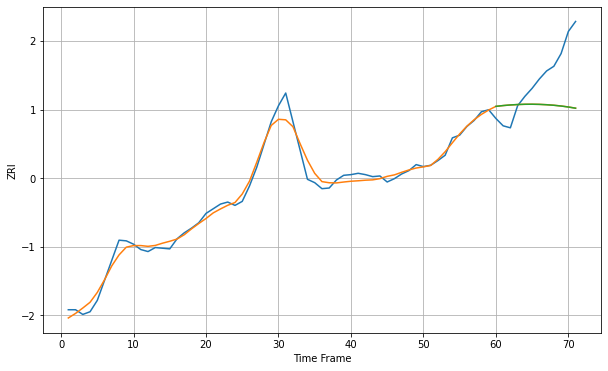

Wall time: 7.06 s
28210 10.137694292943184 62.013882191180414 62.07165036828815 [1287.07109773 1288.2735675  1289.19342517 1289.83224973 1290.1867642
 1290.25298362 1290.02724949 1289.50583403 1288.68326907 1287.55051961
 1286.09485275 1284.3031297 ]

Got an mse at 0.0097 in round 73 and stopped training

71 71 12


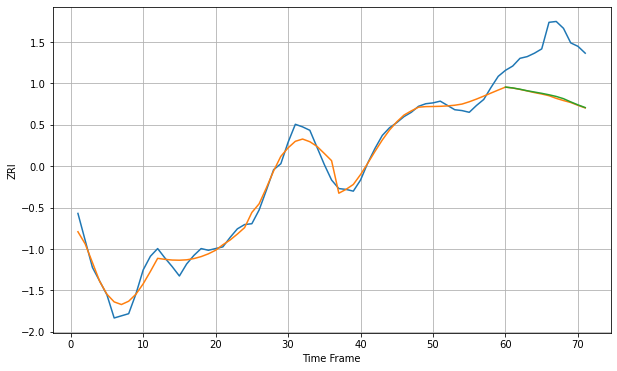

Wall time: 6.7 s
28216 9.405328011343718 61.24373194460607 60.31600684973328 [1258.40490229 1257.44100952 1255.92922162 1254.14035316 1252.63717344
 1251.14121168 1249.44239712 1247.50069494 1244.90903793 1241.15458194
 1237.67103597 1234.53013058]

Got an mse at 0.0098 in round 31 and stopped training

71 71 12


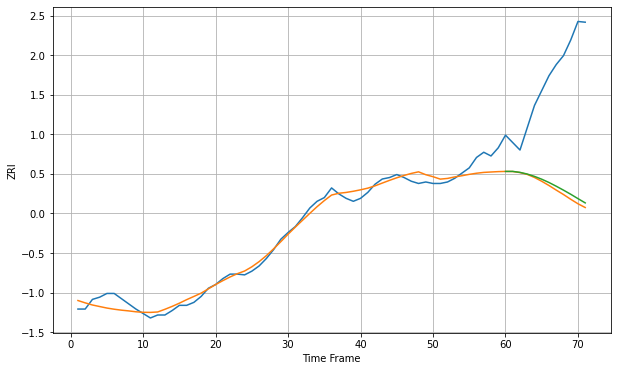

Wall time: 6.32 s
28262 10.196830105626656 154.54257999226473 150.33837338570967 [1034.21770563 1034.24477074 1032.91037324 1030.69068516 1027.53325631
 1023.73031558 1019.29977508 1014.297815   1009.02176163 1003.48209524
  997.61156027  991.86046555]

Got an mse at 0.0100 in round 105 and stopped training

71 71 12


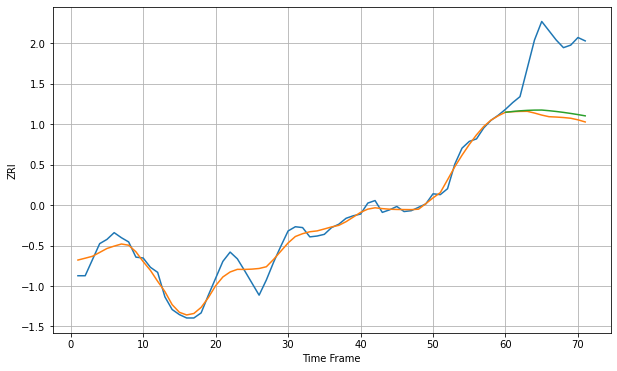

Wall time: 7.2 s
28269 9.512754695400204 78.77370986206908 73.86512162282152 [1152.53746919 1153.4277847  1154.21824147 1154.75674105 1155.05965374
 1155.13648276 1154.37492202 1153.4511009  1152.35775858 1151.11981333
 1149.7532803  1148.26774773]

Got an mse at 0.0099 in round 81 and stopped training

71 71 12


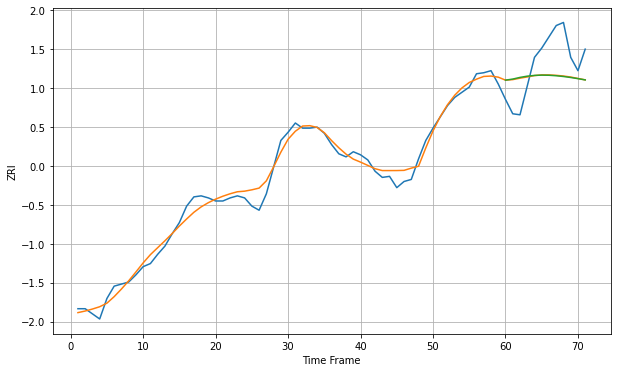

Wall time: 7.18 s
28273 7.493492443183182 31.07551714993191 31.411726322971948 [1212.78834138 1213.82491528 1215.44551516 1216.66690833 1217.39007304
 1217.66196321 1217.53708325 1217.07215341 1216.32642538 1215.3610683
 1214.23576868 1213.00291935]

Got an mse at 0.0096 in round 47 and stopped training

71 71 12


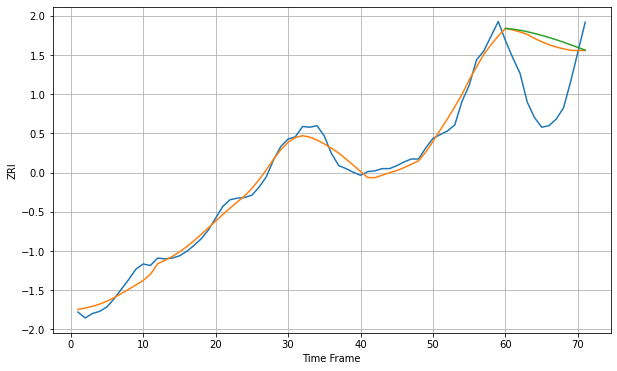

Wall time: 6.42 s
28277 10.239052490343928 75.91793403157497 81.73365943483734 [1426.64071722 1425.63667652 1424.19565962 1422.14227145 1419.80030735
 1417.19934016 1414.35077013 1411.26606391 1407.96289858 1404.47145508
 1400.83988209 1397.13612676]

Got an mse at 0.0099 in round 412 and stopped training

71 71 12


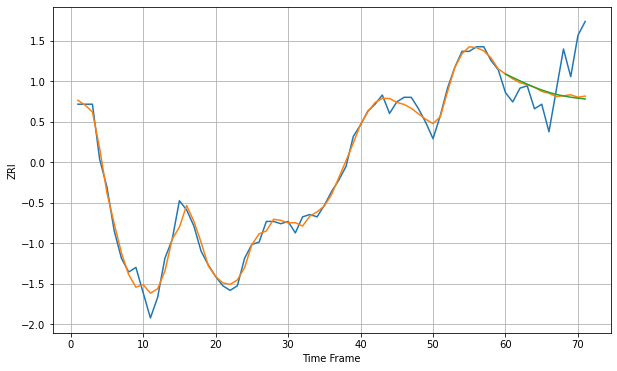

Wall time: 13.2 s
29205 3.5035765704051705 15.373989230114791 15.802921568557469 [828.14434858 826.63472267 825.15074939 823.71992385 822.38601725
 821.18715681 820.15031574 819.28667316 818.59057424 818.0428393
 817.61657177 817.28294005]

Got an mse at 0.0099 in round 93 and stopped training

71 71 12


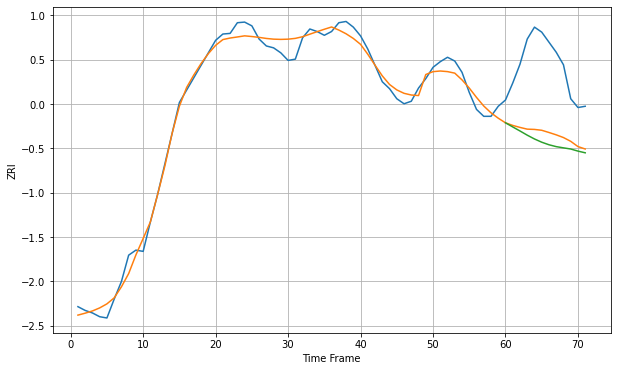

Wall time: 7.13 s
29403 13.969823127625816 112.52443120659527 124.74499080167743 [1786.65827271 1780.09629929 1773.65724474 1767.00627784 1760.94499293
 1755.79973624 1751.72600759 1748.74983818 1746.80194885 1744.96414942
 1741.64063016 1738.92143599]

Got an mse at 0.0100 in round 69 and stopped training

71 71 12


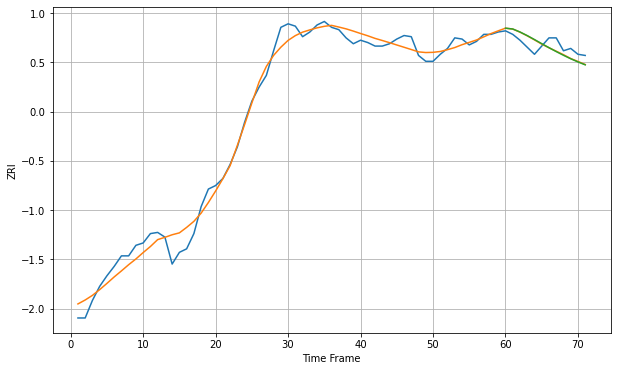

Wall time: 6.62 s
29414 8.369469095574862 7.663898028895709 7.864940916302375 [1334.26707263 1333.57046399 1331.00892956 1327.93245525 1324.55774958
 1321.08513893 1317.63062618 1314.29550691 1311.13729397 1308.18662083
 1305.46515282 1302.99417751]

Got an mse at 0.0099 in round 115 and stopped training

71 71 12


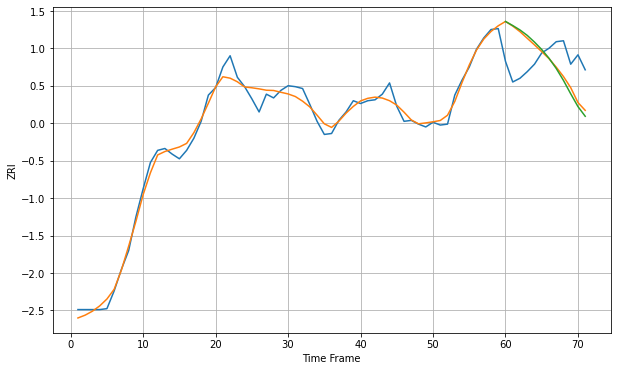

Wall time: 7.79 s
29464 7.930296596274326 37.59521621079238 40.21893274779497 [1581.61405395 1577.26167353 1572.52961961 1566.73116467 1559.60181909
 1551.62741181 1542.37196192 1531.44230581 1518.66851461 1504.3525326
 1490.72873828 1480.39366351]

Got an mse at 0.0098 in round 52 and stopped training

71 71 12


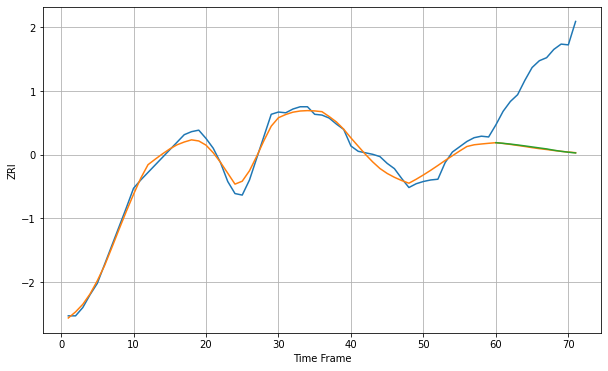

Wall time: 6.19 s
29607 8.22411626900468 110.2892057377401 109.97166206669102 [990.39465417 989.5760949  988.5596243  987.40004157 986.1269039
 984.78912691 983.44660925 982.15763107 980.43407343 978.98204267
 977.78786378 976.81001342]

Got an mse at 0.0100 in round 92 and stopped training

71 71 12


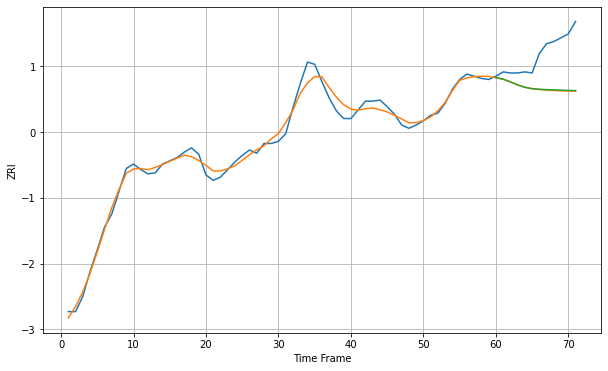

Wall time: 6.91 s
29615 5.984914527276388 35.25181019299054 34.90725212240071 [1002.74790292 1001.2968553   998.79940835  996.01918963  993.8385634
  992.5646601   991.95195415  991.66083258  991.44432782  991.18347079
  990.9131048   990.77069837]

Got an mse at 0.0099 in round 47 and stopped training

71 71 12


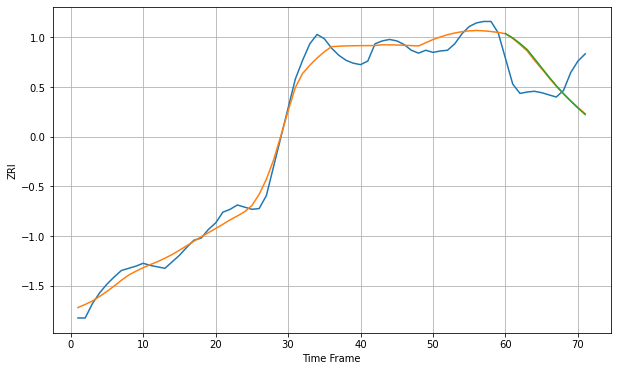

Wall time: 6.19 s
30024 13.57550844010556 49.550235330399474 50.57687740496007 [1479.0476733  1473.10337352 1465.49563587 1456.86112449 1444.36029616
 1431.5886085  1418.98716284 1406.86756641 1395.75332754 1385.4478505
 1375.65489427 1366.63928135]

Got an mse at 0.0098 in round 57 and stopped training

71 71 12


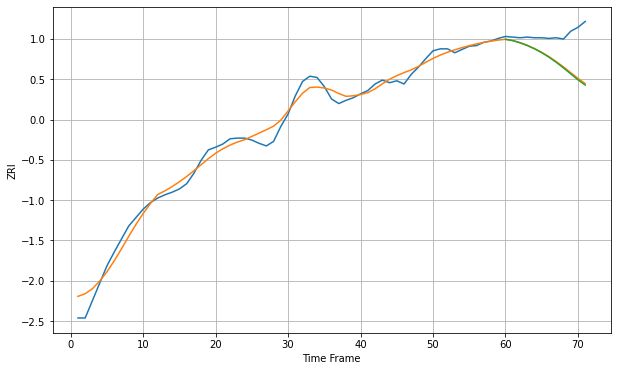

Wall time: 6.37 s
30043 11.980120253491593 44.96728033551342 46.15988357700541 [1296.60808635 1294.70583764 1291.34401206 1287.14627912 1282.07745834
 1276.09585945 1269.17648434 1261.34555299 1252.73519107 1243.63319281
 1234.47114717 1226.42461666]

Got an mse at 0.0099 in round 57 and stopped training

71 71 12


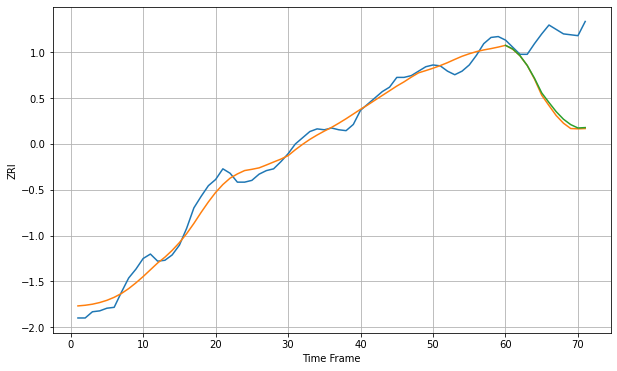

Wall time: 6.25 s
30044 10.125225888528497 76.94531894326013 74.67306462087956 [1138.11381742 1134.06926435 1126.46979213 1115.46726806 1101.04798271
 1084.52604778 1073.7344171  1063.36220477 1054.89765424 1048.791307
 1045.00668975 1045.46567375]

Got an mse at 0.0100 in round 133 and stopped training

71 71 12


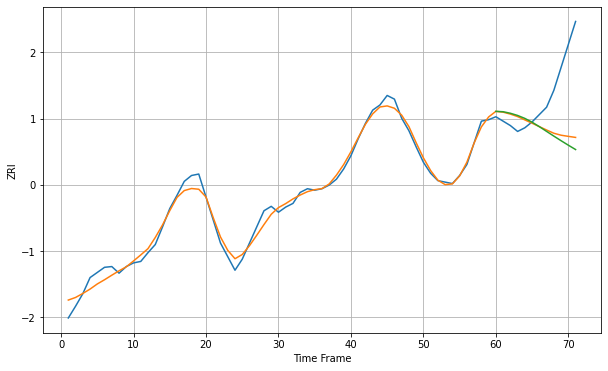

Wall time: 7.65 s
30046 8.917814769753296 67.55474852701762 73.941611724249 [1062.36284583 1061.83355344 1059.74798949 1056.76617404 1052.74771651
 1047.57205856 1041.48334475 1035.05723821 1028.63742732 1022.36456073
 1016.26208205 1010.35384231]

Got an mse at 0.0097 in round 40 and stopped training

71 71 12


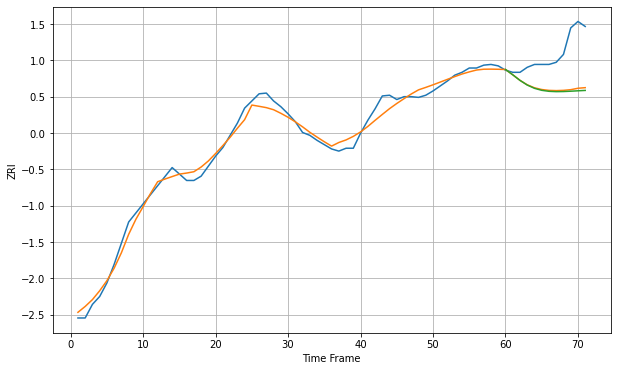

Wall time: 6.11 s
30080 9.766710701170657 51.521767172971856 53.30758640773565 [1251.96567492 1244.56361589 1236.72568874 1230.23968798 1225.64776706
 1222.86380029 1221.47116956 1221.0254892  1221.16753085 1221.62297316
 1222.18654822 1222.71398421]

Got an mse at 0.0098 in round 21 and stopped training

71 71 12


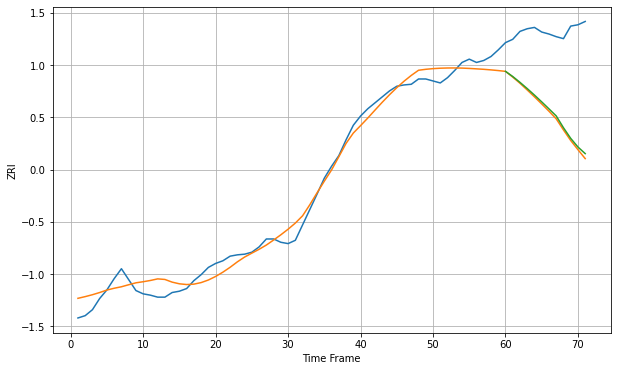

Wall time: 5.66 s
30093 15.349754059711325 128.98467659318442 125.57252567114938 [1121.52559681 1113.74213364 1104.86713942 1095.4600938  1085.59875404
 1075.33668948 1064.7618224  1054.08711921 1036.23989813 1020.14629805
 1007.07265286  997.10461903]

Got an mse at 0.0094 in round 31 and stopped training

71 71 12


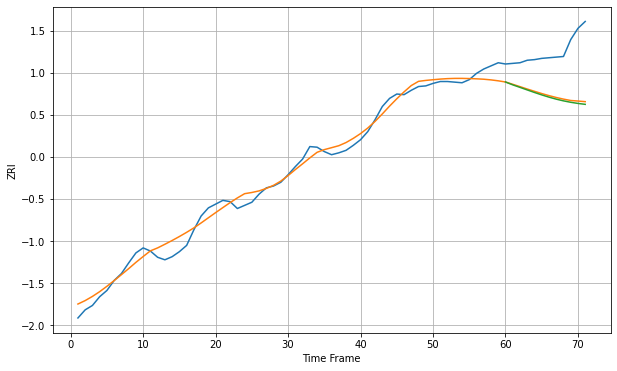

Wall time: 5.96 s
30096 12.524820414842845 72.53116709443167 74.98727592754199 [1248.23713172 1243.65664634 1239.62872676 1235.54511319 1231.49756675
 1227.61408424 1224.01990519 1220.81887723 1218.07698901 1215.81004002
 1213.98252821 1212.52073641]

Got an mse at 0.0095 in round 25 and stopped training

71 71 12


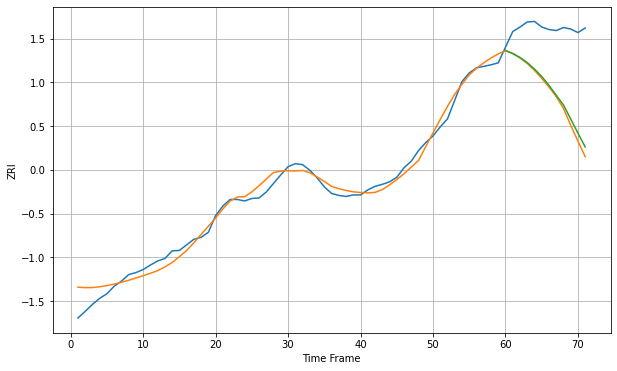

Wall time: 6.06 s
30097 16.52550259611502 140.26380646257763 132.3687656109407 [1501.28028674 1495.43187156 1487.61514599 1477.37156174 1464.7232754
 1449.88416275 1432.40528489 1412.70847085 1393.36384147 1365.57279344
 1337.29183951 1310.12109696]

Got an mse at 0.0099 in round 65 and stopped training

71 71 12


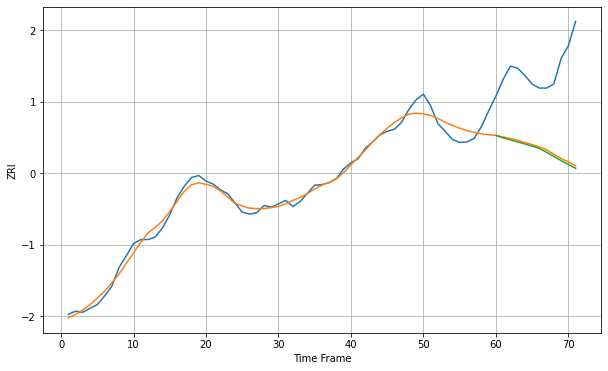

Wall time: 6.53 s
30305 13.889050825683295 160.46229394961546 164.00118921163266 [1652.86157989 1647.93165375 1644.00665782 1640.01316469 1636.00108814
 1632.03730811 1627.27276617 1619.56041676 1611.40414209 1603.41964961
 1595.69261595 1588.31288718]

Got an mse at 0.0096 in round 71 and stopped training

71 71 12


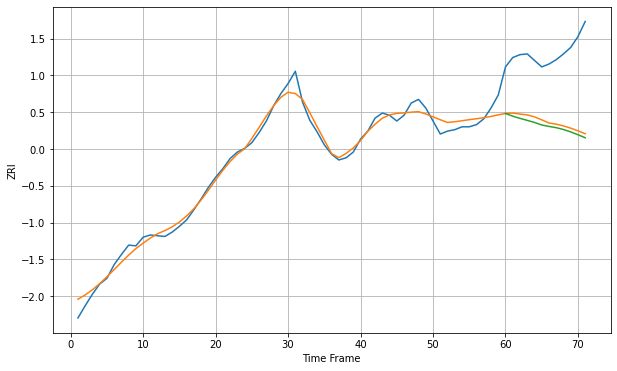

Wall time: 6.5 s
30306 9.906725035094397 97.43585077178457 102.64655742672618 [1427.44516144 1423.7506165  1420.71799196 1417.8892857  1415.05446667
 1411.49769492 1409.51722326 1407.7898156  1405.22734263 1401.90315128
 1398.01782244 1393.7961439 ]

Got an mse at 0.0096 in round 38 and stopped training

71 71 12


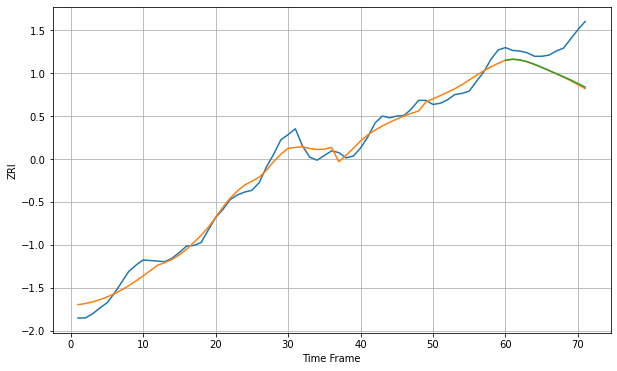

Wall time: 6.12 s
30308 14.1882261670179 53.307088068147905 52.24946759311959 [1629.2789023  1630.95970522 1629.71859317 1626.56358592 1622.11173167
 1616.93234986 1611.54645576 1606.21834564 1600.86759038 1595.24705479
 1589.09445621 1582.95760732]

Got an mse at 0.0098 in round 53 and stopped training

71 71 12


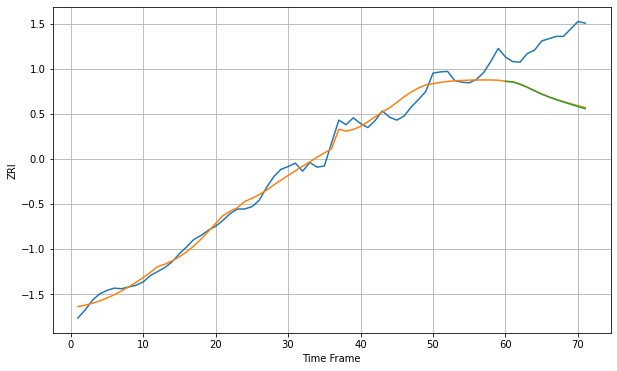

Wall time: 6.17 s
30309 15.358852443209598 98.78329232939032 99.43881154150704 [1613.65936056 1612.56936455 1608.71122668 1603.27459171 1597.15766502
 1591.35986911 1586.26436925 1581.74585867 1577.57870195 1573.59894035
 1569.71148359 1565.87165618]

Got an mse at 0.0100 in round 90 and stopped training

71 71 12


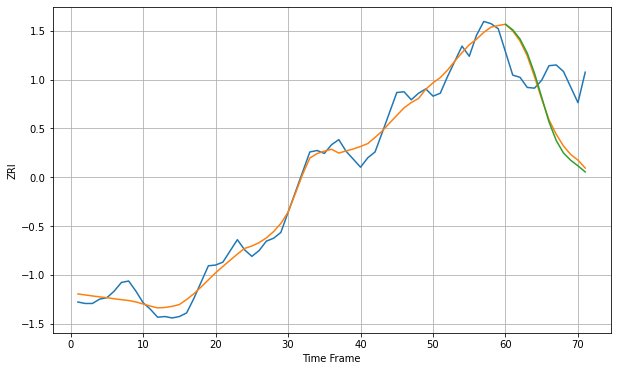

Wall time: 6.94 s
30310 13.37994210986041 75.3912936489277 80.39979763842668 [1200.14024064 1192.39574863 1179.85568757 1160.40378556 1132.56308182
 1099.39729384 1065.51222175 1039.79045036 1022.62278764 1012.50279384
 1004.86148845  996.46937892]

Got an mse at 0.0091 in round 42 and stopped training

71 71 12


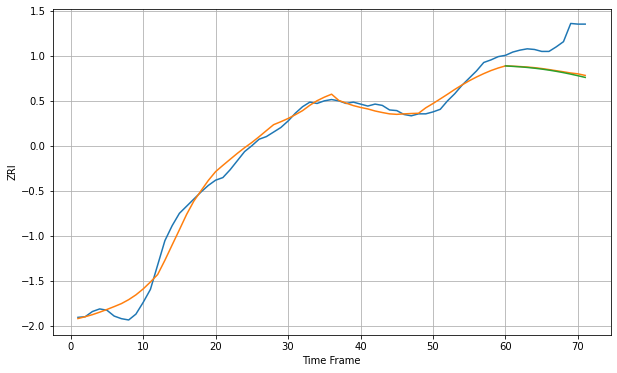

Wall time: 6.08 s
30318 12.739502893061907 46.34849897386024 47.774305848657974 [1428.76227115 1428.01858397 1427.33522511 1426.38368893 1425.2274616
 1423.85100468 1422.24511287 1420.40924388 1418.35115397 1416.08606527
 1413.6355896  1411.0265141 ]

Got an mse at 0.0099 in round 69 and stopped training

71 71 12


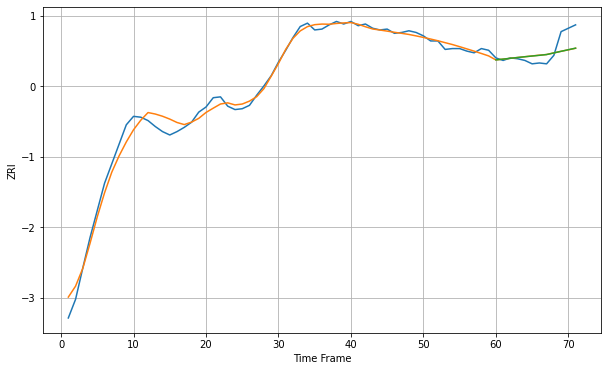

Wall time: 6.59 s
30319 8.194334281196838 13.791742758788393 13.725002124385645 [1565.61808221 1566.54721372 1567.49744776 1568.47023272 1569.35280178
 1570.19411773 1571.02495054 1571.94579556 1573.86422842 1575.77102645
 1577.65842038 1579.51722133]

Got an mse at 0.0100 in round 57 and stopped training

71 71 12


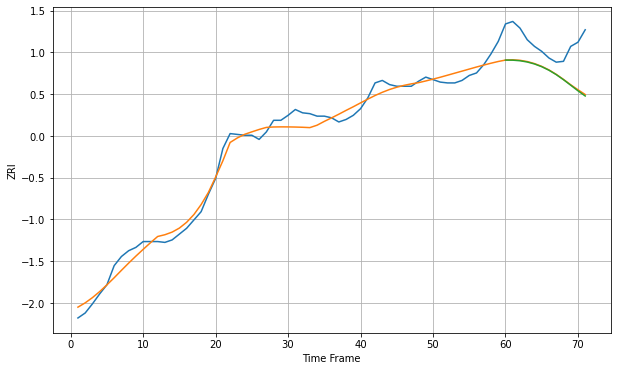

Wall time: 6.39 s
30324 9.964641143960666 40.16296204220762 40.83313964094849 [1486.51502725 1486.40363395 1485.70163461 1484.19709176 1481.82911009
 1478.53377106 1474.26216736 1469.01368854 1462.90276408 1456.23774515
 1449.51541943 1443.27059509]

Got an mse at 0.0099 in round 81 and stopped training

71 71 12


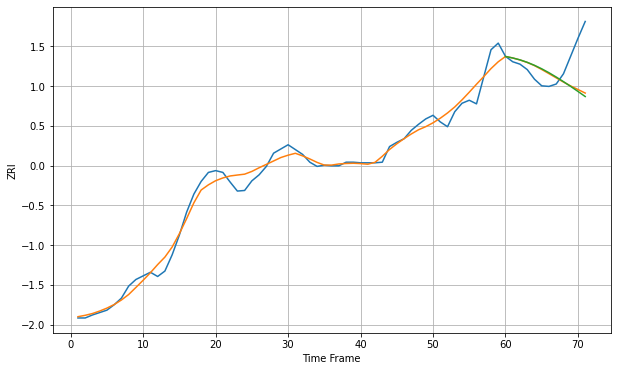

Wall time: 7.04 s
30326 13.071129822991086 46.63888567595552 48.58535020665219 [1656.77205382 1654.28745165 1651.15712929 1647.06450493 1642.08925806
 1636.28531244 1629.74174121 1622.5820582  1614.9437419  1606.94889184
 1598.68154649 1590.18196835]

Got an mse at 0.0097 in round 68 and stopped training

71 71 12


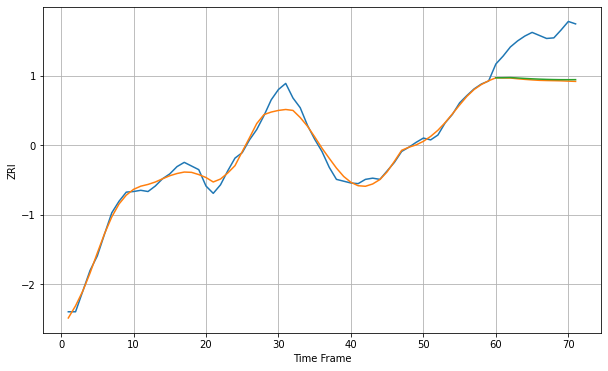

Wall time: 6.75 s
30328 11.083641787689936 70.93893465807159 69.22841676332774 [1515.25141687 1515.38571406 1515.6427025  1514.92373852 1514.19576342
 1513.56901132 1513.04619348 1512.63385918 1512.33882828 1512.16658966
 1512.12443083 1512.20795932]

Got an mse at 0.0092 in round 38 and stopped training

71 71 12


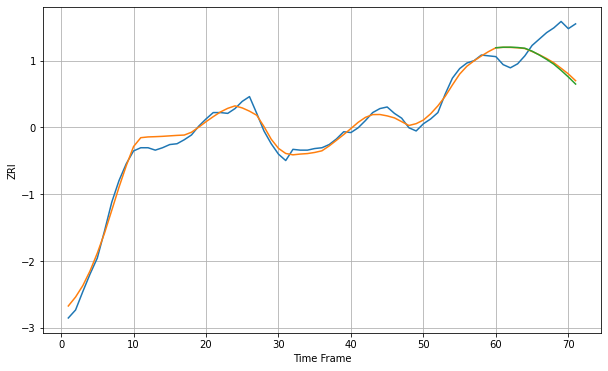

Wall time: 6.53 s
30329 7.67076833321199 37.43554237520201 39.24093446232473 [1494.10080593 1494.7616954  1494.8385292  1494.42495603 1493.48580799
 1489.84301812 1484.97056498 1479.55048148 1473.51476485 1465.83126939
 1457.56004755 1448.6883543 ]

Got an mse at 0.0096 in round 87 and stopped training

71 71 12


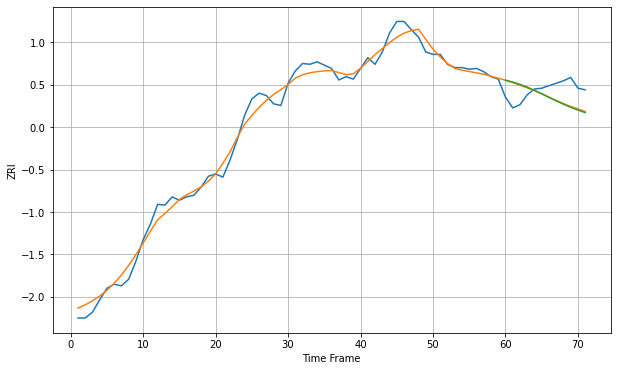

Wall time: 6.86 s
30338 9.777445702606052 22.370709716468514 23.112440050458677 [1447.67108321 1445.47238984 1442.61845026 1439.20080483 1435.33594348
 1431.16795573 1426.86147465 1422.58939586 1418.51232378 1414.75387731
 1411.38522191 1408.4272342 ]

Got an mse at 0.0098 in round 79 and stopped training

71 71 12


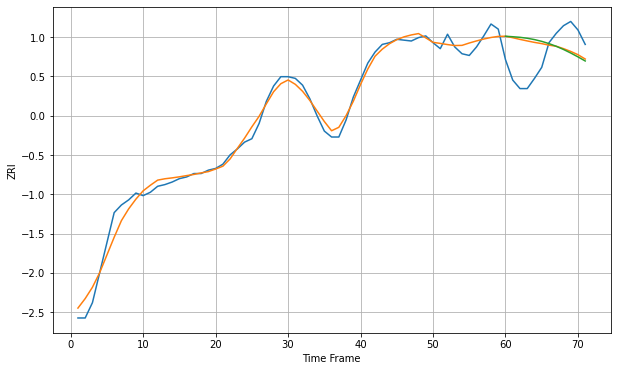

Wall time: 6.79 s
30339 9.057493245509892 36.140801478744145 37.98475302848662 [1404.61792024 1404.02633115 1403.34092591 1402.24102825 1400.66935789
 1398.58443883 1395.95577612 1392.77356211 1389.06064803 1384.87846684
 1380.31924448 1375.48549389]

Got an mse at 0.0100 in round 45 and stopped training

71 71 12


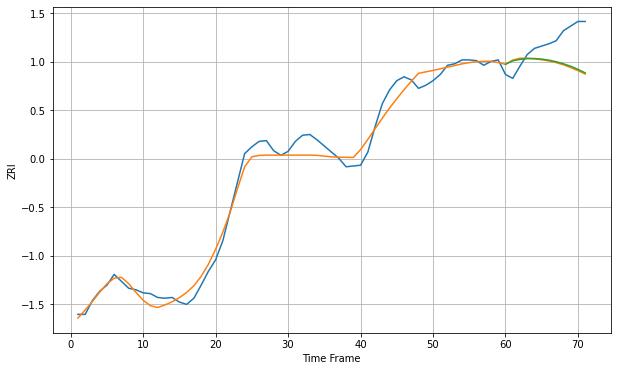

Wall time: 6.12 s
30341 12.467679104156044 36.892604778660385 35.84104005483303 [1372.27850273 1376.78223846 1378.66166003 1379.66181181 1379.76411985
 1379.06208376 1377.64950395 1375.59657511 1372.94064497 1369.69100124
 1365.74356004 1361.05961187]

Got an mse at 0.0100 in round 80 and stopped training

71 71 12


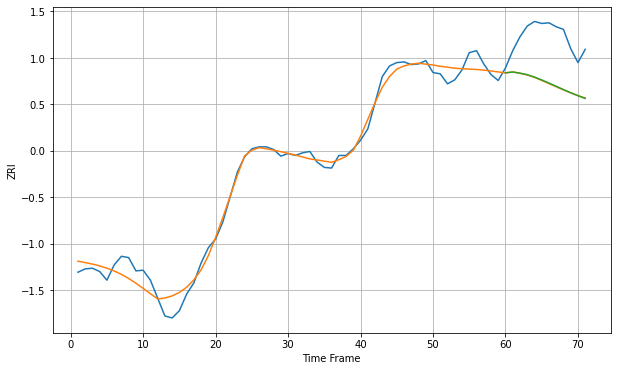

Wall time: 6.83 s
30345 13.931605208459292 71.43594760899086 71.10480246750993 [1482.51094934 1483.83739097 1482.05179402 1479.83905577 1476.14948566
 1471.82618475 1467.15762722 1462.26369631 1457.31763233 1452.51554109
 1448.03294977 1443.98812824]

Got an mse at 0.0092 in round 31 and stopped training

71 71 12


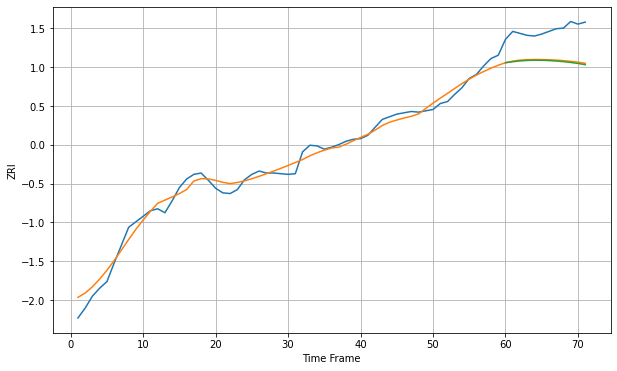

Wall time: 5.93 s
30350 10.877610966546468 46.81773156554859 48.1482473597414 [1316.70833326 1318.16497818 1319.38332655 1320.11681676 1320.40544745
 1320.3204959  1319.92917205 1319.24322196 1318.28750156 1317.06555974
 1315.55740315 1313.72348543]

Got an mse at 0.0097 in round 30 and stopped training

71 71 12


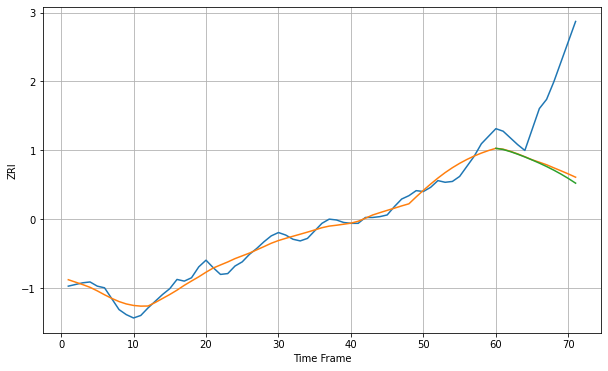

Wall time: 5.92 s
30605 8.064343597285195 91.3067621969992 94.2679349836492 [878.53570498 877.15073902 874.60288772 871.57523155 868.23319377
 864.6585818  860.86306023 856.81275555 852.45107653 847.71555179
 842.55415653 836.94897113]

Got an mse at 0.0099 in round 105 and stopped training

71 71 12


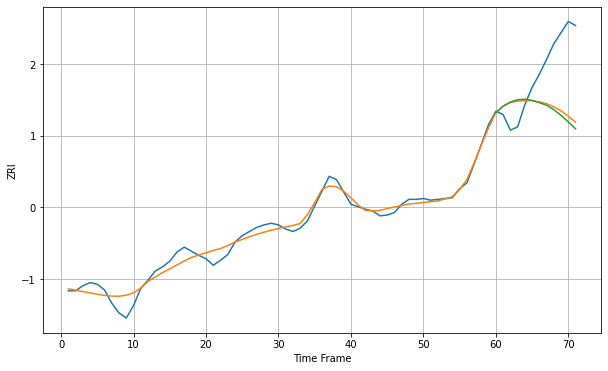

Wall time: 8.19 s
30606 8.629803287459923 63.52049496188924 67.12310610052327 [969.37977383 977.10884225 982.15210321 984.95837243 985.64420511
 984.21419283 981.47594828 978.2379544  972.93159983 965.94609345
 957.97246612 949.6951985 ]

Got an mse at 0.0100 in round 66 and stopped training

71 71 12


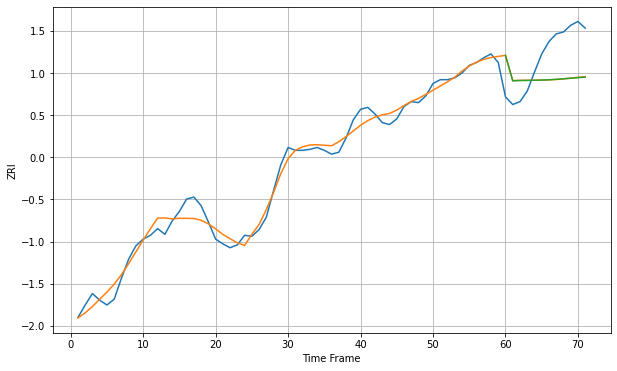

Wall time: 6.65 s
31401 8.770884790501354 40.14239178053825 40.206494457576426 [1393.46873614 1366.73625117 1367.16118625 1367.26129555 1367.39463252
 1367.60248589 1367.9191877  1368.35979368 1368.91164288 1369.53222
 1370.15730898 1370.71786226]
71 71 12


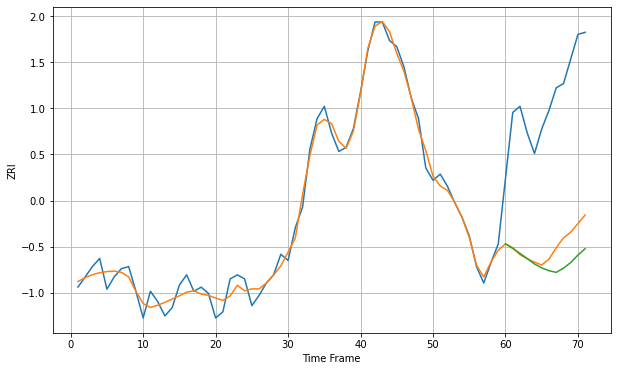

Wall time: 15 s
32204 4.535117410965946 71.80440889085199 79.75735862275955 [993.04526514 990.84245421 988.44744362 985.91683272 983.27943231
 981.38290567 979.98216602 979.19510247 981.22830585 983.97300866
 987.6209623  990.73483596]

Got an mse at 0.0100 in round 104 and stopped training

71 71 12


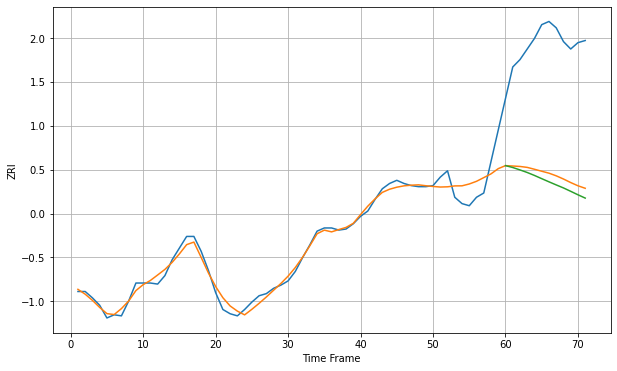

Wall time: 7.3 s
32205 8.238001794199873 122.61869222975072 129.1861284347031 [921.86256238 920.10382087 917.80227502 915.37966193 912.58242938
 909.55195613 906.56468158 903.64452976 900.79751512 897.59955721
 894.33223518 891.21131297]

Got an mse at 0.0099 in round 69 and stopped training

71 71 12


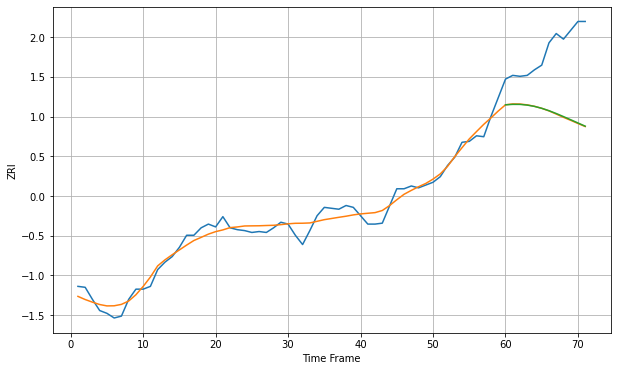

Wall time: 6.57 s
32207 8.456980511162442 71.56935292336041 71.2586128515871 [994.33876345 994.80794843 994.77077021 994.02873854 992.61360916
 990.57817018 987.99772187 984.97498812 981.65903465 978.26552845
 974.79751129 971.34326485]

Got an mse at 0.0100 in round 321 and stopped training

71 71 12


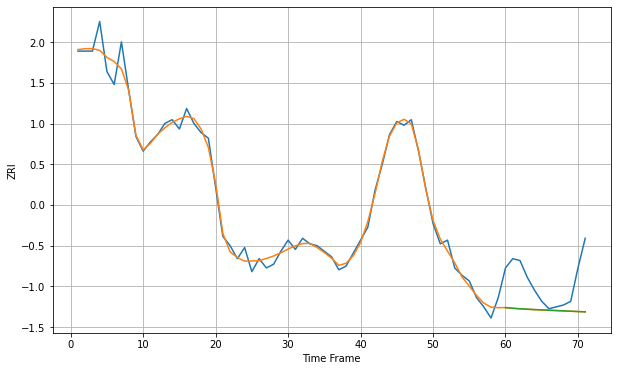

Wall time: 11.1 s
32209 4.370687422861908 19.295310135454066 19.25277738646843 [797.59724806 797.25802613 796.98171555 796.75347083 796.55457825
 796.36977429 796.18844562 796.00595725 795.82350461 795.64627423
 795.4810599  795.33446464]

Got an mse at 0.0098 in round 42 and stopped training

71 71 12


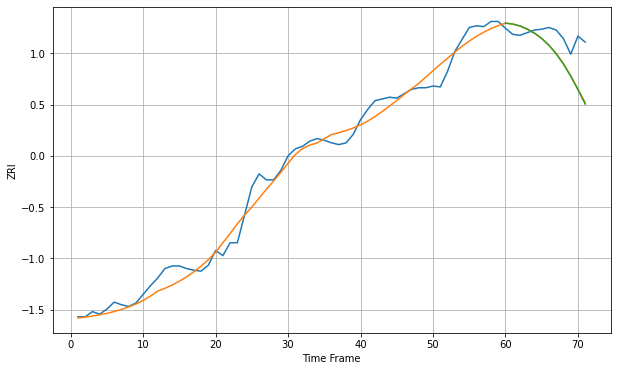

Wall time: 6.05 s
32224 11.673558861530644 31.351298916101793 31.91979046005132 [1333.05883721 1332.01831979 1329.84476155 1326.24825942 1321.42488612
 1315.16111589 1307.21154206 1297.34109969 1285.39074882 1271.39732696
 1255.78903639 1239.02900596]

Got an mse at 0.0096 in round 32 and stopped training

71 71 12


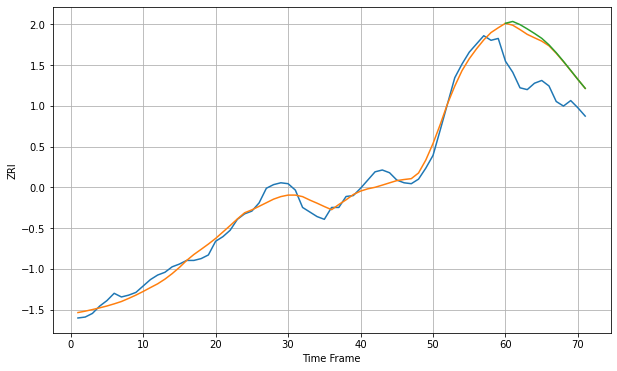

Wall time: 6.2 s
32225 8.52039420339671 46.96785437637779 49.47928846039675 [1193.63101306 1195.60728217 1192.16864845 1187.47513571 1182.49361432
 1177.15449311 1170.00510088 1161.41422913 1151.95073286 1142.00388908
 1132.01802537 1122.39677795]

Got an mse at 0.0098 in round 50 and stopped training

71 71 12


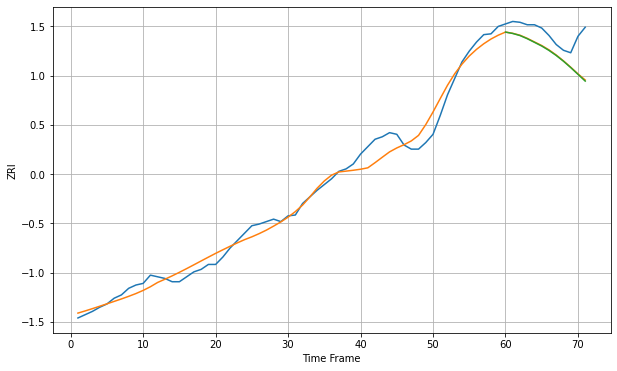

Wall time: 6.04 s
32246 11.602730506649316 27.13984045355942 27.69230435183343 [1324.10341649 1322.42568783 1319.89505132 1316.07533592 1311.65247078
 1307.16128684 1301.85866902 1295.70884002 1288.74204596 1281.03564253
 1272.83608449 1264.59212373]

Got an mse at 0.0099 in round 34 and stopped training

71 71 12


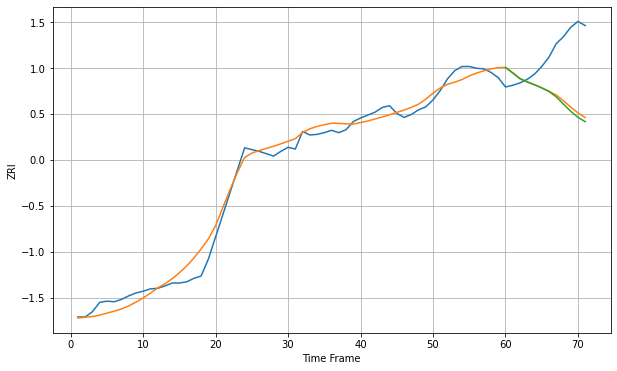

Wall time: 6.11 s
32250 15.326886315390139 88.56743162819284 92.49665046011239 [1403.42280572 1394.02604612 1384.24125163 1378.67463701 1373.81515867
 1368.47534303 1362.4214115  1353.17041172 1340.74806295 1328.45581597
 1318.26823709 1310.69843274]

Got an mse at 0.0096 in round 42 and stopped training

71 71 12


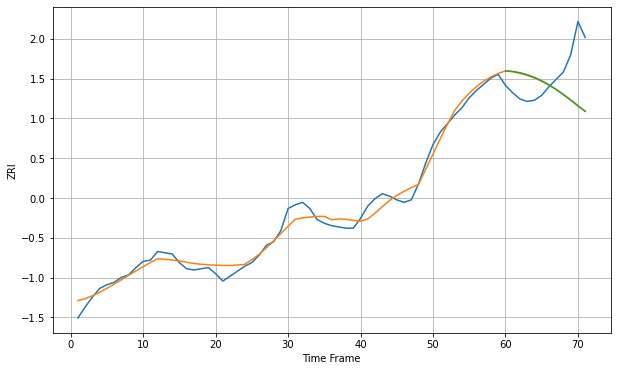

Wall time: 6.4 s
32256 6.238716391645307 31.365823759940692 31.545827674501222 [1233.82098644 1233.411184   1232.34630554 1230.71014738 1228.51373263
 1225.76905773 1222.49352777 1218.72371984 1214.52823238 1210.08388438
 1205.4780851  1200.82911378]

Got an mse at 0.0087 in round 36 and stopped training

71 71 12


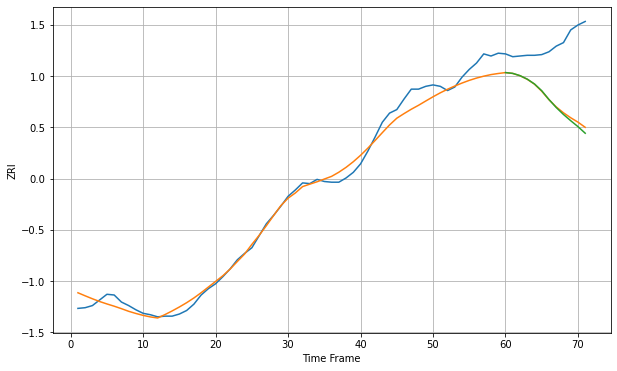

Wall time: 5.92 s
32701 12.645546060438269 84.95794007776806 87.80148075934979 [1151.48732858 1150.37224514 1147.14445621 1142.21230604 1135.32482153
 1125.75906922 1113.27612319 1101.9639308  1092.07800966 1083.21800158
 1074.84400387 1065.46067446]

Got an mse at 0.0094 in round 43 and stopped training

71 71 12


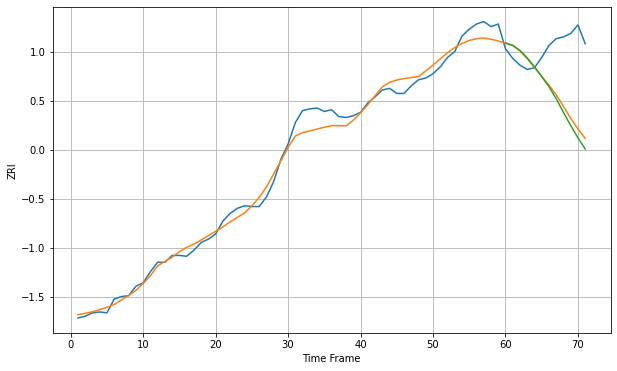

Wall time: 6 s
32703 10.675477597271765 65.20125916998289 70.8768104174027 [1299.8409087  1297.09576877 1291.22244372 1282.50201868 1272.17793574
 1260.76735017 1248.88183348 1234.80793493 1218.88201473 1203.51984868
 1189.12647155 1176.18584057]

Got an mse at 0.0089 in round 39 and stopped training

71 71 12


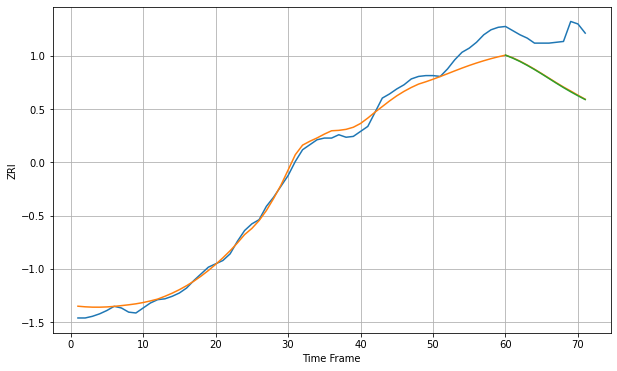

Wall time: 6 s
32714 11.145843746158537 53.464106149971265 53.9631990464592 [1212.57333551 1209.00082689 1204.93085758 1200.29768225 1195.29660379
 1190.00384874 1184.50474897 1178.98415385 1173.6272907  1168.56732667
 1163.77938424 1159.24360738]

Got an mse at 0.0099 in round 62 and stopped training

71 71 12


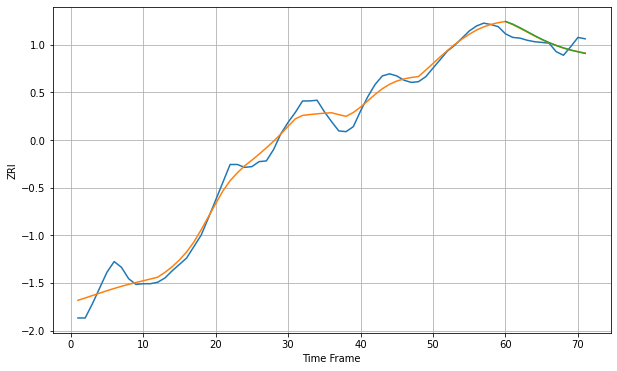

Wall time: 6.51 s
32771 13.237464139322274 12.994277757465637 13.313985377504284 [1228.33199229 1224.58908734 1219.58037295 1214.11772655 1208.63154432
 1203.44810695 1198.78375073 1194.73738377 1191.30105542 1188.38637827
 1185.85849283 1183.56853235]

Got an mse at 0.0099 in round 38 and stopped training

71 71 12


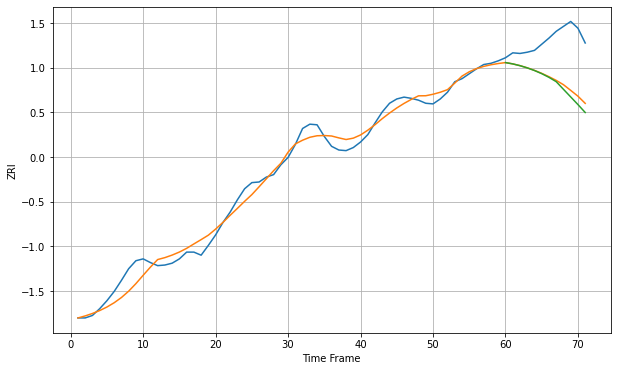

Wall time: 5.89 s
32792 14.02066305029449 69.78050422822601 75.98989450738877 [1287.14771328 1285.00764074 1282.11672989 1278.53370978 1274.23852875
 1269.14058417 1263.12163763 1256.10088574 1243.66707542 1231.28454773
 1218.85069004 1206.00265303]

Got an mse at 0.0098 in round 36 and stopped training

71 71 12


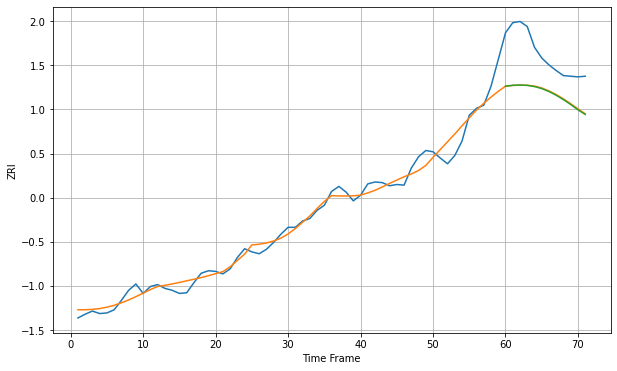

Wall time: 6.01 s
32801 13.743299616939472 67.51502788178884 68.01429661965942 [1575.16746502 1576.62297899 1577.04705924 1576.41497571 1574.57894769
 1571.41052512 1566.70563585 1560.77208664 1553.79548297 1546.0207578
 1537.60777694 1530.36419732]

Got an mse at 0.0100 in round 109 and stopped training

71 71 12


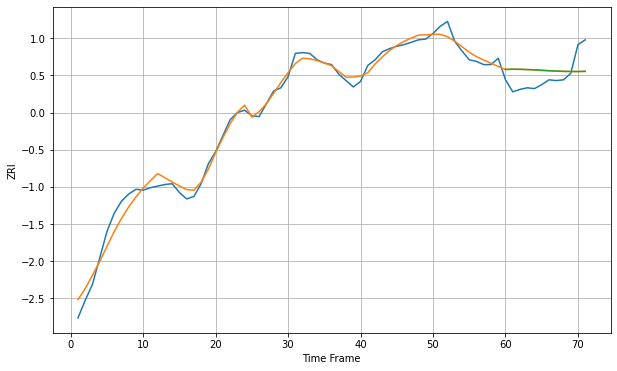

Wall time: 7.51 s
32803 9.212465451449159 22.378597278811228 22.517738001482826 [1483.97734895 1484.2527675  1484.1987545  1483.90425881 1483.45865169
 1482.94311134 1482.42934194 1481.97750444 1481.63369296 1481.42806743
 1481.37463895 1481.47305169]

Got an mse at 0.0100 in round 55 and stopped training

71 71 12


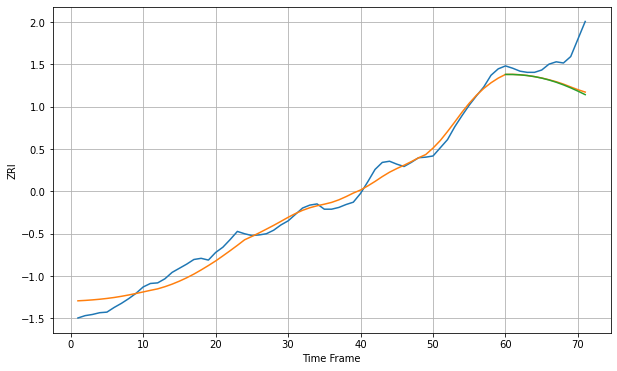

Wall time: 6.24 s
32810 14.186671716419447 48.813727597906976 50.38805664672602 [1401.4548259  1401.33117669 1400.72858866 1399.50506949 1397.64640349
 1395.13092178 1391.9380515  1388.06507722 1383.54376639 1378.44446531
 1372.8595949  1366.87540954]

Got an mse at 0.0083 in round 28 and stopped training

71 71 12


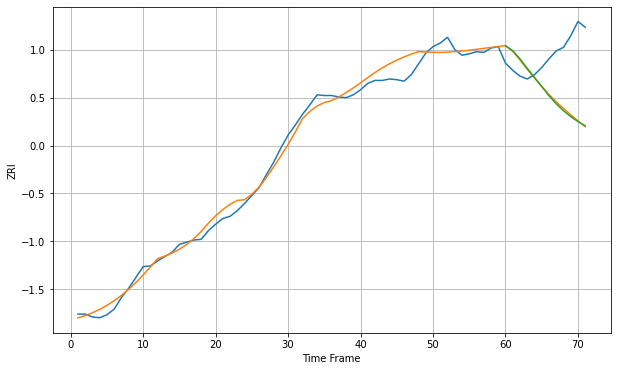

Wall time: 5.74 s
32811 11.427956950027426 75.11864255884988 76.07430993445247 [1349.28633001 1342.28210036 1330.92662319 1317.79104062 1305.12993739
 1292.48240963 1279.74077966 1268.50762586 1258.85981009 1250.68693594
 1243.81501863 1237.81385859]

Got an mse at 0.0098 in round 34 and stopped training

71 71 12


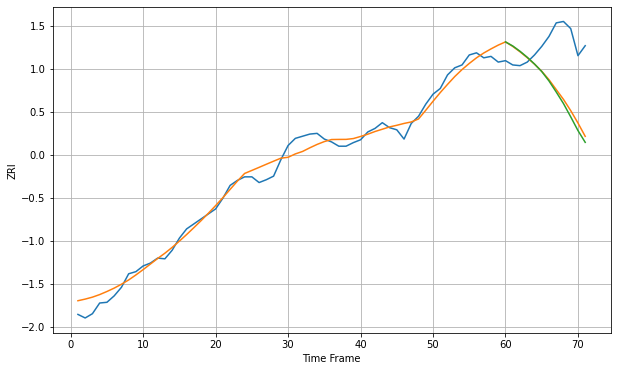

Wall time: 5.95 s
32812 11.7755239453768 74.10468895367194 78.83948855140845 [1426.33712224 1420.64805676 1413.21612656 1404.78960964 1395.32771796
 1384.75028426 1371.546742   1356.02620749 1339.82759972 1321.16693231
 1301.94727696 1285.40285463]

Got an mse at 0.0091 in round 24 and stopped training

71 71 12


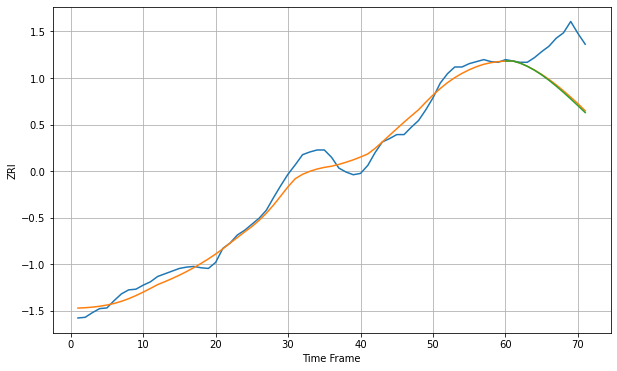

Wall time: 5.74 s
32822 13.183696053420146 64.58420691360658 66.27528169285118 [1321.84162092 1321.97645435 1318.85559527 1314.08268811 1308.17706149
 1301.11564813 1293.11257031 1284.36261804 1275.02818774 1265.24695819
 1255.14956414 1244.87831   ]

Got an mse at 0.0099 in round 63 and stopped training

71 71 12


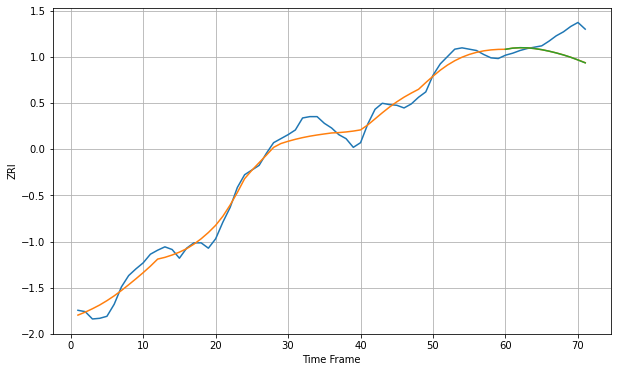

Wall time: 6.29 s
32825 13.58976153072919 28.949221943286897 29.005250810152376 [1298.84494691 1300.5743586  1301.24241622 1300.99223607 1299.94887509
 1298.2575682  1296.04732752 1293.40482828 1290.3710872  1286.88907764
 1282.85398294 1278.52786499]

Got an mse at 0.0098 in round 45 and stopped training

71 71 12


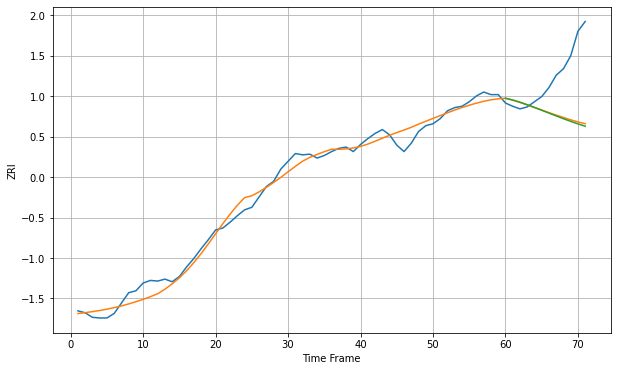

Wall time: 6.1 s
32835 12.160286558567101 74.22559298137683 75.95169813978252 [1289.42909574 1286.66194281 1283.30215722 1279.42552676 1275.22907555
 1270.86953549 1266.45817294 1262.07775976 1257.79800234 1253.6841058
 1249.79874036 1246.19869453]

Got an mse at 0.0085 in round 24 and stopped training

71 71 12


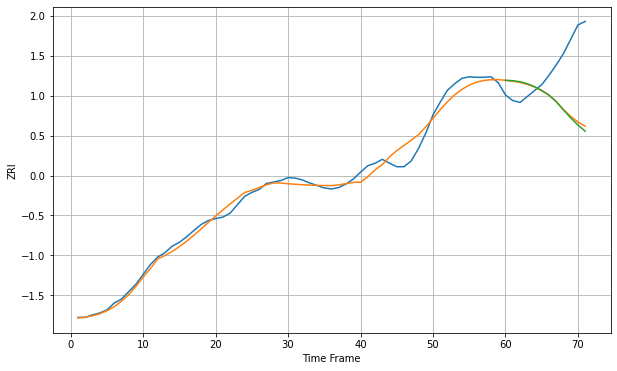

Wall time: 5.93 s
32837 13.960876049827602 105.21424667821822 108.40655813313326 [1580.88010956 1580.13128261 1578.01564718 1574.05409497 1568.07910186
 1560.17137864 1550.72222156 1537.85600437 1520.88286093 1504.81218718
 1490.36661795 1477.90154774]

Got an mse at 0.0095 in round 38 and stopped training

71 71 12


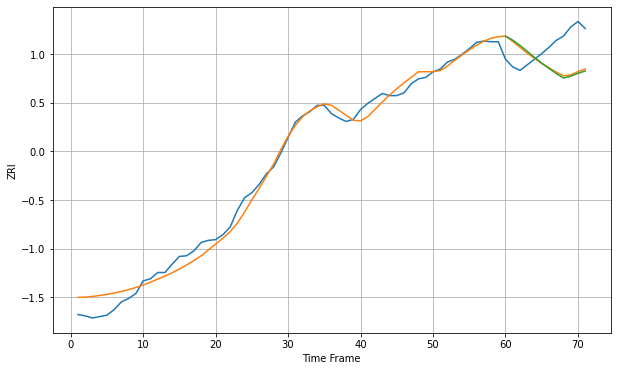

Wall time: 6.7 s
32839 12.869009531084846 44.070705036576896 45.888381408610556 [1360.02891518 1354.24637031 1346.72908624 1338.2994182  1329.61473988
 1321.33486603 1313.84037674 1306.713133   1300.08351735 1302.75395424
 1306.85563728 1310.13053659]

Got an mse at 0.0093 in round 23 and stopped training

71 71 12


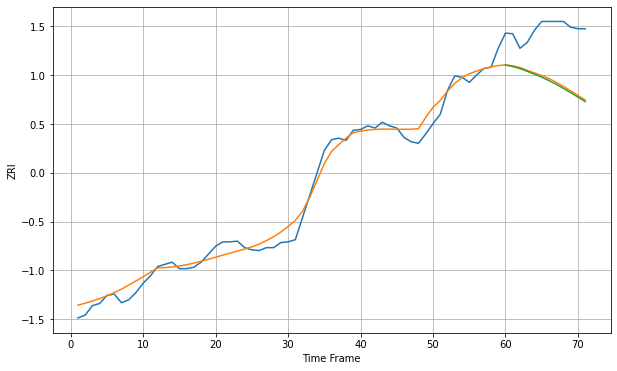

Wall time: 6.03 s
32935 12.269729427077037 72.01465873470327 74.01161281410572 [1176.06128533 1173.80874835 1171.03704172 1167.29012646 1163.4003679
 1159.13746164 1154.43768943 1149.28137822 1143.69831275 1137.78102869
 1131.67457053 1125.54145617]

Got an mse at 0.0100 in round 170 and stopped training

71 71 12


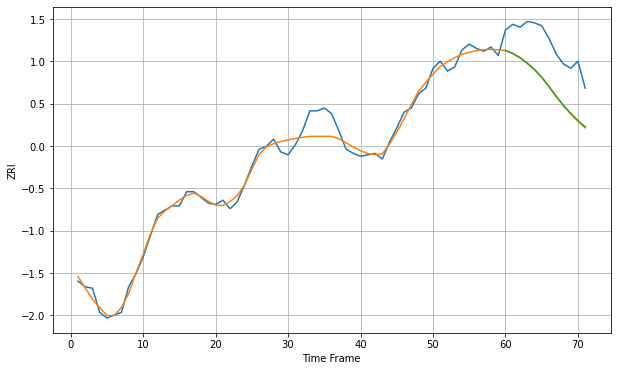

Wall time: 8.72 s
33009 5.957857575317374 30.143085384048923 29.90296935117187 [1639.51797412 1637.52064828 1634.54376362 1630.69655719 1626.21485289
 1620.78650642 1614.10068549 1607.24304452 1600.88435125 1595.15930246
 1590.11122153 1585.70691559]
71 71 12


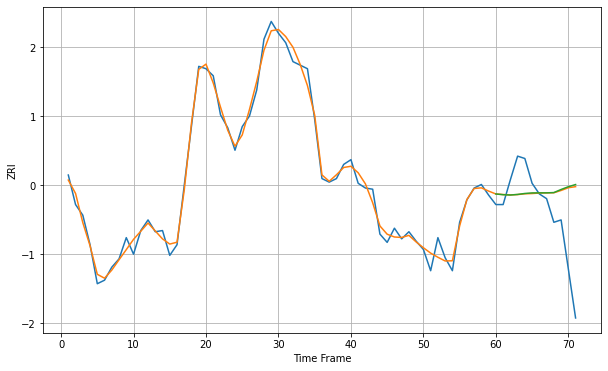

Wall time: 14.9 s
33010 6.525618312962726 41.53114336913435 42.06537950840064 [1773.96110827 1773.34412835 1773.07582164 1773.58152469 1774.3947397
 1774.86214581 1774.91161318 1774.91211965 1775.1585459  1777.76886869
 1780.09913301 1781.94845534]

Got an mse at 0.0100 in round 149 and stopped training

71 71 12


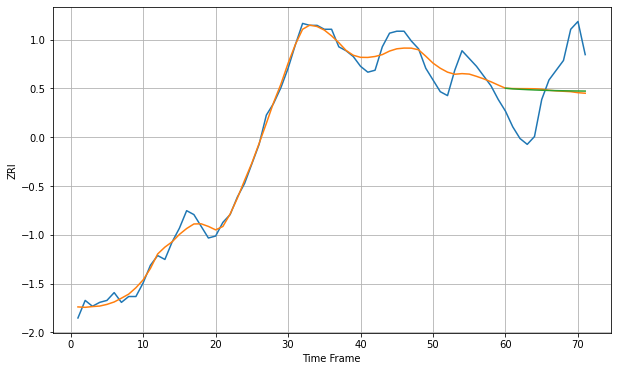

Wall time: 8.31 s
33020 4.983706569976649 21.90478354998269 21.470208203094117 [1354.7702425  1354.45405222 1354.24049401 1354.05483209 1353.89060806
 1353.75064461 1353.63486793 1353.54122961 1353.46638085 1353.40633233
 1353.35711024 1353.31540378]

Got an mse at 0.0099 in round 33 and stopped training

71 71 12


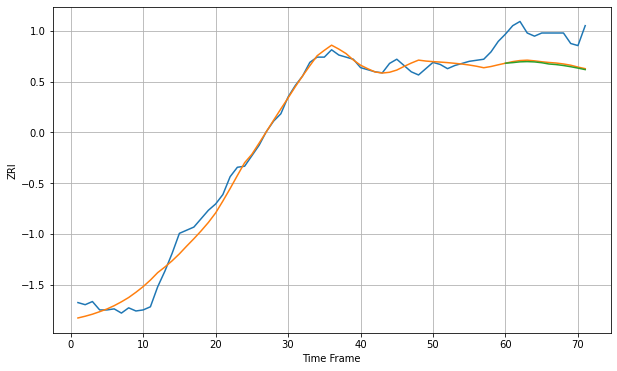

Wall time: 5.93 s
33024 9.419006827007646 29.32205643448653 30.40304919670587 [1508.22142728 1508.76358015 1509.50011378 1509.72683054 1509.43625454
 1508.65651832 1507.44648598 1506.89083859 1506.01388953 1504.86186714
 1503.53100674 1502.10766858]

Got an mse at 0.0099 in round 54 and stopped training

71 71 12


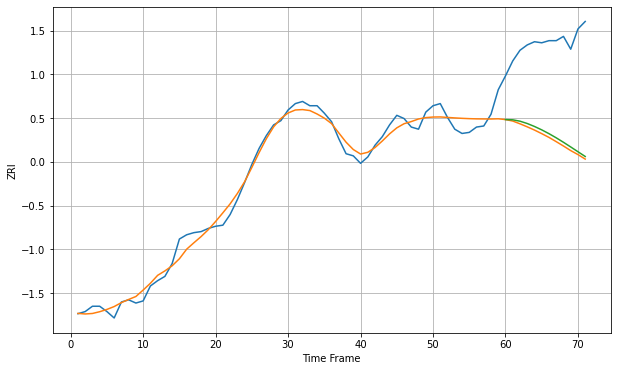

Wall time: 6.36 s
33025 8.089118186977457 89.8804574482703 87.07950498357958 [1544.01810168 1543.80348612 1542.49965957 1540.32125487 1537.55258179
 1534.3697176  1530.80344746 1526.89934975 1522.71622239 1518.33454703
 1513.86092289 1509.42091403]

Got an mse at 0.0100 in round 237 and stopped training

71 71 12


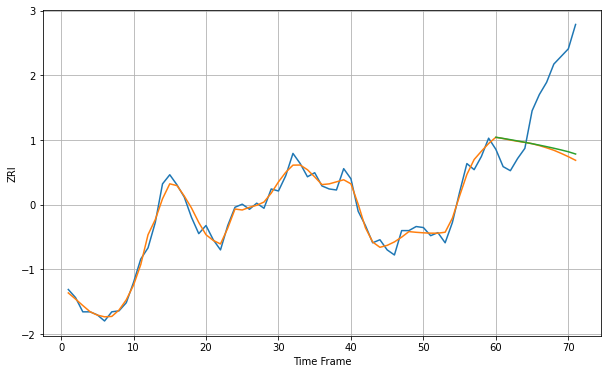

Wall time: 9.86 s
33062 6.340169996259749 67.91990362398778 65.58635946283579 [1619.91943569 1618.78512877 1617.5601442  1616.2821032  1614.95594359
 1613.58278636 1612.1588777  1610.67399547 1609.11059693 1607.44516135
 1605.65274467 1603.42459175]

Got an mse at 0.0099 in round 37 and stopped training

71 71 12


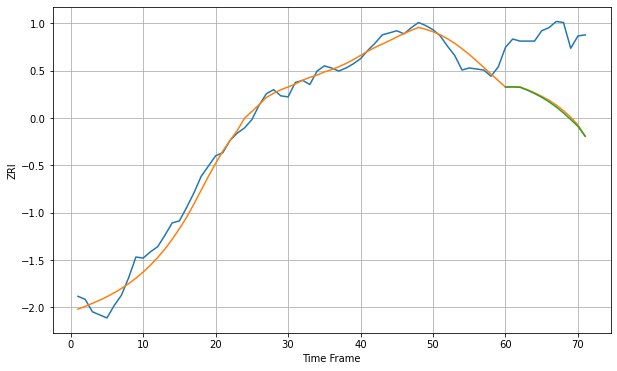

Wall time: 6.33 s
33065 8.996058062530857 67.47185179739064 68.49543436765332 [1495.47124185 1495.66142898 1495.31472479 1492.52724527 1489.28940159
 1485.57614671 1481.25759311 1476.22244107 1470.46702113 1464.11495316
 1457.40739322 1447.93574546]
71 71 12


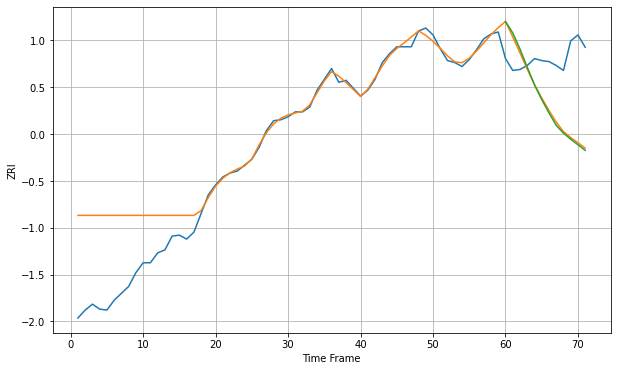

Wall time: 15.3 s
33066 36.37901790704144 62.33106612098004 64.06005712815025 [1481.66691566 1470.04622566 1453.67646993 1435.25849392 1417.45126333
 1402.50562741 1388.89426345 1376.34706322 1368.41953628 1362.32227585
 1356.66486582 1351.02336917]

Got an mse at 0.0099 in round 104 and stopped training

71 71 12


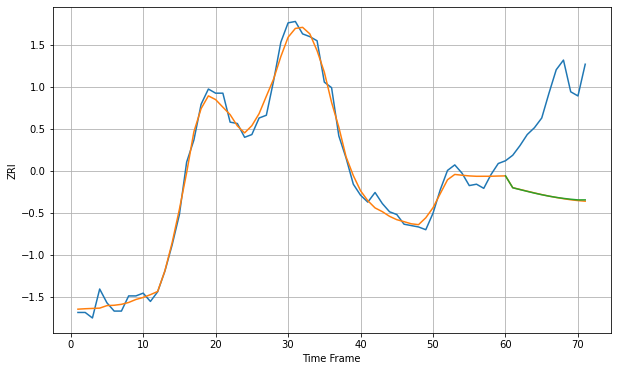

Wall time: 7.71 s
33125 6.0068315358389155 67.51424837479944 67.30947223575939 [1682.02340686 1673.42290955 1672.10511218 1670.79835772 1669.53712714
 1668.37311489 1667.33877603 1666.44818301 1665.70259066 1665.09576166
 1664.61765873 1664.6272052 ]

Got an mse at 0.0099 in round 28 and stopped training

71 71 12


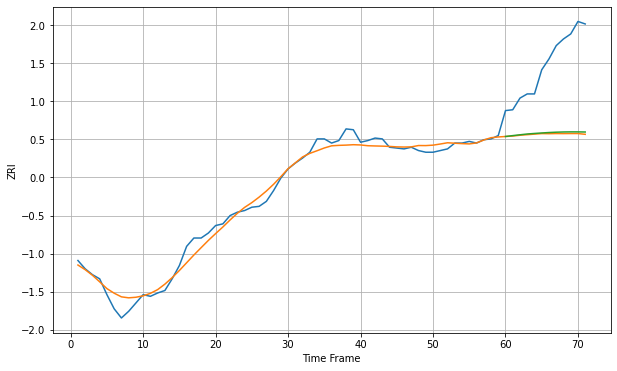

Wall time: 6.2 s
33126 8.884414124739395 89.73676641367284 88.27034328297884 [1645.8963825  1646.95223419 1647.94315712 1648.89712498 1649.5386288
 1650.13592322 1650.65186191 1651.05365463 1651.3187592  1651.43964583
 1651.42315638 1651.28639523]

Got an mse at 0.0099 in round 322 and stopped training

71 71 12


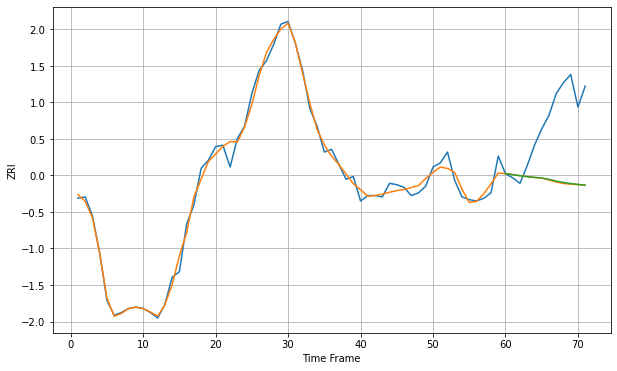

Wall time: 11.6 s
33127 5.314397098060606 49.186383884644684 48.85850383662546 [1736.12575094 1735.40605809 1734.606592   1733.90221551 1733.32441617
 1732.94015945 1731.94377996 1730.65601021 1729.63959156 1728.83947103
 1728.21442876 1727.72854557]

Got an mse at 0.0098 in round 68 and stopped training

71 71 12


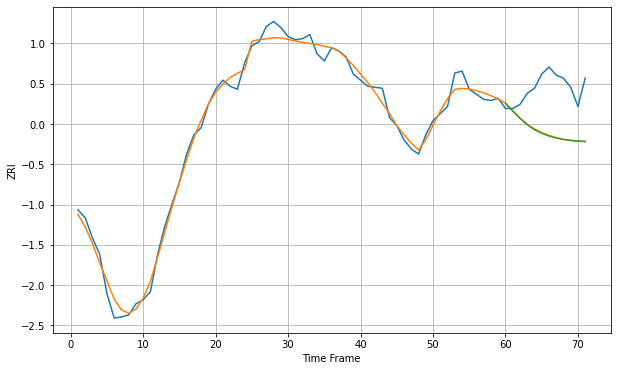

Wall time: 7 s
33130 7.796226237687488 46.57614949138646 46.8147108468459 [1755.31224034 1747.59550998 1740.35975503 1733.94613455 1729.04480083
 1725.49996558 1722.80142443 1720.81935735 1719.41922542 1718.47399916
 1717.87138874 1717.51662627]
71 71 12


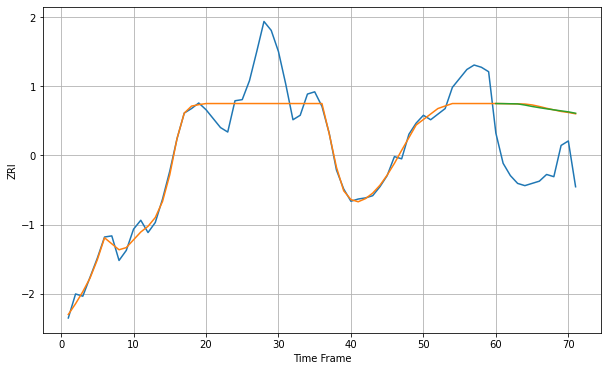

Wall time: 15.5 s
33131 19.320582339004353 58.05928647634531 57.78084821830928 [2261.51470944 2261.43612265 2261.32481463 2261.20678335 2260.16802778
 2258.89896969 2257.80124558 2256.80411604 2255.86561577 2254.95860741
 2254.06674078 2252.81912879]

Got an mse at 0.0100 in round 432 and stopped training

71 71 12


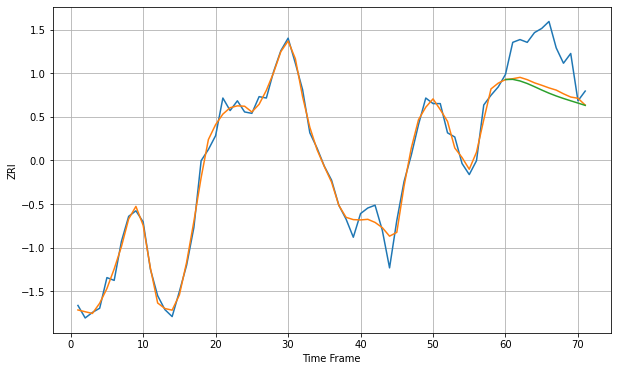

Wall time: 13.7 s
33132 6.238381261105302 28.695345104429286 31.217779674150908 [2043.28226592 2043.41776876 2042.27556011 2040.43009294 2038.15207762
 2035.75509363 2033.49452169 2031.4762428  2029.67656276 2028.01103091
 2026.38628212 2024.72228524]

Got an mse at 0.0100 in round 140 and stopped training

71 71 12


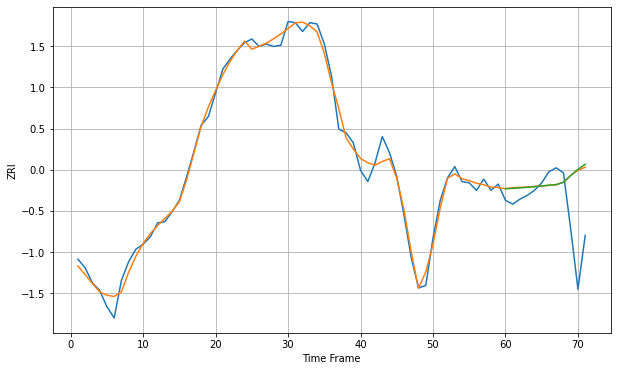

Wall time: 8.49 s
33133 6.524358918988022 34.89340036066626 35.3436569231527 [1985.32911789 1985.59518619 1985.97015427 1986.41936032 1986.93482261
 1987.50134053 1988.09086133 1988.65851869 1990.36986609 1995.87738381
 2000.82400772 2004.85029157]
71 71 12


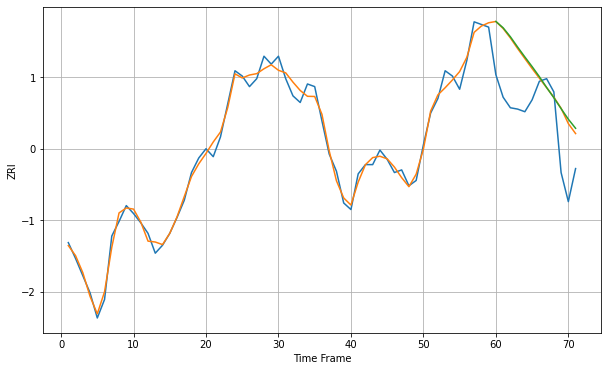

Wall time: 15.2 s
33134 5.639589532696212 38.73486683080816 39.83361785663473 [2110.27584086 2105.50387444 2098.71046111 2090.93010982 2083.42767052
 2076.13670084 2068.53056413 2060.36826205 2052.5930722  2044.33800897
 2036.33610731 2029.46689131]

Got an mse at 0.0099 in round 251 and stopped training

71 71 12


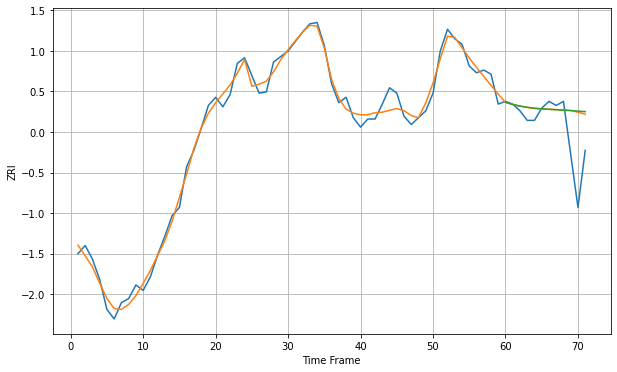

Wall time: 10.8 s
33135 5.928414653797806 24.011952808202473 24.387266240961164 [1726.28138125 1724.70909163 1723.50086801 1722.63317848 1722.00369684
 1721.52940005 1721.15015219 1720.82308318 1720.51530361 1720.19805414
 1719.84368479 1719.42559792]

Got an mse at 0.0100 in round 106 and stopped training

71 71 12


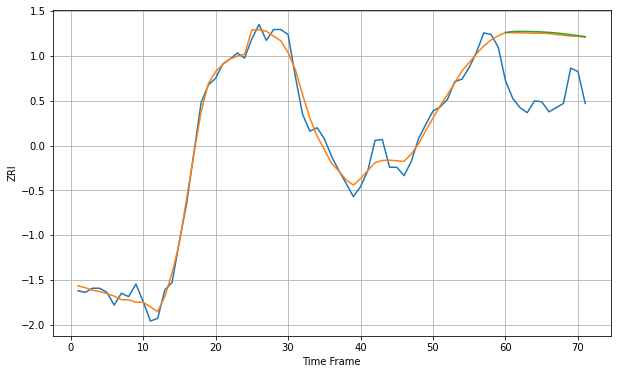

Wall time: 7.38 s
33137 10.616682384994728 77.32302798491042 78.71039297561741 [2281.43407049 2282.55953514 2282.73229645 2282.690075   2282.46655138
 2282.08252573 2281.55620102 2280.8867718  2279.88108162 2278.7992925
 2277.65884698 2276.4732226 ]

Got an mse at 0.0099 in round 306 and stopped training

71 71 12


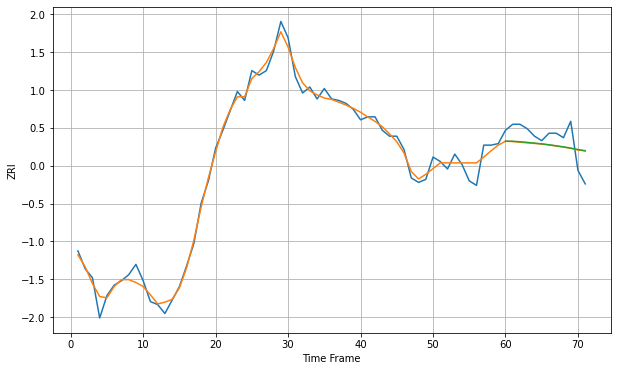

Wall time: 11.7 s
33138 5.033749337358848 11.703253033572354 11.590383362072044 [1696.6460064  1696.60791621 1696.25448131 1695.84110959 1695.3633753
 1694.8228892  1694.22012109 1693.55489226 1692.82673456 1691.9926528
 1691.05253881 1690.09996591]

Got an mse at 0.0100 in round 420 and stopped training

71 71 12


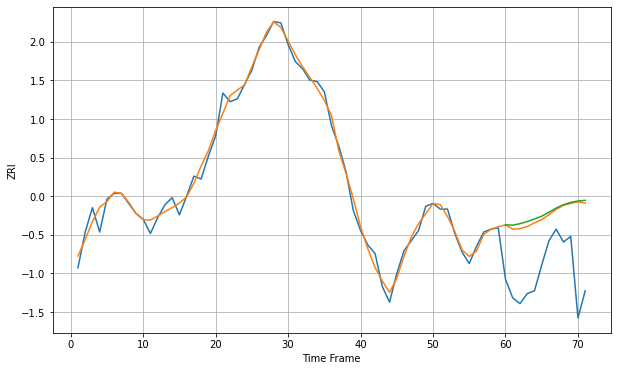

Wall time: 13.8 s
33139 5.364683616360884 44.70317518904887 46.41951320529992 [2003.99407614 2003.82298378 2004.83116097 2006.32059471 2008.13147424
 2010.07635435 2012.80562969 2015.75790837 2018.07799235 2019.691307
 2020.66931585 2021.13327063]
71 71 12


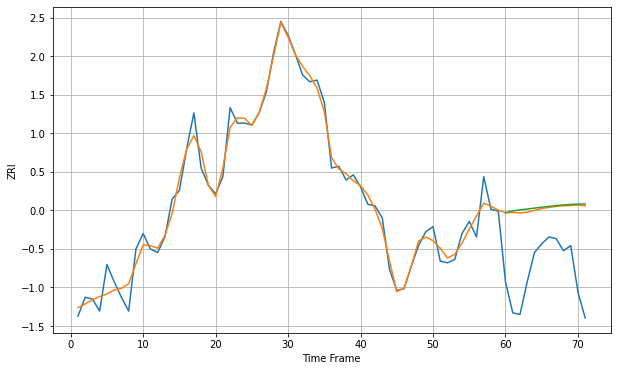

Wall time: 15.6 s
33140 6.162936235304589 40.570854639708415 41.45049273755056 [2305.01344092 2306.09483717 2306.77597236 2307.18408433 2307.71985047
 2308.2445711  2308.73740009 2309.179498   2309.55353246 2309.84582839
 2310.04742402 2310.15410058]

Got an mse at 0.0100 in round 108 and stopped training

71 71 12


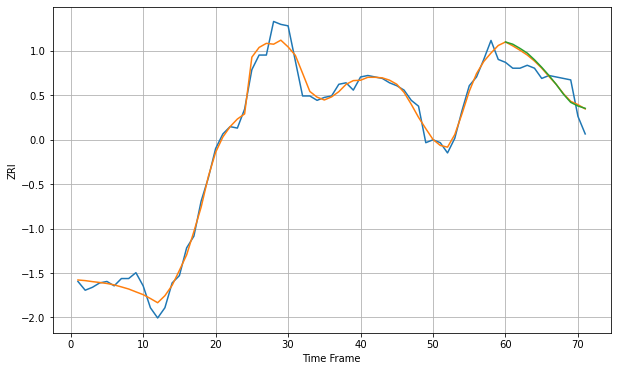

Wall time: 7.58 s
33141 6.05429319691843 10.849413386482597 11.355103575072976 [1867.9613507  1866.43931978 1863.56645005 1860.35553879 1855.77628037
 1850.60740116 1845.0211122  1838.91477317 1832.19697124 1826.61402976
 1824.12297592 1822.52022093]

Got an mse at 0.0100 in round 225 and stopped training

71 71 12


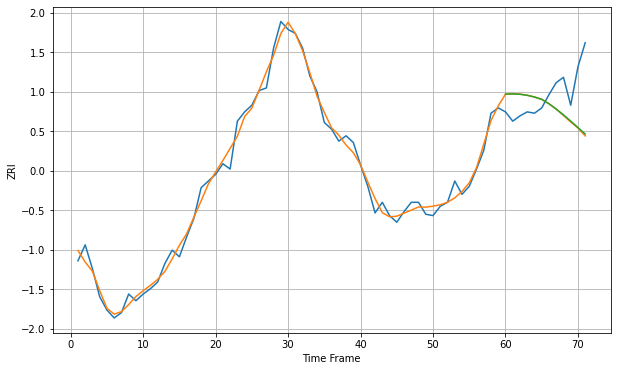

Wall time: 9.87 s
33142 5.9233193384489375 28.40868886936945 27.977166964939215 [1688.32533924 1688.50004435 1688.22721958 1687.43848503 1686.15416437
 1684.39314119 1681.05764109 1677.14317852 1672.77578749 1668.07613939
 1663.21165462 1658.36790445]

Got an mse at 0.0099 in round 384 and stopped training

71 71 12


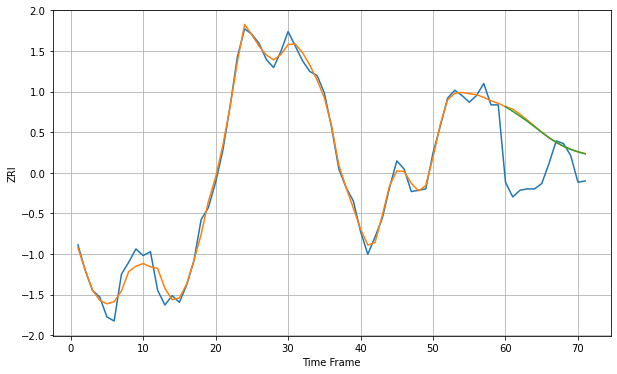

Wall time: 13.4 s
33145 6.016195168816694 39.25384158618802 38.69872779006797 [2074.63650413 2071.12820888 2067.55960605 2063.7506352  2059.65795345
 2055.42526862 2051.39784663 2047.88872932 2044.99412864 2042.65746573
 2040.78850097 2039.30941337]

Got an mse at 0.0100 in round 265 and stopped training

71 71 12


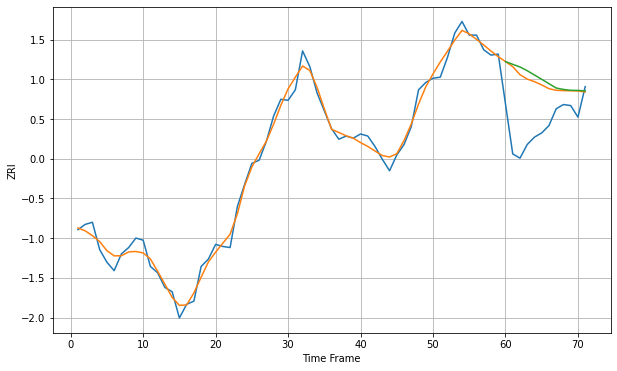

Wall time: 10.2 s
33147 7.503171753399099 46.65432121130278 50.3995461623354 [1972.86162124 1970.24593107 1967.72462794 1964.14968226 1960.09332794
 1955.97511162 1951.81764736 1947.69278679 1946.34939674 1945.52135224
 1945.42555308 1944.95835639]

Got an mse at 0.0100 in round 442 and stopped training

71 71 12


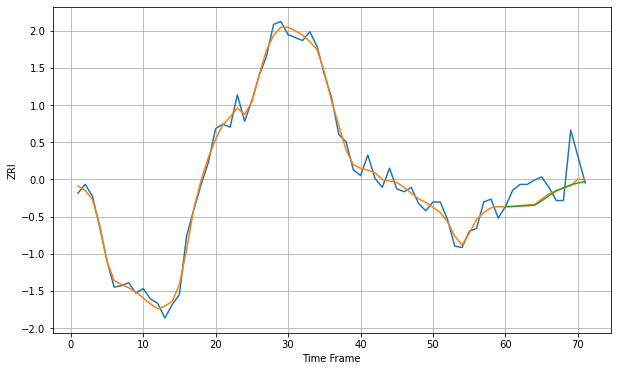

Wall time: 14.2 s
33150 5.045684785165523 15.421931165760176 15.764533377393676 [1607.83657697 1607.95379071 1608.19994245 1608.49572339 1608.80700298
 1611.79543897 1615.33073349 1618.45960872 1620.85922086 1622.6592145
 1623.96779915 1624.86635184]
71 71 12


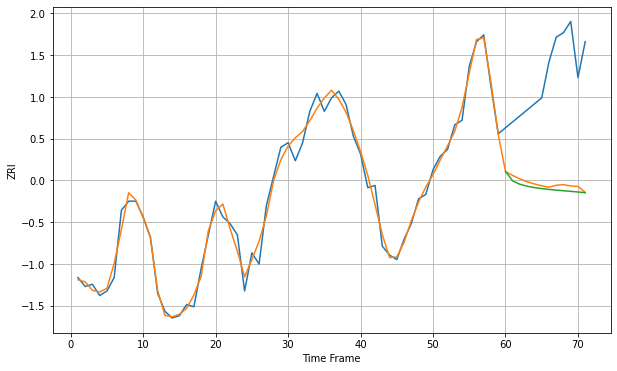

Wall time: 14.7 s
33157 4.115024455175634 49.83851827934208 51.50020353371907 [1756.1960602  1751.97522743 1750.50767805 1749.62577123 1749.04374207
 1748.59325829 1748.22997642 1747.92124118 1747.64085492 1747.36699153
 1747.08070593 1746.76514373]

Got an mse at 0.0099 in round 246 and stopped training

71 71 12


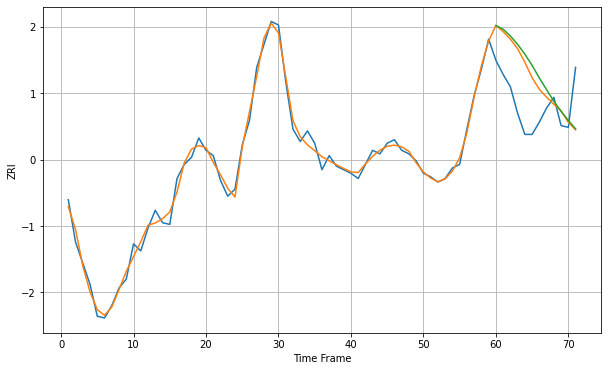

Wall time: 10 s
33160 3.730074177104628 24.95679675823179 27.422384528501944 [2077.72940944 2075.62216187 2071.78257073 2067.02291564 2061.45920954
 2055.11853829 2047.98144753 2041.32881582 2034.82606708 2029.03676096
 2023.92737845 2019.1491716 ]

Got an mse at 0.0100 in round 225 and stopped training

71 71 12


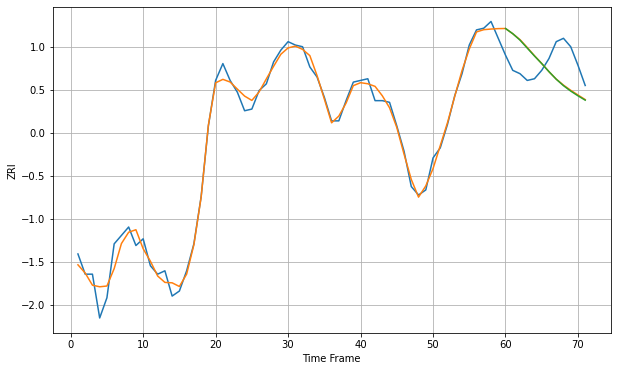

Wall time: 9.93 s
33161 5.064009950786088 18.46928630261719 18.555275730095367 [1537.82706486 1534.74238412 1530.93678262 1526.19996664 1521.49013658
 1516.9934148  1512.19955405 1507.72613193 1503.8949806  1500.67426901
 1497.87366555 1495.2917115 ]

Got an mse at 0.0099 in round 73 and stopped training

71 71 12


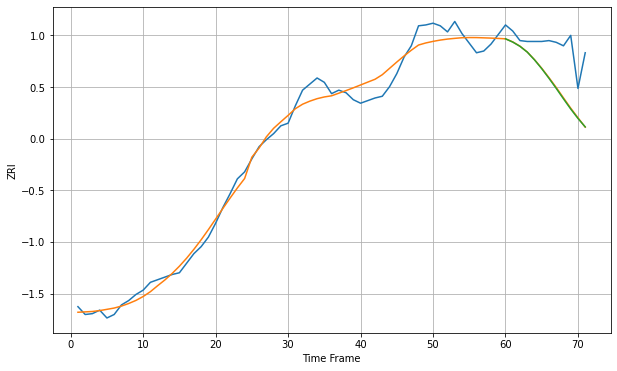

Wall time: 6.54 s
33178 11.78665443119216 46.135304164864415 46.611022794953946 [2046.03598941 2042.28849643 2037.39431326 2030.79261097 2021.86727456
 2011.71949615 2000.63400775 1989.0304757  1977.01813536 1965.31842684
 1954.49529204 1944.73459883]

Got an mse at 0.0100 in round 344 and stopped training

71 71 12


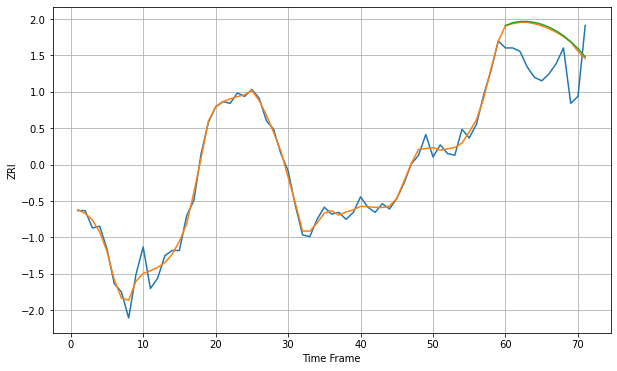

Wall time: 11.7 s
33180 4.178197684538668 23.516813419250383 24.037283140642945 [2043.85221494 2045.60307345 2046.27449292 2046.29595891 2045.74724196
 2044.66188161 2043.04130284 2040.8587479  2038.06809992 2034.62775827
 2030.54958884 2025.96304709]

Got an mse at 0.0100 in round 39 and stopped training

71 71 12


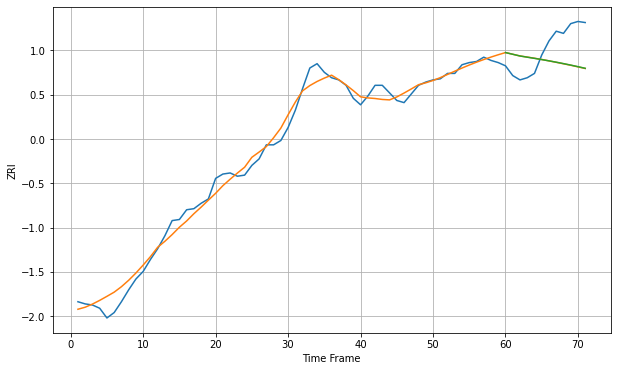

Wall time: 5.98 s
33186 7.928604549652312 26.77436153621751 26.67349852525831 [1596.26669309 1594.68579554 1593.09732799 1591.9835936  1590.91338179
 1589.78923006 1588.608215   1587.36600735 1586.05824203 1584.68134306
 1583.23335532 1581.71471575]

Got an mse at 0.0100 in round 116 and stopped training

71 71 12


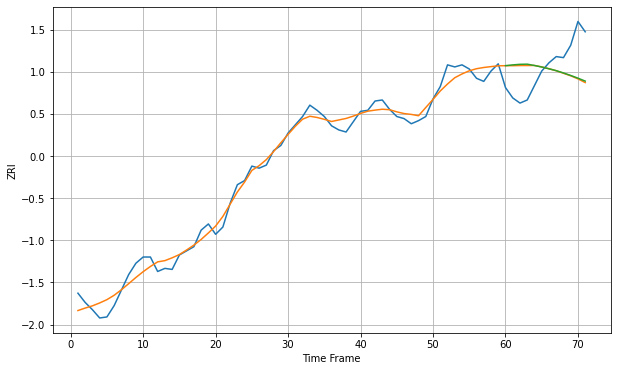

Wall time: 7.26 s
33196 8.132194283278942 30.385812131555095 30.355706466406208 [1610.19851793 1610.97419471 1611.5139711  1611.67076003 1610.38684881
 1608.88860822 1607.20934775 1605.37565353 1603.15801444 1600.72777005
 1598.1153768  1595.28264922]

Got an mse at 0.0099 in round 109 and stopped training

71 71 12


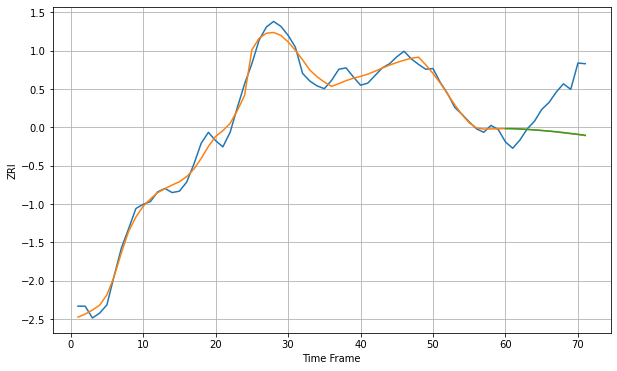

Wall time: 7.22 s
33301 10.974150990767065 56.31166663244639 56.04785324351867 [1751.35616716 1751.20297792 1750.76343219 1750.15917658 1749.45190987
 1748.66288881 1747.81013625 1746.79442542 1745.6275245  1744.40766911
 1743.12899239 1741.79395024]

Got an mse at 0.0096 in round 47 and stopped training

71 71 12


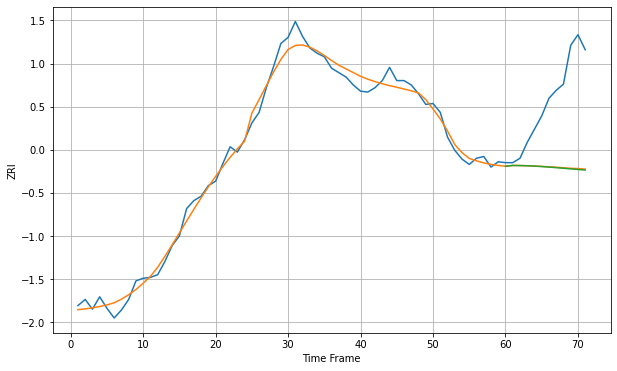

Wall time: 6.23 s
33304 9.424208144466867 86.20626218822207 86.71905249777025 [1551.97561456 1552.82623235 1552.73103919 1552.4794734  1552.08895841
 1551.58373632 1550.99104627 1550.33875407 1549.6536828  1548.96047372
 1548.28074051 1547.63236717]

Got an mse at 0.0099 in round 59 and stopped training

71 71 12


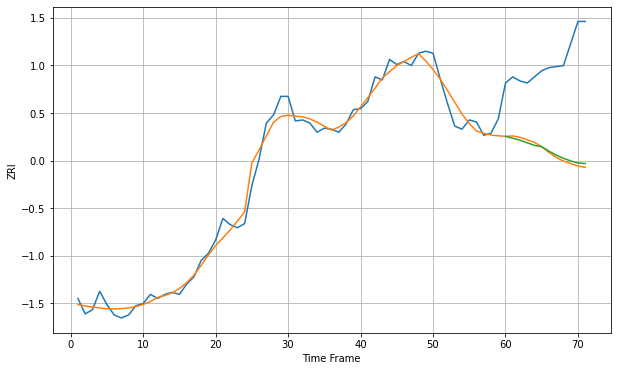

Wall time: 6.54 s
33305 9.140756605926125 90.71581508770751 89.68163734667286 [1495.01852116 1493.20075435 1491.28168197 1488.69649177 1486.25002888
 1484.9023623  1480.54139743 1476.75179278 1473.59083855 1471.04104564
 1469.03480345 1468.52442169]

Got an mse at 0.0100 in round 174 and stopped training

71 71 12


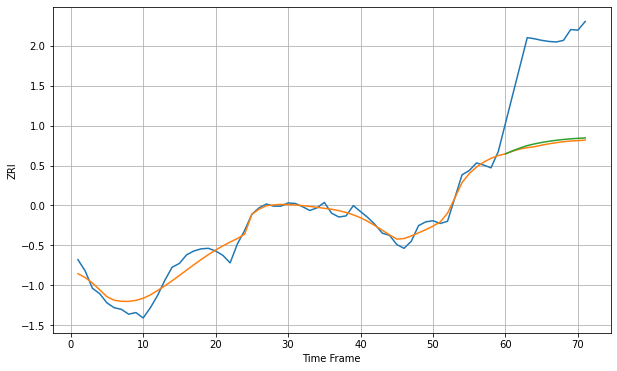

Wall time: 8.98 s
33308 14.629755725385815 181.50342224507997 177.7510885740882 [1611.88836662 1617.57631989 1622.68459849 1627.15518949 1630.30023113
 1632.95578301 1635.16580584 1636.99001263 1638.48083849 1639.68239876
 1640.62990586 1641.34959271]

Got an mse at 0.0100 in round 55 and stopped training

71 71 12


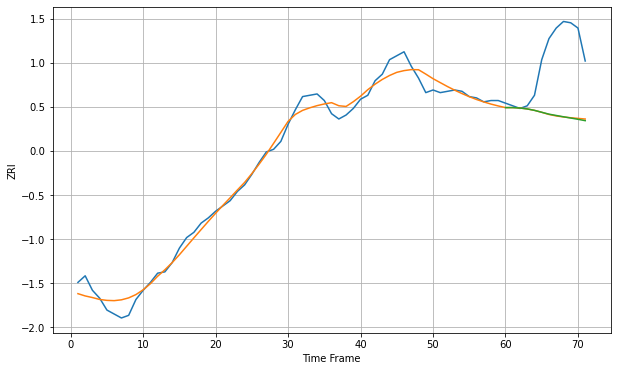

Wall time: 6.56 s
33311 6.635430783430601 47.07300933856047 47.195073007460394 [1383.63509893 1383.6410718  1383.32200158 1382.63008085 1381.54607169
 1380.09440592 1378.66256308 1377.66416899 1376.67474861 1375.72454116
 1374.76914425 1373.719307  ]

Got an mse at 0.0094 in round 36 and stopped training

71 71 12


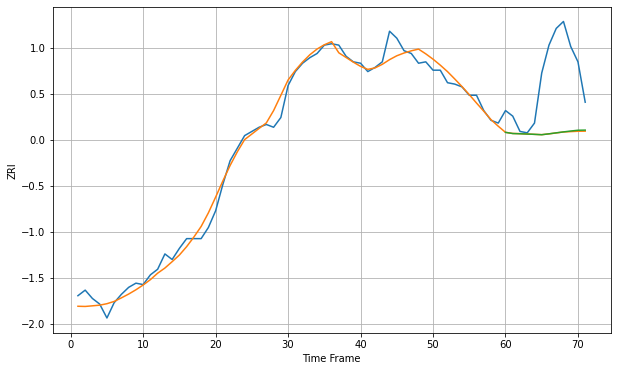

Wall time: 6.14 s
33312 6.200352138597357 45.72773692296204 45.568448099032246 [1414.34396934 1413.48976636 1413.33753338 1413.13971433 1412.90368356
 1412.64187486 1413.29041103 1413.99309153 1414.66669864 1415.29535429
 1415.87005333 1415.95105013]

Got an mse at 0.0099 in round 149 and stopped training

71 71 12


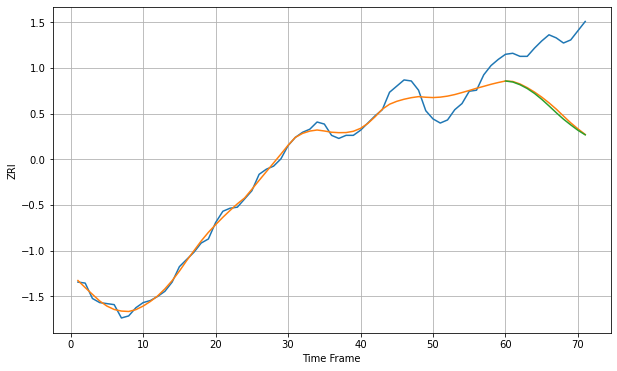

Wall time: 8.21 s
33313 8.859733859669728 64.55507835330867 66.13981125043665 [1418.97685241 1418.01964443 1415.35096793 1411.63922145 1406.87736837
 1401.12620861 1394.72400763 1388.09522248 1381.79977457 1376.20805539
 1370.93988055 1366.50532652]

Got an mse at 0.0099 in round 26 and stopped training

71 71 12


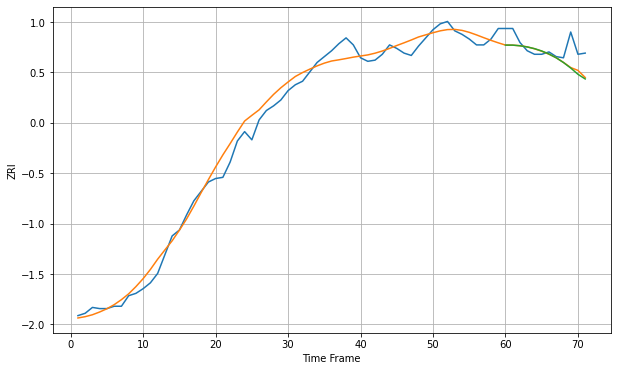

Wall time: 5.97 s
33324 8.097938705253545 12.949954670190529 13.520900567451719 [1558.84002656 1558.81810037 1558.24736048 1557.25977279 1555.80601316
 1553.8204599  1551.22811862 1547.95919452 1543.96994069 1539.26671958
 1533.92508282 1529.94691718]

Got an mse at 0.0097 in round 58 and stopped training

71 71 12


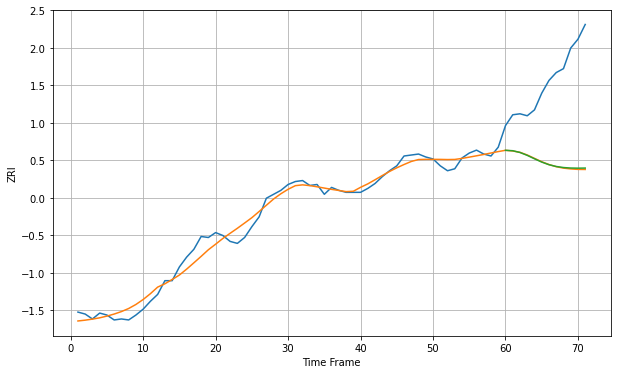

Wall time: 6.58 s
33334 7.405348615637783 88.4278254993766 87.96189061533974 [1323.81083536 1323.38485575 1321.58638032 1318.66663614 1315.17318873
 1311.80778857 1309.13673439 1307.32710345 1306.26429967 1305.7517573
 1305.61131681 1305.70785212]

Got an mse at 0.0099 in round 72 and stopped training

71 71 12


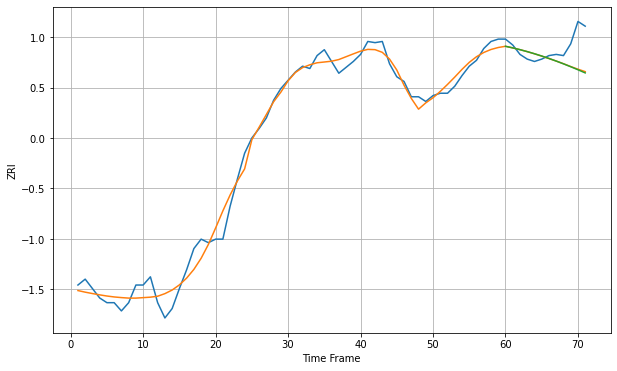

Wall time: 6.84 s
33401 8.494149946767275 17.668888335373488 17.9799129290693 [1511.90106567 1510.55559984 1509.03391311 1507.37134755 1505.567997
 1503.62486493 1501.54420711 1499.32990609 1496.98769979 1494.52525066
 1491.95209635 1489.27959446]

Got an mse at 0.0100 in round 109 and stopped training

71 71 12


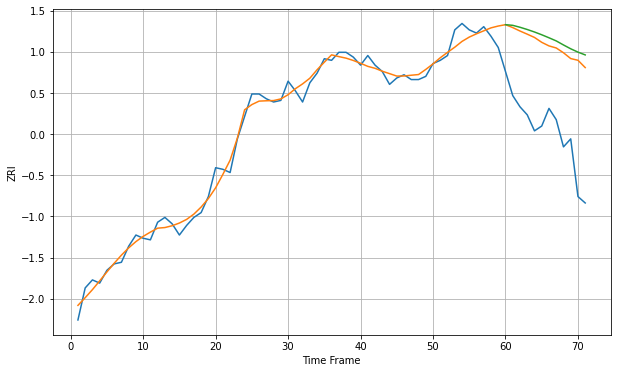

Wall time: 7.49 s
33404 5.121822652993377 55.82062810926226 60.09113875581016 [1507.24552382 1506.83221529 1505.62938493 1504.23658206 1502.67524835
 1500.94590161 1499.07023581 1497.11292437 1494.58811406 1492.19790751
 1490.11995806 1488.37623782]

Got an mse at 0.0099 in round 109 and stopped training

71 71 12


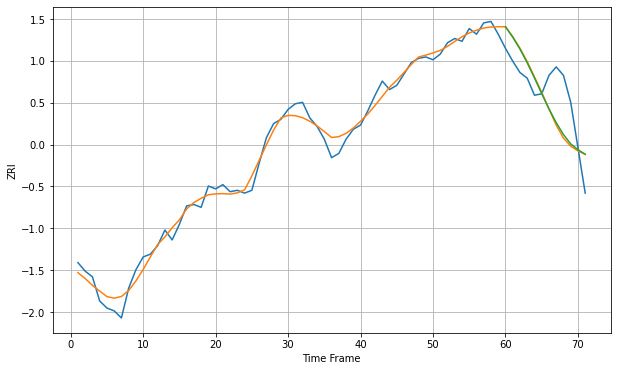

Wall time: 7.74 s
33407 5.854807209172524 24.211033748558023 23.299554175261154 [1515.25538717 1507.94522551 1499.51558086 1489.838024   1479.17307364
 1468.09642148 1457.36410204 1447.64389858 1439.3105785  1432.67479913
 1428.6626165  1425.36458917]

Got an mse at 0.0100 in round 110 and stopped training

71 71 12


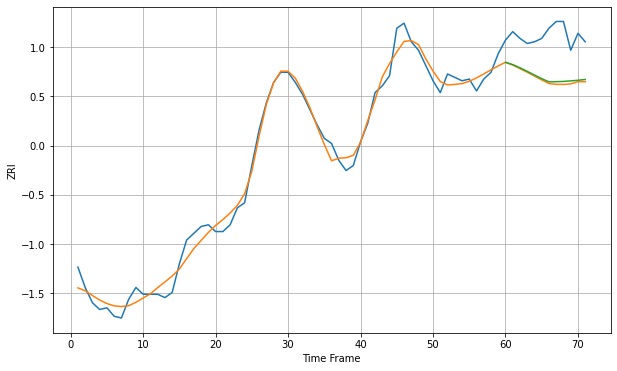

Wall time: 7.82 s
33413 5.787094629001989 25.440473504980517 24.45579528187879 [1454.89859125 1453.52575996 1451.66332712 1449.55056726 1447.36102651
 1445.25493689 1443.36426233 1443.45447548 1443.61932169 1443.91574745
 1444.30371921 1444.74565203]

Got an mse at 0.0099 in round 240 and stopped training

71 71 12


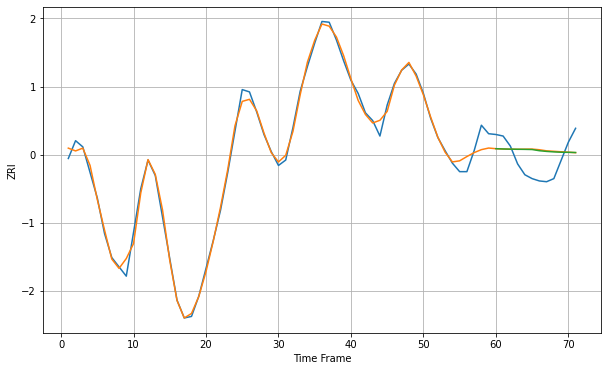

Wall time: 10 s
33414 8.764584245150468 27.810324966719616 27.36127311288888 [1717.64365239 1717.29661608 1717.07266463 1716.91398026 1716.78677366
 1716.58215961 1715.04152897 1714.13950825 1713.51412223 1713.06953547
 1712.9471793  1712.73179134]

Got an mse at 0.0100 in round 145 and stopped training

71 71 12


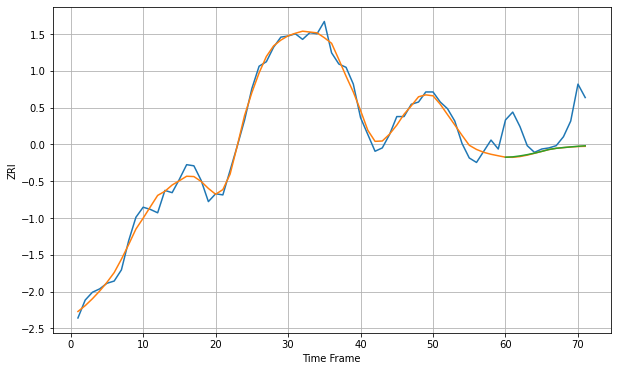

Wall time: 8.13 s
33418 6.549716915536153 27.66167117738493 27.450314953172825 [1670.68557901 1671.00063133 1671.85704782 1672.9728983  1674.32636202
 1675.88099975 1677.58433734 1678.64612543 1679.29438345 1679.90121163
 1680.44189396 1680.90006843]

Got an mse at 0.0100 in round 123 and stopped training

71 71 12


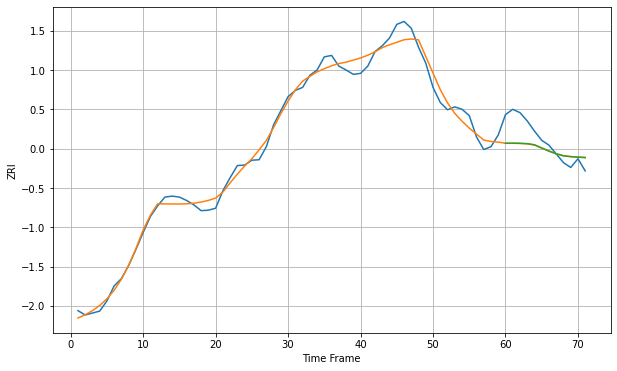

Wall time: 7.45 s
33432 16.143585617770047 38.057967541934254 37.8578478127184 [1927.94093814 1928.07568393 1927.90590104 1927.18573388 1924.86493821
 1918.22299463 1911.87345527 1906.3562434  1902.15871668 1900.26785404
 1899.17283785 1898.47193135]

Got an mse at 0.0100 in round 150 and stopped training

71 71 12


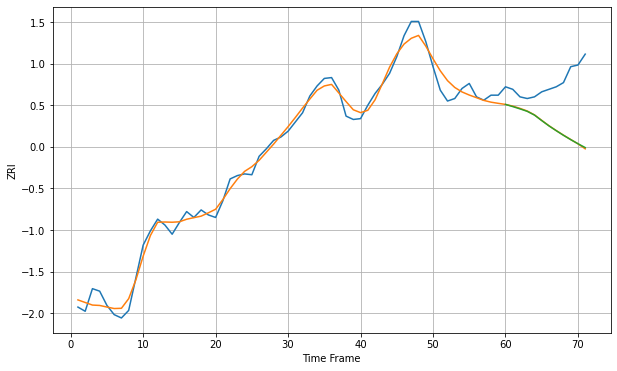

Wall time: 7.98 s
33433 9.877938940601338 58.18519164273927 58.04890442286239 [1746.95869814 1744.37325972 1741.64752735 1738.69715044 1734.23284097
 1727.65010148 1721.32541394 1715.59576961 1710.08987184 1704.90682501
 1700.03573204 1695.42873307]

Got an mse at 0.0100 in round 308 and stopped training

71 71 12


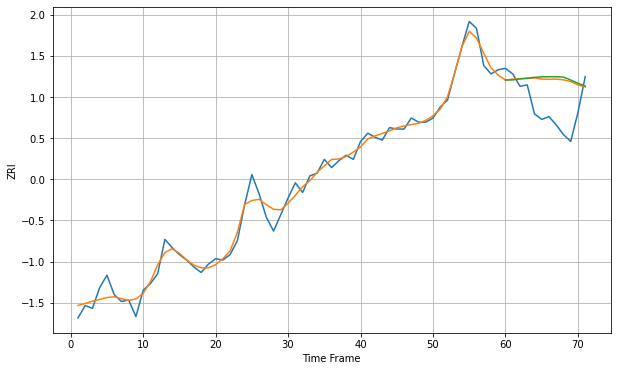

Wall time: 11.1 s
33435 5.947329952813094 24.89361681055516 25.93269794245212 [1717.46806901 1717.6482187  1718.30922452 1718.9373042  1719.45047128
 1719.79908257 1719.95147759 1719.90687856 1719.70457676 1717.54159266
 1715.22356619 1713.12925898]

Got an mse at 0.0098 in round 73 and stopped training

71 71 12


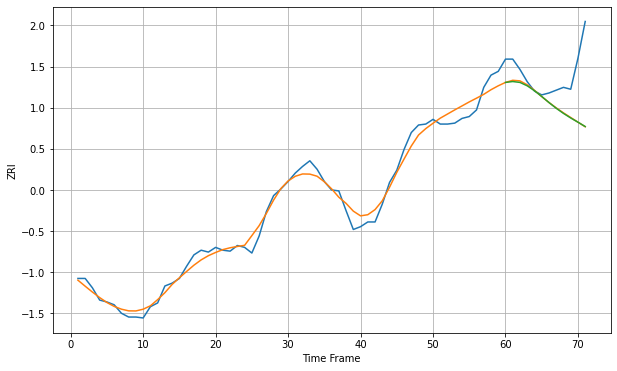

Wall time: 6.7 s
33436 8.55055399750594 41.339066714976305 41.477080178597134 [1542.23773039 1543.19212848 1542.22586118 1538.62694918 1533.45379699
 1527.27191503 1520.83710702 1514.7760492  1509.33674783 1504.46416632
 1499.9881444  1495.39354455]

Got an mse at 0.0100 in round 101 and stopped training

71 71 12


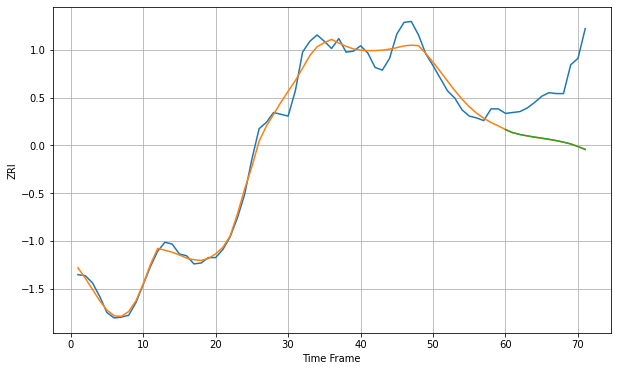

Wall time: 7.15 s
33444 10.549924902750297 64.27379970483736 64.2980734025264 [1657.02640463 1653.54219413 1651.51979443 1650.09798834 1648.76730906
 1647.57271401 1646.31851993 1644.87631499 1643.16939064 1641.09178793
 1638.19131174 1634.90259015]

Got an mse at 0.0100 in round 375 and stopped training

71 71 12


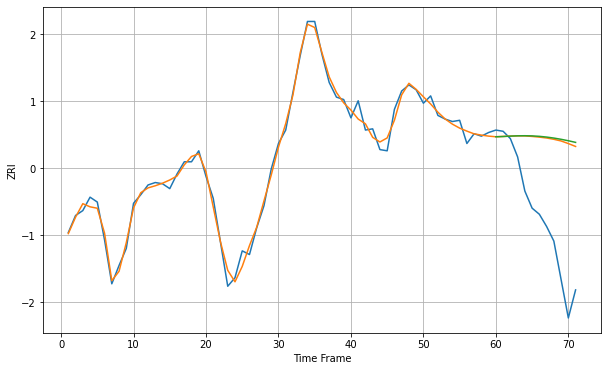

Wall time: 12.1 s
33460 5.46353597188738 75.94149654394683 77.14522552852081 [1499.50680362 1499.70769274 1500.03006937 1500.27672739 1500.35925859
 1500.22711415 1499.86012258 1499.26098136 1498.44501198 1497.43218659
 1496.2445235  1494.90692726]

Got an mse at 0.0100 in round 64 and stopped training

71 71 12


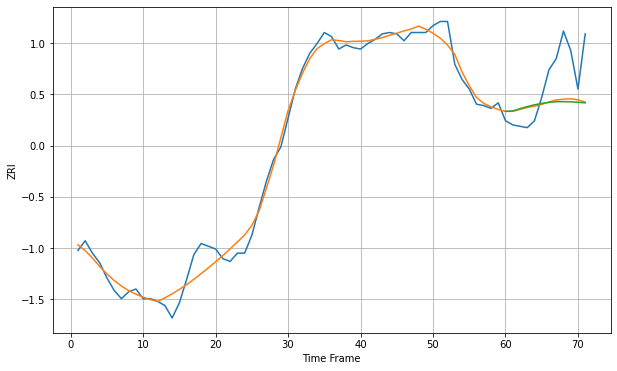

Wall time: 6.48 s
33461 7.409548418222368 26.25468046893829 27.12998892241857 [1430.8022856  1431.11459683 1432.75698423 1434.28418868 1435.56591149
 1436.58015986 1437.34365267 1437.79317425 1437.84303948 1437.7033603
 1437.41146574 1436.9929566 ]

Got an mse at 0.0100 in round 137 and stopped training

71 71 12


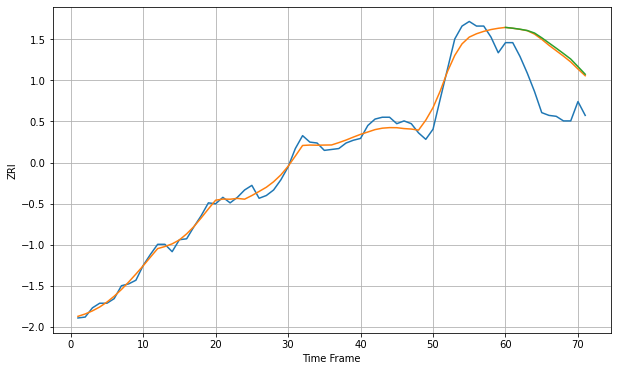

Wall time: 7.94 s
33510 8.873007865817819 55.338801547192695 57.10887068309111 [1293.54286905 1292.68780658 1291.57713771 1290.19017253 1287.47666286
 1282.295738   1276.65034349 1270.98708029 1265.18813084 1259.18304993
 1250.99195282 1242.69074762]

Got an mse at 0.0099 in round 52 and stopped training

71 71 12


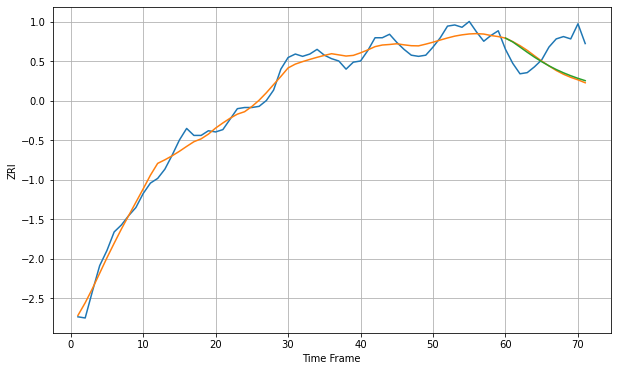

Wall time: 6.24 s
33511 6.693392469631236 25.964868001912507 24.974334344879328 [1279.69726347 1276.39771895 1271.98955227 1267.53075866 1263.30096538
 1259.39170274 1255.84991347 1252.67795492 1249.85178717 1247.33593625
 1245.09368622 1243.09303914]

Got an mse at 0.0096 in round 30 and stopped training

71 71 12


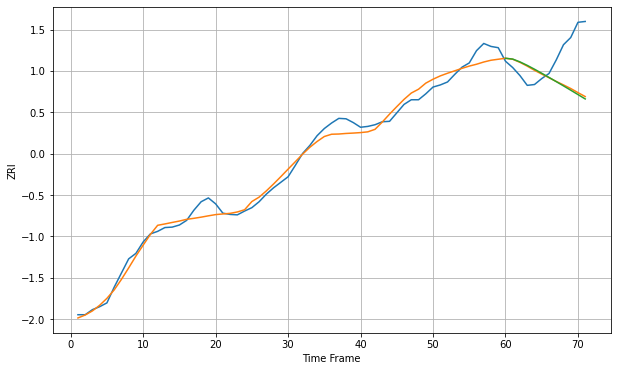

Wall time: 5.87 s
33602 18.3726366187476 86.60151717932817 89.2042456315911 [1849.05592573 1847.09612595 1840.4424491  1832.23079906 1823.19050243
 1813.62016675 1803.78557091 1793.83990995 1783.79892054 1773.61520115
 1763.28514736 1752.92242771]

Got an mse at 0.0099 in round 39 and stopped training

71 71 12


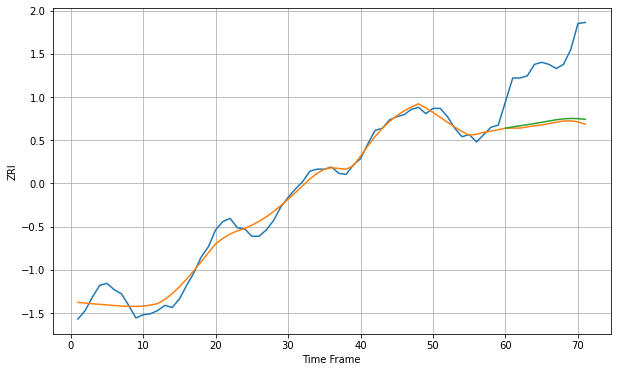

Wall time: 5.93 s
33604 8.130989063873962 62.02408354673404 59.61202019975251 [1009.09799791 1010.37282006 1011.40219948 1012.43753318 1013.52656498
 1014.70975292 1015.95979917 1017.1342917  1018.0058605  1018.3850703
 1018.21535412 1017.55350963]

Got an mse at 0.0098 in round 33 and stopped training

71 71 12


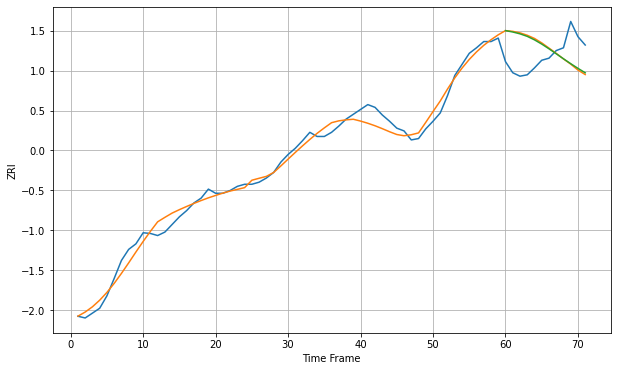

Wall time: 6.2 s
33606 11.026990733566231 44.34520765952758 43.13466731083431 [1569.78928701 1567.81272097 1565.13495426 1561.49804818 1556.46010091
 1550.35684852 1543.56392995 1536.37225986 1529.12116786 1522.06636749
 1515.32717656 1508.92941315]

Got an mse at 0.0099 in round 92 and stopped training

71 71 12


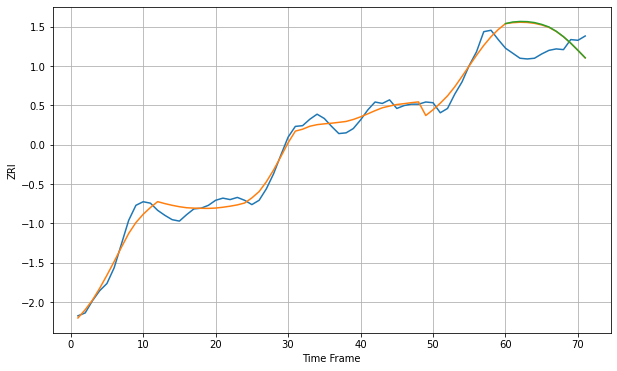

Wall time: 6.95 s
33607 10.891373022540238 35.56757707178294 36.17683587376247 [1487.25952697 1489.49810044 1490.2573853  1490.02638674 1488.70510806
 1486.17751311 1482.54197858 1476.62330713 1469.06933077 1460.04036457
 1449.97613687 1439.56882128]

Got an mse at 0.0100 in round 64 and stopped training

71 71 12


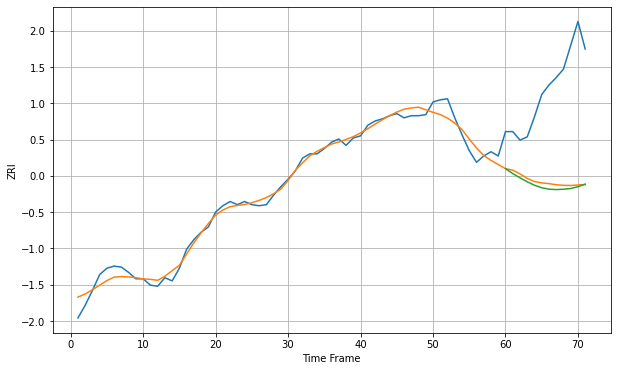

Wall time: 6.47 s
33612 6.775341447091062 93.32432965407874 95.93399881531609 [966.98902591 962.35129511 958.37757132 954.61029982 951.34328457
 948.95436493 947.62664345 947.25458987 947.56378759 948.27005216
 949.99166018 952.36417269]

Got an mse at 0.0100 in round 45 and stopped training

71 71 12


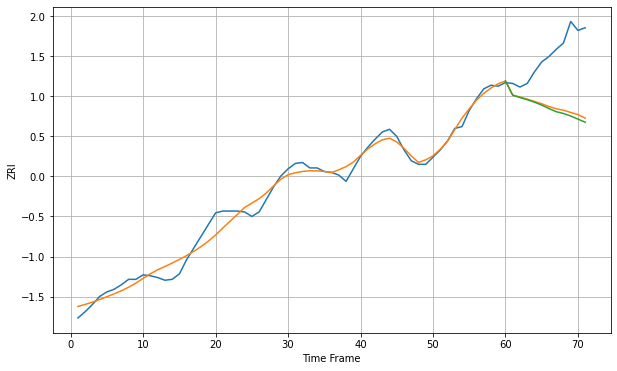

Wall time: 6.09 s
33613 8.803260449947503 61.96353047465097 64.73293702527242 [1200.76550615 1184.93433076 1182.32607105 1179.94223097 1177.15375688
 1173.89588921 1170.11608929 1166.5777156  1164.57923583 1161.75746044
 1158.34347433 1154.83559306]

Got an mse at 0.0099 in round 35 and stopped training

71 71 12


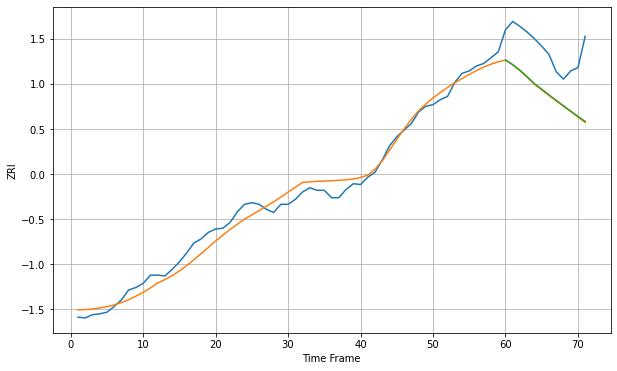

Wall time: 5.95 s
33615 10.601652327693776 56.055229458491496 55.43323864925297 [1282.13008663 1276.60172803 1269.69213803 1261.72960651 1253.44790945
 1246.7107343  1239.91154988 1233.18943483 1226.59262722 1220.12750243
 1213.78134244 1207.5350461 ]

Got an mse at 0.0100 in round 104 and stopped training

71 71 12


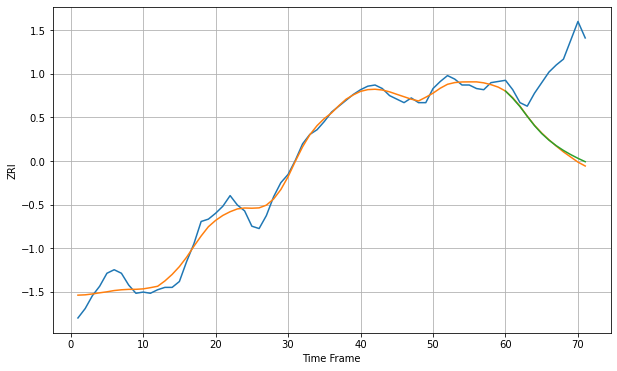

Wall time: 7.13 s
33617 7.368572521412831 66.48321787792582 65.16513411453779 [1067.84694525 1061.68530109 1054.64345029 1046.40262056 1038.49284323
 1031.74655486 1026.13546502 1021.42960935 1017.39455821 1013.85120919
 1010.67895709 1007.80167487]

Got an mse at 0.0100 in round 52 and stopped training

71 71 12


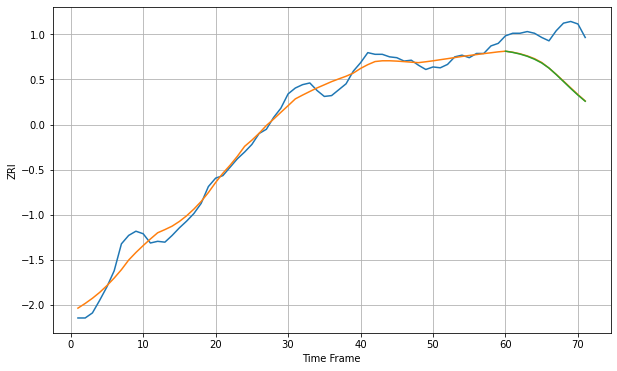

Wall time: 6.2 s
33626 10.564250283316241 51.186216961461724 51.573936504743 [1437.70767331 1436.26818    1434.32765433 1431.68055938 1428.18554131
 1423.7182436  1417.68146271 1409.96913068 1401.74418358 1393.4681602
 1385.56366058 1378.30746332]

Got an mse at 0.0098 in round 43 and stopped training

71 71 12


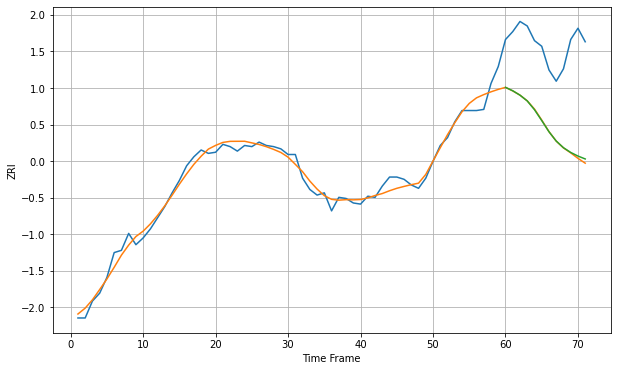

Wall time: 6.11 s
33634 6.348091448300782 74.71514359089208 74.0284787850939 [1209.54732064 1206.52957333 1202.62791853 1197.52240403 1189.7242175
 1180.10505346 1170.17172146 1161.91957756 1156.00788023 1151.82016192
 1148.62688109 1146.05032544]

Got an mse at 0.0095 in round 44 and stopped training

71 71 12


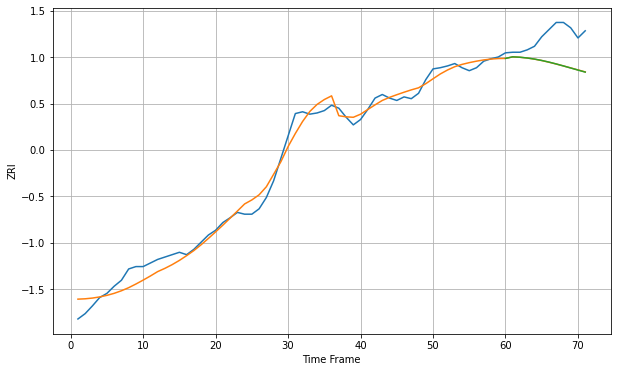

Wall time: 6.12 s
33701 14.788925569111147 48.18820768357087 48.20892461129819 [1354.61171048 1357.30462153 1356.59798335 1355.32560523 1353.50062984
 1351.17341106 1348.41626902 1345.32083412 1341.99138384 1338.53600141
 1335.05762986 1331.64666716]

Got an mse at 0.0096 in round 59 and stopped training

71 71 12


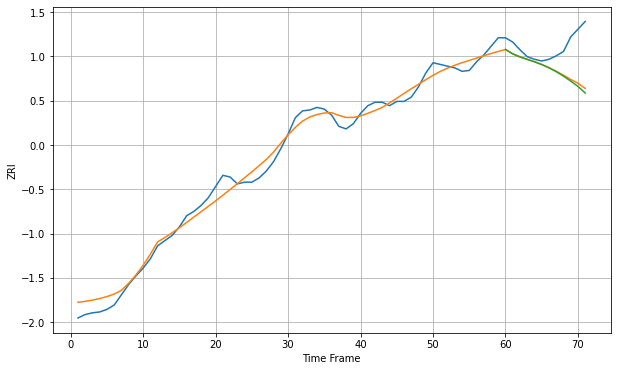

Wall time: 6.49 s
33702 9.851775122230531 34.2781198789629 36.21934854365694 [1168.41765346 1163.16535632 1159.62083206 1156.82974505 1154.05936163
 1150.87461466 1147.07202409 1142.57907083 1137.40428455 1131.6314692
 1125.41517862 1117.73887341]

Got an mse at 0.0099 in round 43 and stopped training

71 71 12


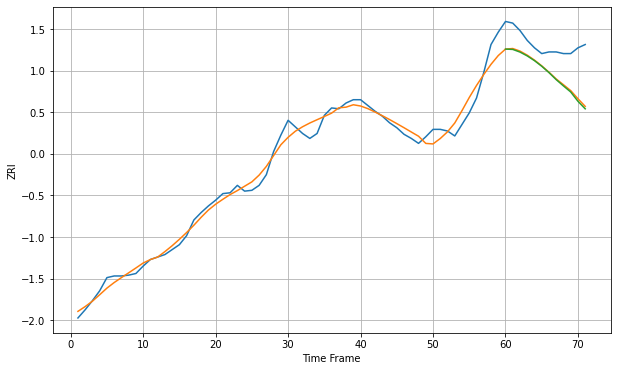

Wall time: 6.7 s
33705 9.9474031645056 38.801296579631156 40.25810308224469 [1315.45038658 1315.06998095 1311.83537993 1307.17899217 1301.41812461
 1294.62821216 1286.89425242 1278.34979638 1270.73303245 1263.36986118
 1252.08625423 1242.94311328]

Got an mse at 0.0098 in round 75 and stopped training

71 71 12


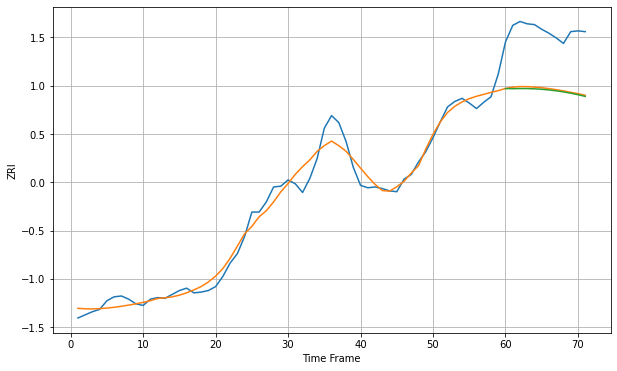

Wall time: 7.15 s
33706 12.121320735667586 74.65345599823009 76.32739922636902 [1486.4987151  1486.28985521 1486.4877912  1486.4407472  1486.12488497
 1485.54060051 1484.69015757 1483.57497853 1482.19478693 1480.54925863
 1478.64140647 1476.48019008]

Got an mse at 0.0099 in round 20 and stopped training

71 71 12


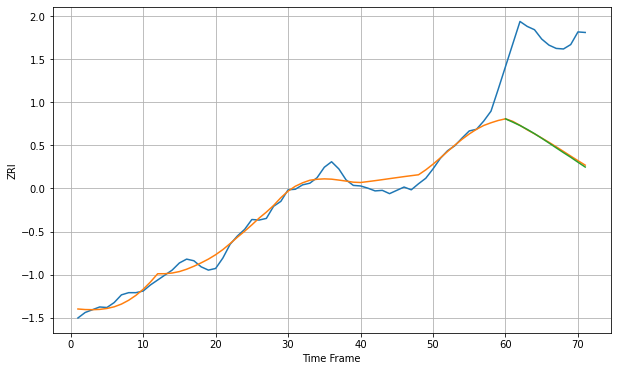

Wall time: 5.88 s
33708 14.802305514805553 187.0428125857688 188.39914624812945 [1526.01013408 1520.04111819 1513.84217785 1506.80539609 1499.04110938
 1490.72399685 1482.05729714 1473.26160055 1464.55934608 1456.15651134
 1447.17084374 1438.37927075]

Got an mse at 0.0098 in round 32 and stopped training

71 71 12


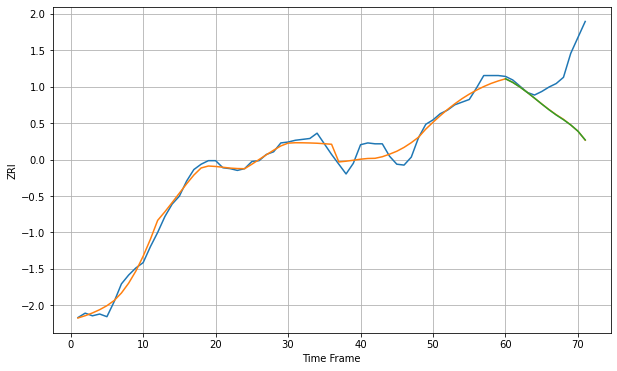

Wall time: 6.37 s
33712 7.997501551063062 57.705506328737364 57.72054018728674 [1144.32732715 1140.25206165 1134.98771944 1129.01639888 1122.54775531
 1115.90197772 1109.4544239  1103.5053434  1098.19032714 1092.31258834
 1085.24887471 1075.35282743]

Got an mse at 0.0099 in round 59 and stopped training

71 71 12


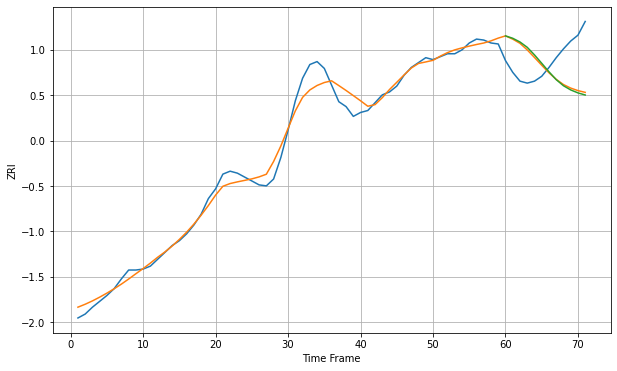

Wall time: 6.66 s
33716 9.130317095135181 38.475788102267884 40.05738379003742 [1203.25229499 1200.82909434 1197.02246697 1191.58305571 1183.82744484
 1175.24612588 1166.55220917 1158.52964985 1152.30937283 1148.03017301
 1145.00025635 1142.86107501]

Got an mse at 0.0100 in round 40 and stopped training

71 71 12


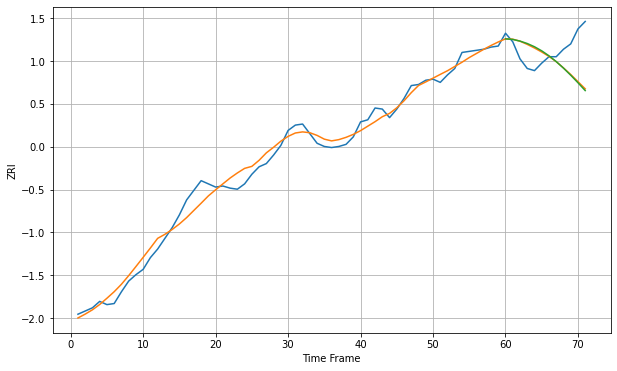

Wall time: 6.13 s
33755 7.917149158920044 27.27309088869163 27.981511523817453 [1095.72218802 1095.17199183 1093.63334836 1091.36821595 1088.33813601
 1084.50307022 1079.85541181 1074.43820105 1068.34648641 1061.70877897
 1054.65954637 1047.31903621]

Got an mse at 0.0094 in round 60 and stopped training

71 71 12


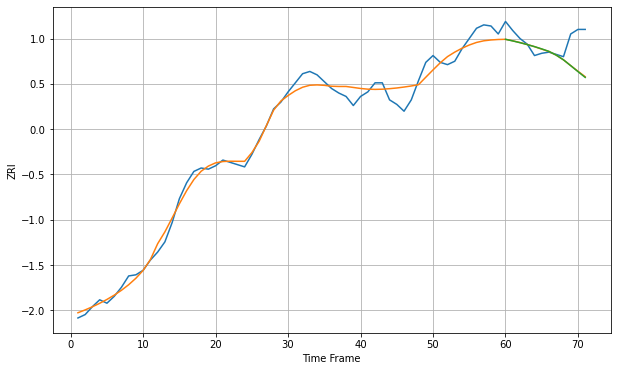

Wall time: 6.45 s
33756 7.4997719489419765 18.910204022158176 19.086461364151486 [1127.28899754 1125.86897278 1124.33533878 1122.66420965 1120.84043986
 1118.84442175 1116.65640456 1113.35767022 1109.22664297 1104.09772973
 1098.85956836 1093.75042075]

Got an mse at 0.0096 in round 33 and stopped training

71 71 12


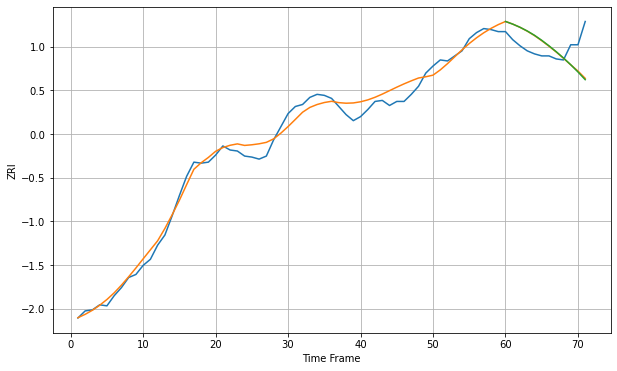

Wall time: 5.85 s
33771 8.221006127146241 22.29778612862513 22.733184637673595 [1183.02893671 1180.40912346 1177.2907026  1173.61540802 1169.37024552
 1164.39967525 1158.97095328 1153.14551275 1146.93037766 1140.27662924
 1133.12995774 1125.5160331 ]

Got an mse at 0.0100 in round 102 and stopped training

71 71 12


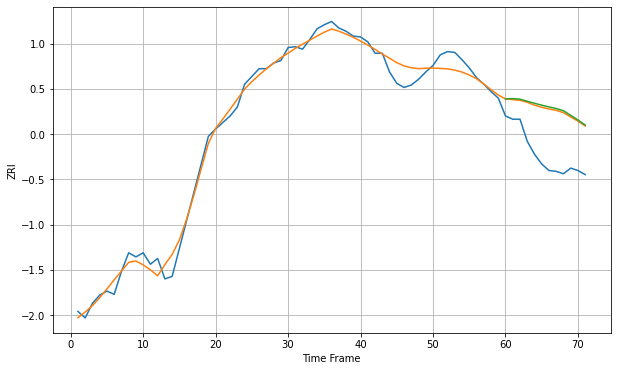

Wall time: 7.3 s
33907 11.029756035040734 58.04875297398993 59.85729184305913 [1240.86779526 1241.33197497 1240.60541022 1238.06760456 1235.56699846
 1233.23855201 1231.08618142 1229.08148648 1226.4221249  1220.76249729
 1215.05771784 1208.76958923]

Got an mse at 0.0098 in round 59 and stopped training

71 71 12


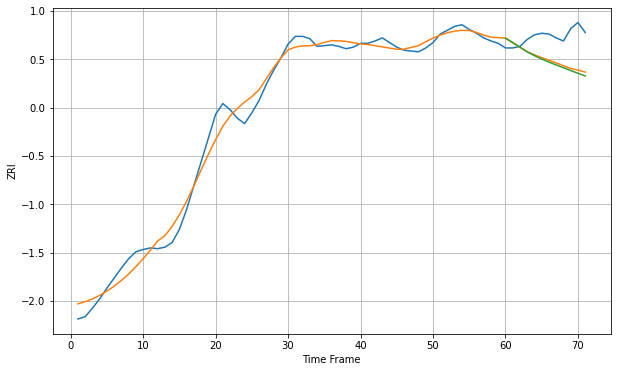

Wall time: 7.14 s
33916 12.327341286678669 34.70165808274396 37.07825229953567 [1156.67856048 1150.96689289 1144.97796854 1138.95111547 1133.98705764
 1129.64854419 1125.70445397 1121.97884765 1118.35894296 1114.78135252
 1111.21386905 1107.641143  ]

Got an mse at 0.0099 in round 44 and stopped training

71 71 12


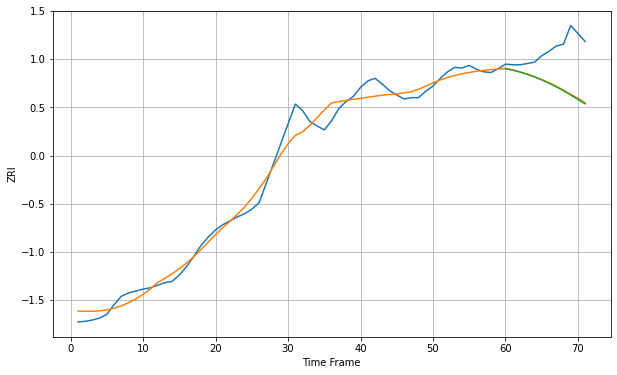

Wall time: 6.56 s
33973 14.709810128480477 60.721078104207024 61.60989578489942 [1103.23566154 1100.75357539 1097.74680782 1094.24608559 1090.22724098
 1085.66003388 1080.52460169 1074.83263011 1068.64483014 1062.07310574
 1055.26100561 1048.350308  ]

Got an mse at 0.0100 in round 255 and stopped training

71 71 12


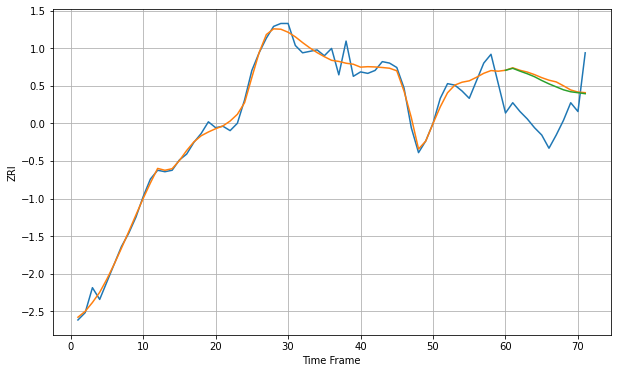

Wall time: 10.4 s
34203 5.107179106176789 30.355251351539383 29.03477063514705 [1505.11739688 1506.45957763 1504.5165097  1502.75918976 1500.72806075
 1498.15204709 1495.8530514  1493.8110207  1491.80761797 1490.46659985
 1489.83120899 1489.15325477]

Got an mse at 0.0100 in round 239 and stopped training

71 71 12


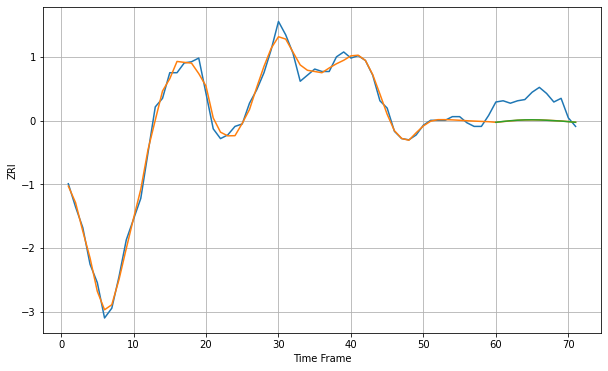

Wall time: 9.65 s
34207 5.145100824987682 17.359841408410507 17.33548670105927 [1175.3540923  1176.06980447 1176.65519954 1177.09416468 1177.34321402
 1177.41202864 1177.31116008 1177.04826279 1176.70648553 1176.37521319
 1175.87811251 1175.37404297]

Got an mse at 0.0100 in round 247 and stopped training

71 71 12


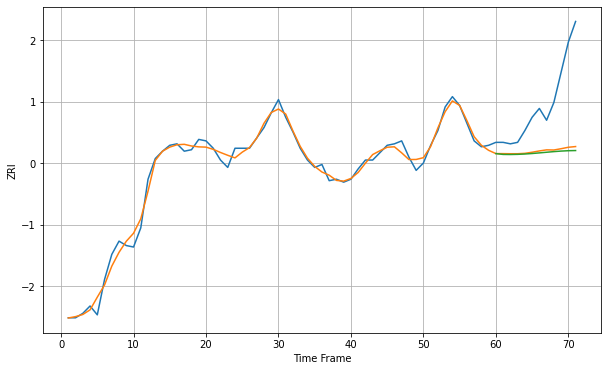

Wall time: 10 s
34208 4.158090981830583 39.01542295828713 40.34850347138831 [1192.3729348  1191.81313137 1191.75748691 1191.86117301 1192.09483247
 1192.43489039 1192.84712822 1193.2899036  1193.71667144 1194.07867747
 1194.33100537 1194.44174517]

Got an mse at 0.0100 in round 218 and stopped training

71 71 12


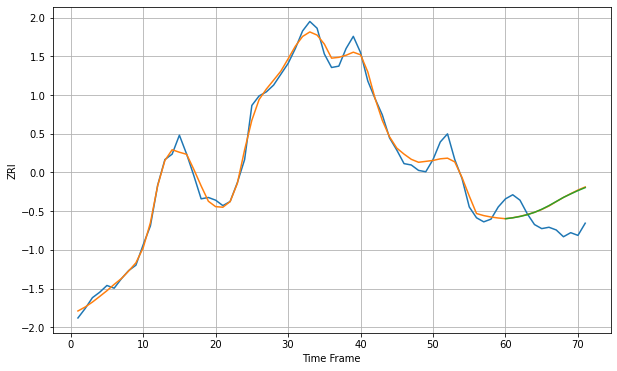

Wall time: 9.47 s
34210 5.672957269062571 20.65851079637708 20.586493025893734 [1271.31650809 1271.96595779 1272.94943779 1274.2687457  1276.01345926
 1278.30897883 1281.0106694  1284.02179714 1287.0508069  1289.62571323
 1292.09002788 1294.29738452]

Got an mse at 0.0098 in round 53 and stopped training

71 71 12


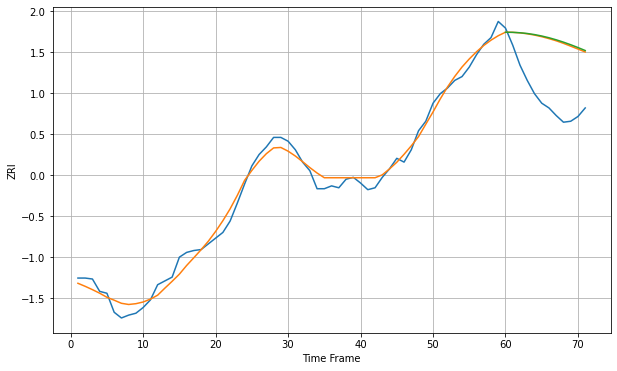

Wall time: 6.37 s
34232 8.492999326463822 61.64647654922456 62.56028974767285 [1509.68857947 1509.54165535 1509.12438699 1508.34242591 1507.19876242
 1505.70086303 1503.86067379 1501.69609128 1499.23246637 1496.50341295
 1493.55042617 1490.42125685]

Got an mse at 0.0099 in round 29 and stopped training

71 71 12


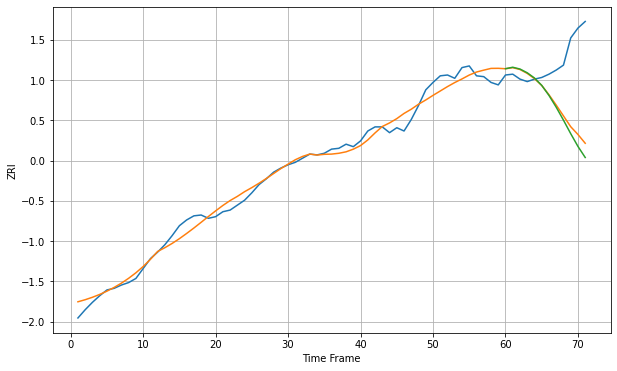

Wall time: 5.92 s
34683 9.57178449266205 68.84738976836184 75.88351933591456 [1138.63047124 1140.4254892  1138.23511513 1133.69675785 1127.32969487
 1118.39084261 1106.17713153 1091.8820265  1076.15335429 1059.76715096
 1044.27475147 1030.85061888]

Got an mse at 0.0099 in round 62 and stopped training

71 71 12


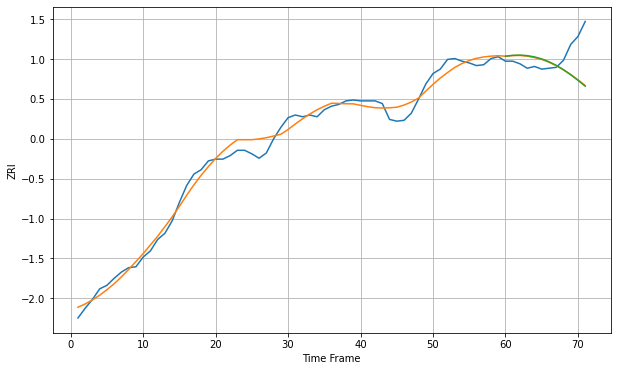

Wall time: 6.84 s
34698 8.971867980673666 28.25113002934189 28.615346700061394 [1253.63877078 1254.63818031 1254.88494458 1254.29545201 1252.8538859
 1250.54255197 1247.34278935 1243.25135904 1238.30483901 1232.60334337
 1226.32201796 1219.70141422]

Got an mse at 0.0100 in round 391 and stopped training

71 71 12


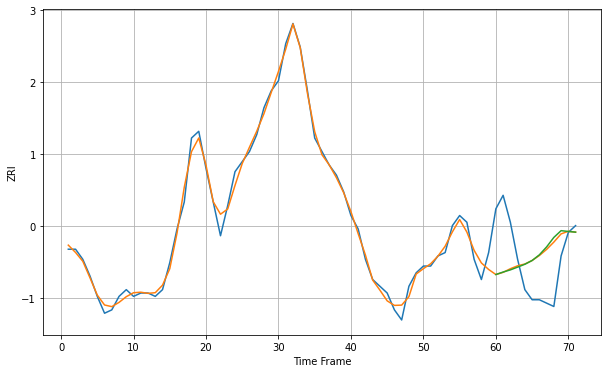

Wall time: 12.9 s
37040 2.118392988954237 13.321225146135328 13.64272561155462 [733.48495933 734.22406359 734.86727092 735.6866965  736.53231755
 737.65074392 739.33218482 741.67711824 744.5013509  746.50684905
 746.26922596 746.06549003]

Got an mse at 0.0099 in round 402 and stopped training

71 71 12


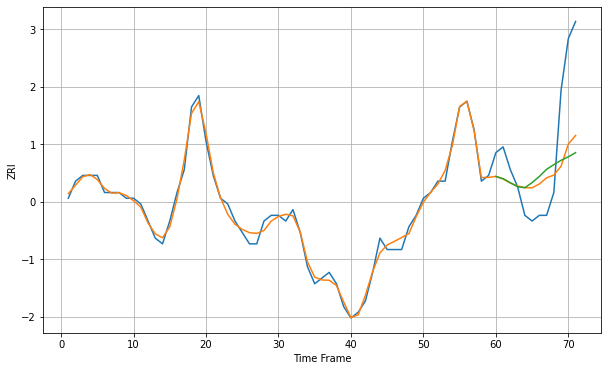

Wall time: 13.2 s
37042 0.9979679729327439 9.642887680281406 10.685382754427872 [717.82226278 717.43648952 716.70881388 716.01880493 715.8488225
 716.74186824 717.82186682 719.06932005 719.89589266 720.65075354
 721.26438604 721.9909185 ]

Got an mse at 0.0099 in round 152 and stopped training

71 71 12


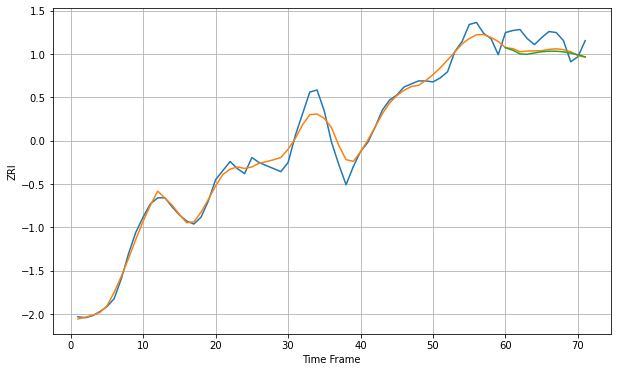

Wall time: 8.39 s
37075 8.499619964641301 14.18606369629543 15.498403743924372 [1127.94756775 1125.49855967 1121.82891382 1121.45429793 1122.78807636
 1123.93361492 1124.52942728 1124.49506894 1123.84575753 1122.64124599
 1120.95919674 1118.88004937]

Got an mse at 0.0100 in round 112 and stopped training

71 71 12


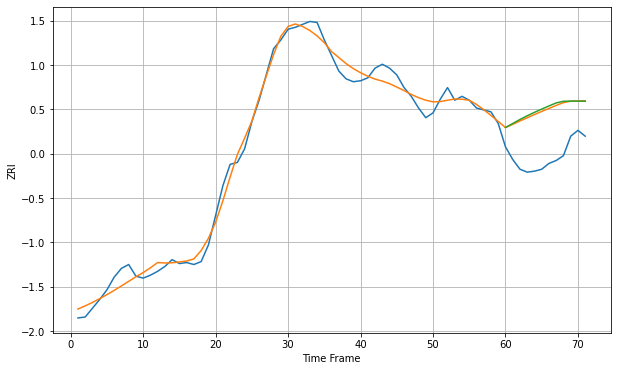

Wall time: 7.39 s
37076 9.069238029319232 47.55953609349716 49.05265827406547 [1109.91226378 1114.05157537 1118.18608749 1121.998234   1125.54630572
 1128.89713121 1132.10934027 1135.23550822 1136.87831605 1137.06529947
 1137.08697273 1136.95335491]

Got an mse at 0.0096 in round 36 and stopped training

71 71 12


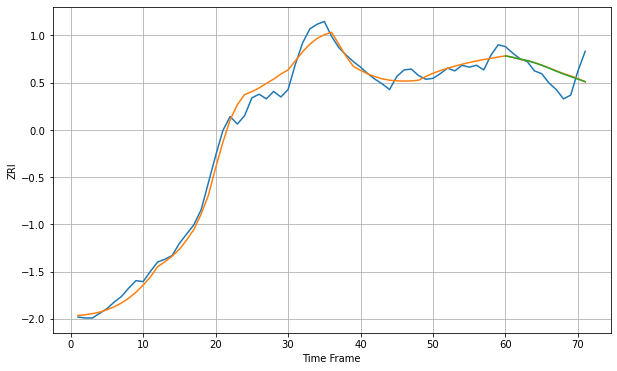

Wall time: 6.06 s
37115 9.605433621141191 16.47845068112468 16.234228303801046 [1150.10695619 1148.51589617 1146.58757177 1145.05246165 1142.79253927
 1140.04036567 1136.98629869 1133.67147641 1130.62352113 1127.8453857
 1125.17420863 1122.42342474]

Got an mse at 0.0099 in round 109 and stopped training

71 71 12


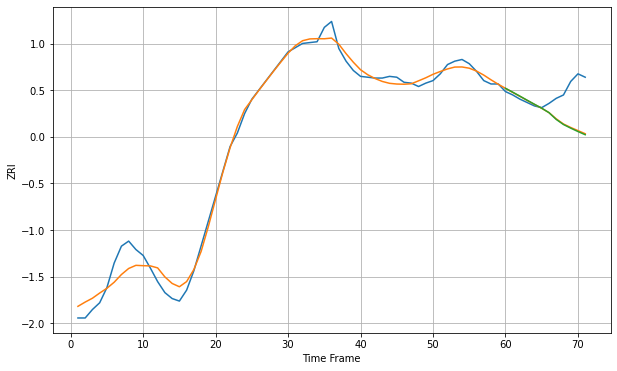

Wall time: 7.72 s
37211 10.889744123378243 34.02440054729879 34.6050166271711 [1198.83617582 1194.27452314 1189.52508159 1184.71510151 1179.95922323
 1175.31124217 1170.05599984 1162.03534711 1155.99789352 1151.71646975
 1147.70578164 1143.94109189]

Got an mse at 0.0100 in round 55 and stopped training

71 71 12


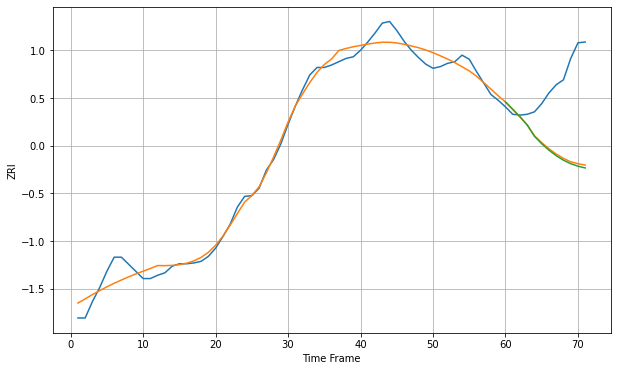

Wall time: 6.32 s
37214 11.549529257202625 83.784697861921 85.6118733644237 [1150.96027867 1142.09930473 1132.99542316 1122.87659194 1109.14800584
 1100.11506148 1092.29137634 1085.57082344 1080.06835348 1075.8363061
 1072.77721022 1070.66981449]

Got an mse at 0.0099 in round 59 and stopped training

71 71 12


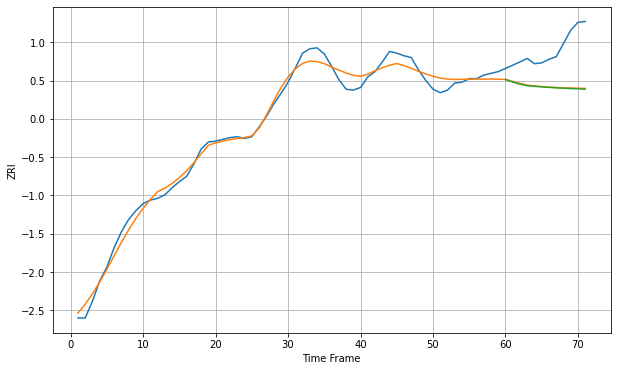

Wall time: 6.46 s
37221 8.597766580296074 44.57748005980791 45.09287551550441 [1335.07463478 1332.15538749 1329.72373118 1328.00384026 1327.2945274
 1326.65444703 1326.08345767 1325.58335341 1325.14862846 1324.76935876
 1324.43261139 1324.12308968]

Got an mse at 0.0100 in round 103 and stopped training

71 71 12


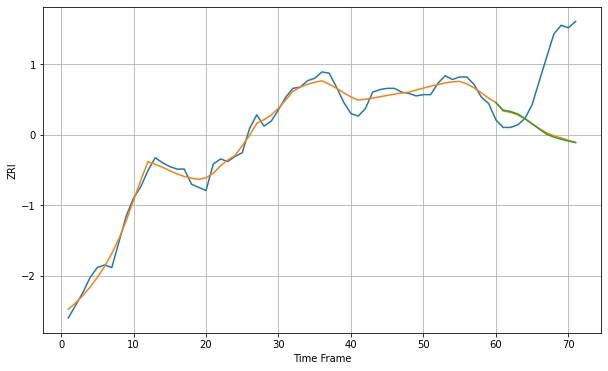

Wall time: 7.12 s
38104 5.557268478504084 55.83281646121387 56.35961790233057 [798.75668203 792.71917534 791.69464315 789.74259926 786.1547484
 781.87029856 777.62387444 773.68262601 771.32422732 769.64813042
 768.24475454 767.0259347 ]

Got an mse at 0.0099 in round 405 and stopped training

71 71 12


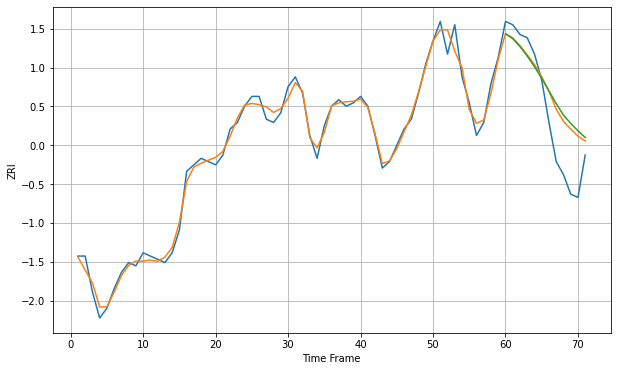

Wall time: 13.4 s
40391 2.3637867640133834 11.071338024118832 12.093627808209325 [829.24228335 827.7295823  825.2610948  822.38052717 819.11740799
 815.51332347 811.67740179 807.795645   804.2509735  801.73476176
 799.41889562 797.38988918]

Got an mse at 0.0099 in round 104 and stopped training

71 71 12


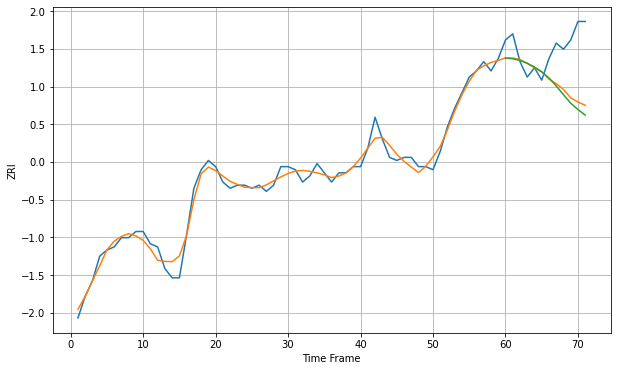

Wall time: 7.86 s
40502 2.413741810049693 13.770886621130192 15.072236777350284 [814.17348207 813.92747405 813.35168527 812.45930808 811.24747945
 809.70427276 807.69403294 805.11032187 802.29833102 799.52974215
 797.48454001 795.69191431]

Got an mse at 0.0099 in round 281 and stopped training

71 71 12


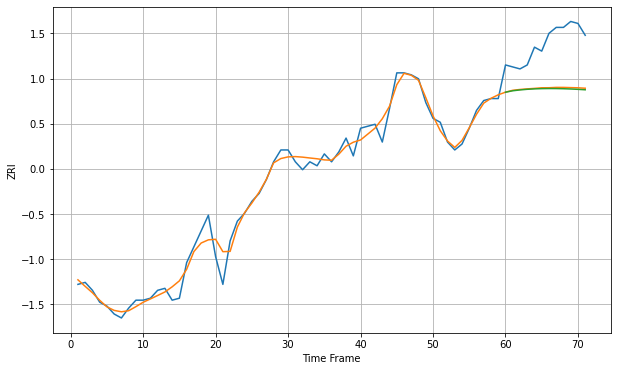

Wall time: 10.9 s
40515 4.536405814762085 23.909315038308403 24.39940888518871 [891.21843416 891.93150846 892.36701529 892.68374186 892.89820285
 893.02361653 893.07163018 893.05204321 892.97293529 892.84098621
 892.66182863 892.44036025]

Got an mse at 0.0099 in round 456 and stopped training

71 71 12


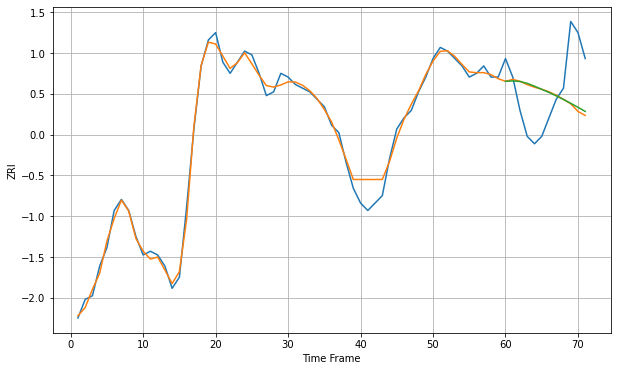

Wall time: 14.6 s
40517 2.1921804553498765 12.683499161612735 12.453577551032643 [874.85203498 874.9562964  874.79993534 874.30142378 873.54276831
 872.68262354 871.85406715 870.93424816 869.95209296 868.92126413
 867.84659878 866.72957314]

Got an mse at 0.0099 in round 41 and stopped training

71 71 12


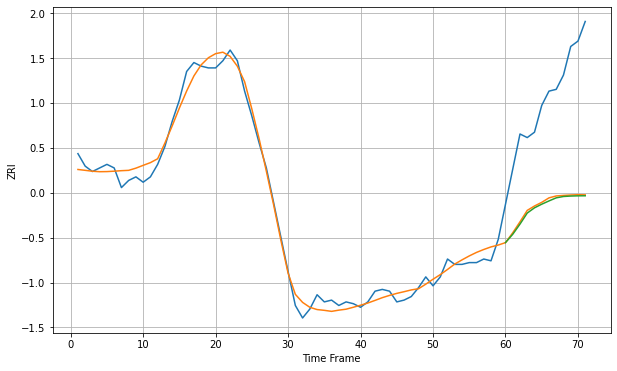

Wall time: 6.07 s
43055 4.918554707160194 61.82617453372288 62.65212079743246 [639.19005116 643.85440986 649.55765915 655.74091849 658.66458033
 660.69758698 662.52567205 664.25992149 665.0126156  665.25607964
 665.37865276 665.41126561]

Got an mse at 0.0100 in round 128 and stopped training

71 71 12


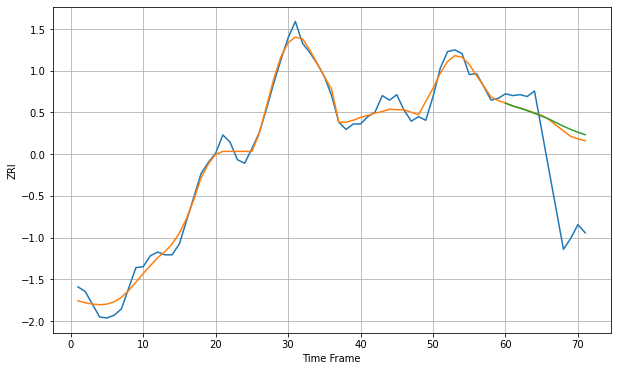

Wall time: 7.91 s
43201 9.081677312149143 71.38993727083457 75.09819491216268 [1100.73019667 1097.61465743 1095.24127922 1092.56834232 1089.63118912
 1086.53414069 1083.39992623 1079.44717877 1075.49114447 1072.02859159
 1068.99165871 1066.24059138]
71 71 12


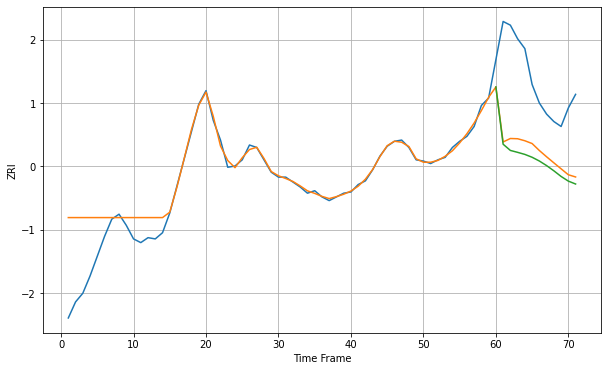

Wall time: 14.9 s
43202 18.44836239946037 61.34982616046247 68.20699823795678 [948.99517527 902.64528358 897.61257377 896.06343987 894.39543426
 892.08366227 889.04196169 885.3392969  881.12359992 876.55428142
 872.783327   870.429509  ]

Got an mse at 0.0099 in round 81 and stopped training

71 71 12


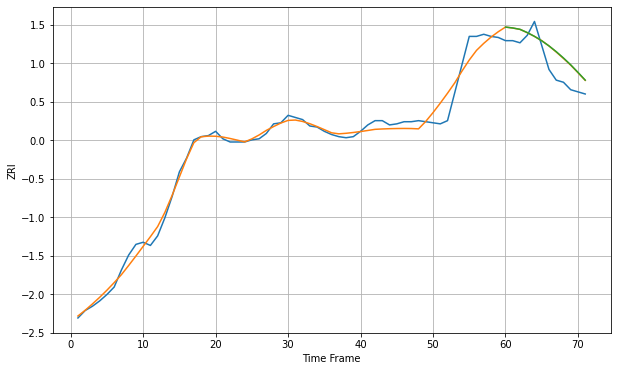

Wall time: 7.09 s
43204 7.118349104964074 16.77557804634955 16.965375751692108 [981.74220997 980.90904043 979.62854755 976.59685671 973.0231061
 968.86652776 964.09617992 958.71121552 952.75903717 946.34777165
 939.30070259 932.01216344]

Got an mse at 0.0100 in round 140 and stopped training

71 71 12


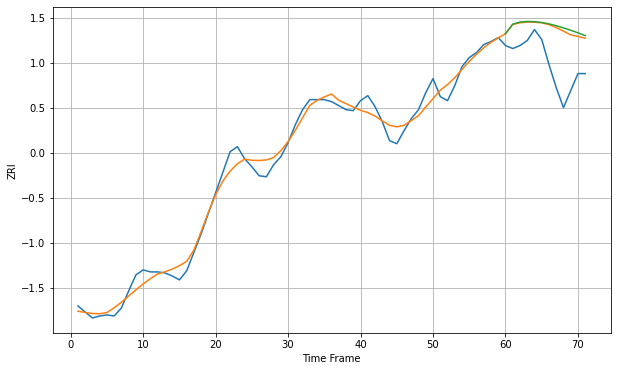

Wall time: 8.2 s
43205 8.945003914475583 39.4261544941798 41.37740092943309 [905.85736148 915.3789265  917.42841143 918.04790465 917.86623582
 917.01484611 915.61768818 913.7987476  911.66344179 909.28643602
 906.70973346 903.94949674]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


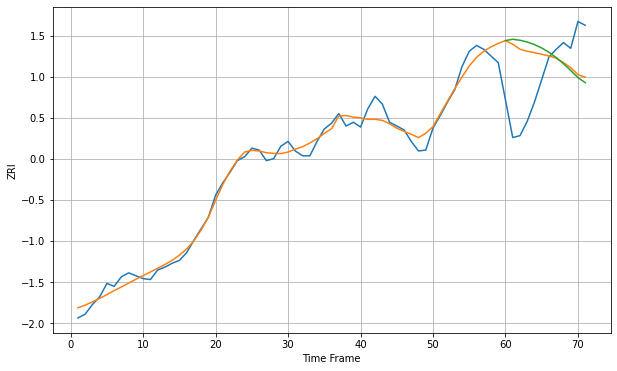

Wall time: 7.39 s
43206 8.479787315481651 55.539869038819305 60.437864027767525 [1012.10017261 1013.42911355 1012.43337259 1010.57622081 1007.90464375
 1004.34874288  999.84202655  994.36612193  987.99535996  980.92760363
  973.47459788  968.2381003 ]

Got an mse at 0.0099 in round 132 and stopped training

71 71 12


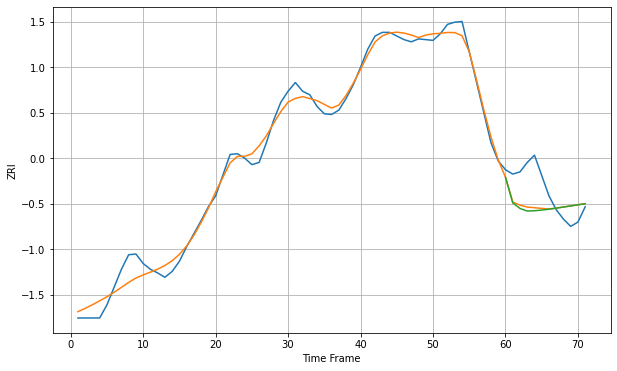

Wall time: 8.14 s
43212 12.36138298017241 37.30755108303027 39.55438963819318 [1069.63059007 1034.35767331 1026.70040496 1023.11596444 1023.570942
 1024.46848946 1025.71337438 1027.15544889 1028.66735851 1030.19721868
 1031.70754849 1033.17262519]

Got an mse at 0.0100 in round 246 and stopped training

71 71 12


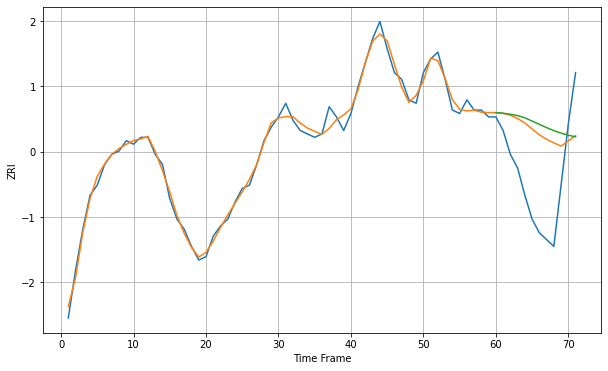

Wall time: 10.4 s
44035 1.9028111116271926 19.651807152110223 21.585358556607964 [673.25480484 673.08678684 672.77039318 672.38248987 671.73301871
 670.77988609 669.80008166 668.85144432 667.97903062 667.22715206
 666.62353198 666.15474663]
71 71 12


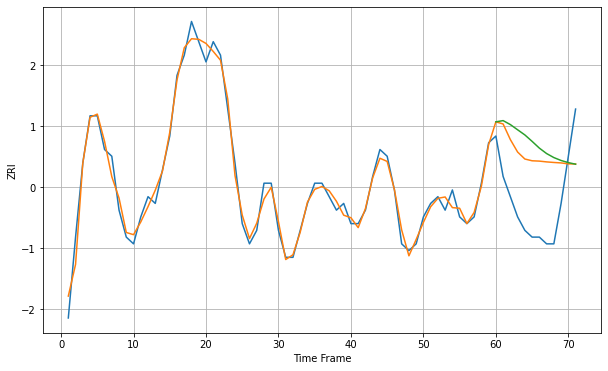

Wall time: 15.2 s
44052 1.395563423051997 9.103688851812821 10.73659337934914 [621.10667019 621.28677806 620.69615205 619.92633184 619.16313709
 618.20752475 617.20608779 616.39887035 615.80292776 615.3700587
 615.0534845  614.81956094]

Got an mse at 0.0100 in round 138 and stopped training

71 71 12


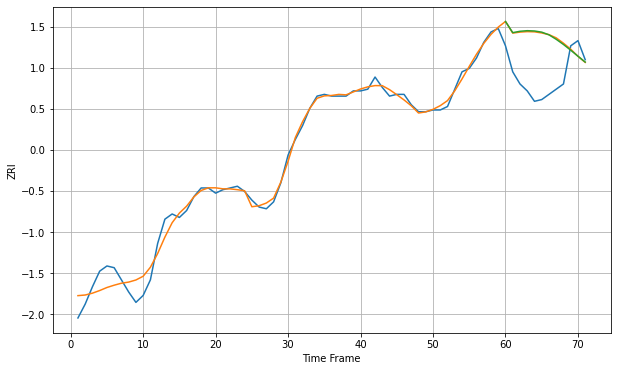

Wall time: 8.31 s
44102 4.720425198434797 26.689561877033498 26.79149056425157 [868.06036322 861.61682534 862.3916551  862.7415565  862.56757936
 861.8945637  860.34685638 857.76481784 854.78603657 851.48089435
 848.02552713 844.64458088]

Got an mse at 0.0100 in round 360 and stopped training

71 71 12


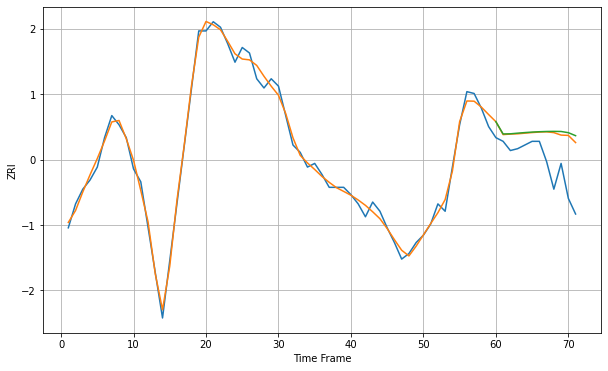

Wall time: 12.3 s
44103 3.5414727062145936 19.244938416434398 20.38244355856146 [871.67858213 864.99839129 865.0912794  865.43681632 865.75613811
 866.02041877 866.22109303 866.35589119 866.41112733 866.35095831
 865.70038083 864.07152866]

Got an mse at 0.0099 in round 65 and stopped training

71 71 12


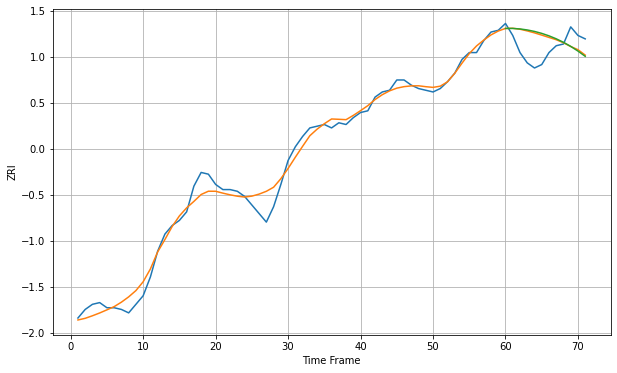

Wall time: 6.59 s
44107 5.279594280778744 11.752139061201081 12.252709065021206 [875.0983083  875.09762187 874.79504192 874.21394077 873.35216008
 872.20683092 870.77293863 869.04019542 866.99181726 864.6086497
 861.87978988 858.81688673]

Got an mse at 0.0099 in round 251 and stopped training

71 71 12


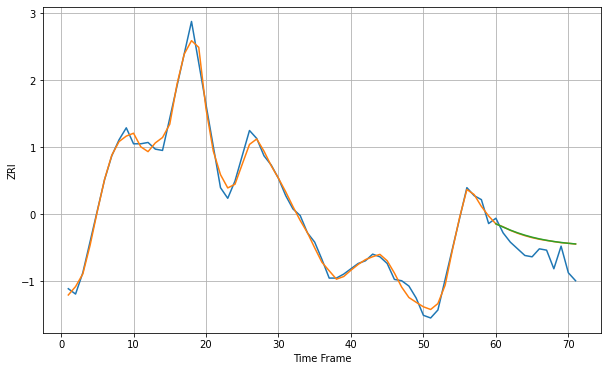

Wall time: 9.81 s
44108 4.981639909463438 14.340253481088018 14.46884622394421 [787.79213187 785.37165327 783.0728651  781.03419507 779.26682147
 777.75810885 776.48377483 775.41518793 774.52396777 773.78421314
 773.17321891 772.67142297]

Got an mse at 0.0099 in round 304 and stopped training

71 71 12


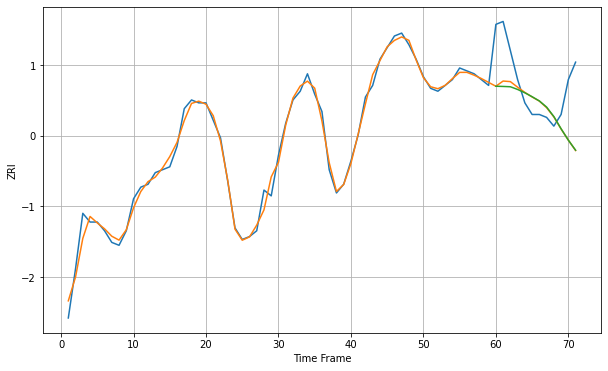

Wall time: 11.1 s
44109 2.414110821410294 14.341398364947699 14.687567942927863 [716.71728614 716.64746423 716.53930414 715.61389535 714.45387502
 713.1141515  711.65905289 709.55366981 706.29916821 702.08746058
 698.16929221 694.7214923 ]

Got an mse at 0.0100 in round 119 and stopped training

71 71 12


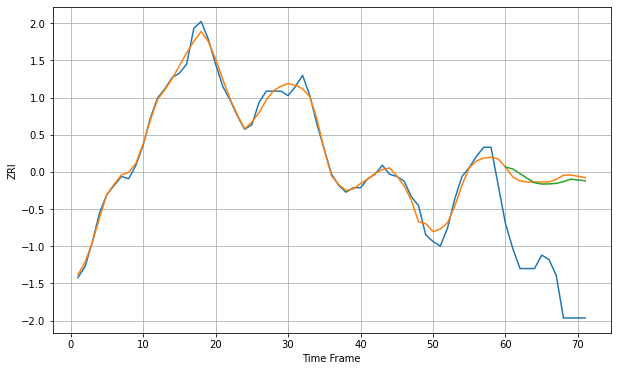

Wall time: 7.83 s
44110 3.280524097507411 46.71369146523085 46.155429845342404 [735.17658096 734.34236072 732.27390971 730.18336248 728.2337137
 727.6257516  727.68808374 727.91285553 728.69491458 729.80815456
 729.42662428 729.08233083]

Got an mse at 0.0100 in round 289 and stopped training

71 71 12


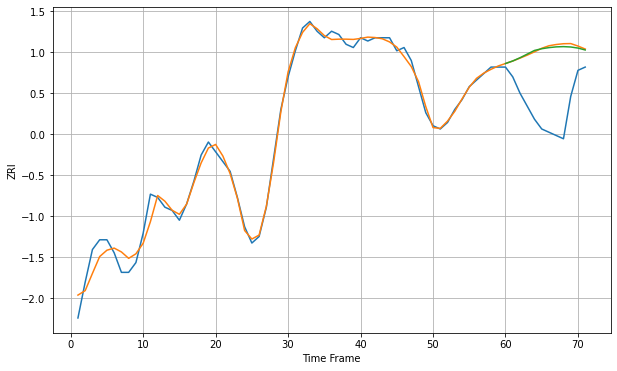

Wall time: 10.9 s
44111 2.5094684851137097 18.50938335061728 18.186892422537387 [762.09207343 762.87641232 763.86834127 764.9792487  766.10564598
 766.63335259 766.97414725 767.20144655 767.27660171 767.16719621
 766.83790586 766.24738465]

Got an mse at 0.0100 in round 334 and stopped training

71 71 12


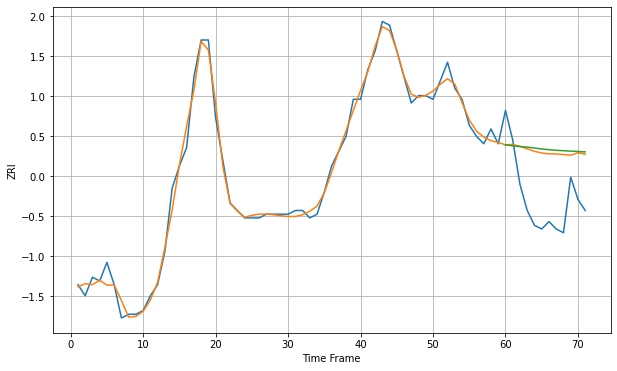

Wall time: 12.1 s
44112 2.1537320598299594 15.556213497745803 16.25355796247454 [682.70507017 682.45302012 682.25129321 682.10004286 681.8533996
 681.59427499 681.39418684 681.24342828 681.12522095 681.02185067
 680.91708406 680.79781147]

Got an mse at 0.0100 in round 246 and stopped training

71 71 12


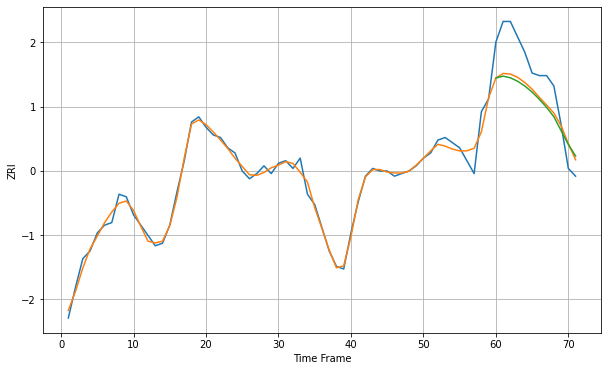

Wall time: 10.4 s
44118 2.4771626652538776 12.523291269434571 13.455736764499633 [969.07850296 969.79492071 969.14534464 967.81815644 965.94827394
 963.60546553 960.83443641 957.67592227 954.0585306  948.65838593
 943.28365635 938.82251762]

Got an mse at 0.0099 in round 191 and stopped training

71 71 12


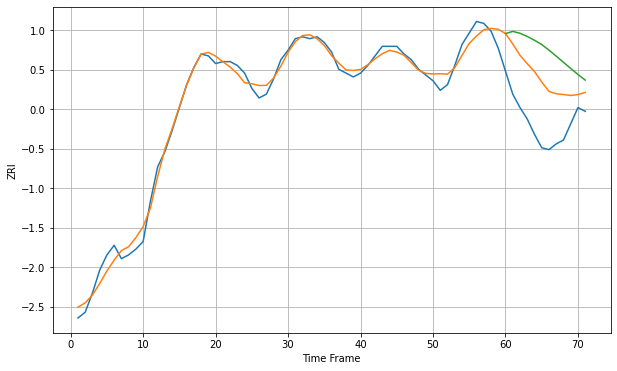

Wall time: 8.92 s
44120 4.097091081558102 24.929769648564765 38.756581508307825 [860.66353989 861.80294089 860.83654362 859.15807856 857.17194203
 854.92607627 852.01347809 848.87225736 845.65206763 842.42772086
 839.28652828 836.35516875]
71 71 12


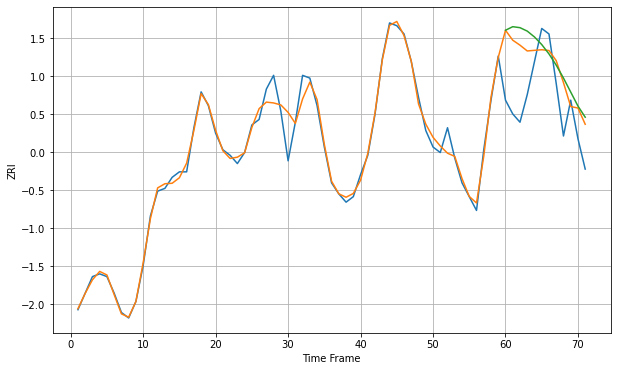

Wall time: 15.1 s
44133 3.4830537670378123 16.680947179363457 19.375623104218125 [1037.34725732 1038.64299089 1038.28227338 1037.04094621 1034.90949383
 1032.15919003 1028.76341377 1024.69092922 1020.00742099 1014.93744025
 1009.84787359 1005.81786905]
71 71 12


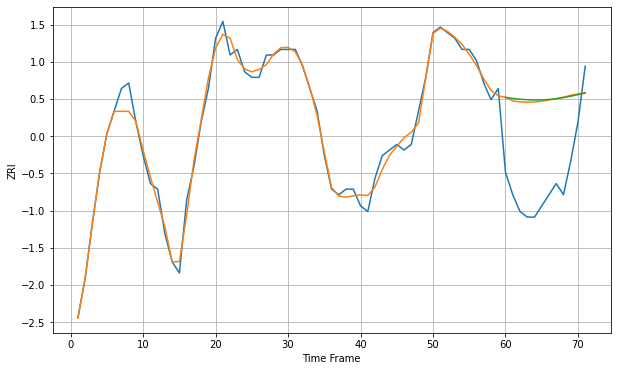

Wall time: 14.8 s
44646 1.5558610564563622 15.949885754065098 16.13945131270132 [647.43494419 647.22125859 647.09138865 646.99986179 646.95504796
 646.96655885 647.04099451 647.18002485 647.37927383 647.62785583
 647.90867266 648.19991635]

Got an mse at 0.0100 in round 137 and stopped training

71 71 12


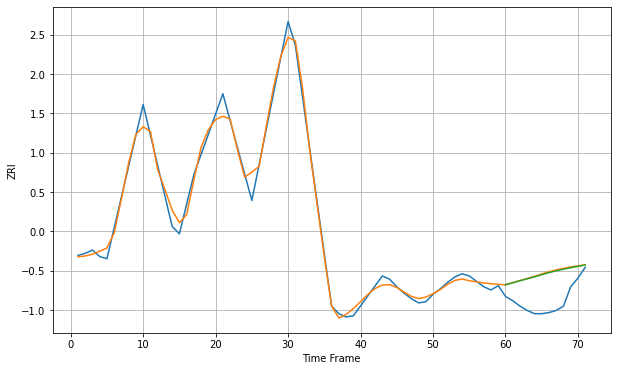

Wall time: 7.93 s
44720 7.192004803566849 27.31093809609315 26.771797616212385 [687.77870094 689.66886395 691.52929331 693.3467933  695.09149365
 697.11450811 699.03249019 700.72141212 702.22941589 703.60940914
 704.91027879 706.17324013]
71 71 12


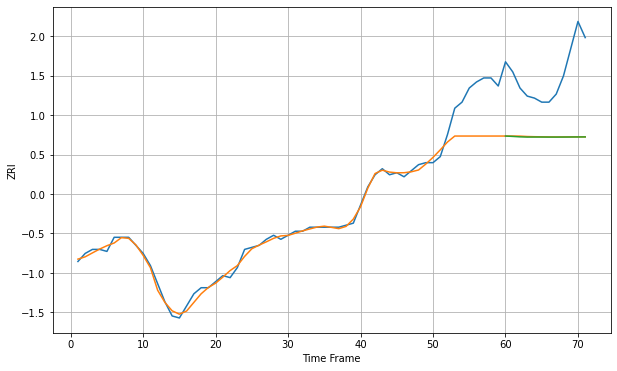

Wall time: 14.8 s
45205 8.437201692386566 33.25095126201012 33.34142747002267 [653.19853837 653.0142132  652.79243965 652.68667626 652.70504379
 652.70288456 652.68379018 652.68448821 652.69839773 652.71892159
 652.74087079 652.76110596]

Got an mse at 0.0100 in round 54 and stopped training

71 71 12


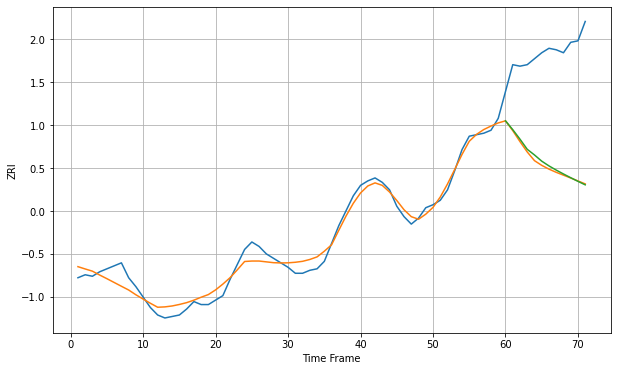

Wall time: 6.35 s
45211 5.6870929788403295 75.19285176010125 74.1207492679025 [768.3070272  762.40268019 755.98892504 749.20034667 745.39842572
 741.24663007 738.05207404 735.25347237 732.63586475 730.12864079
 727.69891474 725.36339105]

Got an mse at 0.0097 in round 31 and stopped training

71 71 12


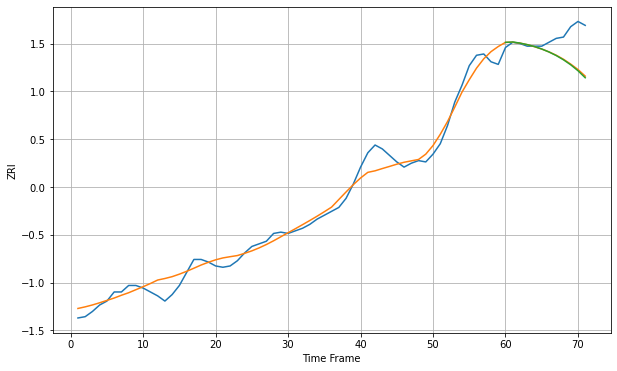

Wall time: 6.2 s
45212 7.154162086053213 18.821519090005523 19.30823479365957 [864.93987674 865.21416585 864.35886816 863.17649942 861.67395904
 859.80913929 857.53074918 854.78597037 851.52227937 847.67336805
 843.13151277 837.72888266]

Got an mse at 0.0098 in round 28 and stopped training

71 71 12


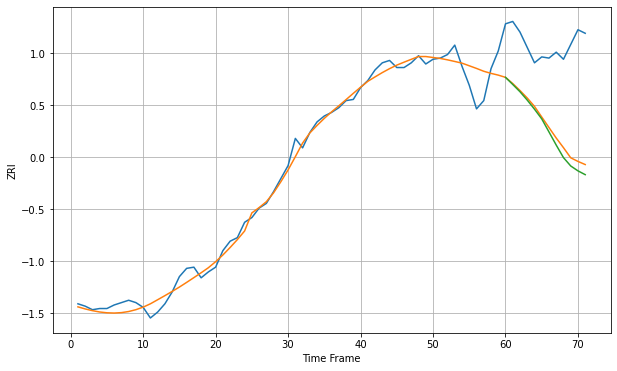

Wall time: 5.98 s
45219 8.547196144175972 71.50388275836025 76.32964754459788 [987.68948473 981.67306446 975.51273372 968.43686469 960.75336242
 952.54076334 941.48439251 930.35928345 919.7466822  912.6803504
 908.53372428 905.32160034]

Got an mse at 0.0099 in round 239 and stopped training

71 71 12


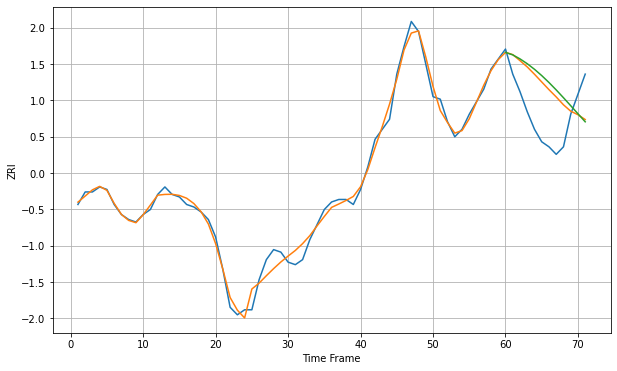

Wall time: 10.2 s
45405 2.881027956287613 16.602106179175177 18.264508965096848 [622.66743692 621.66828603 620.07649057 618.15106554 615.92104124
 613.40761396 610.6459335  607.68501708 604.58245996 601.39644556
 598.18087418 594.98391221]

Got an mse at 0.0100 in round 200 and stopped training

71 71 12


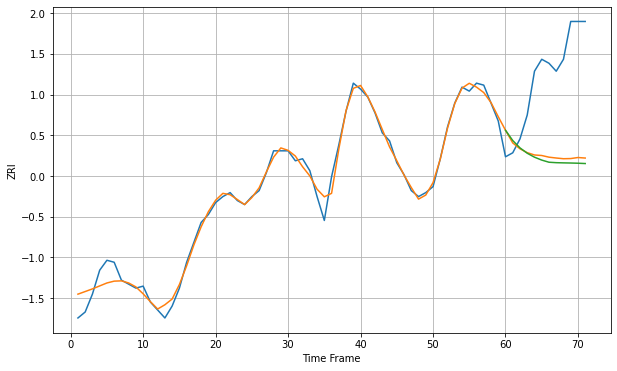

Wall time: 9.4 s
45840 4.0675394011141295 46.05654599997333 47.92866912935576 [803.33805792 798.17019046 794.46953803 791.77978686 789.79983173
 788.33963611 787.26544117 787.03883254 786.94120378 786.86735571
 786.76533592 786.60714182]

Got an mse at 0.0099 in round 197 and stopped training

71 71 12


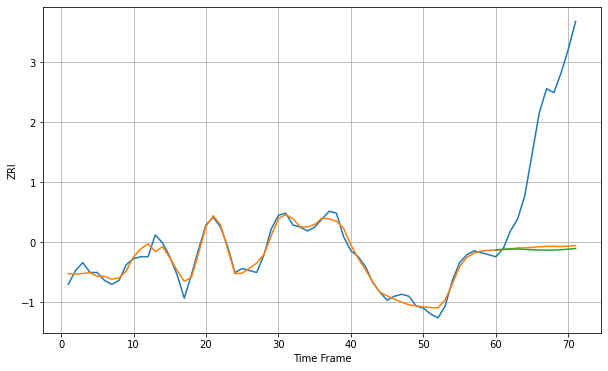

Wall time: 9.25 s
46143 3.0173714900523296 65.06276396564668 66.28353083584419 [880.38788942 880.79515873 880.89573948 880.85243752 880.7100827
 880.52863581 880.3762705  880.30789046 880.35294103 880.517264
 880.79121539 881.15701054]

Got an mse at 0.0100 in round 203 and stopped training

71 71 12


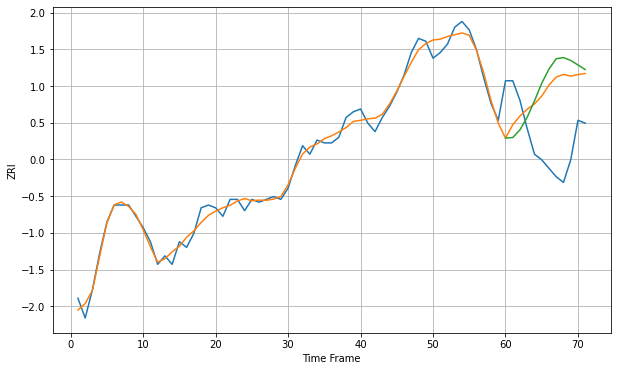

Wall time: 9.45 s
46201 2.5913522098693886 23.43386381317928 27.316588360591172 [657.67476731 657.90732533 660.6358852  665.13059001 670.89324646
 677.10581409 682.15064442 685.80881039 686.22143019 685.19435239
 683.59205329 681.96824867]

Got an mse at 0.0099 in round 324 and stopped training

71 71 12


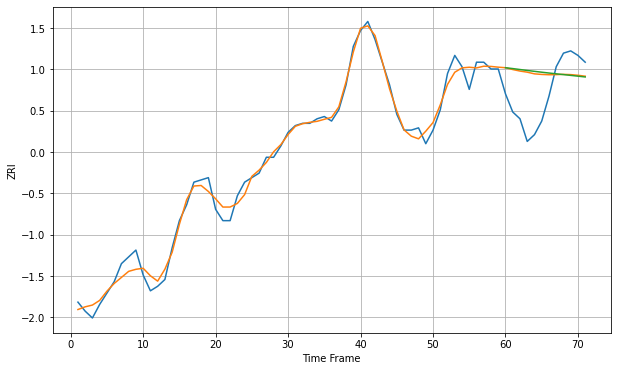

Wall time: 11.5 s
46203 3.6348315698284375 16.896420257126845 17.449522948363082 [777.56160297 777.18250193 776.76697755 776.35711608 775.96081029
 775.58184886 775.21974851 774.87009025 774.52641954 774.18251643
 773.83406356 773.47946676]

Got an mse at 0.0099 in round 111 and stopped training

71 71 12


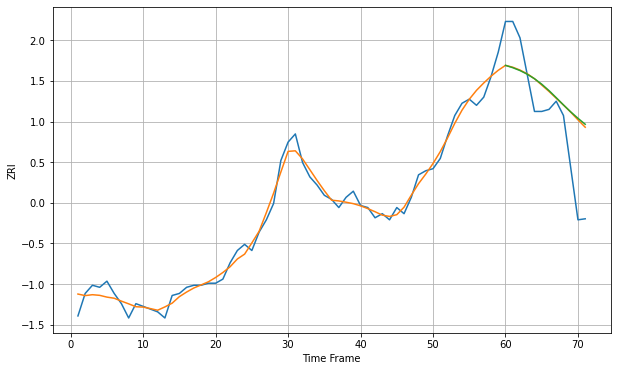

Wall time: 7.37 s
46208 3.948828599213483 23.927606378194863 24.363108655913663 [852.52862979 851.40122621 849.99414274 848.20520507 845.99489415
 843.32340167 840.19577849 836.73285423 833.1827914  829.78956823
 826.64990893 823.72952254]

Got an mse at 0.0099 in round 126 and stopped training

71 71 12


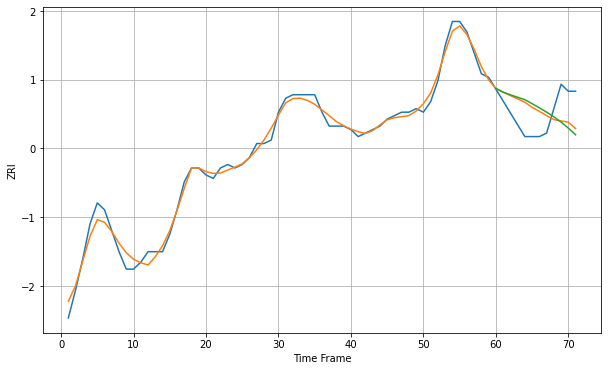

Wall time: 7.85 s
46219 1.9399033556137986 7.325699474614548 8.12076741874217 [659.80048557 658.74365644 657.97311895 657.26761468 656.58909489
 655.43250697 654.23817686 653.002724   651.66188154 650.14737818
 648.42249668 646.50758983]

Got an mse at 0.0100 in round 93 and stopped training

71 71 12


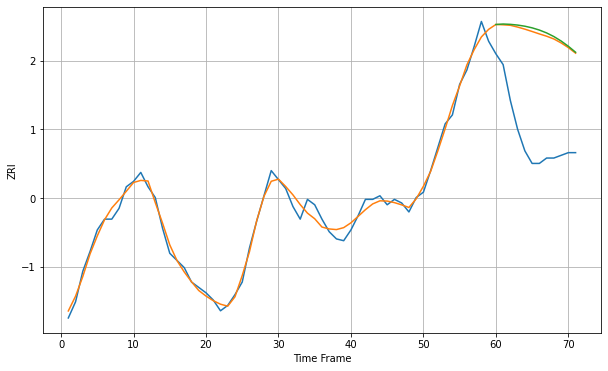

Wall time: 7.24 s
46312 3.793555150577815 57.9497053003608 59.19048491039555 [922.31555915 922.57461427 922.39146789 921.99507447 921.36116999
 920.45245142 919.22387758 917.62491247 915.60585153 913.13095299
 910.19914769 906.86627752]

Got an mse at 0.0099 in round 181 and stopped training

71 71 12


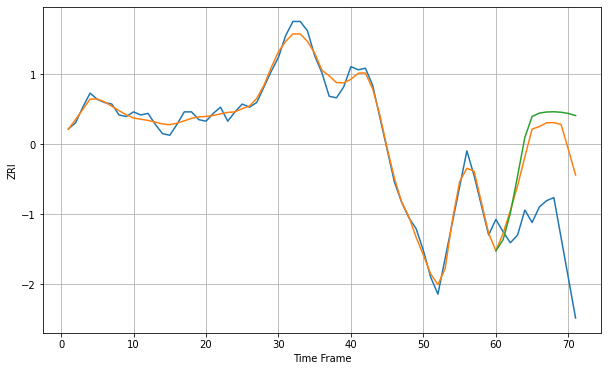

Wall time: 8.52 s
47374 4.419444955880114 53.660636320516616 66.71120653975518 [650.84360968 657.96947983 675.01595503 699.011316   723.64546511
 737.02246072 739.19814827 739.91051979 740.05509658 739.75267472
 738.96916192 737.61762775]

Got an mse at 0.0100 in round 109 and stopped training

71 71 12


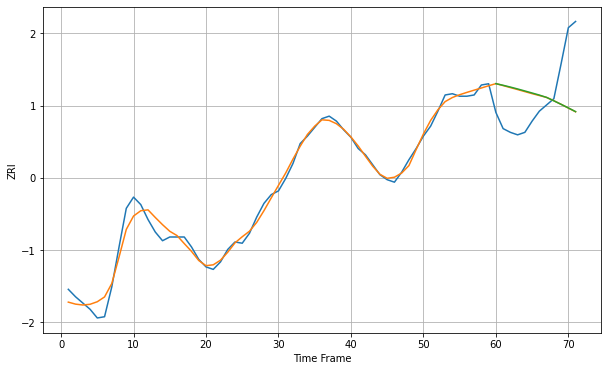

Wall time: 7.35 s
47401 5.752125504160645 37.14931794008507 37.2818792587037 [1337.09454382 1335.77415543 1334.34184263 1332.82603577 1331.21590426
 1329.57143684 1327.91063128 1326.03546748 1323.31022703 1320.49696473
 1317.59584292 1314.63494927]

Got an mse at 0.0099 in round 131 and stopped training

71 71 12


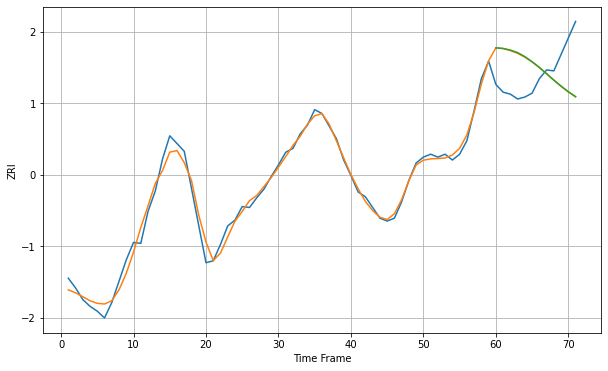

Wall time: 8.02 s
47408 7.276613988640153 41.700734951509766 41.88197481542982 [1431.78380177 1431.1668099  1429.50757334 1426.87807073 1422.71765881
 1417.4373224  1411.4129105  1404.96763708 1398.46533925 1392.22980774
 1386.48360061 1381.33167174]

Got an mse at 0.0100 in round 87 and stopped training

71 71 12


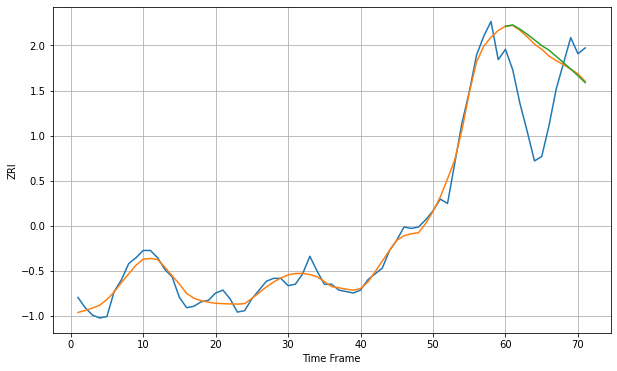

Wall time: 7.03 s
48186 6.108057009486665 44.05086326105021 45.68530084119179 [1012.74167199 1013.6405461  1010.74399283 1007.28612217 1003.46802119
  999.54381719  996.45828337  992.22286673  987.93580747  983.58987647
  979.08529703  974.34351671]

Got an mse at 0.0100 in round 257 and stopped training

71 71 12


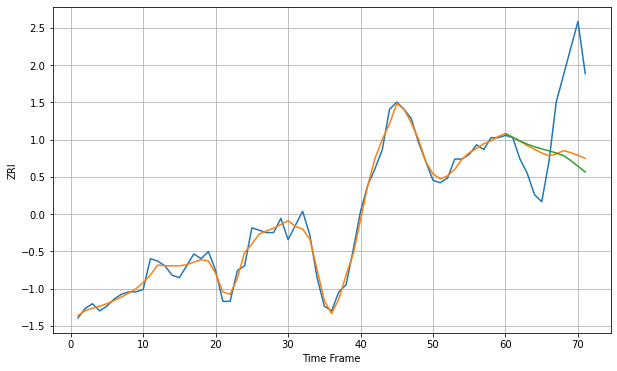

Wall time: 10.5 s
48195 3.12211917928104 27.186726142464572 29.462284605620546 [860.7116338  859.16289249 857.59342733 856.25985382 855.17567797
 854.28017427 853.45220653 852.55245513 851.48778892 849.37256787
 846.97080216 844.55463426]

Got an mse at 0.0100 in round 56 and stopped training

71 71 12


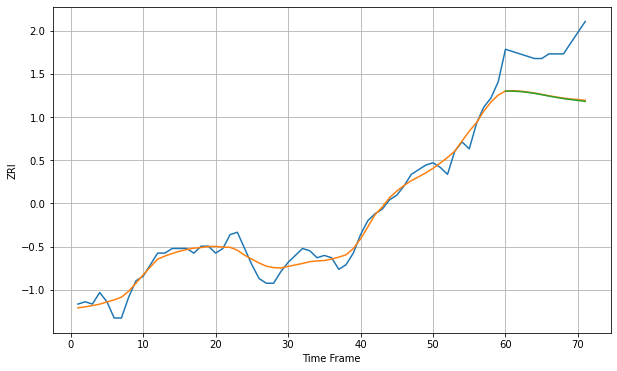

Wall time: 6.57 s
48235 3.7018211328950246 20.78636026028205 21.023561331915587 [739.97621317 739.89103382 739.73127668 739.41615256 738.95757837
 738.39158009 737.78274414 737.20526102 736.70487081 736.27917247
 735.89286873 735.50391887]

Got an mse at 0.0100 in round 154 and stopped training

71 71 12


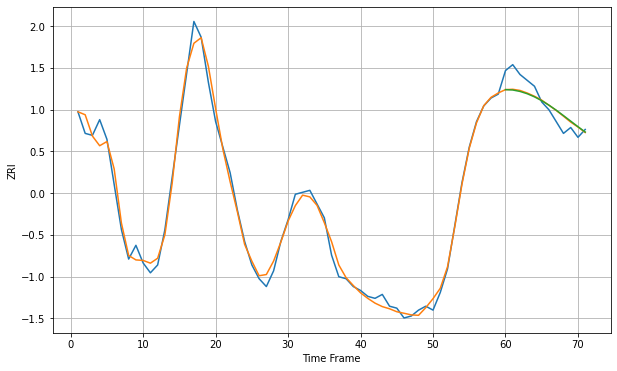

Wall time: 8.35 s
52001 4.221402072099615 6.691319256450767 6.915763270798164 [762.29105212 762.10256218 761.36965331 760.19345375 758.60840214
 756.64988775 754.36293424 751.80865276 749.06742404 746.23564512
 743.41593617 740.70449892]

Got an mse at 0.0100 in round 207 and stopped training

71 71 12


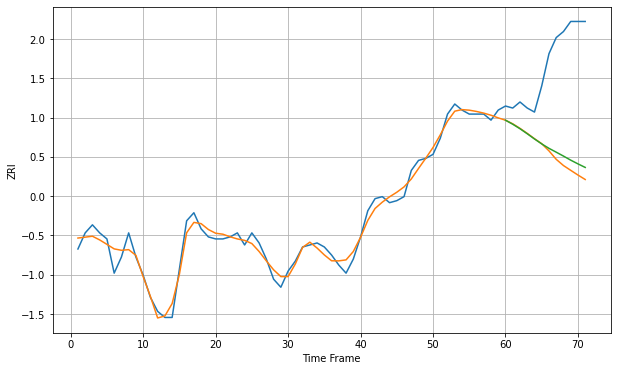

Wall time: 9.65 s
53140 3.880798489981968 49.414029103982706 46.3148321428234 [846.95681568 844.95985716 842.72845432 840.23107164 837.64570906
 835.18336684 832.98503836 831.07988352 829.14229933 827.11915621
 825.27045027 823.51084474]

Got an mse at 0.0099 in round 157 and stopped training

71 71 12


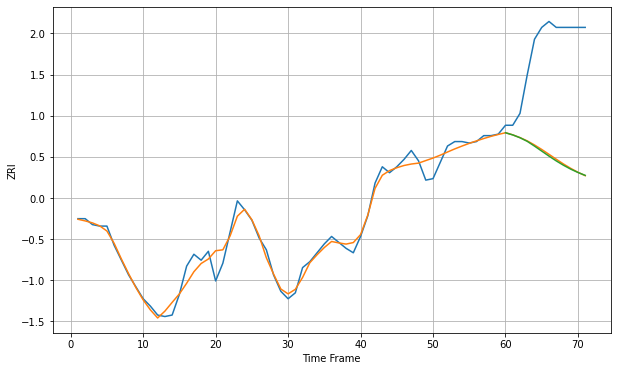

Wall time: 8.55 s
53143 5.518397961616849 74.81972237462158 75.36528882839991 [866.95153237 865.48973679 863.5962303  861.15561216 857.9517503
 854.57796422 851.20304844 847.9815515  845.03111448 842.4160579
 840.14885024 838.20419449]

Got an mse at 0.0100 in round 270 and stopped training

71 71 12


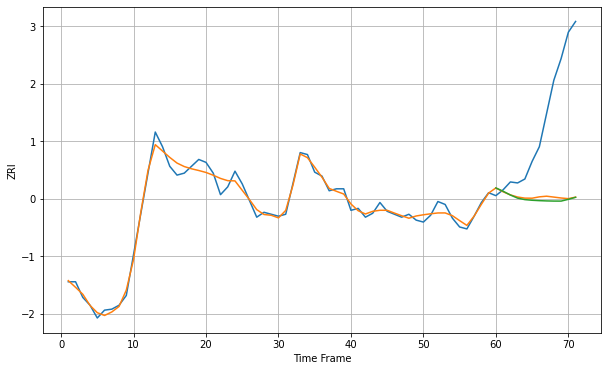

Wall time: 11.1 s
53202 5.835369295925539 94.74230055949315 96.36493804402123 [1128.88029455 1125.51330182 1121.66111337 1118.4639238  1116.94426249
 1116.28951931 1115.88828329 1115.61350981 1115.45480871 1115.43316171
 1117.2390286  1119.30339408]

Got an mse at 0.0100 in round 165 and stopped training

71 71 12


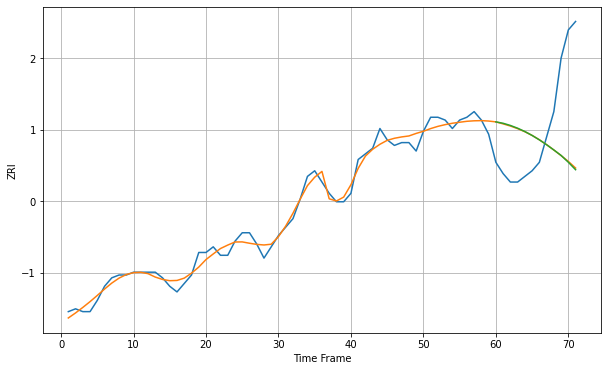

Wall time: 8.92 s
53204 2.536391966281759 25.854194309433346 26.03033848481908 [712.35504976 711.86021551 711.08747631 710.11078999 708.92882219
 707.54689132 705.97863697 704.24690621 702.38553886 700.44125598
 698.02826576 695.38095098]

Got an mse at 0.0100 in round 83 and stopped training

71 71 12


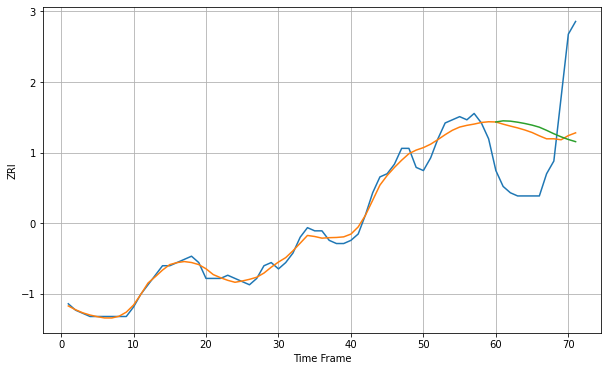

Wall time: 6.93 s
53206 2.2138879677375103 21.045521091107588 22.64423939880243 [717.3162885  717.67525467 717.57591674 717.24901764 716.83192239
 716.32437847 715.67233236 714.67577385 713.60535963 712.63498941
 711.80342215 711.11140763]

Got an mse at 0.0095 in round 39 and stopped training

71 71 12


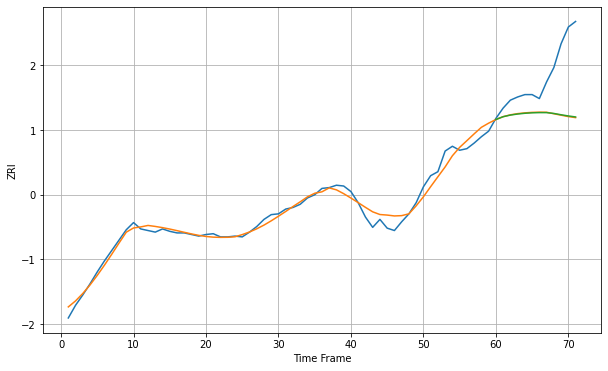

Wall time: 6.33 s
53207 7.767389123027531 59.48613666787609 59.2119653598636 [977.64698127 981.18500051 983.22255673 984.56439424 985.5069343
 986.08202816 986.33263236 986.31589868 985.28902491 983.63026251
 982.14762122 980.88507482]

Got an mse at 0.0099 in round 55 and stopped training

71 71 12


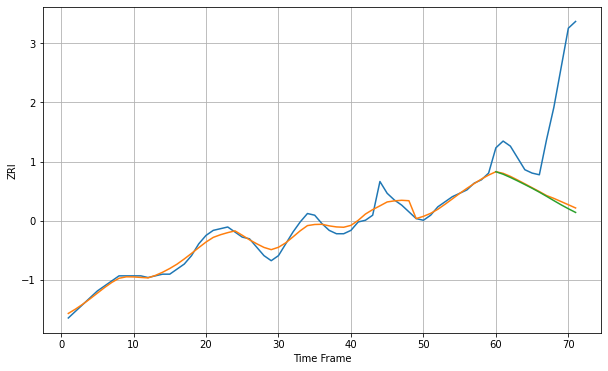

Wall time: 6.37 s
53208 3.447561151926037 53.90980620838952 55.176379361569445 [746.80982001 745.33075628 743.42973615 741.36186191 739.20890661
 737.00524893 734.67879573 732.20391624 729.65713897 727.17675605
 724.8441561  722.64863632]

Got an mse at 0.0099 in round 129 and stopped training

71 71 12


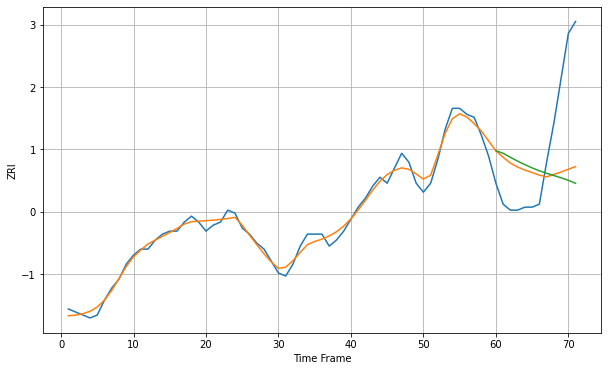

Wall time: 7.86 s
53209 2.0569095475796786 23.96718441519783 26.18440751916127 [709.83262781 708.98514926 707.64699641 706.36706321 705.1933894
 704.11482607 703.12143733 702.32517931 701.55916078 700.79415853
 699.97340253 698.95113023]

Got an mse at 0.0099 in round 99 and stopped training

71 71 12


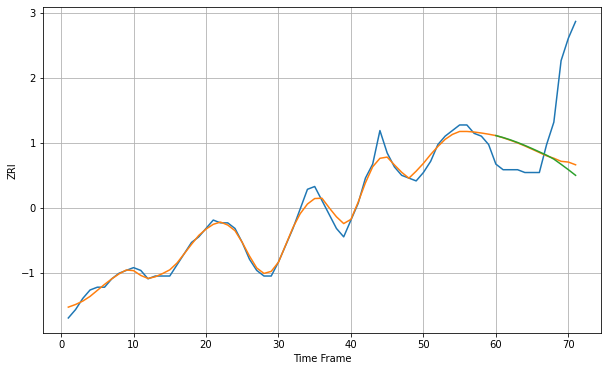

Wall time: 7.07 s
53210 2.284307914499988 23.646551222508542 24.937559971758986 [756.20347518 755.50888866 754.67752135 753.73271288 752.68422326
 751.55515206 750.38023131 749.19232323 747.79109709 745.93646935
 744.01370871 741.9959168 ]

Got an mse at 0.0100 in round 207 and stopped training

71 71 12


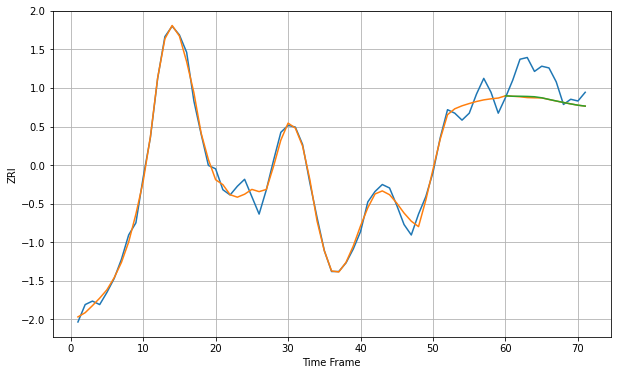

Wall time: 9.34 s
53211 4.421573336452017 13.457569026860819 13.250329815460136 [1182.9830216  1182.71130747 1182.72897489 1182.6311884  1182.44558382
 1181.83966994 1180.91486928 1180.01189689 1179.14713191 1178.33273513
 1177.58018001 1177.05872951]

Got an mse at 0.0100 in round 81 and stopped training

71 71 12


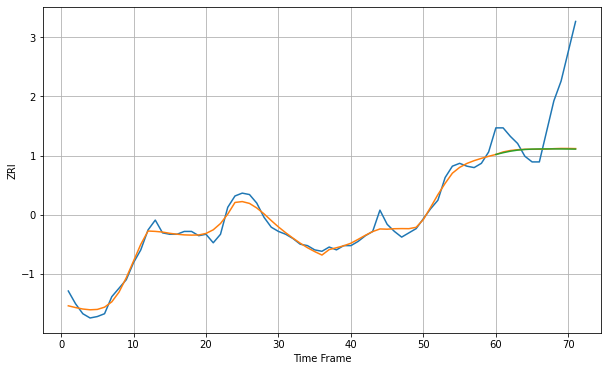

Wall time: 7.02 s
53212 4.133426934064977 37.86898451007223 38.08497696404751 [847.25577436 848.48431717 849.55273032 850.31504197 850.78357993
 851.02718298 851.13249359 851.16754264 851.16819987 851.14577709
 851.10029351 851.02947865]

Got an mse at 0.0100 in round 97 and stopped training

71 71 12


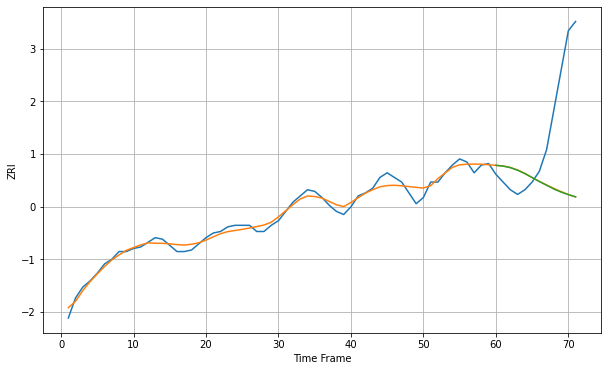

Wall time: 7.21 s
53215 3.3899783738230918 53.37790958171467 53.44473412963187 [758.83948903 758.35375034 757.31690462 755.66780729 753.49511895
 750.91199254 748.36549246 745.93903748 743.49537715 741.51963986
 739.86903886 738.43948932]

Got an mse at 0.0100 in round 174 and stopped training

71 71 12


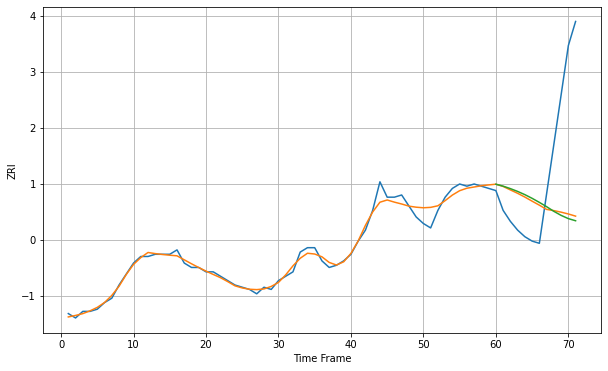

Wall time: 8.89 s
53216 2.5281702072356547 39.8954673703264 40.98206000746543 [726.9079399  726.02344884 724.89855338 723.62041086 722.15262079
 720.47528402 718.63119558 716.67736594 714.55083884 712.71736804
 711.2352109  710.26622277]

Got an mse at 0.0100 in round 166 and stopped training

71 71 12


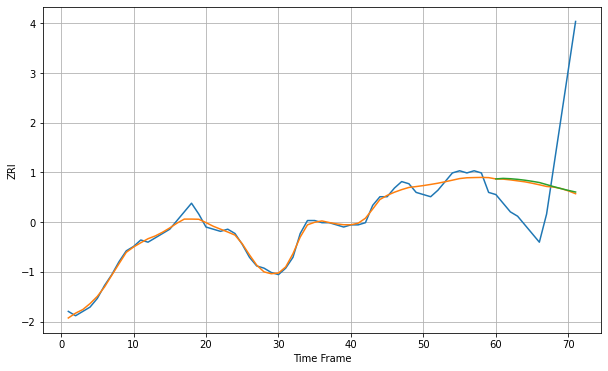

Wall time: 8.67 s
53218 2.289689040196891 33.05324157050409 33.11205065773001 [732.22517888 732.48401562 732.32495127 732.03695814 731.63673347
 731.13870038 730.56646435 729.61650278 728.64338654 727.74657241
 726.92853883 726.1792122 ]

Got an mse at 0.0100 in round 375 and stopped training

71 71 12


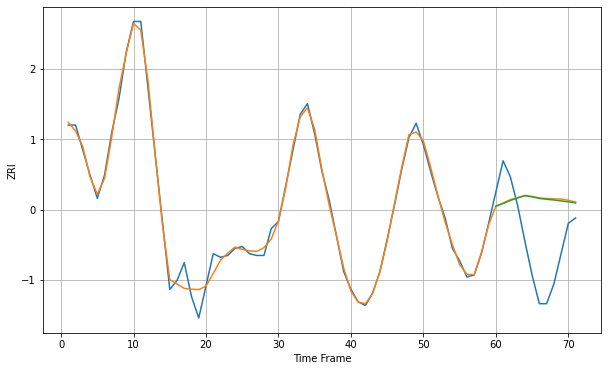

Wall time: 12.3 s
53403 3.920503024095796 33.941206522155895 33.64805372052189 [844.54971008 846.10829785 847.76922716 849.22952434 850.52966462
 849.8266335  848.91416797 848.43526802 848.04982637 847.53622924
 847.00411501 846.4299686 ]

Got an mse at 0.0095 in round 31 and stopped training

71 71 12


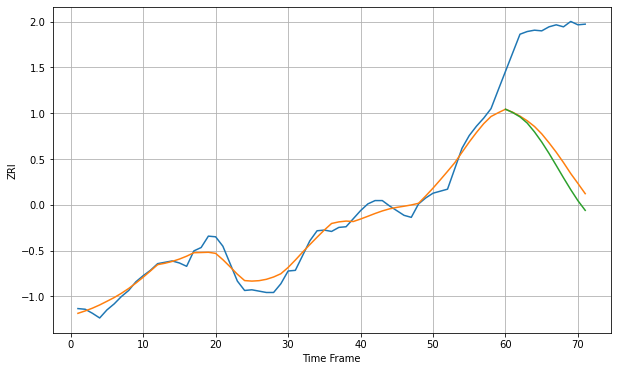

Wall time: 6.02 s
53590 12.825027735927348 174.60903853382806 190.19974648148 [1088.17294129 1083.20457584 1076.82270156 1067.52030474 1054.38066537
 1039.29969998 1022.43354368 1004.38896036  986.04822831  968.34031438
  951.77163406  937.43903316]

Got an mse at 0.0100 in round 203 and stopped training

71 71 12


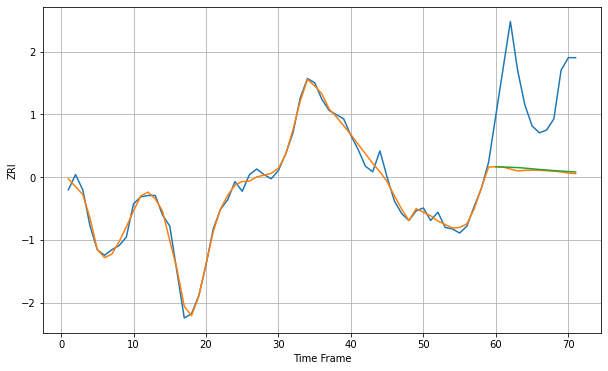

Wall time: 9.04 s
53703 4.479467082788824 63.40038129564289 62.49496764626752 [1292.62067628 1292.43431732 1292.24734905 1292.03452077 1291.63179939
 1291.13427201 1290.68306013 1290.27006128 1289.88813356 1289.52935938
 1289.18612253 1288.8517358 ]

Got an mse at 0.0099 in round 61 and stopped training

71 71 12


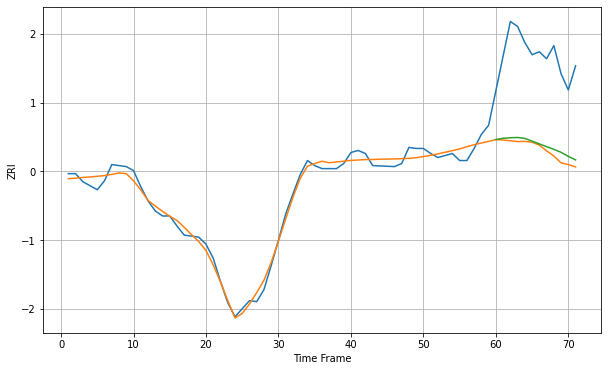

Wall time: 7.26 s
53704 6.7572000951681845 93.8877305370496 89.66988316484918 [1083.83012369 1085.08878113 1085.63748649 1085.87979424 1084.97670868
 1082.26708652 1079.53211554 1076.79099506 1074.12560362 1071.15612244
 1067.12339204 1063.66248122]

Got an mse at 0.0099 in round 195 and stopped training

71 71 12


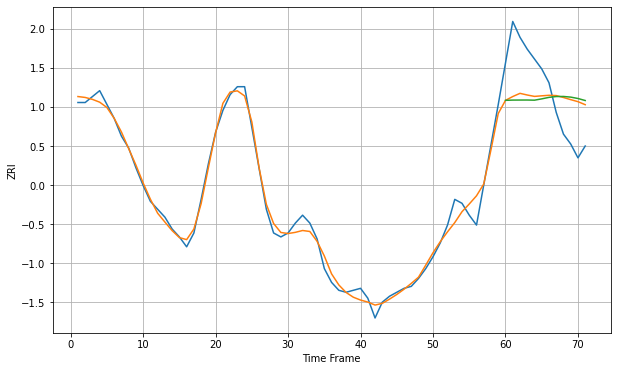

Wall time: 9.3 s
54220 3.9165865758621123 22.156516667556176 23.718356924391262 [670.09362545 670.22403009 670.24741882 670.25628642 670.17714248
 670.8431806  671.60416049 672.02381773 672.06303776 671.72705214
 671.0332674  670.0089386 ]
71 71 12


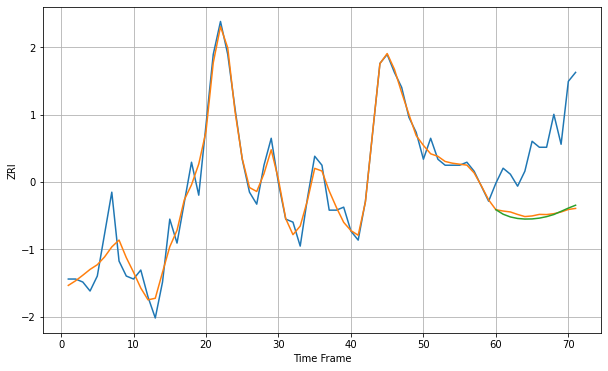

Wall time: 15.1 s
54601 4.508828191471137 25.645357801894033 25.879359194124437 [824.15044407 822.64646431 821.73169349 821.22504052 821.02475898
 821.06929407 821.3381045  821.83371376 822.5412194  823.60271272
 824.68572511 825.6449949 ]

Got an mse at 0.0099 in round 115 and stopped training

71 71 12


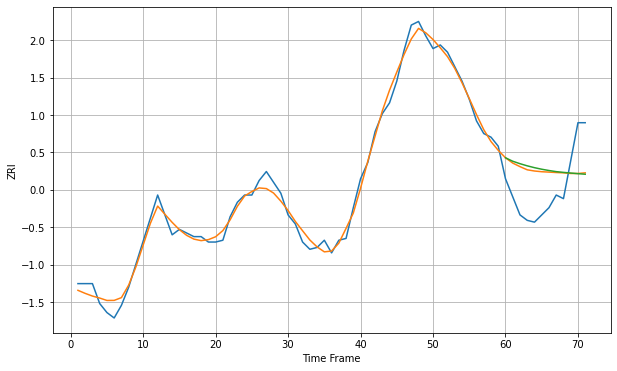

Wall time: 7.64 s
54901 4.098443971642843 21.79781669627255 22.79271053747907 [722.5964259  720.69403593 719.33187908 718.14885157 717.12863274
 716.27155497 715.55586455 714.93949965 714.52837554 714.1605577
 713.82170367 713.50644275]

Got an mse at 0.0098 in round 85 and stopped training

71 71 12


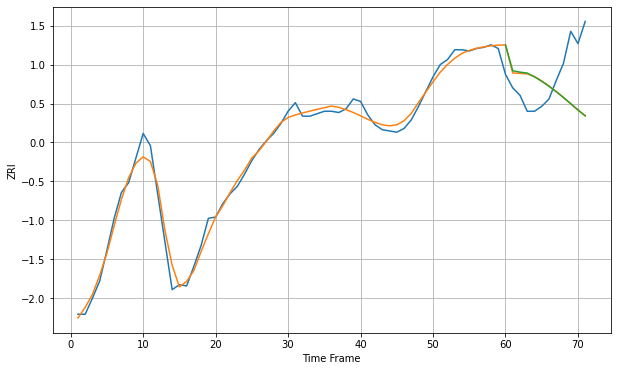

Wall time: 6.83 s
55101 6.183952016569937 36.96452838591448 37.09158413885059 [1339.90909311 1318.91492437 1317.81209423 1317.06164506 1313.97069407
 1310.37786583 1306.35176071 1301.91082672 1297.19102212 1292.18068955
 1287.14306772 1282.15972424]

Got an mse at 0.0100 in round 184 and stopped training

71 71 12


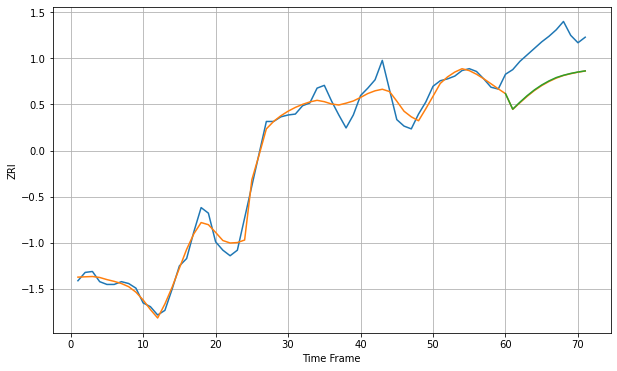

Wall time: 8.79 s
55104 9.92077529426854 43.92753361575922 43.49217661937591 [1297.03328351 1280.31650543 1287.91611515 1294.9408535  1301.15306901
 1306.42020148 1310.79552337 1314.4067523  1316.89753125 1318.88026859
 1320.43343161 1321.62535399]

Got an mse at 0.0095 in round 37 and stopped training

71 71 12


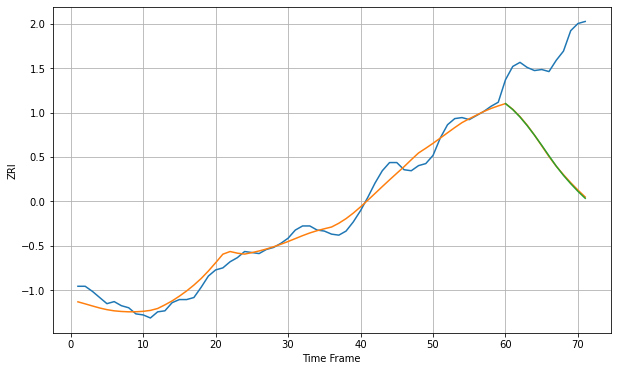

Wall time: 6.04 s
55106 8.255935204561665 103.37554454355872 103.85521981593735 [1089.67714116 1083.86170141 1076.56720862 1068.07842554 1058.77348259
 1048.87954683 1038.57973805 1028.54760624 1019.44990968 1011.35275063
 1003.8405666   997.04860596]

Got an mse at 0.0099 in round 110 and stopped training

71 71 12


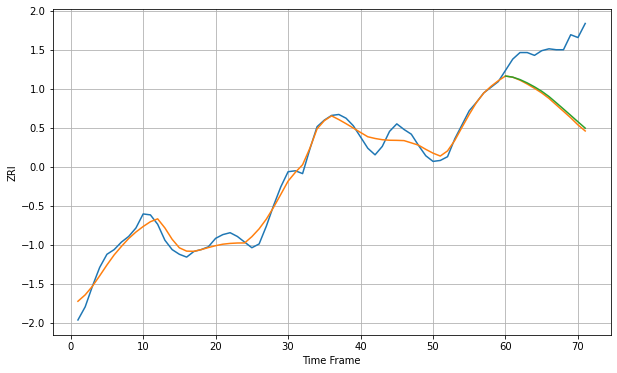

Wall time: 7.67 s
55306 8.224083746453015 61.81318369740067 59.82426018365656 [1305.96949593 1304.78879184 1302.20448552 1298.63671871 1294.45511243
 1289.73882747 1284.12584855 1277.53211308 1270.83601006 1264.04072821
 1257.20142001 1250.42382387]

Got an mse at 0.0098 in round 63 and stopped training

71 71 12


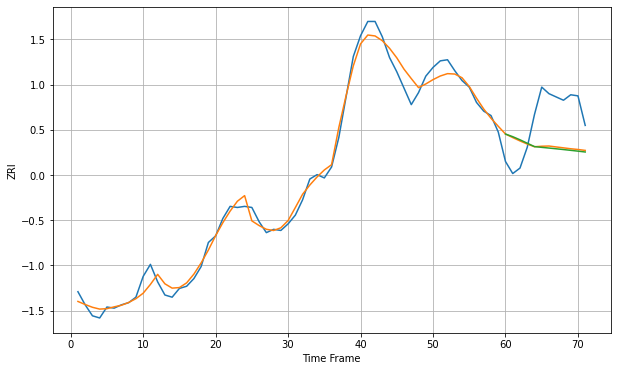

Wall time: 6.64 s
55401 8.106529551083225 38.46161731585306 39.59206359437166 [1654.11009771 1651.70040897 1648.85131797 1645.72477213 1642.63728857
 1641.94412893 1641.29645042 1640.62692527 1639.93378876 1639.21403008
 1638.46827372 1637.70233457]

Got an mse at 0.0099 in round 186 and stopped training

71 71 12


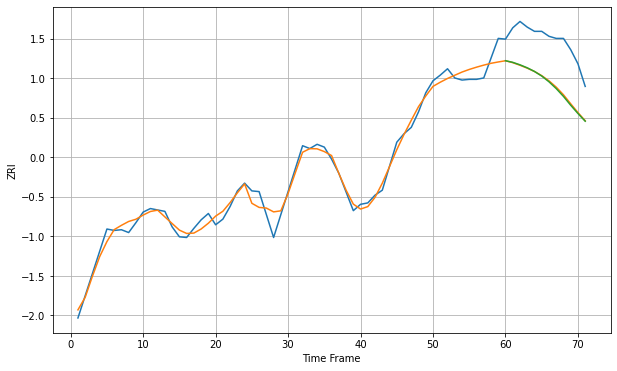

Wall time: 9.33 s
55403 11.132999274662494 61.85416772586877 62.713284993865265 [1309.3702394  1307.10924658 1303.58206585 1299.36058237 1294.17951786
 1287.68559872 1279.55773489 1269.91799681 1258.83767268 1246.2986255
 1234.61024361 1223.69978929]

Got an mse at 0.0099 in round 170 and stopped training

71 71 12


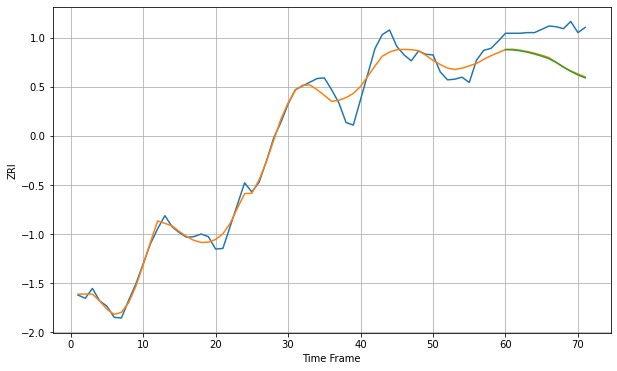

Wall time: 8.65 s
55404 14.82199846652056 49.373926971263515 50.29893954092744 [1336.19298768 1335.73316937 1334.28499623 1332.1654582  1329.41140907
 1326.08047797 1322.25285933 1316.44587837 1309.3108876  1303.02985205
 1297.39678645 1293.02335616]

Got an mse at 0.0100 in round 126 and stopped training

71 71 12


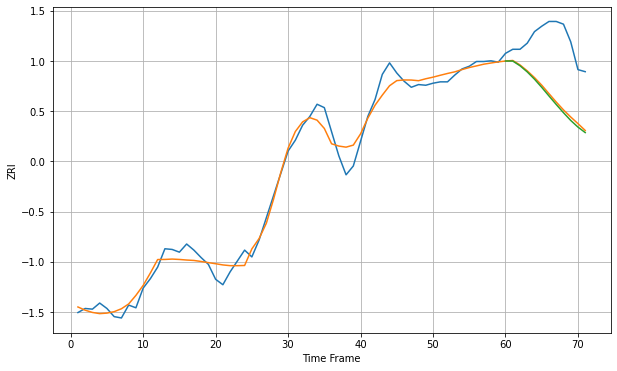

Wall time: 7.91 s
55407 14.681436569826639 82.76698640680215 85.8837384134853 [1371.70629244 1371.66826524 1364.73487381 1355.69536226 1344.96112026
 1332.90207424 1320.19664616 1307.67859112 1295.55638456 1284.14398936
 1274.31761509 1266.25514004]

Got an mse at 0.0099 in round 177 and stopped training

71 71 12


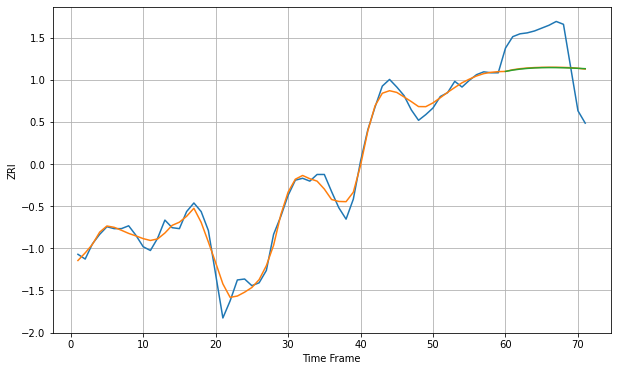

Wall time: 8.97 s
55408 8.774347768250932 40.08456489482525 40.38868824300403 [1521.43977898 1522.82639877 1523.86889017 1524.6111651  1525.10022724
 1525.37818689 1525.48159893 1525.44158377 1525.28429511 1525.03150377
 1524.70117656 1524.30800003]

Got an mse at 0.0099 in round 82 and stopped training

71 71 12


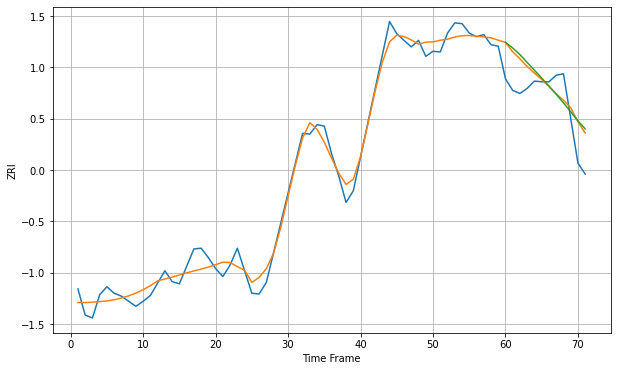

Wall time: 6.88 s
55411 13.997270271155255 37.951571913821574 40.77771869974884 [1592.22550657 1584.47571297 1575.32418701 1564.52467229 1553.79264877
 1543.0300237  1532.05687438 1520.73818132 1508.97245866 1496.69804692
 1484.17408454 1473.17898863]

Got an mse at 0.0099 in round 64 and stopped training

71 71 12


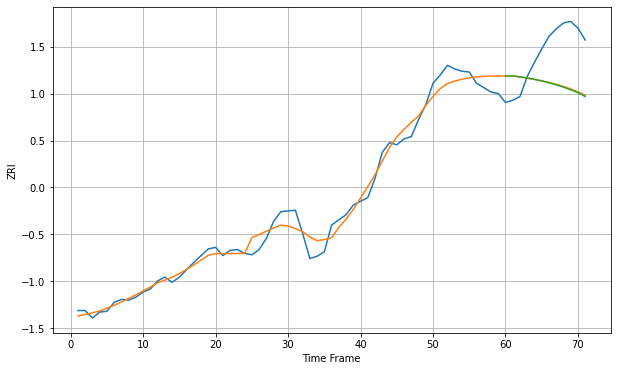

Wall time: 7.15 s
55413 12.459813189474854 60.00118125174326 60.70860881561491 [1544.56348373 1544.80261051 1543.5389948  1541.95834573 1540.09093304
 1537.94562324 1535.51347676 1532.764741   1529.64760137 1526.09052995
 1522.01125208 1517.08808529]

Got an mse at 0.0099 in round 46 and stopped training

71 71 12


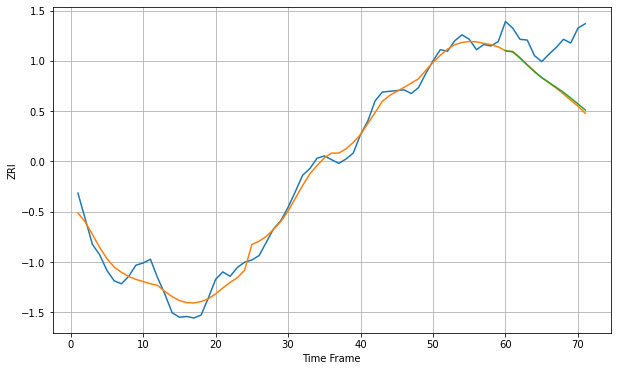

Wall time: 6.55 s
55414 13.333177182253175 62.256309301693854 60.585631233082 [1559.61480768 1558.01281272 1549.67812623 1540.43425549 1531.4325863
 1523.55857027 1516.80952038 1510.36358177 1503.65287345 1496.00099591
 1488.10888648 1479.82399517]

Got an mse at 0.0099 in round 84 and stopped training

71 71 12


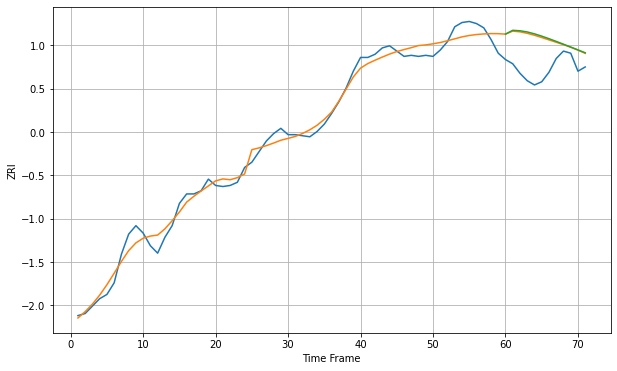

Wall time: 6.97 s
55416 8.110805719345153 30.042442384266035 30.875169793873805 [1549.05255698 1552.64959105 1552.2075858  1551.08790218 1549.29818061
 1547.12353897 1544.71117228 1542.14986759 1539.49909733 1536.80403442
 1534.0986271  1531.40507727]

Got an mse at 0.0098 in round 30 and stopped training

71 71 12


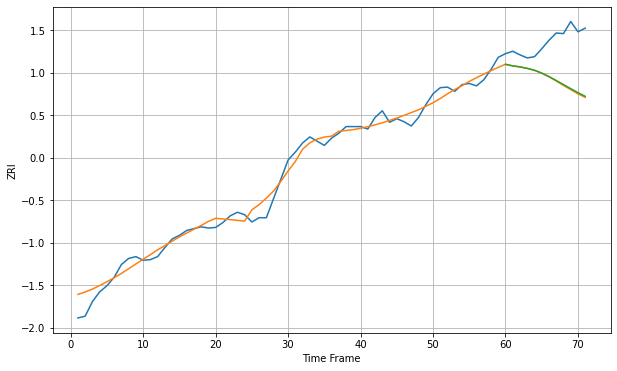

Wall time: 6.61 s
55418 13.615320874030559 68.75414066287404 67.8354928286092 [1325.53091815 1322.80196829 1321.15237509 1318.77199618 1315.66606008
 1311.03743625 1305.32198396 1298.8536632  1292.15895202 1285.40631243
 1278.8862863  1272.78932537]
71 71 12


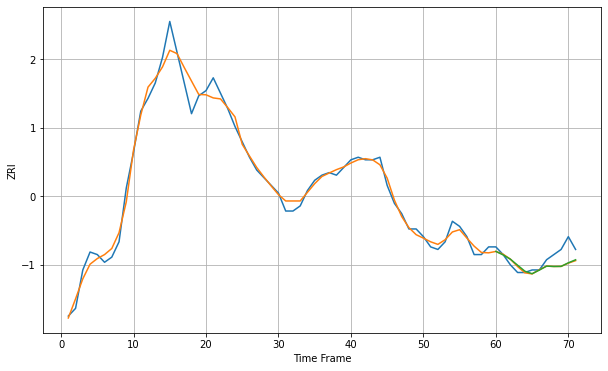

Wall time: 15.2 s
58103 3.391568919488378 4.218456101643138 4.191031969640194 [713.22883197 711.88375292 710.19708137 707.85243276 705.50876969
 704.53366078 705.95094529 707.49870975 707.35517424 707.39111333
 708.78113479 709.96043978]

Got an mse at 0.0100 in round 246 and stopped training

71 71 12


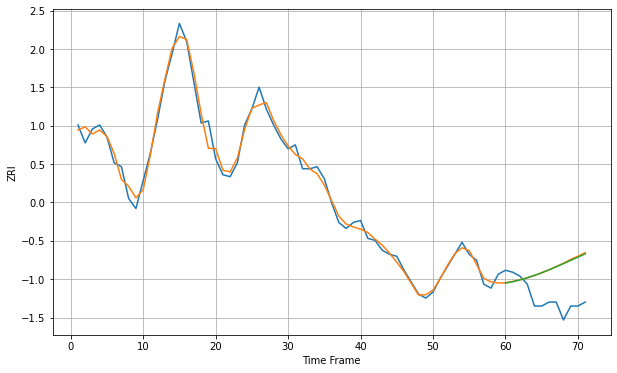

Wall time: 10.4 s
58104 3.8507671438258186 17.743016079966786 17.53736678432736 [773.59434981 774.24540496 775.13548848 776.18808203 777.39180801
 778.73040234 780.18313229 781.72518112 783.32821851 784.96200007
 786.59657605 788.20349373]
71 71 12


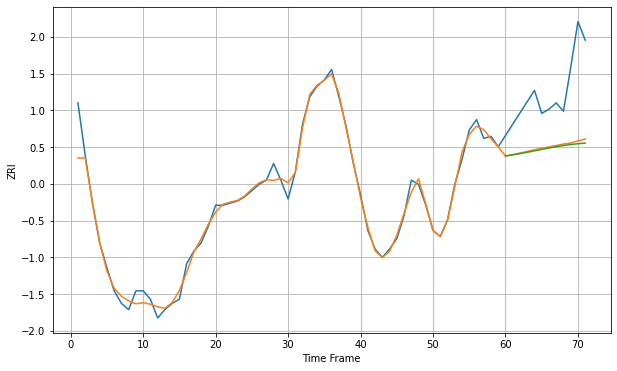

Wall time: 15.1 s
59601 4.366415647018747 29.06437004482991 29.848924605513254 [835.58183411 836.08728256 836.70789383 837.35497427 838.03836907
 838.72857565 839.39908852 840.02683002 840.59188862 841.06855134
 841.45127784 841.7372466 ]

Got an mse at 0.0099 in round 131 and stopped training

71 71 12


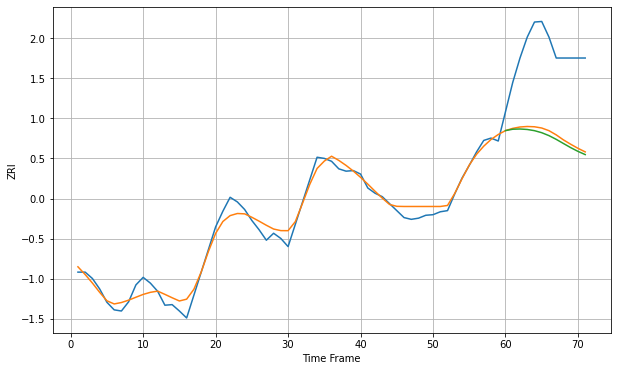

Wall time: 8.17 s
59718 13.636427516339074 143.5846487795846 149.23957297850748 [1481.92703676 1484.28967517 1484.68843041 1483.86746875 1481.79211719
 1478.29227961 1473.24558372 1466.82705245 1459.64944254 1452.5440547
 1446.12358341 1440.57506518]

Got an mse at 0.0099 in round 99 and stopped training

71 71 12


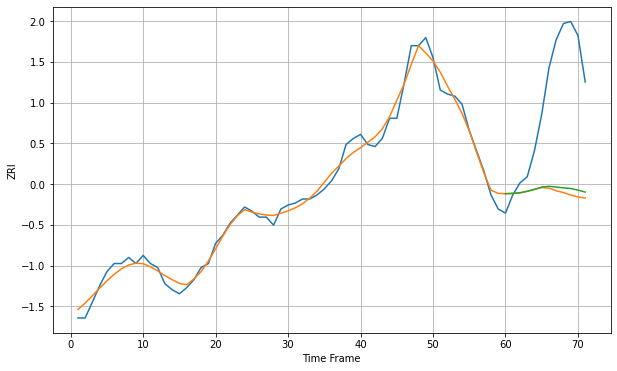

Wall time: 7.39 s
59801 3.9900481733137183 54.13786141638554 52.42470590895504 [832.6109247  832.7828228  833.05315579 833.80285906 834.79264534
 835.87681674 836.29529778 835.88843845 835.50788248 835.18731353
 834.39599745 833.4242189 ]

Got an mse at 0.0098 in round 41 and stopped training

71 71 12


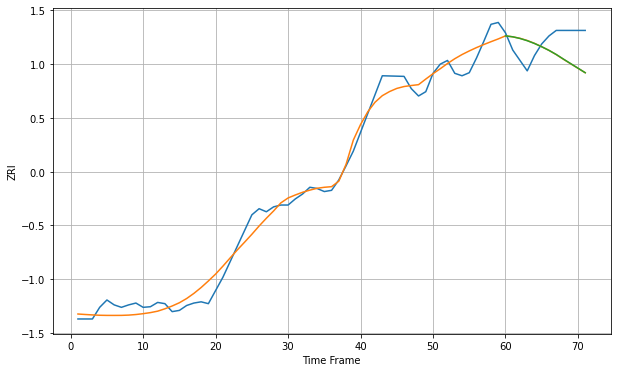

Wall time: 6.32 s
59901 17.27261445748875 41.36690056630696 41.22640931099954 [1179.093752   1177.6012183  1174.87381808 1171.23276534 1166.68154293
 1161.34591224 1155.4451901  1148.75213757 1141.18966395 1133.78692838
 1126.39530422 1118.97629892]

Got an mse at 0.0100 in round 142 and stopped training

71 71 12


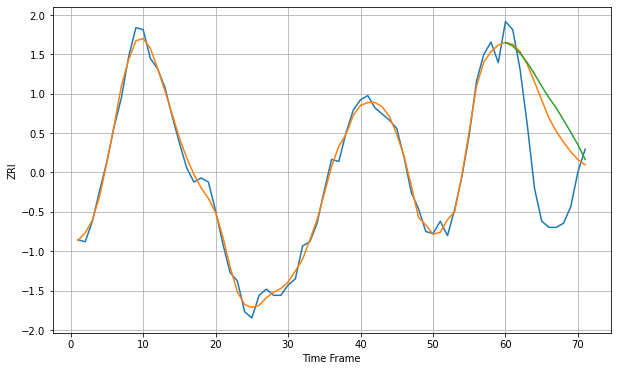

Wall time: 7.89 s
60085 3.803434683388863 34.82958005798255 40.678695162684086 [1196.79585413 1195.08625344 1191.6147028  1187.02054381 1181.48910277
 1175.55449775 1169.93238197 1165.03753118 1159.1669941  1153.23411508
 1147.0800205  1139.98917175]

Got an mse at 0.0100 in round 134 and stopped training

71 71 12


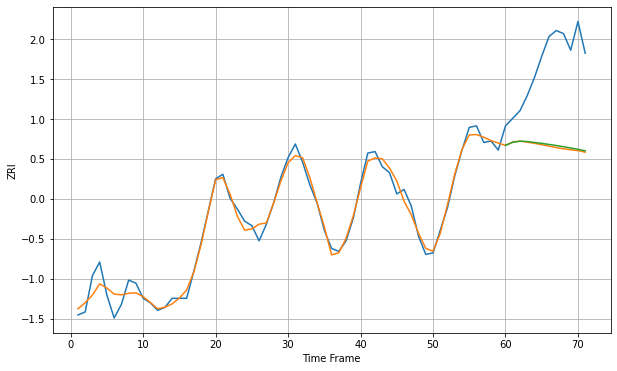

Wall time: 8.14 s
60201 5.237278786688079 57.73562566670465 56.893588034000594 [1540.1021231  1542.13756896 1542.86195013 1542.62990064 1542.02935465
 1541.40806489 1540.73266521 1539.99822559 1539.20625697 1538.35900196
 1537.4596692  1536.51381429]

Got an mse at 0.0100 in round 368 and stopped training

71 71 12


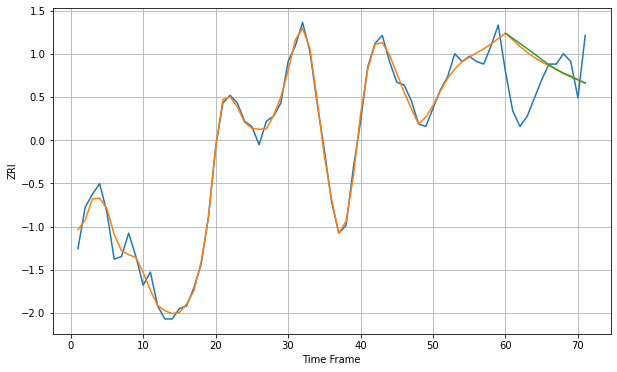

Wall time: 12.5 s
60202 3.301220241122755 16.54591573409345 17.109557529124796 [1596.86406292 1594.91025528 1592.93559473 1590.90253621 1588.88379514
 1586.73607172 1584.74754442 1582.97367469 1581.41419681 1580.13148536
 1578.88598134 1577.73480053]
71 71 12


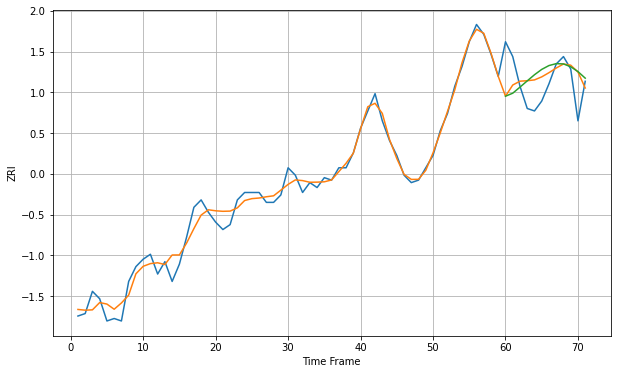

Wall time: 15.4 s
60402 3.6712251050110662 10.930603367743322 11.802197573234768 [1284.96535046 1286.18444903 1288.64456081 1291.16682542 1293.65358429
 1295.81517211 1297.37407449 1298.1428069  1298.03286044 1296.88793455
 1294.92709399 1292.2715328 ]

Got an mse at 0.0100 in round 113 and stopped training

71 71 12


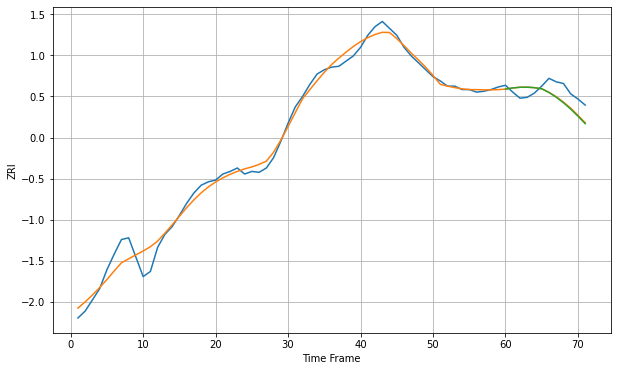

Wall time: 7.57 s
60540 9.475134496167767 14.349569609738035 14.846284654984258 [1639.50121069 1640.89048593 1641.64669885 1641.74446351 1641.16646194
 1639.90889196 1635.63747478 1630.12266983 1623.68991304 1616.33760909
 1608.15492486 1599.44819646]

Got an mse at 0.0100 in round 117 and stopped training

71 71 12


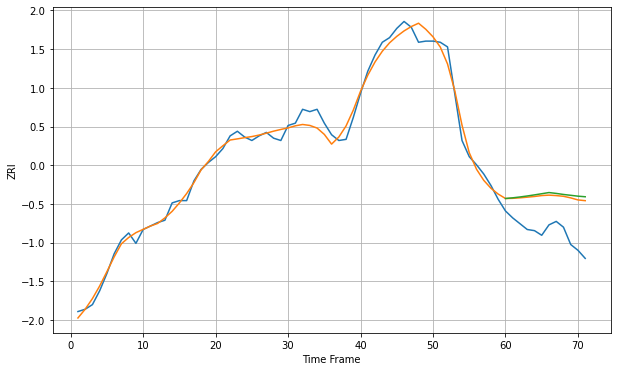

Wall time: 7.97 s
60563 6.6265930342763895 31.14442316651559 32.998053937769754 [1373.80891835 1374.40671647 1375.13957376 1375.99530235 1376.94393663
 1377.9473858  1378.96375086 1378.2151878  1377.3177756  1376.57889361
 1375.83842056 1375.32616767]

Got an mse at 0.0100 in round 246 and stopped training

71 71 12


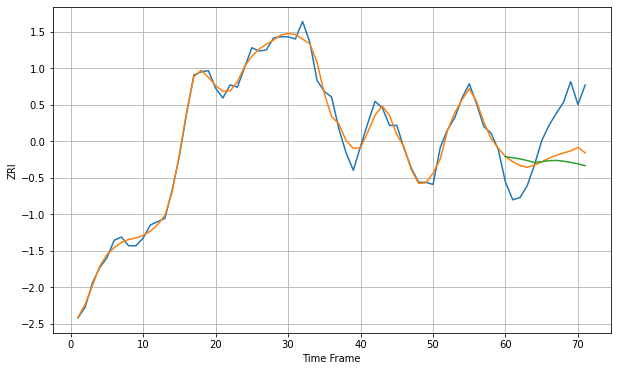

Wall time: 10.3 s
60601 6.631268577787805 37.834441292984515 44.50748716116156 [2081.52381113 2080.38877724 2079.39318231 2077.87778959 2076.02188635
 2076.84537056 2077.70571483 2078.02847036 2077.27415048 2076.20724539
 2074.86263612 2073.21175116]

Got an mse at 0.0099 in round 280 and stopped training

71 71 12


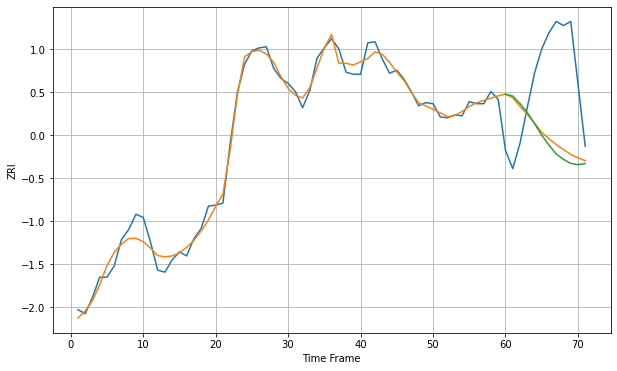

Wall time: 10.8 s
60605 8.341500529075656 82.5166267022708 87.71776679170162 [2043.40214118 2041.53793509 2034.12676071 2025.26036228 2014.52882256
 2002.9553467  1993.10401464 1984.41589184 1979.13222262 1975.18010448
 1973.91124798 1974.99306935]
71 71 12


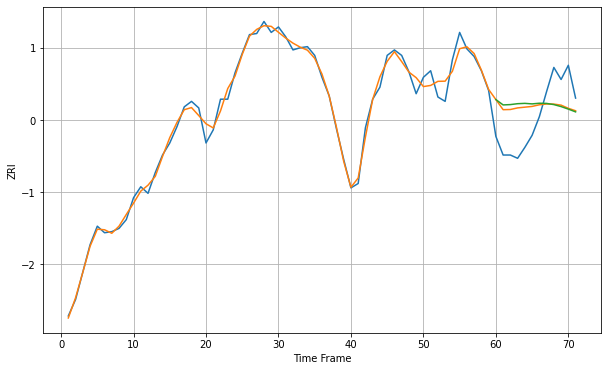

Wall time: 15 s
60606 6.620785838052186 32.06590242026784 34.24378736649947 [2198.64739302 2193.76307377 2194.07130443 2194.88684362 2195.18610351
 2194.70345529 2195.30134723 2195.13752222 2194.07127965 2192.25436039
 2189.94944596 2187.41842657]

Got an mse at 0.0099 in round 100 and stopped training

71 71 12


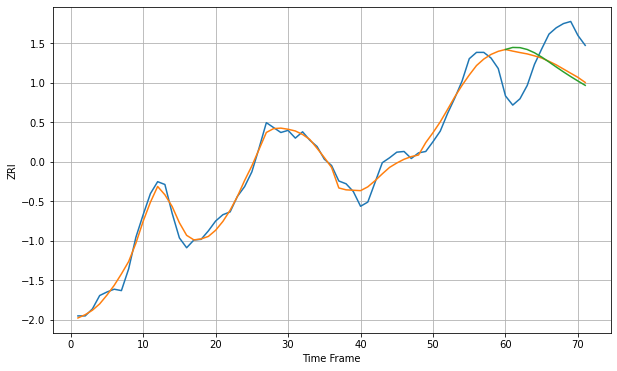

Wall time: 7.37 s
60607 11.135147333800147 55.63313731114521 59.44995287681519 [2040.15146702 2043.03199445 2042.7625143  2040.11696926 2035.4560265
 2029.31799647 2022.37092897 2015.21886428 2008.24239749 2001.58268162
 1995.22675475 1989.10321083]

Got an mse at 0.0100 in round 405 and stopped training

71 71 12


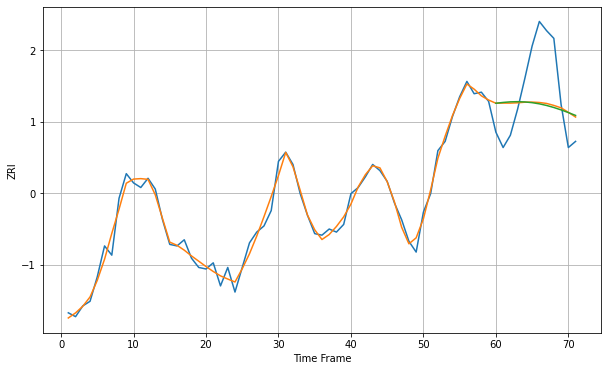

Wall time: 13.1 s
60608 4.6421102166100345 30.153146326575772 30.785876539570097 [1526.81253404 1527.33383033 1527.72545981 1527.83227723 1527.65256498
 1527.1829572  1526.41948029 1525.3652831  1524.03891957 1522.47903224
 1520.74133973 1518.88786851]

Got an mse at 0.0099 in round 189 and stopped training

71 71 12


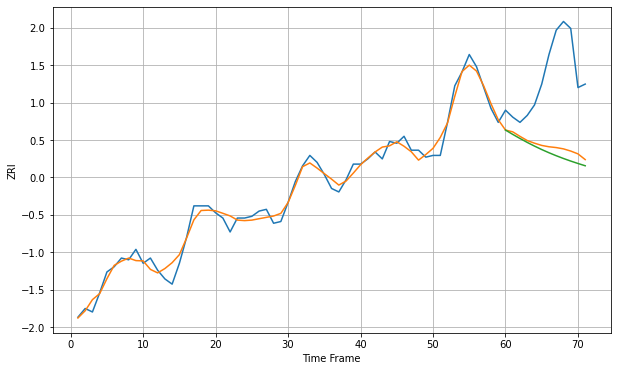

Wall time: 9.21 s
60609 4.268500520483028 44.006502304943 47.484299031185365 [1281.57193977 1279.08472397 1276.72662634 1274.47406374 1272.35462646
 1270.37417558 1268.53127647 1266.81997073 1265.23058202 1263.75001426
 1262.36178095 1261.0459264 ]

Got an mse at 0.0099 in round 430 and stopped training

71 71 12


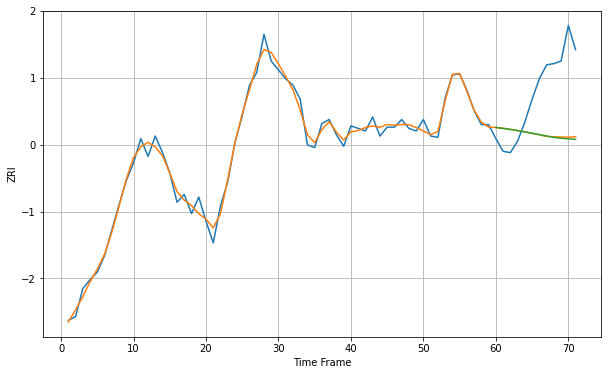

Wall time: 13.8 s
60610 5.217107706709389 46.53918854467846 47.09307787588065 [1927.77010905 1927.04696158 1926.21838785 1925.28330482 1924.26575125
 1923.20708886 1922.13649187 1921.06279533 1919.98704354 1919.29988976
 1918.86093331 1918.40588719]

Got an mse at 0.0100 in round 363 and stopped training

71 71 12


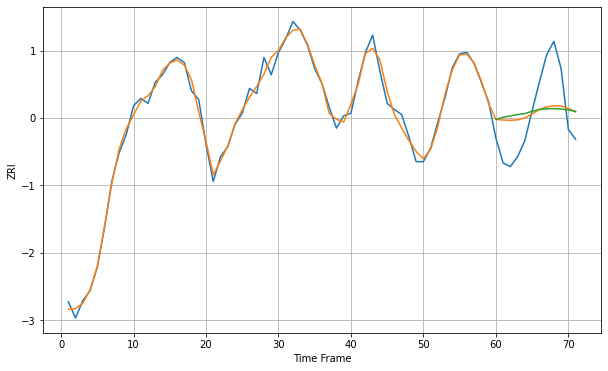

Wall time: 12.6 s
60611 5.40436329725058 29.78813512580007 31.610624502282555 [2154.1279099  2155.68533285 2156.93514198 2157.95005194 2158.76083703
 2160.54588261 2162.04732771 2162.65695317 2162.76806266 2162.42332824
 2161.65243993 2160.49885709]

Got an mse at 0.0099 in round 269 and stopped training

71 71 12


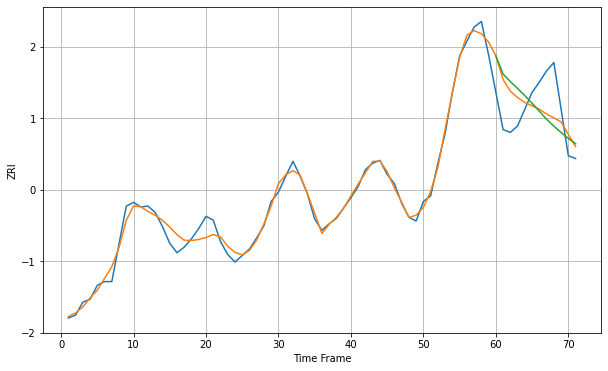

Wall time: 11.1 s
60612 7.616976451363173 35.284691089184356 40.36928130180175 [1694.07972196 1674.5598015  1666.43800285 1659.15175587 1651.42720839
 1643.23039755 1634.72791875 1626.15441055 1618.71594978 1611.9003978
 1605.61459383 1599.94087366]

Got an mse at 0.0098 in round 99 and stopped training

71 71 12


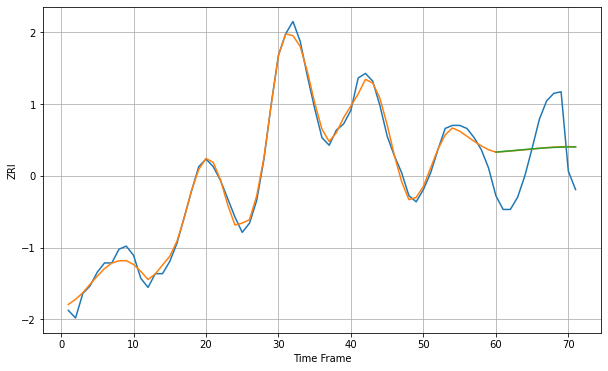

Wall time: 7.68 s
60613 4.579729247614296 28.574631279067773 28.686715235903886 [1716.53996905 1716.96098072 1717.36668967 1717.78982949 1718.21254216
 1718.61882828 1718.99344734 1719.32162304 1719.59003935 1719.78891581
 1719.91445953 1719.97038605]

Got an mse at 0.0100 in round 214 and stopped training

71 71 12


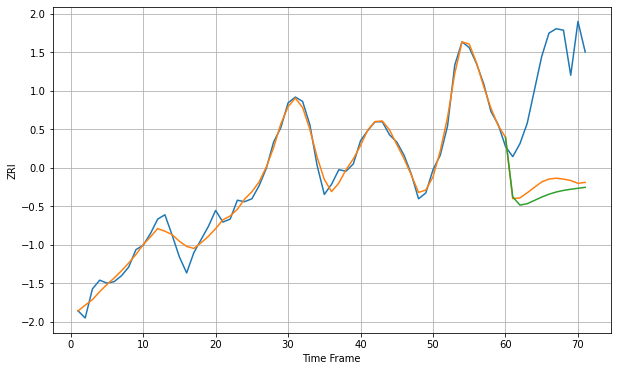

Wall time: 9.76 s
60614 5.278260192249613 78.19737584440983 84.60178259306892 [1878.36599996 1837.31293213 1831.63466832 1832.64650201 1834.89382471
 1837.19310783 1839.15725474 1840.66611779 1841.75888619 1842.56016829
 1843.21781287 1843.86564408]

Got an mse at 0.0097 in round 52 and stopped training

71 71 12


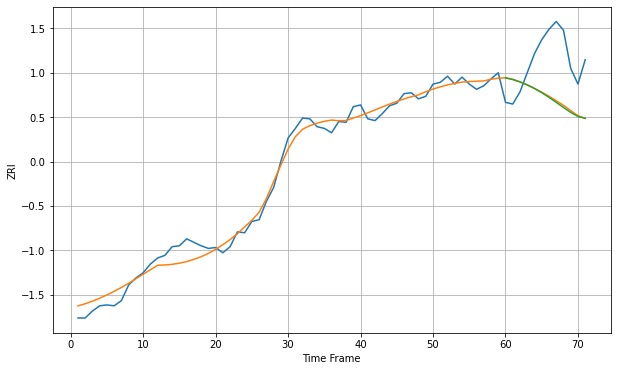

Wall time: 6.52 s
60615 9.92415440860382 55.59311107918676 56.56275196951084 [1532.20831863 1530.25463169 1527.52150768 1524.06428585 1519.89888933
 1515.08998008 1509.74877026 1504.02475136 1498.09528189 1492.43993984
 1487.71495694 1485.65884049]

Got an mse at 0.0100 in round 301 and stopped training

71 71 12


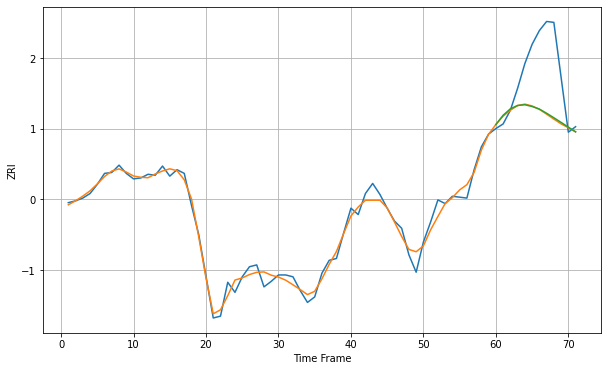

Wall time: 11.2 s
60616 7.643657126535394 56.58350398014449 56.16873805391807 [1667.41967737 1677.49186225 1684.54480365 1688.22155401 1689.01597148
 1687.08351609 1684.2688635  1679.70301906 1674.80415646 1669.70489034
 1664.52504312 1659.37428615]

Got an mse at 0.0099 in round 249 and stopped training

71 71 12


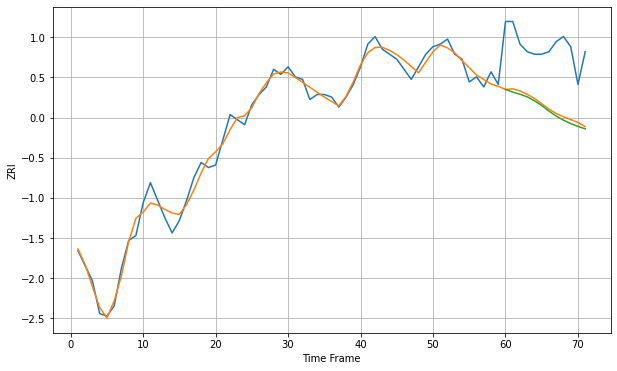

Wall time: 10.6 s
60617 3.1669716958096106 24.277539985511282 25.287407595030494 [1138.00911009 1136.94096747 1136.10560993 1135.05943771 1133.50054961
 1131.62366073 1129.41220172 1127.43938972 1125.81007565 1124.44393355
 1123.31254344 1122.36319923]

Got an mse at 0.0099 in round 148 and stopped training

71 71 12


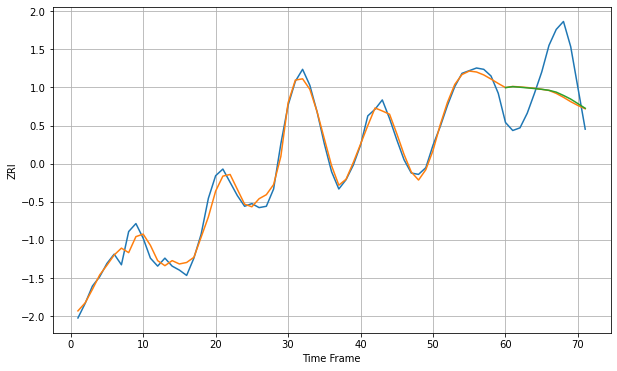

Wall time: 8.46 s
60618 5.669927070928891 31.785459375064324 31.158903420617175 [1641.2527961  1641.97839523 1641.53618096 1641.06978984 1640.5521618
 1639.95508825 1639.24543391 1637.85804304 1635.36301242 1632.61666143
 1629.19267868 1625.72167504]

Got an mse at 0.0100 in round 183 and stopped training

71 71 12


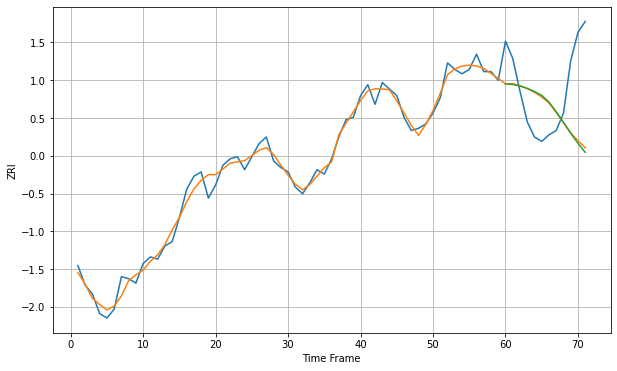

Wall time: 9.11 s
60619 3.4504111929788026 27.09583932877283 27.783668942848912 [1121.38454584 1121.1062608  1120.35787044 1119.29601499 1117.87934314
 1116.08786156 1113.05104404 1108.60042472 1103.76821913 1098.70872666
 1094.13546219 1089.97610264]

Got an mse at 0.0100 in round 175 and stopped training

71 71 12


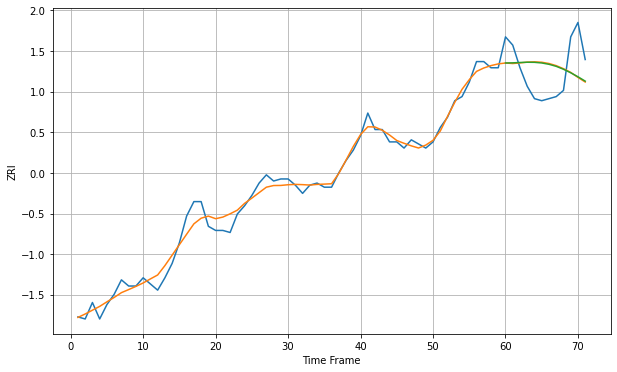

Wall time: 8.93 s
60620 3.9256826429841305 15.304226640569349 15.095622687720317 [1163.31792874 1163.39551155 1163.55986969 1163.67890255 1163.6392698
 1163.32864824 1162.68275992 1161.69341377 1160.28035673 1158.56392387
 1156.6251353  1154.50800324]

Got an mse at 0.0100 in round 220 and stopped training

71 71 12


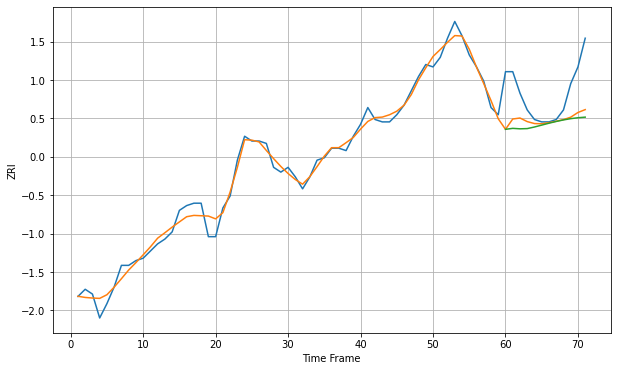

Wall time: 9.91 s
60621 3.1964484262798387 14.653358803636188 16.360460434312426 [1158.89970551 1159.29591795 1159.10707369 1159.19920027 1159.8676223
 1160.65833526 1161.44952178 1162.18481467 1162.82671847 1163.34967863
 1163.73839925 1163.98586231]

Got an mse at 0.0100 in round 396 and stopped training

71 71 12


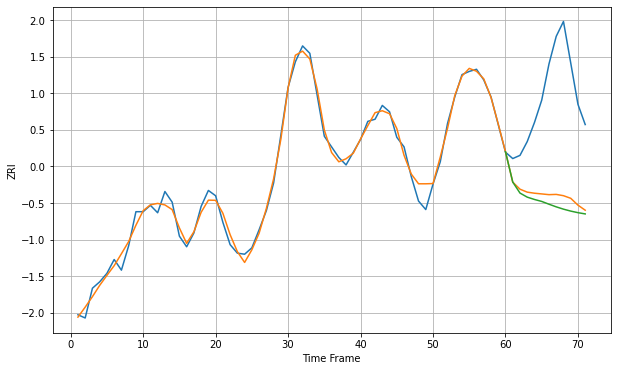

Wall time: 13 s
60622 6.8483132053771705 96.53728326329464 104.11179759906018 [1775.37163739 1746.89571852 1736.52528957 1732.69776374 1730.50176084
 1728.64971903 1726.05061602 1723.56052715 1721.39163923 1719.57009218
 1718.08477553 1716.90826432]

Got an mse at 0.0100 in round 196 and stopped training

71 71 12


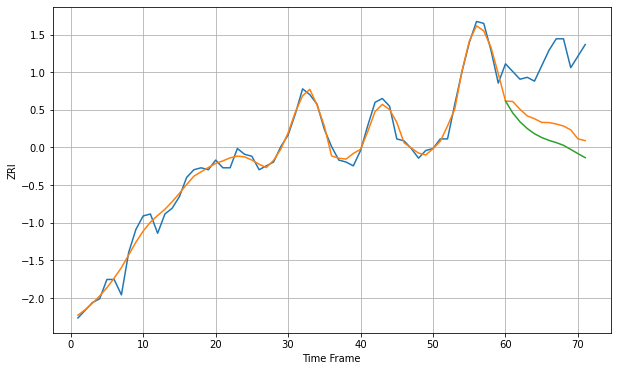

Wall time: 9.27 s
60623 3.8804690976669063 33.30018481477926 40.96790401460397 [1284.68191491 1278.47357311 1273.89781143 1270.39358869 1267.68730171
 1265.72004609 1264.24456442 1263.07625553 1261.6820788  1259.54365228
 1257.35999447 1255.25646308]

Got an mse at 0.0099 in round 349 and stopped training

71 71 12


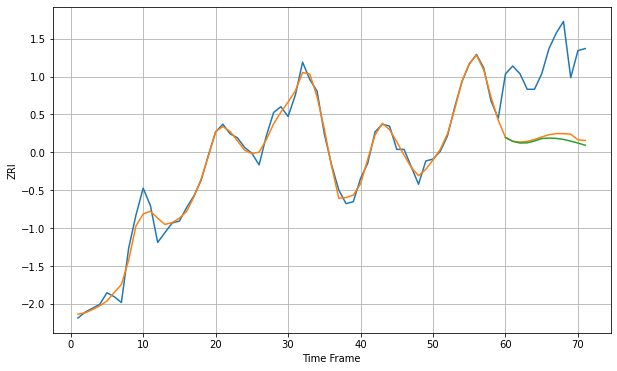

Wall time: 12.4 s
60624 3.8773618720193994 40.3366851250285 41.916578079859605 [1333.11195946 1331.17012404 1330.27519398 1330.37418385 1331.32108159
 1332.59755931 1332.82291539 1332.66092739 1332.13284048 1331.2496334
 1330.25910656 1329.13991536]

Got an mse at 0.0100 in round 118 and stopped training

71 71 12


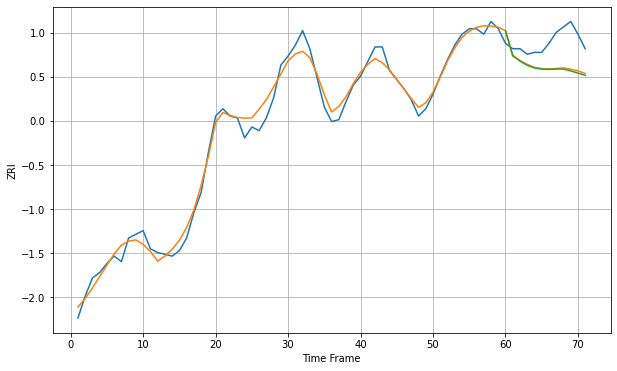

Wall time: 7.83 s
60625 4.750091880231707 14.911293912201181 15.441254954083492 [1552.87538914 1539.42878889 1536.19937673 1533.89219265 1532.44286489
 1531.78376559 1531.66270346 1531.84254655 1531.83321881 1530.81522348
 1529.63445527 1528.32460985]

Got an mse at 0.0099 in round 125 and stopped training

71 71 12


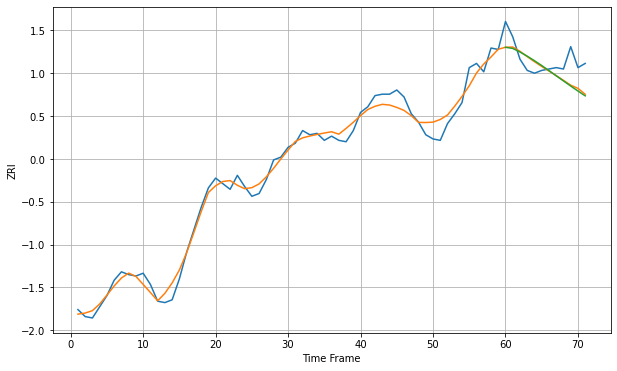

Wall time: 7.63 s
60626 6.040407732291353 13.430926439294275 13.994652265642957 [1372.54765287 1371.71578688 1369.15971399 1366.17710833 1362.9232155
 1359.47191445 1355.85385112 1352.17192438 1348.4828703  1344.83340461
 1341.26352679 1337.80681558]

Got an mse at 0.0100 in round 352 and stopped training

71 71 12


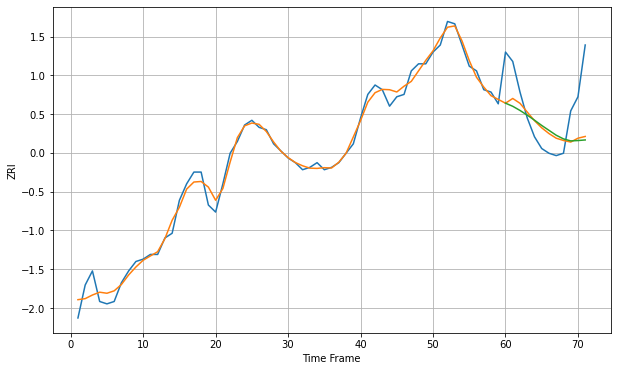

Wall time: 12.4 s
60628 3.2664010169184134 15.870179550514672 16.799197948823423 [1180.2750141  1178.95180779 1177.18967305 1175.19756447 1173.05194108
 1170.80933659 1168.72914583 1166.65247508 1165.09611207 1164.24562085
 1164.39541775 1164.65311905]

Got an mse at 0.0100 in round 413 and stopped training

71 71 12


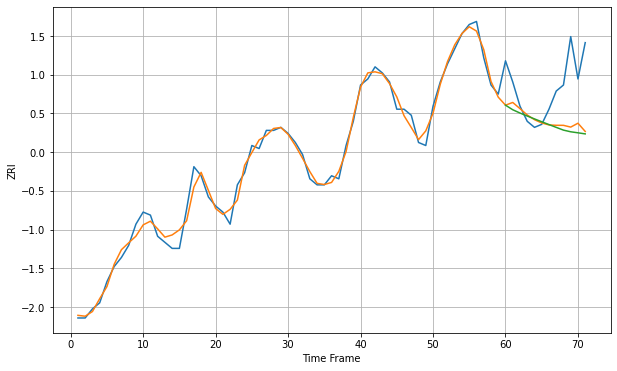

Wall time: 13.3 s
60629 2.5394585197689774 14.649160747153584 15.611290425269091 [1215.33304998 1213.82176686 1212.73338124 1211.74685226 1210.79331254
 1209.85285812 1208.91991823 1207.9961887  1207.08715311 1206.53801757
 1206.20022921 1205.84224203]

Got an mse at 0.0098 in round 130 and stopped training

71 71 12


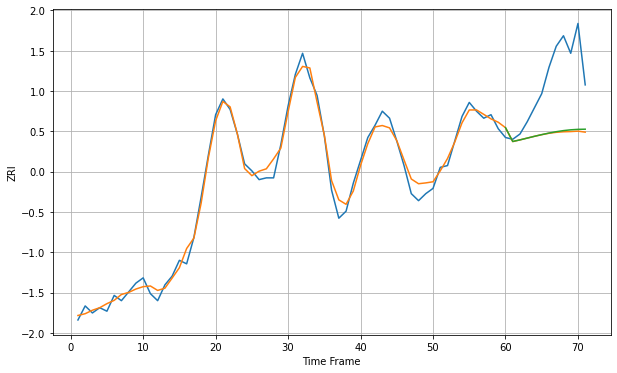

Wall time: 7.9 s
60630 4.4802327938107105 34.45092882334541 33.93890447319909 [1516.61016837 1508.74944651 1509.64022865 1510.66248225 1511.67494332
 1512.6457462  1513.53766655 1514.31243042 1514.93678713 1515.38744809
 1515.65352562 1515.73622113]

Got an mse at 0.0100 in round 482 and stopped training

71 71 12


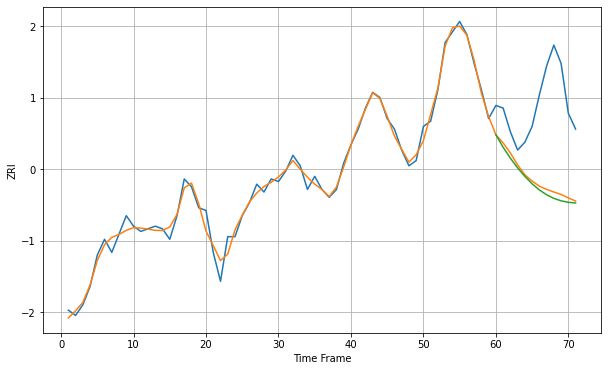

Wall time: 15.1 s
60632 2.710566166654875 31.379690489197383 32.85438812518161 [1312.81801498 1308.07268489 1303.90202108 1300.21073288 1296.96114653
 1294.14592597 1291.80179621 1289.95733556 1288.5943334  1287.65933168
 1287.09084474 1286.83439027]
71 71 12


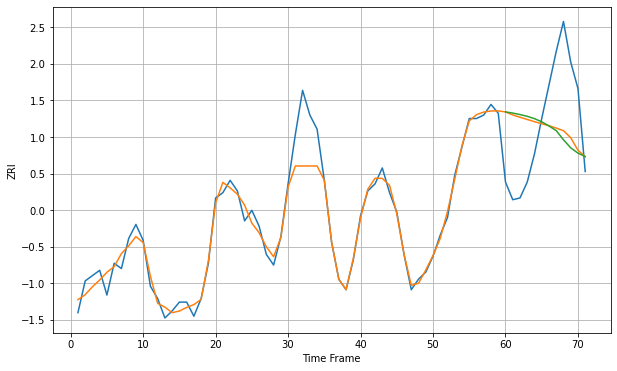

Wall time: 14.7 s
60634 8.694278039587305 37.580971707266464 39.61032735553787 [1586.75677436 1586.08345408 1585.26443164 1584.25634798 1582.93764483
 1581.15077538 1578.81520433 1576.15167944 1570.96744915 1566.39583487
 1563.40920953 1561.45802901]

Got an mse at 0.0099 in round 365 and stopped training

71 71 12


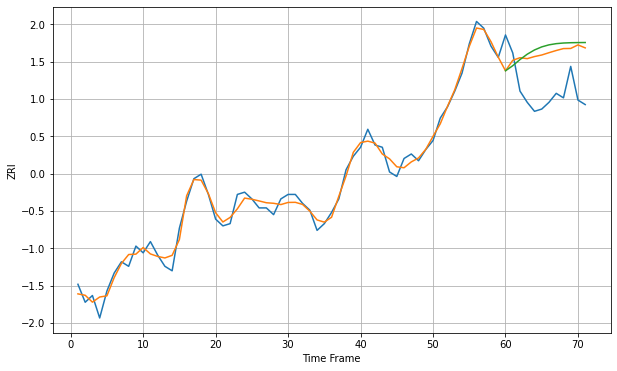

Wall time: 12.5 s
60636 3.2967448915491113 19.738467968980725 21.842435874464595 [1194.03212093 1196.30452599 1199.04112919 1201.42472249 1203.31039889
 1204.68267526 1205.58876333 1206.12397234 1206.40510197 1206.53822341
 1206.59796775 1206.62531384]

Got an mse at 0.0100 in round 143 and stopped training

71 71 12


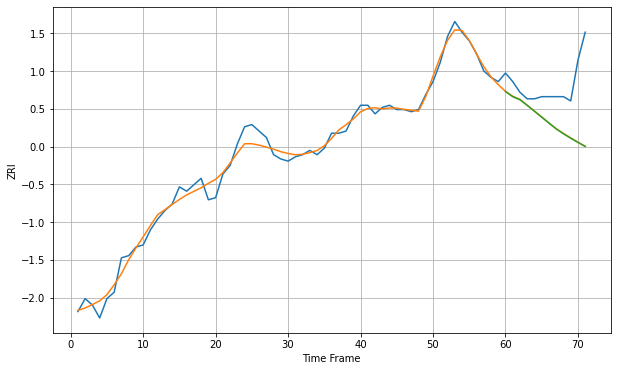

Wall time: 8.23 s
60637 3.4942121298453612 21.420820194477297 21.473791529276536 [1205.43300635 1202.9583967  1201.5583327  1198.95931996 1196.22224399
 1193.4550304  1190.69793056 1187.98234679 1185.72105086 1183.65764961
 1181.720011   1179.86451451]

Got an mse at 0.0099 in round 156 and stopped training

71 71 12


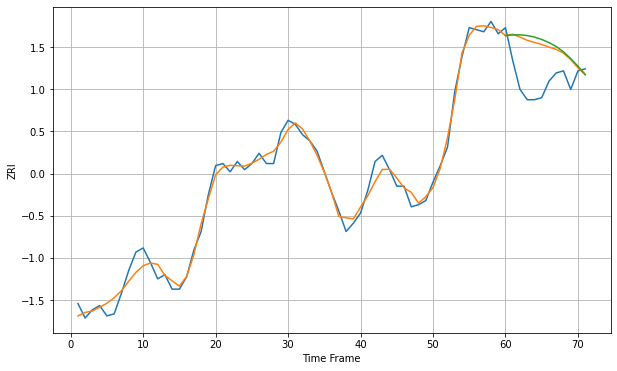

Wall time: 8.58 s
60639 4.03262793184309 17.798916381920755 19.164592709265037 [1382.12941257 1382.46659039 1382.51860719 1382.16199245 1381.40677974
 1380.26700398 1378.74862516 1376.85074246 1374.24406463 1370.97175053
 1367.28789044 1363.24555665]

Got an mse at 0.0099 in round 124 and stopped training

71 71 12


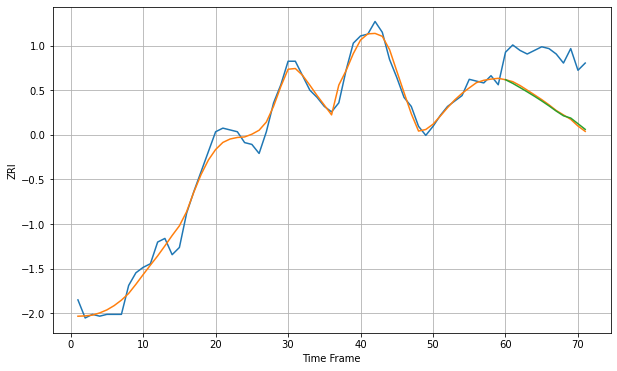

Wall time: 8.88 s
60640 4.87836904125962 28.21701402327125 28.32607199629996 [1488.77903003 1486.76340504 1484.4450901  1482.07494934 1479.62052071
 1477.04595746 1474.32502549 1471.44017347 1468.83165171 1467.57955216
 1464.46492227 1461.31989865]

Got an mse at 0.0100 in round 321 and stopped training

71 71 12


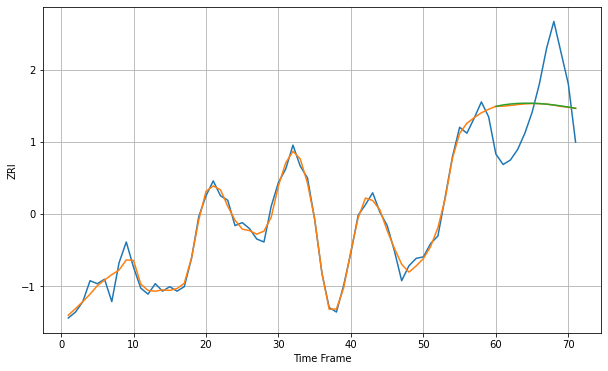

Wall time: 16.9 s
60641 4.814336239701215 31.651974189973423 31.86913215006075 [1565.01271229 1565.99317202 1566.59789182 1566.98226047 1567.15238423
 1567.11728535 1566.89309892 1566.50147979 1565.966637   1565.31257858
 1564.56142948 1563.73280884]

Got an mse at 0.0100 in round 471 and stopped training

71 71 12


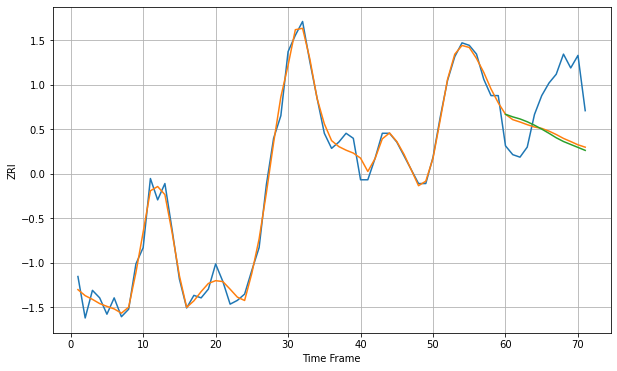

Wall time: 15.9 s
60642 7.0788068101226305 41.72844263750503 43.51103732043364 [1969.12665626 1967.07291347 1965.42188998 1963.16680271 1960.41986494
 1957.33054057 1953.98962851 1950.43202195 1947.45944159 1945.10386401
 1942.75571165 1940.39587543]

Got an mse at 0.0099 in round 186 and stopped training

71 71 12


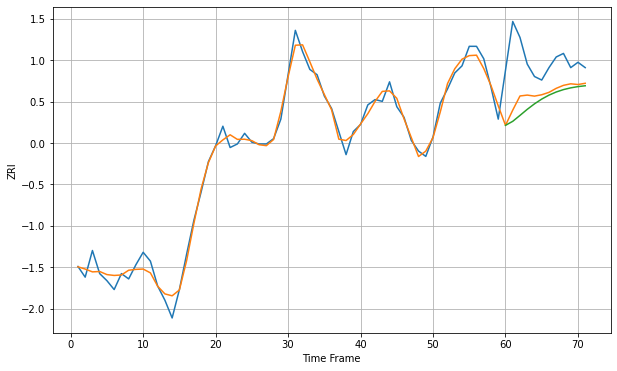

Wall time: 9.02 s
60644 4.621709729186708 22.699171359469812 26.643568970391943 [1231.49478322 1233.76440274 1237.09832366 1240.50044748 1243.60470581
 1246.28977563 1248.51295536 1250.27818922 1251.6240879  1252.61129555
 1253.30907837 1253.78418387]

Got an mse at 0.0100 in round 174 and stopped training

71 71 12


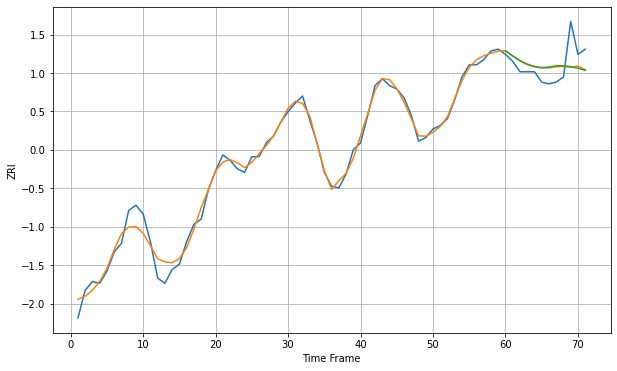

Wall time: 9.04 s
60645 4.383598183342528 10.116829958119098 10.293680884584079 [1501.12212009 1498.1320895  1495.44171849 1493.38425702 1492.07533442
 1491.35900728 1491.68965019 1492.40343627 1492.50731379 1491.90316176
 1491.04591083 1489.82686086]

Got an mse at 0.0099 in round 138 and stopped training

71 71 12


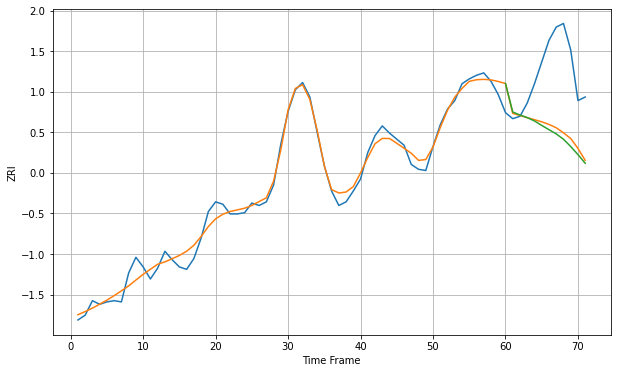

Wall time: 8.22 s
60647 6.683946369527551 53.1476922682885 56.650610188865706 [1635.17980708 1611.56093257 1609.02165225 1606.90944955 1604.11074146
 1600.40012317 1596.85730246 1593.3880928  1588.94514884 1582.87143911
 1576.2063439  1569.00007243]

Got an mse at 0.0099 in round 145 and stopped training

71 71 12


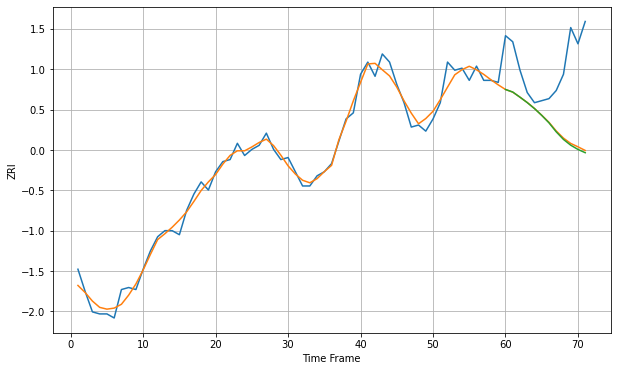

Wall time: 8.27 s
60649 3.9466224164678216 32.861848700581 33.41319868092034 [1094.50845015 1093.24967385 1090.71185976 1088.04761966 1085.09581978
 1081.75764511 1078.08882119 1073.64919317 1069.91107599 1067.08011172
 1064.99223631 1063.38047447]

Got an mse at 0.0100 in round 323 and stopped training

71 71 12


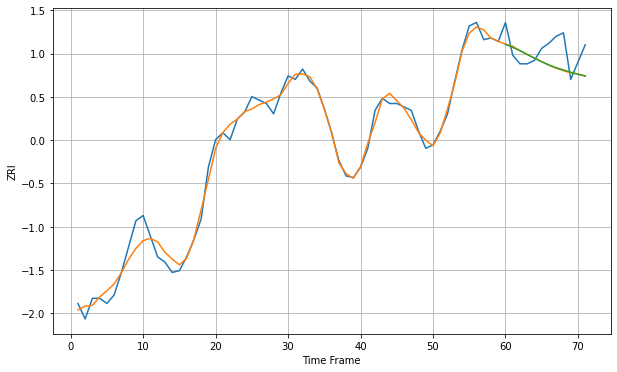

Wall time: 11.8 s
60651 4.995402041244785 11.951722147506722 11.840301814746814 [1362.35051892 1360.53911911 1358.68395867 1356.44631434 1354.28063174
 1352.23778199 1350.32515752 1348.76576308 1347.39979831 1346.14447647
 1345.00055538 1343.96598401]

Got an mse at 0.0100 in round 94 and stopped training

71 71 12


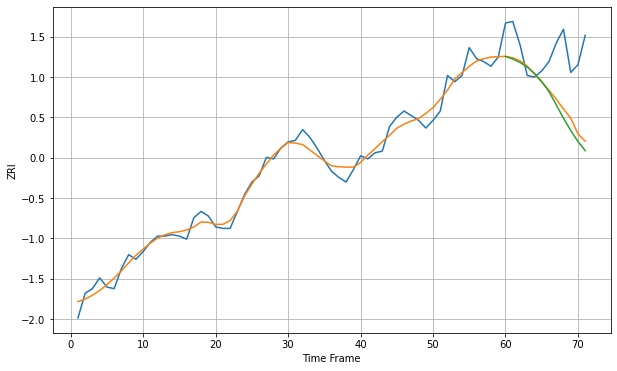

Wall time: 7.28 s
60653 5.195735350345917 33.082208171988874 36.54867279403399 [1429.37991681 1427.74242467 1425.46789523 1422.45417448 1418.4102175
 1413.10589912 1406.55062581 1398.07442937 1389.35205805 1381.38663522
 1374.29209985 1368.32418399]
71 71 12


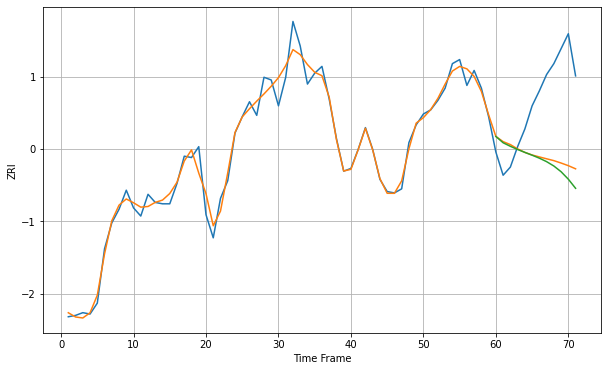

Wall time: 15 s
60654 7.168894244361603 54.01989892688469 58.58557241861822 [2140.50427073 2135.86977879 2133.25638712 2130.91094409 2128.7916706
 2126.72919249 2124.53676102 2121.98550407 2118.781743   2114.57503145
 2109.07944769 2102.38423847]

Got an mse at 0.0099 in round 108 and stopped training

71 71 12


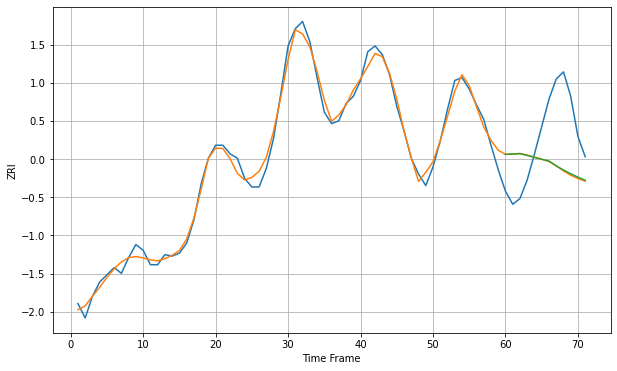

Wall time: 7.64 s
60657 5.216829007373847 38.788533291595556 38.45420686891265 [1748.67936931 1748.86702895 1749.18273219 1747.92597763 1746.60786548
 1745.29333187 1744.02553874 1740.72571018 1737.7821589  1735.1904555
 1732.83617977 1730.65160631]

Got an mse at 0.0100 in round 208 and stopped training

71 71 12


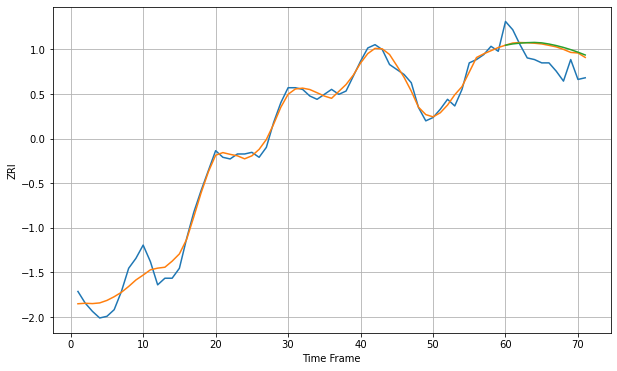

Wall time: 10 s
60660 5.360452894860608 11.904193696358016 12.565899888693359 [1397.68434683 1398.44081235 1398.91176325 1399.21278054 1399.35030966
 1399.08696848 1398.38233485 1397.45537885 1396.32163682 1394.98805193
 1393.46399682 1391.76150226]

Got an mse at 0.0100 in round 338 and stopped training

71 71 12


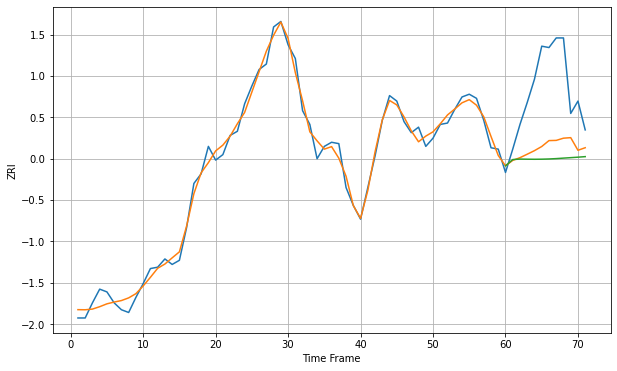

Wall time: 12.1 s
60661 6.000188200761245 47.79854770687332 56.03799927170302 [2055.84198051 2060.40590262 2060.74801304 2060.6578187  2060.6107937
 2060.66688675 2060.82985418 2061.09424381 2061.45183145 2061.78937979
 2062.13672038 2062.53039622]

Got an mse at 0.0099 in round 278 and stopped training

71 71 12


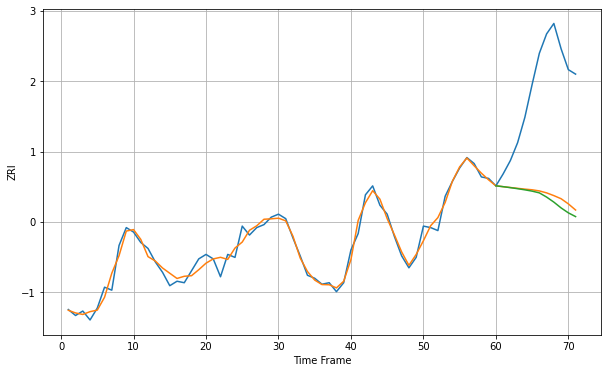

Wall time: 10.9 s
60804 4.689929936760529 75.53883173682037 78.40848645663255 [1361.04143383 1360.45801989 1359.81339215 1359.11000169 1358.33944227
 1357.47127617 1356.30631716 1353.47429266 1350.10144934 1346.20351707
 1342.90376958 1340.38334122]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


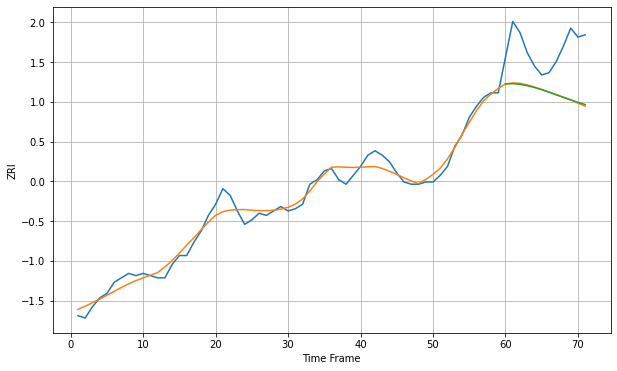

Wall time: 7.09 s
61104 3.5320899853058743 21.439307456057485 21.446190780112012 [637.99007951 638.11470863 637.78874079 637.18713745 636.3685036
 635.38674131 634.24870478 633.11741669 631.91759887 630.79102236
 629.73466449 628.72692277]

Got an mse at 0.0099 in round 128 and stopped training

71 71 12


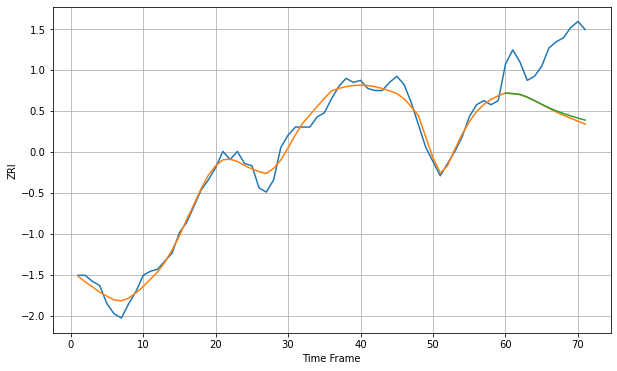

Wall time: 7.69 s
63104 4.0002607480895 31.0915942716788 30.334120902850017 [833.72434269 833.5170446  833.12271117 831.78148063 830.04383076
 828.23470459 826.51792992 824.99359826 823.67073465 822.49871737
 821.42575773 820.42305207]

Got an mse at 0.0099 in round 73 and stopped training

71 71 12


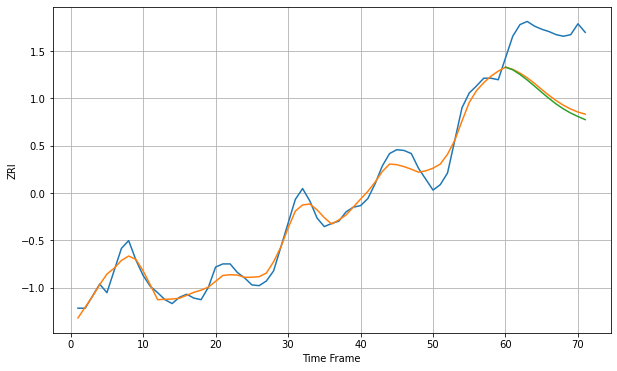

Wall time: 6.92 s
63105 11.958546590074933 80.38674494522702 84.41855607578997 [1218.21618625 1214.84651139 1208.77941204 1201.65611318 1193.8471654
 1185.79039554 1177.94975213 1170.73770518 1164.4339104  1159.11025924
 1154.64419117 1150.67582594]

Got an mse at 0.0099 in round 239 and stopped training

71 71 12


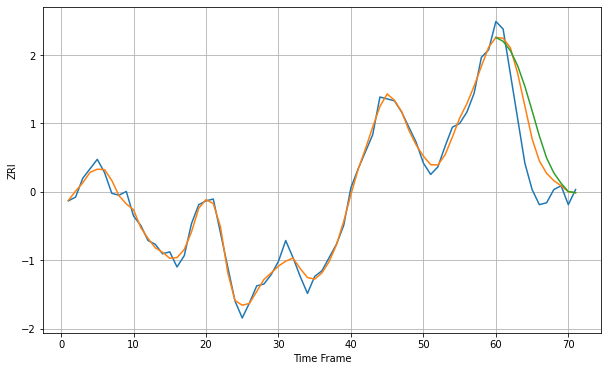

Wall time: 9.93 s
63107 3.597147550584386 16.700553627016333 23.195271145442806 [785.54770028 783.49199298 778.55707453 770.59499158 759.70454968
 746.72126591 733.36153245 721.73433731 713.81362432 708.33883004
 703.91782668 703.35453171]

Got an mse at 0.0097 in round 81 and stopped training

71 71 12


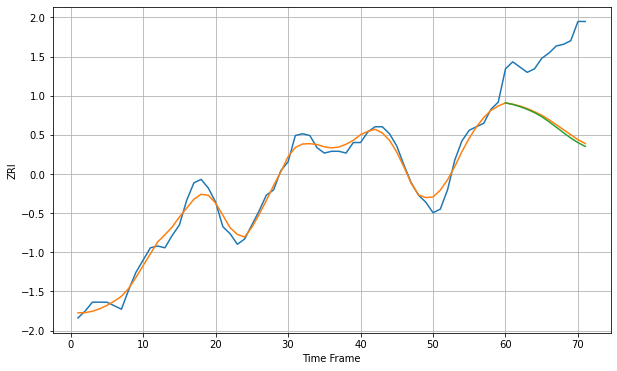

Wall time: 7 s
63108 4.3250510818225365 42.41757872005145 43.559776098211216 [937.58569993 936.69426375 935.46909538 933.91112008 932.03837862
 929.74388085 926.87360572 923.77338469 920.60603765 917.58751062
 914.94247887 912.77135827]

Got an mse at 0.0100 in round 178 and stopped training

71 71 12


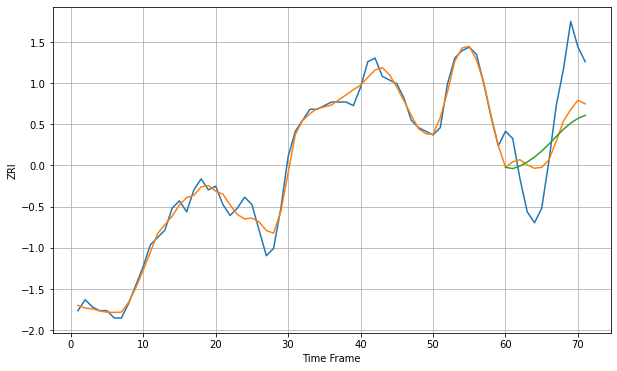

Wall time: 8.76 s
63109 2.2373569403367957 12.567122459378048 14.870742783799873 [736.15585639 735.81515238 736.51912162 737.58974042 738.94933291
 740.60253244 742.51637198 744.56682976 746.54544638 748.23663238
 749.51229072 750.3629764 ]

Got an mse at 0.0100 in round 146 and stopped training

71 71 12


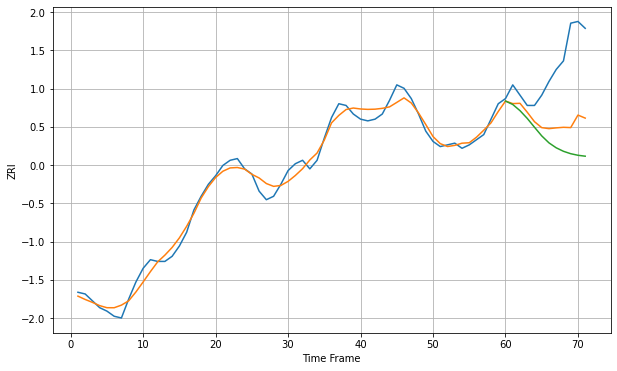

Wall time: 8.49 s
63110 4.432264391892381 33.50130115502871 45.292450725055545 [885.55800951 883.56517605 879.97077453 875.44433658 870.28863039
 865.24150059 861.16136442 858.28163585 856.24223434 854.84049376
 853.93062184 853.39221389]

Got an mse at 0.0099 in round 58 and stopped training

71 71 12


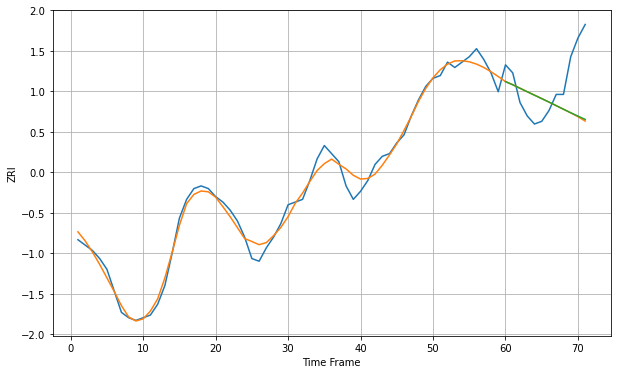

Wall time: 6.57 s
63111 2.9617534004633828 15.79090214532293 15.640523983296637 [684.7584026  683.57376377 682.29010005 681.00458785 679.72383919
 678.44136548 677.14524229 675.82717712 674.49318706 673.17539279
 671.93683583 670.70586627]

Got an mse at 0.0100 in round 238 and stopped training

71 71 12


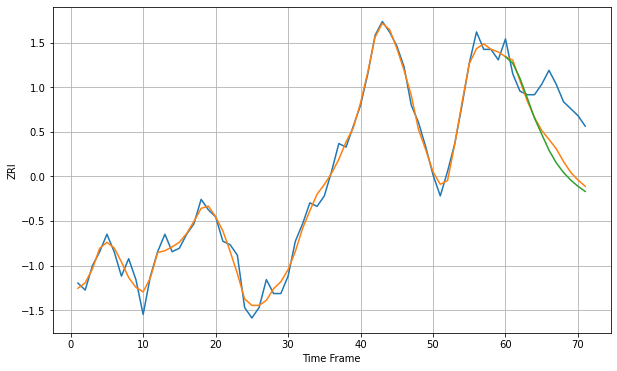

Wall time: 10.1 s
63112 2.5443536482842135 13.751974018913272 15.603348453228241 [775.88840546 774.01831691 769.69160055 764.08566338 758.30969914
 753.67043361 749.10287089 745.48905689 742.72488652 740.52803105
 738.74426513 737.28431088]

Got an mse at 0.0099 in round 129 and stopped training

71 71 12


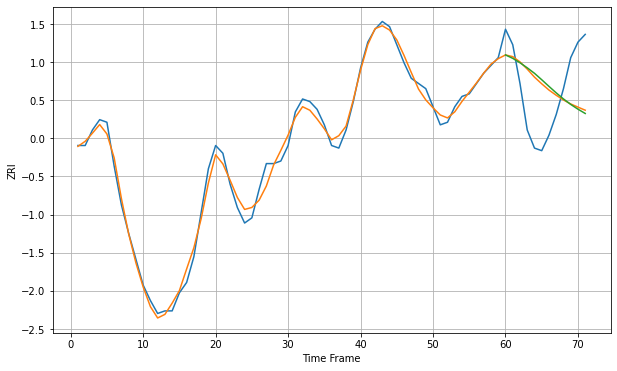

Wall time: 8.26 s
63113 2.922291900430302 19.064756960721255 19.87568346933894 [751.04769174 749.72940963 748.0115769  746.06186942 743.93769272
 741.4474955  738.87638533 736.36895865 734.0171835  731.89651243
 730.057108   728.393108  ]

Got an mse at 0.0099 in round 238 and stopped training

71 71 12


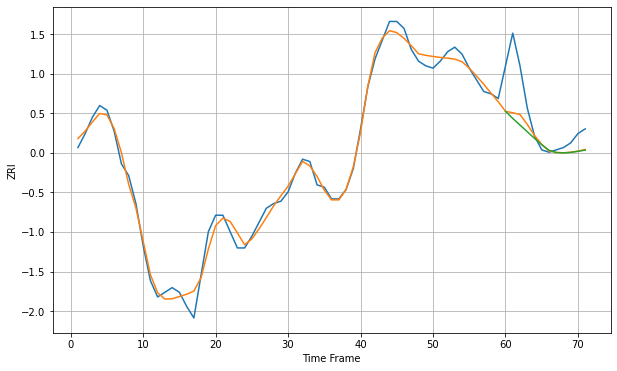

Wall time: 10.2 s
63115 3.3625458800851433 13.512454368572675 14.812515663689327 [661.50247877 658.46950923 655.6400965  652.78464925 649.9390009
 647.22018766 644.8126646  643.89339533 643.70537951 643.91055329
 644.35884099 644.91687616]

Got an mse at 0.0099 in round 85 and stopped training

71 71 12


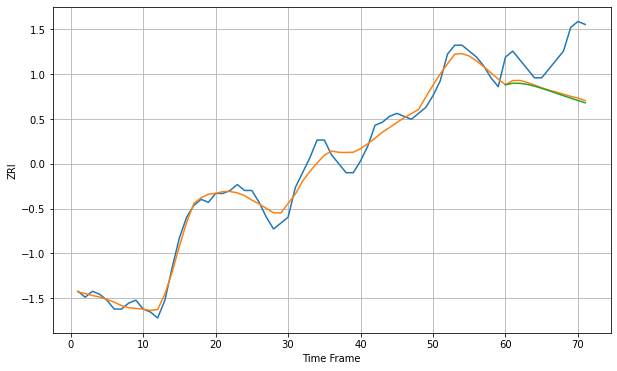

Wall time: 7.49 s
63116 2.996665388532816 14.488033590932615 14.993553854712548 [692.66258488 693.14606343 693.13543123 692.77930355 692.18590594
 691.44820271 690.63690414 689.79959478 688.96454991 688.14621705
 687.35040901 686.57822025]

Got an mse at 0.0100 in round 83 and stopped training

71 71 12


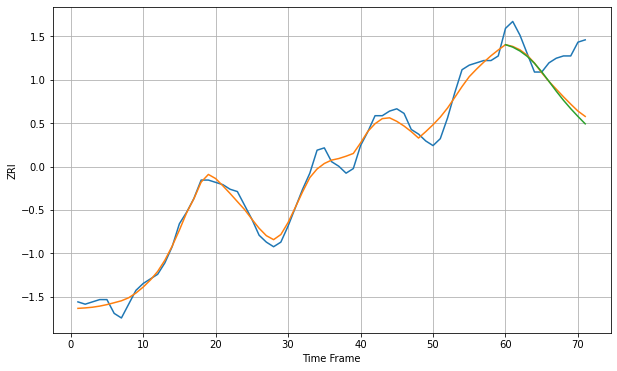

Wall time: 7.18 s
63118 3.743195480825514 16.415751220345182 17.76168306864073 [737.90524267 736.84379461 735.14287286 732.81629099 729.79266847
 726.08908247 721.92305885 717.69173128 713.71231608 710.06348898
 706.67391298 703.46124287]

Got an mse at 0.0100 in round 109 and stopped training

71 71 12


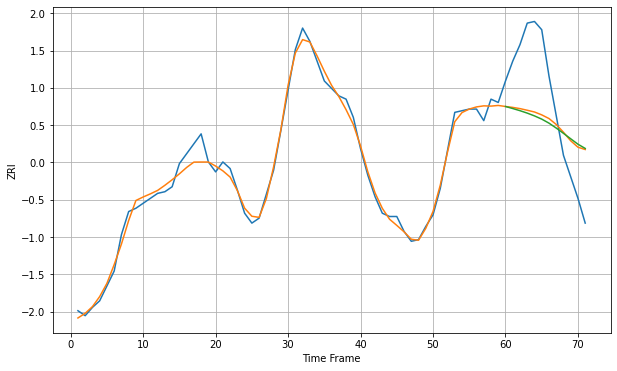

Wall time: 7.68 s
63130 4.481544070755938 35.65200591076015 37.08335519122137 [1029.55484764 1028.32202706 1027.02148326 1025.55135431 1023.86315552
 1021.91611502 1019.48096213 1016.51146688 1013.31238264 1010.00599934
 1006.74027122 1004.1737418 ]

Got an mse at 0.0100 in round 127 and stopped training

71 71 12


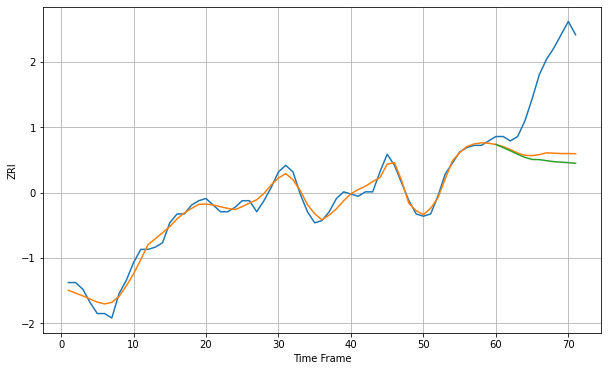

Wall time: 7.89 s
63139 2.9251142225832134 36.17100880394669 38.86392325804017 [802.40342246 801.01781725 799.53520216 797.9845723  796.57510476
 795.65452324 795.55639935 795.09074885 794.6401209  794.41519652
 794.19607572 793.90520011]

Got an mse at 0.0099 in round 130 and stopped training

71 71 12


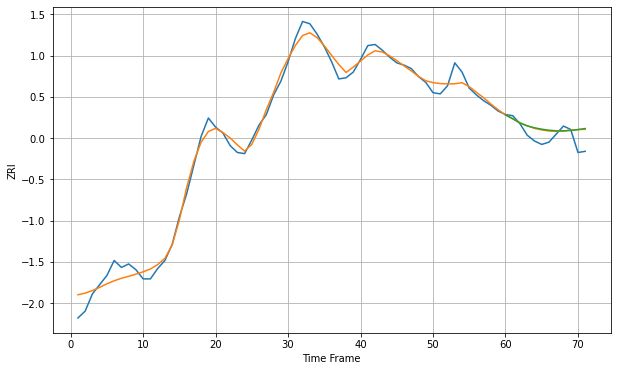

Wall time: 7.91 s
64111 7.109351487615166 10.153171203362538 10.43333632233107 [1010.7179917  1007.31910187 1003.6292453  1001.18160846  999.47931179
  998.27262112  997.37759418  996.88299468  996.82999756  997.1920746
  997.89462544  998.84620107]

Got an mse at 0.0099 in round 222 and stopped training

71 71 12


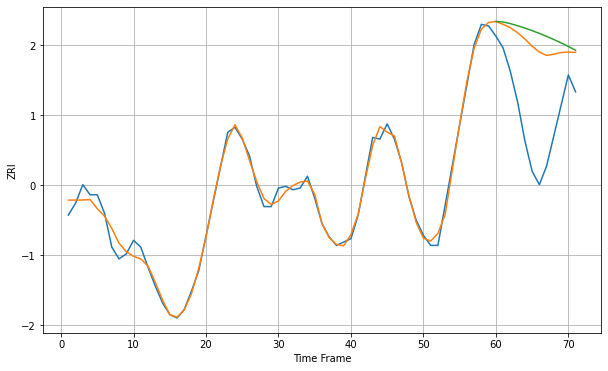

Wall time: 9.4 s
64801 4.116095908866479 46.782817117362875 53.233438759180935 [829.6970931  829.41210379 828.41631386 827.18089603 825.79364473
 824.27226449 822.62512725 820.86014309 818.98456835 817.0044639
 814.87628642 812.62577779]

Got an mse at 0.0099 in round 166 and stopped training

71 71 12


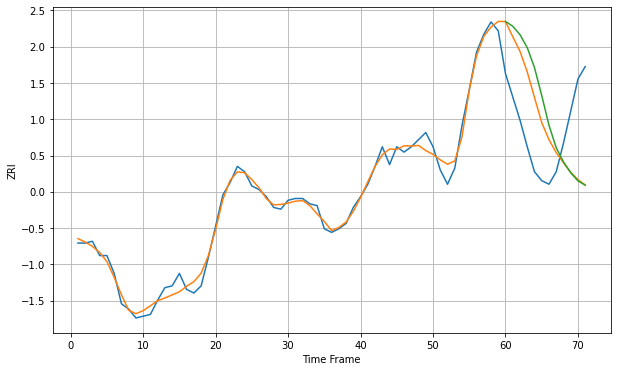

Wall time: 8.31 s
64804 4.031553636747658 38.37612933274034 44.496419193480186 [869.22971049 866.61226772 861.84722197 854.60654284 843.36739916
 827.74754578 811.0609838  798.47227391 790.49733476 784.43071326
 779.88366876 777.47560761]
71 71 12


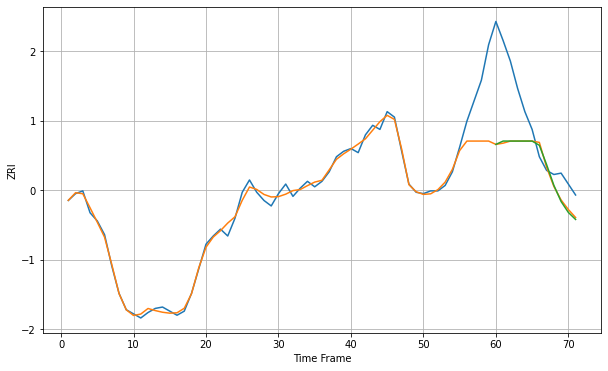

Wall time: 15 s
64834 12.053293242342207 41.20118048129724 41.107816290969076 [830.03707458 832.470303   832.470303   832.470303   832.470303
 832.470303   829.36668511 815.25434189 800.11206649 788.23492595
 780.25695616 775.11264815]

Got an mse at 0.0100 in round 131 and stopped training

71 71 12


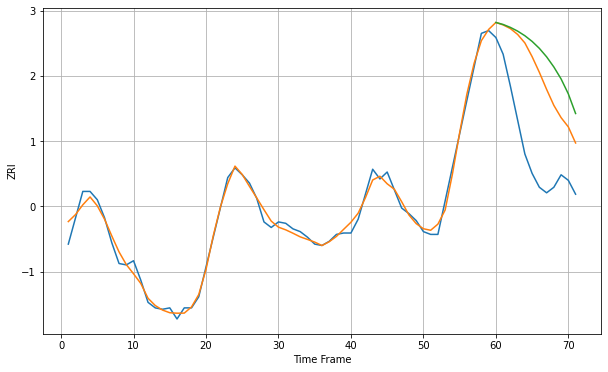

Wall time: 7.79 s
64836 4.677764432517978 57.78835779987478 71.90999354025737 [875.86098138 874.4173642  872.30223002 869.62560821 866.29828125
 862.20059904 857.18537675 851.08771427 843.75897854 835.12843376
 824.32999905 810.19088944]

Got an mse at 0.0099 in round 99 and stopped training

71 71 12


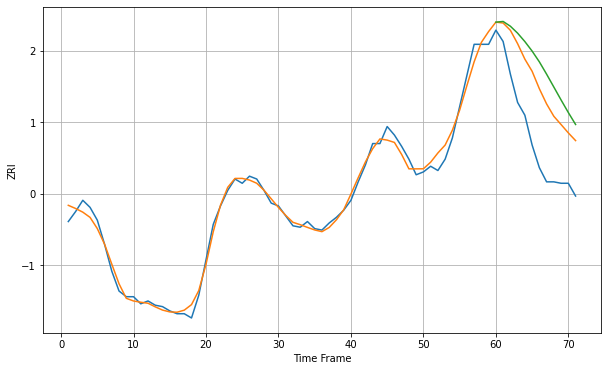

Wall time: 7.22 s
64870 4.959143220481048 40.72473751404859 54.10748662395592 [898.63474897 899.11356829 895.76265451 890.8571987  884.93569796
 878.23144081 870.63896552 861.93979722 852.84491431 843.73199443
 834.87127765 826.46754275]

Got an mse at 0.0099 in round 438 and stopped training

71 71 12


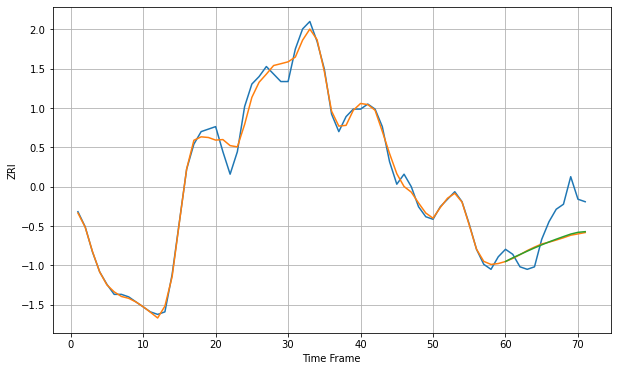

Wall time: 13.4 s
65201 3.1252896841168814 11.026624399030137 10.733830990826883 [781.12252248 782.60153331 783.92594136 785.24993747 786.54065783
 787.77565808 788.94172782 790.03943315 791.07985023 792.07868466
 792.7751906  793.04187023]
71 71 12


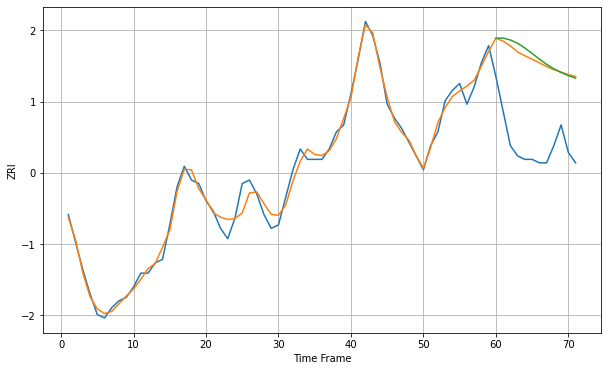

Wall time: 14.6 s
65202 2.328363847314049 25.016047159951352 26.00750658756564 [801.1704842  801.18000832 800.63264218 799.65956764 798.31570286
 796.73124125 795.09413087 793.57516067 792.26746113 791.18563947
 790.30030652 789.56926312]

Got an mse at 0.0099 in round 182 and stopped training

71 71 12


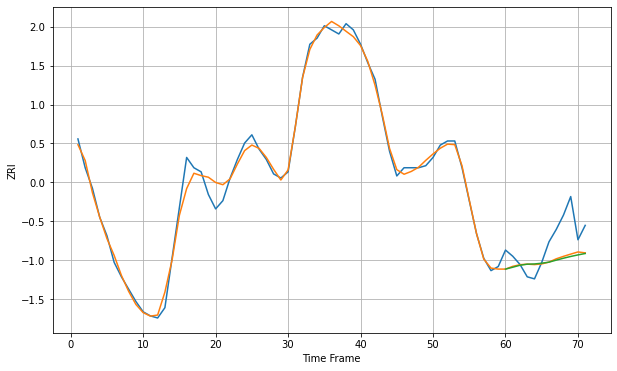

Wall time: 8.57 s
65203 3.7399289972637715 12.564050614819203 13.076822549729464 [803.74812869 804.65697624 805.62235245 806.13866221 806.24848009
 806.61093602 807.12420369 808.10060506 809.04004676 809.89000243
 810.64823313 811.32179077]

Got an mse at 0.0100 in round 196 and stopped training

71 71 12


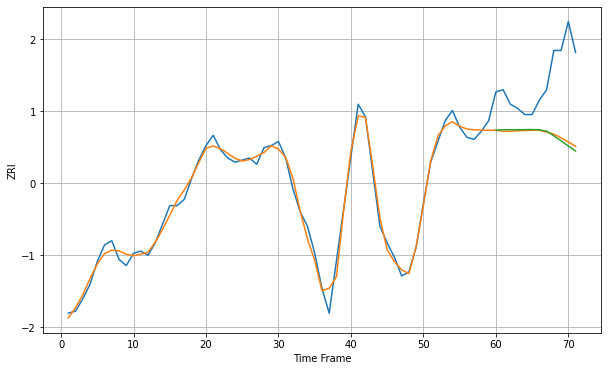

Wall time: 9.3 s
66061 3.4704779596006694 29.790482682923503 30.54259209535022 [1007.45608308 1007.66763413 1007.67774077 1007.68851831 1007.70917468
 1007.74614146 1007.61050261 1006.97117867 1004.73511223 1002.27093632
  999.80225777  997.40124822]

Got an mse at 0.0099 in round 105 and stopped training

71 71 12


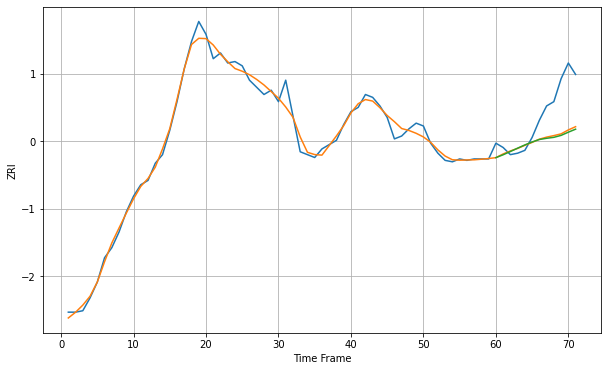

Wall time: 7.29 s
66213 4.686775220319203 23.042306277555415 23.875931385443632 [1021.90603949 1023.89630732 1026.17405252 1028.52729673 1030.79551077
 1032.83680385 1034.57634126 1035.42040628 1036.08891296 1037.44475232
 1039.67608728 1041.77968662]

Got an mse at 0.0094 in round 28 and stopped training

71 71 12


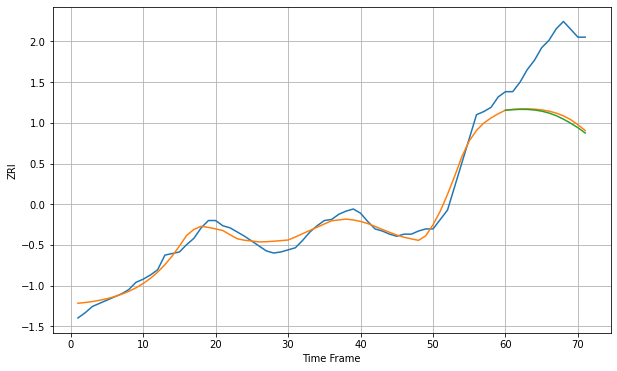

Wall time: 6.07 s
66214 7.187083487117641 64.46213041075767 66.39375993979242 [830.33816091 830.79209929 831.13739762 831.05973865 830.50768216
 829.39914945 827.61231475 825.09577832 821.7219977  817.87455418
 813.56222881 808.56451701]

Got an mse at 0.0099 in round 106 and stopped training

71 71 12


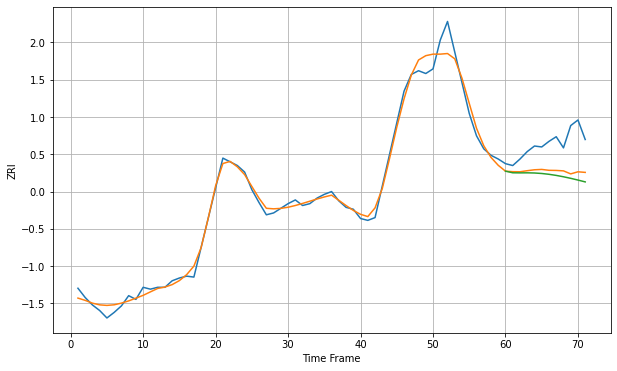

Wall time: 7.24 s
66215 7.926089951028887 31.50866791148904 36.46829792189599 [1023.93779132 1022.19380988 1022.10928853 1022.15653221 1021.97395739
 1021.44866243 1020.57133855 1019.37791334 1017.91593694 1016.2328342
 1014.37649713 1012.39799862]

Got an mse at 0.0100 in round 50 and stopped training

71 71 12


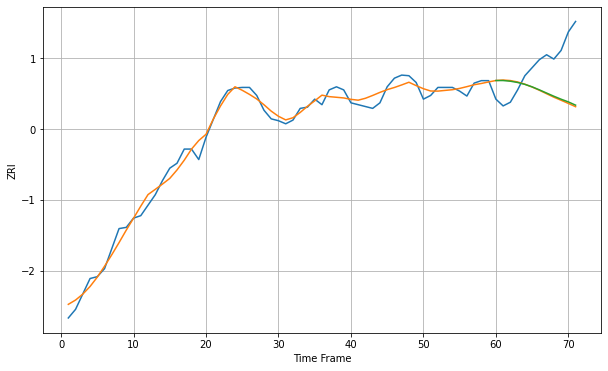

Wall time: 6.2 s
66223 11.414016396305954 67.47626802994755 66.16010667987628 [1436.19672364 1436.15534764 1435.07168429 1433.01054277 1429.94308085
 1425.94863255 1421.07986524 1415.87607011 1410.72053072 1405.89332755
 1401.5322166  1396.22660619]

Got an mse at 0.0099 in round 167 and stopped training

71 71 12


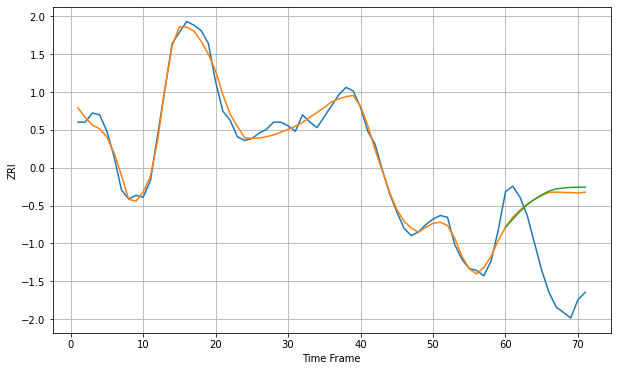

Wall time: 8.47 s
66502 4.099568803343164 45.91739156314694 47.50654674830302 [821.56193042 825.94620562 830.18424677 833.9586512  836.84555458
 839.25545903 841.29670694 842.55114701 842.99232573 843.33956666
 843.4244759  843.45988271]

Got an mse at 0.0099 in round 204 and stopped training

71 71 12


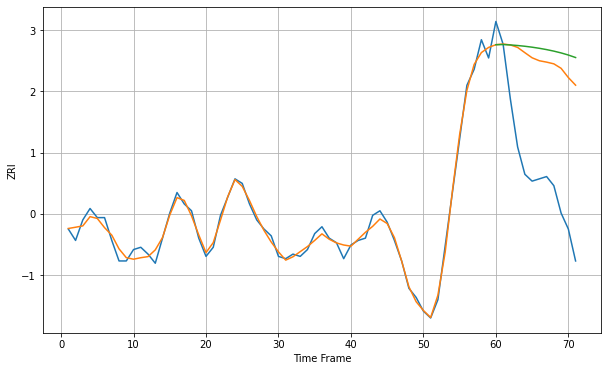

Wall time: 8.88 s
66614 2.658953584501633 50.632947774660025 56.1234865773213 [934.8113834  934.87968813 934.70857602 934.45632499 934.12783459
 933.72222734 933.23619586 932.6632821  931.99269434 931.20772051
 930.28385296 929.18721903]

Got an mse at 0.0100 in round 450 and stopped training

71 71 12


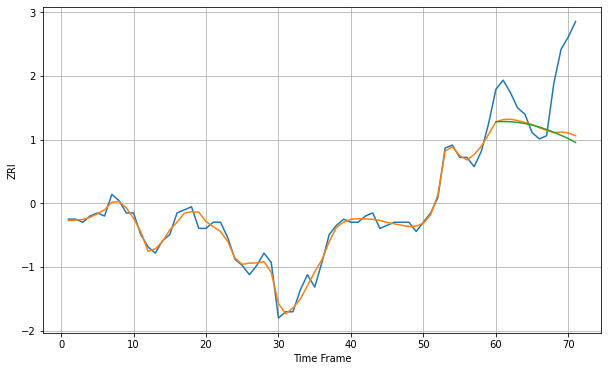

Wall time: 13.8 s
67218 2.0472882149447167 17.576889602414123 18.445806884009603 [651.51663373 651.59918611 651.52583663 651.311495   650.95323731
 650.44884359 649.8010458  649.01994908 648.12316483 647.1333499
 646.07439955 644.81809247]

Got an mse at 0.0099 in round 140 and stopped training

71 71 12


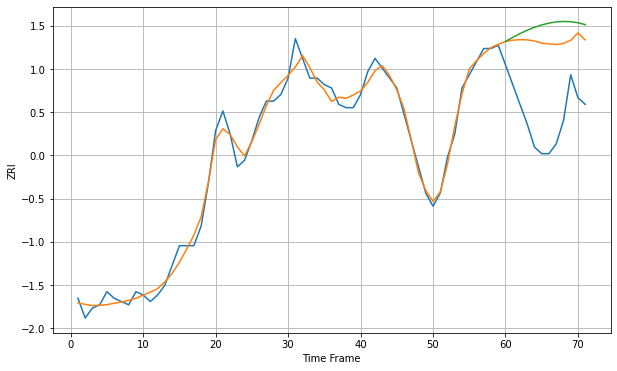

Wall time: 7.88 s
72205 2.6117588322417675 24.02137896421094 28.34644387351394 [745.14817532 746.38543533 747.53620023 748.56617299 749.45497742
 750.1837611  750.73434298 751.08953014 751.23356856 751.15260062
 750.83517953 750.27292472]

Got an mse at 0.0100 in round 132 and stopped training

71 71 12


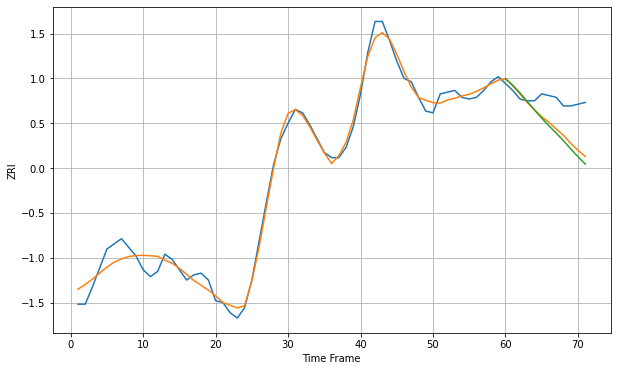

Wall time: 7.86 s
72712 5.164481096878753 16.487374534909033 18.767986019388314 [929.79494259 926.05020842 921.49127132 916.59385824 911.65471346
 906.89414597 902.42466502 898.26617196 893.80642257 889.09906497
 884.55519568 880.27432697]

Got an mse at 0.0100 in round 346 and stopped training

71 71 12


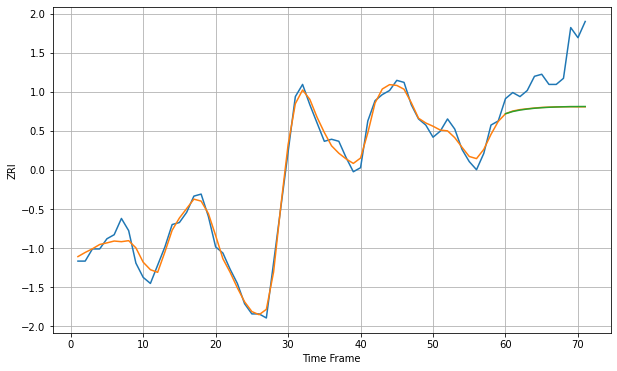

Wall time: 12 s
72764 3.819278372903678 21.707101246043056 21.703511847729985 [916.56750411 917.65903234 918.37470862 918.8903413  919.26771865
 919.54429262 919.74536183 919.89008391 919.99282497 920.06307761
 920.10596044 920.12339333]

Got an mse at 0.0100 in round 189 and stopped training

71 71 12


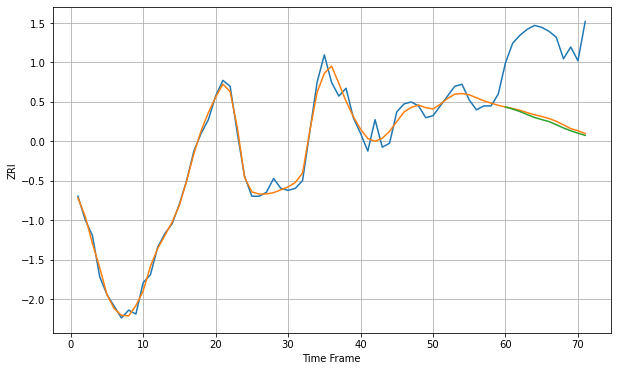

Wall time: 8.89 s
73071 3.992618865992649 41.033564013730874 42.15482808028146 [848.43656255 847.390093   846.12594339 844.57672492 843.11611307
 842.02652571 841.03725245 839.4584605  837.77251765 836.34221394
 835.10304099 833.98560644]

Got an mse at 0.0100 in round 183 and stopped training

71 71 12


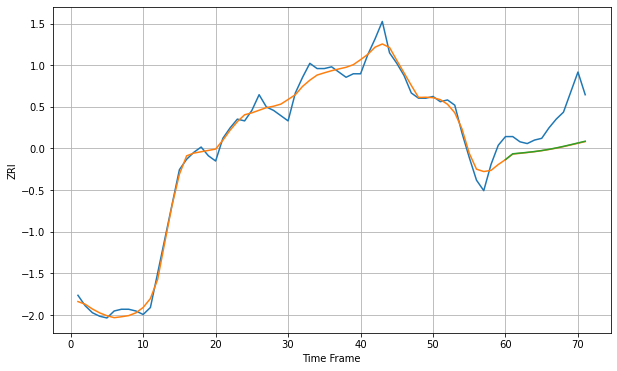

Wall time: 9.17 s
73159 4.753086398969379 19.504837790280096 19.387335681418328 [690.81303427 694.13581159 694.53916509 694.95280718 695.42504042
 696.0038353  696.69908965 697.50180722 698.39563209 699.35713624
 700.351522   701.33336952]

Got an mse at 0.0098 in round 78 and stopped training

71 71 12


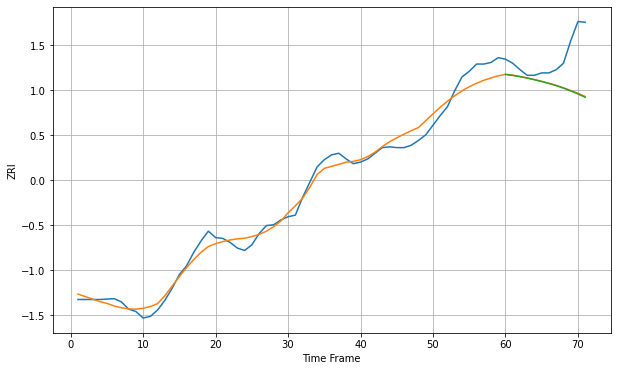

Wall time: 6.84 s
75001 10.923087613415234 43.430262363546916 43.856178055394444 [1277.15019978 1275.88172846 1274.34383004 1272.56826377 1270.535395
 1268.29843915 1265.86005696 1263.18266617 1260.06138464 1256.59913439
 1252.79632898 1248.66056194]

Got an mse at 0.0099 in round 72 and stopped training

71 71 12


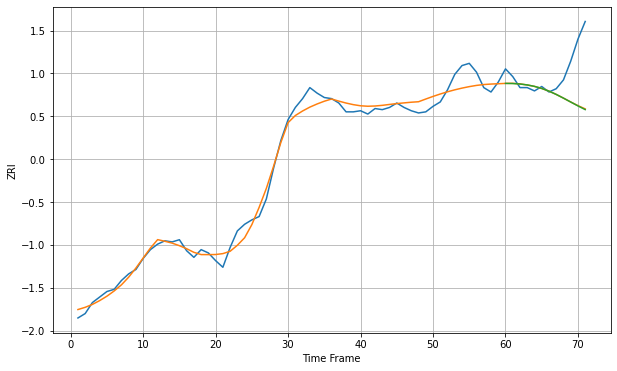

Wall time: 6.85 s
75010 7.68412444319892 31.435693301365387 31.616088388487707 [1255.8138629  1255.70150895 1255.26562312 1254.42829547 1253.11073591
 1251.2424699  1248.79230544 1245.80874713 1242.44044003 1238.90181535
 1235.393704   1232.03977824]

Got an mse at 0.0099 in round 87 and stopped training

71 71 12


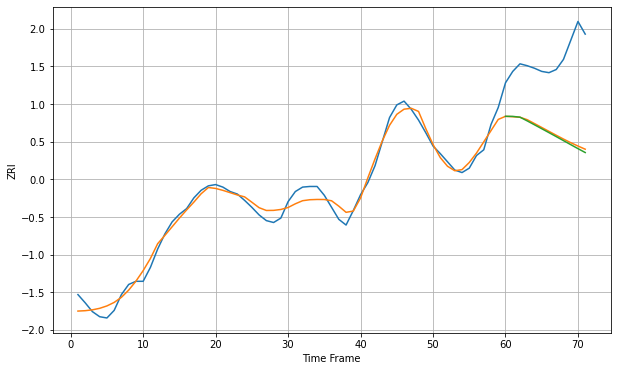

Wall time: 6.99 s
75013 11.685551780579425 119.48378507882323 121.89587882536718 [1408.96574089 1408.86542563 1407.61513257 1401.71129487 1395.55004708
 1389.36675585 1383.14733114 1376.86863068 1370.53276383 1364.17631728
 1357.865398   1351.68209257]

Got an mse at 0.0098 in round 36 and stopped training

71 71 12


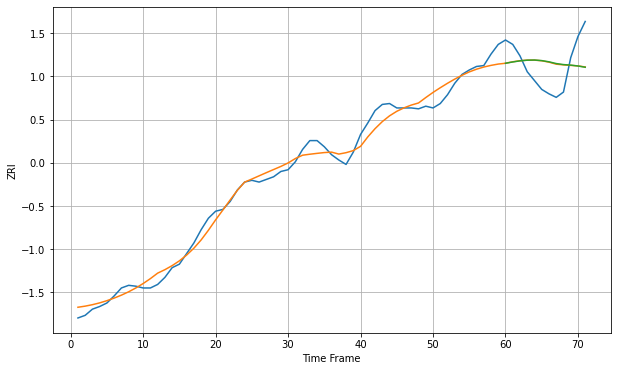

Wall time: 5.94 s
75024 9.590633806439156 29.400604199377383 29.637124617715585 [1349.64249343 1351.09321926 1352.35835266 1353.12017412 1353.29993862
 1352.65244434 1351.27771137 1349.31090199 1348.14301233 1347.53989996
 1346.549111   1345.1149796 ]

Got an mse at 0.0100 in round 71 and stopped training

71 71 12


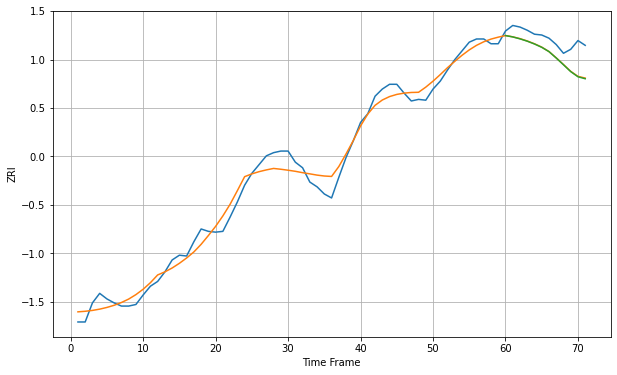

Wall time: 6.65 s
75039 12.108659385202834 22.842462720318856 23.177437592334353 [1532.30326219 1530.58932424 1528.16900905 1525.22884303 1521.69788967
 1517.52485199 1512.10017886 1504.06376237 1495.57655744 1486.95730771
 1480.46674037 1477.98057993]

Got an mse at 0.0099 in round 133 and stopped training

71 71 12


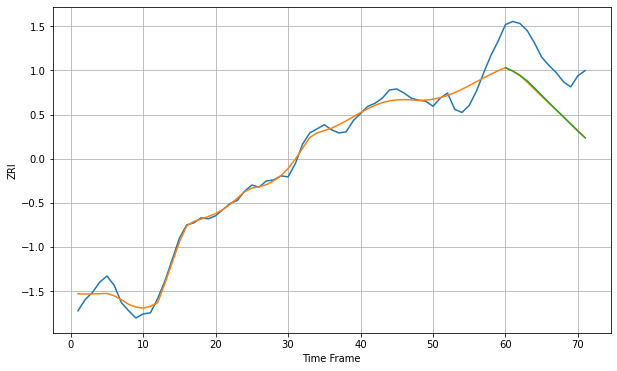

Wall time: 8.03 s
75050 8.575337900612437 45.821302692397104 45.53055230368554 [1162.81118979 1159.46594144 1155.30215384 1149.85382517 1142.94588103
 1135.71200794 1128.56411812 1121.60553914 1114.69028691 1107.69542771
 1100.73843024 1094.17812437]

Got an mse at 0.0099 in round 83 and stopped training

71 71 12


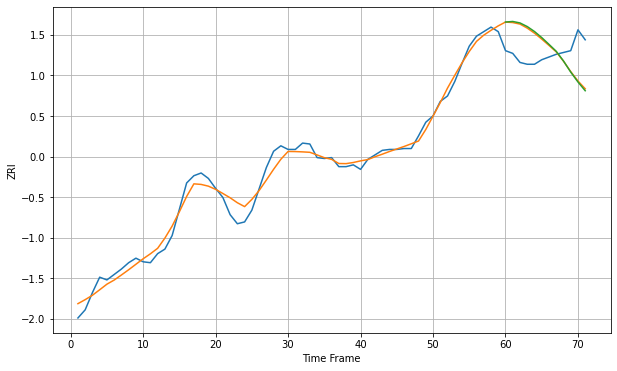

Wall time: 6.91 s
75052 8.835285793219683 34.32869490765395 35.472505959187714 [1151.59547711 1152.23136813 1150.59785475 1146.61583649 1141.14274275
 1134.44939129 1126.97976556 1119.31663876 1108.65685206 1096.37331692
 1085.44781541 1075.79380066]

Got an mse at 0.0098 in round 91 and stopped training

71 71 12


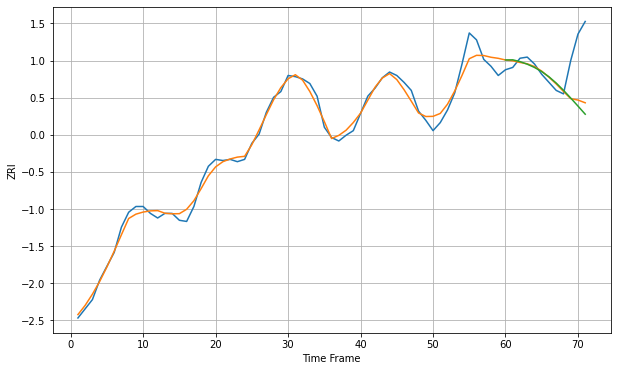

Wall time: 7.11 s
75056 6.297633742809607 28.314185673819146 31.290597135879295 [1371.48321261 1371.62771806 1370.05121549 1367.82502917 1364.97872248
 1361.36832815 1356.84695901 1351.38955872 1345.13803673 1338.3623507
 1331.38971564 1324.30097405]

Got an mse at 0.0100 in round 48 and stopped training

71 71 12


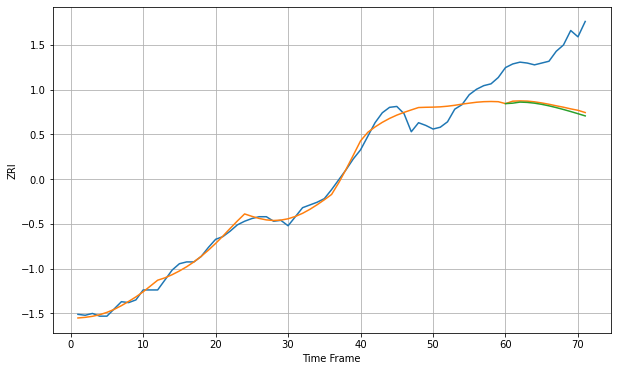

Wall time: 6.35 s
75063 9.710033312771017 61.53015904724451 63.75991932437256 [1201.11531551 1201.62297029 1202.80489693 1202.47264464 1201.6177105
 1200.32646019 1198.67321423 1196.74580651 1194.62507074 1192.35489823
 1189.97917075 1187.53219695]

Got an mse at 0.0094 in round 35 and stopped training

71 71 12


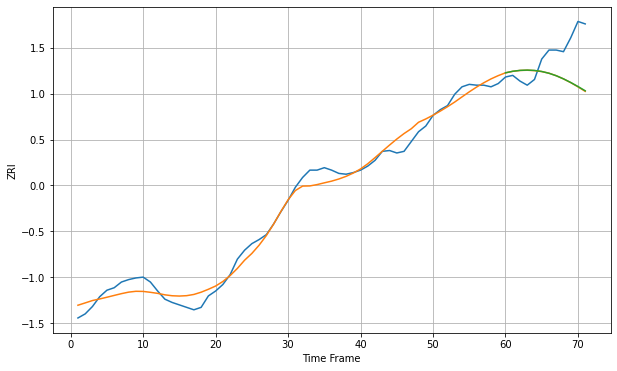

Wall time: 6.32 s
75067 10.693587661276561 40.86509717448788 40.677656832161865 [1218.122027   1220.02730929 1221.10699331 1221.47043676 1221.04109492
 1219.7581363  1217.59296977 1214.56475354 1210.7514541  1206.28895219
 1201.35531552 1196.14520611]

Got an mse at 0.0100 in round 173 and stopped training

71 71 12


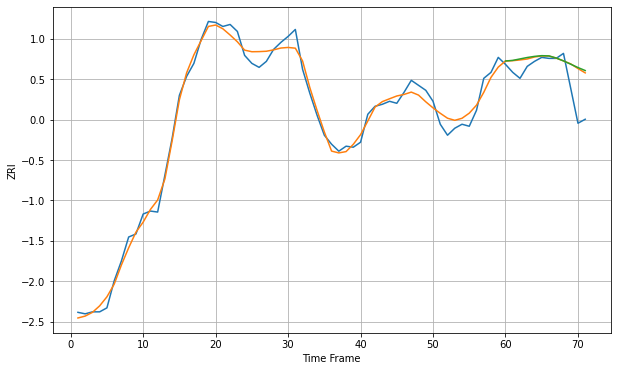

Wall time: 9.05 s
75070 8.025808223586887 23.078443793707205 23.78636929640885 [1564.383755   1565.00653924 1566.44924011 1567.89259782 1569.00585838
 1569.72709767 1569.46487339 1567.36611848 1564.48564204 1561.17759945
 1557.84017173 1554.81742061]

Got an mse at 0.0097 in round 47 and stopped training

71 71 12


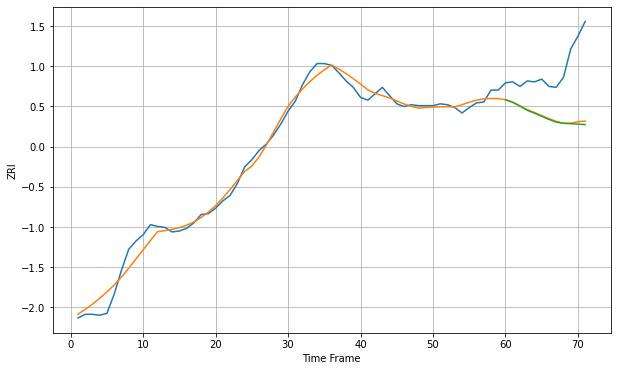

Wall time: 6.6 s
75074 8.514742547789403 55.77886155021729 57.04436289949503 [1239.49568045 1236.65025959 1232.66661025 1227.96709262 1224.76145276
 1221.35909177 1217.92859541 1215.02052353 1213.72598913 1213.26728546
 1212.80280202 1212.32165889]

Got an mse at 0.0099 in round 38 and stopped training

71 71 12


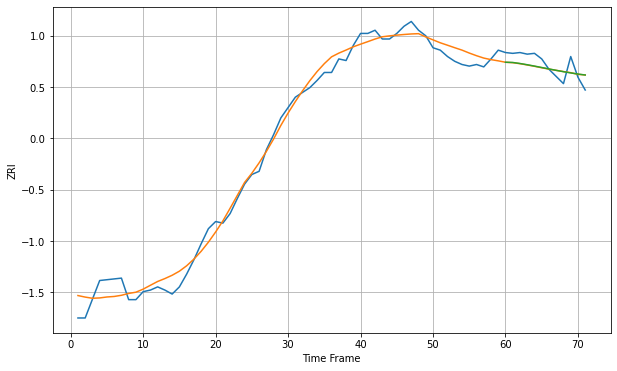

Wall time: 6.3 s
75081 12.528160883293975 13.298733328250483 13.205578550917842 [1284.82671116 1284.55861281 1283.2709287  1281.71072238 1280.01645751
 1278.23684846 1276.43264768 1274.66516508 1272.98775439 1271.44058143
 1270.0494714  1268.82762237]

Got an mse at 0.0093 in round 42 and stopped training

71 71 12


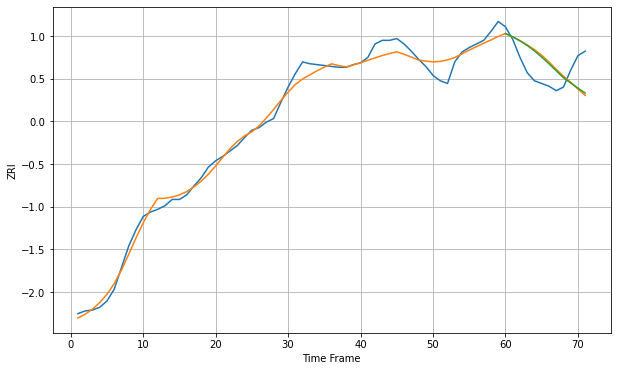

Wall time: 6.63 s
75093 8.892473744640414 27.35398114873222 26.127977669724416 [1402.59109215 1398.9133325  1394.45602107 1389.28173296 1383.19379837
 1376.35664519 1368.95754695 1361.16198791 1353.33085263 1347.57165846
 1341.85828799 1336.39242024]

Got an mse at 0.0099 in round 91 and stopped training

71 71 12


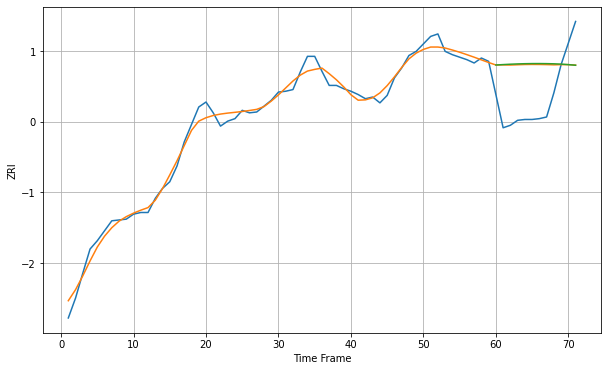

Wall time: 7.23 s
75201 8.411201134303424 56.48734504003839 57.235901029278764 [1673.58522938 1674.08356634 1674.53630918 1674.89268032 1675.14419973
 1675.28532099 1675.31326354 1675.22703699 1675.02611778 1674.65724484
 1674.02659658 1673.28131061]

Got an mse at 0.0099 in round 118 and stopped training

71 71 12


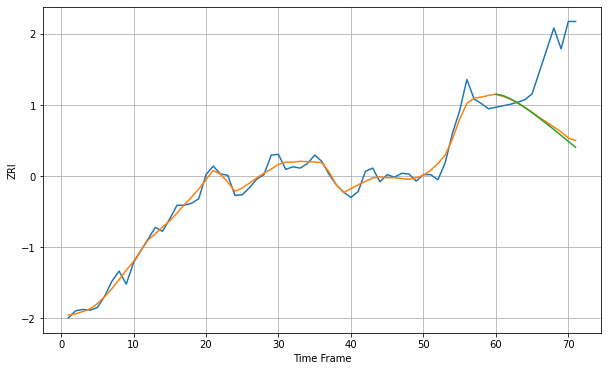

Wall time: 7.86 s
75202 10.841000029881966 101.43691970800712 105.1392358226726 [1627.38250246 1625.28022112 1620.44314329 1614.24633285 1606.9860034
 1599.01057336 1590.64050449 1582.04096083 1573.22849525 1564.18244497
 1554.97633299 1545.87070399]

Got an mse at 0.0094 in round 52 and stopped training

71 71 12


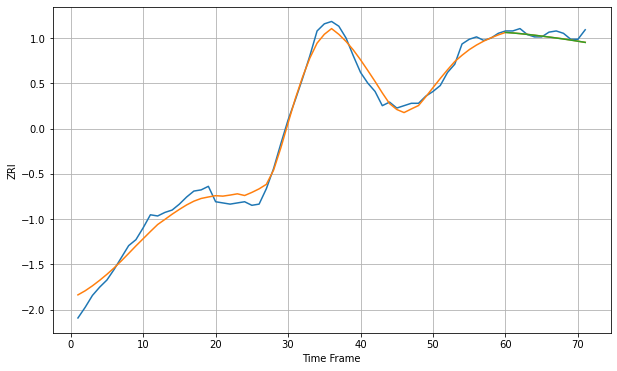

Wall time: 6.71 s
75204 7.136392045362044 4.2254910165150115 4.251915865261 [1508.76477575 1508.31064879 1507.74456154 1507.10200044 1506.40211158
 1505.65762316 1504.87459037 1504.05396128 1503.19389064 1502.29175896
 1501.34546917 1500.35405786]

Got an mse at 0.0100 in round 66 and stopped training

71 71 12


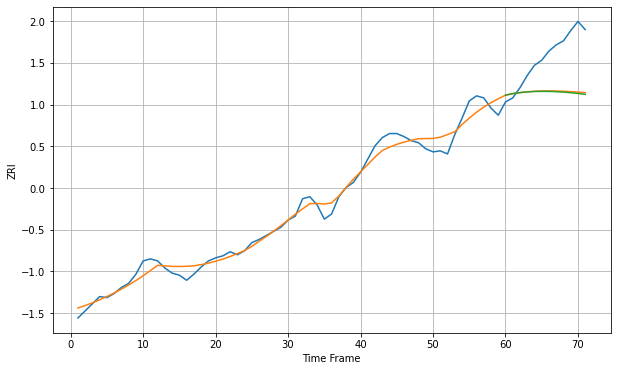

Wall time: 6.68 s
75206 8.142122520852014 40.98325037942261 41.727938540202786 [1388.67625322 1390.25078533 1391.21676455 1391.87466332 1392.2621867
 1392.41018961 1392.34555539 1392.09093837 1391.66472712 1391.08119027
 1390.35074025 1389.48027494]

Got an mse at 0.0099 in round 121 and stopped training

71 71 12


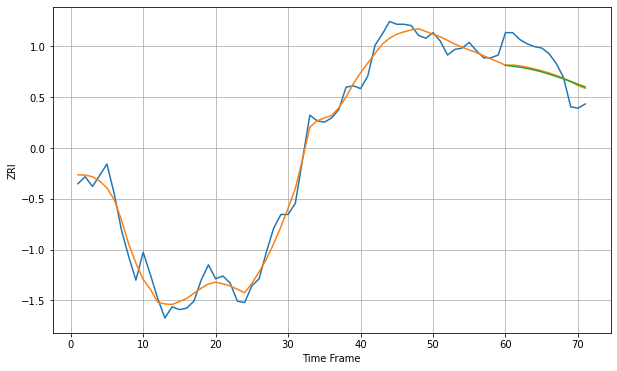

Wall time: 8.39 s
75214 7.236027781326779 16.37168578313412 16.972157299206696 [1211.66052017 1210.97526532 1210.30360438 1209.40354327 1208.27736075
 1206.94136866 1205.41840436 1203.73809195 1201.93576369 1200.04963208
 1198.11723467 1196.17275716]

Got an mse at 0.0098 in round 68 and stopped training

71 71 12


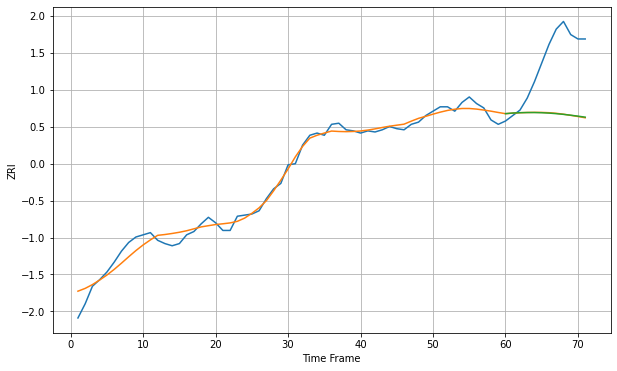

Wall time: 6.83 s
75219 6.653007677983404 54.5484047596393 54.557175456041165 [1451.72858831 1452.31271459 1452.61608857 1452.76954946 1452.7643239
 1452.59129116 1452.24710145 1451.73919091 1451.08797436 1450.32202491
 1449.46735773 1448.53839183]

Got an mse at 0.0099 in round 34 and stopped training

71 71 12


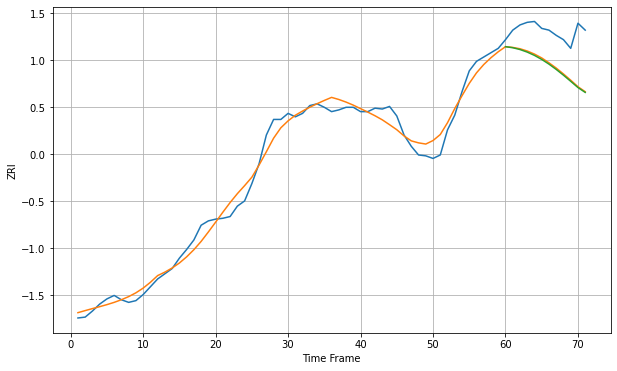

Wall time: 6.22 s
75235 10.595982670609581 41.896528356137374 42.962117243878495 [1450.91751521 1449.71262517 1447.62477854 1444.66083573 1440.8506314
 1436.20968921 1430.78985481 1424.68376552 1418.02509154 1410.9874062
 1403.78133916 1398.17691549]

Got an mse at 0.0092 in round 47 and stopped training

71 71 12


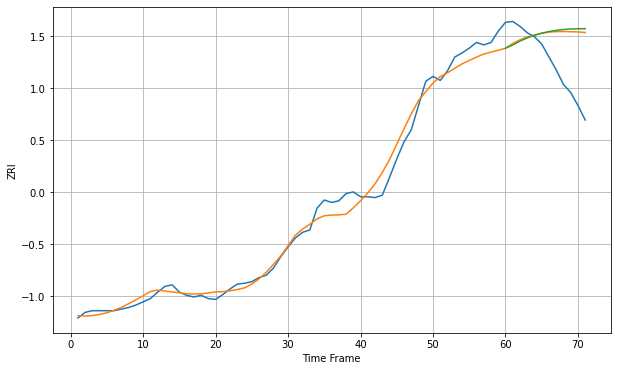

Wall time: 6.57 s
75243 11.348650051532923 54.35443372281121 56.614081126409324 [1137.82874416 1141.89085902 1146.66439794 1150.67534769 1153.93219498
 1156.52040862 1158.51891506 1159.99972685 1161.03050359 1161.67564056
 1161.99617958 1162.04907264]

Got an mse at 0.0094 in round 35 and stopped training

71 71 12


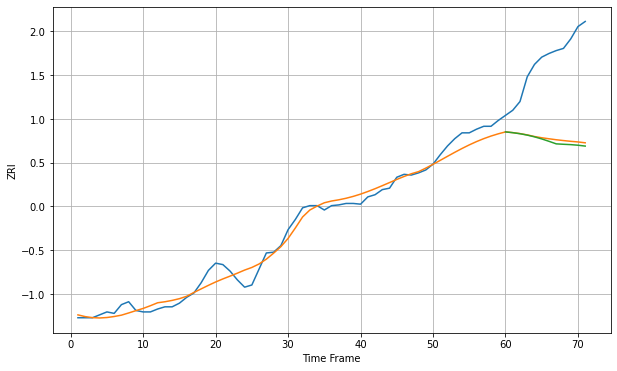

Wall time: 6 s
75244 11.28829178961918 111.53671332883738 114.61308948613951 [1361.29258358 1360.2139662  1358.78945517 1356.89783883 1354.50817939
 1351.64426328 1348.35610133 1344.86737228 1344.29388324 1343.80530338
 1342.99823001 1341.80813223]

Got an mse at 0.0099 in round 49 and stopped training

71 71 12


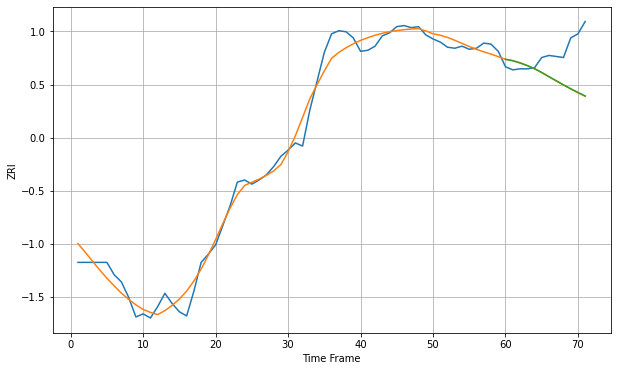

Wall time: 6.33 s
75248 10.159969229400698 33.03497336084468 32.91428762804877 [1270.25747911 1268.8481259  1266.73816707 1264.12478909 1261.11726521
 1257.39311084 1253.40670821 1249.39348174 1245.44826734 1241.6387865
 1238.01174879 1234.59919701]

Got an mse at 0.0099 in round 54 and stopped training

71 71 12


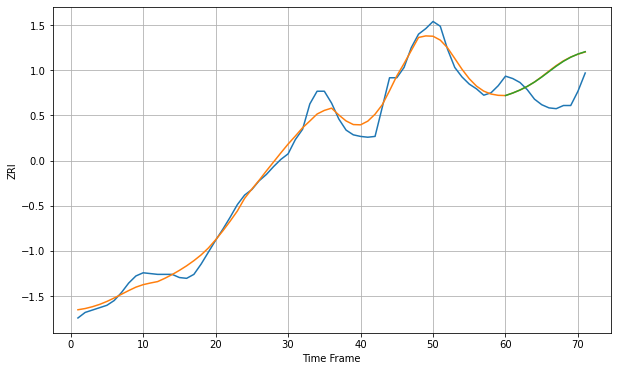

Wall time: 6.39 s
75287 11.166508275041425 38.37356723933285 38.11035534294988 [1143.55062607 1146.73414944 1150.55396908 1155.11754854 1160.56919487
 1166.88685681 1173.75396721 1180.58610554 1186.76978282 1191.91465374
 1195.91737614 1198.8676805 ]

Got an mse at 0.0099 in round 85 and stopped training

71 71 12


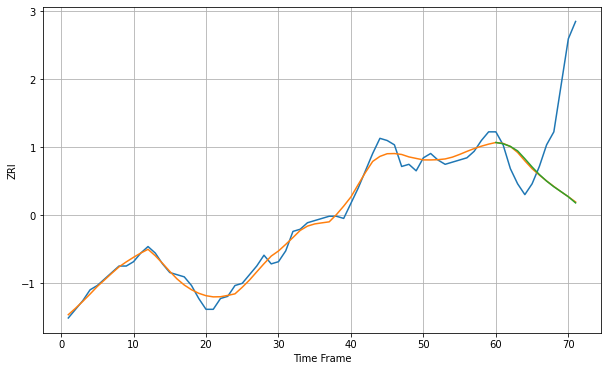

Wall time: 7.3 s
75703 3.1105395451123714 36.81459088622747 36.97274869184989 [904.07660429 903.49373796 902.26569628 900.18936167 896.56956845
 892.768965   889.2773629  886.25094905 883.63524036 881.34699655
 879.0120358  876.17102488]

Got an mse at 0.0099 in round 49 and stopped training

71 71 12


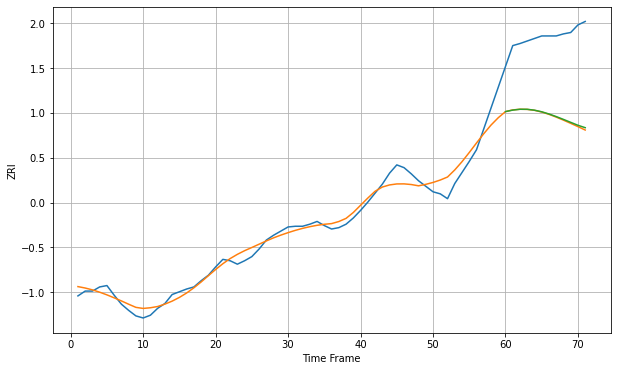

Wall time: 6.45 s
76006 12.70451194893624 115.93589642725557 114.96593934231849 [988.28067535 990.45880793 991.66337859 991.60303269 990.3462514
 988.023719   984.84028069 981.06643947 976.96010046 972.70085504
 968.4496506  964.96996488]

Got an mse at 0.0099 in round 64 and stopped training

71 71 12


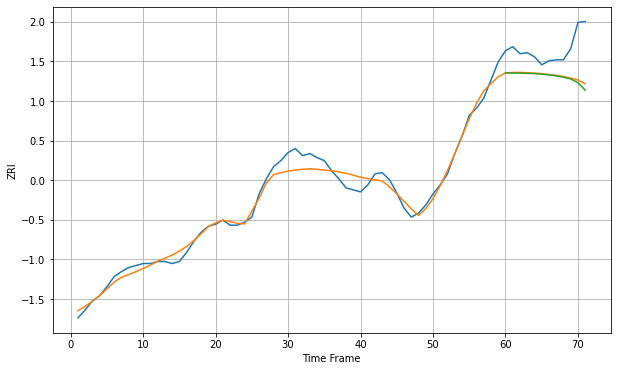

Wall time: 7.35 s
76010 7.753325785912494 30.052052720077402 31.835258119385674 [1070.04269545 1069.82086871 1069.76880014 1069.58890779 1069.26027205
 1068.75848435 1068.04517428 1067.06557622 1065.74749895 1064.002936
 1060.35958426 1052.88859797]

Got an mse at 0.0099 in round 219 and stopped training

71 71 12


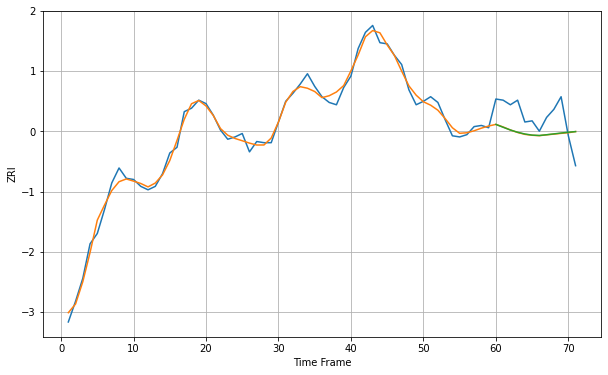

Wall time: 9.63 s
76012 5.192461183633072 20.794893030143754 20.721135412729474 [1205.91382758 1203.43115961 1201.05284957 1199.05867638 1197.56396037
 1196.58795022 1196.2705146  1196.91078277 1197.65888047 1198.40957397
 1199.08740623 1199.65142979]

Got an mse at 0.0098 in round 34 and stopped training

71 71 12


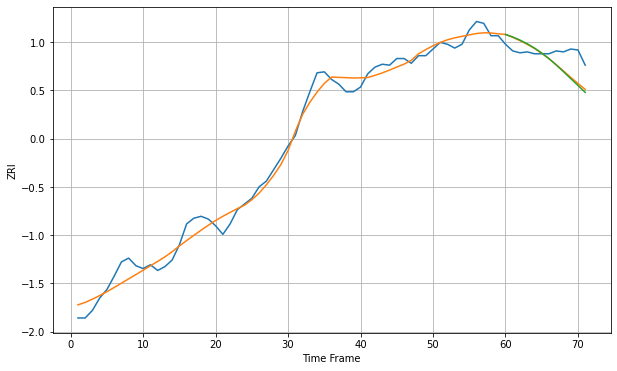

Wall time: 5.97 s
76015 9.97312441819244 18.233658865251176 19.290330244817934 [1290.3519754  1287.69432401 1284.39157406 1280.51328507 1275.99835413
 1270.78605593 1264.85078072 1258.25391721 1251.18389529 1243.91733601
 1236.69442458 1229.38536155]

Got an mse at 0.0094 in round 29 and stopped training

71 71 12


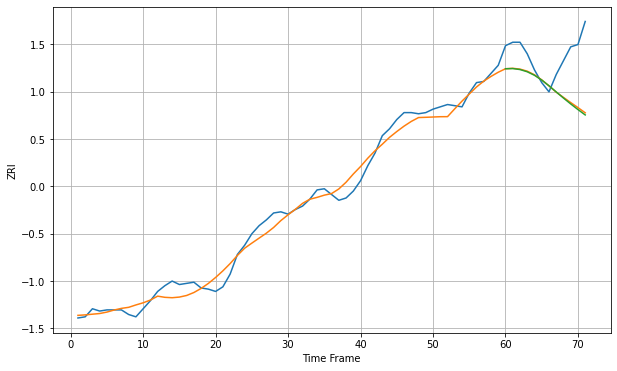

Wall time: 5.95 s
76017 7.559313977925401 34.83395118453702 35.63685716964593 [1054.01449605 1054.17911393 1053.33050642 1051.40145873 1048.34347746
 1044.20654398 1039.25485478 1033.92780951 1028.61960902 1023.51790277
 1018.64883464 1013.99199746]

Got an mse at 0.0095 in round 31 and stopped training

71 71 12


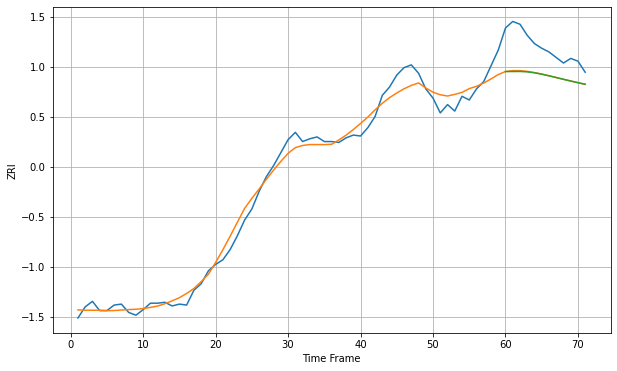

Wall time: 6.07 s
76039 10.303513493638633 33.697103968325614 34.011273997704194 [1252.80893906 1252.80068572 1252.8779314  1252.44645536 1251.42964521
 1249.92412184 1248.17150487 1246.29632737 1244.40061816 1242.54977733
 1240.76530591 1239.03138508]

Got an mse at 0.0099 in round 53 and stopped training

71 71 12


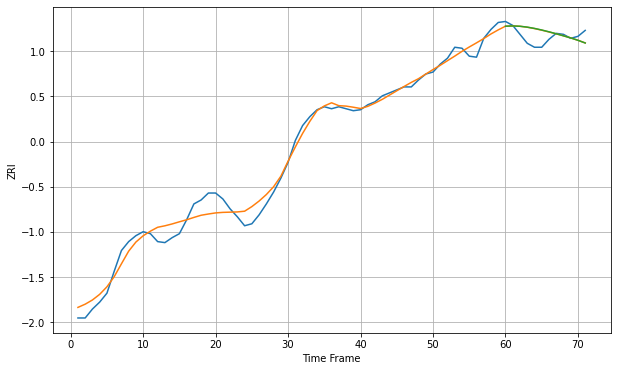

Wall time: 6.56 s
76051 8.944936006191302 10.142205571419629 10.232729841128732 [1402.24208875 1402.47013747 1402.1482327  1401.2904331  1400.00718251
 1398.40605663 1396.58026929 1394.60388965 1392.53163875 1390.40153352
 1388.02032748 1385.27999796]

Got an mse at 0.0100 in round 101 and stopped training

71 71 12


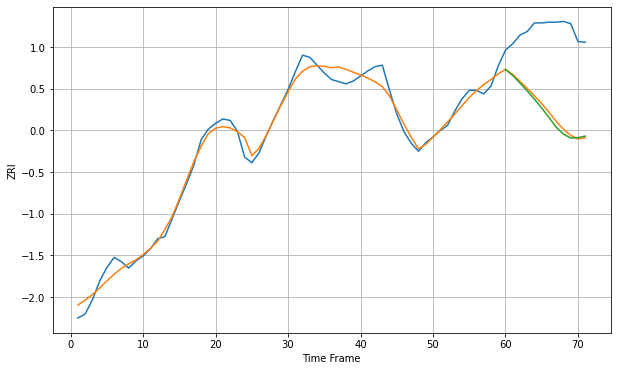

Wall time: 7.29 s
76107 11.4858297634459 113.29789870907187 116.85487133506126 [1306.17761046 1297.61270932 1287.10535291 1276.11488754 1264.57032584
 1252.24608581 1239.11210575 1225.45550273 1215.87151052 1210.37023932
 1211.00090912 1213.09853029]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


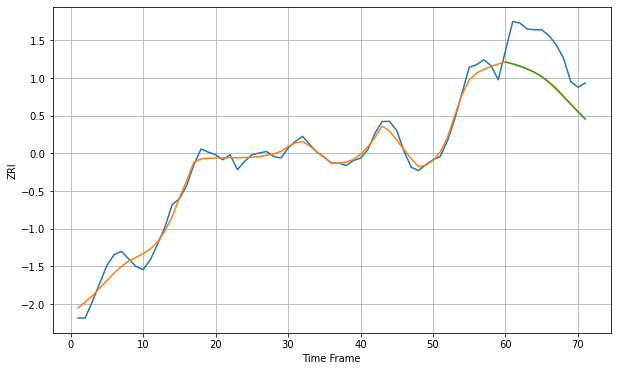

Wall time: 6.75 s
76108 8.898818523596157 45.78540719740235 45.59462976642803 [1141.34022313 1139.09052032 1136.33163871 1133.02332652 1128.95212837
 1123.82054912 1117.31377799 1109.33404305 1100.2736589  1090.85296446
 1081.60941302 1072.77550317]

Got an mse at 0.0098 in round 65 and stopped training

71 71 12


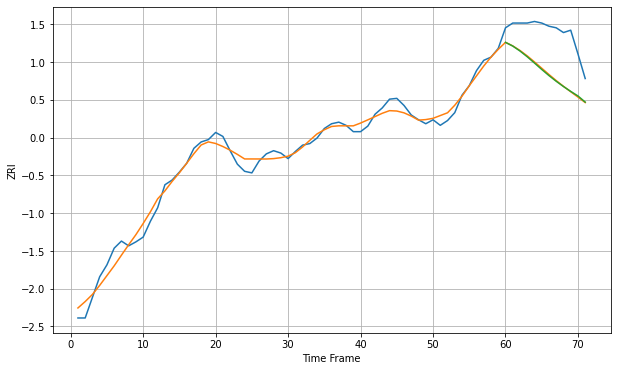

Wall time: 6.95 s
76116 9.337129216316603 52.10014394095372 52.53009262073834 [1186.65550309 1181.9824099  1175.72849082 1168.47765865 1160.56362668
 1152.487126   1144.73070532 1137.54492227 1130.93419428 1124.7968871
 1119.02490927 1111.30925116]

Got an mse at 0.0100 in round 88 and stopped training

71 71 12


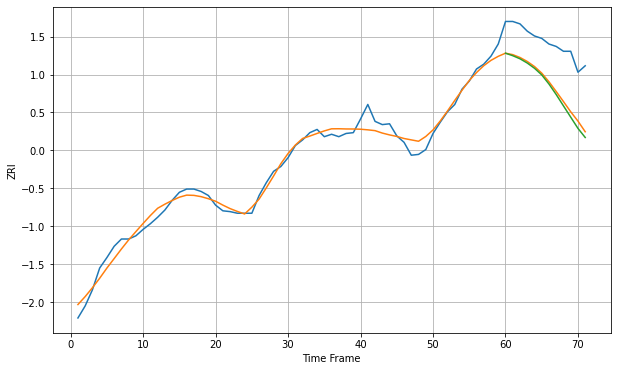

Wall time: 7.56 s
76132 9.318494544573557 53.96530270924095 58.122469723117966 [1285.61874879 1282.52494581 1278.67900805 1273.43450821 1266.9279763
 1258.70426469 1247.33288066 1234.27302627 1220.24246999 1206.25031636
 1192.30673242 1181.01315753]

Got an mse at 0.0100 in round 63 and stopped training

71 71 12


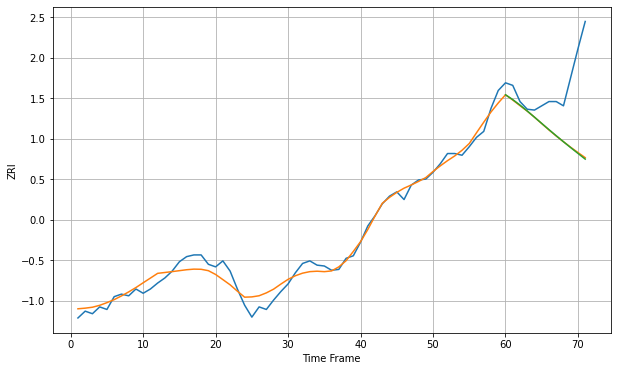

Wall time: 6.47 s
76133 9.386887124172576 66.26689913064608 66.7551100995263 [1052.94976878 1047.30509927 1040.86499501 1033.91406854 1026.67759261
 1019.33838985 1012.03539283 1004.85366122  997.82277621  990.9319301
  984.15317321  977.46036727]

Got an mse at 0.0093 in round 33 and stopped training

71 71 12


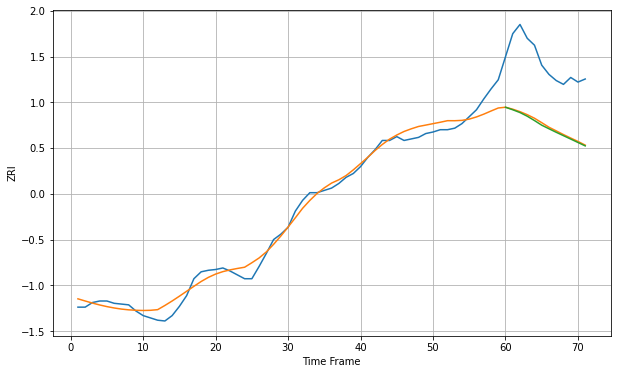

Wall time: 6.06 s
76137 11.037100476909218 83.8102775580166 85.39173425545555 [1240.24350924 1236.9496491  1233.33047283 1228.56575244 1222.89584048
 1216.88487774 1212.22248752 1207.62877813 1203.22995396 1198.82244959
 1194.36451246 1189.91883422]

Got an mse at 0.0100 in round 190 and stopped training

71 71 12


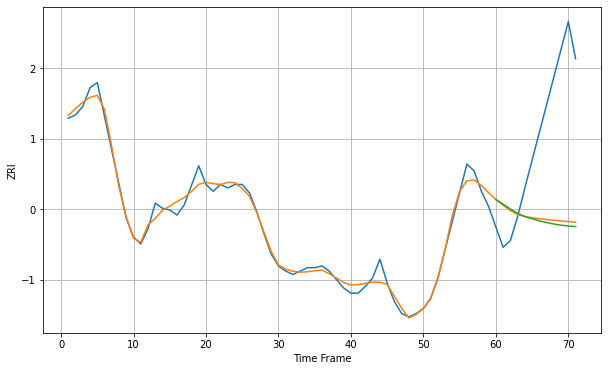

Wall time: 9.1 s
76522 4.118994273922687 64.7266755807651 66.3188840747161 [611.13579332 608.40031372 605.58393814 602.98445209 601.15068163
 599.78978292 598.60141196 597.57569815 596.71687522 596.03131979
 595.52658932 595.21096929]

Got an mse at 0.0100 in round 434 and stopped training

71 71 12


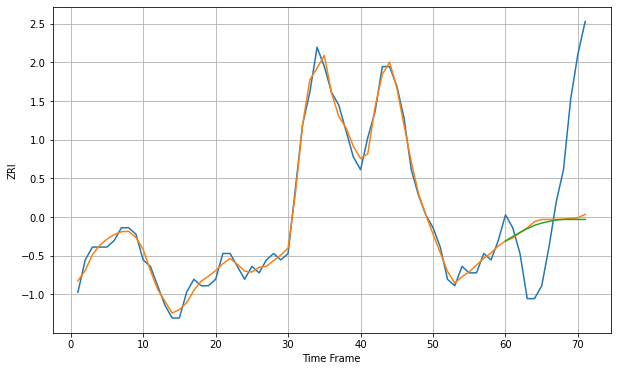

Wall time: 13.6 s
76543 1.1963176322385647 14.054465160253377 14.168097250051067 [589.9479675  590.63939873 591.27623954 591.86118105 592.3691879
 592.72079059 592.97454814 593.19436851 593.28344066 593.28344066
 593.28344066 593.28789418]

Got an mse at 0.0099 in round 145 and stopped training

71 71 12


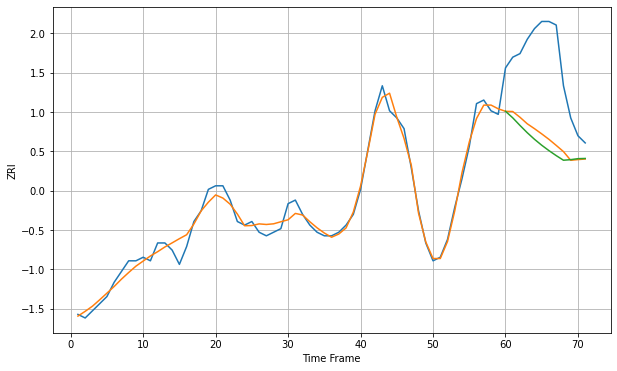

Wall time: 8.25 s
76549 2.184488130178113 21.983431578105712 24.080166908438443 [676.85475374 675.02512634 672.8917561  670.86504194 669.01701863
 667.34999838 665.83946514 664.44683736 663.15508342 663.31726938
 663.59523734 663.65040722]
71 71 12


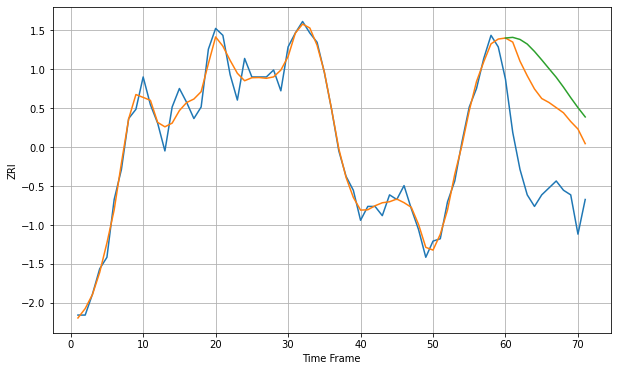

Wall time: 15.3 s
77004 4.6055529015027385 38.90039679836298 50.023764067130905 [1415.83411218 1416.12654431 1415.22452215 1413.22930668 1410.03019295
 1406.38286282 1402.59537875 1398.85249584 1394.59369416 1390.05517763
 1385.72878183 1381.70862777]

Got an mse at 0.0100 in round 264 and stopped training

71 71 12


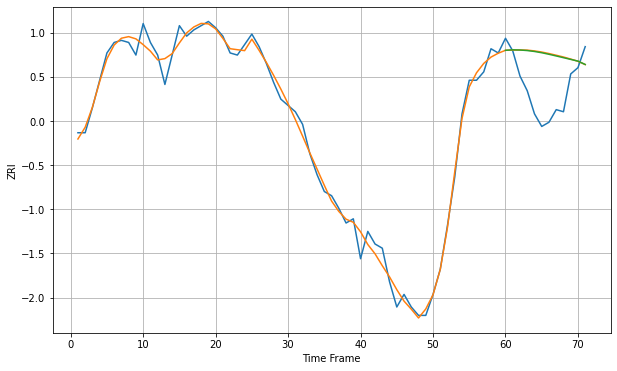

Wall time: 10.3 s
77006 4.1977034712072125 20.957028594599045 20.739805792908502 [1423.26449322 1423.49190904 1423.40228159 1423.14503711 1422.70650117
 1422.09903477 1421.36562363 1420.56590316 1419.74801871 1418.9306182
 1418.10624522 1416.51605409]
71 71 12


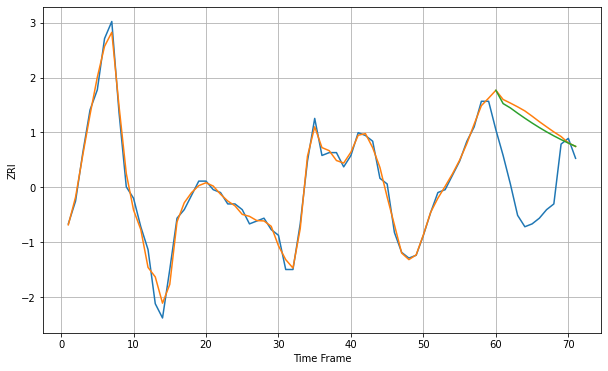

Wall time: 15.1 s
77007 2.6689189660189236 26.71290973195963 25.111486369059623 [1498.86312775 1494.19644211 1492.6768811  1490.82765292 1489.06914948
 1487.38226713 1485.78364251 1484.28046226 1482.87479948 1481.5642177
 1480.34324607 1479.20491066]
71 71 12


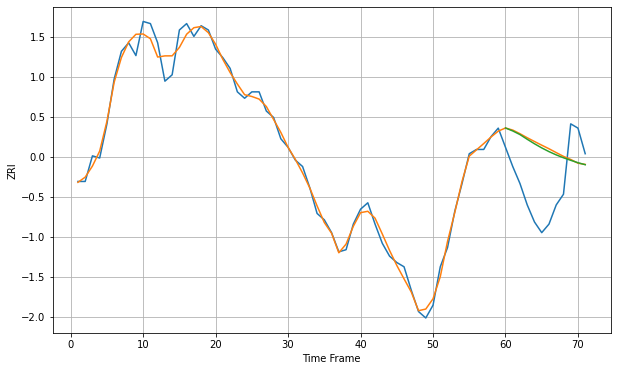

Wall time: 14.8 s
77019 3.801618567497501 25.424657047641652 24.725341152665777 [1414.06107788 1412.67783741 1410.97416627 1408.7654746  1406.66549931
 1404.72546187 1402.986032   1401.45164095 1400.10282677 1398.9121769
 1397.78208413 1396.85144359]
71 71 12


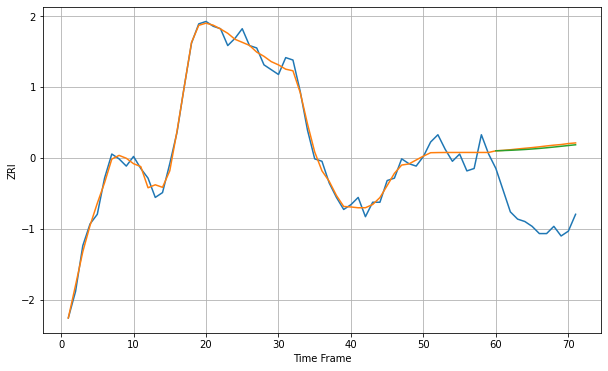

Wall time: 14.7 s
77027 3.206452144965735 30.576248153266388 29.99846099805469 [1439.34355235 1439.4335805  1439.5557454  1439.70188422 1439.87681804
 1440.0842433  1440.32540531 1440.59796509 1440.89576534 1441.20980851
 1441.53018661 1441.84076363]

Got an mse at 0.0099 in round 117 and stopped training

71 71 12


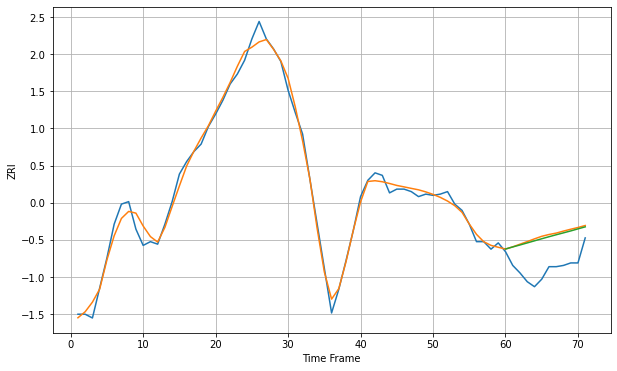

Wall time: 8.6 s
77042 5.877063219822393 26.106984953146423 24.91358889034292 [1166.11307364 1167.7778845  1169.34923605 1170.99880576 1172.66910589
 1174.32285812 1175.93921335 1177.51226581 1179.04346535 1180.57321393
 1182.22530735 1183.84063522]

Got an mse at 0.0099 in round 115 and stopped training

71 71 12


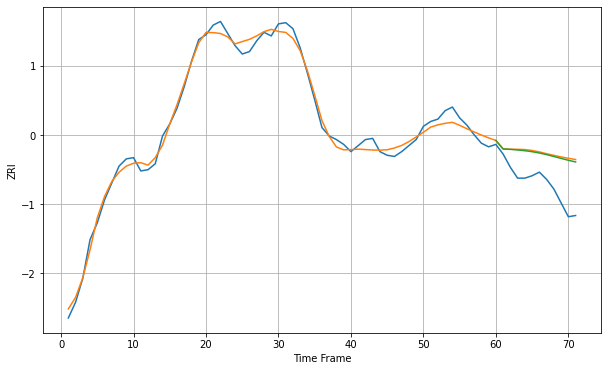

Wall time: 7.53 s
77054 5.666440159962027 27.84313359169685 26.84601164621861 [1257.28110931 1250.20762981 1249.88388543 1249.38835095 1248.77778356
 1247.96176226 1246.88141754 1245.53454956 1243.99312988 1242.38481376
 1240.84328597 1239.46219462]

Got an mse at 0.0100 in round 328 and stopped training

71 71 12


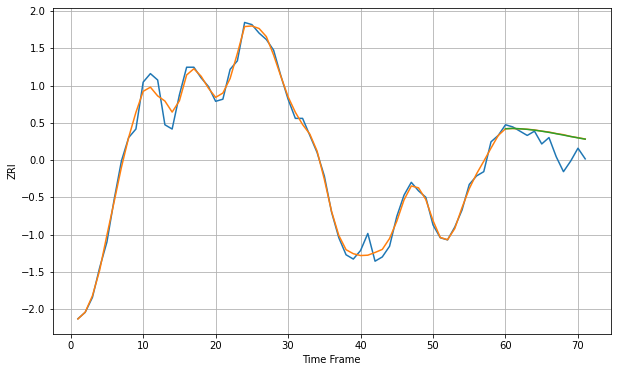

Wall time: 11.9 s
77056 3.472797119704821 7.745478233954208 7.6821968576108315 [1454.12923576 1454.33138592 1454.12774881 1453.85200623 1453.47245667
 1452.99379178 1452.43306049 1451.8135709  1451.15997927 1450.4972121
 1449.85209634 1449.25449913]

Got an mse at 0.0099 in round 406 and stopped training

71 71 12


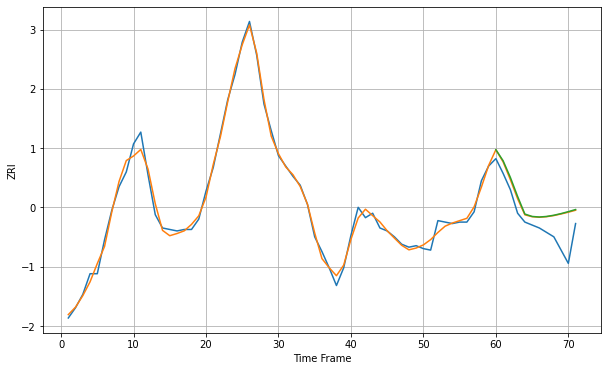

Wall time: 13.1 s
77057 3.991557602295937 14.596396439539397 14.98304731125424 [1446.06260895 1438.56879634 1427.29479276 1414.39377284 1402.44866844
 1400.82707968 1400.43601288 1400.82330761 1401.63786275 1402.76219892
 1404.08658368 1405.51400757]

Got an mse at 0.0099 in round 197 and stopped training

71 71 12


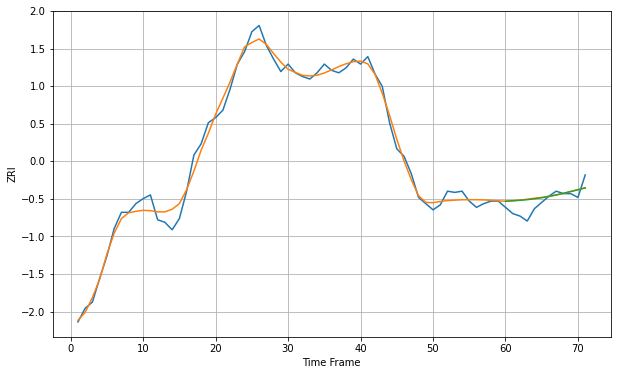

Wall time: 9.12 s
77063 5.996829317006939 8.393920745894357 8.266899724906574 [1266.91859333 1267.24323889 1267.65576057 1268.1929168  1268.87913252
 1269.73263473 1270.76137982 1271.95716194 1273.29059444 1274.71121756
 1276.1554652  1277.56032332]

Got an mse at 0.0099 in round 64 and stopped training

71 71 12


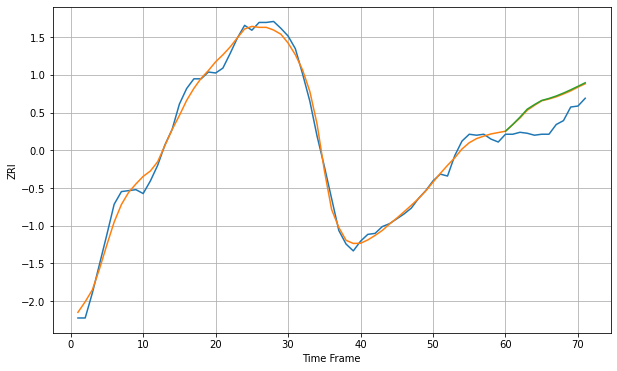

Wall time: 6.43 s
77077 7.647663552747391 23.754816583653188 24.44302720878974 [1193.10076741 1200.04846893 1207.59064718 1215.78857998 1220.50557542
 1224.76459104 1226.80843205 1229.34746228 1232.35571593 1235.71730727
 1239.2939575  1242.94690839]

Got an mse at 0.0099 in round 348 and stopped training

71 71 12


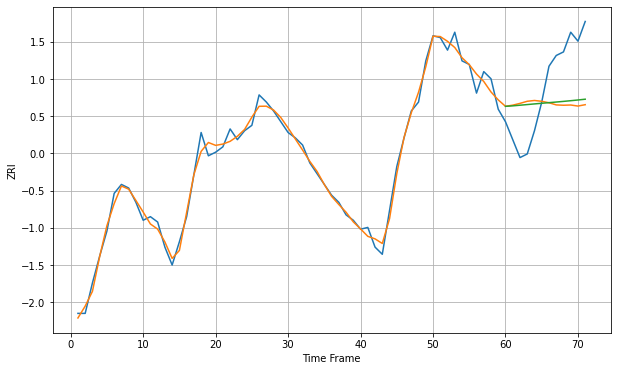

Wall time: 12 s
77090 4.137293369982486 28.433830954285114 26.69120712981528 [965.6159528  965.87843603 966.23357546 966.59881128 966.9612549
 967.31523364 967.6632538  968.01269826 968.37279764 968.7522763
 969.1578373  969.59342598]
71 71 12


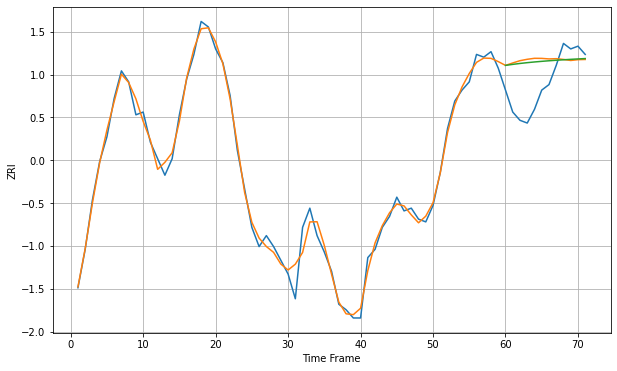

Wall time: 15.2 s
77098 3.106195519370691 13.113357484415097 12.434050841526554 [1501.00347394 1501.36890065 1501.70658597 1501.99585365 1502.24955942
 1502.47596744 1502.6812421  1502.86958469 1503.04351924 1503.20416293
 1503.35148287 1503.48452913]

Got an mse at 0.0100 in round 109 and stopped training

71 71 12


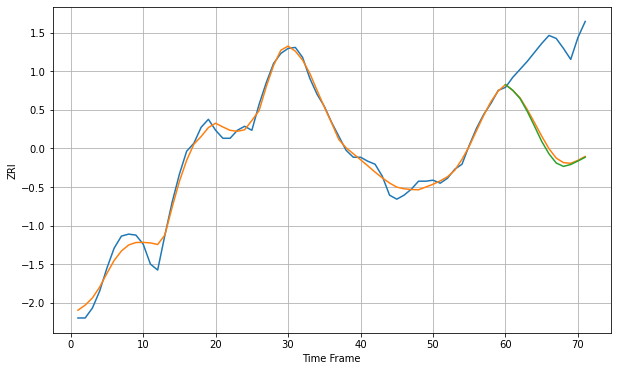

Wall time: 7.38 s
77380 7.653726088723234 91.95273037263414 94.47250866846329 [1419.76027029 1414.06757933 1405.91455931 1393.04370609 1378.14953117
 1362.84274071 1350.41909121 1341.22690834 1337.80792516 1339.7306021
 1343.25496435 1346.97847301]

Got an mse at 0.0099 in round 55 and stopped training

71 71 12


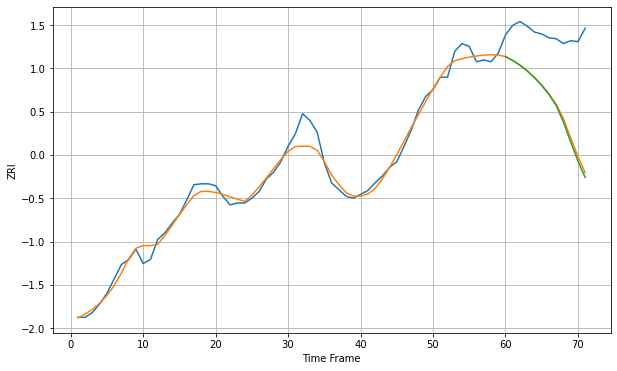

Wall time: 6.67 s
77429 8.925329168159553 77.7656381137634 80.12834053079906 [1208.48100383 1204.39776765 1199.38786424 1193.43226482 1186.45351154
 1178.32155646 1168.87088457 1157.44845176 1140.12112126 1119.50835713
 1099.61787268 1082.52814767]

Got an mse at 0.0100 in round 223 and stopped training

71 71 12


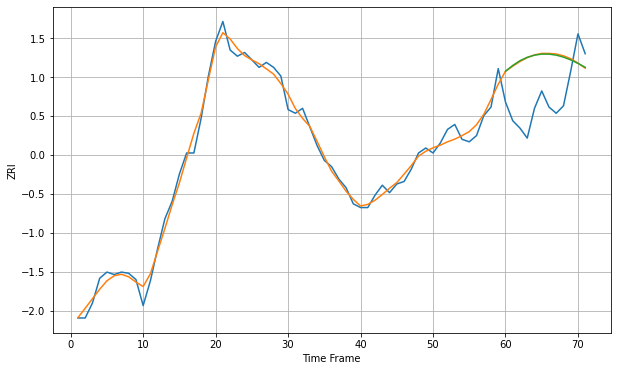

Wall time: 9.95 s
77494 6.21839192710447 39.76345374487168 39.624155135329076 [1279.86249812 1284.55654318 1288.3711566  1291.10231283 1292.84729872
 1293.68851688 1293.67908437 1292.85719844 1291.27103046 1289.00756279
 1286.21175144 1283.07801471]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


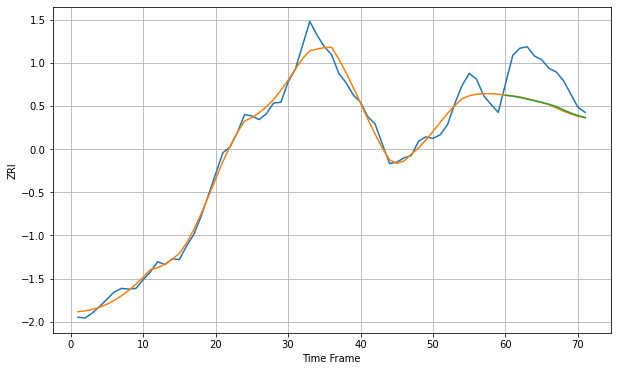

Wall time: 6.65 s
77550 11.877046095857631 48.539892383434214 48.31116013623578 [1163.70373479 1162.57201089 1160.67809599 1158.49544788 1156.13482966
 1153.67500913 1151.16632265 1148.10205015 1143.40522334 1139.14987777
 1135.54319033 1132.83762839]

Got an mse at 0.0099 in round 132 and stopped training

71 71 12


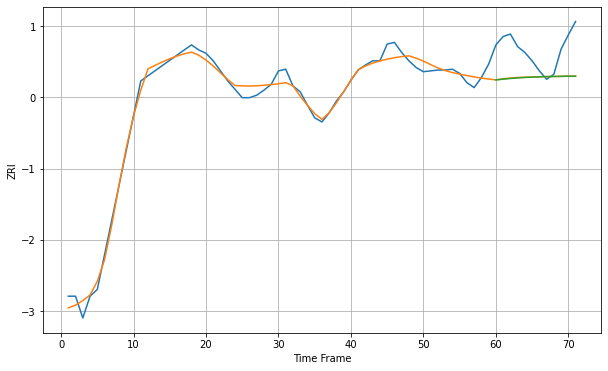

Wall time: 8.21 s
77584 8.431394928063437 38.11734922266755 38.38169302259706 [1399.24222111 1400.08324615 1400.93631173 1401.60135785 1402.1236673
 1402.53962917 1402.87253261 1403.13552032 1403.33483244 1403.4726112
 1403.54973868 1403.54150254]

Got an mse at 0.0099 in round 170 and stopped training

71 71 12


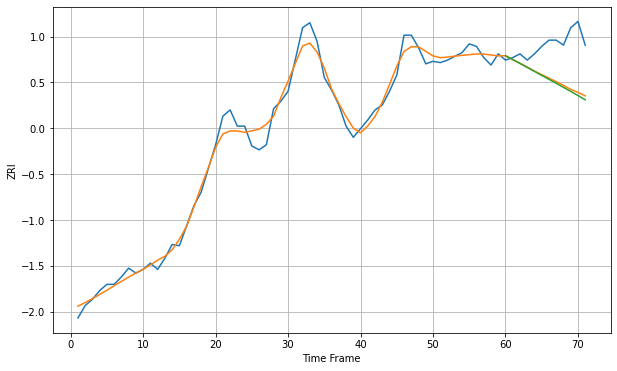

Wall time: 8.45 s
77598 7.289530920165688 30.609009241800706 31.960683847690795 [1124.47625572 1121.4822532  1118.31672061 1115.11361795 1111.91419267
 1108.73022101 1105.5546057  1102.3676828  1099.14494191 1095.8666752
 1092.5267636  1089.13882072]
71 71 12


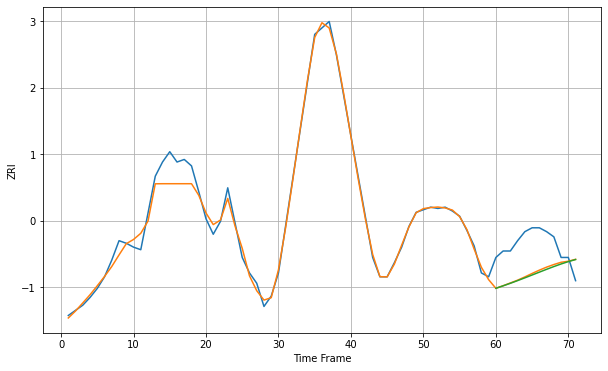

Wall time: 14.8 s
77840 6.567146407569236 25.702516100609987 26.429349569848174 [845.0708994  846.98811692 848.96854176 851.04228896 853.18896944
 855.38518643 857.60160716 859.80055389 861.93469475 863.94798366
 865.77997766 867.37368259]

Got an mse at 0.0100 in round 182 and stopped training

71 71 12


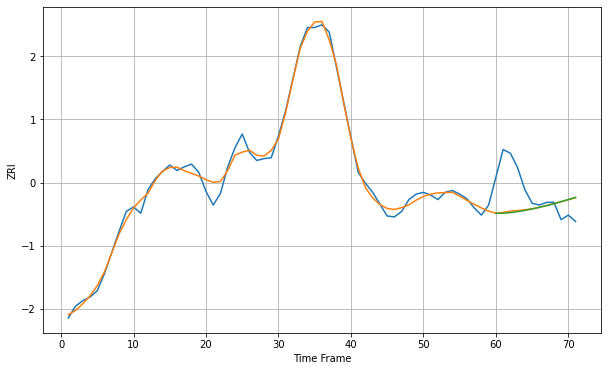

Wall time: 9.29 s
77845 6.899877024372775 34.754491387939034 35.36537119657961 [953.99161992 954.01799244 954.69382473 955.79224363 957.1672698
 958.74748168 960.50432022 962.42308493 964.50002453 966.7375455
 969.138267   971.3864522 ]

Got an mse at 0.0099 in round 121 and stopped training

71 71 12


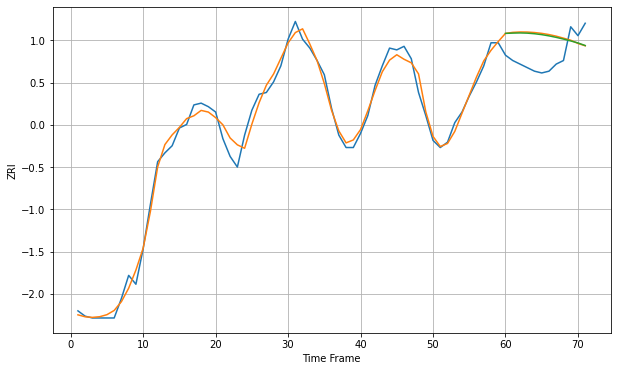

Wall time: 7.62 s
78130 4.684083901520107 16.25616286773283 15.786573395072121 [1158.28670189 1158.44261684 1158.54067358 1158.41973707 1158.09416071
 1157.57712115 1156.88730727 1156.04811575 1155.08599887 1154.02822863
 1152.90078486 1151.45243867]

Got an mse at 0.0100 in round 334 and stopped training

71 71 12


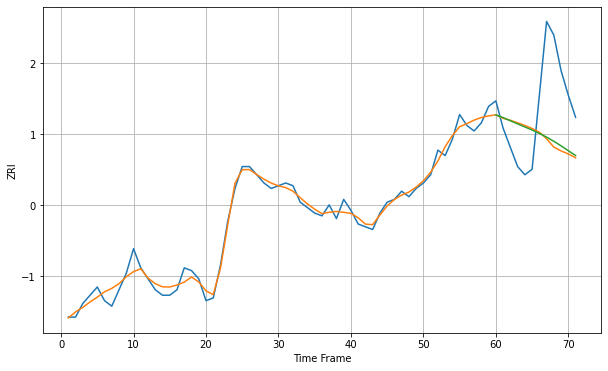

Wall time: 11.5 s
78201 2.5845685134350367 22.661423648785274 21.84963330477134 [886.87814837 885.88208484 884.72709089 883.58633038 882.47396997
 881.35530967 880.10625072 878.74640345 877.23142059 875.55737542
 873.78184555 872.02386418]

Got an mse at 0.0100 in round 115 and stopped training

71 71 12


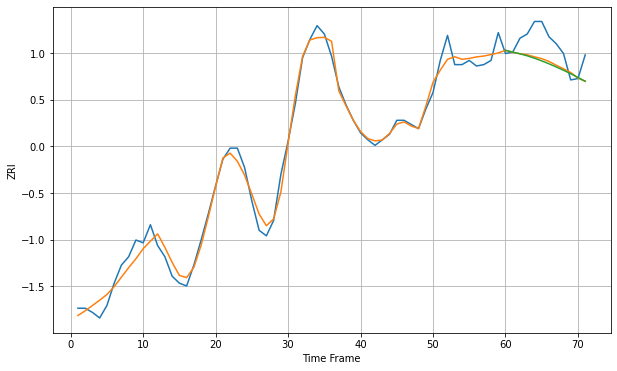

Wall time: 7.8 s
78209 6.635646495786655 15.203089013948944 15.947224112151932 [1254.29832932 1252.98080023 1251.77976486 1250.32784424 1248.62301089
 1246.69878783 1244.59202202 1242.33714575 1239.96603208 1237.47407077
 1234.73205979 1232.06377644]

Got an mse at 0.0099 in round 182 and stopped training

71 71 12


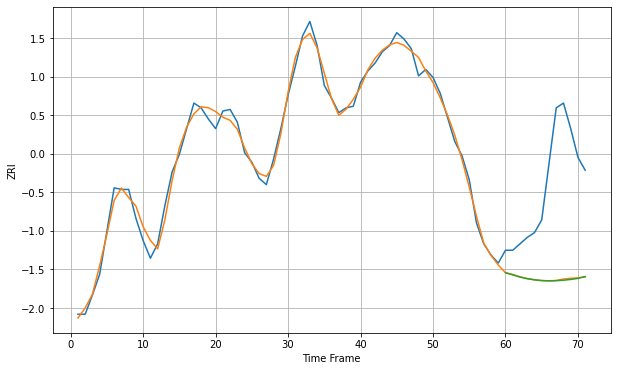

Wall time: 9 s
78210 4.7968380229713805 65.68845952266966 65.91749342774375 [923.93279314 922.57562049 921.21167723 920.19730599 919.48641196
 919.05337065 918.88348443 918.95966015 919.25713475 919.74489427
 920.39002203 921.56924107]

Got an mse at 0.0097 in round 94 and stopped training

71 71 12


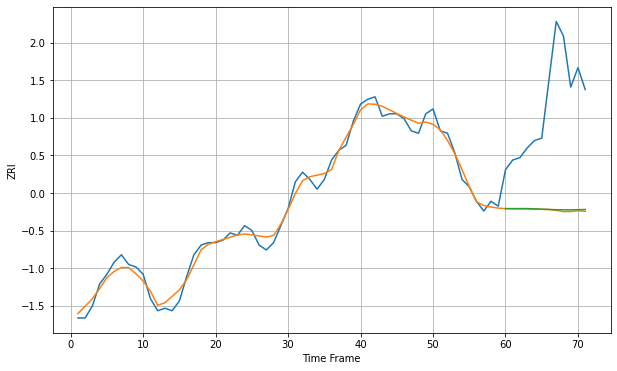

Wall time: 6.96 s
78212 3.0127059778621126 46.638334233408706 46.301314637393666 [892.989592   892.99582381 893.00837843 893.02011007 892.89958917
 892.75966631 892.63738992 892.54871589 892.50395785 892.50652662
 892.55382064 892.63941864]
71 71 12


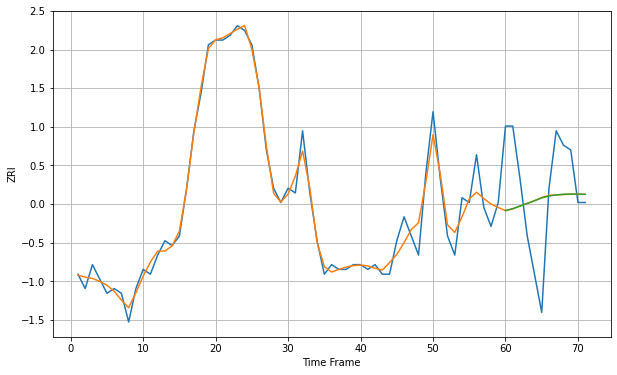

Wall time: 14.9 s
78213 2.4062183451403127 12.546613718853605 12.518585388737542 [921.31135199 921.7233672  922.25002751 922.8035887  923.36914082
 923.96131106 924.35098724 924.58963138 924.71872939 924.76800659
 924.75905418 924.7081579 ]

Got an mse at 0.0099 in round 111 and stopped training

71 71 12


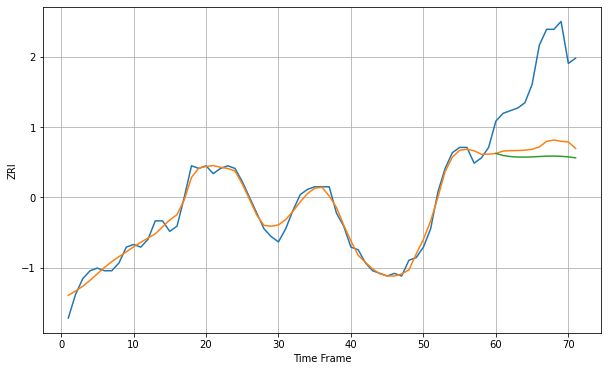

Wall time: 7.39 s
78216 2.657883429031179 30.359609786510937 34.25262952854452 [972.70259698 971.92203583 971.51255461 971.31901339 971.29598236
 971.39127713 971.53646152 971.65901559 971.69835611 971.615342
 971.39190522 971.02467375]

Got an mse at 0.0087 in round 415 and stopped training

71 71 12


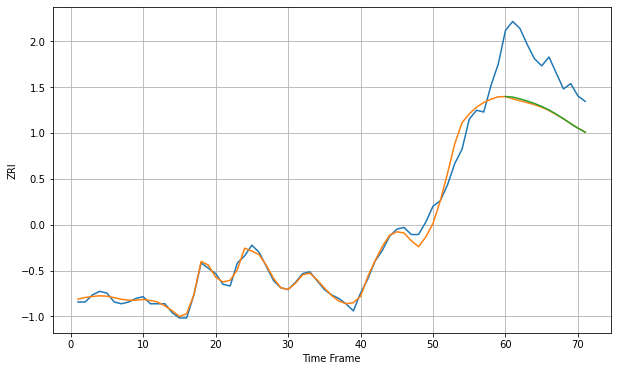

Wall time: 13.4 s
78229 4.54455506256177 29.004754890265215 28.565158395816685 [1025.71684283 1025.41133364 1024.39792539 1023.20161334 1021.79610845
 1020.15362315 1018.16412477 1015.81575345 1013.19497043 1010.44990031
 1007.83715269 1005.60337931]

Got an mse at 0.0100 in round 281 and stopped training

71 71 12


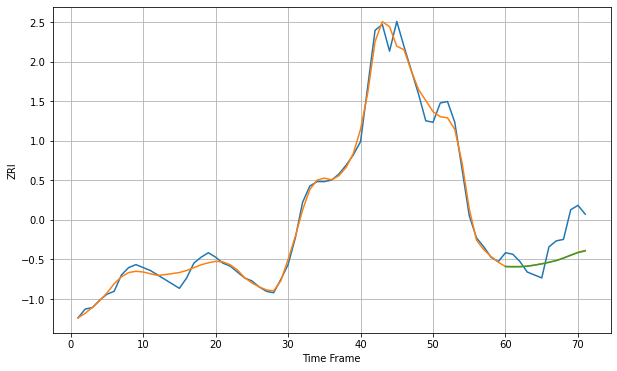

Wall time: 11 s
78233 5.305745330176867 16.57159223574844 16.689592537371837 [947.69580356 947.48429486 947.56124016 947.92145286 948.62603668
 949.48808253 950.51801716 951.70750971 953.39616957 955.30192975
 957.07417297 958.19586734]

Got an mse at 0.0100 in round 60 and stopped training

71 71 12


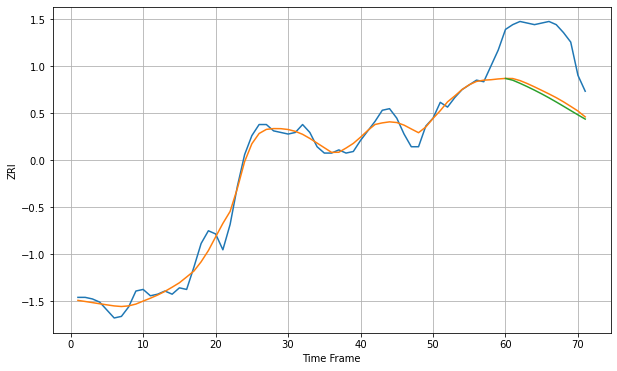

Wall time: 6.59 s
78240 5.866806616341114 37.44444317736817 39.443320920721696 [1082.07685426 1080.95287124 1079.00730635 1076.90054831 1074.67232872
 1072.31877231 1069.83510189 1067.23093361 1064.53774758 1061.80504213
 1059.08793122 1056.43457377]

Got an mse at 0.0094 in round 34 and stopped training

71 71 12


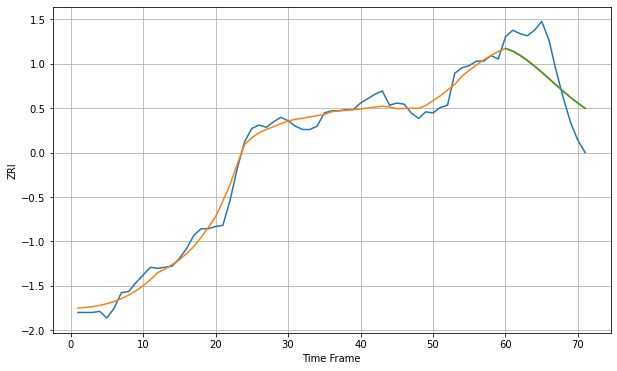

Wall time: 6.38 s
78249 7.613936553877012 27.55609490482197 27.84404986806195 [1142.55153257 1140.0110312  1136.16378694 1131.54914427 1126.35929403
 1120.75935045 1114.94919198 1109.11570465 1103.42066577 1097.99050378
 1092.91041026 1088.22864618]

Got an mse at 0.0100 in round 114 and stopped training

71 71 12


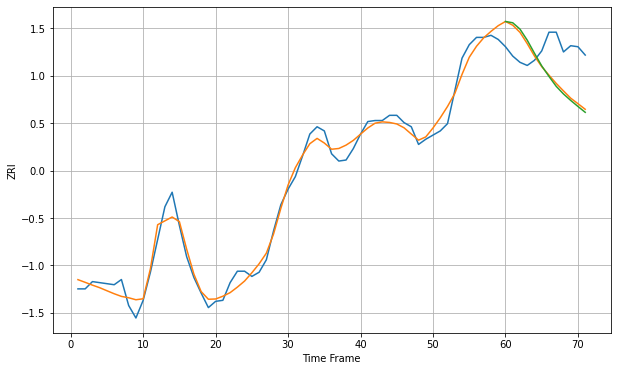

Wall time: 7.56 s
78256 9.077344572675313 37.428918585501215 39.533054177410826 [1258.32356209 1257.04668144 1250.94652477 1240.30930502 1227.69162199
 1215.53832431 1205.452897   1195.89800063 1188.56867723 1182.33921113
 1176.53218324 1170.90909728]

Got an mse at 0.0100 in round 119 and stopped training

71 71 12


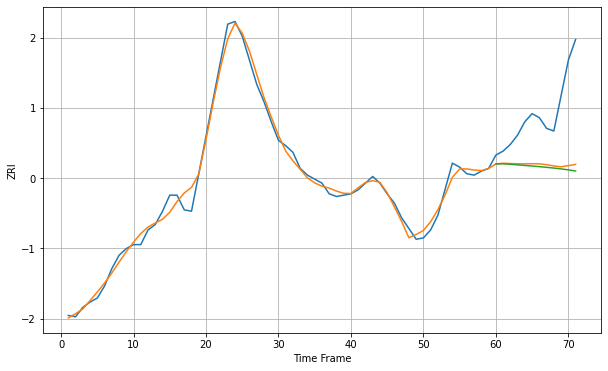

Wall time: 7.6 s
78521 5.214990277686453 44.35963386181062 46.41131575500291 [755.35676634 755.50061194 755.11709806 754.69269475 754.25668264
 753.80756866 753.33838997 752.83766275 752.2885715  751.66807308
 750.94658593 750.08901542]

Got an mse at 0.0096 in round 71 and stopped training

71 71 12


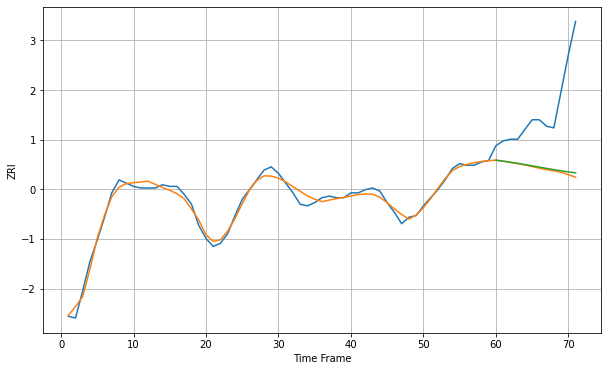

Wall time: 6.65 s
78550 2.9646314652828023 42.211565446803995 41.19918055904889 [768.13291409 767.54409262 766.89354181 766.18548585 765.43231244
 764.64964101 763.85507785 763.06734296 762.30555655 761.58793895
 760.92969223 760.34060799]

Got an mse at 0.0099 in round 189 and stopped training

71 71 12


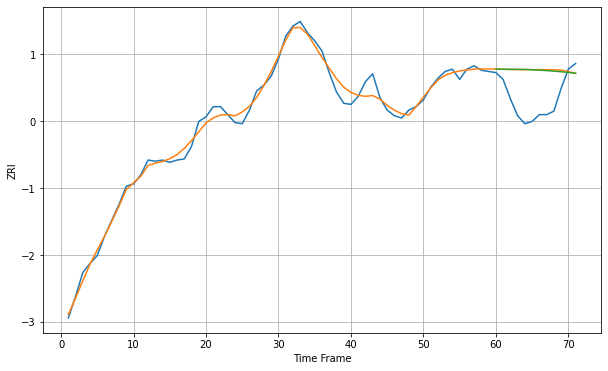

Wall time: 9.04 s
78613 5.850715318267991 31.01914264340998 30.760245175553045 [1301.061704   1300.93332626 1300.84576606 1300.80225052 1300.77604289
 1300.49778005 1300.15564856 1299.75655917 1299.28866185 1298.74549191
 1298.1246183  1297.4276249 ]

Got an mse at 0.0099 in round 74 and stopped training

71 71 12


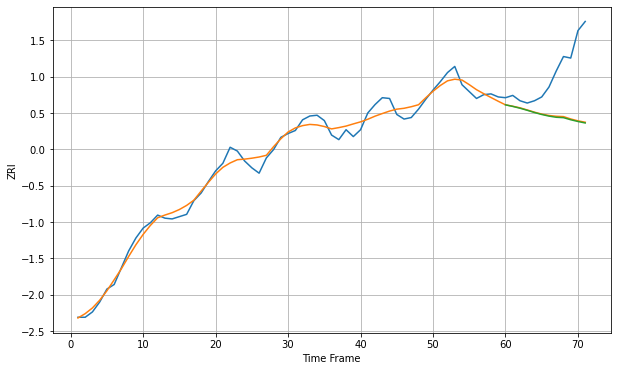

Wall time: 6.67 s
78660 9.431876415851605 64.6566819279621 65.38752158942695 [1277.63819146 1275.56296727 1273.21524549 1270.49636153 1267.54872039
 1264.99032577 1262.85804765 1261.32614998 1260.8299271  1258.06996049
 1255.78741207 1253.84092574]

Got an mse at 0.0099 in round 93 and stopped training

71 71 12


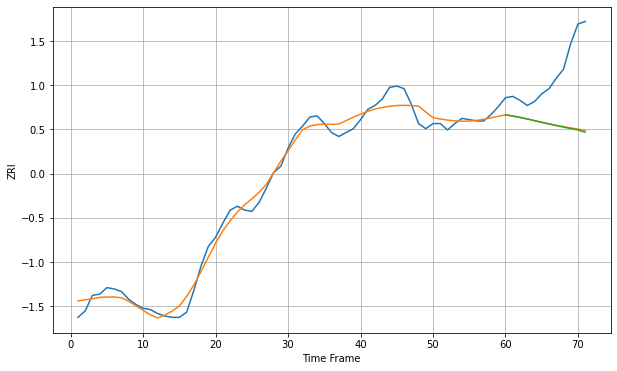

Wall time: 7.41 s
78664 6.7878725293589435 44.16311502536517 44.61574083961365 [1160.75142912 1159.86814132 1158.76871547 1157.53897085 1156.24471603
 1154.94092649 1153.66572303 1152.43824242 1151.26125931 1150.12644283
 1149.01973133 1147.28020461]

Got an mse at 0.0098 in round 61 and stopped training

71 71 12


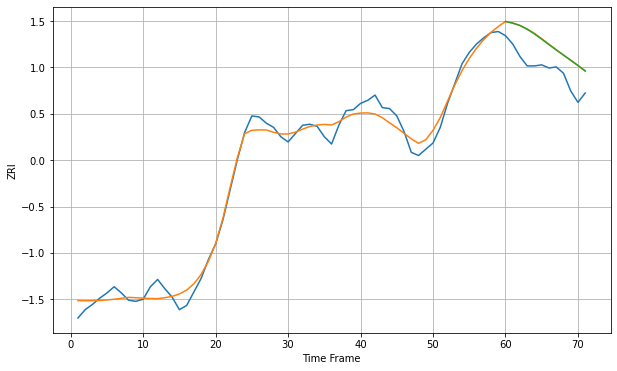

Wall time: 6.42 s
78666 8.680831669151326 25.78670668550705 25.67854604665538 [1159.6655271  1158.04838987 1155.73757755 1152.13929251 1147.69176384
 1142.66962533 1137.46508145 1132.35334375 1127.38754137 1122.47160537
 1117.47231498 1112.28382003]

Got an mse at 0.0099 in round 116 and stopped training

71 71 12


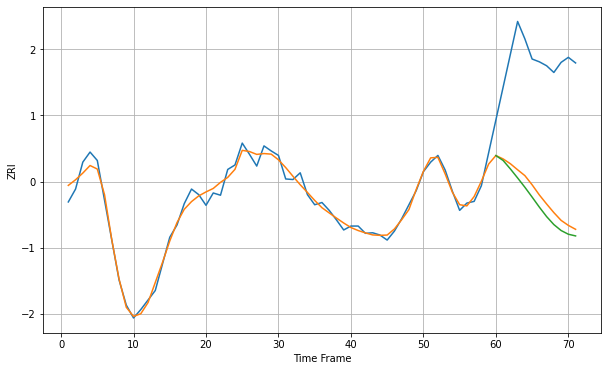

Wall time: 7.96 s
78701 11.67765559555607 237.26791723319067 253.26056574394676 [2160.78652427 2152.00355046 2136.93525163 2120.81261549 2104.25626417
 2086.69247689 2068.76168638 2051.89955468 2037.64483357 2027.04916824
 2020.41519829 2017.395931  ]

Got an mse at 0.0099 in round 92 and stopped training

71 71 12


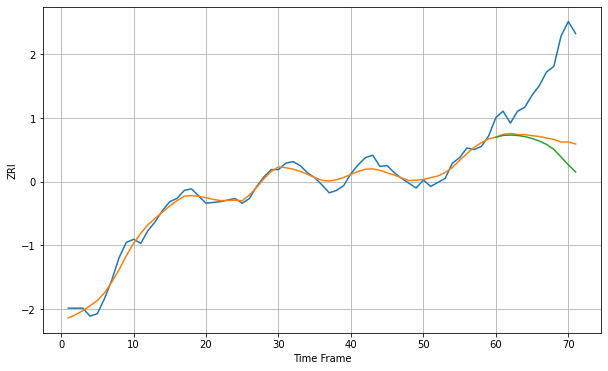

Wall time: 6.91 s
78702 7.8518868115085 83.99703582456901 98.11927536221829 [1605.45059005 1607.74298773 1608.15728157 1607.62077778 1606.23112146
 1603.92887995 1600.65872137 1596.4380107  1590.21809779 1580.79090429
 1570.99392635 1562.07235305]

Got an mse at 0.0098 in round 52 and stopped training

71 71 12


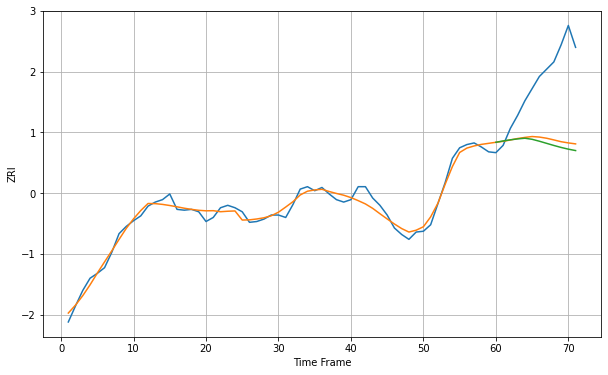

Wall time: 6.21 s
78703 7.337931498900805 80.80487430388105 85.74427262318544 [1825.80271445 1827.45849389 1828.84672654 1829.96607155 1830.81258106
 1829.49268165 1827.12455703 1824.5001674  1821.87750282 1819.4437923
 1817.32518832 1815.5837329 ]

Got an mse at 0.0100 in round 180 and stopped training

71 71 12


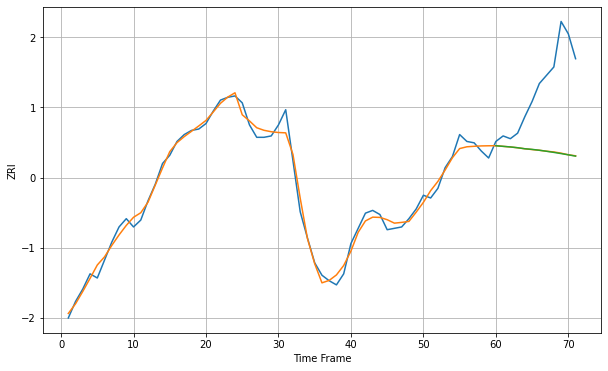

Wall time: 8.58 s
78704 5.0537868258084995 52.36904999669142 52.47165642720785 [1528.89871908 1528.44432063 1528.0197588  1527.44391239 1526.70153006
 1526.23758481 1525.63005935 1524.8758275  1524.06408692 1523.2026175
 1522.29733931 1521.35388224]

Got an mse at 0.0099 in round 91 and stopped training

71 71 12


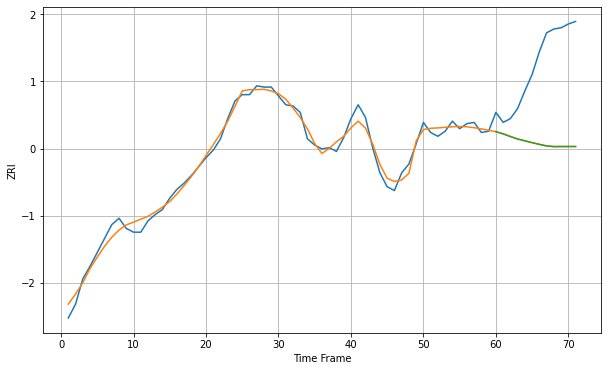

Wall time: 7.03 s
78705 5.246694962415356 68.14325124755977 68.2316255661951 [1525.65485132 1523.94973989 1521.82542337 1519.8748593  1518.39755868
 1516.95488182 1515.58672198 1514.3232701  1513.72027621 1513.82573546
 1513.83220731 1513.8324521 ]

Got an mse at 0.0097 in round 41 and stopped training

71 71 12


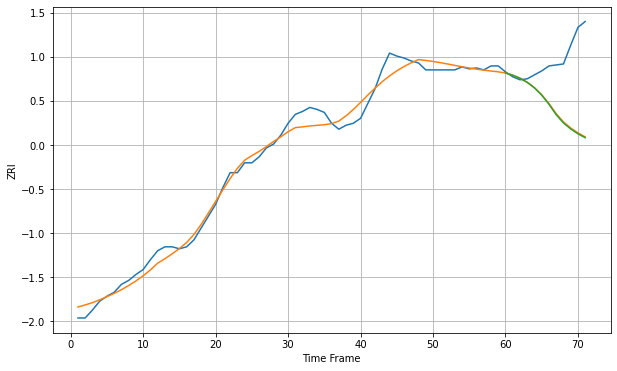

Wall time: 6.03 s
78728 8.72644424130407 57.831673567018186 58.46433252542891 [1222.88716355 1220.59772157 1217.57131879 1213.43520207 1207.83951121
 1200.45157431 1191.19318796 1180.58184633 1172.31834658 1166.26501139
 1161.28824047 1157.39708148]

Got an mse at 0.0100 in round 73 and stopped training

71 71 12


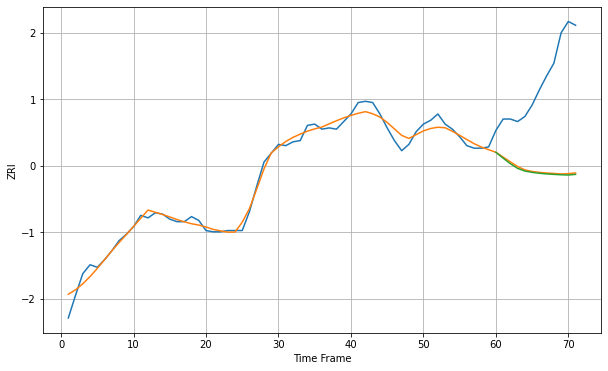

Wall time: 6.69 s
78729 5.212912471870703 74.26767119325407 75.04483885798318 [1202.75373478 1198.13561884 1193.76162779 1190.07199714 1187.96339225
 1186.92967314 1186.21525015 1185.70360677 1185.32247453 1185.03147625
 1184.82866494 1185.32458214]

Got an mse at 0.0099 in round 65 and stopped training

71 71 12


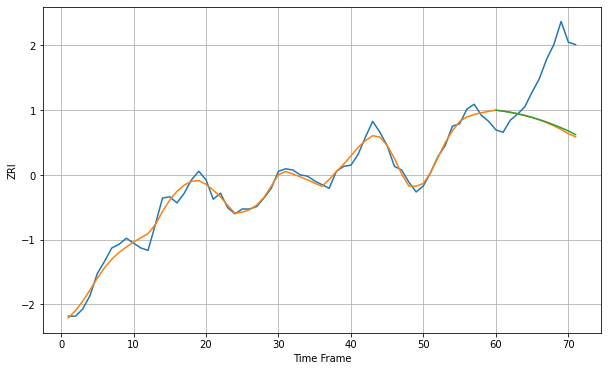

Wall time: 6.8 s
78735 5.264596047119242 48.84504306064855 47.970915962228716 [1544.1708169  1543.34225112 1542.37007291 1541.19397208 1539.8067513
 1538.20618555 1536.39411045 1534.37437977 1532.15072626 1529.72532927
 1527.09850493 1524.07211702]

Got an mse at 0.0100 in round 215 and stopped training

71 71 12


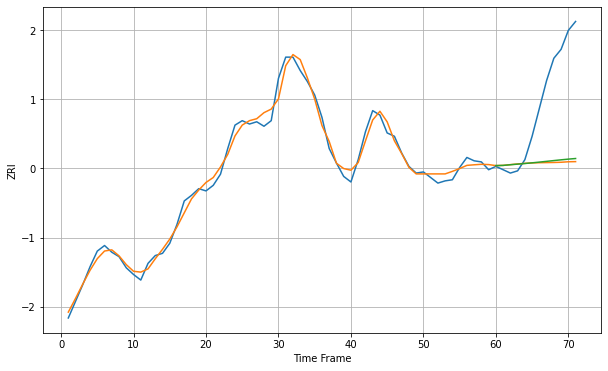

Wall time: 9.25 s
78741 6.182970422550524 69.03784684284781 67.68170087372259 [1279.70955334 1279.86886689 1280.46462048 1281.00739656 1281.56873577
 1282.17612727 1282.82901529 1283.51178355 1284.20258975 1284.87595419
 1285.5029405  1286.05194954]

Got an mse at 0.0099 in round 70 and stopped training

71 71 12


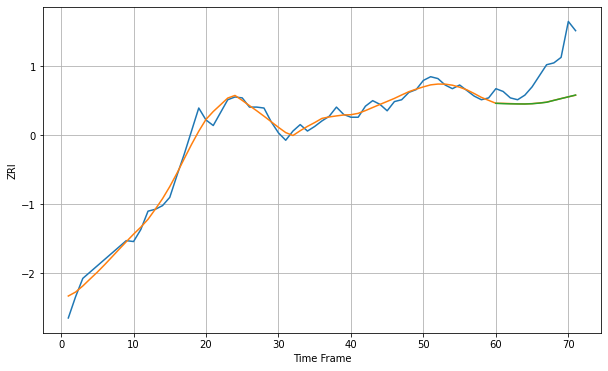

Wall time: 6.58 s
78744 7.398988846079928 39.46336165911703 39.47638761562608 [1267.13366562 1266.73681076 1266.54817537 1266.42622657 1266.37430266
 1266.67249515 1267.33188527 1268.28036108 1270.28157302 1272.24825366
 1274.14564994 1276.123375  ]

Got an mse at 0.0100 in round 61 and stopped training

71 71 12


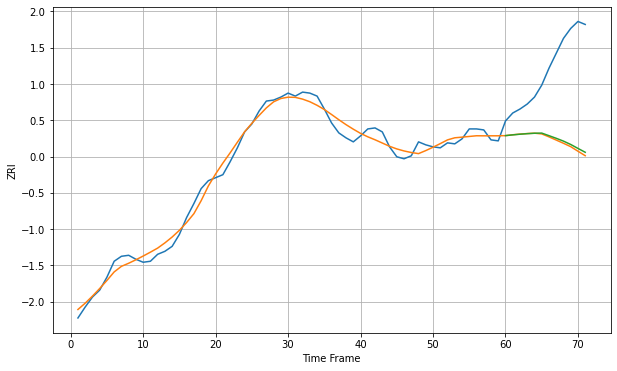

Wall time: 6.54 s
78745 7.211026923477856 80.59025375148398 78.95571404662819 [1269.2614892  1270.01482401 1270.67821141 1271.23514528 1271.64373199
 1271.8249004  1269.22145264 1266.58139387 1263.74782144 1260.36881219
 1256.40784679 1252.53267326]

Got an mse at 0.0099 in round 75 and stopped training

71 71 12


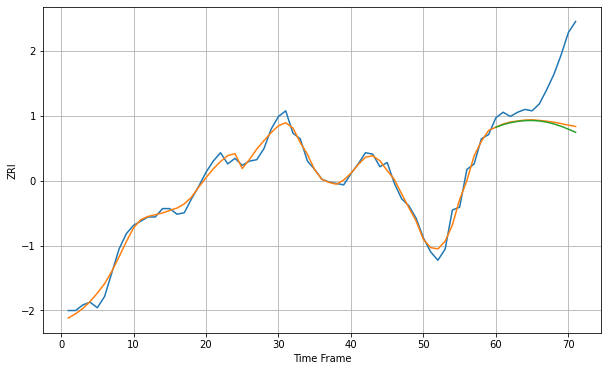

Wall time: 6.8 s
78746 4.583247725532512 34.80443746991401 36.41834923413924 [1548.26041168 1550.14207655 1551.49333217 1552.45290412 1552.99958888
 1553.10788284 1552.75649262 1551.93342648 1550.64697446 1548.9389027
 1546.89083103 1544.61569991]

Got an mse at 0.0100 in round 146 and stopped training

71 71 12


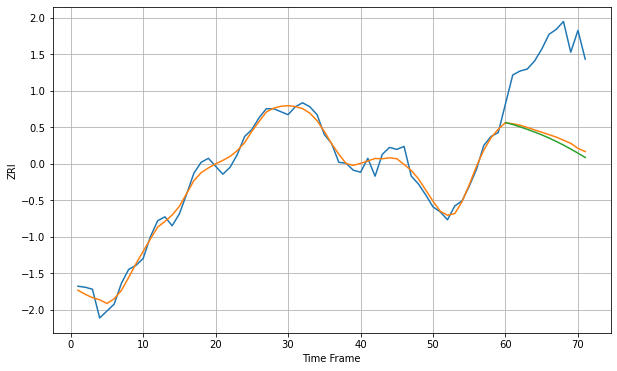

Wall time: 8.11 s
78748 7.321977409962647 85.96877770511266 89.51873726962216 [1322.99024447 1321.13393061 1318.75421045 1316.23534499 1313.54777243
 1310.64510661 1307.48826794 1304.05671178 1300.35364134 1296.4001216
 1292.22083107 1287.83290131]

Got an mse at 0.0100 in round 73 and stopped training

71 71 12


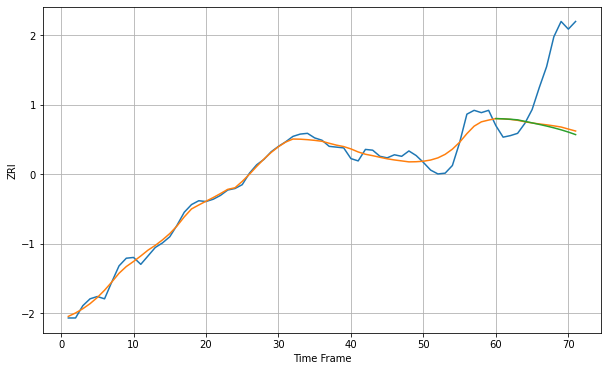

Wall time: 6.73 s
78749 9.000971070815002 81.49529715644489 83.69257571910822 [1282.25261554 1281.92354338 1281.37638482 1280.59440102 1278.62347658
 1276.63961192 1274.62345016 1272.49741113 1270.17531502 1267.57814398
 1264.64497174 1261.34168201]

Got an mse at 0.0100 in round 62 and stopped training

71 71 12


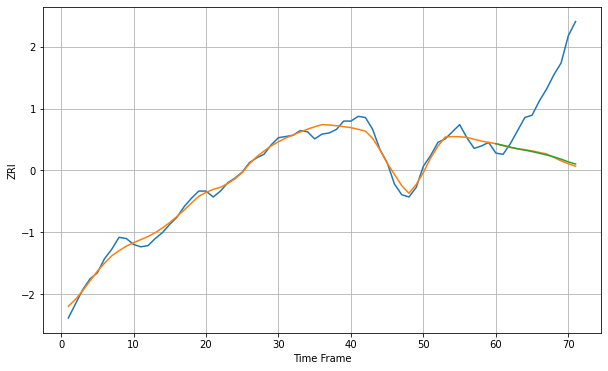

Wall time: 6.43 s
78750 5.152811984528226 61.30983742742762 60.704555517171464 [1283.91860026 1282.57467366 1281.07854772 1279.62235978 1278.49328924
 1277.27260974 1275.91112551 1274.41463025 1272.86184815 1270.88844411
 1268.61362284 1266.81744513]

Got an mse at 0.0099 in round 100 and stopped training

71 71 12


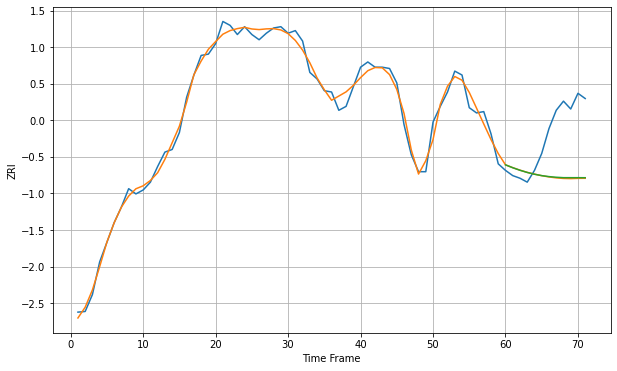

Wall time: 7.39 s
78751 5.539447358981764 39.579529416129 39.22179956166412 [1368.2465814  1366.03880156 1364.09221994 1362.41706871 1361.04531957
 1359.99286306 1359.2452657  1358.75126502 1358.43136853 1358.42176782
 1358.42117992 1358.39413533]

Got an mse at 0.0099 in round 36 and stopped training

71 71 12


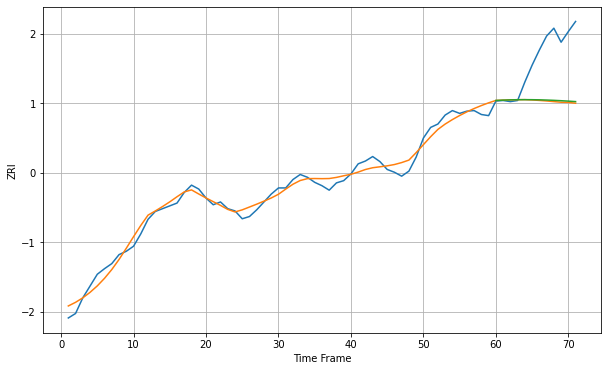

Wall time: 5.91 s
78752 12.187218107205798 87.6664211837559 86.13100576579534 [1348.09148873 1348.59886359 1349.11505689 1349.41029546 1349.51077785
 1349.43342298 1349.19250395 1348.802058   1348.27700128 1347.63322296
 1346.88709377 1346.05471157]

Got an mse at 0.0099 in round 91 and stopped training

71 71 12


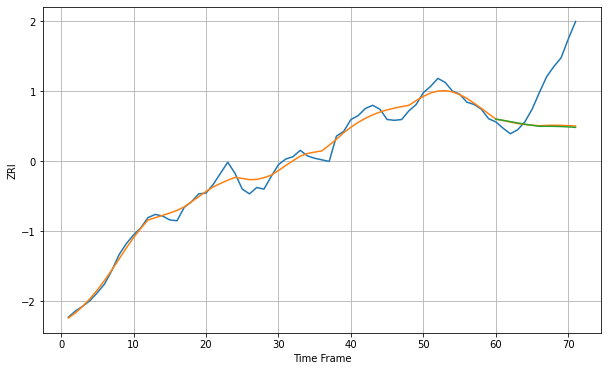

Wall time: 6.95 s
78753 8.766159096515135 63.669067574601726 64.65144569665945 [1149.47213146 1147.97038355 1146.31398828 1144.6665044  1143.1188253
 1141.70690966 1140.40911058 1140.46569364 1140.39393741 1140.13095296
 1139.68206831 1139.06793356]

Got an mse at 0.0100 in round 49 and stopped training

71 71 12


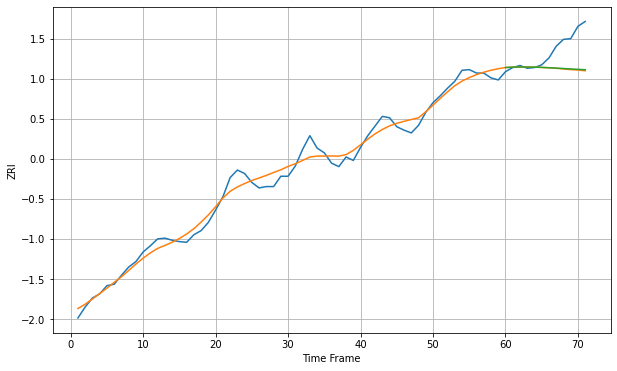

Wall time: 6.3 s
78754 11.574552965185399 34.57127009430078 33.95698884506986 [1243.04382633 1243.57571183 1243.7917468  1243.7835361  1243.58418658
 1243.23064464 1242.76158096 1242.21487296 1241.62513224 1241.02180298
 1240.42812454 1239.8609851 ]

Got an mse at 0.0098 in round 139 and stopped training

71 71 12


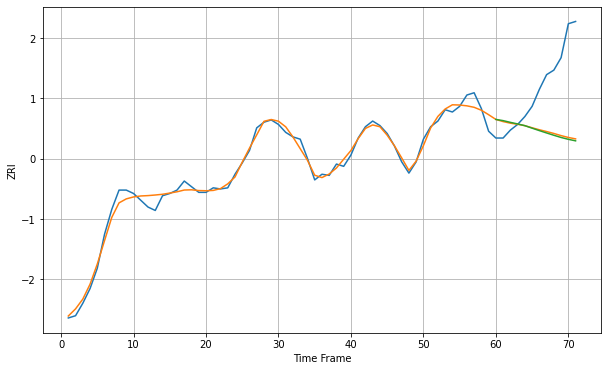

Wall time: 7.83 s
78757 5.226609348177217 52.817431359739174 53.861808036821834 [1276.43255812 1275.38157801 1273.84764211 1272.45739497 1270.92546365
 1268.71873812 1266.55542996 1264.47984988 1262.43927572 1260.50234464
 1258.86993604 1257.51916311]

Got an mse at 0.0095 in round 58 and stopped training

71 71 12


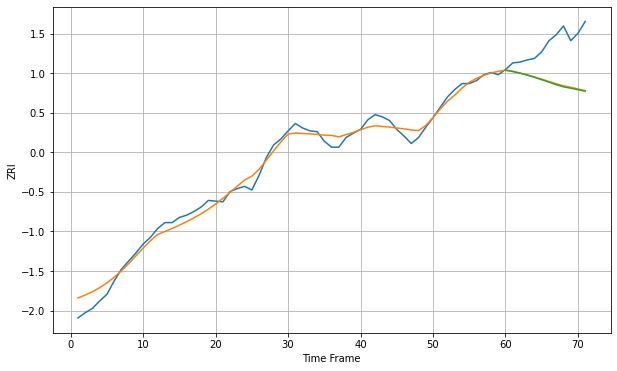

Wall time: 6.41 s
78758 10.033617445134533 54.1092699363295 54.92601388027213 [1332.11531585 1330.3885495  1328.04056973 1325.36511796 1322.42067197
 1319.25437994 1315.91056419 1312.4312513  1309.62780454 1307.76624333
 1305.76941143 1303.63707578]

Got an mse at 0.0099 in round 59 and stopped training

71 71 12


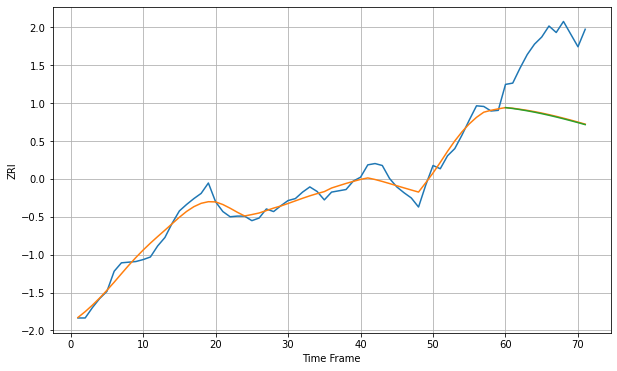

Wall time: 6.34 s
78759 11.411175014068187 111.32544707165019 112.09399307500308 [1492.2307923  1490.86258641 1489.19048327 1487.29850047 1485.1983723
 1482.90255063 1480.42575792 1477.78531134 1475.00113807 1472.09548824
 1469.09238226 1466.01686414]

Got an mse at 0.0100 in round 94 and stopped training

71 71 12


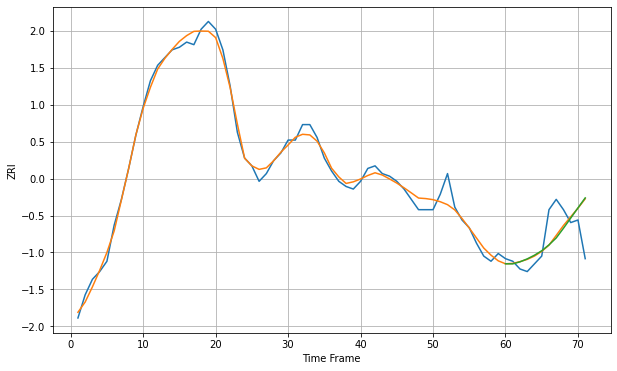

Wall time: 6.96 s
79912 2.837823092056025 9.288833021686745 9.55161187779265 [966.01685061 965.98229014 966.7727568  967.91685034 969.35164803
 971.07112098 973.35116885 976.03739081 979.80712188 983.74030345
 987.69503894 991.56829155]

Got an mse at 0.0099 in round 231 and stopped training

71 71 12


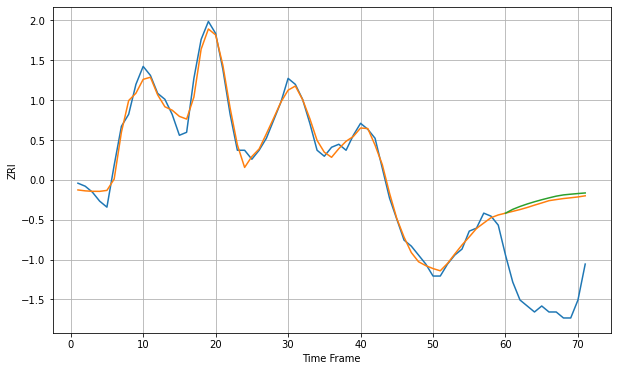

Wall time: 9.68 s
79936 2.6283974888130017 32.78407241326601 33.79456137140195 [911.99581513 913.26562572 914.23173292 915.06310815 915.80295406
 916.47697408 917.09959601 917.6776449  918.09265126 918.32945195
 918.54477865 918.741845  ]

Got an mse at 0.0095 in round 54 and stopped training

71 71 12


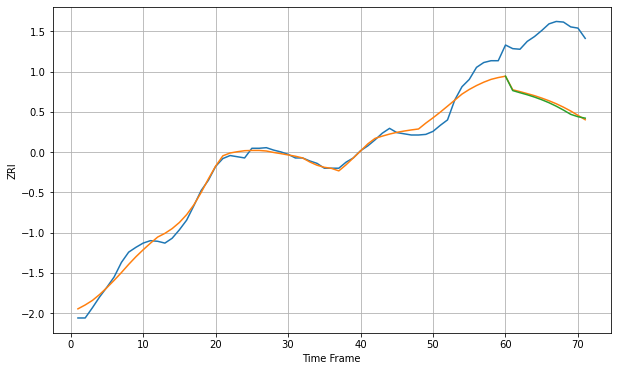

Wall time: 6.56 s
80021 12.664432141988991 113.60062284603231 116.0391799391418 [1565.36371414 1541.54453335 1538.02411274 1534.63747857 1530.78510488
 1526.40493352 1521.44756701 1515.68751755 1509.25962485 1502.20320978
 1498.26043681 1495.87576983]

Got an mse at 0.0098 in round 77 and stopped training

71 71 12


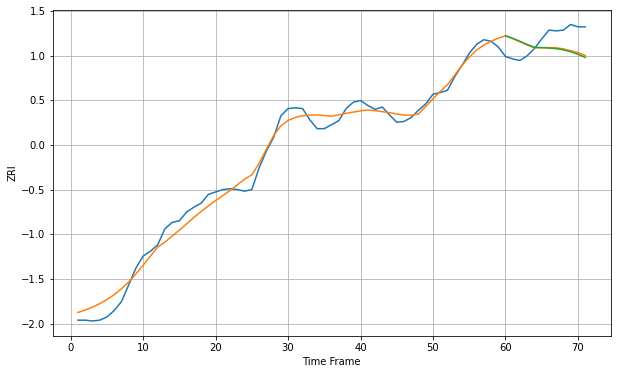

Wall time: 6.85 s
80027 10.797289522240279 24.16111510453685 25.1961276794086 [1639.93494748 1636.67906996 1632.94193467 1629.03825554 1625.54553299
 1625.07961655 1624.5799123  1623.81340669 1622.26449238 1619.8854901
 1616.73323544 1612.92890553]

Got an mse at 0.0099 in round 142 and stopped training

71 71 12


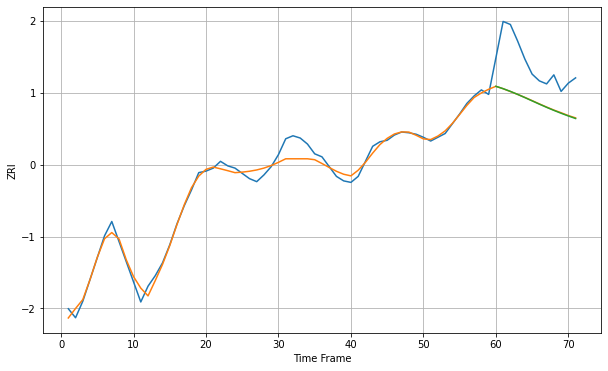

Wall time: 7.93 s
80033 9.490123259487932 54.6343063298503 54.831943102323315 [1292.77418543 1289.63241952 1286.02207191 1282.0358286  1277.79201386
 1273.4272496  1269.0741854  1264.83674074 1260.78236118 1256.94687981
 1253.34102801 1249.95567763]

Got an mse at 0.0099 in round 32 and stopped training

71 71 12


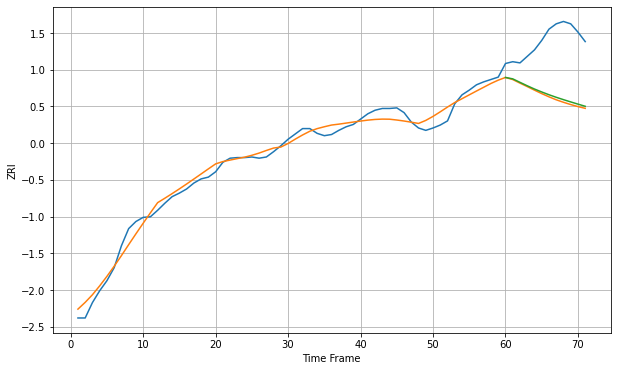

Wall time: 6 s
80111 12.15388450761248 97.1791633930025 94.0776547278118 [1595.40033181 1593.01380426 1587.13936281 1581.33650057 1575.83410932
 1570.88503285 1566.19219681 1561.88523655 1557.88919103 1554.06291364
 1550.33037169 1546.68445906]

Got an mse at 0.0099 in round 49 and stopped training

71 71 12


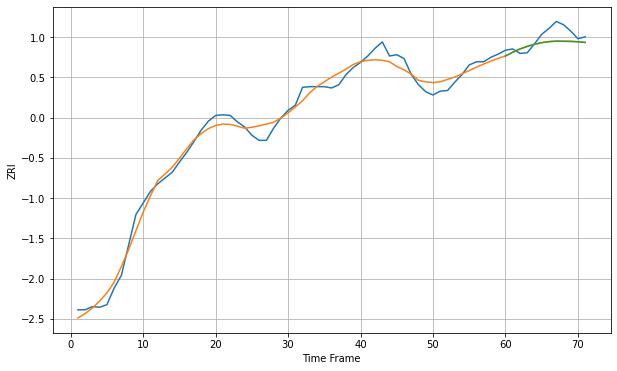

Wall time: 6.2 s
80112 12.407553828553738 15.288689237443386 15.419566657268495 [1776.03755589 1781.70351681 1786.93497051 1791.05171343 1794.38075254
 1796.85488535 1798.42727706 1799.10664291 1798.9691476  1798.6716153
 1798.15302241 1797.21825929]

Got an mse at 0.0098 in round 50 and stopped training

71 71 12


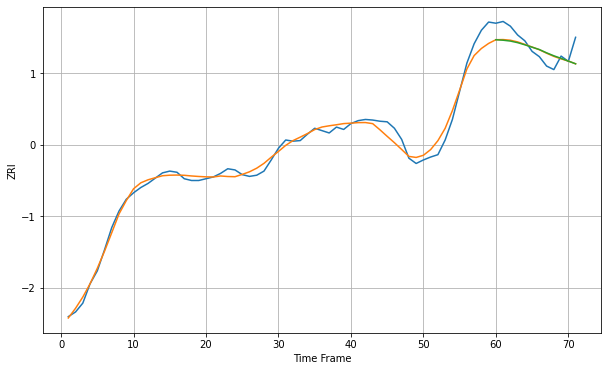

Wall time: 6.17 s
80120 11.641110770148513 21.85820966052781 22.34051256540367 [1640.90501648 1640.03121215 1638.58019507 1635.87975703 1632.21448902
 1628.12801234 1624.16069519 1618.56518309 1613.51363375 1609.13176635
 1604.46339958 1599.86074204]

Got an mse at 0.0100 in round 74 and stopped training

71 71 12


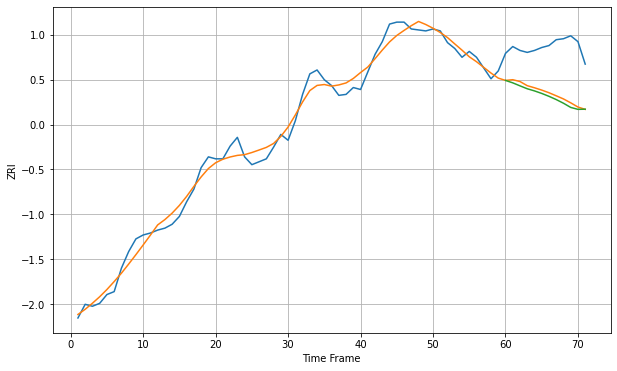

Wall time: 6.64 s
80124 9.143376071941123 48.5135523092037 51.582085191294865 [1593.30327127 1590.81250703 1587.7380038  1584.75804436 1582.56110347
 1579.96914235 1577.00947481 1573.68948459 1569.9328017  1565.63982247
 1563.6665035  1563.8283387 ]

Got an mse at 0.0100 in round 109 and stopped training

71 71 12


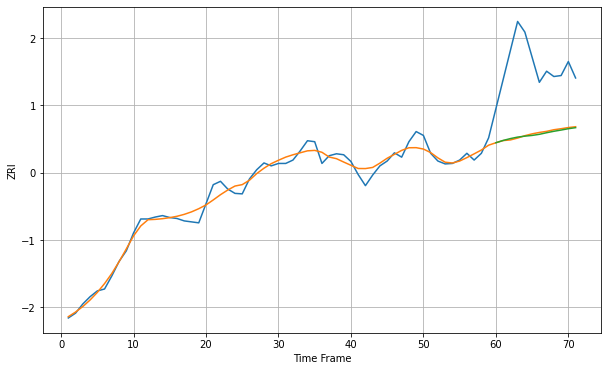

Wall time: 7.38 s
80129 13.8182877963946 148.3512673678113 149.2774891599978 [1871.85313176 1876.61379718 1880.45551617 1883.55216553 1885.50822316
 1887.02318526 1889.30085783 1892.60778532 1895.58891071 1898.11232848
 1900.93575539 1903.09235119]

Got an mse at 0.0100 in round 382 and stopped training

71 71 12


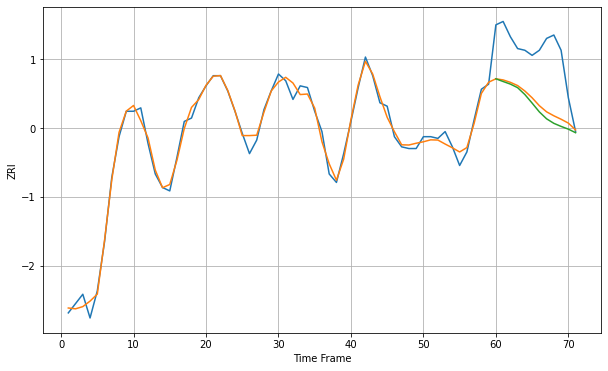

Wall time: 12.5 s
80202 4.030065153414667 31.242726278834272 33.80833369639132 [2003.15922963 2001.56818834 2000.03110467 1997.93010868 1993.87899932
 1988.82779242 1983.62319093 1979.54568525 1976.87306308 1975.06208921
 1973.45034562 1971.34657803]

Got an mse at 0.0097 in round 22 and stopped training

71 71 12


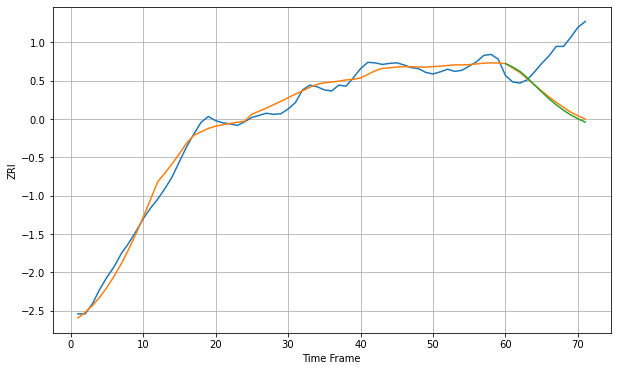

Wall time: 5.8 s
80203 13.3906208226163 98.61022721143642 102.2193633779304 [1588.67726848 1581.94053983 1573.88426808 1561.72930464 1548.5321651
 1535.18604302 1522.44293133 1510.84803801 1500.66545048 1491.93297187
 1484.53218994 1478.47644251]

Got an mse at 0.0100 in round 67 and stopped training

71 71 12


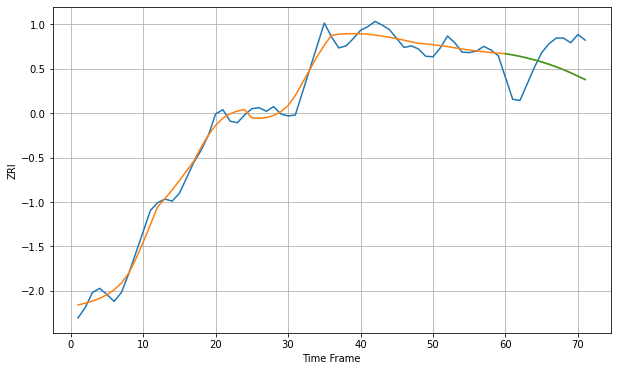

Wall time: 6.56 s
80204 17.02997214771892 60.14723757743742 60.23366494176703 [1849.83361935 1847.53194494 1844.7886587  1841.6320802  1838.0471119
 1834.01706586 1829.51827882 1824.52058574 1819.00135273 1812.98341837
 1806.59494197 1800.1117443 ]

Got an mse at 0.0100 in round 83 and stopped training

71 71 12


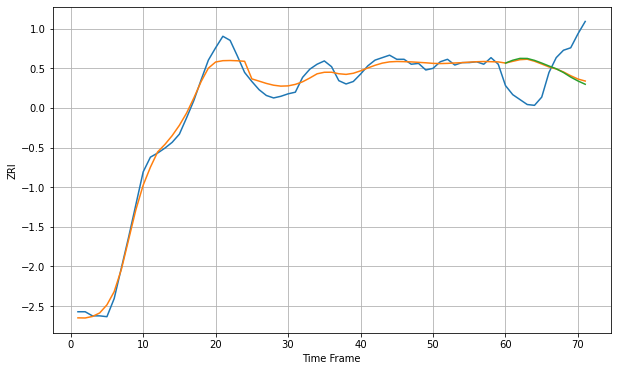

Wall time: 6.86 s
80205 9.501287909503294 43.43338528850895 44.92984030905343 [1672.41463953 1675.84234911 1678.09564814 1678.01736213 1675.67815644
 1672.40987894 1668.83868443 1665.50232484 1660.91033529 1655.36053404
 1650.63123846 1646.63825698]

Got an mse at 0.0098 in round 34 and stopped training

71 71 12


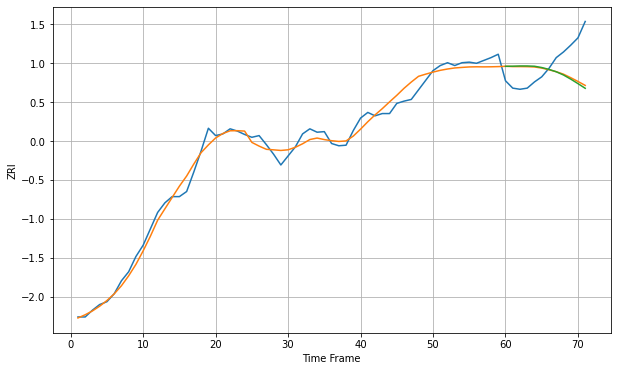

Wall time: 5.99 s
80210 13.337953651661216 50.28797141455673 52.35027121746035 [1625.6540686  1625.83246854 1626.23407406 1626.22563809 1625.73383067
 1623.46893296 1620.14031555 1615.99356623 1610.25571173 1602.986242
 1595.00028279 1586.72174449]

Got an mse at 0.0098 in round 56 and stopped training

71 71 12


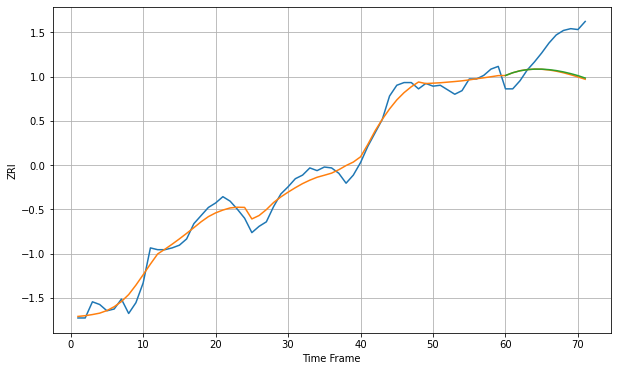

Wall time: 6.31 s
80211 9.667184899702907 35.77924115955777 35.04709658813806 [1708.86904706 1711.96323524 1714.10518875 1715.37490621 1715.94695948
 1715.92788451 1715.37914773 1714.33958242 1712.84604681 1710.95104233
 1708.73403528 1706.01369619]

Got an mse at 0.0093 in round 35 and stopped training

71 71 12


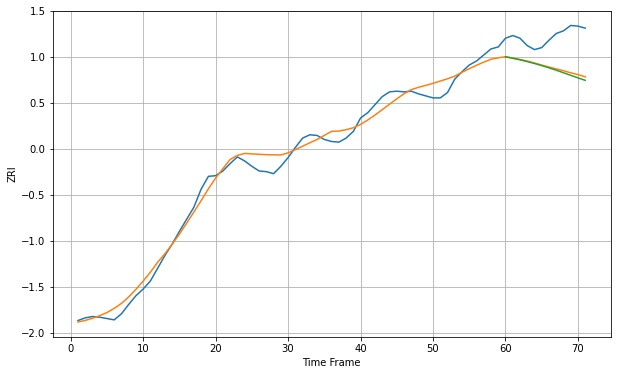

Wall time: 5.95 s
80214 12.92782877395193 48.212650799229564 50.664161945421675 [1294.30857855 1292.08180645 1289.73866014 1287.14297851 1284.28795052
 1281.17495771 1277.81704205 1274.24476604 1270.51084652 1266.6908475
 1262.87754127 1259.16867071]

Got an mse at 0.0097 in round 70 and stopped training

71 71 12


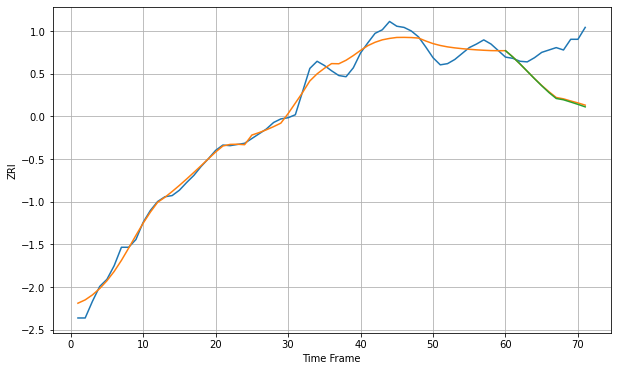

Wall time: 6.84 s
80218 13.888261194534277 72.35319952246627 73.76915434347706 [1437.83154746 1427.26248137 1415.57428416 1403.22090636 1390.80197085
 1378.765333   1367.3646052  1357.38235019 1355.20740052 1351.39059656
 1347.4758566  1343.29018359]

Got an mse at 0.0098 in round 55 and stopped training

71 71 12


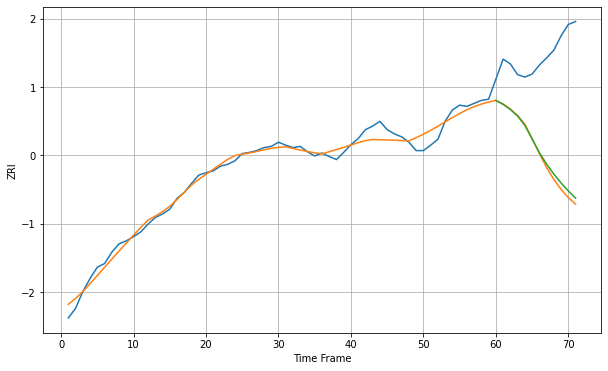

Wall time: 6.8 s
80226 11.246815141830217 178.14466627095337 172.54634010289973 [1450.91040633 1444.39240411 1435.73559914 1424.73736234 1409.09427083
 1386.40858313 1363.72662459 1344.28281002 1327.75240022 1312.78443685
 1299.53945933 1287.63734565]

Got an mse at 0.0096 in round 35 and stopped training

71 71 12


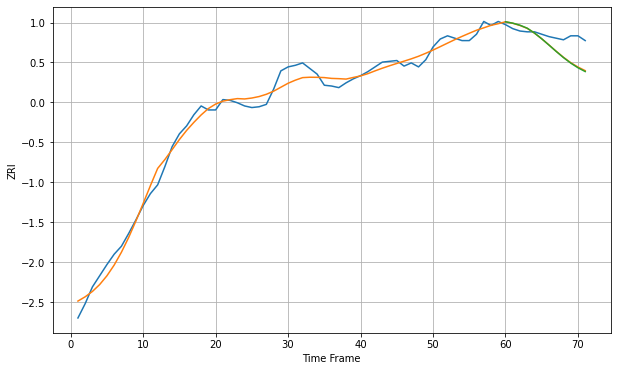

Wall time: 6.35 s
80229 9.70557812351937 20.63796075416655 21.099499440536974 [1412.57839828 1410.88882925 1408.28124493 1404.54957957 1398.49099275
 1391.24601951 1383.3793029  1375.35973581 1367.68855582 1360.7876865
 1354.91584873 1350.16463851]

Got an mse at 0.0098 in round 44 and stopped training

71 71 12


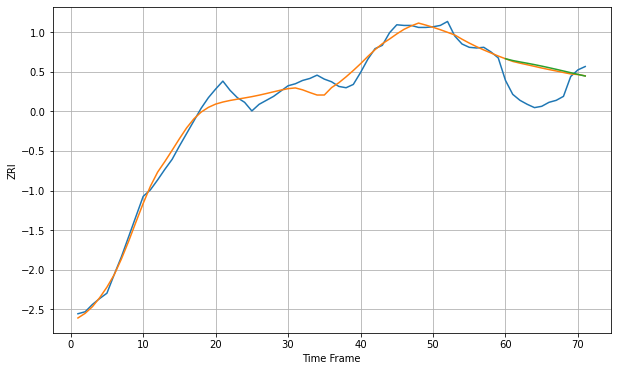

Wall time: 6.18 s
80231 11.59676775892227 44.18495828264629 46.0449967330308 [1356.76172625 1354.06963133 1351.9518335  1349.9851316  1347.87873062
 1345.63376672 1343.26839869 1340.80742894 1338.28064838 1335.72112025
 1333.16324907 1330.64080389]

Got an mse at 0.0091 in round 71 and stopped training

71 71 12


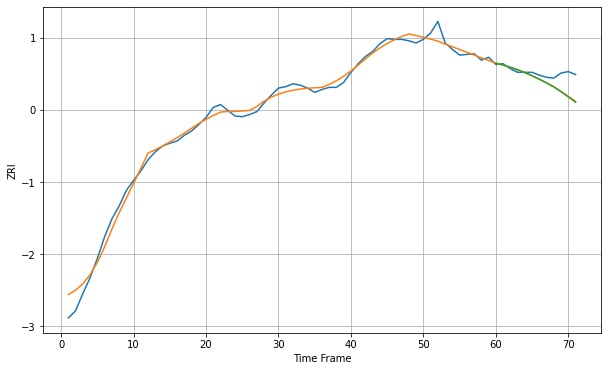

Wall time: 6.65 s
80233 9.294949414863849 17.197370151515653 17.633990292751292 [1422.86895496 1420.1390326  1417.03460981 1413.54205165 1409.61046721
 1405.20854326 1400.35784024 1395.13036755 1389.56516703 1382.84044456
 1375.63296435 1368.2546789 ]

Got an mse at 0.0098 in round 63 and stopped training

71 71 12


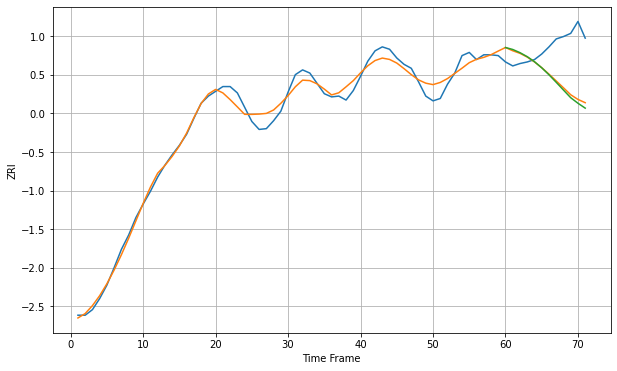

Wall time: 6.61 s
80237 9.525947603086529 51.302746347816765 54.0160290142619 [1466.20113592 1463.7176139  1459.70481779 1454.66952993 1448.3230095
 1440.64470578 1431.85309295 1422.36417798 1412.62458093 1402.95806508
 1395.98988007 1389.83598583]

Got an mse at 0.0099 in round 212 and stopped training

71 71 12


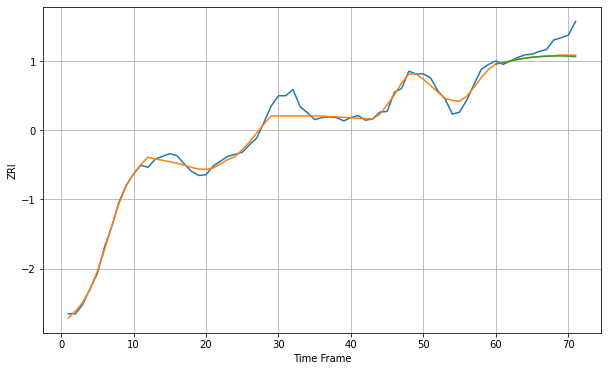

Wall time: 9.13 s
80301 10.087493694075345 19.85413661876466 20.682289615826143 [1758.69946786 1760.40350213 1763.06029231 1765.28316772 1767.01148608
 1768.3174227  1769.2660745  1769.90522175 1770.2683696  1770.34322706
 1770.03952274 1769.41924678]

Got an mse at 0.0098 in round 58 and stopped training

71 71 12


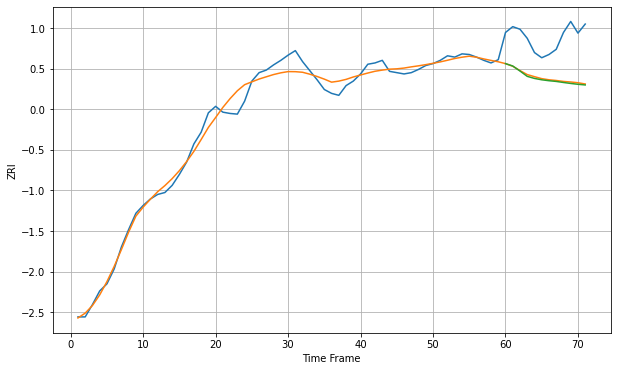

Wall time: 6.56 s
80401 12.324298404655753 63.4871491753514 64.95105352129603 [1548.9323193  1545.25517001 1537.51233055 1529.29246179 1526.08383722
 1523.975114   1522.54226684 1521.45100067 1519.82616892 1518.33633729
 1517.03418535 1516.02053142]

Got an mse at 0.0100 in round 51 and stopped training

71 71 12


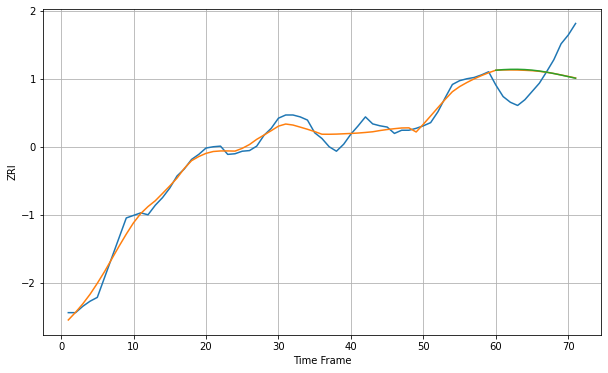

Wall time: 6.34 s
80503 10.559577481194314 46.60591443109482 47.125461612065415 [1418.47346643 1419.34954528 1419.82156647 1419.87507903 1419.46979187
 1418.57700769 1417.19891381 1415.3850454  1413.22943954 1410.84476634
 1408.33494546 1405.78453807]

Got an mse at 0.0099 in round 37 and stopped training

71 71 12


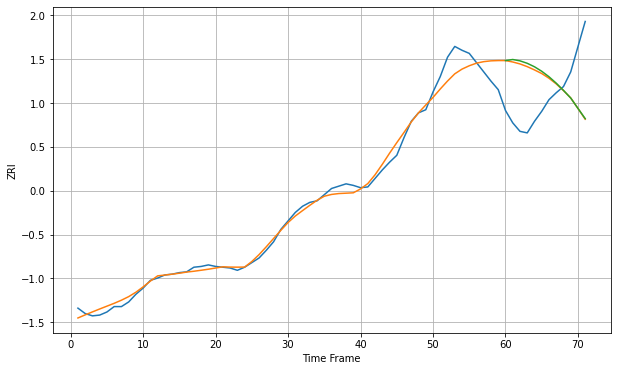

Wall time: 6.03 s
80904 11.156636400874465 68.74624981770218 70.41175266238785 [1039.66939146 1041.05784117 1039.31100034 1036.14177158 1031.63919555
 1025.8216107  1018.7199442  1010.41248626 1001.101102    991.18882437
  977.71257286  964.46693748]

Got an mse at 0.0099 in round 105 and stopped training

71 71 12


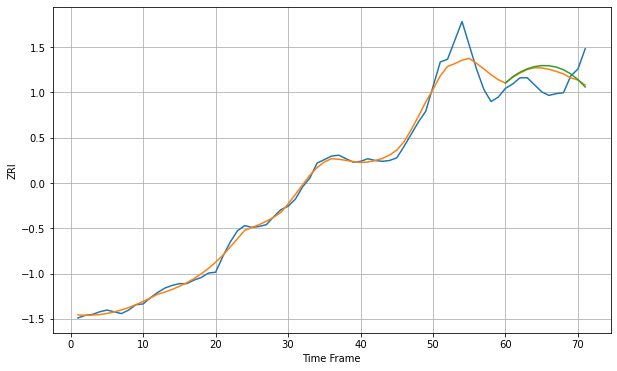

Wall time: 7.64 s
80915 10.107253265961168 20.71070234240742 22.97502040936116 [954.04059679 961.2127466  966.35066276 970.14634589 972.64093325
 973.82969695 973.69388254 972.17277091 969.14346132 964.43023019
 957.87943155 949.53537131]

Got an mse at 0.0098 in round 62 and stopped training

71 71 12


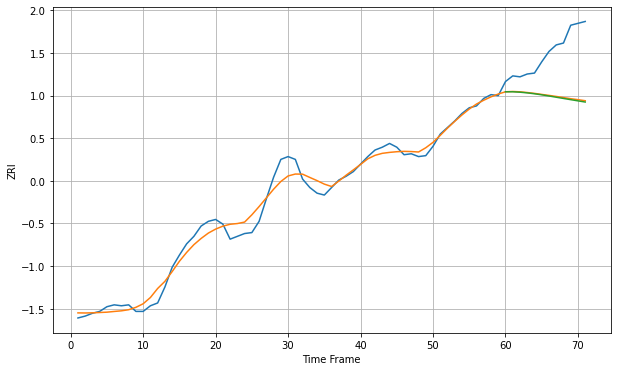

Wall time: 6.93 s
84047 8.908351376087685 50.97103475744215 51.74904333827904 [1108.06204976 1108.06468497 1107.61663184 1106.89185732 1105.94104052
 1104.81563923 1103.57409391 1102.27452975 1100.96247966 1099.6639811
 1098.38809462 1097.13426247]

Got an mse at 0.0100 in round 71 and stopped training

71 71 12


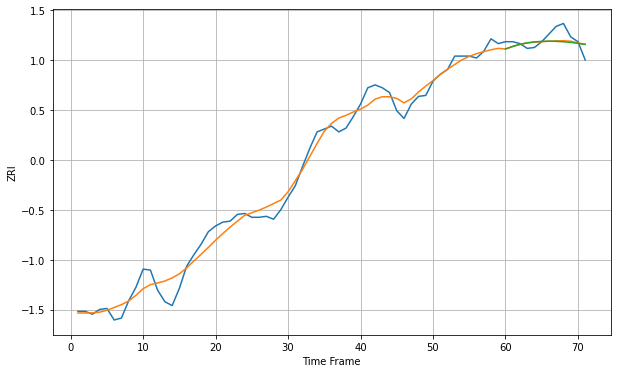

Wall time: 6.59 s
84095 10.35450126980908 9.32421360197662 9.624921991406124 [1329.40077681 1332.05795015 1334.21703036 1335.79365518 1336.79850136
 1337.35549913 1337.52981267 1337.37345134 1336.92917457 1336.23151351
 1335.30763711 1334.17839047]

Got an mse at 0.0099 in round 33 and stopped training

71 71 12


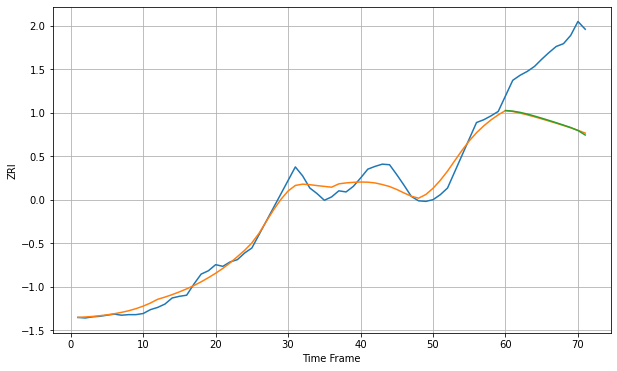

Wall time: 5.91 s
84102 15.313348899159946 126.33570340117835 126.2060491338578 [1092.56218495 1091.47024551 1089.3215803  1086.26833792 1082.65658024
 1078.78077954 1074.76479089 1070.6183935  1066.34186028 1061.96426365
 1056.57143673 1048.5301783 ]

Got an mse at 0.0098 in round 33 and stopped training

71 71 12


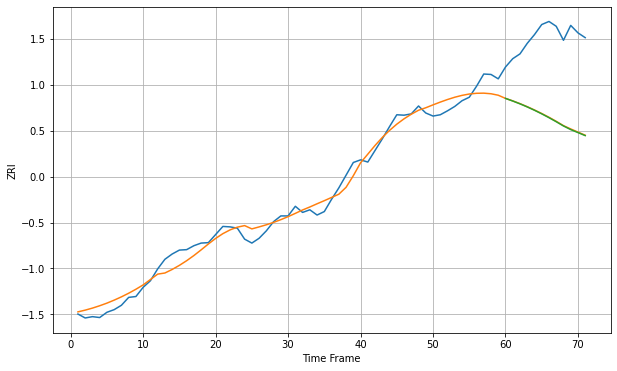

Wall time: 5.96 s
84103 20.43208885643092 184.58161566377441 185.38859915117774 [1323.36992473 1317.34334615 1310.92137059 1303.88636023 1296.26360074
 1288.07197863 1279.33142373 1270.08119133 1260.40269369 1252.10291886
 1245.28010782 1238.3823689 ]

Got an mse at 0.0100 in round 96 and stopped training

71 71 12


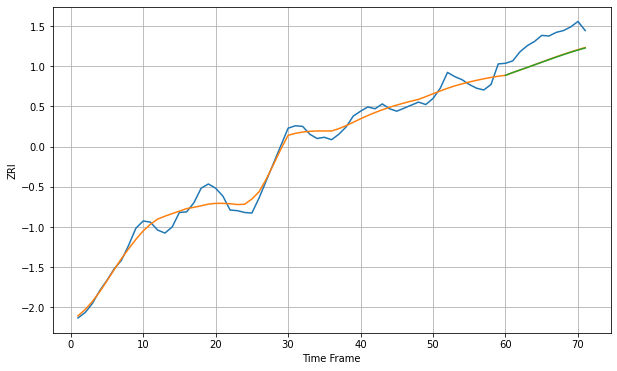

Wall time: 7.12 s
84106 13.199900640049444 36.10374114162561 36.464562429181406 [1243.1870256  1247.7841331  1251.98615904 1256.17407984 1260.42065133
 1264.71394567 1268.99914048 1273.21183646 1277.29115305 1281.18404119
 1284.84707476 1288.24737088]

Got an mse at 0.0099 in round 50 and stopped training

71 71 12


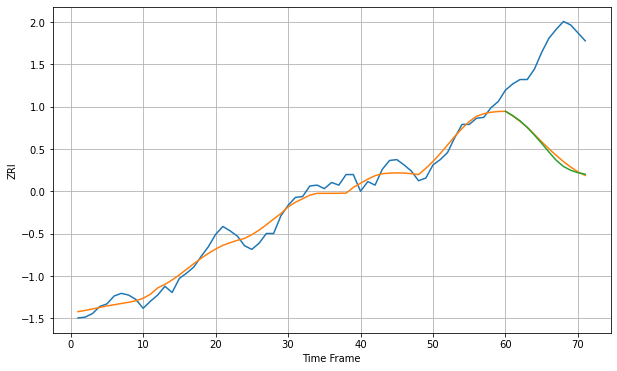

Wall time: 6.41 s
84119 9.523871602797145 115.14158360664412 117.25448438700772 [1010.89235179 1005.98167799 1000.09262562  992.55701191  983.7825182
  974.43511546  964.56463873  955.23462974  948.1892364   943.84018825
  941.08121126  939.41835626]

Got an mse at 0.0096 in round 34 and stopped training

71 71 12


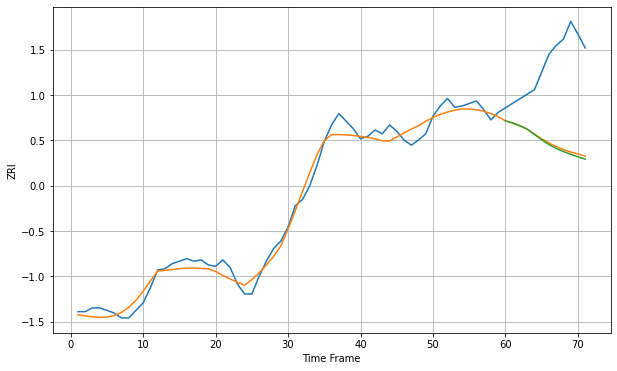

Wall time: 5.91 s
84403 6.899908030346889 65.68711833098222 66.9412798534516 [878.19873483 876.48264536 874.29677406 871.6033883  867.38451741
 863.2730901  859.44997856 856.40367101 853.92123418 851.70133547
 849.70464634 847.89933915]

Got an mse at 0.0099 in round 74 and stopped training

71 71 12


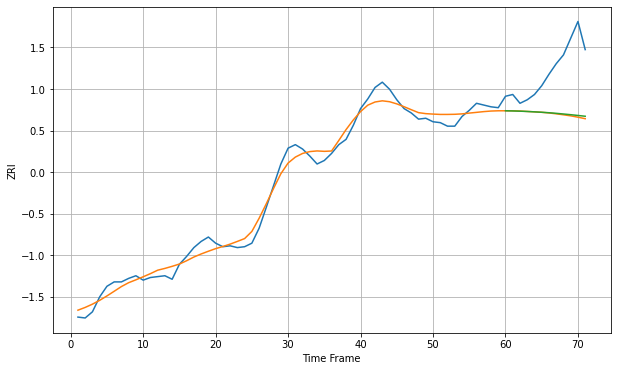

Wall time: 6.92 s
85008 9.311659756702772 56.11216784228883 55.150271857586674 [1037.479413   1037.2900695  1037.03458927 1036.68674741 1036.26706263
 1035.79144964 1035.27032176 1034.59520851 1033.83372356 1033.02887614
 1032.17566632 1031.26649806]

Got an mse at 0.0100 in round 81 and stopped training

71 71 12


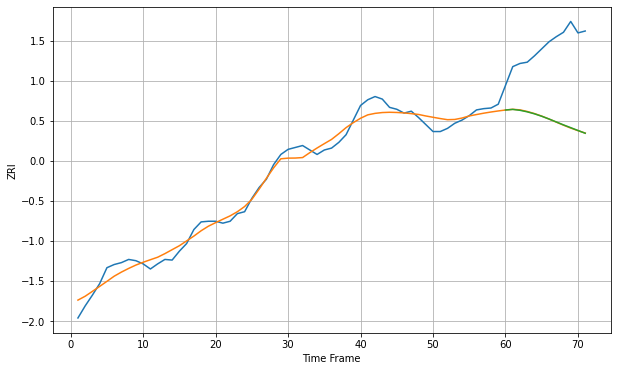

Wall time: 6.68 s
85014 12.435411230740353 118.374234229864 118.34912090741214 [1155.85435132 1156.79260969 1155.36240247 1152.95932492 1149.82114208
 1146.02169027 1141.70620207 1137.09651499 1132.46942286 1128.10740021
 1123.64406671 1119.32217071]

Got an mse at 0.0099 in round 41 and stopped training

71 71 12


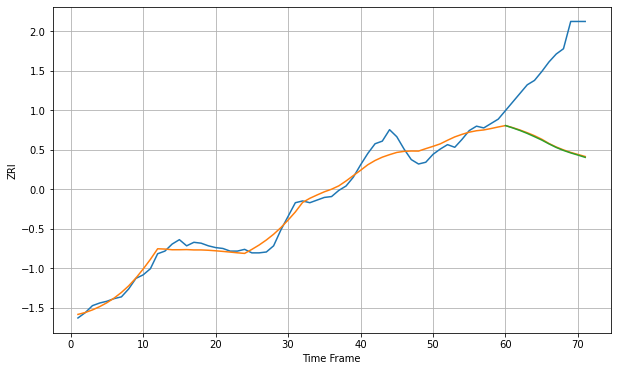

Wall time: 6.47 s
85015 8.786332782442573 98.83355925261205 99.44724257892608 [929.67996323 927.01167316 924.08446972 920.75484731 917.06554451
 913.23342007 908.85792083 904.79377985 901.42843216 898.60741351
 896.13238762 893.54296804]

Got an mse at 0.0097 in round 48 and stopped training

71 71 12


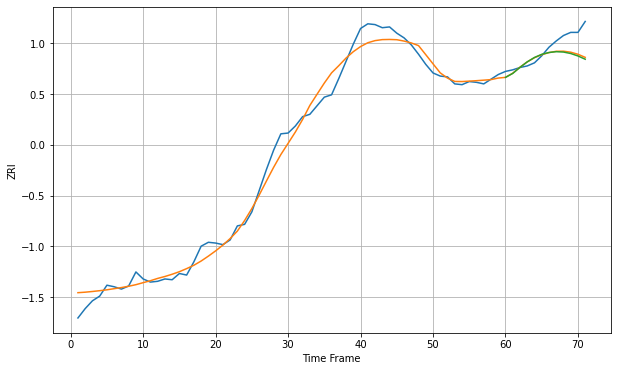

Wall time: 6.24 s
85016 12.502850831717682 18.978813373499825 20.058462014499035 [1310.36081718 1315.39797426 1323.19624417 1330.2054293  1335.86444056
 1339.90062227 1342.23245181 1343.26803031 1342.80496993 1340.9272004
 1337.79503844 1333.60757364]

Got an mse at 0.0100 in round 68 and stopped training

71 71 12


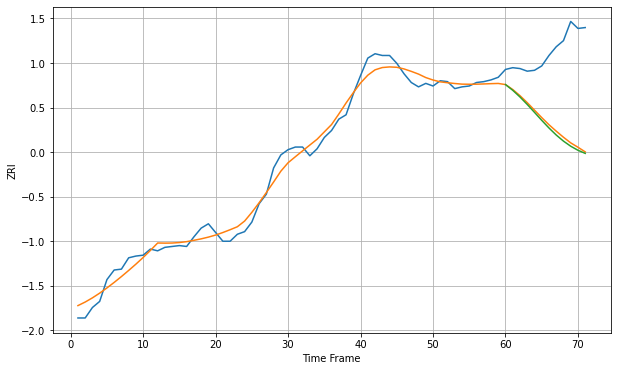

Wall time: 6.97 s
85018 10.06614824576724 88.96788527583605 91.70959240699511 [1197.62981247 1191.07780335 1183.39336528 1174.84366478 1165.78299597
 1156.63565998 1147.84614298 1139.80527123 1132.79131706 1126.94582802
 1122.28730761 1118.74775834]

Got an mse at 0.0100 in round 88 and stopped training

71 71 12


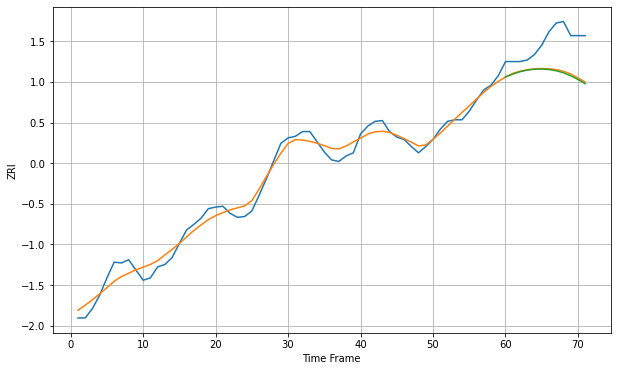

Wall time: 7.04 s
85020 10.2259767145107 41.492878867921405 42.7765248853436 [1098.36670547 1102.05647768 1105.07220461 1107.1441406  1108.29144259
 1108.53351951 1107.8819072  1106.34138188 1103.74359943 1099.96114506
 1095.27804574 1089.80706147]

Got an mse at 0.0098 in round 39 and stopped training

71 71 12


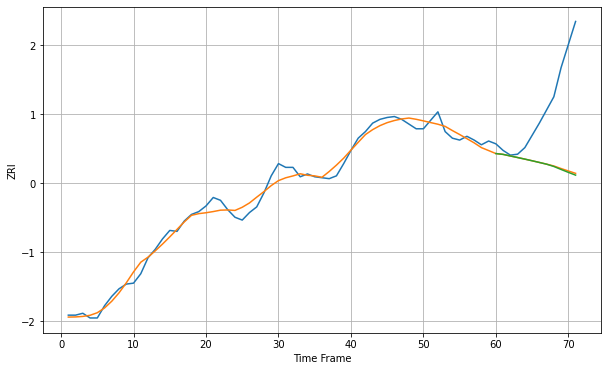

Wall time: 6.07 s
85027 7.159211330033659 74.75848378046314 75.4848179684949 [1013.65265364 1012.80014034 1011.10423724 1009.44254396 1007.76038435
 1006.01831668 1004.21449226 1002.38051572  999.94466634  996.76936247
  993.6951045   990.74424174]

Got an mse at 0.0100 in round 72 and stopped training

71 71 12


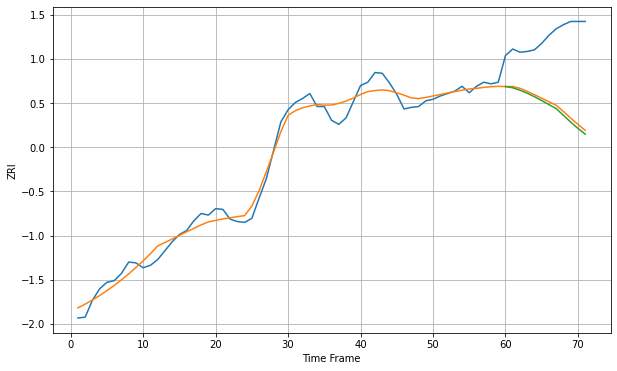

Wall time: 6.58 s
85032 10.839422190905475 87.23706893359514 90.70936143328035 [1154.64745467 1153.11064861 1150.15593549 1146.43975093 1142.08588128
 1137.30978657 1132.36997307 1127.4592669  1119.05161895 1110.74196066
 1103.02864653 1095.93793423]

Got an mse at 0.0099 in round 39 and stopped training

71 71 12


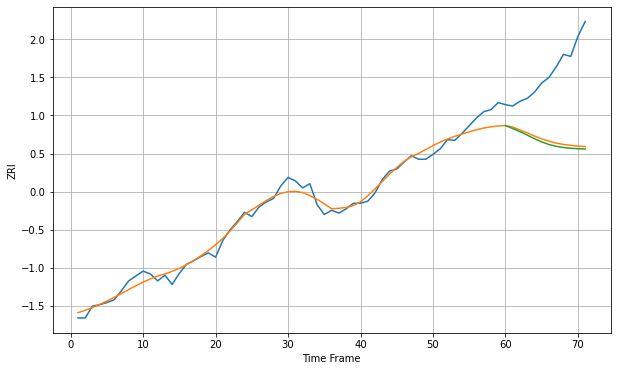

Wall time: 6.03 s
85044 10.504393435829588 102.43728777639274 105.83004394676804 [1320.18846167 1315.84842863 1311.43882088 1306.48187824 1301.39375345
 1296.75902162 1293.06126963 1290.44585577 1288.7497228  1287.6950278
 1287.0288316  1286.56718965]

Got an mse at 0.0098 in round 32 and stopped training

71 71 12


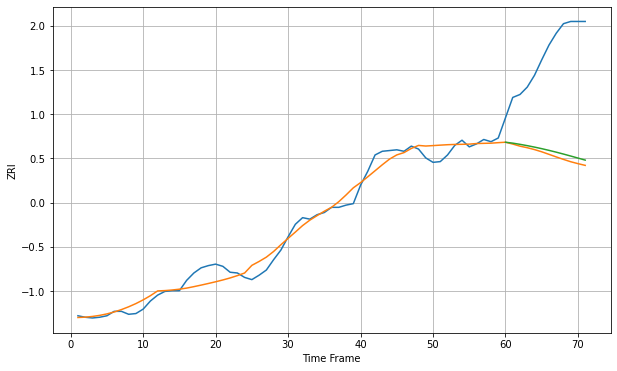

Wall time: 5.85 s
85201 11.636423237432247 140.75788287366927 135.50335542800542 [1041.26952348 1040.02620298 1038.42106337 1036.63466792 1034.67175462
 1032.54033551 1030.24762891 1027.8040762  1025.22731714 1022.54475213
 1019.79347425 1017.01732047]

Got an mse at 0.0098 in round 41 and stopped training

71 71 12


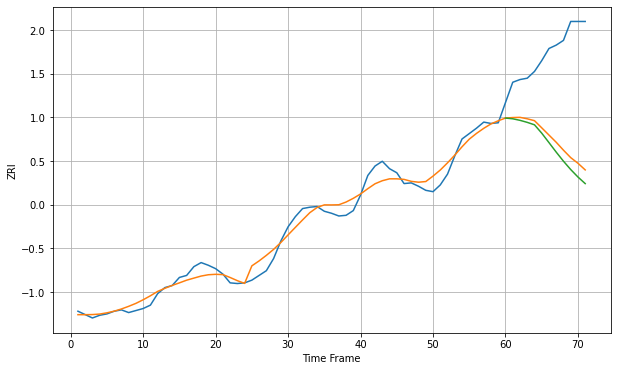

Wall time: 6.02 s
85204 12.679556731559734 135.952577156804 148.44441815763847 [1124.00753068 1122.91146411 1120.61591063 1117.61871956 1113.98545046
 1101.62476326 1087.62782974 1073.53110551 1060.09853911 1047.757271
 1036.68785011 1026.94324886]

Got an mse at 0.0099 in round 28 and stopped training

71 71 12


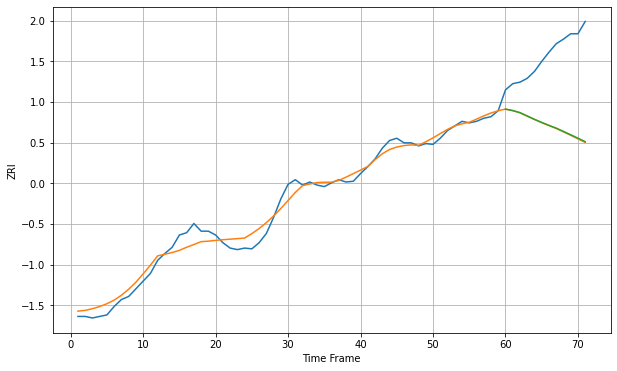

Wall time: 5.79 s
85224 10.201735876587568 97.00848325103144 96.58640975158482 [1155.88675784 1153.94862076 1151.27437781 1146.84325698 1142.52879727
 1138.47954721 1134.69651891 1131.12789688 1126.84562902 1122.48082996
 1118.03371195 1113.50256408]

Got an mse at 0.0100 in round 72 and stopped training

71 71 12


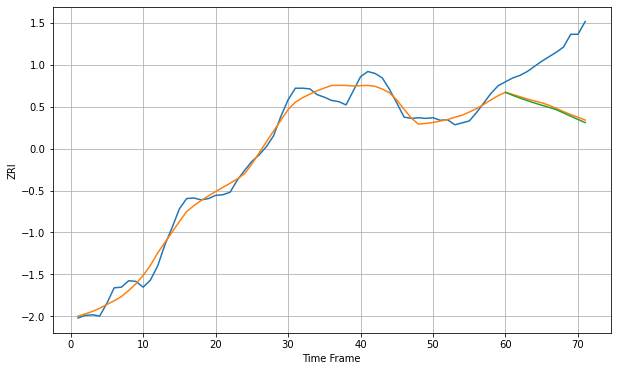

Wall time: 6.84 s
85251 12.990463228436909 86.77344431330903 89.28983050382233 [1377.60697733 1372.90725211 1368.62271955 1364.68290597 1361.00817888
 1357.52306008 1354.16085237 1350.68835009 1345.49280121 1340.36951076
 1335.34042086 1330.39614755]

Got an mse at 0.0100 in round 54 and stopped training

71 71 12


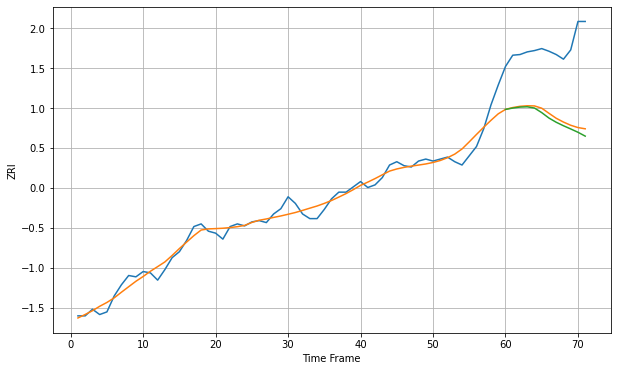

Wall time: 6.79 s
85260 11.980433227838079 104.27661885694476 109.49806423512176 [1468.08392563 1470.08447909 1471.59926177 1472.02359729 1470.13999028
 1463.20056964 1454.98055    1448.63441905 1443.35252461 1438.52699988
 1433.53086502 1427.68032615]

Got an mse at 0.0100 in round 43 and stopped training

71 71 12


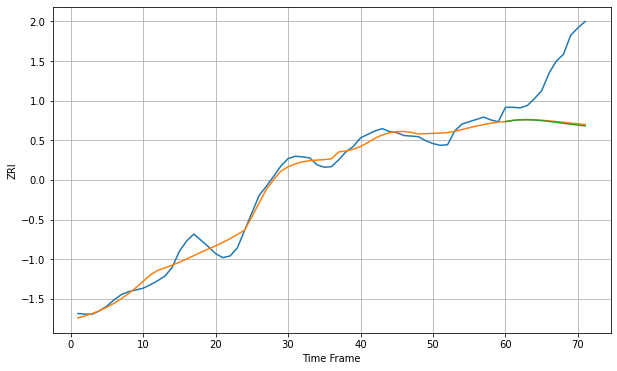

Wall time: 6.32 s
85281 13.559578146267707 100.37247605709831 101.70641405299025 [1202.20337369 1204.17929724 1205.2172856  1205.41438636 1204.91196841
 1203.87387678 1202.47162899 1200.86832504 1199.20216849 1197.57525762
 1196.05172531 1194.66415652]

Got an mse at 0.0098 in round 32 and stopped training

71 71 12


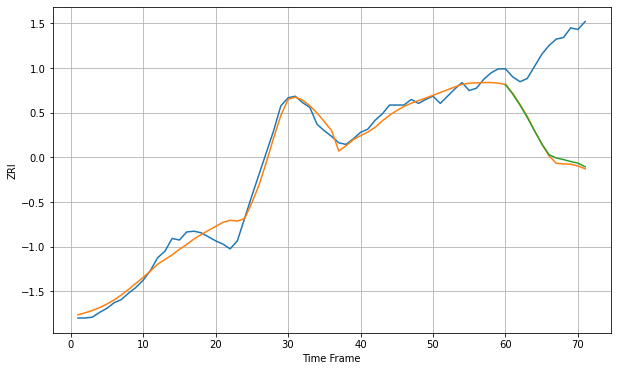

Wall time: 6.15 s
85282 10.715013123202356 122.90226592899458 120.48292188279545 [1187.5420545  1175.59958547 1161.86831    1146.68192275 1129.95925776
 1113.823153   1100.21642733 1096.09171143 1094.13785224 1091.71227546
 1089.66411018 1085.13670193]

Got an mse at 0.0100 in round 50 and stopped training

71 71 12


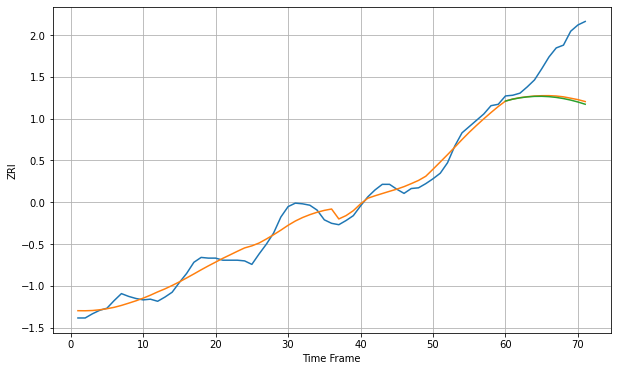

Wall time: 6.15 s
85283 11.896930974563142 64.39426310722578 66.36934349902549 [1199.66037345 1202.33060574 1204.30380817 1205.64496281 1206.3667506
 1206.4762791  1205.98100745 1204.89209407 1203.22694725 1201.01122552
 1198.28033516 1195.08035999]

Got an mse at 0.0099 in round 88 and stopped training

71 71 12


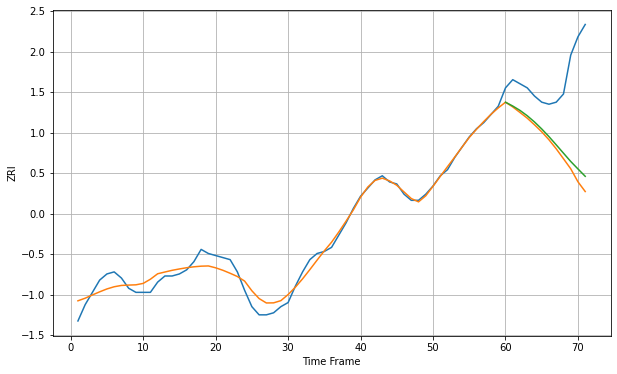

Wall time: 6.86 s
85705 3.901717474609912 38.37663830275932 35.148490738731944 [711.98384142 710.11885493 707.97234526 705.36437905 702.32454027
 698.89895039 695.14843286 691.13555101 687.06122407 683.00372668
 679.34487553 675.74406432]

Got an mse at 0.0099 in round 103 and stopped training

71 71 12


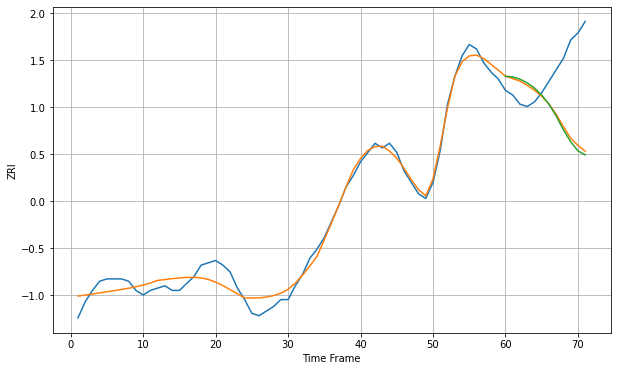

Wall time: 7.14 s
85716 4.062034243698761 27.507331595965127 28.58503957989215 [754.17120681 753.85799219 752.8749628  751.26877604 748.98487837
 745.95445719 741.97442681 736.86521855 730.78197394 725.68909168
 721.6901121  719.96423838]

Got an mse at 0.0099 in round 53 and stopped training

71 71 12


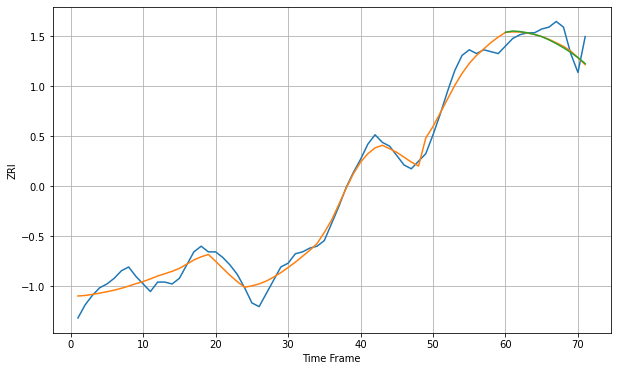

Wall time: 6.5 s
85719 5.207386474991967 7.294410622678317 7.398911382273254 [814.2606524  814.95342398 814.65732237 814.02928683 813.12721544
 811.97087215 810.26531951 808.28244822 806.08205141 803.63118935
 800.86210514 797.69031088]

Got an mse at 0.0098 in round 24 and stopped training

71 71 12


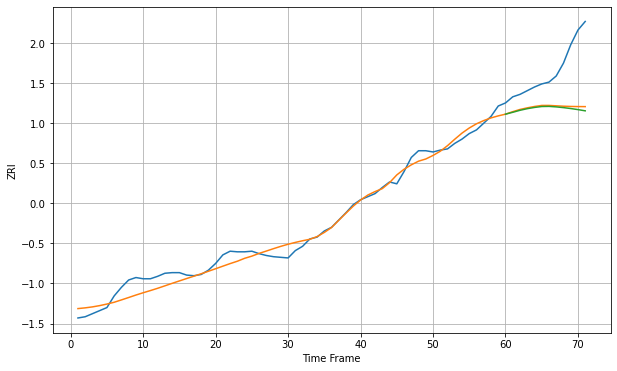

Wall time: 5.73 s
86314 12.450079022395157 69.75566635482053 72.65762929392514 [1051.67297155 1054.73539446 1057.99851165 1060.63157383 1062.66749888
 1064.17163461 1064.38779309 1063.56603723 1062.37908054 1060.88985793
 1059.13035933 1057.13063323]

Got an mse at 0.0099 in round 90 and stopped training

71 71 12


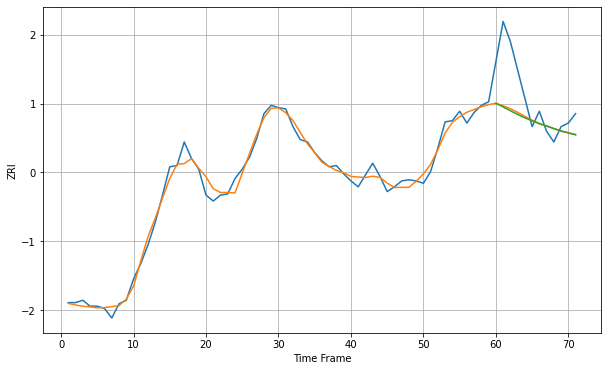

Wall time: 7.65 s
87111 5.773958414787337 31.34116725399062 32.00025041793968 [916.74071678 913.67182665 910.42700035 907.29125785 904.43736241
 901.88681824 899.57029106 897.41383854 895.37771837 893.4566075
 891.66616964 890.02942692]

Got an mse at 0.0100 in round 97 and stopped training

71 71 12


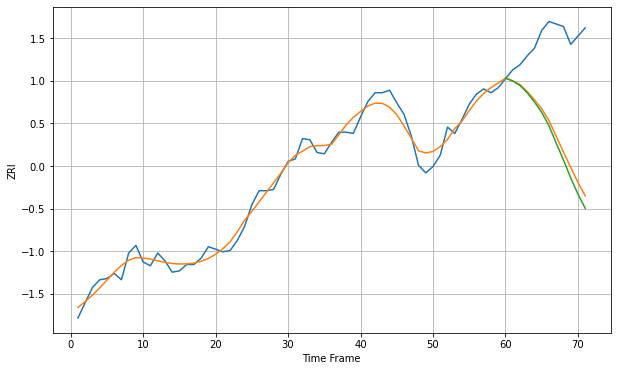

Wall time: 7.55 s
89030 6.632989699539894 76.44355955268459 81.72085947078007 [873.455033   871.29857221 867.67634072 861.96648719 854.64238027
 846.57514882 836.06003379 822.45320883 809.13462558 795.08136477
 782.25076666 771.21907922]

Got an mse at 0.0098 in round 49 and stopped training

71 71 12


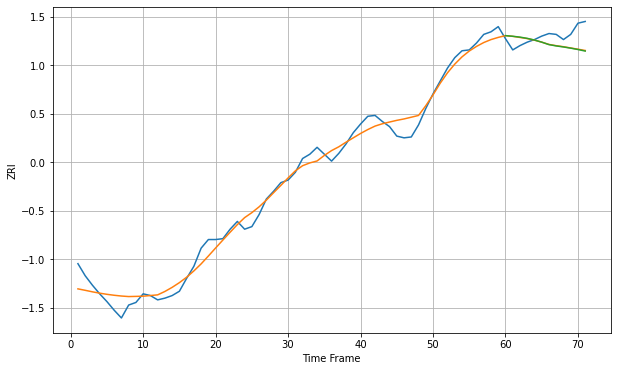

Wall time: 6.3 s
89052 11.071868094607723 16.0918540585719 16.36786751328993 [1467.56744338 1466.81829107 1465.84302682 1464.39635177 1462.44648997
 1460.0012623  1457.13333103 1455.61403909 1454.41050411 1453.03652735
 1451.45589731 1449.6467026 ]

Got an mse at 0.0099 in round 58 and stopped training

71 71 12


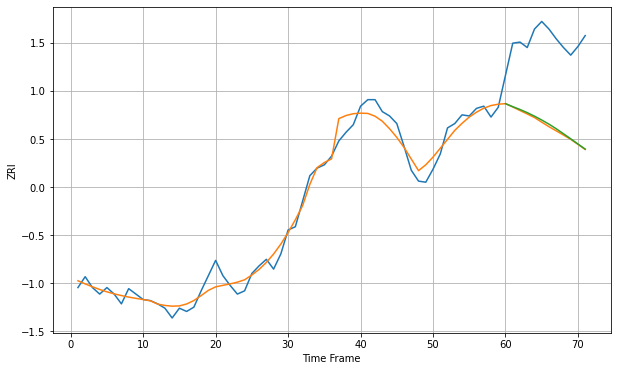

Wall time: 6.32 s
89101 8.763465850480706 78.51598336098677 77.43770252608108 [875.3149157  872.53303066 869.97964711 867.06157526 863.80434421
 860.24861663 856.45227715 852.20255769 847.62047451 842.95428272
 838.17687153 833.48461286]

Got an mse at 0.0100 in round 25 and stopped training

71 71 12


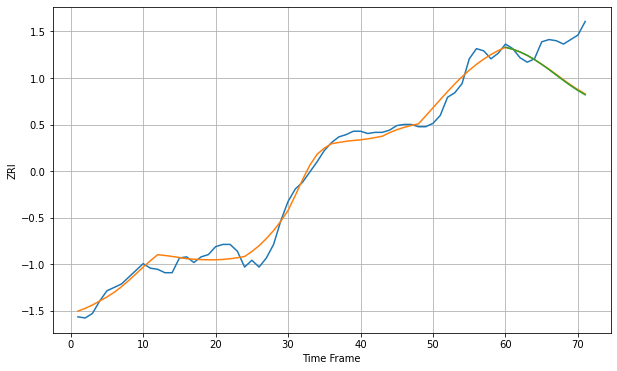

Wall time: 5.72 s
89108 8.022821177550417 30.35966542907674 30.805542676729235 [1084.16259633 1082.4663328  1080.10429994 1077.04838589 1073.35693236
 1069.12462752 1064.49482398 1059.65898261 1054.83480917 1050.22666094
 1045.98722589 1042.20075123]

Got an mse at 0.0099 in round 34 and stopped training

71 71 12


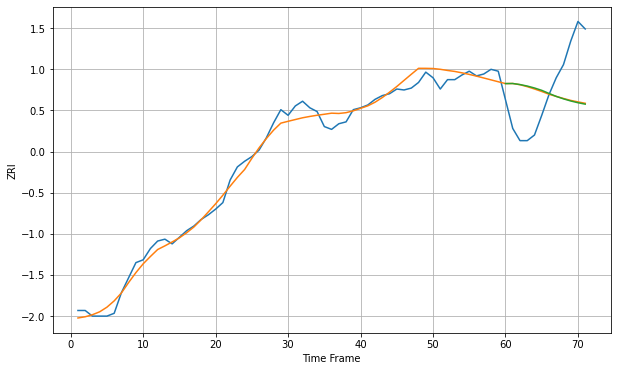

Wall time: 5.9 s
89117 8.570072915583271 51.476800444641775 52.0225988265805 [1273.80827283 1273.87146135 1272.77540626 1271.18915376 1269.11015496
 1266.61180444 1263.31175615 1260.15954855 1257.5379465  1255.26571125
 1253.39853881 1251.87543721]

Got an mse at 0.0100 in round 182 and stopped training

71 71 12


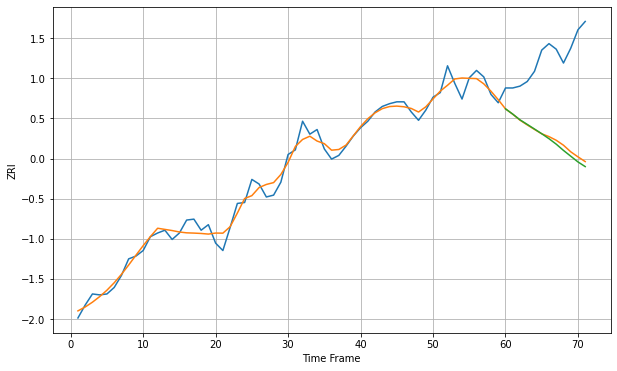

Wall time: 8.62 s
89119 8.653441534026452 90.97633388168668 93.90435708276979 [1109.3918782  1103.71402456 1097.50752432 1092.5614702  1087.55077927
 1082.45608213 1077.09042715 1071.16966735 1064.40203649 1058.16436871
 1051.93095171 1046.8815027 ]

Got an mse at 0.0088 in round 22 and stopped training

71 71 12


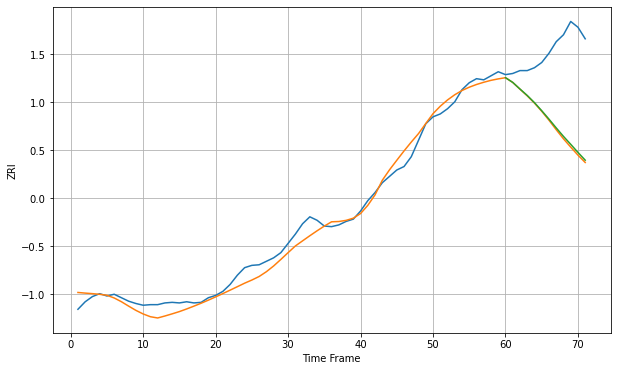

Wall time: 5.69 s
89502 14.829021631927372 136.983732485484 134.2005361532158 [1058.70065869 1050.56128474 1039.08553494 1027.98319815 1015.49911415
 1001.57120495  986.99954992  971.84032082  957.14161836  943.44800587
  929.40798297  916.00015336]

Got an mse at 0.0099 in round 255 and stopped training

71 71 12


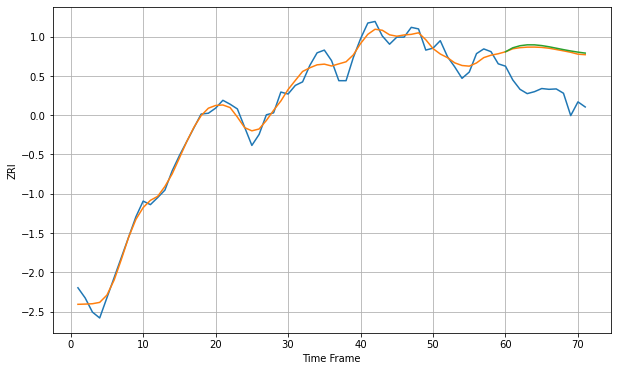

Wall time: 10.8 s
90001 19.888351240292252 111.14610185691586 115.16785473445243 [2371.72478338 2381.83986214 2387.12558411 2389.41583847 2389.363932
 2387.53104635 2384.50879419 2380.89518658 2377.20563368 2373.79333992
 2370.83169375 2368.35343148]

Got an mse at 0.0100 in round 296 and stopped training

71 71 12


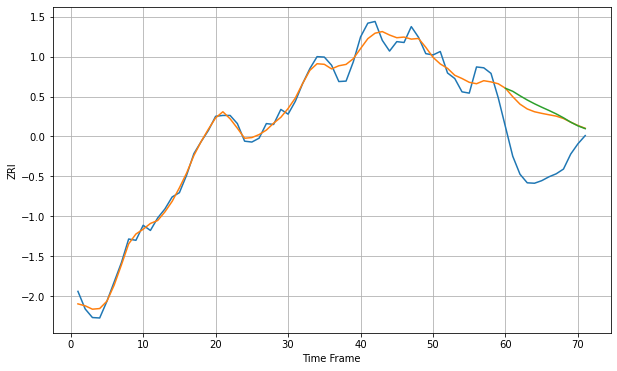

Wall time: 10.7 s
90002 18.51988347020304 127.95730350183238 138.5960326555103 [2333.23424174 2326.25677637 2315.85609674 2306.01626217 2297.2022207
 2289.19028748 2281.59430215 2273.5575682  2264.54047806 2254.29664097
 2245.69984038 2239.22896275]

Got an mse at 0.0098 in round 33 and stopped training

71 71 12


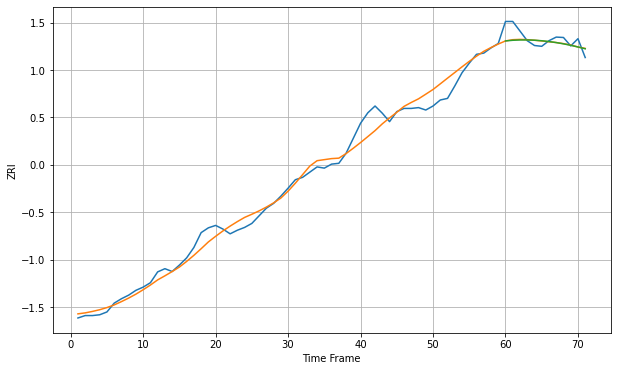

Wall time: 5.86 s
90003 22.496842102520286 23.44295744371398 23.764989928300643 [2091.41097851 2093.03269806 2093.80363367 2093.85623215 2093.20765052
 2091.87953163 2089.90228493 2087.3143856  2084.16086244 2080.49183307
 2076.36172106 2071.82956562]

Got an mse at 0.0094 in round 33 and stopped training

71 71 12


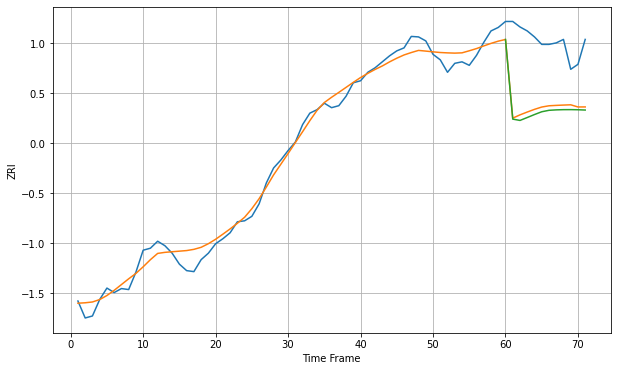

Wall time: 6.04 s
90004 18.855202545616216 133.07721194430363 140.83566380699625 [2247.89615108 2088.0566222  2085.41572541 2091.24735252 2097.22464218
 2102.79852206 2105.70229608 2106.58783942 2107.0187129  2107.09524431
 2106.83142935 2106.24899149]

Got an mse at 0.0097 in round 27 and stopped training

71 71 12


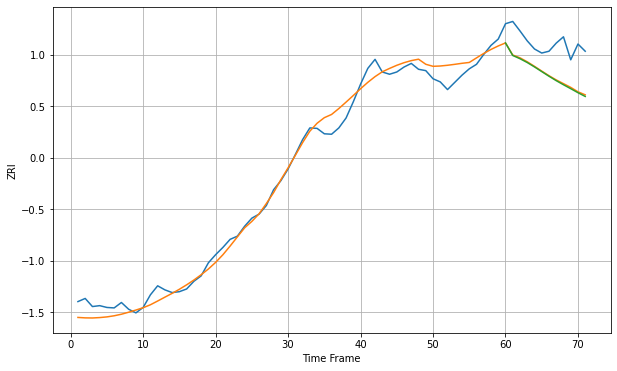

Wall time: 6.43 s
90006 21.55372756151351 71.1849411302758 72.98792171377418 [2161.37650536 2133.60051497 2126.44236257 2117.97064384 2108.22865419
 2097.90067511 2087.60984252 2077.8003159  2068.70682559 2060.0357403
 2051.10236525 2042.81967403]

Got an mse at 0.0099 in round 106 and stopped training

71 71 12


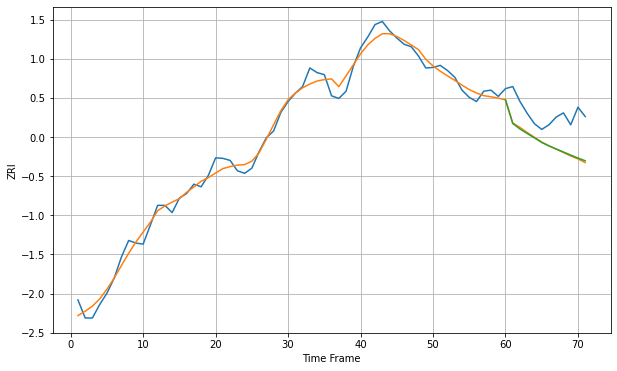

Wall time: 7.43 s
90007 14.983940142784208 60.32065866810895 59.860006113431986 [2229.23317925 2183.57137309 2172.87171381 2164.06748344 2155.63615696
 2146.79527322 2140.1004366  2134.15009529 2128.20848479 2122.34079549
 2116.65690468 2111.29363204]

Got an mse at 0.0100 in round 159 and stopped training

71 71 12


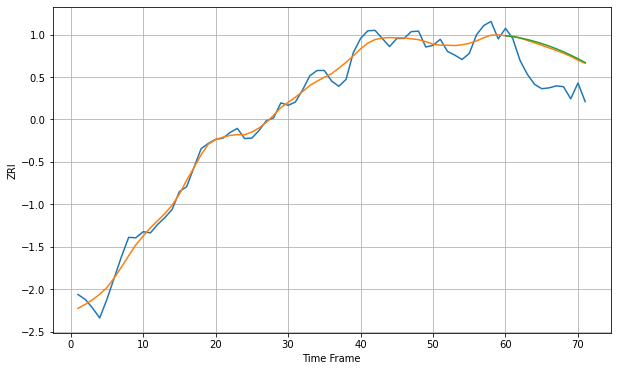

Wall time: 8.52 s
90011 20.880948662529004 81.52154273255387 84.35649281536536 [2387.74437559 2385.64451923 2382.4532357  2378.50200895 2373.81804047
 2368.4241847  2362.33710119 2355.55636829 2348.0702682  2339.87921097
 2331.02153217 2321.58772728]

Got an mse at 0.0099 in round 46 and stopped training

71 71 12


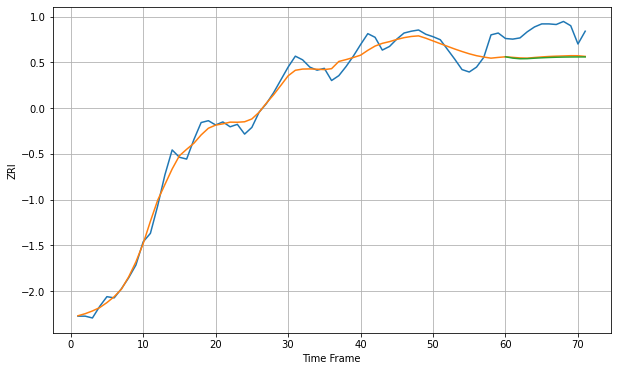

Wall time: 6.11 s
90012 14.840496768269317 44.24804951171122 45.596889117129045 [2383.96648602 2381.81884837 2380.75772575 2380.91560771 2381.67746325
 2382.32546055 2382.84434846 2383.23706738 2383.50932551 2383.67206705
 2383.74393885 2383.75215252]

Got an mse at 0.0100 in round 118 and stopped training

71 71 12


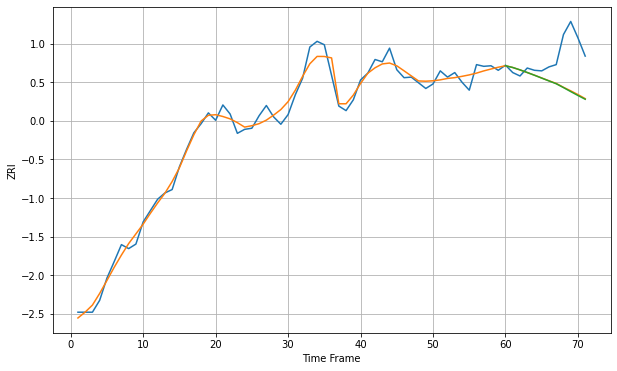

Wall time: 7.87 s
90015 13.510946492133096 58.66496776642665 59.35520720682671 [2522.03061564 2518.93876572 2514.76964158 2510.15317035 2505.27044864
 2500.2713106  2495.25843337 2490.29337091 2483.56238882 2476.50189143
 2469.62378892 2463.02582296]

Got an mse at 0.0100 in round 53 and stopped training

71 71 12


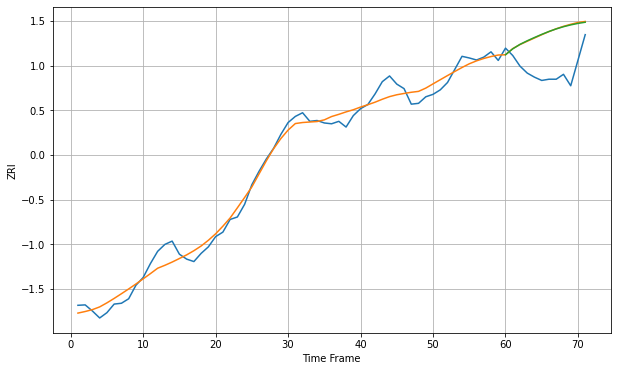

Wall time: 6.71 s
90016 21.666709878315178 93.90359279917936 93.65198014819053 [2342.82924224 2357.28791626 2368.27425769 2377.02933021 2385.02308839
 2392.68715393 2399.78835102 2406.06788617 2411.42415441 2415.87478698
 2419.49610774 2422.3820049 ]

Got an mse at 0.0097 in round 41 and stopped training

71 71 12


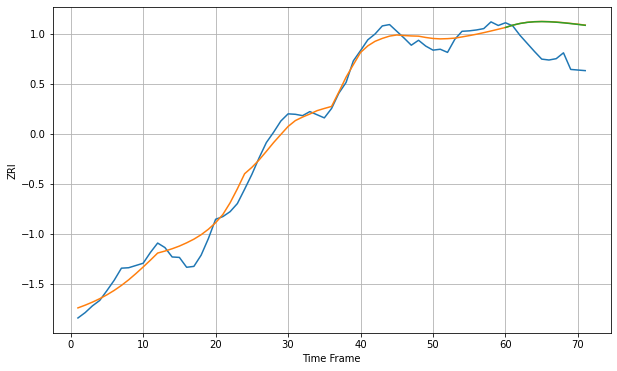

Wall time: 6.62 s
90018 21.632622823853698 73.17187058578183 72.87652896294202 [2243.541904   2248.69316914 2252.42933094 2254.9026354  2256.25288275
 2256.64445453 2256.26007156 2255.28491376 2253.88690243 2252.20230162
 2250.3321204  2248.34752758]

Got an mse at 0.0098 in round 35 and stopped training

71 71 12


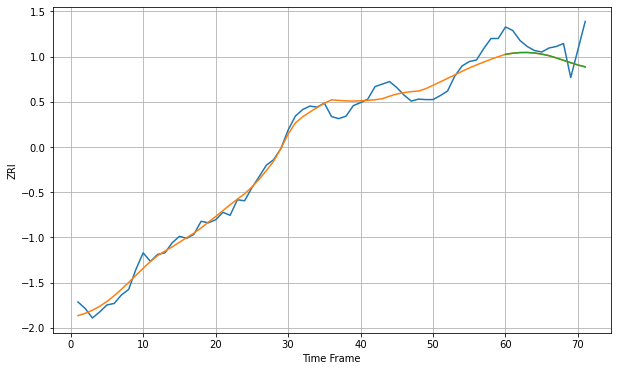

Wall time: 5.91 s
90019 17.60484148225475 38.39820607899723 38.47472097772198 [2274.36790083 2276.48938667 2277.88260189 2278.08938109 2277.05218739
 2274.84888245 2271.70990116 2267.30245434 2262.41084435 2257.61220592
 2253.16639786 2249.23793488]

Got an mse at 0.0099 in round 194 and stopped training

71 71 12


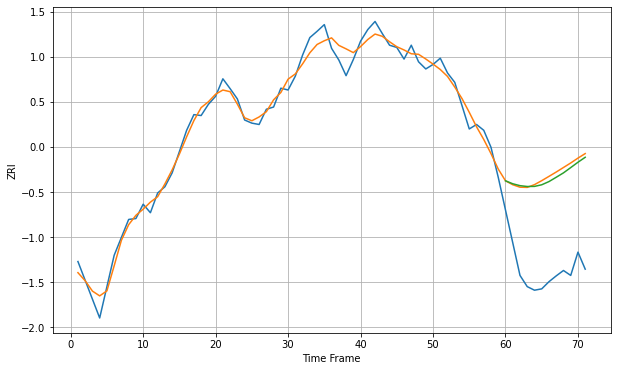

Wall time: 9.08 s
90022 20.011791000928763 215.71876497509982 209.36898207262604 [2226.22718128 2219.65692638 2215.42139034 2213.53433564 2213.76609421
 2217.38851163 2224.54375893 2234.1690065  2243.97513086 2255.74523164
 2267.69063288 2278.77126095]

Got an mse at 0.0099 in round 201 and stopped training

71 71 12


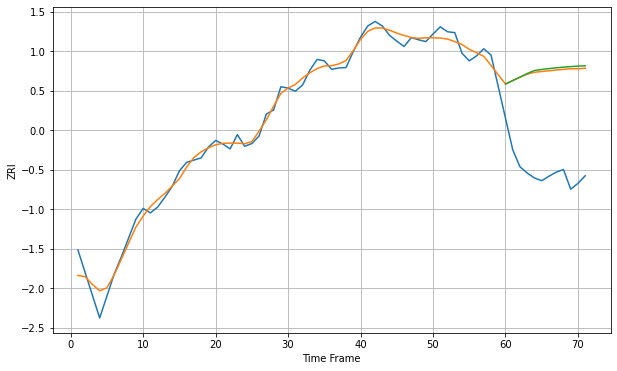

Wall time: 9.02 s
90023 17.529108343285426 221.37820069254303 225.143817193362 [2242.12516873 2249.80563143 2257.67586405 2265.60421408 2272.40928699
 2274.66234811 2276.6131767  2278.32977384 2279.81263961 2281.07058077
 2282.11740347 2282.96793115]

Got an mse at 0.0099 in round 44 and stopped training

71 71 12


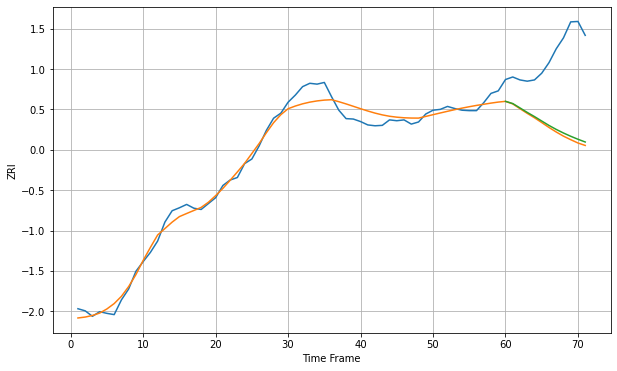

Wall time: 6.54 s
90024 18.88284401025612 179.62265457747984 174.16702169491714 [2907.0672733  2901.86862704 2891.40029864 2880.76938824 2870.84409891
 2860.29283159 2849.80023714 2840.33380467 2831.78744602 2824.03740928
 2816.95464947 2810.4287172 ]

Got an mse at 0.0099 in round 48 and stopped training

71 71 12


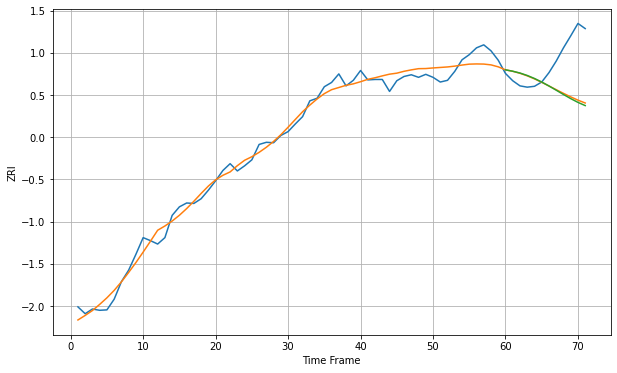

Wall time: 6.44 s
90025 19.278800484258497 92.22173413884472 94.94220968268571 [3010.49751531 3007.28309387 3003.02637798 2997.34275492 2990.28675067
 2981.9972936  2972.73047745 2962.86181341 2952.84825831 2943.18842308
 2934.386057   2926.87428295]

Got an mse at 0.0096 in round 49 and stopped training

71 71 12


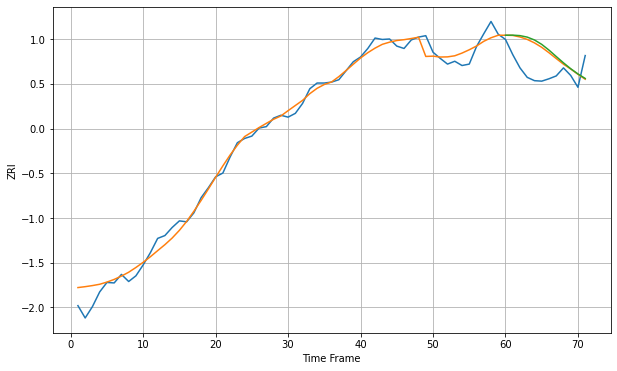

Wall time: 6.34 s
90026 17.821404752067867 51.41009381686781 54.63962428275811 [2481.94946196 2482.1076418  2481.10718542 2477.96481836 2471.91860568
 2462.61512122 2450.51970944 2436.99017425 2423.68674615 2411.19591339
 2400.24062741 2390.66662274]

Got an mse at 0.0099 in round 88 and stopped training

71 71 12


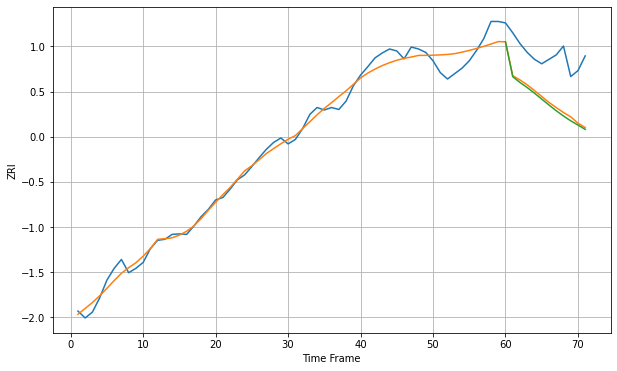

Wall time: 7.58 s
90027 18.23372018806762 93.16380955772766 97.95444611166295 [2321.57774941 2250.7576935  2238.9155568  2228.54972448 2217.12583324
 2205.15600082 2193.12344064 2181.50857567 2170.70474674 2160.95723281
 2152.35702767 2143.56152962]

Got an mse at 0.0097 in round 28 and stopped training

71 71 12


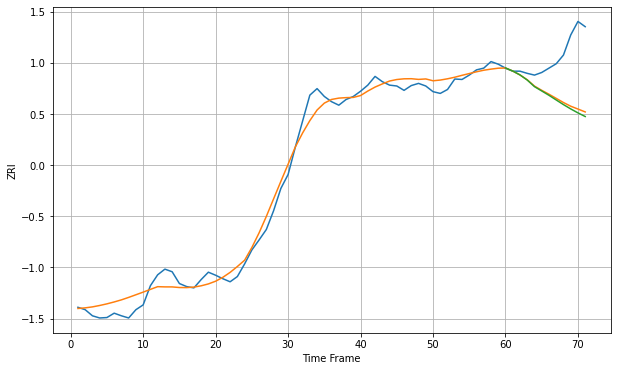

Wall time: 5.79 s
90028 22.38238374835845 103.91450710011213 108.64709288433195 [2422.26334747 2415.28970564 2406.38122412 2394.65920278 2379.51271915
 2369.62417881 2359.65642386 2348.93499051 2338.33740356 2328.42811827
 2319.35143266 2311.01364458]

Got an mse at 0.0099 in round 39 and stopped training

71 71 12


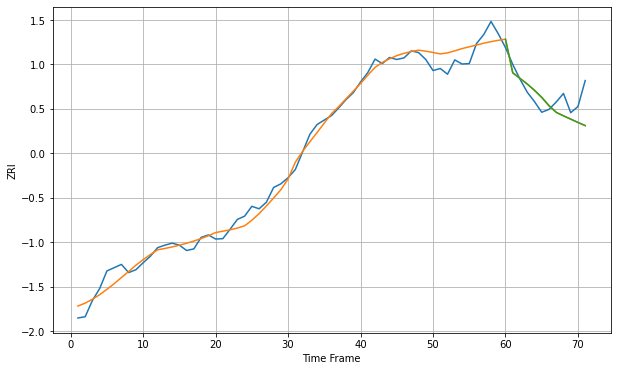

Wall time: 5.96 s
90029 21.275667476175055 41.751626965867466 41.79580568395919 [2451.64236717 2369.71941853 2355.59466281 2342.07743652 2326.91996368
 2309.70973728 2289.57139632 2272.82283707 2264.25682009 2256.15760255
 2248.09144482 2240.47585062]
71 71 12


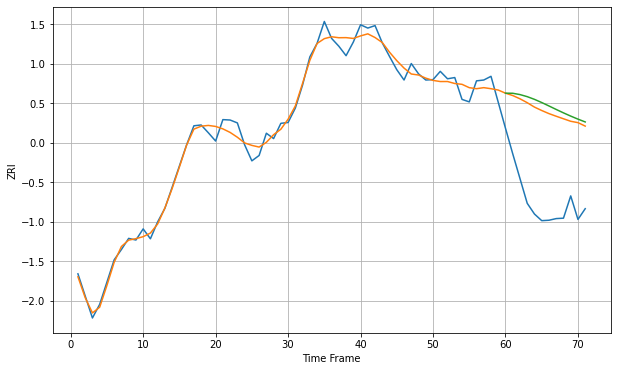

Wall time: 15.1 s
90031 19.321340523418968 219.324483350171 232.6321741672077 [2447.09916663 2446.87895971 2443.69072157 2438.67285184 2432.10809495
 2424.40484221 2416.07434902 2407.60484453 2399.35582933 2391.52636717
 2384.18673047 2377.33136999]

Got an mse at 0.0100 in round 120 and stopped training

71 71 12


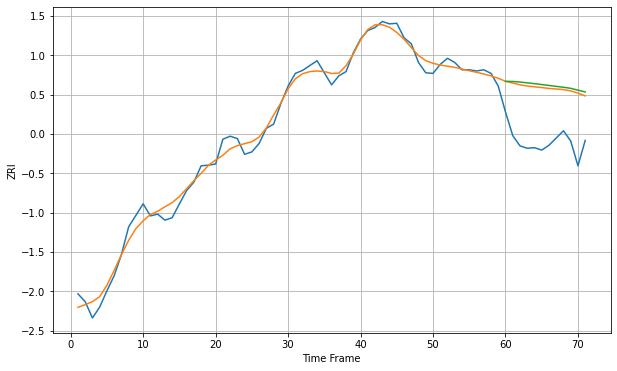

Wall time: 7.69 s
90032 12.93876951793292 90.7488707677347 95.1371965053439 [2066.8892137  2066.62561345 2065.64250936 2064.40949837 2063.0240301
 2061.55155236 2060.04251606 2058.53553357 2057.06050315 2055.26560877
 2052.2302696  2049.22909166]

Got an mse at 0.0100 in round 147 and stopped training

71 71 12


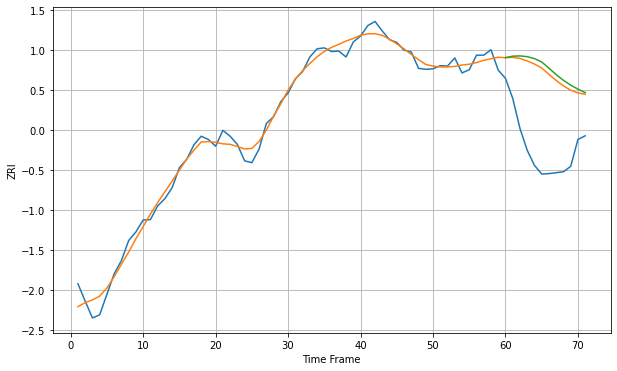

Wall time: 8.4 s
90033 17.42130597059866 169.97213498661887 179.56641657542286 [2307.48760216 2310.86803901 2311.35004175 2309.72803936 2305.4066824
 2297.99232264 2284.39172976 2270.19291838 2257.6451857  2247.20486973
 2238.44367817 2230.85255124]
71 71 12


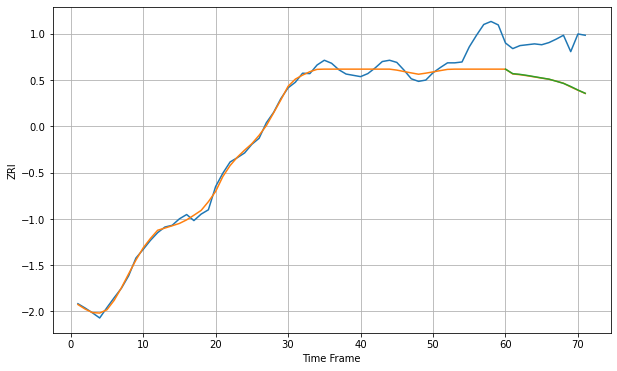

Wall time: 15.2 s
90034 28.534464936073313 91.22412734983087 90.8968858691394 [2557.3256077  2546.91148416 2545.20699029 2542.72730688 2539.85012562
 2536.8969465  2534.12465728 2529.34448261 2524.33745413 2517.12528889
 2508.88454115 2501.36426159]

Got an mse at 0.0096 in round 24 and stopped training

71 71 12


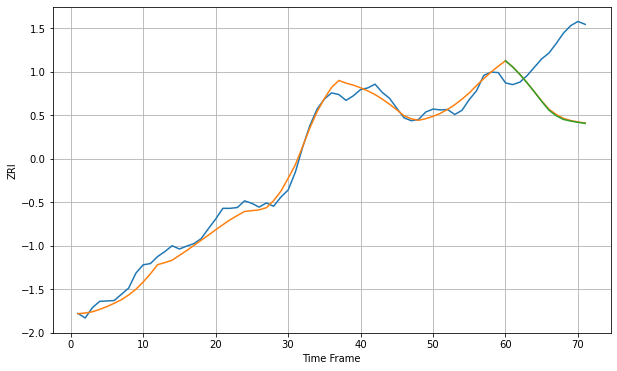

Wall time: 5.88 s
90035 19.163995025202905 151.7072923866775 152.91259370151536 [2984.4143908  2969.20278244 2951.1213961  2930.86510285 2909.06010208
 2886.47952254 2865.2934607  2851.90473707 2843.06152975 2839.14413005
 2836.04484989 2833.62869354]

Got an mse at 0.0098 in round 50 and stopped training

71 71 12


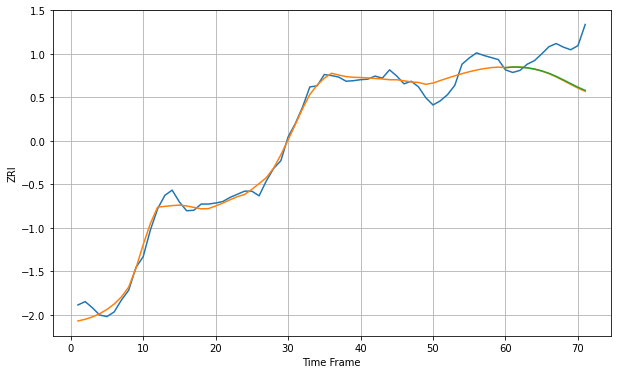

Wall time: 6.39 s
90036 16.500279875855764 58.28190230959429 57.31860906383233 [2565.3500378  2566.51399742 2566.32684088 2564.9997427  2562.5840248
 2559.04538448 2554.31015251 2548.3918274  2541.56147206 2534.37337857
 2527.40195588 2521.30544261]

Got an mse at 0.0100 in round 187 and stopped training

71 71 12


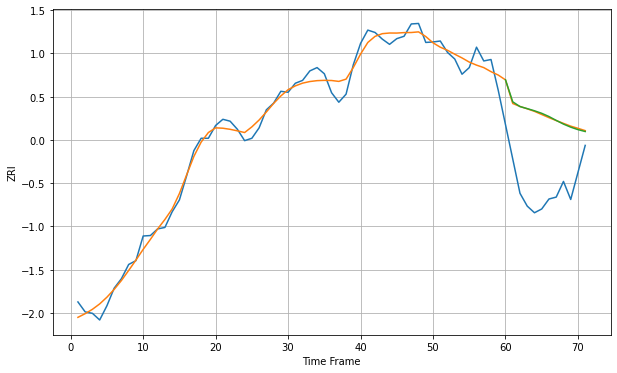

Wall time: 9.07 s
90037 18.18511751251784 154.74501060638642 155.22352553360298 [2325.10239207 2278.83450735 2268.8332324  2264.48797025 2259.94845776
 2254.59290893 2247.80276711 2239.65630119 2231.89520522 2225.45723399
 2220.24366122 2216.2352418 ]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


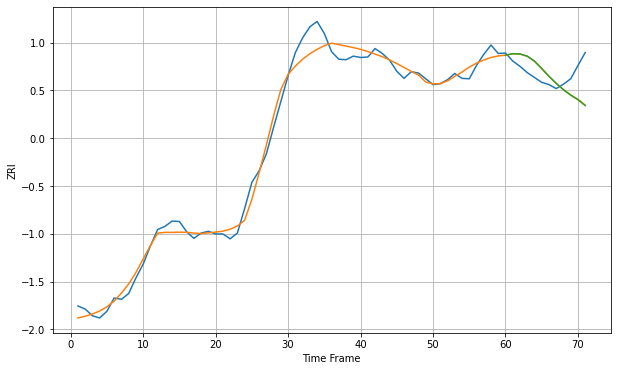

Wall time: 7 s
90038 21.264978533632462 47.0030617051949 47.32957363247372 [2432.2073926  2435.34360823 2434.95394766 2429.99608721 2418.6827445
 2402.0453096  2384.64362691 2368.78503133 2354.48924233 2342.32314701
 2332.08154644 2318.72393229]

Got an mse at 0.0100 in round 379 and stopped training

71 71 12


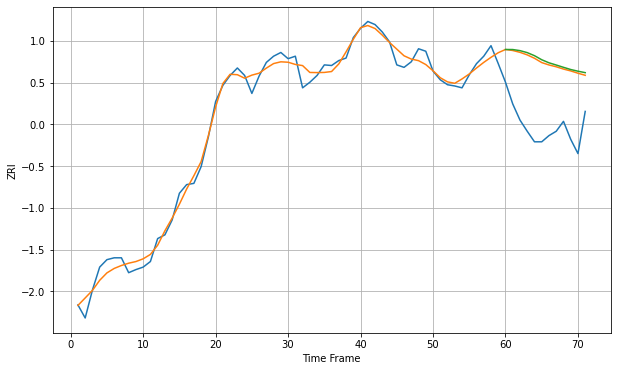

Wall time: 12.5 s
90039 13.403838224949535 106.04837053515622 109.10542429545174 [2501.82625869 2501.74672487 2499.9804201  2496.77370811 2491.83202471
 2485.28952708 2480.36087282 2476.78565487 2473.08515694 2469.5434221
 2466.82018059 2464.48189369]

Got an mse at 0.0100 in round 91 and stopped training

71 71 12


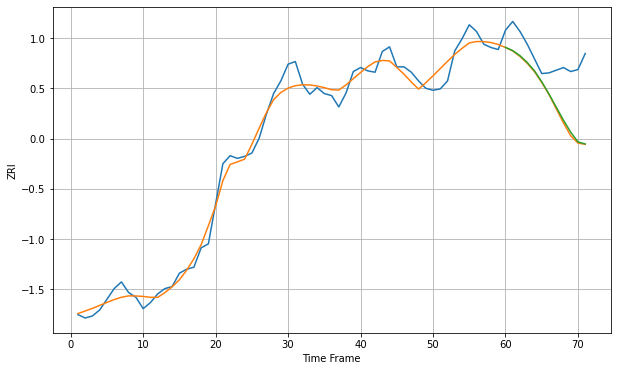

Wall time: 7.14 s
90041 14.959454187111135 68.59997255189772 66.9018478016108 [2176.12426313 2171.35786812 2163.78196493 2153.58546596 2141.02344968
 2124.69731572 2106.39357145 2086.73105355 2067.18856124 2049.20342125
 2034.70724121 2031.49326094]

Got an mse at 0.0099 in round 92 and stopped training

71 71 12


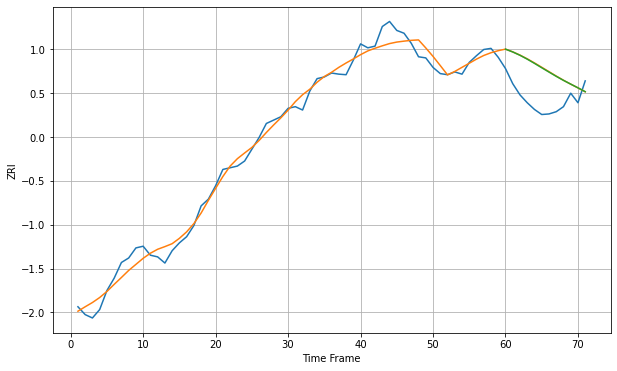

Wall time: 7.17 s
90042 15.533093114599506 59.79167667934765 59.35082308041049 [2203.63360156 2198.59319878 2192.6326976  2185.76160374 2178.23191522
 2170.42263405 2162.71927136 2155.12683881 2147.91218781 2141.23346736
 2134.59335363 2127.73229164]

Got an mse at 0.0099 in round 55 and stopped training

71 71 12


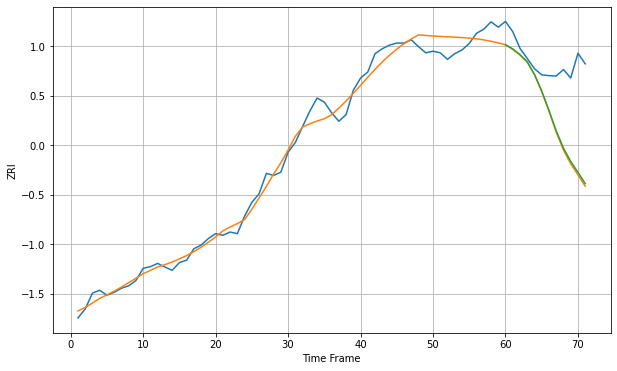

Wall time: 6.6 s
90043 23.950973389642733 157.24022471244328 153.75395824898249 [2230.81696577 2220.49073262 2206.45510181 2188.77527378 2157.80434785
 2116.9309802  2069.55749262 2019.27424324 1977.10795923 1944.41416546
 1917.56224351 1889.96583544]

Got an mse at 0.0099 in round 70 and stopped training

71 71 12


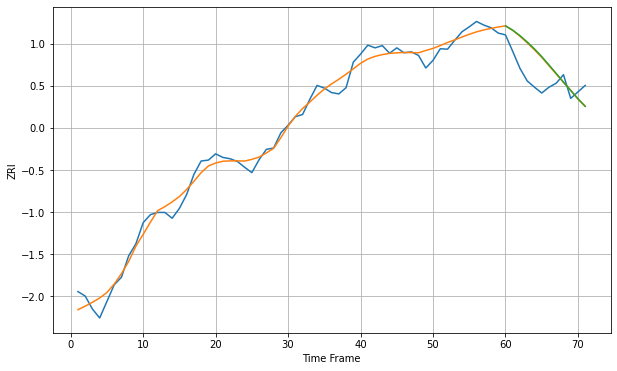

Wall time: 6.84 s
90044 18.689207412126173 53.354495077988126 54.413090547258825 [2233.15203647 2223.46856661 2211.18016337 2197.07602323 2181.63200971
 2164.42555426 2145.73002169 2126.74674091 2107.55529179 2088.59518895
 2070.25296101 2052.97846789]

Got an mse at 0.0096 in round 30 and stopped training

71 71 12


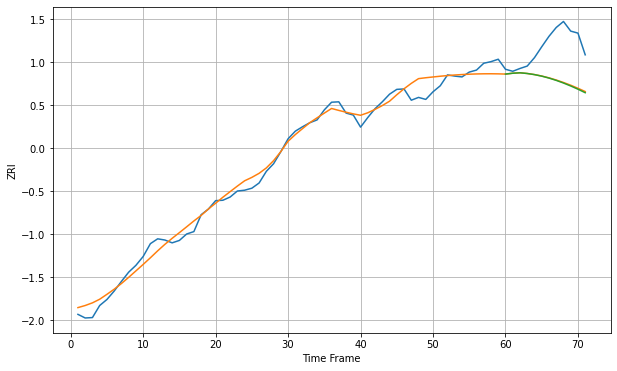

Wall time: 5.82 s
90045 20.31723076902164 93.03272792752696 94.1564508008096 [2582.06069848 2584.13067111 2585.2397146  2583.48286545 2580.70413931
 2576.90261192 2572.10615927 2566.37014031 2559.77181343 2552.41571901
 2544.44708651 2535.66737196]

Got an mse at 0.0097 in round 25 and stopped training

71 71 12


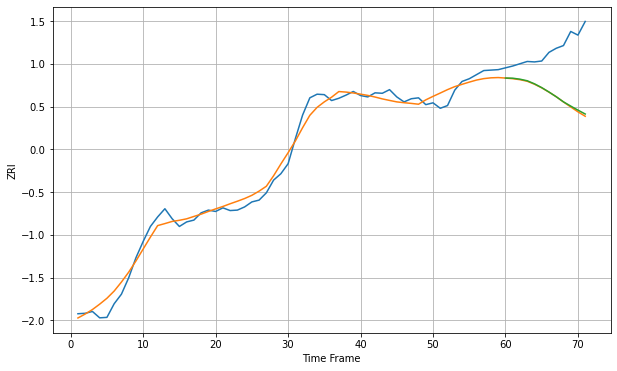

Wall time: 6.03 s
90046 17.86055250678967 109.662189216178 107.97085881856052 [2477.47943912 2477.19759771 2475.0135476  2471.5376155  2464.80933422
 2456.45783331 2446.75773255 2436.41208842 2425.12460393 2415.87220738
 2406.92327214 2398.39817055]

Got an mse at 0.0097 in round 69 and stopped training

71 71 12


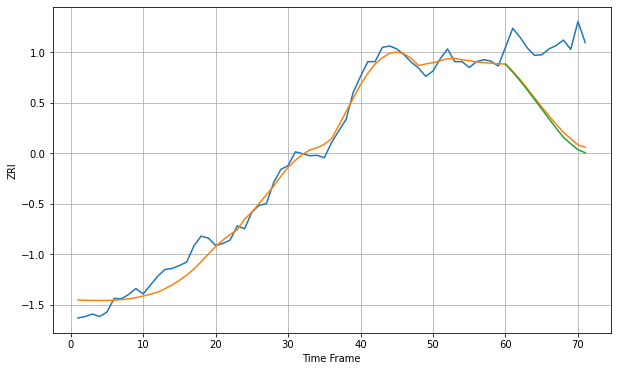

Wall time: 6.55 s
90047 19.993648023779887 148.40946462109835 155.1831732806292 [2087.05223083 2071.03335922 2053.23507471 2034.37079614 2014.89157251
 1995.29973972 1975.51567627 1955.97323091 1937.68785111 1924.41336594
 1912.34645046 1906.1829294 ]

Got an mse at 0.0100 in round 84 and stopped training

71 71 12


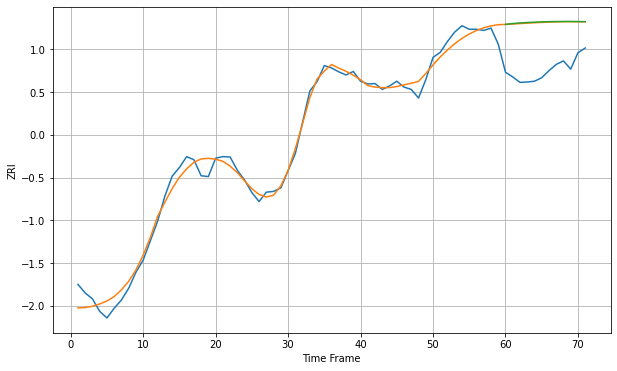

Wall time: 6.88 s
90048 21.647177318326364 123.86609052408936 124.85550286891588 [2950.48915853 2952.7337846  2954.11735716 2955.2457608  2956.1678515
 2956.89994817 2957.44538067 2957.80413021 2957.97689126 2957.96663583
 2957.77933095 2957.42429676]

Got an mse at 0.0100 in round 61 and stopped training

71 71 12


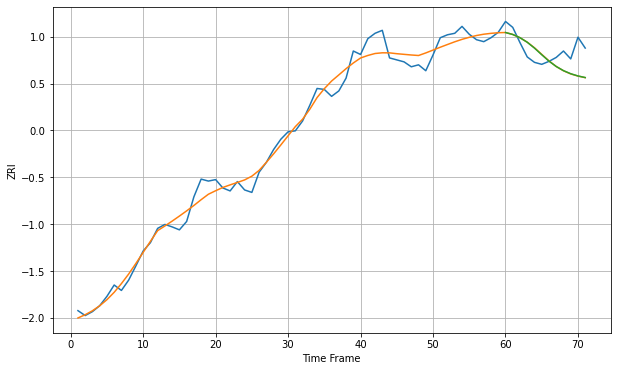

Wall time: 6.37 s
90061 18.847693886161277 36.17423244772673 35.93522180478246 [2223.57538633 2219.59278087 2213.03284615 2203.80114764 2191.89860432
 2178.45127179 2165.48639299 2154.59217624 2146.18473864 2139.94222854
 2135.3984546  2132.18870618]

Got an mse at 0.0095 in round 31 and stopped training

71 71 12


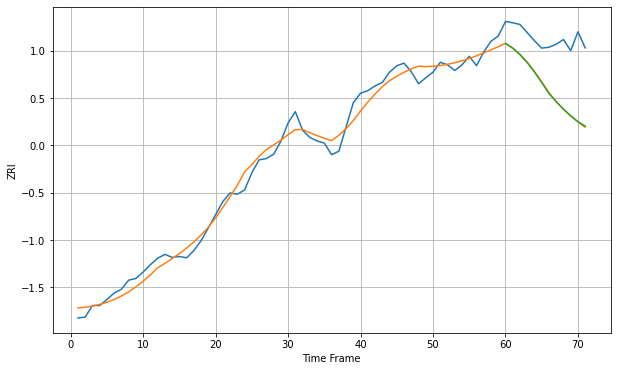

Wall time: 5.83 s
90062 20.866483541175484 123.74841381377378 123.47719548703338 [2076.00865654 2065.02819227 2050.10332254 2031.40885875 2009.37483433
 1984.92513928 1959.43029773 1940.41673594 1922.96736108 1907.40701304
 1893.89535956 1883.58996104]

Got an mse at 0.0099 in round 103 and stopped training

71 71 12


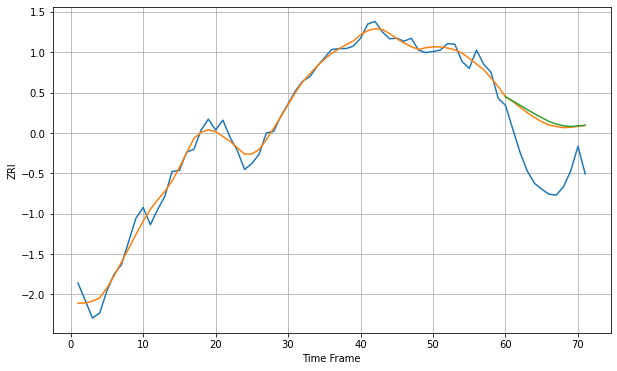

Wall time: 7.2 s
90063 16.244142986415 105.96028650899659 110.41930683519989 [2288.34606538 2280.0064752  2271.09964178 2262.41480124 2254.03975137
 2246.01987856 2238.41214574 2233.12184704 2229.63286302 2227.98455565
 2229.3095692  2230.60152787]

Got an mse at 0.0100 in round 360 and stopped training

71 71 12


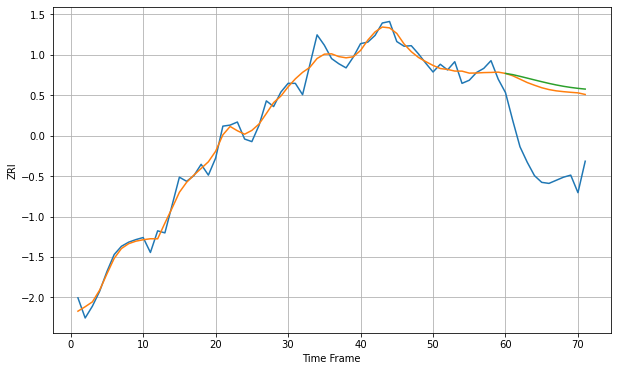

Wall time: 12.3 s
90065 15.62820453632304 154.14422147198957 163.1399613538924 [2421.24373966 2418.89480438 2415.59616104 2412.13877174 2408.63284751
 2405.17603388 2401.888122   2398.8908233  2396.27552636 2394.08083414
 2392.29219647 2390.85874548]

Got an mse at 0.0099 in round 32 and stopped training

71 71 12


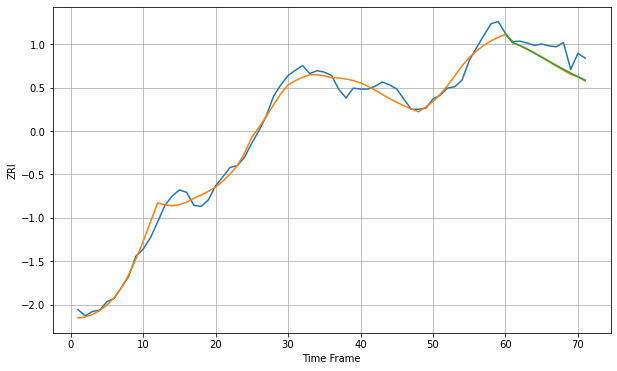

Wall time: 5.8 s
90066 18.07652787883322 32.54416052007925 31.467481716996858 [2705.75697023 2687.79367143 2681.5772461  2674.03788998 2665.83719084
 2657.20763176 2648.39489852 2639.62837487 2631.10422884 2622.96661917
 2615.29394413 2608.09599528]

Got an mse at 0.0100 in round 64 and stopped training

71 71 12


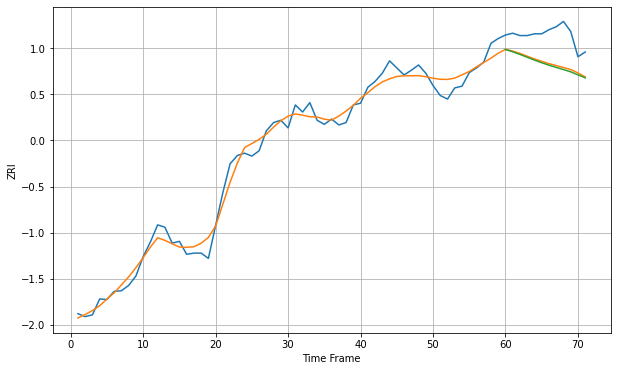

Wall time: 6.67 s
90068 15.548800015314725 48.525616817406814 50.908972354777674 [2401.53378566 2397.37361758 2392.97781507 2388.13575982 2383.29865978
 2378.77882456 2374.6572048  2370.851506   2367.22936835 2363.31021021
 2358.21534079 2353.16684356]

Got an mse at 0.0100 in round 35 and stopped training

71 71 12


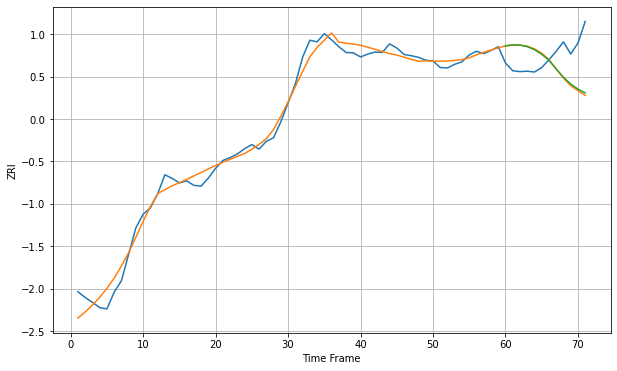

Wall time: 6.14 s
90069 20.47697884921539 81.92135874465437 79.62479610070058 [2752.16011108 2754.64225929 2754.11056225 2750.27716627 2742.8127543
 2731.44446027 2716.56534152 2695.45510946 2675.04983517 2658.6203852
 2646.08707939 2636.69671943]

Got an mse at 0.0099 in round 101 and stopped training

71 71 12


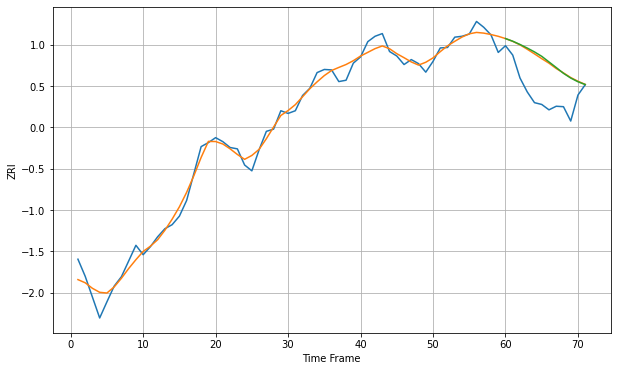

Wall time: 7.39 s
90220 18.22053464629492 77.36159002234984 79.1208158117524 [2202.86314296 2196.98881081 2189.72580254 2181.7799269  2173.14161525
 2163.29229754 2150.78578203 2138.31425619 2125.37792625 2114.86691731
 2106.59325125 2100.34354529]
71 71 12


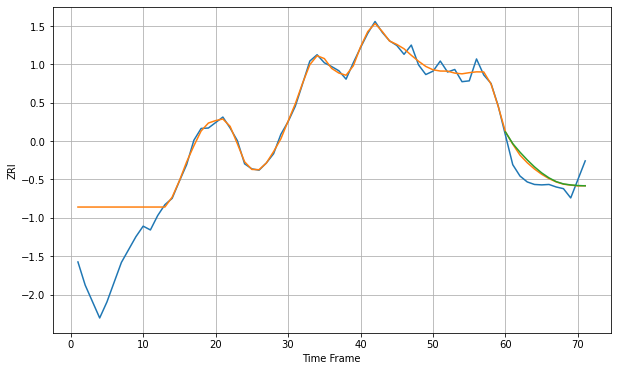

Wall time: 15.3 s
90221 70.87093112950896 34.21067775276699 36.84040215000061 [2157.57753367 2130.08084121 2109.68726585 2091.34085662 2074.74946379
 2060.40382475 2048.69210465 2039.71359233 2034.25297712 2031.88077095
 2030.47573346 2029.74330598]

Got an mse at 0.0091 in round 44 and stopped training

71 71 12


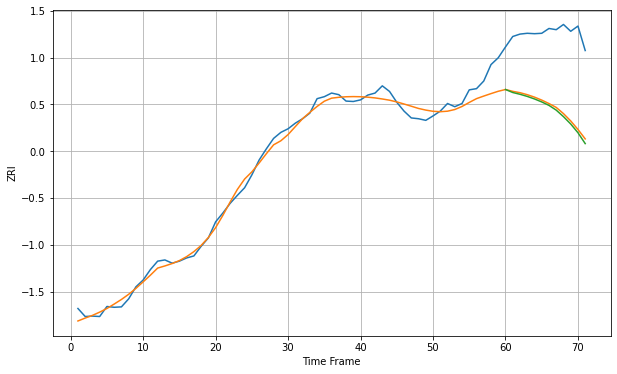

Wall time: 6.26 s
90232 20.912879659637607 185.8112724857735 191.8021342054787 [2691.89215736 2684.39078213 2679.96841876 2674.67013151 2668.32711115
 2660.88675001 2652.29161254 2640.45656288 2624.23294522 2605.87960544
 2584.10596974 2557.00048986]

Got an mse at 0.0100 in round 71 and stopped training

71 71 12


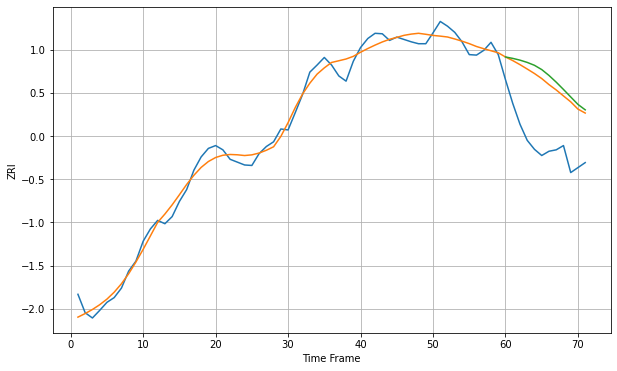

Wall time: 6.71 s
90247 18.168642253640833 127.87232163549173 140.4888885034886 [2349.02483303 2346.04714526 2342.34580826 2337.52957219 2331.41354266
 2322.42402779 2310.03804052 2295.82408931 2280.46191247 2264.63384475
 2248.86429294 2237.41525731]

Got an mse at 0.0099 in round 114 and stopped training

71 71 12


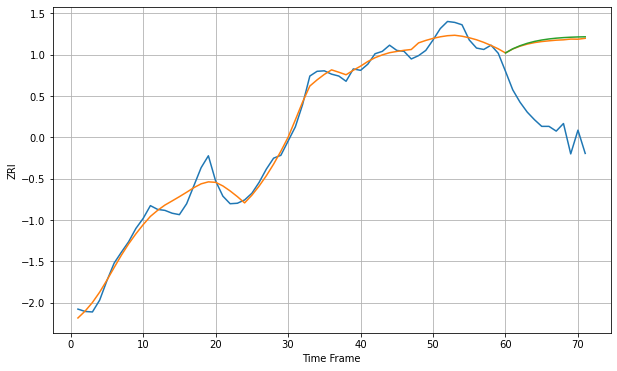

Wall time: 7.41 s
90250 17.289276336374606 172.22438231993138 175.3061837125315 [2313.66318205 2322.35331542 2328.84934846 2333.97860193 2337.93467414
 2340.92891763 2343.16103471 2344.8022461  2345.98961103 2346.82674717
 2347.38783578 2347.72301916]

Got an mse at 0.0098 in round 84 and stopped training

71 71 12


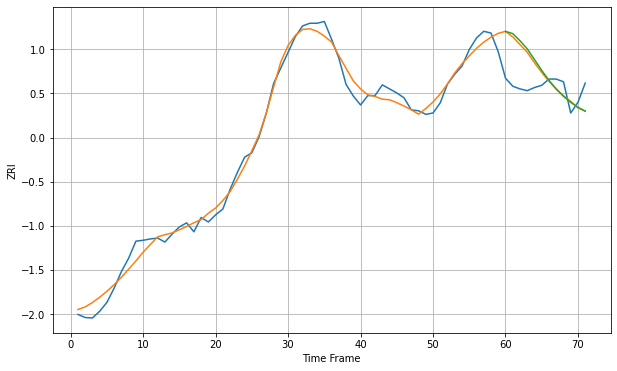

Wall time: 6.82 s
90254 19.47621510550369 64.91658395909596 68.632616752942 [2793.84439456 2788.79456552 2772.75599637 2754.62971852 2730.66532065
 2706.37827481 2684.18103465 2664.66852878 2648.34343742 2634.90639747
 2623.92358023 2614.98333156]

Got an mse at 0.0099 in round 284 and stopped training

71 71 12


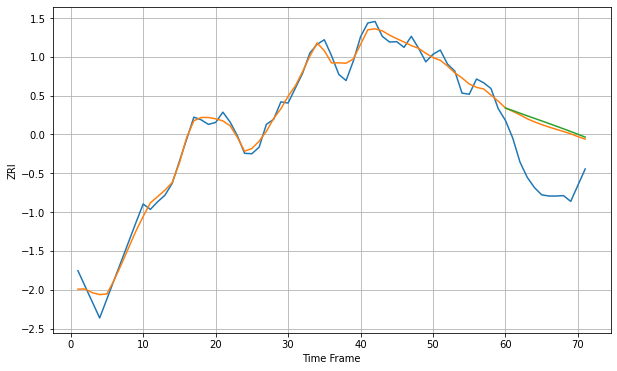

Wall time: 10.6 s
90255 20.194778370570322 145.5495915033884 152.32898584453142 [2291.83592824 2285.29245285 2278.3158635  2271.47269416 2264.73978643
 2258.02402212 2251.23720267 2244.33757277 2237.37017302 2230.26554678
 2223.00697021 2215.45089046]

Got an mse at 0.0100 in round 213 and stopped training

71 71 12


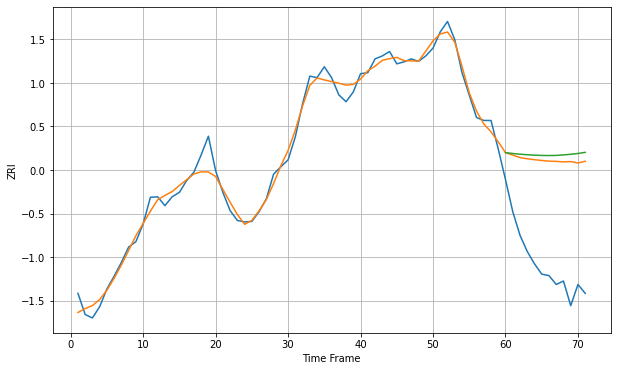

Wall time: 9.24 s
90260 17.563853298689093 217.50319670232378 229.1482867105035 [2455.66877462 2453.89860581 2452.55670942 2451.43041869 2450.56032827
 2449.99671869 2449.77686606 2450.05858994 2451.09095541 2452.34993264
 2453.96470911 2456.25643157]

Got an mse at 0.0100 in round 282 and stopped training

71 71 12


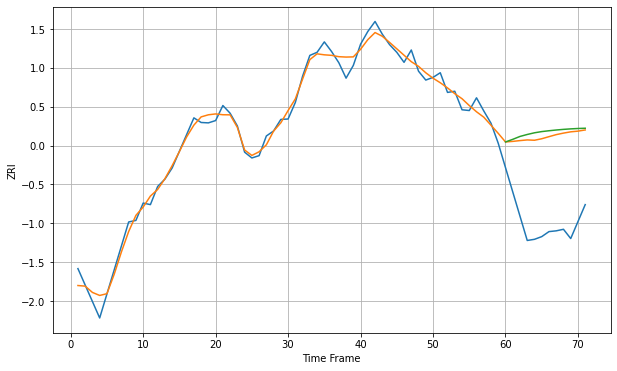

Wall time: 10.6 s
90262 20.014419123959676 225.95294417271893 237.03411432483463 [2235.54177556 2242.27092922 2249.81220354 2254.90188042 2259.27212142
 2262.37902919 2264.57202737 2266.50701865 2268.13735869 2269.42596689
 2270.39347538 2271.08728537]

Got an mse at 0.0099 in round 67 and stopped training

71 71 12


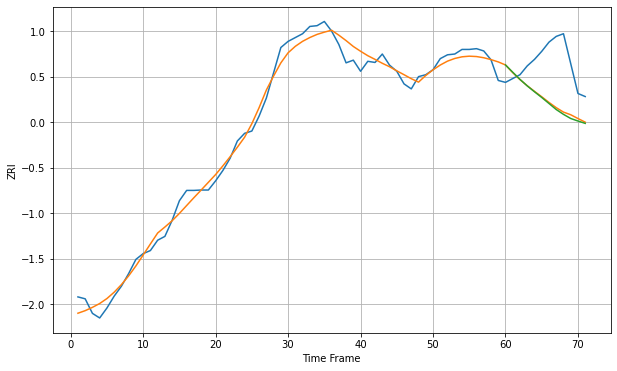

Wall time: 6.66 s
90266 23.537737132504137 113.25624713713646 116.83039638699798 [2916.4454956  2897.47828743 2878.71928581 2861.89617021 2846.46648497
 2831.59134862 2815.93910625 2800.1238343  2787.54867028 2776.70500179
 2770.12578297 2763.97739224]

Got an mse at 0.0099 in round 167 and stopped training

71 71 12


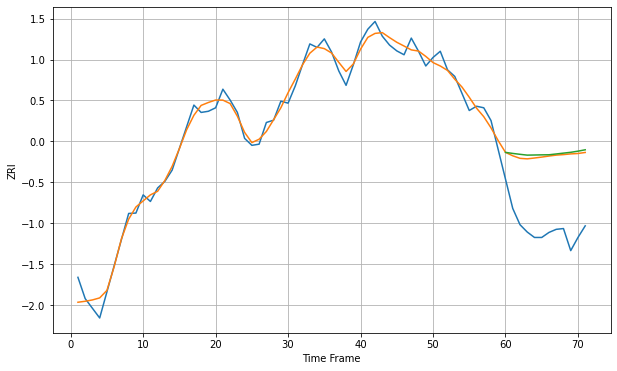

Wall time: 8.85 s
90270 21.055925541143818 189.56919571292462 195.23088709509653 [2216.821863   2214.08952586 2211.80727981 2209.70762419 2210.02443049
 2210.40476581 2210.61518895 2212.71451315 2214.86170832 2216.98712639
 2219.9363058  2223.49012688]

Got an mse at 0.0099 in round 63 and stopped training

71 71 12


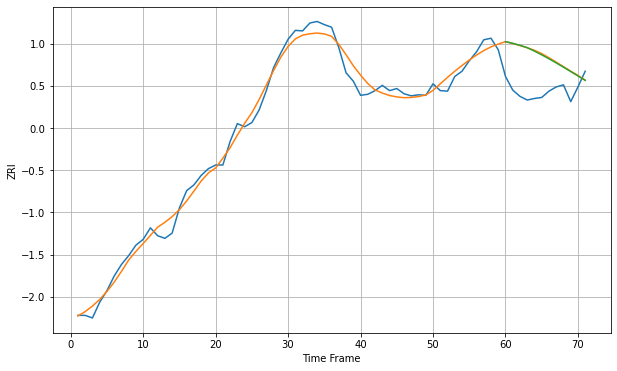

Wall time: 6.5 s
90277 15.904439644344533 69.99902187096757 69.37883476213705 [2708.45031245 2705.28042406 2701.53121494 2696.95831785 2690.36712388
 2683.26637964 2675.75681072 2667.89509235 2659.75194906 2651.41321898
 2642.9794095  2634.56098907]

Got an mse at 0.0099 in round 75 and stopped training

71 71 12


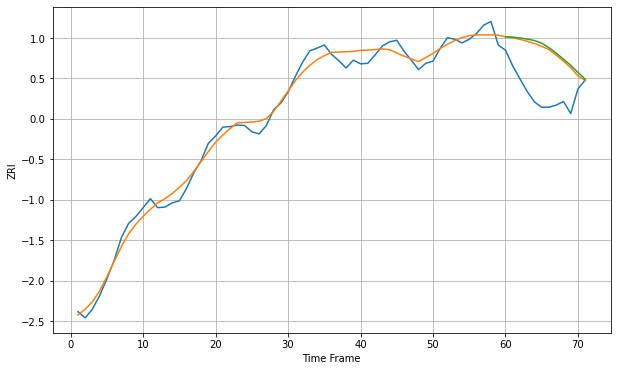

Wall time: 6.78 s
90278 15.312082501855064 81.7068747245664 85.43650532571601 [2523.57276084 2523.04411967 2521.41519386 2519.27215423 2516.55899082
 2511.38049149 2502.8467832  2492.48957606 2480.93676062 2469.21202444
 2455.50192059 2442.71291556]

Got an mse at 0.0099 in round 316 and stopped training

71 71 12


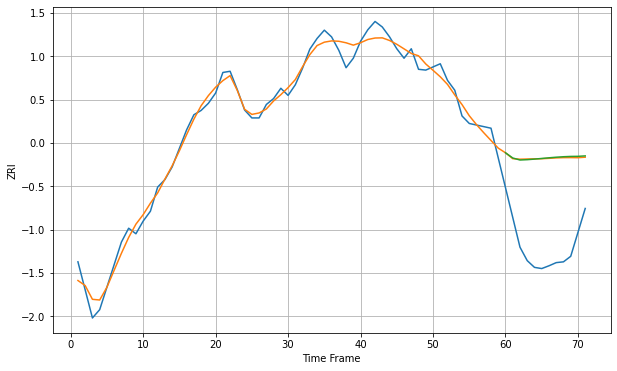

Wall time: 11.1 s
90280 21.813509810160216 228.47089642730978 229.44050626536185 [2296.81363081 2283.68843686 2278.56106714 2279.42531066 2280.83776503
 2282.47609397 2284.12938335 2285.63349455 2286.84067384 2287.61612128
 2287.86471403 2288.9494938 ]

Got an mse at 0.0100 in round 60 and stopped training

71 71 12


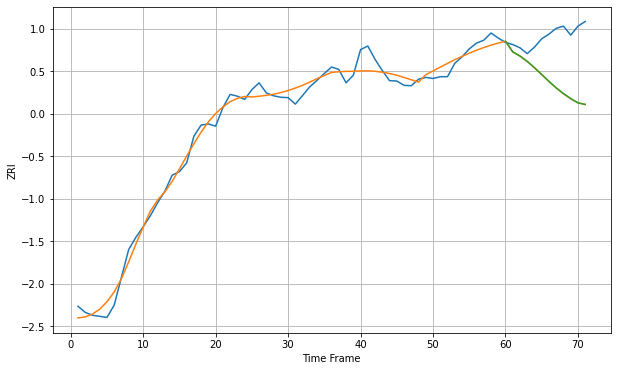

Wall time: 6.46 s
90291 23.414226650913108 136.3726083158232 136.20325362153423 [3188.16810361 3158.78935273 3147.17228249 3132.34545058 3114.9142016
 3096.01185717 3076.98147441 3059.06979993 3043.12570742 3029.33476534
 3017.3735117  3013.23529631]

Got an mse at 0.0097 in round 38 and stopped training

71 71 12


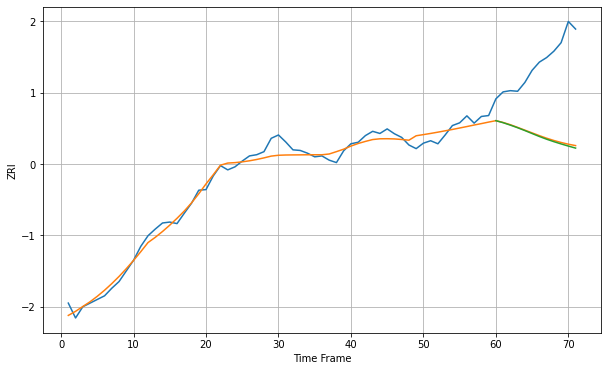

Wall time: 5.96 s
90292 22.87388100434075 249.00448806630405 252.67639869139077 [3120.1161349  3113.43234272 3105.41175298 3096.87215007 3087.50179718
 3077.74632287 3068.00998283 3059.05906145 3050.94461748 3043.47670232
 3036.44299474 3029.75567152]

Got an mse at 0.0100 in round 74 and stopped training

71 71 12


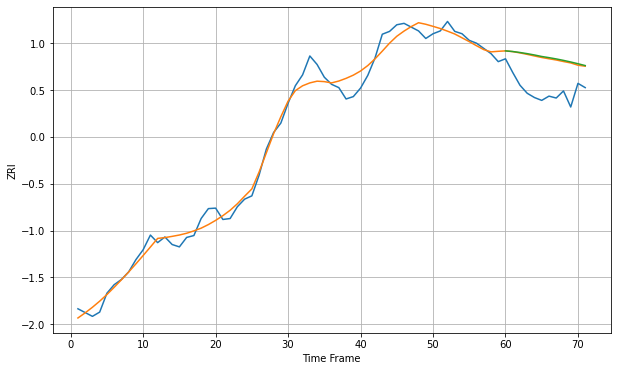

Wall time: 6.59 s
90301 19.74867607622105 69.81634851214534 71.57664145896946 [2193.74550189 2192.41119063 2190.32843723 2187.87967429 2185.07340575
 2181.90211129 2179.43909695 2176.72308156 2173.66022882 2170.26578886
 2166.58130265 2162.67562201]

Got an mse at 0.0099 in round 128 and stopped training

71 71 12


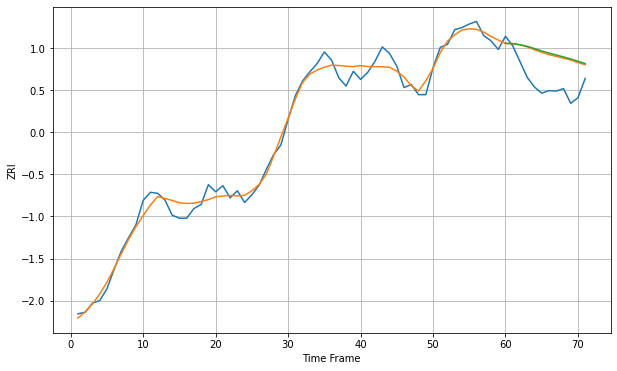

Wall time: 7.73 s
90302 16.456752178323374 59.674227522462914 61.663758531347106 [2310.93788676 2310.11047011 2308.23119795 2305.09145008 2300.62931321
 2296.05330384 2291.83703338 2288.00154056 2284.30274055 2280.14143826
 2275.74702174 2271.05589757]

Got an mse at 0.0100 in round 144 and stopped training

71 71 12


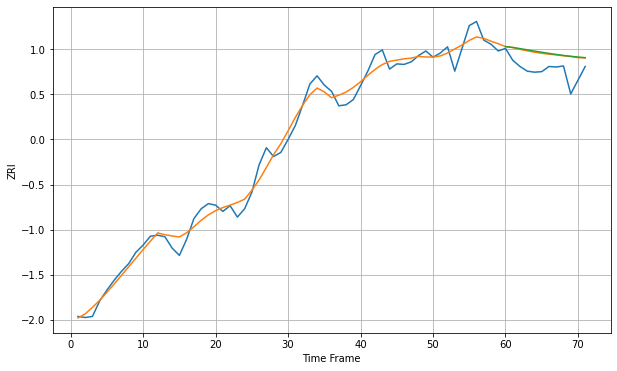

Wall time: 8.12 s
90303 17.342878831561276 35.27096167465741 36.28409233604799 [2055.43346201 2053.83527308 2051.54425156 2049.16690908 2046.78994045
 2044.47112384 2042.26892611 2040.21975202 2038.35415701 2036.69105132
 2035.23898785 2033.99847191]

Got an mse at 0.0099 in round 185 and stopped training

71 71 12


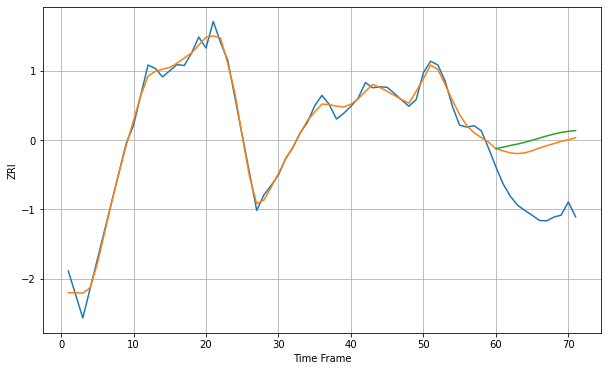

Wall time: 8.69 s
90304 14.551116560857176 129.73807010016648 147.29881151632296 [2493.50725866 2496.57932038 2500.2245265  2503.26564932 2506.88693396
 2511.1234327  2515.70044678 2520.22512748 2524.3115376  2527.66576031
 2530.12185433 2531.64186681]

Got an mse at 0.0100 in round 161 and stopped training

71 71 12


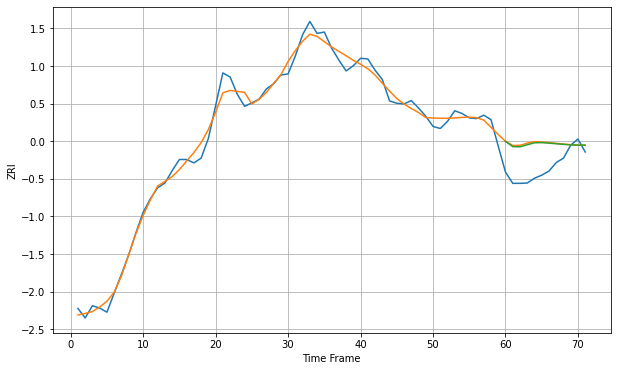

Wall time: 8.32 s
90404 21.974518180464447 81.7718273682073 79.53083223459991 [3124.31366183 3108.81290809 3108.15674525 3114.17744688 3119.9990117
 3120.43414747 3118.98590608 3117.18120554 3115.49041181 3113.92750737
 3113.10940026 3113.11910903]

Got an mse at 0.0099 in round 128 and stopped training

71 71 12


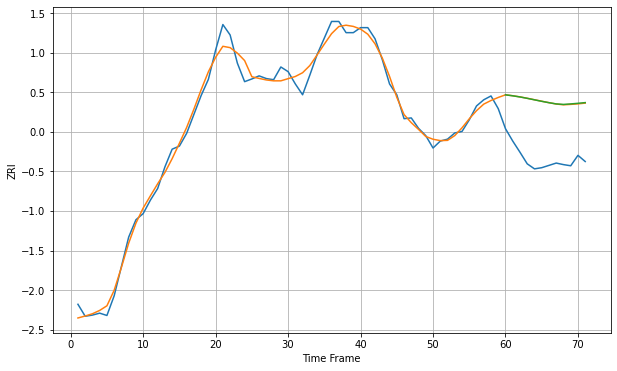

Wall time: 7.7 s
90405 20.284516276930926 150.73145450741382 151.07194181908704 [3073.8752295  3071.29679899 3068.3438649  3064.75479241 3060.87917224
 3057.03679321 3053.46110149 3050.28020825 3049.02348939 3050.29638213
 3051.88531345 3053.68554523]

Got an mse at 0.0097 in round 39 and stopped training

71 71 12


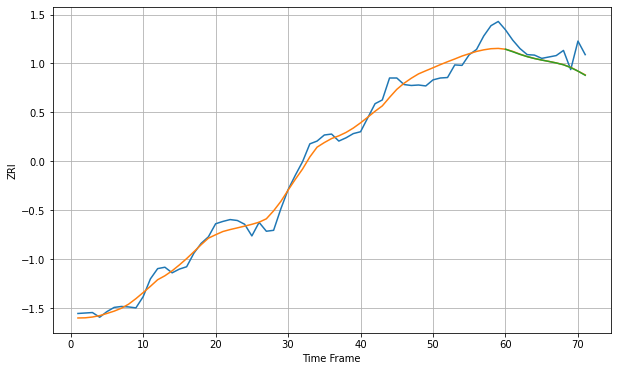

Wall time: 6.27 s
90501 20.33379051684777 28.61193445741713 28.79466413696185 [2109.58326701 2104.20120101 2098.56518616 2093.67604678 2089.68143339
 2086.38652097 2083.38460011 2080.18436914 2076.31543421 2070.25505563
 2062.76986667 2053.8233322 ]

Got an mse at 0.0099 in round 170 and stopped training

71 71 12


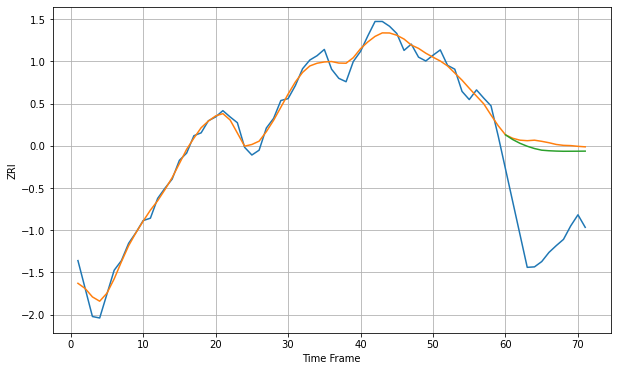

Wall time: 8.36 s
90640 17.27521762887615 198.02543199828588 186.38700576181375 [2215.81803961 2206.03280782 2198.27654493 2192.18937626 2187.41053942
 2184.02327169 2182.83975648 2182.15919576 2181.77671782 2181.8310508
 2181.91743174 2182.05982408]

Got an mse at 0.0100 in round 421 and stopped training

71 71 12


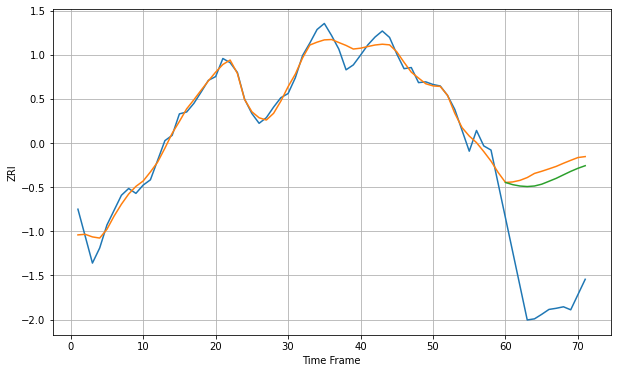

Wall time: 13.2 s
90723 23.344352558093366 339.12217454099624 313.0335249190504 [2334.94330743 2329.1333177  2325.56298249 2324.13998977 2325.61289103
 2330.39411929 2338.11183961 2345.96495192 2355.27055382 2364.44482205
 2372.61846225 2379.46571514]

Got an mse at 0.0095 in round 42 and stopped training

71 71 12


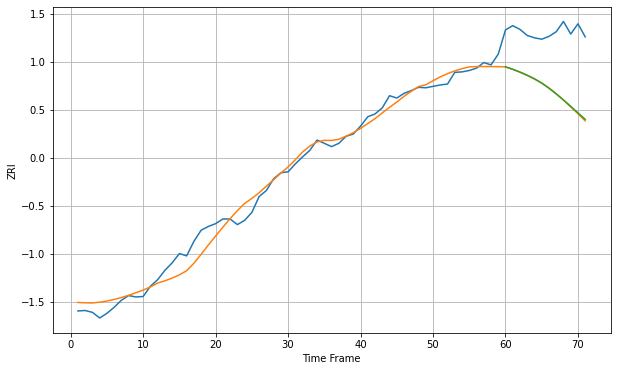

Wall time: 6.23 s
90731 19.59177612466118 128.88152545744515 128.1131056153915 [2032.80086504 2027.61969898 2021.65129697 2014.85583385 2007.15207887
 1998.17077587 1986.95878899 1974.81093707 1961.84977564 1948.2578913
 1934.31340031 1920.37197063]

Got an mse at 0.0100 in round 176 and stopped training

71 71 12


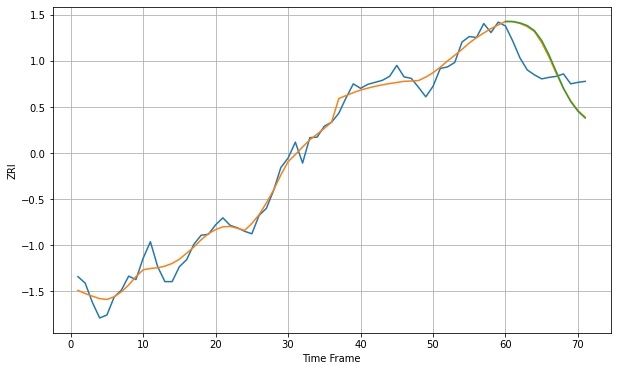

Wall time: 9.09 s
90744 18.42471760318064 56.92528493327354 58.68693540819473 [2232.24088444 2232.10610397 2229.33587543 2224.06159232 2213.76092004
 2194.12522526 2165.45927268 2131.61047319 2098.21625685 2071.50842196
 2052.11231796 2038.43883456]

Got an mse at 0.0099 in round 50 and stopped training

71 71 12


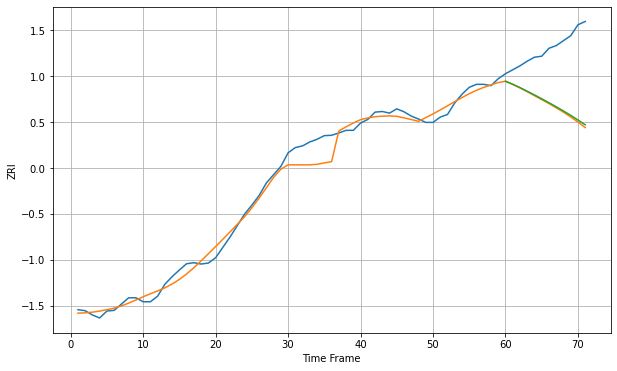

Wall time: 6.39 s
90802 27.443977099508043 183.86937205386283 180.07290155687048 [1995.40391037 1986.33681456 1976.14317059 1965.20940306 1953.97141253
 1942.33785647 1930.43263308 1918.21523718 1905.52640412 1892.25018737
 1878.33268936 1863.78915553]

Got an mse at 0.0099 in round 45 and stopped training

71 71 12


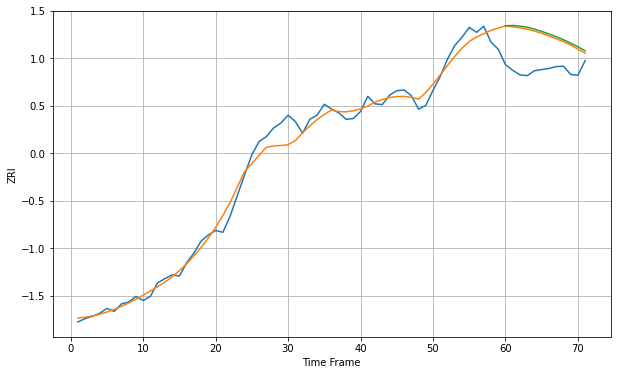

Wall time: 6.1 s
90803 24.892136746544313 92.9339817931261 97.24081306316359 [2204.28879909 2205.12424848 2203.42937723 2200.55998713 2195.40080807
 2189.33040541 2182.59842652 2175.22442874 2167.13271879 2158.22532563
 2148.4515911  2137.87557006]

Got an mse at 0.0096 in round 29 and stopped training

71 71 12


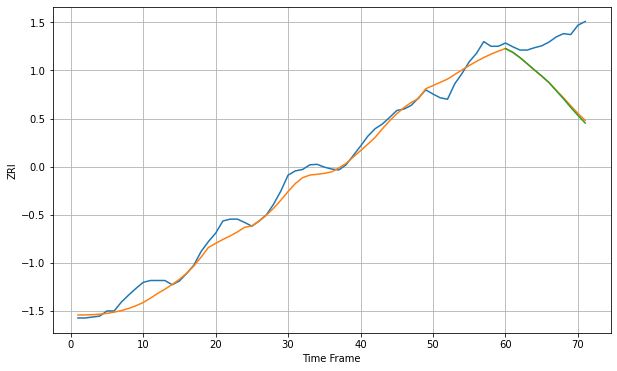

Wall time: 5.83 s
90804 19.345132025177477 111.84672949797624 114.02927101102507 [1945.19318839 1937.12893831 1925.90103007 1912.84460856 1899.50466174
 1886.60361721 1872.45933471 1855.22690831 1837.97469001 1819.66358318
 1802.36432405 1786.17803219]

Got an mse at 0.0097 in round 36 and stopped training

71 71 12


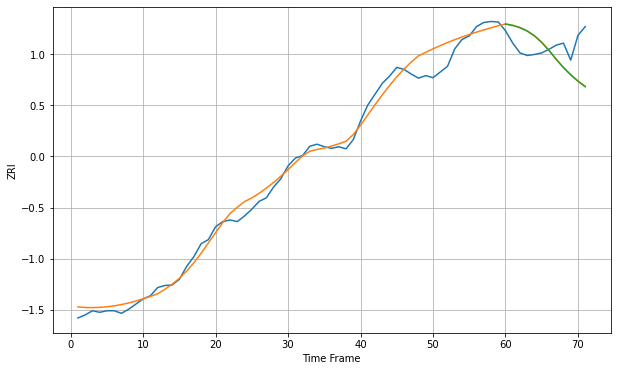

Wall time: 5.91 s
90805 18.940736639555233 52.271399808409434 52.44991024832215 [1981.07445316 1978.28683505 1973.85368107 1967.31965015 1958.00559551
 1945.3916236  1929.91600107 1912.59031932 1896.51394742 1882.5089799
 1870.20149416 1859.29582583]

Got an mse at 0.0092 in round 27 and stopped training

71 71 12


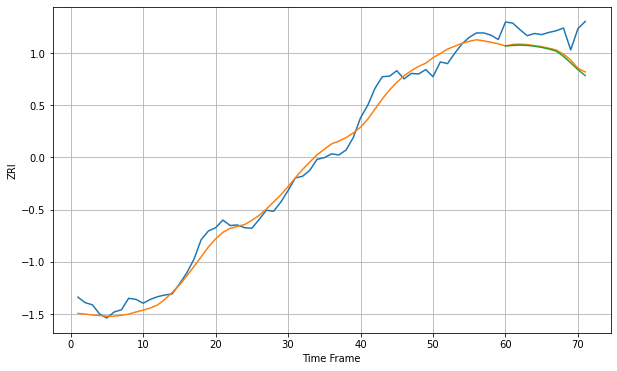

Wall time: 5.72 s
90806 17.682077513020666 44.594096502693844 47.186410405992916 [1898.2559462  1899.17290383 1899.67184349 1899.21643252 1897.82234715
 1895.58218326 1892.58451076 1888.76759262 1879.37381921 1867.34373608
 1854.9817343  1844.15678706]

Got an mse at 0.0092 in round 39 and stopped training

71 71 12


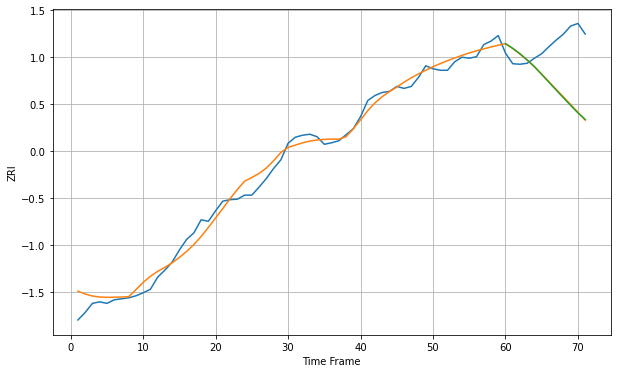

Wall time: 6.58 s
90807 17.068501284768118 99.41694715217237 99.99371650079203 [1922.8356977  1913.62716978 1902.81968742 1890.51777392 1877.06093324
 1861.70237316 1846.10814625 1830.59204079 1815.25483722 1800.03977573
 1785.32896623 1772.49075528]

Got an mse at 0.0092 in round 30 and stopped training

71 71 12


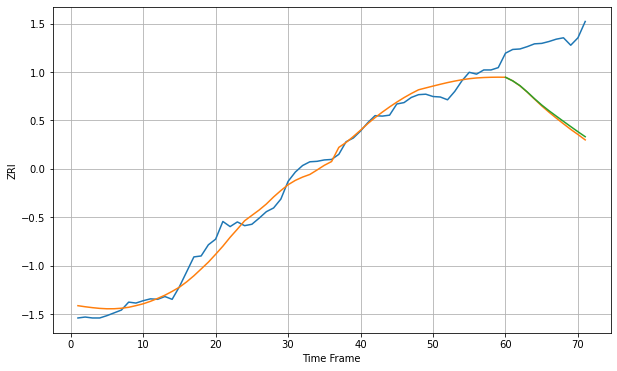

Wall time: 5.78 s
90813 19.049335309203286 152.97766281399845 149.36179965126402 [1803.30327388 1795.58138408 1785.29550339 1771.82502875 1757.37711858
 1743.7998908  1731.55144652 1720.02994733 1708.73966408 1697.5333934
 1686.49246442 1675.79579677]

Got an mse at 0.0089 in round 24 and stopped training

71 71 12


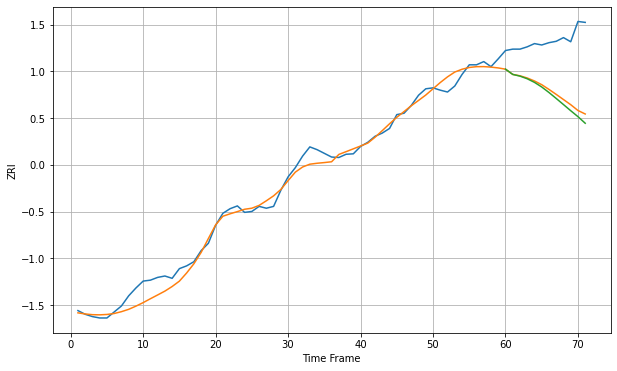

Wall time: 5.71 s
90814 17.86130766370912 116.71616201788271 125.56064182148108 [1930.54880243 1919.17218497 1915.44072404 1909.74005469 1901.90902797
 1891.91977807 1879.93926411 1866.99734234 1853.79791054 1840.47031868
 1827.56442518 1813.28081771]

Got an mse at 0.0099 in round 48 and stopped training

71 71 12


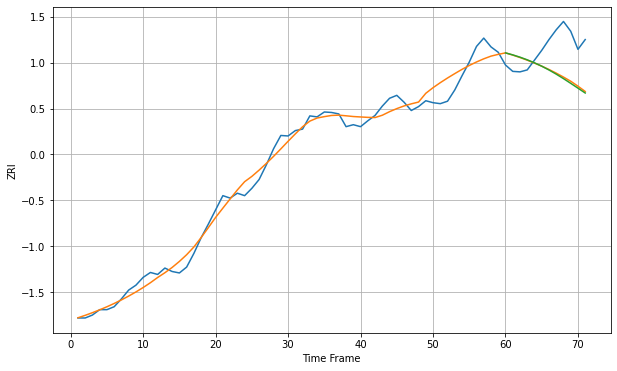

Wall time: 6.32 s
90815 18.543130452573195 68.24555237356867 70.37034527350457 [1931.78727992 1927.73312634 1923.01052861 1917.6086859  1911.47592729
 1904.563997   1896.8476544  1888.35519141 1879.19854858 1869.57302483
 1859.70629394 1849.78751843]

Got an mse at 0.0099 in round 86 and stopped training

71 71 12


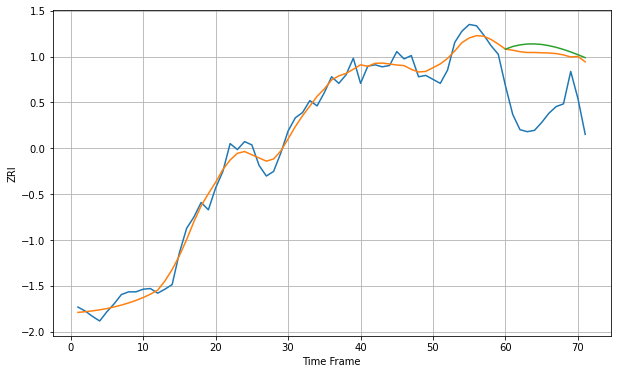

Wall time: 6.96 s
91016 13.721768038936311 92.34052920191856 100.99369359148653 [2295.70979243 2299.70626006 2302.18359794 2303.44936094 2303.60858891
 2302.75166704 2300.98240395 2298.4242281  2295.21248336 2291.47723441
 2287.32885256 2282.85426448]

Got an mse at 0.0100 in round 131 and stopped training

71 71 12


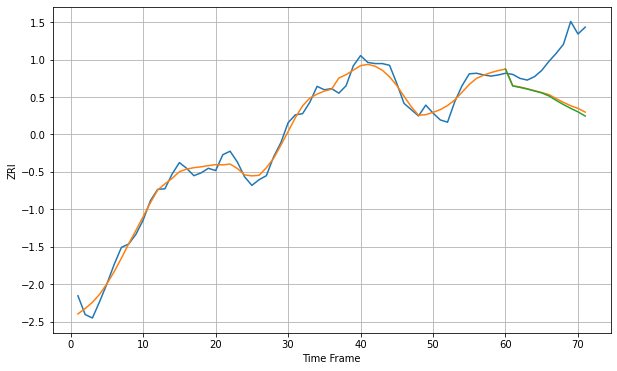

Wall time: 7.66 s
91101 13.078932629007307 83.9424097565857 87.2516561691829 [2159.3880518  2129.9540905  2127.14146623 2124.26966418 2120.90039604
 2117.44868288 2112.11568861 2104.22988777 2096.96079116 2090.33185922
 2084.21240468 2076.84606702]

Got an mse at 0.0100 in round 75 and stopped training

71 71 12


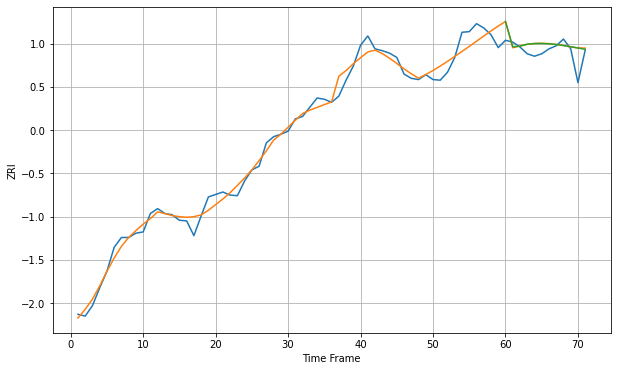

Wall time: 6.74 s
91104 14.001039123103945 21.18356863758301 21.052582746230943 [2094.57958229 2053.36193894 2054.40620364 2057.4908506  2058.6243997
 2058.77005617 2058.19642538 2057.02730763 2055.40852095 2053.48529882
 2051.38653341 2049.21667346]
71 71 12


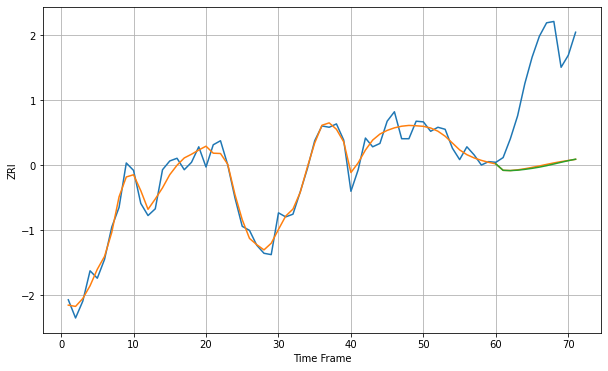

Wall time: 14.4 s
91105 13.504782842430556 146.2246494465172 147.1396114095972 [2641.60431523 2632.10601638 2631.69619263 2632.31612943 2633.5565742
 2635.0454247  2636.85508967 2639.02342439 2641.48087244 2644.03191175
 2646.45095804 2648.6056673 ]

Got an mse at 0.0099 in round 73 and stopped training

71 71 12


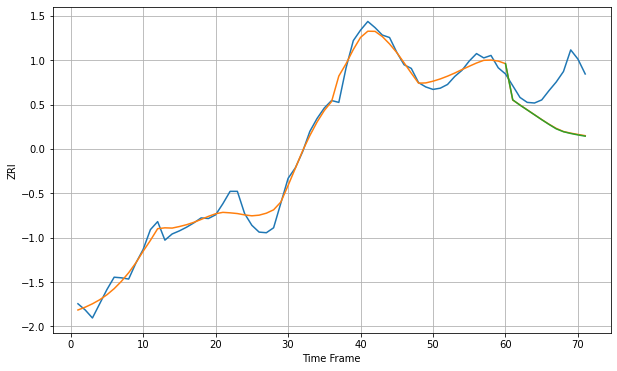

Wall time: 6.73 s
91106 14.180319167376057 72.75123715406167 73.15426920638315 [2213.69822515 2155.13343012 2146.54252663 2138.76348639 2130.91053278
 2123.00793581 2115.37759104 2108.19897541 2103.51045056 2100.69672968
 2098.33860239 2096.31422596]

Got an mse at 0.0099 in round 45 and stopped training

71 71 12


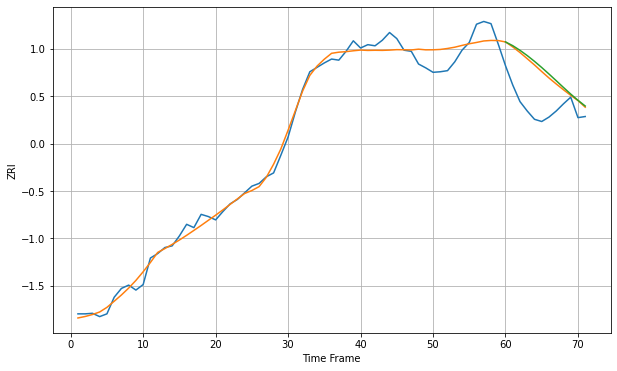

Wall time: 6.08 s
91107 16.7353648091426 64.91212354958296 69.18716551067499 [2213.95570466 2207.20815835 2198.79163103 2189.27314071 2178.8421567
 2167.67182146 2155.92930379 2143.80899353 2131.58880443 2119.64024099
 2108.35225578 2098.0432204 ]

Got an mse at 0.0100 in round 59 and stopped training

71 71 12


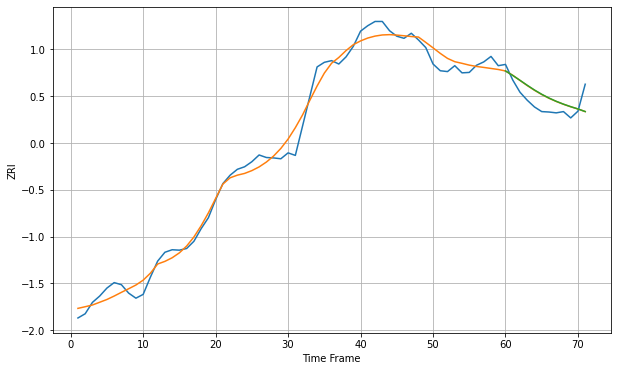

Wall time: 6.53 s
91205 22.06061164047683 32.431681067965194 32.72209331199865 [2339.44500489 2328.82193257 2317.28196757 2305.4910467  2294.25827056
 2284.10855124 2275.19389269 2267.42923159 2260.64239547 2254.65741344
 2249.3259577  2243.07548784]

Got an mse at 0.0099 in round 48 and stopped training

71 71 12


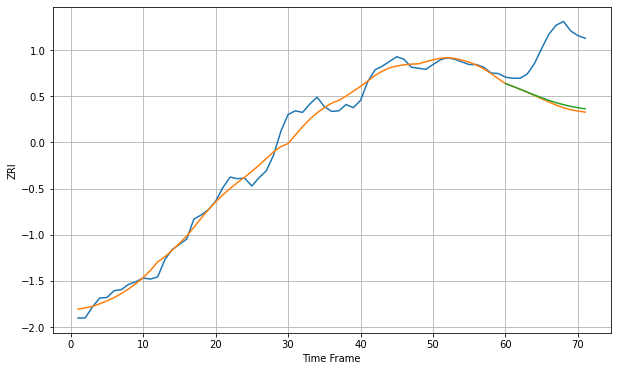

Wall time: 6.31 s
91355 17.28707709965092 109.71600278389353 105.90636079953194 [2211.78139505 2206.76038903 2201.27447332 2195.6362789  2190.05178702
 2184.72453724 2179.82869406 2175.48161888 2171.73187758 2168.56591709
 2165.92617805 2163.73144616]

Got an mse at 0.0099 in round 49 and stopped training

71 71 12


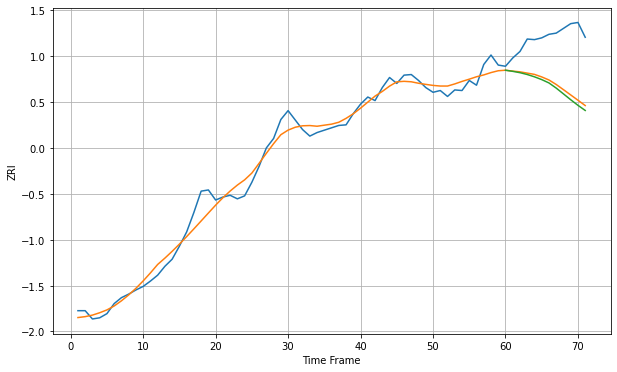

Wall time: 6.18 s
91367 15.315863834204519 82.74380389694083 88.23792031394453 [2267.29736185 2265.42287779 2263.15077933 2260.06666462 2256.15408946
 2251.44991977 2245.78848265 2237.09295665 2227.29887346 2217.42712924
 2207.99170698 2199.33139181]

Got an mse at 0.0099 in round 44 and stopped training

71 71 12


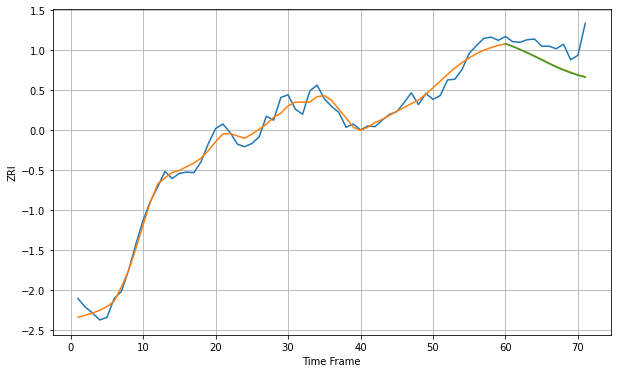

Wall time: 6.15 s
91505 12.161984288559527 32.59652472674659 33.10621827229404 [2323.72871003 2319.57222355 2314.83096858 2309.79427152 2304.32699269
 2298.72670906 2293.17379177 2287.89015155 2283.08992878 2278.90761337
 2275.36065721 2272.3687146 ]

Got an mse at 0.0099 in round 41 and stopped training

71 71 12


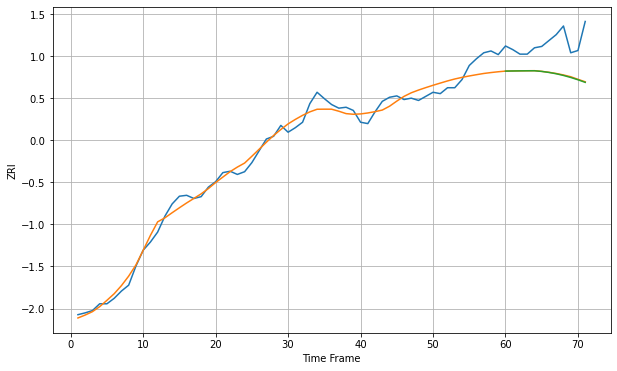

Wall time: 5.94 s
91601 18.11907665123897 71.79859584060789 72.42014232132071 [2295.66129184 2295.92180473 2296.13769274 2296.29862099 2296.38634251
 2294.91565644 2292.6693667  2289.77780292 2286.05641752 2281.63173218
 2276.53551568 2270.85605034]

Got an mse at 0.0087 in round 30 and stopped training

71 71 12


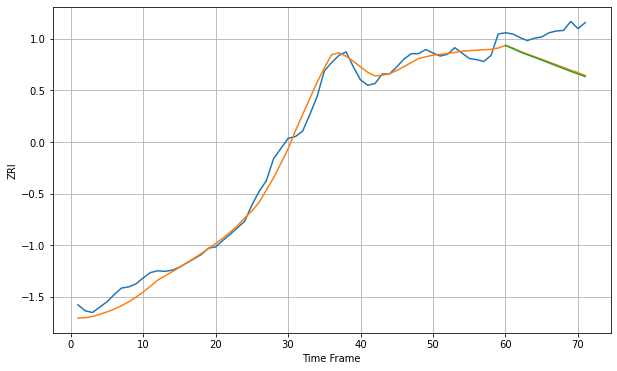

Wall time: 5.83 s
91730 15.220751001232522 53.09702182761003 54.52130505150894 [1683.85907962 1678.54058778 1673.02870671 1668.36791195 1663.9600063
 1659.32484801 1654.56159862 1649.77108292 1645.03503826 1640.41228794
 1635.93428223 1631.60536768]

Got an mse at 0.0094 in round 30 and stopped training

71 71 12


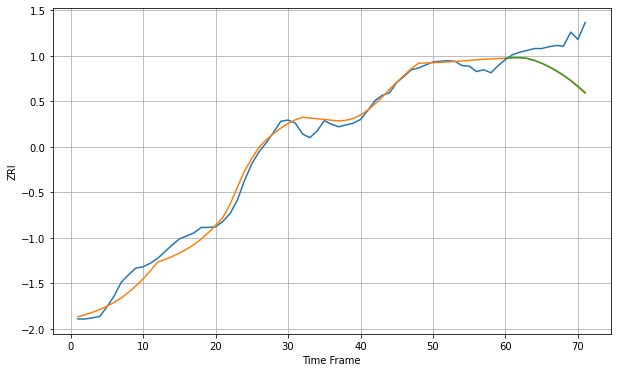

Wall time: 6.03 s
91764 13.786004630966481 52.21580607108976 51.61589418315778 [1662.83778271 1663.99964159 1664.02457915 1662.73570705 1659.41503501
 1654.7532837  1649.09854724 1642.48958468 1634.93902848 1626.43749995
 1616.96773499 1606.52527037]

Got an mse at 0.0099 in round 142 and stopped training

71 71 12


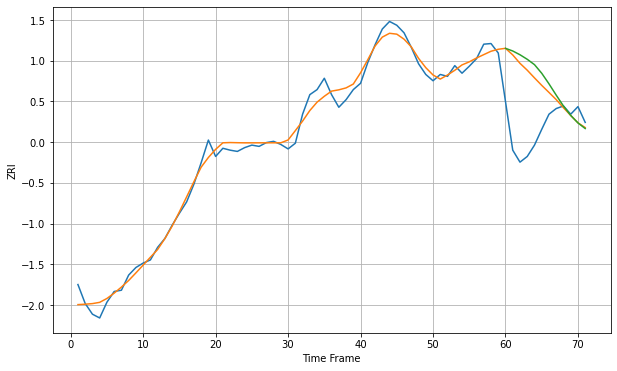

Wall time: 8.06 s
91766 12.811390002696578 87.31854950283599 96.71054414074749 [2071.43051341 2067.1909745  2061.22054012 2054.02704477 2045.54585578
 2031.87709321 2015.12646885 1997.18974321 1979.95223371 1965.0332622
 1953.1707332  1944.2527589 ]

Got an mse at 0.0100 in round 65 and stopped training

71 71 12


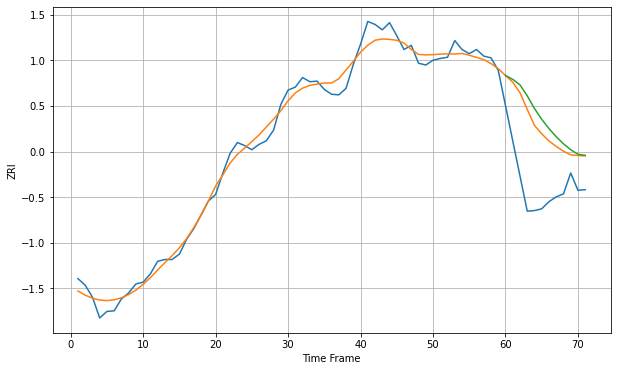

Wall time: 6.57 s
91776 15.058968167077047 102.91213647192477 117.72851496082288 [2196.55440617 2189.93555934 2180.73740142 2162.37108888 2141.03730733
 2122.97652902 2107.48549725 2093.80684021 2081.93256987 2072.06328242
 2064.40054836 2062.59506283]

Got an mse at 0.0099 in round 65 and stopped training

71 71 12


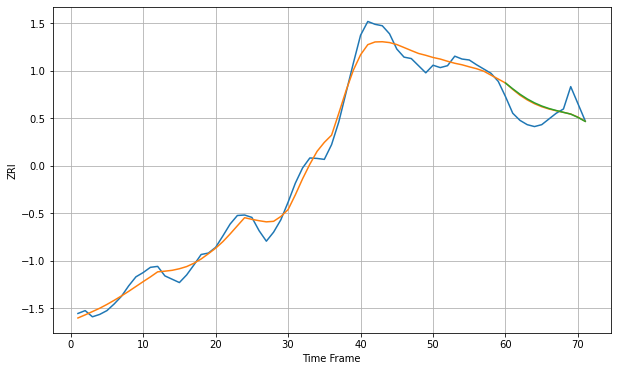

Wall time: 6.7 s
91801 19.59912139968799 37.86014584750629 38.91371084464143 [2189.59254838 2177.41453295 2166.00189739 2156.10856752 2147.87741414
 2141.23936135 2135.97439034 2131.77817108 2127.93223368 2124.24975171
 2117.23583587 2108.89445249]

Got an mse at 0.0097 in round 53 and stopped training

71 71 12


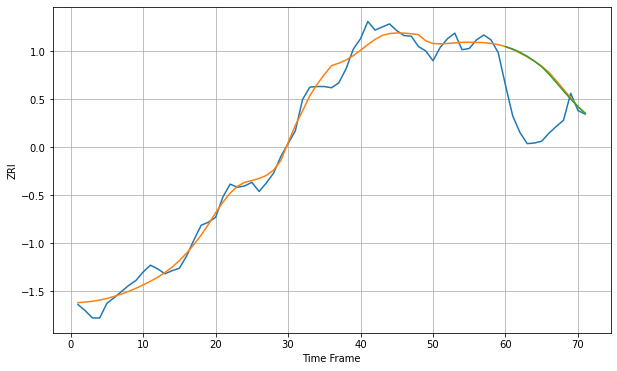

Wall time: 6.48 s
91803 15.179996724896048 92.69507721889534 92.42197498301934 [2108.03955703 2104.11185528 2098.8056509  2092.25132332 2084.30917067
 2075.18278125 2063.27622743 2049.61647749 2035.8707205  2022.60332316
 2010.34612252 1999.451741  ]

Got an mse at 0.0099 in round 90 and stopped training

71 71 12


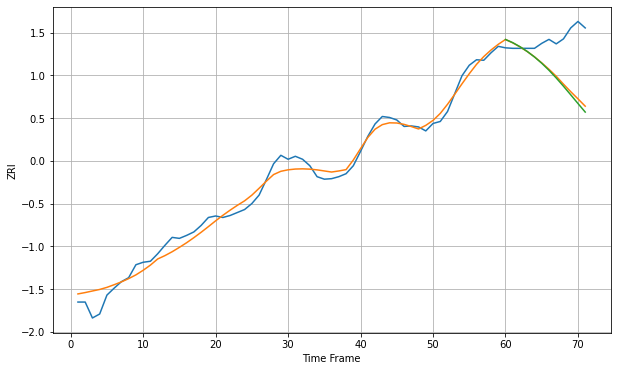

Wall time: 7 s
91913 16.8809218966665 83.5512013272039 88.41973431105762 [2259.80852993 2253.35461312 2245.24317913 2235.68778377 2224.63998603
 2212.05356337 2197.94391495 2182.44839997 2165.8576244  2148.58645468
 2131.10411676 2113.89150159]

Got an mse at 0.0097 in round 51 and stopped training

71 71 12


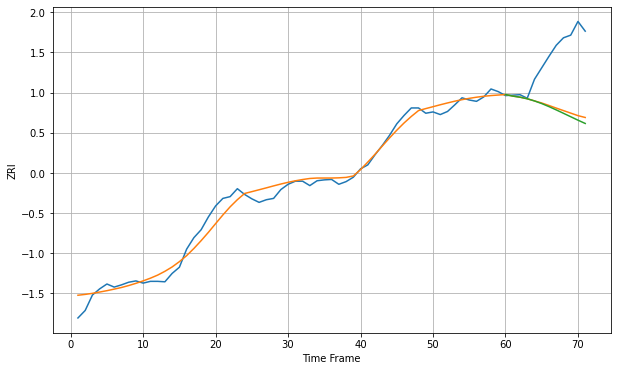

Wall time: 6.65 s
92008 17.700884681309045 123.74314220810106 129.3355060535738 [2047.40084731 2043.89050084 2041.41188901 2037.79252784 2032.90488371
 2026.90619606 2020.02165025 2012.5790351  2004.87396631 1997.08740363
 1989.28680561 1981.83953819]

Got an mse at 0.0095 in round 32 and stopped training

71 71 12


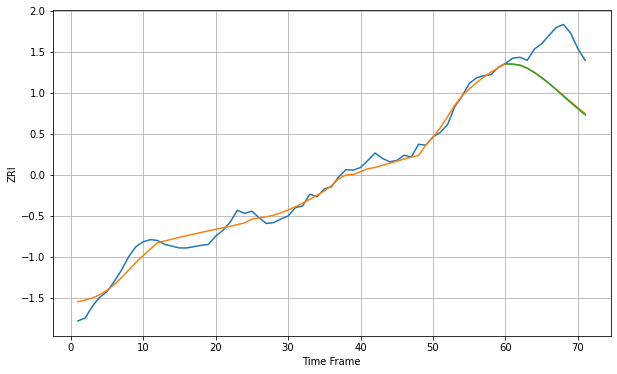

Wall time: 5.95 s
92101 18.121038931849213 102.28513394833318 103.40940997786345 [2339.01941001 2338.2245054  2335.94474328 2329.10043886 2319.11342498
 2307.48507138 2294.43976408 2280.02503515 2265.07259467 2250.22726828
 2236.05097011 2222.19500786]

Got an mse at 0.0098 in round 39 and stopped training

71 71 12


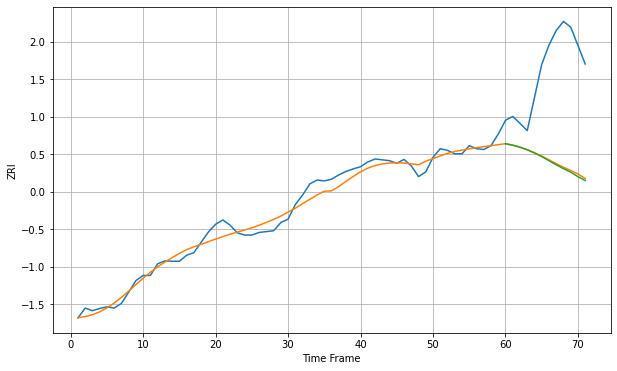

Wall time: 6.07 s
92103 17.008200050870865 228.8876562928213 231.5289553165889 [1992.47855875 1989.00425659 1984.32245123 1978.33040179 1971.02575598
 1962.48543341 1952.97849403 1943.46142408 1934.50841787 1926.33478103
 1915.77729443 1906.83854399]

Got an mse at 0.0094 in round 36 and stopped training

71 71 12


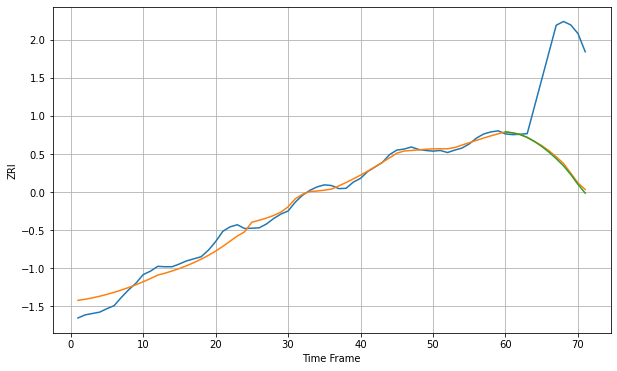

Wall time: 5.96 s
92104 20.388478762228278 285.88776726216224 290.05145840437206 [1817.96549975 1815.1202528  1810.52205995 1801.87375296 1789.92491785
 1775.63899707 1759.0301725  1740.16854051 1719.52132504 1694.25832194
 1665.27894006 1639.9603968 ]

Got an mse at 0.0092 in round 30 and stopped training

71 71 12


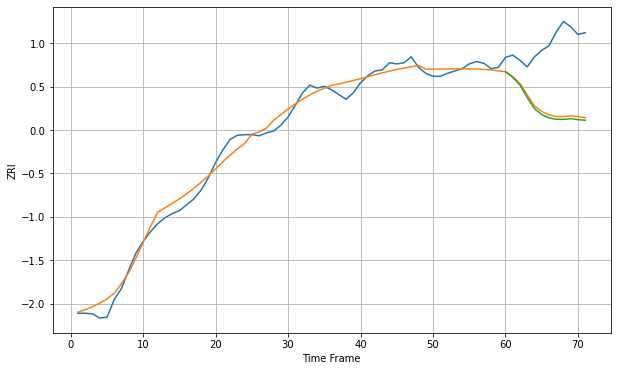

Wall time: 5.85 s
92108 13.649985819511391 110.63565439274807 114.66693163264466 [1976.77648889 1967.2329571  1954.0991169  1933.04458145 1914.10606949
 1904.1263787  1898.46472315 1896.04171858 1895.91513624 1897.19256208
 1895.46678257 1894.41151187]

Got an mse at 0.0083 in round 42 and stopped training

71 71 12


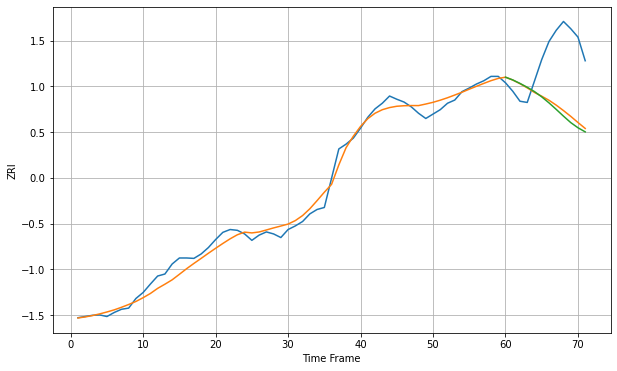

Wall time: 6.05 s
92117 18.575714227407577 141.66892161644984 149.81948144138602 [2185.98838376 2179.1756022  2170.45481084 2160.85091411 2150.08178536
 2136.90337739 2121.95641598 2105.66173231 2088.86345443 2072.79658908
 2059.86044558 2049.59756129]

Got an mse at 0.0098 in round 59 and stopped training

71 71 12


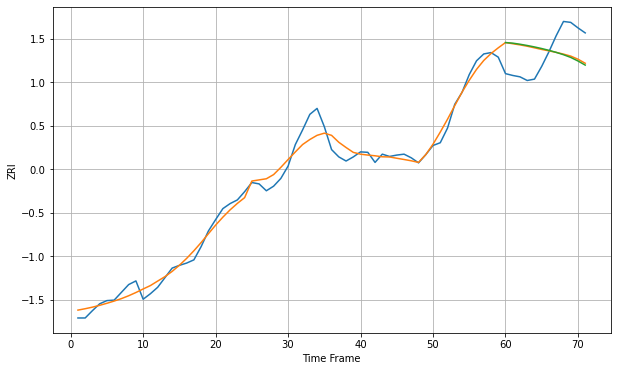

Wall time: 6.34 s
92122 18.66062194288626 62.49575082925331 64.32259915129042 [2479.90644045 2478.60213219 2476.26201733 2473.47753606 2470.32163015
 2466.80915382 2462.89204819 2458.46059023 2453.3609908  2447.42508692
 2439.60553536 2430.64482392]

Got an mse at 0.0096 in round 38 and stopped training

71 71 12


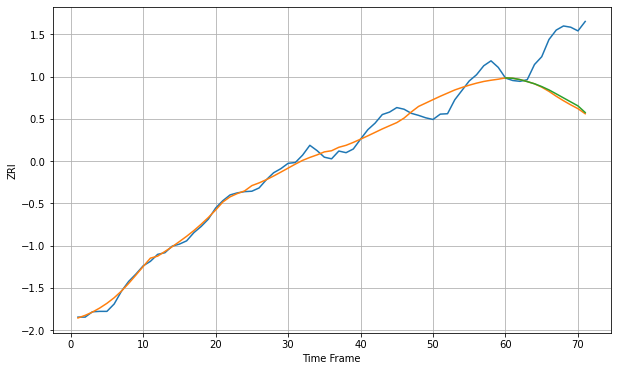

Wall time: 6.18 s
92123 19.847040777771458 130.87393053662188 126.98573656451406 [2260.39987138 2259.4965436  2256.15029462 2251.34082071 2246.06214721
 2239.25518485 2231.10402809 2221.46605616 2211.66981228 2201.85897834
 2192.09902768 2176.01524201]

Got an mse at 0.0096 in round 30 and stopped training

71 71 12


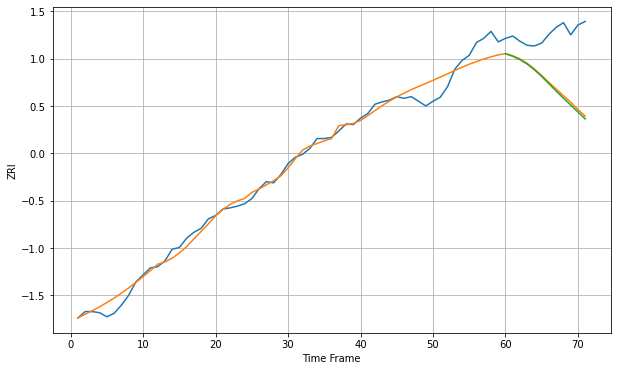

Wall time: 6.14 s
92126 15.479906997317567 92.6963961655683 95.64039488499586 [2059.78718548 2055.23233275 2049.45611476 2041.76855236 2032.04621027
 2020.52453681 2007.99894465 1995.44231704 1983.30178937 1971.44791117
 1959.63182955 1947.78383156]

Got an mse at 0.0098 in round 36 and stopped training

71 71 12


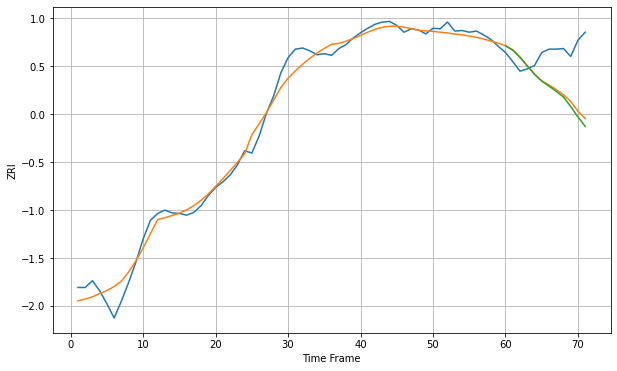

Wall time: 5.99 s
92128 16.755394404880903 73.83247176697765 79.27210812179612 [2172.14958393 2164.17261044 2151.46262221 2136.16984351 2121.6061524
 2109.39558328 2100.58588974 2091.26896321 2081.28651599 2064.28346767
 2045.82852702 2029.24417244]

Got an mse at 0.0098 in round 50 and stopped training

71 71 12


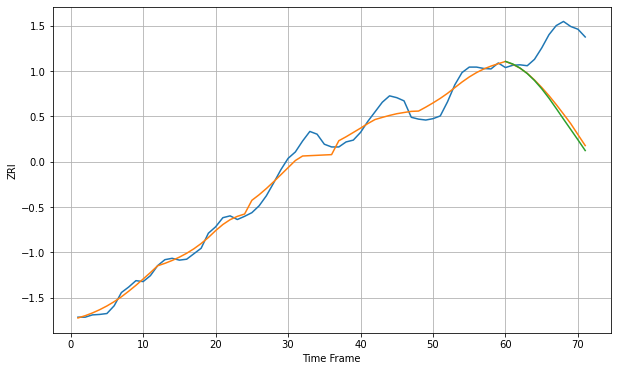

Wall time: 6.4 s
92130 19.516961685873383 145.5677903431274 152.8622709749572 [2590.43285571 2584.81918555 2575.94245417 2563.92435818 2548.70344929
 2530.49166298 2509.85678808 2487.2982584  2464.135186   2441.37293942
 2418.55423028 2395.17162336]

Got an mse at 0.0100 in round 88 and stopped training

71 71 12


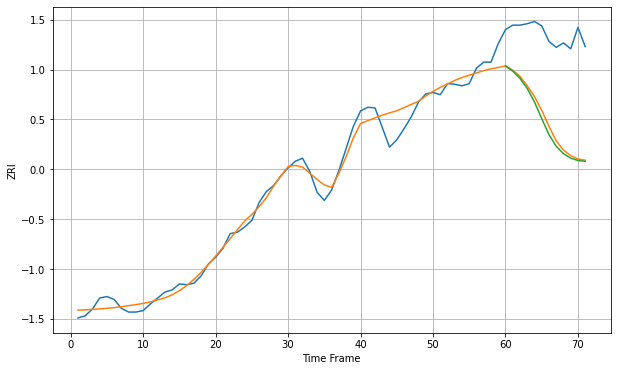

Wall time: 7.05 s
92410 13.309172318854364 118.20599904583813 122.91837963911195 [1277.93978235 1270.78769767 1261.09596096 1247.3822325  1229.08677505
 1206.56732306 1184.96827464 1169.10510568 1159.22634555 1153.19077118
 1149.92750255 1148.85590072]

Got an mse at 0.0096 in round 24 and stopped training

71 71 12


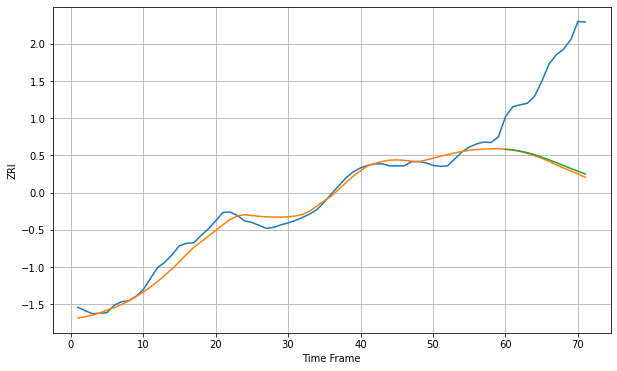

Wall time: 5.8 s
92507 14.204790584554297 199.14578721336395 195.57954014021306 [1452.44708182 1450.97112976 1448.80225366 1445.67545795 1441.418439
 1436.55430637 1431.19784985 1425.50564863 1419.65700674 1413.82276431
 1408.13376322 1402.66749034]

Got an mse at 0.0099 in round 68 and stopped training

71 71 12


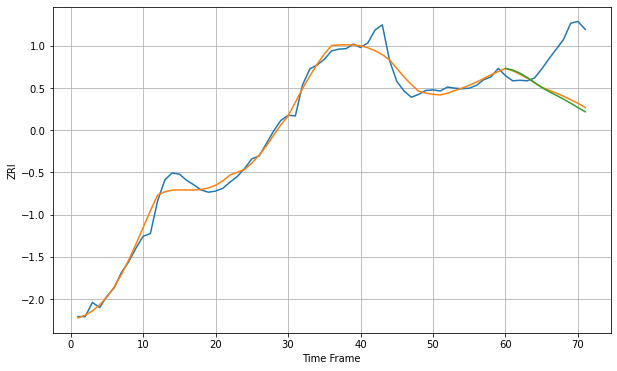

Wall time: 6.59 s
92602 14.778115978325228 81.26043053851653 85.37445054409103 [2486.00675835 2483.0756396  2477.45780555 2469.88263721 2461.10395998
 2452.23491687 2444.93213296 2438.47757261 2431.67761274 2424.36904997
 2416.7363548  2409.21703408]

Got an mse at 0.0100 in round 112 and stopped training

71 71 12


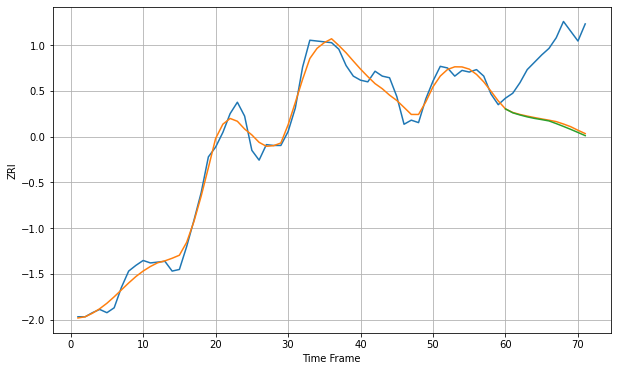

Wall time: 7.31 s
92603 11.178268249200839 88.54758846162784 90.37651112518193 [2880.75577582 2876.03060615 2873.36713855 2871.04549902 2869.18569394
 2867.68297784 2866.07185489 2862.80803832 2859.34368224 2855.72465007
 2851.93605794 2848.03855133]

Got an mse at 0.0100 in round 61 and stopped training

71 71 12


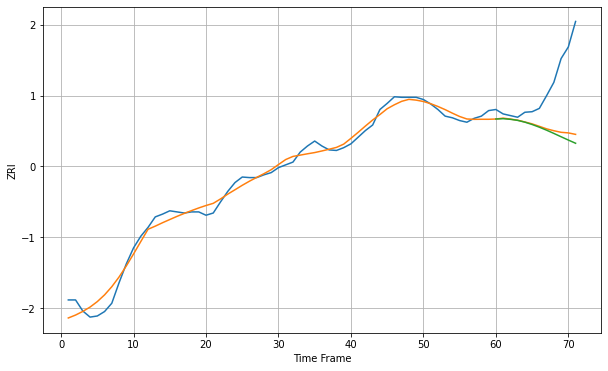

Wall time: 6.42 s
92612 12.649865381441728 89.87655211530375 96.39546975537742 [2394.80380718 2395.41337793 2394.25953303 2392.34104459 2389.11222125
 2384.88741765 2380.00844184 2374.59011534 2368.78335205 2362.74914888
 2356.78446386 2350.99686649]

Got an mse at 0.0094 in round 26 and stopped training

71 71 12


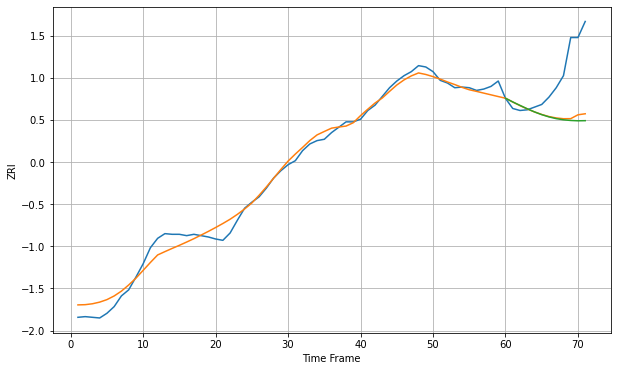

Wall time: 5.79 s
92618 11.950094415161004 67.3798290493284 71.05762841145273 [2101.32004383 2095.742269   2090.59840299 2085.5687612  2080.89017925
 2076.78337053 2073.4077127  2070.846716   2069.09944802 2068.07311155
 2067.58752775 2067.78433432]

Got an mse at 0.0100 in round 348 and stopped training

71 71 12


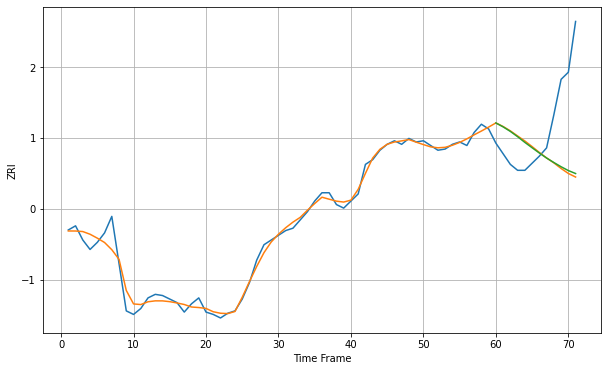

Wall time: 11.7 s
92620 5.971879106394739 54.316513180723966 53.079780417421496 [1934.09794137 1930.76316706 1926.92406457 1922.46081413 1917.63148379
 1913.09941468 1908.63312394 1904.3796991  1900.60055174 1897.01701799
 1893.7819276  1891.28653865]

Got an mse at 0.0094 in round 29 and stopped training

71 71 12


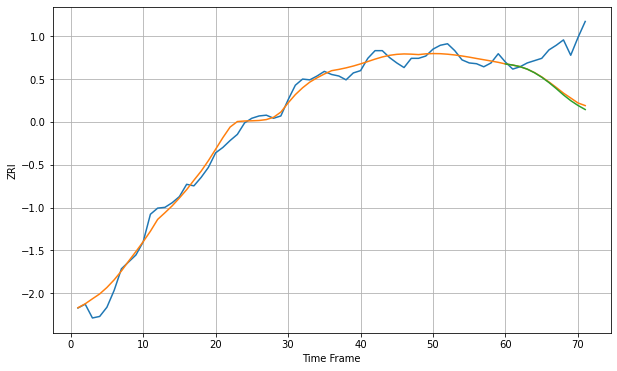

Wall time: 5.81 s
92626 10.503036580233013 52.28582736027475 54.39036898658812 [2206.66750322 2205.24397951 2203.16673797 2199.93836319 2195.24614534
 2189.37962894 2182.43968167 2174.64500526 2166.37445037 2158.94237784
 2152.67976591 2147.36278689]

Got an mse at 0.0099 in round 57 and stopped training

71 71 12


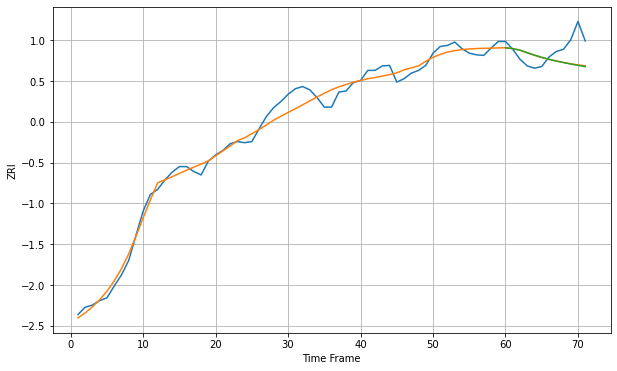

Wall time: 6.39 s
92627 14.260117373239916 32.36991518073623 32.8417498994282 [2302.72840957 2301.10706574 2298.38724436 2293.83535482 2289.4829944
 2285.53074066 2282.00942595 2278.87178712 2276.04426901 2273.45411709
 2271.03928604 2268.74965849]

Got an mse at 0.0094 in round 34 and stopped training

71 71 12


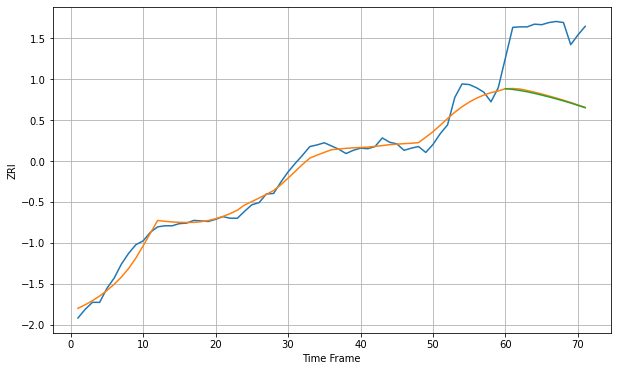

Wall time: 5.83 s
92647 14.352858751366414 124.6324381104994 126.11044177164304 [2117.2902654  2115.91635421 2113.99205304 2111.53692114 2108.65243682
 2105.45943244 2102.04865462 2098.45733052 2094.67937625 2090.69032092
 2086.46905778 2082.01050096]

Got an mse at 0.0097 in round 37 and stopped training

71 71 12


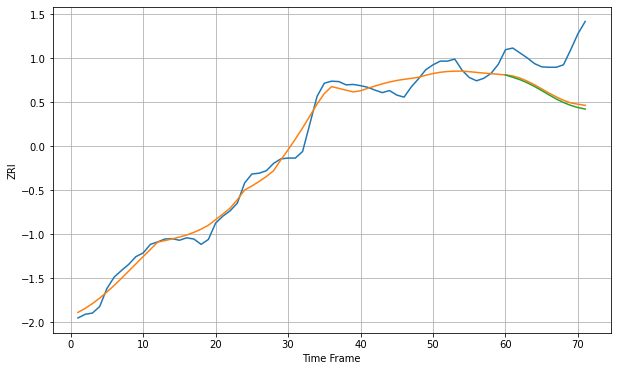

Wall time: 6.02 s
92648 20.818152106141415 102.66403874248115 107.77245849828881 [2308.26329849 2302.65466013 2296.61590044 2289.08949317 2280.11086513
 2270.04753493 2259.59139774 2249.61222592 2240.87467891 2233.81516302
 2228.51729115 2224.8275883 ]

Got an mse at 0.0100 in round 267 and stopped training

71 71 12


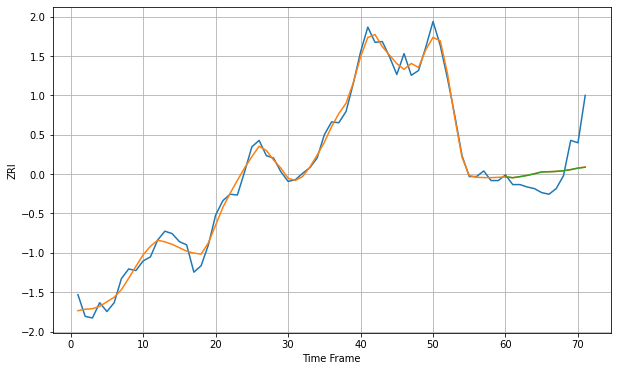

Wall time: 10.2 s
92651 9.77064578662868 32.846375900904484 32.87418982683301 [2564.64661934 2563.56961133 2564.77404536 2566.40999058 2568.36200116
 2570.65995665 2570.95639354 2571.36431622 2572.19916137 2573.65019094
 2575.44982786 2576.57041955]

Got an mse at 0.0100 in round 48 and stopped training

71 71 12


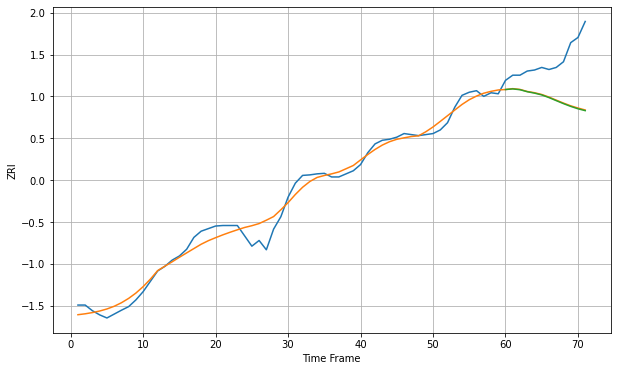

Wall time: 6.31 s
92656 16.07657495562469 83.77083779794903 84.6412629174423 [2247.23312361 2248.44897748 2246.87974054 2243.00746404 2240.27772307
 2236.81523134 2231.65070145 2225.77730351 2219.95041561 2214.58066897
 2209.99702642 2206.35684128]

Got an mse at 0.0099 in round 57 and stopped training

71 71 12


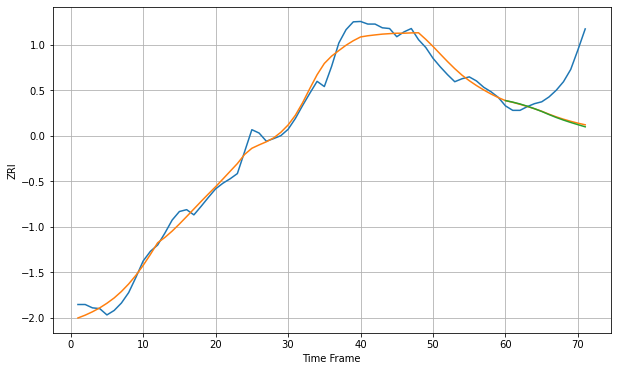

Wall time: 6.49 s
92660 24.147931382110055 109.57898723535405 111.90390584196484 [2887.23005195 2883.1362576  2878.19079707 2872.20143172 2865.45134037
 2858.03729149 2849.72884832 2841.8871671  2834.84064968 2828.46636997
 2822.51772874 2816.77031876]

Got an mse at 0.0099 in round 157 and stopped training

71 71 12


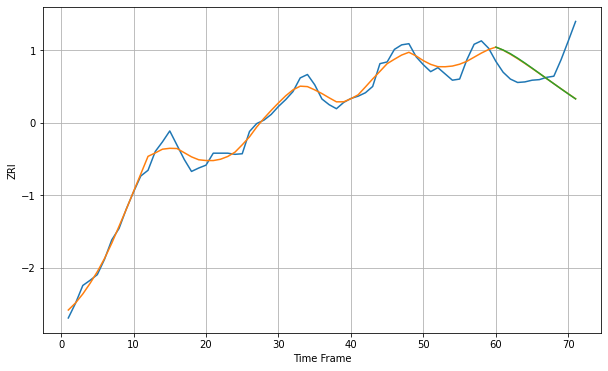

Wall time: 8.49 s
92663 12.548287951639567 55.6403952134164 55.916361037672985 [2340.02451155 2334.95844053 2328.46165148 2320.63591901 2312.10935477
 2303.16720519 2294.05882615 2284.92753082 2275.83167127 2266.80687774
 2257.90143434 2249.17411667]

Got an mse at 0.0099 in round 63 and stopped training

71 71 12


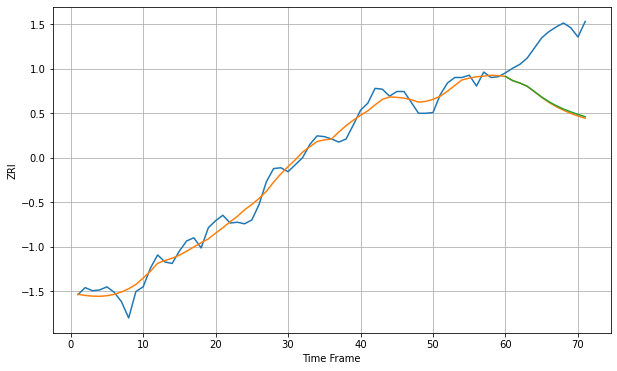

Wall time: 6.41 s
92672 11.300048065884203 81.86073787710053 80.74910502235586 [2227.35661581 2221.96418499 2218.80768734 2214.69124926 2207.84562504
 2200.92978112 2194.87775357 2189.78925124 2185.51966951 2181.85743223
 2178.60862729 2175.61649033]

Got an mse at 0.0100 in round 46 and stopped training

71 71 12


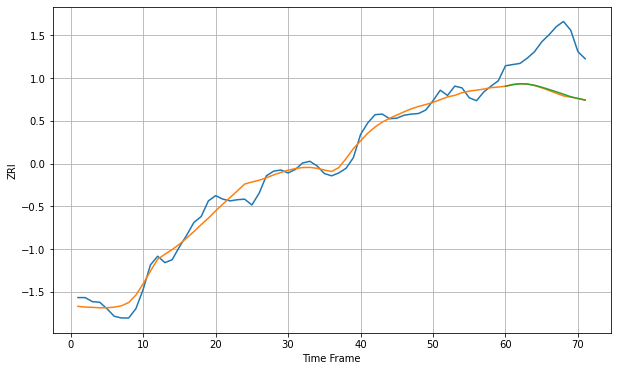

Wall time: 6.13 s
92673 14.309420096623159 80.79559879817168 79.7464629368881 [2202.7984443  2205.49819177 2206.95995905 2206.6402315  2204.5423755
 2201.18480211 2197.33328809 2193.35449667 2189.17832557 2184.78056993
 2181.7781602  2179.06316034]

Got an mse at 0.0099 in round 161 and stopped training

71 71 12


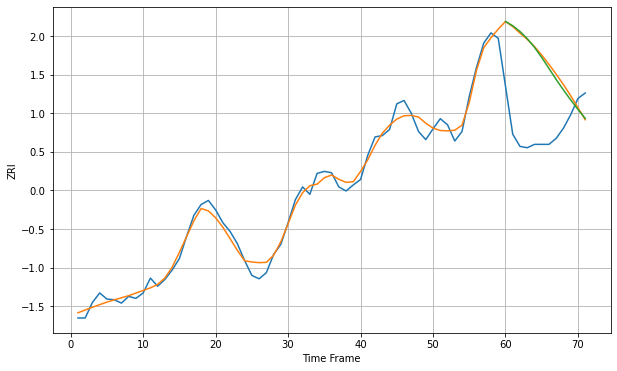

Wall time: 8.44 s
92677 11.301468133492264 114.22347613945834 112.80431262927716 [2491.9366073  2485.59865198 2477.09078869 2466.51798274 2453.62733887
 2438.59899987 2422.35040029 2405.97268435 2390.42806276 2375.73038892
 2361.75157578 2348.45885296]

Got an mse at 0.0099 in round 79 and stopped training

71 71 12


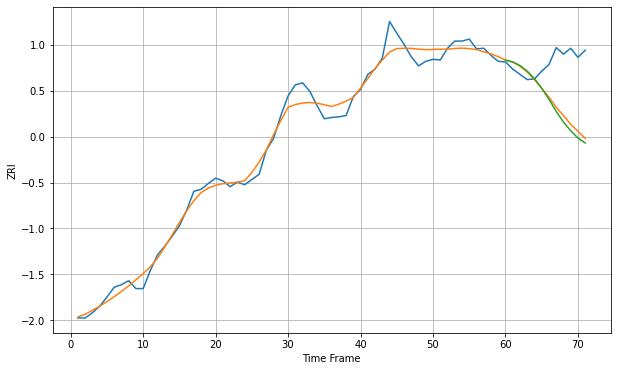

Wall time: 6.8 s
92691 13.899118165006524 73.82594183503332 79.45696042464763 [2118.90595424 2116.00040874 2110.45073718 2101.94571283 2090.28437912
 2075.68381698 2058.76977202 2040.34060754 2023.94897151 2010.6464336
 1999.41622043 1992.03272195]

Got an mse at 0.0099 in round 64 and stopped training

71 71 12


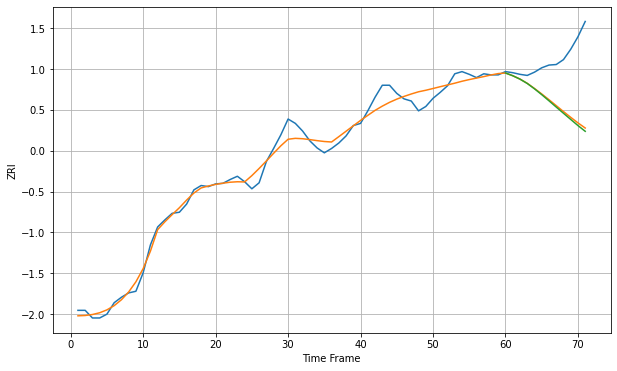

Wall time: 6.38 s
92692 14.866279371171172 91.80268451131806 94.648235419558 [2179.44597178 2174.4259542  2168.15407178 2160.25582721 2150.42138753
 2139.70050111 2128.44542575 2116.97279343 2105.60415709 2094.2839325
 2083.01986974 2072.49814543]

Got an mse at 0.0100 in round 111 and stopped training

71 71 12


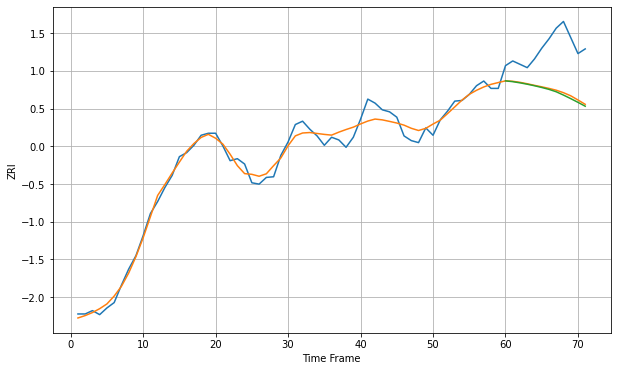

Wall time: 7.22 s
92707 11.171811271702108 65.98522228501581 68.11764102155259 [2168.24946976 2167.06113654 2165.29650509 2163.26036953 2160.95653535
 2158.38336097 2155.54339025 2151.95653714 2147.02456152 2141.72860283
 2136.16798366 2130.38512664]

Got an mse at 0.0093 in round 59 and stopped training

71 71 12


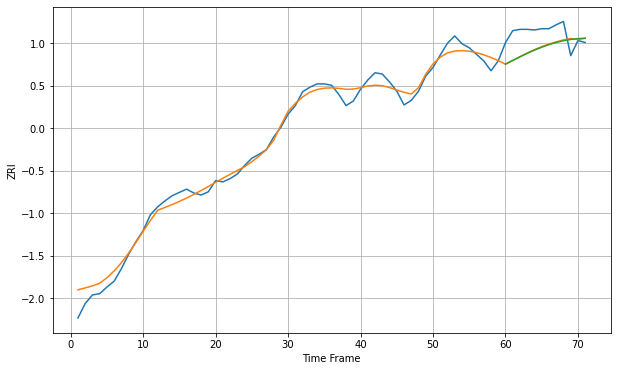

Wall time: 6.36 s
92780 12.000674368707234 29.61331864823898 29.97554028191067 [2106.03577094 2111.72297551 2117.21680866 2122.46882661 2127.37020667
 2131.82183862 2135.73834334 2139.05074837 2141.70810358 2143.67831368
 2144.94847429 2145.52488324]

Got an mse at 0.0098 in round 27 and stopped training

71 71 12


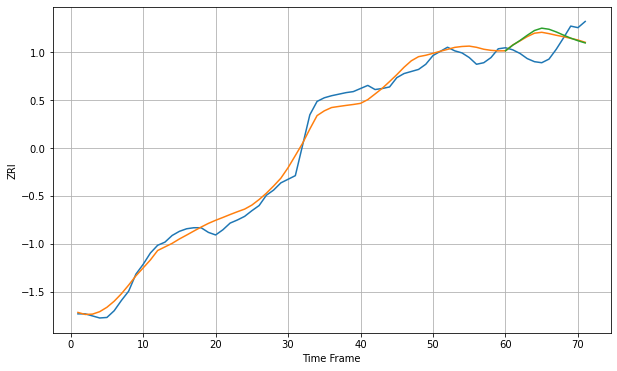

Wall time: 5.67 s
92782 17.291660356203774 35.38749167497107 39.13733290400725 [2393.10435581 2403.96062582 2413.139965   2423.2091631  2432.46280604
 2437.01547512 2434.90212546 2429.74452595 2423.56790762 2417.69862013
 2412.63337685 2408.35583157]

Got an mse at 0.0094 in round 17 and stopped training

71 71 12


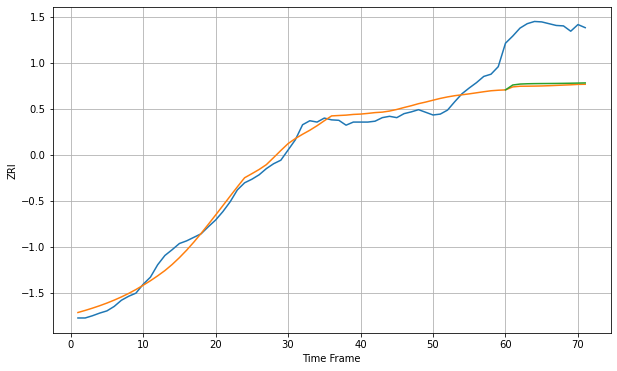

Wall time: 5.92 s
92805 19.56508725776552 131.76266256066108 127.63065324693356 [1917.65456027 1928.64886535 1930.76467988 1931.4279001  1931.74593213
 1931.89844995 1932.01989956 1932.17765592 1932.39547687 1932.67165496
 1932.99183636 1933.33712407]

Got an mse at 0.0100 in round 36 and stopped training

71 71 12


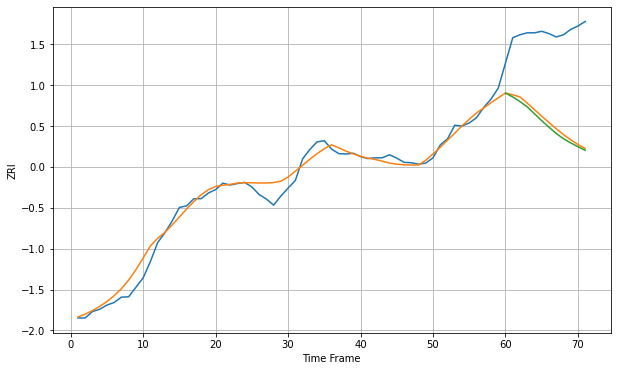

Wall time: 6.03 s
92806 20.852856228438945 234.6322001610212 243.30152837570608 [2188.99100951 2178.61731119 2166.38539504 2152.48148704 2134.18415235
 2115.96804405 2098.58187594 2082.33244297 2068.32164132 2057.33404464
 2047.1641785  2037.78475675]

Got an mse at 0.0096 in round 32 and stopped training

71 71 12


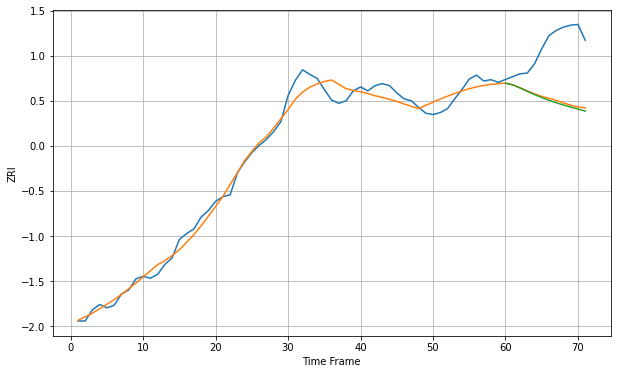

Wall time: 5.8 s
92832 13.272243323350422 83.43549097022276 85.94108731470686 [1949.71058101 1947.09544902 1942.4416357  1937.36113895 1932.47307521
 1927.88245777 1923.66779949 1919.86729764 1916.45397382 1913.32705245
 1910.32851135 1907.28430685]

Got an mse at 0.0098 in round 36 and stopped training

71 71 12


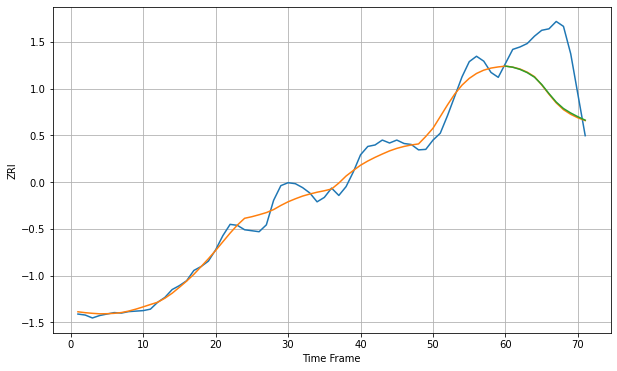

Wall time: 6.1 s
93001 18.67699258362611 99.4853547717905 98.49884659153884 [2197.88021298 2195.6557272  2191.18244025 2184.56100651 2175.28899701
 2160.37720606 2141.84816369 2124.55447403 2111.40141214 2102.25303002
 2094.54881957 2087.59814892]

Got an mse at 0.0099 in round 20 and stopped training

71 71 12


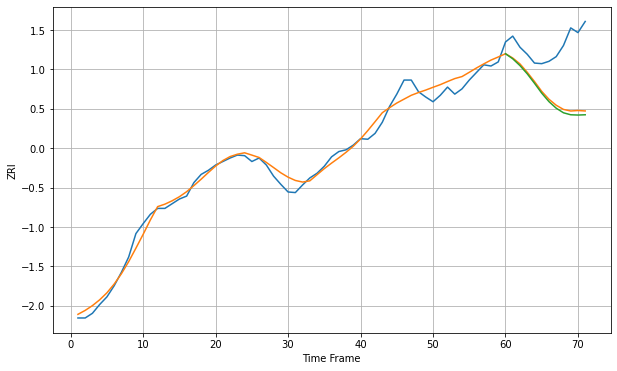

Wall time: 6.1 s
93010 12.77047628156631 87.02581069997142 91.51451005207942 [2062.92397186 2054.31569942 2042.66391614 2028.68055935 2012.56146598
 1995.6641449  1981.20994833 1969.97967735 1962.15802909 1958.78097487
 1958.29882497 1958.77226493]

Got an mse at 0.0097 in round 29 and stopped training

71 71 12


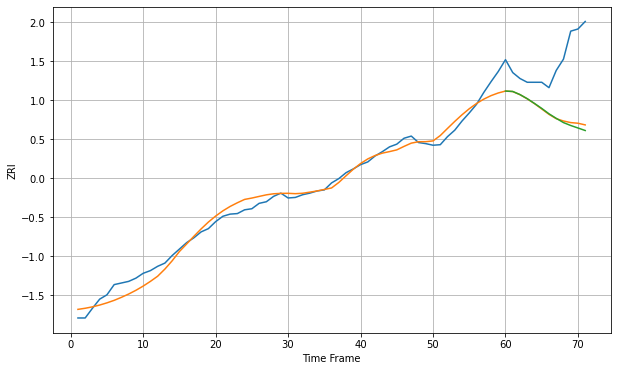

Wall time: 5.83 s
93030 14.05215924934633 104.37419242433685 108.09056007619618 [1854.68297968 1853.91929966 1848.12583508 1840.49670786 1831.65499861
 1822.43555269 1812.43237083 1803.97876518 1796.07734543 1790.66723448
 1786.04310677 1781.34071955]

Got an mse at 0.0099 in round 132 and stopped training

71 71 12


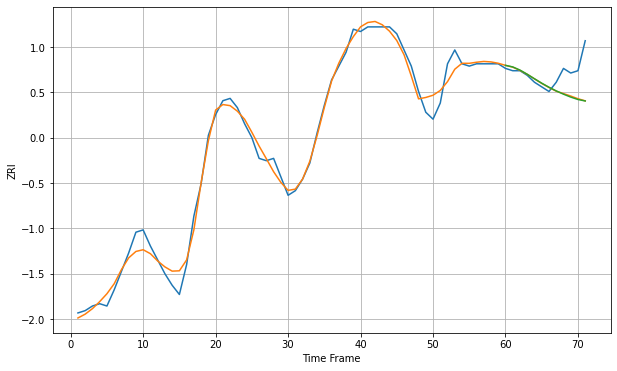

Wall time: 7.76 s
93304 3.885566879716462 9.449988305424345 9.564730065568652 [882.32682502 881.64674532 880.27516987 878.45989811 876.50455491
 874.5994407  872.83784798 871.25215976 869.83820928 868.57258935
 867.52903986 866.88559639]

Got an mse at 0.0098 in round 131 and stopped training

71 71 12


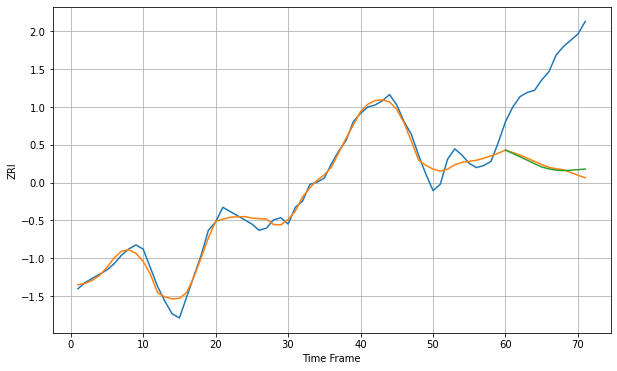

Wall time: 7.84 s
93305 3.563796281144664 48.29485399840449 47.76574137383015 [789.38741583 787.77975386 786.19555345 784.5583671  782.90136052
 781.28985322 780.39954184 779.77961573 779.56668407 779.75716102
 780.01263601 780.32324843]

Got an mse at 0.0100 in round 125 and stopped training

71 71 12


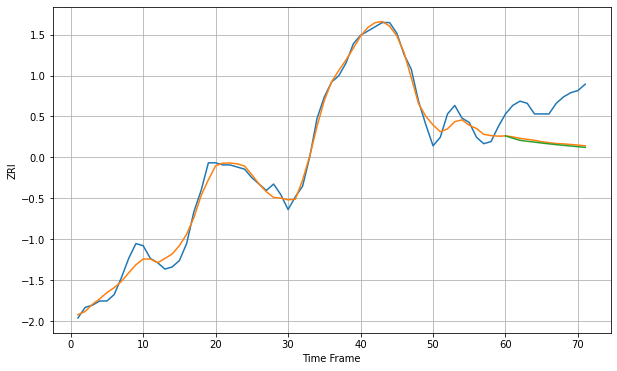

Wall time: 7.5 s
93307 3.8255886574041633 19.070580485492272 19.72819175177744 [858.67212395 857.58900852 856.58878039 856.14224365 855.72457217
 855.31484066 854.92903573 854.56751461 854.2251479  853.89829873
 853.58595356 853.28876967]

Got an mse at 0.0099 in round 147 and stopped training

71 71 12


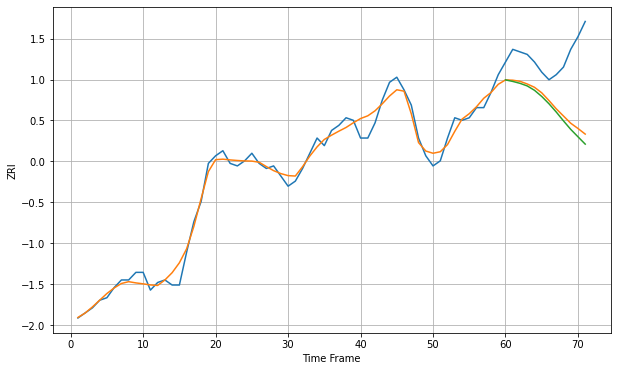

Wall time: 8.38 s
93308 3.201071392394471 21.19966354873327 23.07994181939066 [847.93811511 847.3433577  846.59054606 845.56391711 843.84019323
 841.41143762 838.52319942 835.27558951 831.77689623 828.42308611
 825.49931826 822.59992001]

Got an mse at 0.0100 in round 90 and stopped training

71 71 12


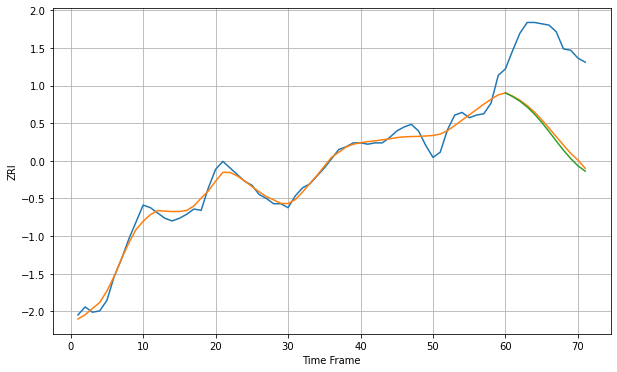

Wall time: 6.93 s
93309 5.6638040915498715 67.07249019618833 69.46586028957954 [1020.79137988 1017.93363033 1014.44883271 1010.06270529 1004.7198645
  998.48292179  991.58513981  984.42519716  977.47246712  971.12779894
  965.63727944  961.64545245]

Got an mse at 0.0091 in round 28 and stopped training

71 71 12


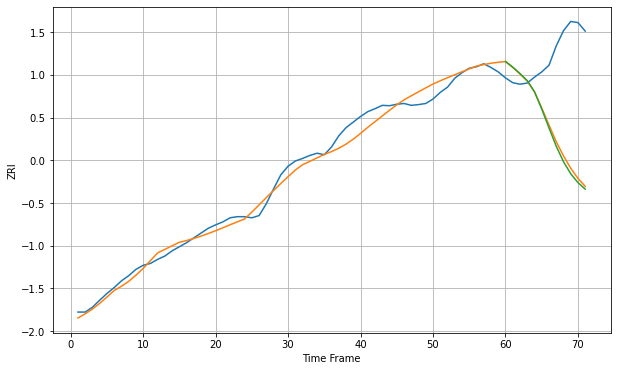

Wall time: 5.84 s
93906 21.39378335965394 246.52219471431007 254.52950799663586 [1813.04087397 1798.13124358 1780.63050682 1761.51344275 1731.64866291
 1685.22385171 1634.24931509 1585.00646372 1543.17065348 1510.75500549
 1486.74053421 1469.32978344]

Got an mse at 0.0097 in round 34 and stopped training

71 71 12


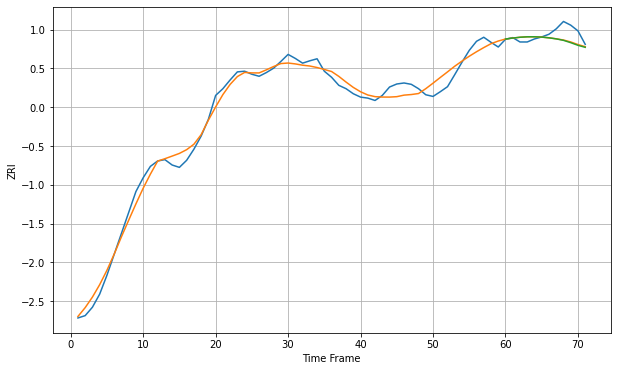

Wall time: 5.84 s
94010 22.34765811751866 26.937562918640342 27.784023443241722 [2721.74180373 2724.62872756 2727.04415579 2728.34430357 2728.48792026
 2727.47541605 2725.35486264 2722.20910276 2717.86244103 2710.92706531
 2703.0773172  2697.06975244]

Got an mse at 0.0100 in round 70 and stopped training

71 71 12


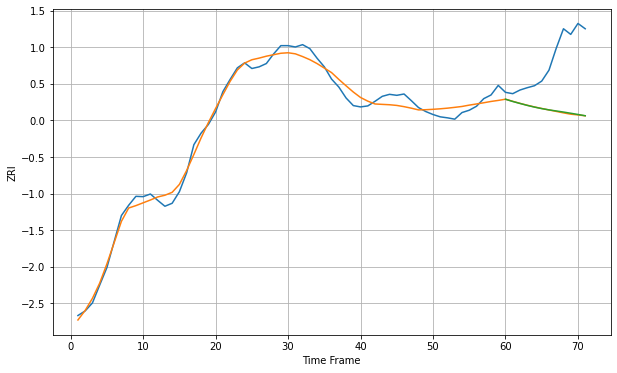

Wall time: 6.6 s
94025 21.919896224840432 167.1031253768935 166.13748477922485 [3316.22700438 3309.35981405 3303.41815683 3297.62429923 3292.41454809
 3287.86876287 3284.00639784 3280.79220757 3277.49941453 3273.89537927
 3270.19418975 3266.34240102]

Got an mse at 0.0098 in round 123 and stopped training

71 71 12


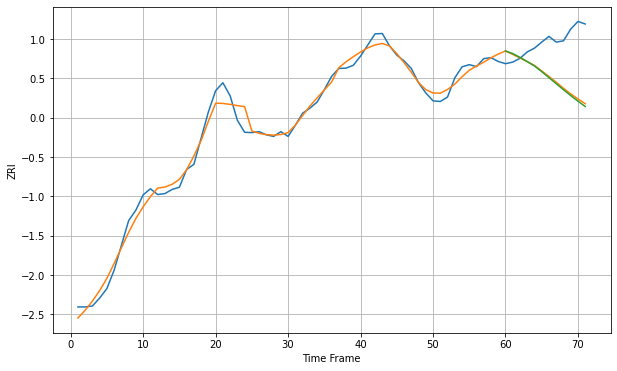

Wall time: 7.65 s
94040 24.438675197911923 139.24672443960986 143.49393630350048 [3426.13109564 3417.94189379 3405.85910121 3392.63936017 3378.63231814
 3361.08195582 3342.11209723 3322.99821443 3304.09979948 3285.69901776
 3268.01647285 3251.20876402]

Got an mse at 0.0098 in round 43 and stopped training

71 71 12


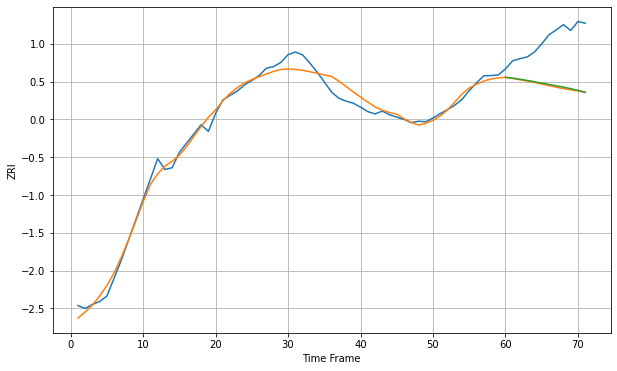

Wall time: 6.15 s
94061 25.184403585572383 163.25003794714667 160.54178193707472 [3022.8551457  3020.0208729  3016.37205294 3012.22484576 3007.77036123
 3003.16268529 2998.49911969 2993.82870157 2989.14817482 2983.92643822
 2977.97872689 2971.67757189]

Got an mse at 0.0098 in round 36 and stopped training

71 71 12


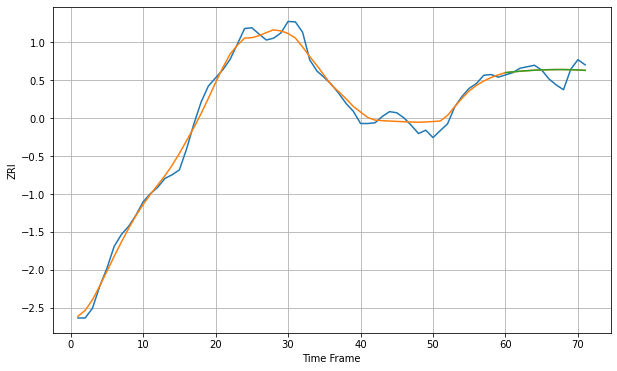

Wall time: 5.96 s
94066 19.830962911896457 23.63561603672534 23.579534104296634 [2843.15513791 2845.17070451 2846.93840686 2848.43332142 2849.63093378
 2850.51946965 2851.09659613 2851.36412623 2851.32412514 2850.97701551
 2850.32094699 2849.35170384]

Got an mse at 0.0100 in round 106 and stopped training

71 71 12


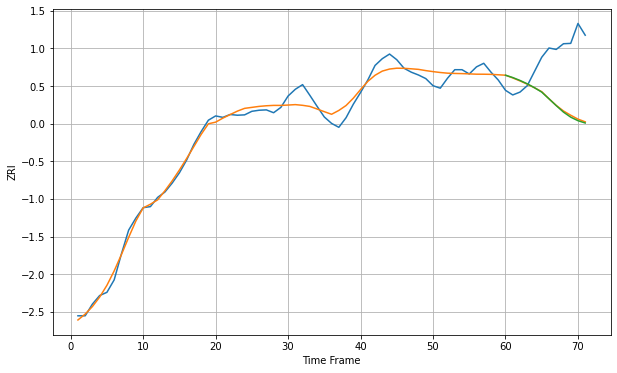

Wall time: 7.71 s
94085 21.042845983390276 149.97319308134772 152.21926768006165 [3003.51151756 2996.92464534 2988.80261051 2979.32239074 2968.33503943
 2955.97521728 2937.1425678  2918.02796458 2899.73195498 2885.56226497
 2875.60835145 2869.1289584 ]

Got an mse at 0.0099 in round 47 and stopped training

71 71 12


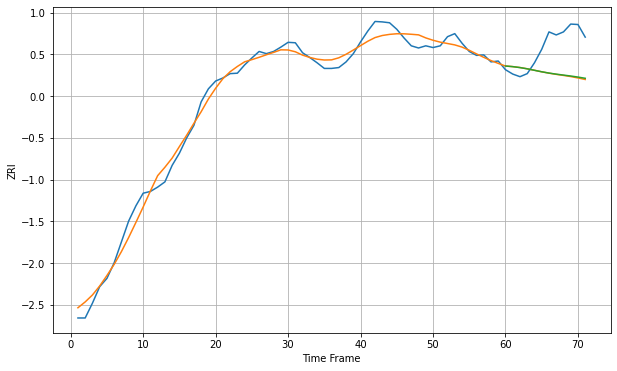

Wall time: 6.26 s
94086 18.768690635015158 76.565710492011 75.67435053525027 [2908.50317655 2907.0636978  2904.91506339 2902.06569351 2898.67394463
 2895.25994968 2892.28965663 2889.83839154 2887.68329454 2885.52401395
 2883.11133392 2880.30498371]

Got an mse at 0.0100 in round 84 and stopped training

71 71 12


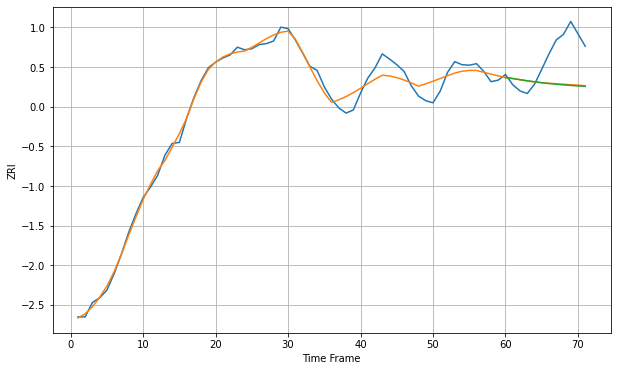

Wall time: 6.92 s
94087 15.299491498834449 66.32454310641722 67.16930792167018 [2711.0238519  2709.09083541 2706.95049189 2704.83848378 2702.84606143
 2701.03047805 2699.41802128 2698.00859955 2696.78254196 2695.70810654
 2694.74840831 2693.8669095 ]

Got an mse at 0.0100 in round 120 and stopped training

71 71 12


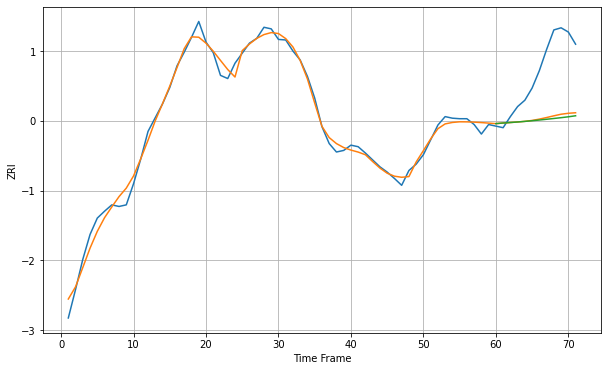

Wall time: 7.59 s
94103 13.122753945223643 102.07934596304443 105.5617948369873 [3491.72538138 3492.88355893 3493.7942627  3494.81538047 3495.94997715
 3497.19354102 3498.53501028 3499.95801465 3501.44215318 3502.96402141
 3504.64277528 3506.56066129]

Got an mse at 0.0098 in round 73 and stopped training

71 71 12


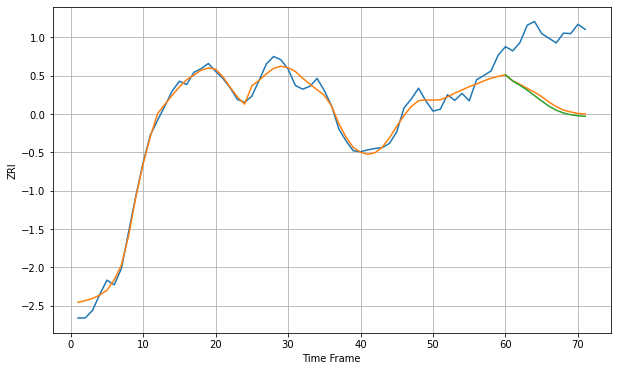

Wall time: 6.64 s
94105 16.08643931825551 140.5500791590208 146.04788504157116 [3946.59335536 3933.4046824  3924.30878497 3913.88424154 3902.32626957
 3890.44066556 3879.60285926 3871.00555802 3864.99754487 3861.21439964
 3859.061651   3858.00743874]

Got an mse at 0.0098 in round 58 and stopped training

71 71 12


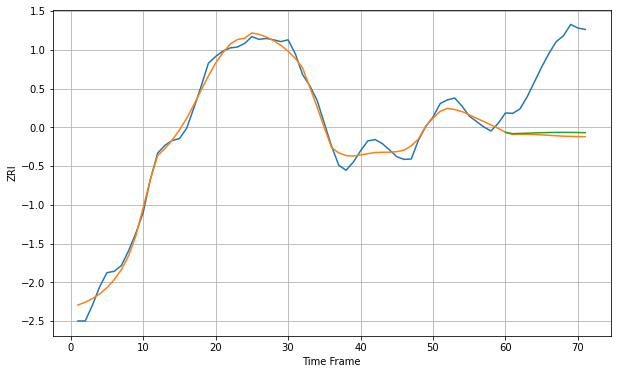

Wall time: 6.3 s
94107 16.870477455918486 171.32295439291428 165.25579224221778 [3806.90833346 3804.08904041 3804.59878636 3805.1139502  3805.66549805
 3806.16576198 3806.55511578 3806.79635934 3806.87397327 3806.79181806
 3806.56980632 3806.2398627 ]

Got an mse at 0.0100 in round 118 and stopped training

71 71 12


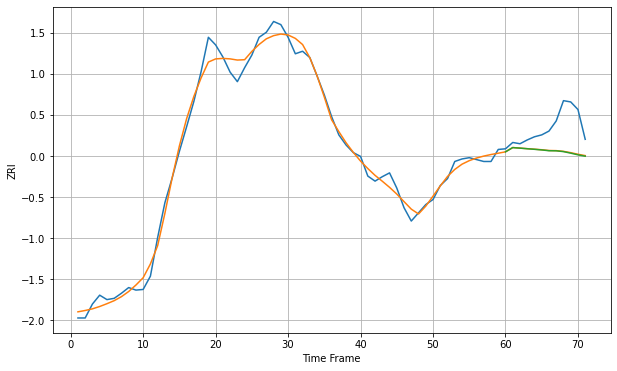

Wall time: 7.63 s
94109 12.90978513863687 43.63808733032221 44.063710356106874 [3378.23073087 3384.95099674 3384.05115734 3383.12382731 3382.20609569
 3381.22839566 3379.98137527 3379.84561119 3378.57730455 3376.15014057
 3373.49311636 3371.34223426]

Got an mse at 0.0093 in round 54 and stopped training

71 71 12


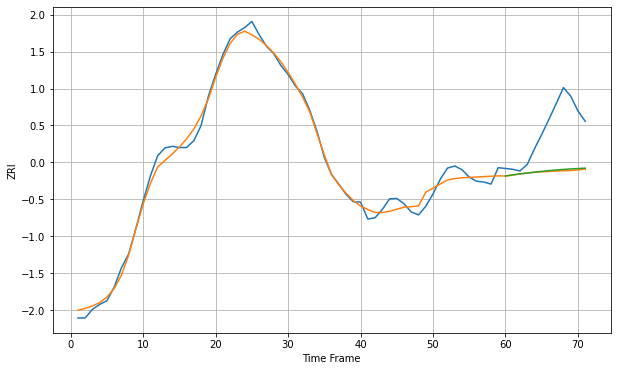

Wall time: 6.76 s
94110 16.141824585361082 116.850347477295 114.69427531854029 [3849.69207936 3852.5721606  3854.84519034 3857.04076657 3859.11909736
 3861.04931718 3862.80387589 3864.36518379 3865.72981516 3866.90974504
 3867.9302985  3868.82547606]

Got an mse at 0.0100 in round 38 and stopped training

71 71 12


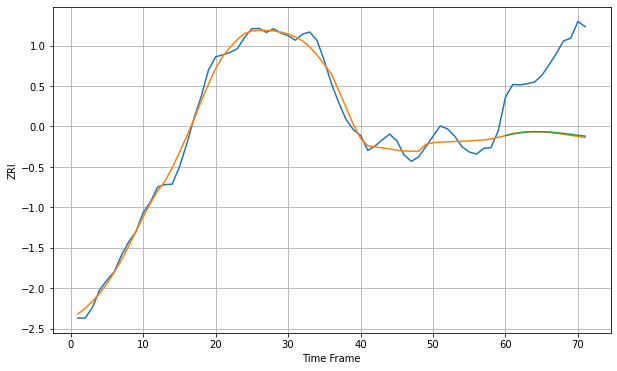

Wall time: 6.06 s
94115 19.70513449549146 185.92723526145141 184.5125917872454 [3461.32728469 3465.61024693 3468.44320427 3470.3472946  3471.06380845
 3470.8943804  3470.24202091 3468.67688558 3466.70089175 3464.52045943
 3462.30086567 3460.15994806]

Got an mse at 0.0097 in round 50 and stopped training

71 71 12


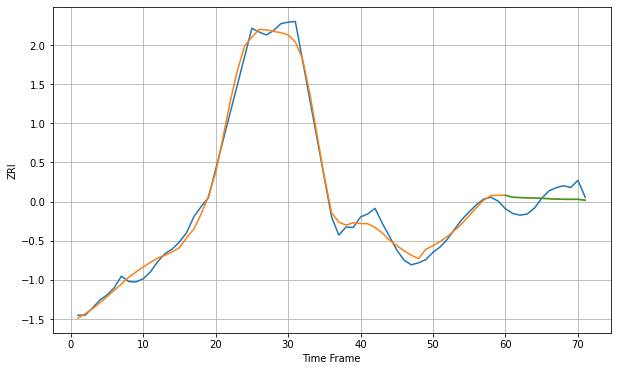

Wall time: 6.28 s
94158 30.565044277449914 52.8148165836566 52.615090126051506 [3958.52641413 3949.93280567 3948.59095963 3947.60916902 3946.68077723
 3945.59549144 3944.26648674 3942.73926786 3941.61976352 3941.61976352
 3941.61976352 3937.25060476]

Got an mse at 0.0096 in round 49 and stopped training

71 71 12


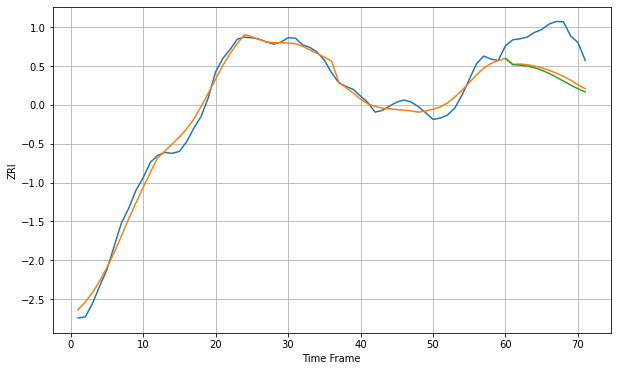

Wall time: 6.7 s
94401 22.415288295065295 113.11992452859846 121.85713836541642 [2823.17461065 2804.11707846 2802.74832724 2800.01589642 2795.02591097
 2787.73710893 2778.311041   2767.18652448 2755.12285447 2743.08776383
 2731.99415719 2722.44272932]

Got an mse at 0.0096 in round 36 and stopped training

71 71 12


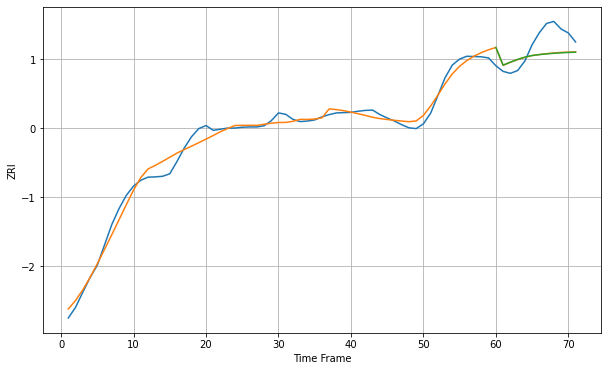

Wall time: 6.1 s
94403 23.73174486798289 66.24209397787708 66.87614268009204 [3144.35069855 3081.3784003  3091.96900087 3101.69131788 3109.81618528
 3115.60951268 3118.90504273 3121.53215598 3123.6326425  3125.28735723
 3126.53291951 3127.37055451]

Got an mse at 0.0099 in round 52 and stopped training

71 71 12


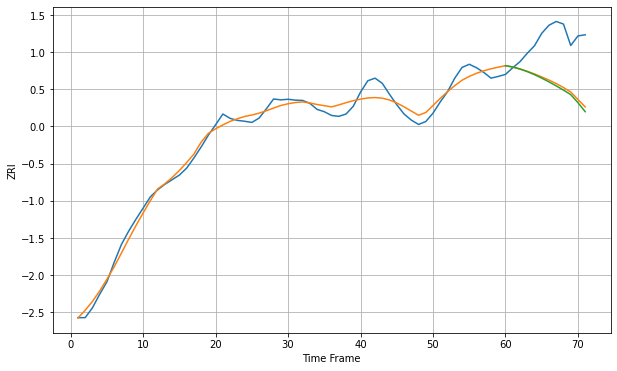

Wall time: 6.41 s
94404 25.3978620752525 159.26257831046075 166.4566393447896 [3179.1619061  3174.83576385 3167.67125737 3158.72069195 3148.12330471
 3136.1344181  3123.08692992 3109.2437494  3094.66095486 3079.17034269
 3051.1611191  3020.10198702]

Got an mse at 0.0096 in round 36 and stopped training

71 71 12


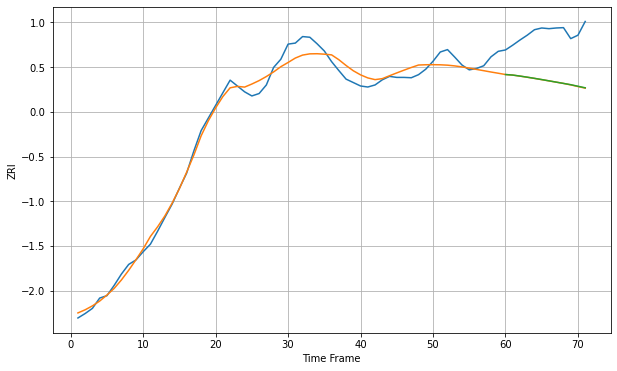

Wall time: 6.01 s
94501 25.093427205209423 139.79366592253413 139.43360256504022 [2547.36104948 2545.82516778 2542.87002224 2539.6779654  2536.27505429
 2532.70050487 2529.005423   2525.24941947 2521.49431448 2517.79811106
 2513.26099699 2508.74074431]

Got an mse at 0.0097 in round 25 and stopped training

71 71 12


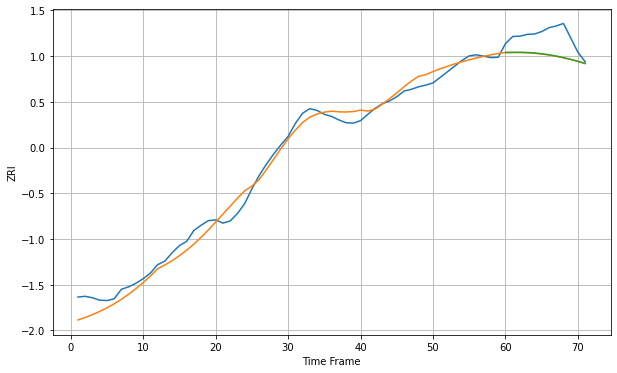

Wall time: 5.8 s
94509 24.680694920986678 59.23134686621797 58.70768691438736 [1921.50628551 1922.05370943 1922.19167748 1921.56489961 1920.16373497
 1917.98596908 1915.04378693 1911.36284892 1906.98206766 1901.95396096
 1896.34526519 1890.237211  ]

Got an mse at 0.0099 in round 90 and stopped training

71 71 12


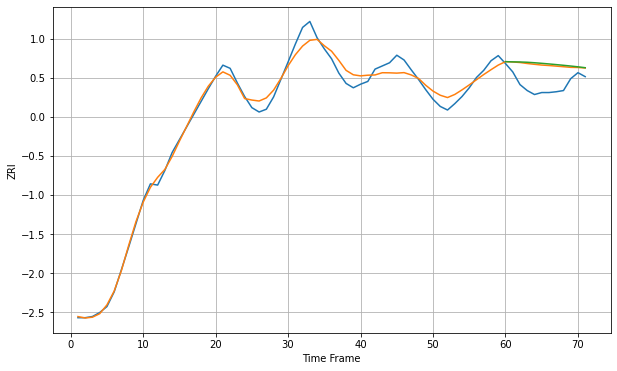

Wall time: 6.98 s
94530 19.34342996561334 52.299293722343435 55.12445915990021 [2455.80815963 2455.26086345 2454.98890197 2454.26561562 2453.04781925
 2451.61216831 2450.04046445 2448.37492987 2446.6249908  2444.77130683
 2442.77262907 2440.57364016]

Got an mse at 0.0098 in round 41 and stopped training

71 71 12


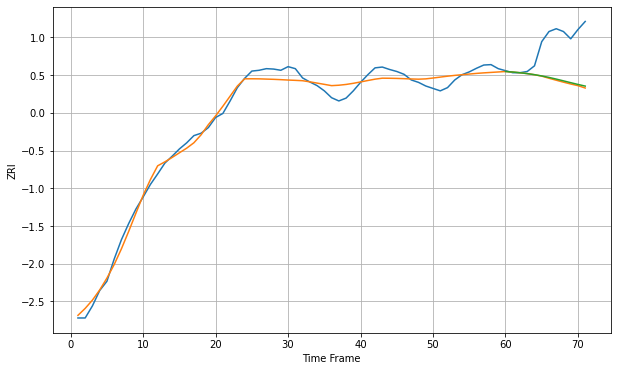

Wall time: 6.08 s
94538 18.155835258584297 96.77729551044622 94.52268484884097 [2455.95583337 2454.63738656 2452.87284325 2450.72336371 2448.10833803
 2444.96936255 2441.29943321 2437.17414737 2432.75658561 2428.26054336
 2423.88959564 2419.79011831]

Got an mse at 0.0100 in round 36 and stopped training

71 71 12


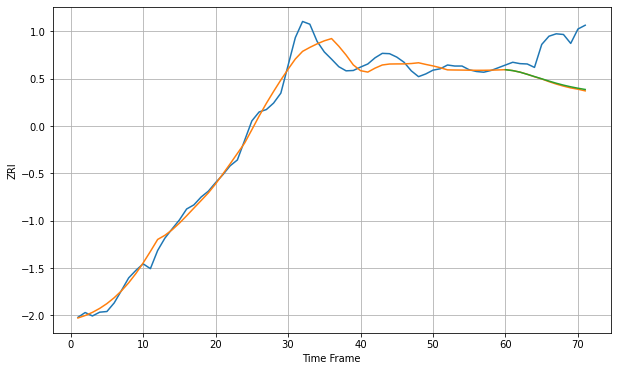

Wall time: 6 s
94541 27.448539345537725 115.19332871260708 113.18474847391978 [2370.34300352 2367.67524706 2363.15834956 2356.83464792 2350.23805319
 2343.76622762 2337.12977931 2330.88170859 2325.31011014 2320.4678486
 2316.2781919  2312.62720362]

Got an mse at 0.0099 in round 153 and stopped training

71 71 12


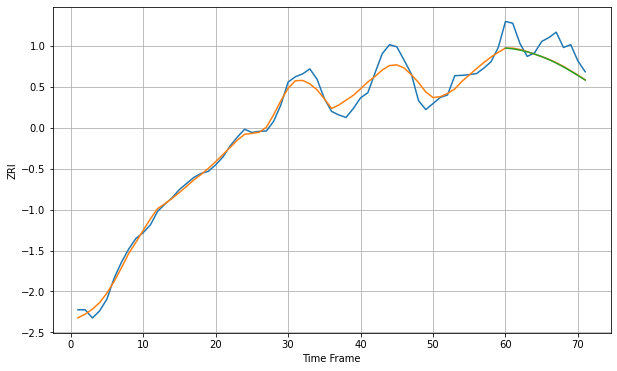

Wall time: 8.22 s
94549 22.680593292326076 53.18620498683333 54.00815774227086 [2743.41824109 2741.28887772 2737.7301165  2732.84987397 2726.74209164
 2719.45127977 2710.98656438 2701.3557346  2690.61380048 2678.91081137
 2666.5146531  2653.78989141]

Got an mse at 0.0089 in round 25 and stopped training

71 71 12


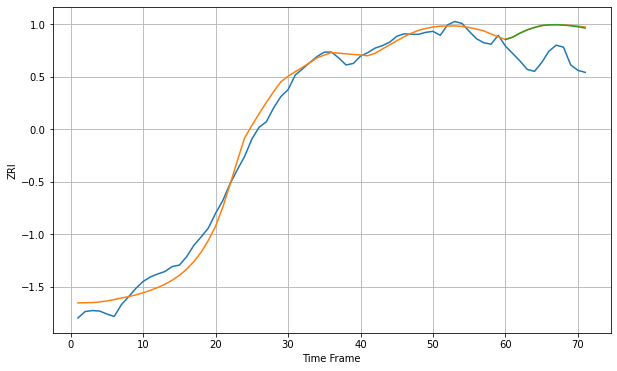

Wall time: 5.87 s
94565 19.798220102269344 66.94007744343249 66.45764964191656 [2017.54353906 2022.38569105 2030.49343615 2037.01944202 2041.75000431
 2045.89209535 2047.18773682 2047.33140471 2046.66202363 2045.24920836
 2043.19357477 2040.61545358]
71 71 12


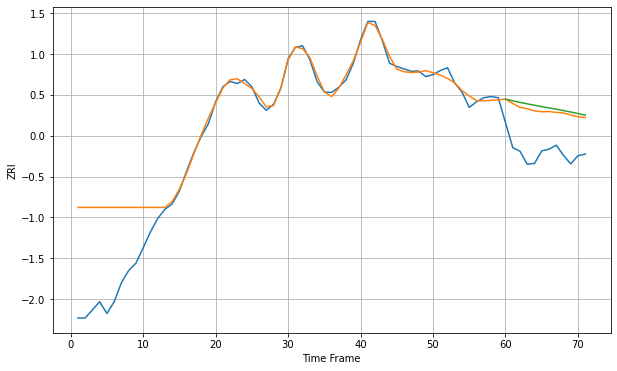

Wall time: 14.6 s
94568 90.6435228475963 103.92588356214254 112.78649435479689 [2762.49855818 2758.43989902 2754.56772267 2750.92880243 2747.47788844
 2744.15406447 2740.89076988 2737.61788496 2734.26276832 2730.75152234
 2727.01124689 2722.97349074]

Got an mse at 0.0097 in round 36 and stopped training

71 71 12


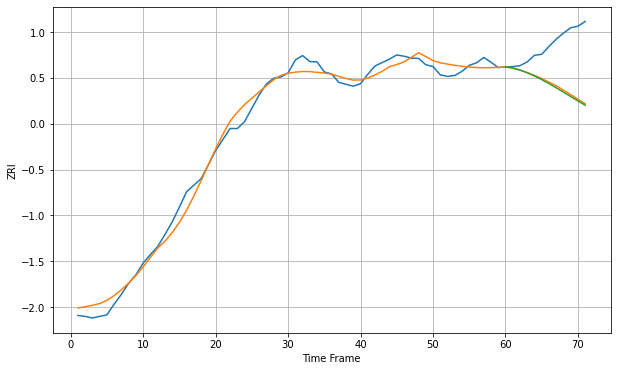

Wall time: 6.1 s
94603 26.785751446416434 142.85878913625785 146.69001400373259 [2378.3605919  2374.49462943 2368.08673848 2359.609006   2349.43938725
 2337.91604723 2325.34934484 2312.03379166 2298.25533805 2284.29167488
 2270.40575749 2256.83485862]

Got an mse at 0.0095 in round 30 and stopped training

71 71 12


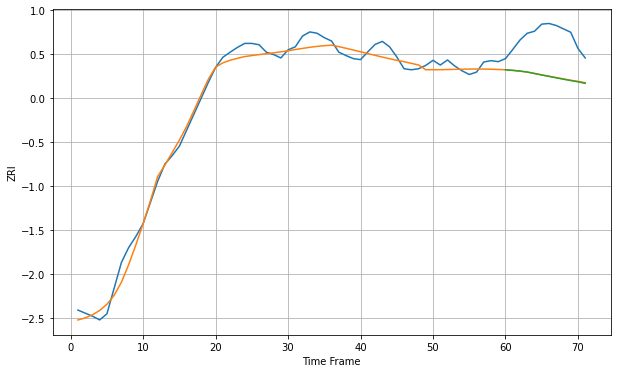

Wall time: 5.8 s
94608 23.92690822192759 118.89961398748018 119.46799074639344 [2765.95602717 2764.21629485 2762.0600279  2759.21948402 2755.05254626
 2750.49856885 2746.41871925 2742.22900063 2738.06748623 2734.06625052
 2730.3181455  2725.8256123 ]

Got an mse at 0.0098 in round 24 and stopped training

71 71 12


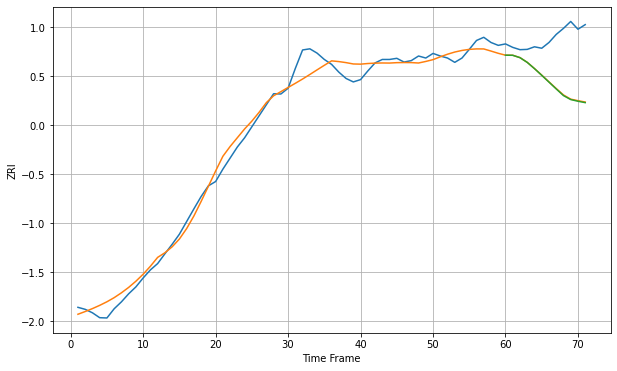

Wall time: 5.86 s
94621 32.97601398036651 166.76243111543727 167.9899139883641 [2491.88542806 2491.47385726 2483.20124926 2466.79712668 2445.11392755
 2421.96049975 2398.31260978 2374.58120909 2351.48313314 2337.70676495
 2331.8739077  2327.05536001]

Got an mse at 0.0098 in round 29 and stopped training

71 71 12


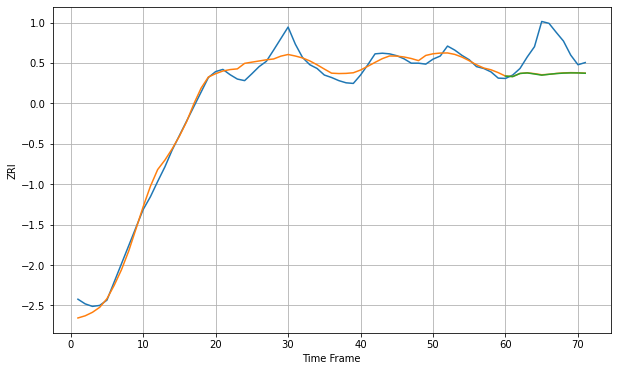

Wall time: 5.91 s
94703 24.906322585914687 91.00511748984226 91.47617262903523 [2770.55527261 2768.97528413 2779.08134345 2780.71552802 2777.34388598
 2773.53820631 2776.37315473 2778.62479474 2780.13486279 2780.80952614
 2780.63743551 2779.67397961]

Got an mse at 0.0099 in round 59 and stopped training

71 71 12


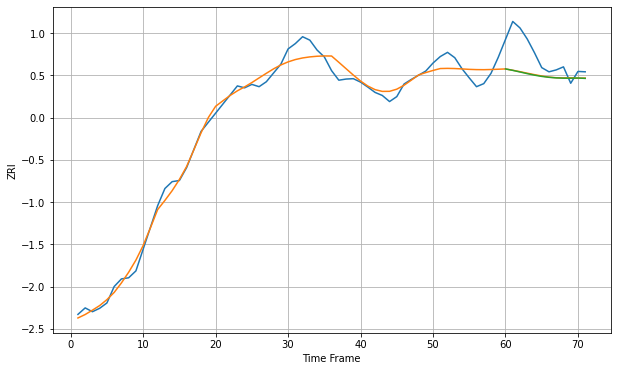

Wall time: 6.49 s
94801 21.946005858605517 64.25690925486055 64.73868955876058 [2250.55525618 2246.78993343 2242.54364819 2238.21089287 2234.22665955
 2230.94191077 2228.55159435 2227.05548933 2226.31439507 2226.20677749
 2226.73345406 2225.74784798]

Got an mse at 0.0097 in round 36 and stopped training

71 71 12


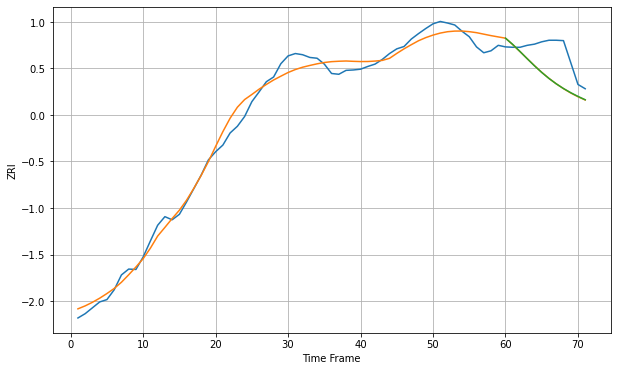

Wall time: 6.05 s
94806 22.949064302754863 68.17924212891363 68.09278552336339 [2167.26637635 2151.2312402  2133.18996072 2114.73026744 2096.65390747
 2079.68348276 2064.28731076 2050.6192404  2038.5846718  2027.95204872
 2018.44679088 2009.81015479]

Got an mse at 0.0094 in round 29 and stopped training

71 71 12


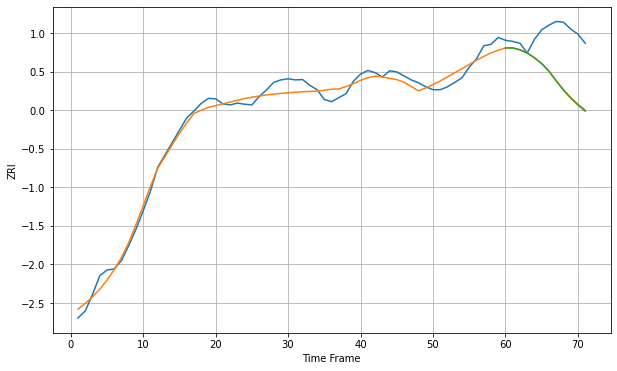

Wall time: 6.01 s
94901 20.3120137391351 127.81945224325189 129.0276530021225 [2614.06053385 2613.91364957 2608.65395653 2599.81590066 2587.13671422
 2570.78296819 2549.49429423 2522.9965546  2497.92684796 2475.78040463
 2457.02667734 2439.78446869]

Got an mse at 0.0100 in round 57 and stopped training

71 71 12


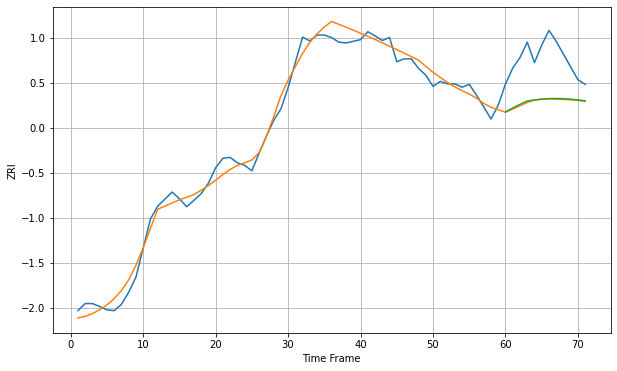

Wall time: 6.74 s
94903 21.201986738469625 108.45508181946015 107.04487789751528 [2579.3923213  2589.30837131 2598.03364413 2605.99068108 2608.53978119
 2610.45234337 2611.7881512  2612.05055812 2611.54942132 2610.40858436
 2608.66728338 2606.43176978]

Got an mse at 0.0098 in round 48 and stopped training

71 71 12


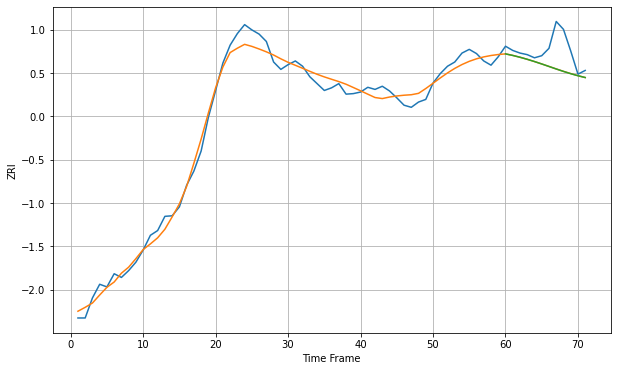

Wall time: 6.17 s
95008 16.02128577286399 39.204328856809184 39.25168044316208 [2616.43714668 2613.5147851  2610.06527991 2606.16273111 2601.88261878
 2597.31526889 2592.57456634 2587.80341749 2583.16667753 2578.82846393
 2574.92255287 2571.53090793]

Got an mse at 0.0098 in round 54 and stopped training

71 71 12


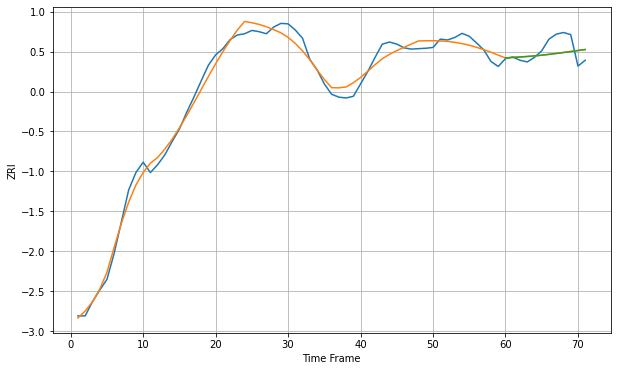

Wall time: 6.28 s
95014 18.82539302732122 28.726330522674072 28.885046628828814 [3210.57917997 3211.91350061 3212.96547326 3214.19209547 3215.6382026
 3217.31469211 3219.21196961 3221.30676927 3223.56823644 3225.96281699
 3228.45773021 3231.02305947]

Got an mse at 0.0099 in round 71 and stopped training

71 71 12


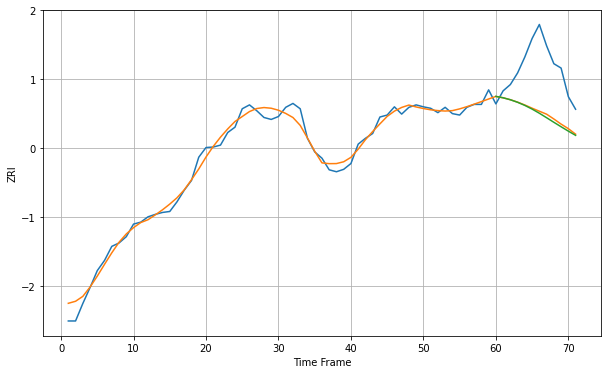

Wall time: 6.52 s
95050 13.979777635534246 100.40718860615054 103.77206179368739 [2691.53448665 2688.67795579 2684.61042447 2679.34723317 2672.8952086
 2665.32295848 2656.78225842 2647.51655417 2638.0899947  2628.886572
 2619.81267811 2611.15750675]

Got an mse at 0.0088 in round 36 and stopped training

71 71 12


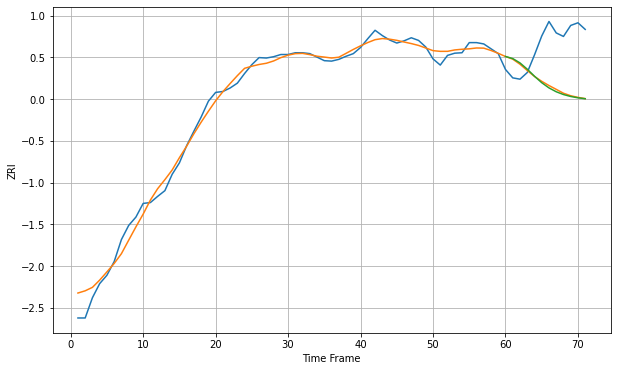

Wall time: 5.89 s
95051 17.214427025162955 111.72261231506053 113.8382497201984 [2832.52207102 2827.79042885 2817.90489913 2803.71164413 2787.7150743
 2772.9934763  2761.20632906 2752.43662229 2746.14401313 2741.73750934
 2738.70723909 2736.64298853]

Got an mse at 0.0100 in round 346 and stopped training

71 71 12


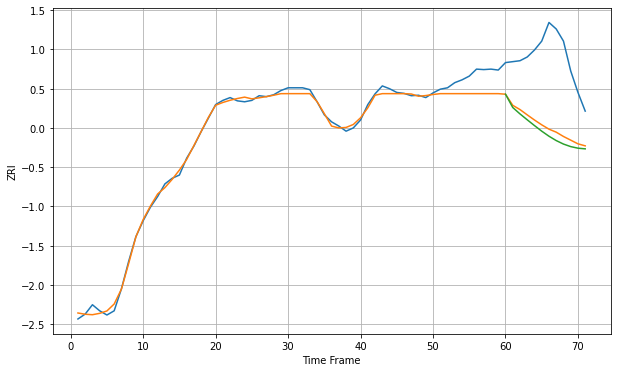

Wall time: 11.6 s
95112 16.759052748099016 151.93012907809776 163.61308957032676 [2515.24819071 2486.78023423 2473.00881921 2460.37567899 2447.9854274
 2436.02775676 2425.17912613 2415.85747769 2408.37464421 2402.92658693
 2399.55646088 2398.12405179]

Got an mse at 0.0096 in round 32 and stopped training

71 71 12


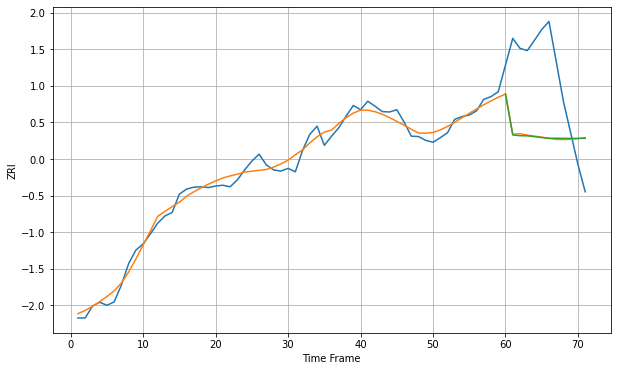

Wall time: 5.83 s
95116 18.296392822876623 199.19598112072364 199.7799773801325 [2564.87018263 2458.17255256 2456.13596463 2455.85645645 2453.69401636
 2451.33031478 2449.62208587 2449.52875748 2449.26154778 2449.0860453
 2449.11394916 2449.32654578]

Got an mse at 0.0099 in round 43 and stopped training

71 71 12


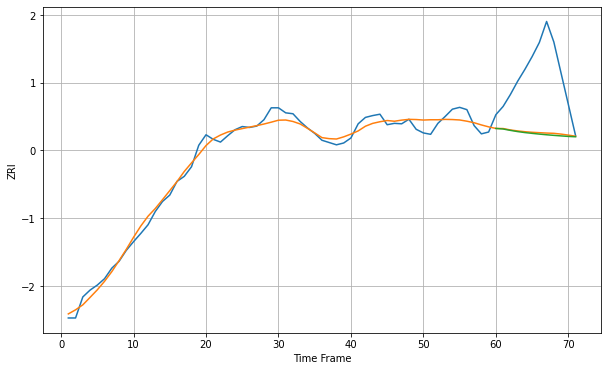

Wall time: 6.05 s
95117 14.599418880421897 137.79591891025328 140.24994435527785 [2521.8617198  2520.63192864 2517.63179558 2514.98246318 2512.80817587
 2511.08666495 2509.46484815 2508.0020699  2506.71332831 2505.52632149
 2504.37496761 2503.60705667]

Got an mse at 0.0093 in round 46 and stopped training

71 71 12


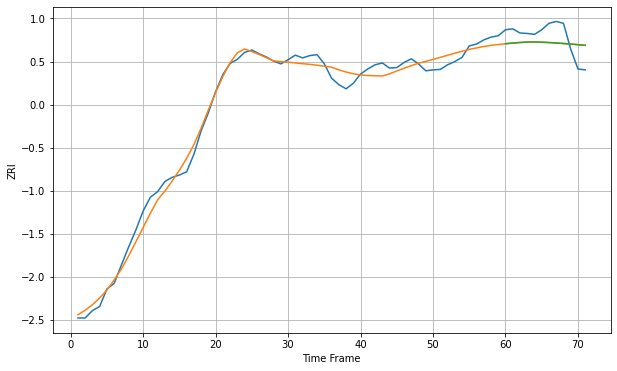

Wall time: 6.11 s
95123 17.239902281197075 35.59383770323805 35.636092465691355 [2767.71061823 2769.26435992 2770.43004086 2771.27599711 2771.52659191
 2771.03060571 2770.26197534 2769.28429981 2768.1618627  2766.95416076
 2765.7124349  2764.4772648 ]

Got an mse at 0.0100 in round 136 and stopped training

71 71 12


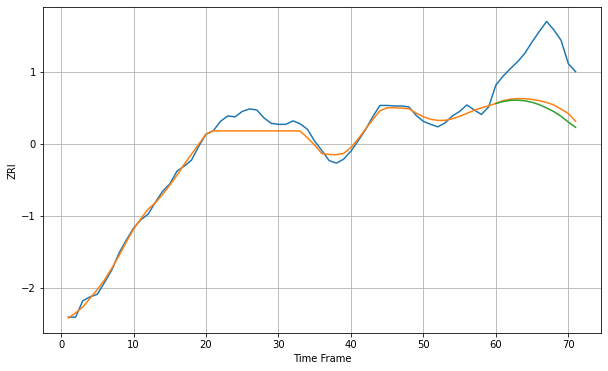

Wall time: 7.68 s
95128 14.398465020665505 109.08637465150211 117.84237012972287 [2550.02036452 2553.98423467 2556.2454681  2556.73865766 2555.4182709
 2552.3804427  2547.55871799 2540.96051563 2533.67006228 2524.20595065
 2512.56226258 2502.01784191]

Got an mse at 0.0098 in round 49 and stopped training

71 71 12


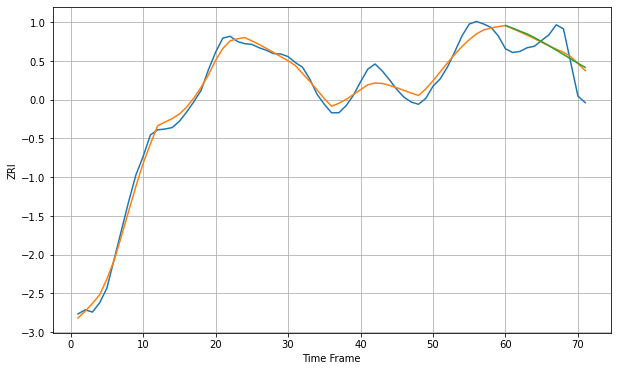

Wall time: 6.19 s
95134 20.37761524737839 55.72367192037636 58.2702762030029 [3163.04655681 3155.87648324 3147.80156107 3140.17852389 3130.31806743
 3119.46011069 3108.1595194  3096.52416273 3084.6822728  3072.80442066
 3061.08790116 3049.7453789 ]

Got an mse at 0.0099 in round 49 and stopped training

71 71 12


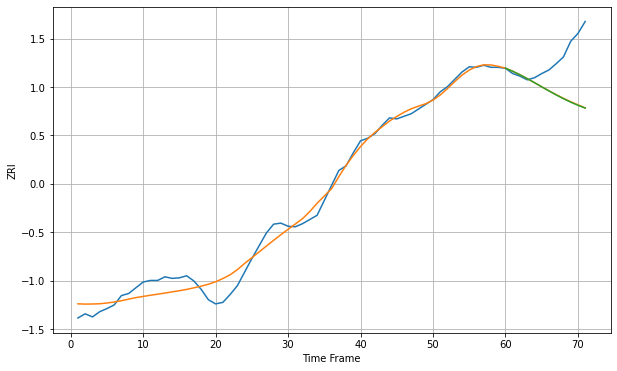

Wall time: 6.5 s
95207 18.170243714450883 77.43058190101392 77.85835577368137 [1240.41720838 1234.40646368 1227.66179409 1220.30700495 1212.54022045
 1204.55025139 1196.69219158 1189.04673482 1181.79998352 1175.11475768
 1169.1018337  1163.73308502]

Got an mse at 0.0099 in round 43 and stopped training

71 71 12


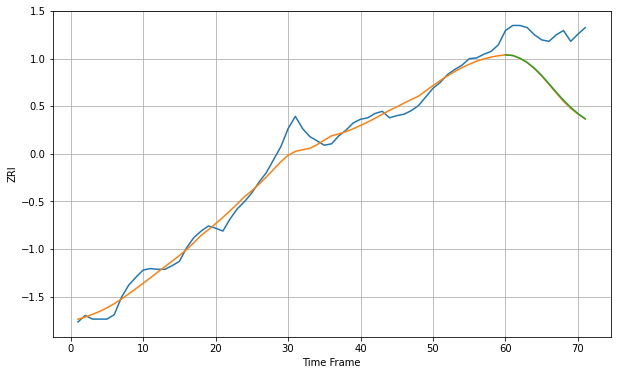

Wall time: 6.25 s
95608 12.891360770378082 75.63161468698758 74.92818079220528 [1412.26857138 1411.38078327 1407.5545973  1401.6887321  1393.65189032
 1383.65662211 1372.35067771 1360.66867834 1349.51857136 1339.51705917
 1330.90854649 1323.55825402]

Got an mse at 0.0096 in round 31 and stopped training

71 71 12


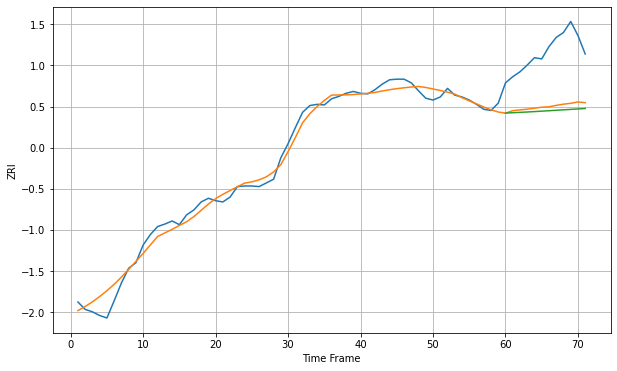

Wall time: 6.07 s
95678 12.832890603673059 90.68773948202926 97.69445044715616 [1651.71480205 1652.38359987 1652.92133398 1653.52977086 1654.19716512
 1654.89928366 1655.61778544 1656.34180928 1657.06635638 1657.79001478
 1658.51301027 1659.23591505]

Got an mse at 0.0094 in round 39 and stopped training

71 71 12


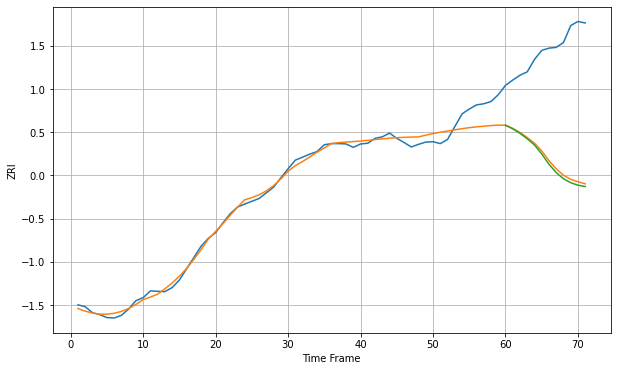

Wall time: 6.37 s
95816 21.871229903782066 296.42573296415713 303.2336476181518 [1385.95694392 1376.26006329 1364.42170029 1349.86135279 1333.3500314
 1309.36420479 1282.00502802 1259.78156714 1243.58990897 1232.83089391
 1226.33433374 1222.82271813]

Got an mse at 0.0096 in round 24 and stopped training

71 71 12


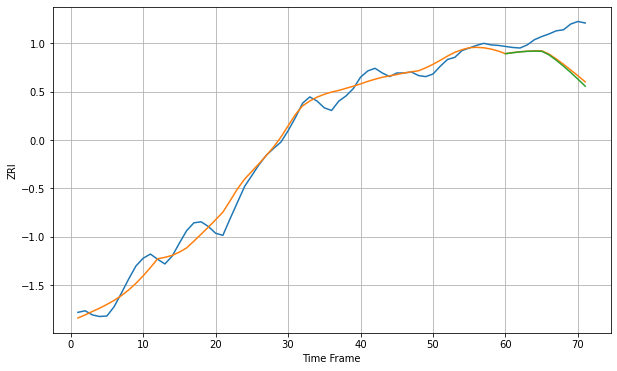

Wall time: 6.01 s
95826 17.450265191232443 59.1300345410392 62.681796383461005 [1426.09615284 1427.87969525 1429.51810085 1430.59092005 1431.04424216
 1430.72484078 1423.8449962  1413.5979973  1402.21118052 1389.96544691
 1377.04796169 1363.62876291]

Got an mse at 0.0099 in round 39 and stopped training

71 71 12


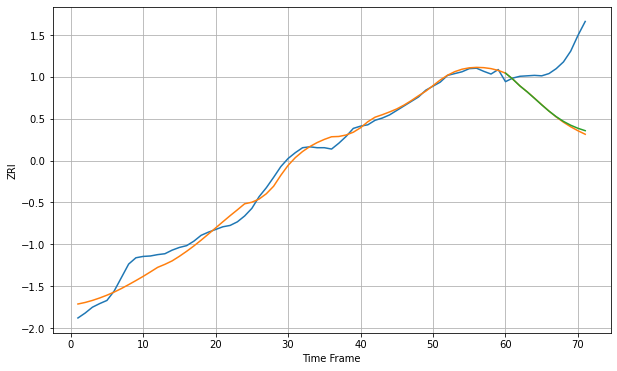

Wall time: 5.99 s
95831 17.931772752671343 123.10563984964526 120.38989272686865 [1554.01707948 1540.71083937 1525.3656226  1512.19809965 1497.91084858
 1483.34509906 1469.47306564 1457.08315963 1446.58540362 1438.02424352
 1431.21788281 1425.8946388 ]

Got an mse at 0.0100 in round 33 and stopped training

71 71 12


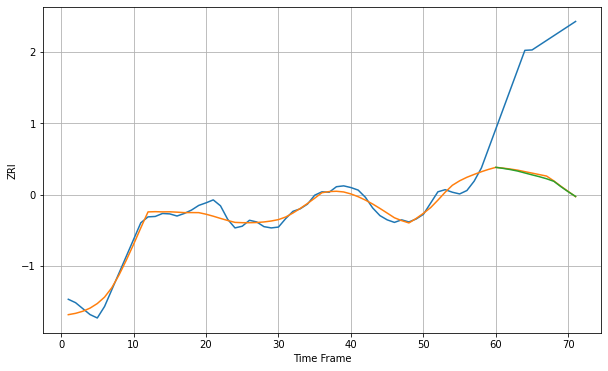

Wall time: 5.64 s
95928 16.561417303384463 295.9135459481405 297.9407241092853 [1394.5896173  1392.13846121 1389.33641698 1385.87754074 1381.37989894
 1376.88618511 1372.58497439 1367.70164278 1361.6989211  1348.79887188
 1336.92362884 1326.10032631]

Got an mse at 0.0099 in round 68 and stopped training

71 71 12


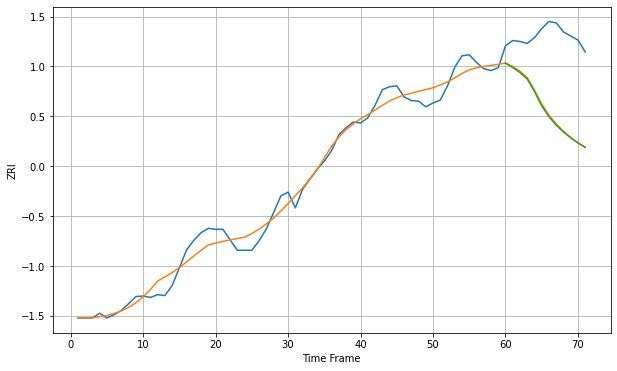

Wall time: 5.99 s
96150 20.767425385195857 160.64435109617568 162.07055133175206 [1662.55652129 1653.45213255 1642.72678105 1629.34448523 1602.93389331
 1572.86589615 1550.11150896 1532.51396888 1518.22011753 1506.09180175
 1495.49956719 1486.44959875]

Got an mse at 0.0099 in round 121 and stopped training

71 71 12


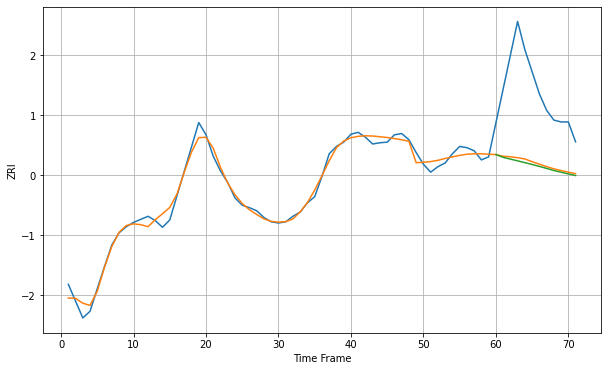

Wall time: 6.54 s
96826 9.72141649295879 125.36388503040222 128.85823080548946 [1536.79004346 1532.19724172 1529.32899464 1526.47642475 1523.56502253
 1520.56065052 1517.42422437 1514.13159928 1510.69696779 1507.88681566
 1505.19133042 1502.48002016]

Got an mse at 0.0098 in round 47 and stopped training

71 71 12


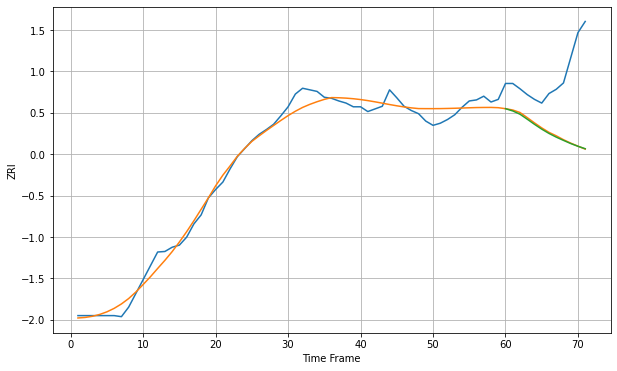

Wall time: 5.25 s
97030 15.256628509749634 118.03594240370215 118.82479031929944 [1349.43541871 1345.1775716  1339.00826133 1329.60402724 1319.93694496
 1310.83493111 1302.74383861 1295.78972851 1289.62650085 1283.67568262
 1278.48879387 1273.90059942]

Got an mse at 0.0099 in round 37 and stopped training

71 71 12


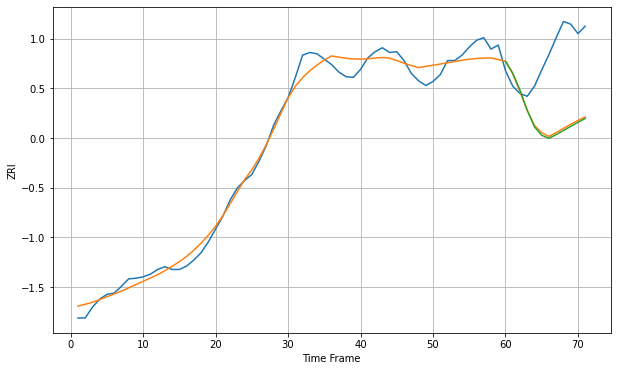

Wall time: 5.03 s
97035 14.496519309744594 103.97271492618809 106.27054352421466 [1566.87766477 1549.21635    1524.05459025 1494.32282918 1469.61207643
 1456.98683075 1452.54519465 1458.16018872 1464.21021592 1470.31176554
 1476.29201871 1482.11758388]

Got an mse at 0.0100 in round 72 and stopped training

71 71 12


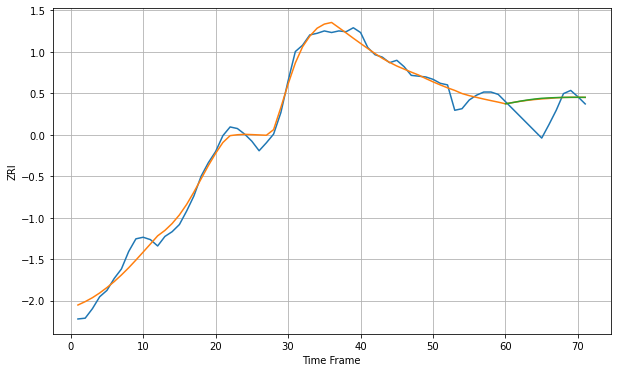

Wall time: 5.71 s
97062 10.385130311637546 23.7355280954116 24.09685205888222 [1444.1310649  1445.71364315 1447.44225733 1448.92757248 1450.14433941
 1451.09522156 1451.62767098 1451.98021462 1452.21036101 1452.33100746
 1452.35463552 1452.29298113]

Got an mse at 0.0096 in round 34 and stopped training

71 71 12


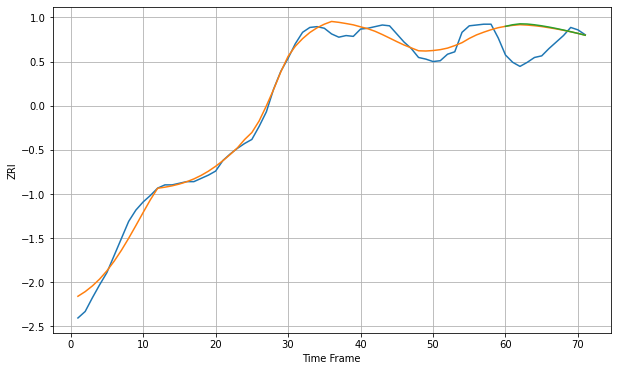

Wall time: 5.01 s
97070 10.312197122509268 31.52001796960794 32.208767815244244 [1388.39016909 1390.32820042 1391.47038022 1391.2139094  1390.28469671
 1389.01912159 1387.48234204 1385.72829006 1383.80530808 1381.75584439
 1379.61604308 1377.41546532]

Got an mse at 0.0099 in round 55 and stopped training

71 71 12


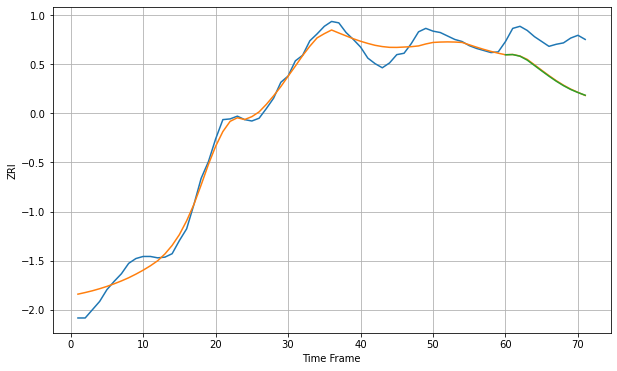

Wall time: 6.26 s
97124 13.934749986551285 54.722002905096936 55.18236654583727 [1490.82026587 1491.09754918 1488.74020364 1483.06020648 1475.27282052
 1467.42956465 1459.78729101 1452.59882479 1446.12837707 1440.59851975
 1436.13537998 1432.26102144]

Got an mse at 0.0099 in round 125 and stopped training

71 71 12


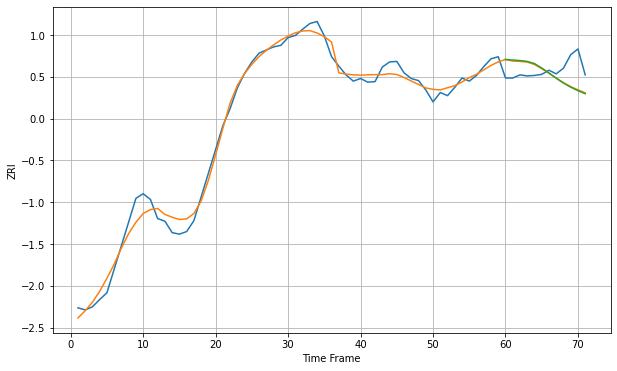

Wall time: 7.56 s
97209 15.880812726189081 36.976158242676014 37.978328124090176 [1762.79684844 1761.63411955 1760.63971423 1758.98907352 1754.7374634
 1746.21415045 1736.75901148 1726.64796975 1717.44065414 1709.41910132
 1702.56674659 1696.73642602]

Got an mse at 0.0099 in round 115 and stopped training

71 71 12


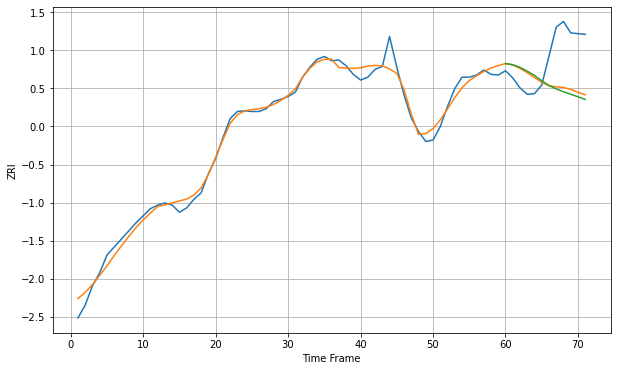

Wall time: 6.77 s
97214 10.526361418835547 57.71247694033935 61.46064776624514 [1590.08404099 1588.58616505 1584.66013419 1579.5036022  1573.48574268
 1565.97225524 1559.43521899 1554.5439372  1550.65450859 1547.12403418
 1543.59198076 1539.92167752]

Got an mse at 0.0098 in round 45 and stopped training

71 71 12


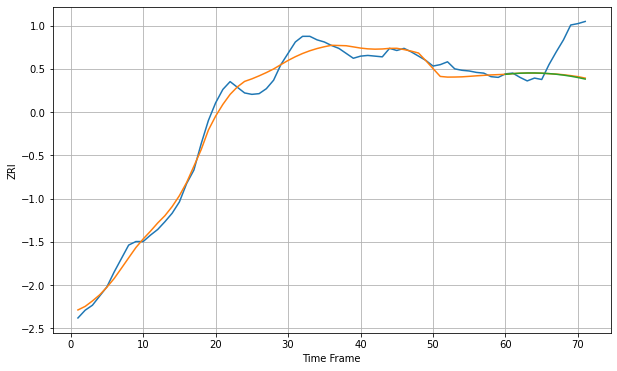

Wall time: 5.53 s
97229 11.981251369195038 41.83469047849362 42.43700079435191 [1442.31371122 1443.26864917 1443.86975622 1444.19878273 1444.23080496
 1443.94895911 1443.34606329 1442.42226244 1441.18138537 1439.62728955
 1437.76180605 1435.58559116]

Got an mse at 0.0099 in round 115 and stopped training

71 71 12


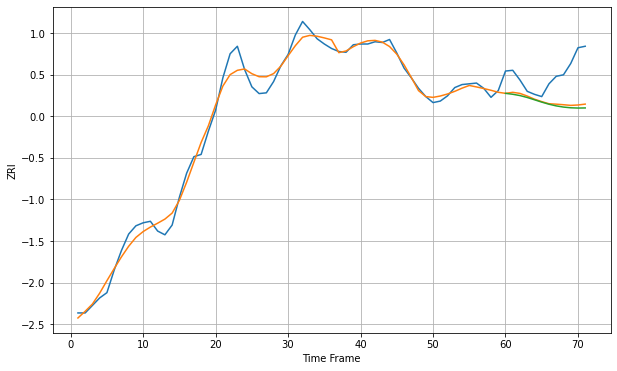

Wall time: 6.84 s
97239 10.987667012515685 41.51878080764176 44.0533752508601 [1607.3011403  1606.09365788 1604.34453982 1601.8064879  1598.76331359
 1595.6429565  1592.84300286 1590.61250073 1589.03843236 1588.10226583
 1587.74111207 1587.88375281]

Got an mse at 0.0099 in round 73 and stopped training

71 71 12


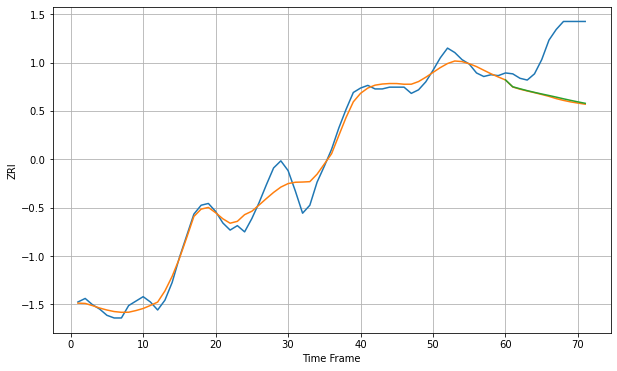

Wall time: 5.8 s
97401 10.783239549893043 61.86485826046589 60.81783011651785 [1273.10164052 1265.43937037 1263.19651784 1261.06048639 1259.1261826
 1257.31921371 1255.59928613 1253.78984293 1251.89673287 1250.10990907
 1248.41419036 1246.79664651]

Got an mse at 0.0100 in round 38 and stopped training

71 71 12


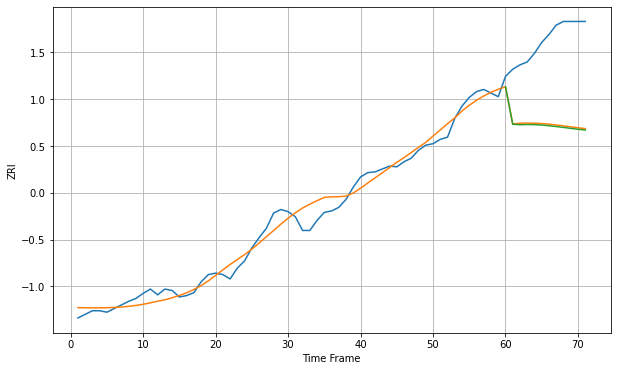

Wall time: 5.13 s
97402 12.742648431178669 116.03856931391749 117.88800977298321 [1132.74723536 1080.89841327 1080.23713422 1080.51288522 1080.33383245
 1079.74641429 1078.84401181 1077.72306222 1076.47969742 1075.20456196
 1073.97546234 1072.85061469]

Got an mse at 0.0099 in round 234 and stopped training

71 71 12


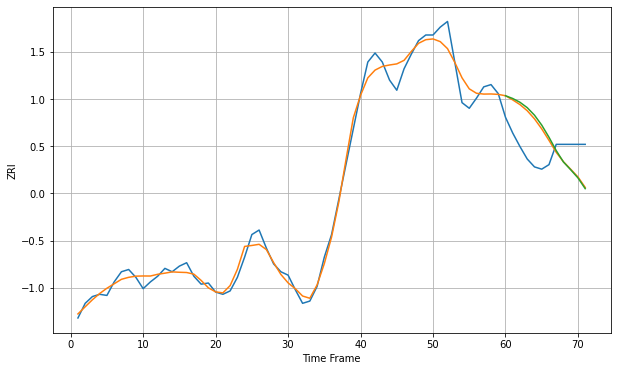

Wall time: 8.49 s
97477 8.325308696591465 30.38708321365872 32.09473467797751 [1089.11406776 1086.66220204 1083.2997642  1078.53602735 1071.88220008
 1063.06278508 1052.30986336 1040.48249985 1030.33935484 1023.45119211
 1016.22616578 1006.69772295]

Got an mse at 0.0099 in round 62 and stopped training

71 71 12


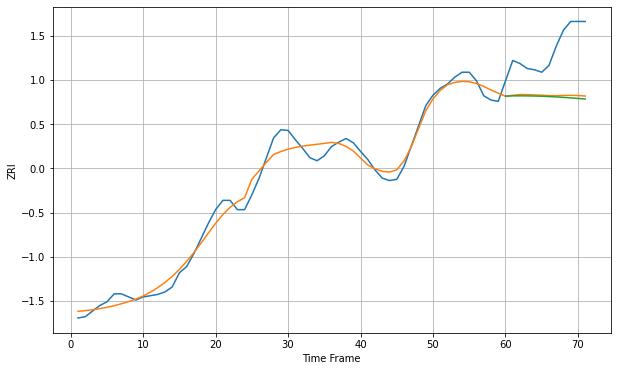

Wall time: 5.54 s
97501 14.073872287915453 78.5661421274196 81.29933573201372 [1111.27960209 1111.80467119 1111.86568899 1111.77783801 1111.56163527
 1111.2099803  1110.71688453 1110.08835546 1109.34421249 1108.51426825
 1107.63189994 1106.72760033]

Got an mse at 0.0100 in round 107 and stopped training

71 71 12


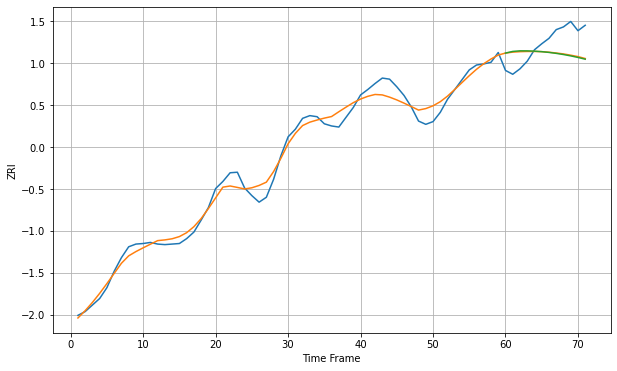

Wall time: 6.26 s
98004 15.287915353407564 39.77357351261096 40.7110935563603 [2291.92260089 2294.95000656 2296.04603349 2295.9783189  2295.44229667
 2294.48534946 2293.12647591 2291.37955019 2289.25498677 2286.76050534
 2283.90186506 2280.68364161]

Got an mse at 0.0100 in round 88 and stopped training

71 71 12


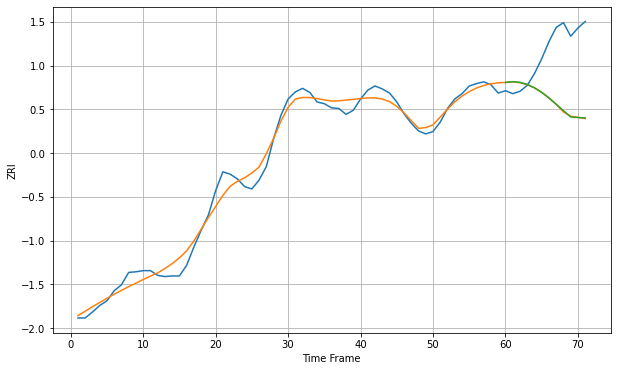

Wall time: 5.97 s
98005 14.654966701810928 100.5719848880779 100.3203862840823 [1973.96105735 1975.31408309 1974.09481474 1970.60300844 1964.85367029
 1957.05011803 1947.61934517 1937.16118601 1926.31771044 1915.63489318
 1914.70614445 1914.03207327]

Got an mse at 0.0098 in round 49 and stopped training

71 71 12


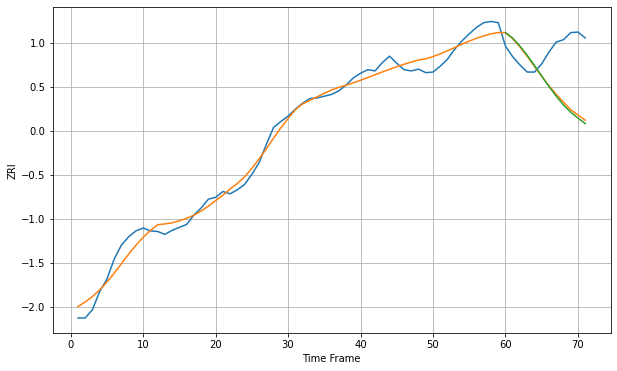

Wall time: 5.31 s
98012 14.613396579149022 83.0527192431055 86.12977590750234 [1800.09888923 1790.5516797  1777.13275347 1761.40329322 1744.084879
 1726.12860953 1708.42258077 1692.09061793 1676.99089632 1664.78762936
 1654.6833147  1645.39569108]

Got an mse at 0.0100 in round 132 and stopped training

71 71 12


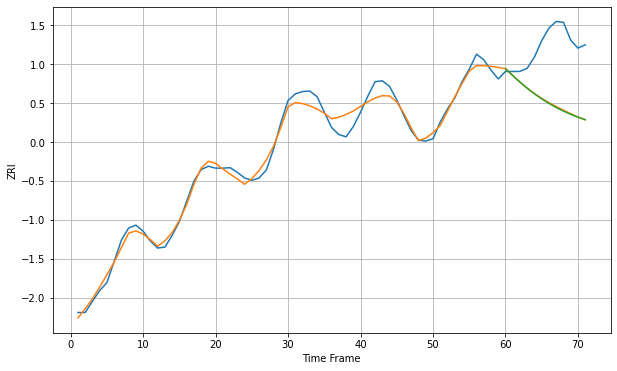

Wall time: 6.74 s
98029 16.45471605911695 125.9054099139521 126.85926061973795 [2126.99357781 2112.18704469 2098.08907342 2084.97008477 2073.05245362
 2062.27646034 2052.5618011  2043.8403549  2036.05671548 2029.15777256
 2023.08388943 2017.76590546]

Got an mse at 0.0099 in round 58 and stopped training

71 71 12


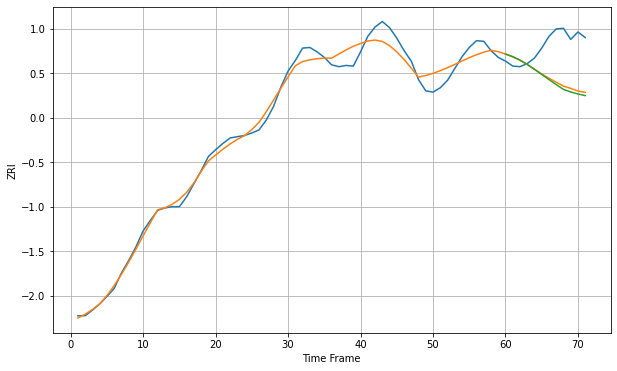

Wall time: 5.44 s
98034 14.179214608749518 62.17043829992492 65.37940047419654 [1843.47616897 1839.16797859 1833.59989089 1826.72833065 1818.73448233
 1810.44185808 1802.21927962 1794.05742412 1786.28796337 1782.22403885
 1778.95130472 1776.33444841]

Got an mse at 0.0099 in round 115 and stopped training

71 71 12


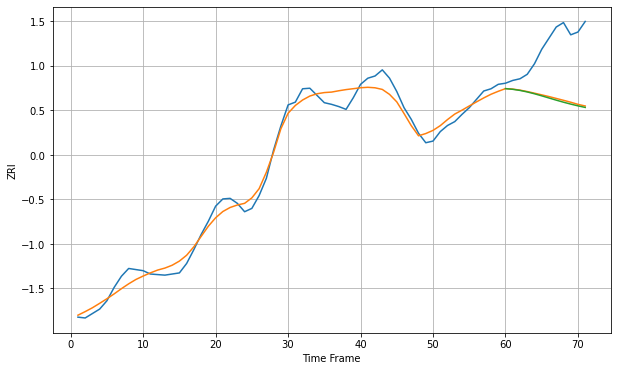

Wall time: 6.61 s
98052 15.724902061486855 96.99909609620184 99.17536811812717 [2111.29080493 2110.02902184 2108.05286425 2105.31485202 2102.00944271
 2098.31176303 2094.43041821 2090.56800125 2086.88103649 2083.45955791
 2080.33033435 2077.47464329]

Got an mse at 0.0097 in round 29 and stopped training

71 71 12


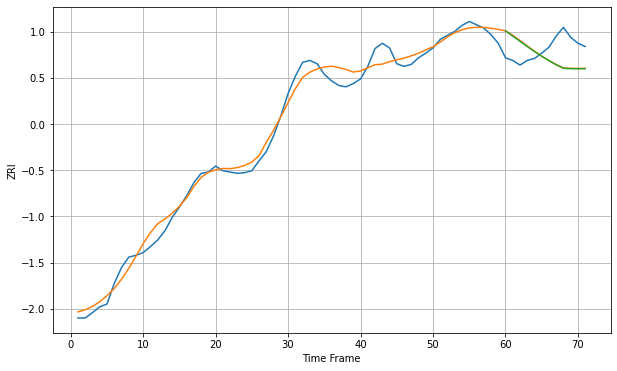

Wall time: 4.95 s
98056 13.526177388851256 36.402259363404 36.40078410384246 [1674.79799784 1666.74525264 1659.02980055 1651.15446397 1643.50943946
 1636.32954976 1629.61232231 1623.44121648 1618.07241133 1617.58245496
 1617.47459103 1617.43046756]

Got an mse at 0.0100 in round 40 and stopped training

71 71 12


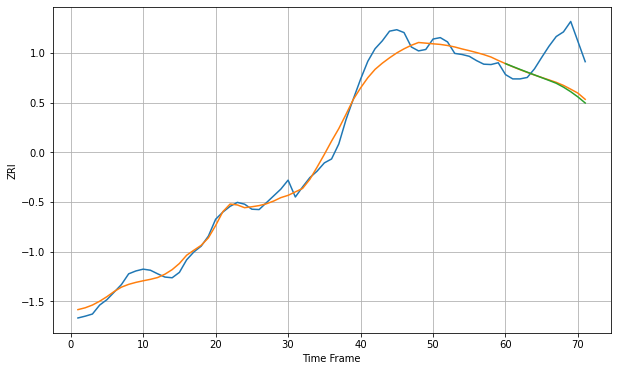

Wall time: 5.15 s
98101 26.4576827828654 100.40161895886428 104.71213096872437 [2598.5414437  2590.48844387 2582.53697756 2574.76558208 2567.11343083
 2559.49381008 2551.79682487 2543.88801294 2533.0347669  2520.31044421
 2505.68863452 2488.89775799]

Got an mse at 0.0098 in round 154 and stopped training

71 71 12


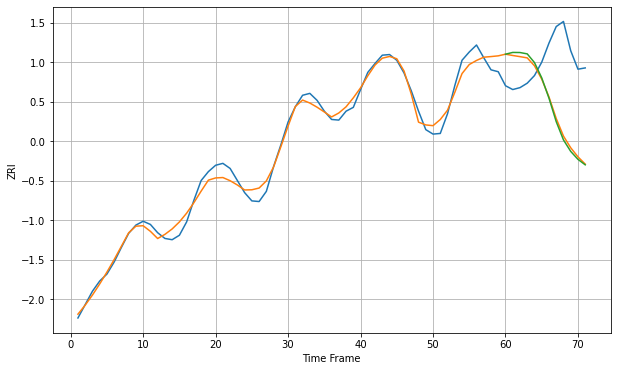

Wall time: 7.11 s
98102 12.185675213920836 106.36486072114883 109.86485826780853 [2041.56882268 2044.33450108 2044.18485417 2042.05708918 2028.38524817
 2004.35429641 1972.40932223 1935.53815231 1906.84613674 1888.7894489
 1876.30800741 1867.69563136]

Got an mse at 0.0098 in round 78 and stopped training

71 71 12


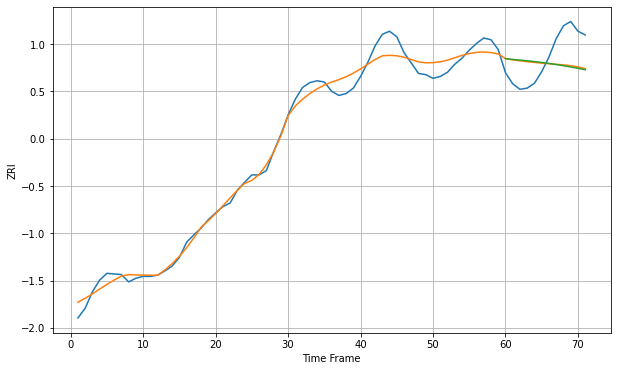

Wall time: 5.87 s
98103 15.21503477890705 45.74963240718065 47.02121161970994 [1914.15754245 1912.87043319 1911.86577561 1910.72672424 1909.42826806
 1907.96509634 1906.33923133 1904.55821462 1902.63314146 1900.57645028
 1898.39975514 1896.11201789]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


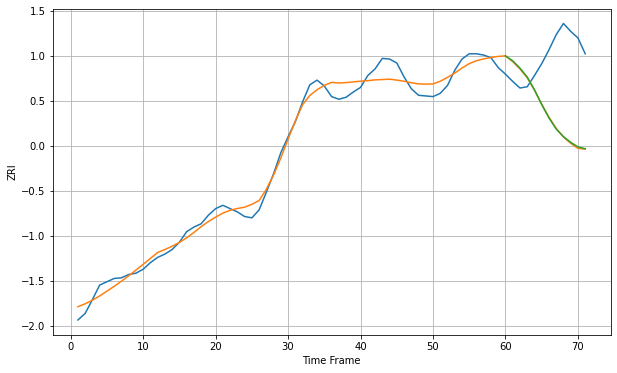

Wall time: 5.62 s
98105 13.576816938937222 110.00434851740023 109.68467441190064 [1846.82384381 1839.2655134  1828.23277312 1814.60430578 1795.31511926
 1772.903392   1752.53523975 1735.75545672 1724.2528473  1715.60474464
 1708.69645078 1705.91585709]

Got an mse at 0.0100 in round 137 and stopped training

71 71 12


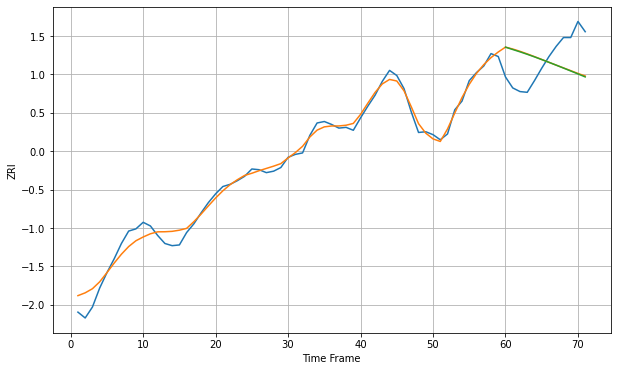

Wall time: 6.73 s
98107 10.33246702958689 45.45124336132808 45.523985360532144 [1976.84497862 1973.58979865 1970.42218466 1967.05122254 1963.51247472
 1959.83498868 1956.04563884 1952.16765924 1948.21977282 1944.21596614
 1940.1660037  1936.07667691]

Got an mse at 0.0099 in round 66 and stopped training

71 71 12


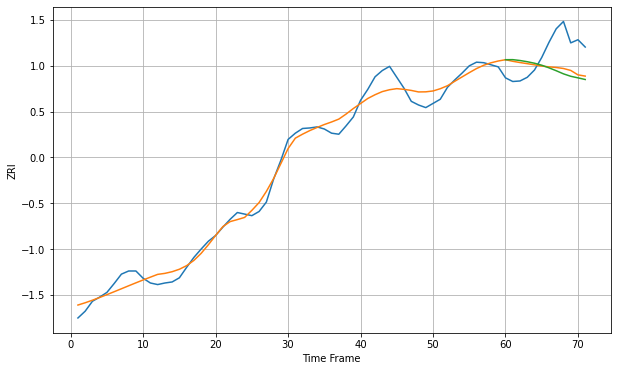

Wall time: 5.56 s
98109 17.38376275406909 51.022581344272744 56.26477642462033 [2094.74180218 2094.86481899 2093.21001331 2090.8974049  2087.99749351
 2084.17001673 2079.17243143 2073.62537076 2067.64672037 2063.00894532
 2059.98242717 2056.81087339]

Got an mse at 0.0099 in round 122 and stopped training

71 71 12


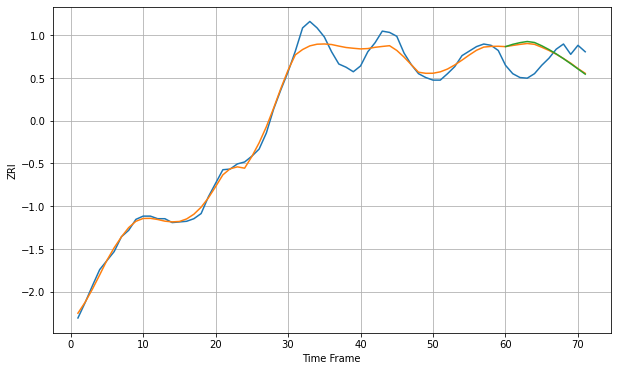

Wall time: 6.47 s
98115 13.14261953199658 34.73777300349567 36.34855580470754 [1866.99229623 1870.52999228 1873.13132478 1874.9201948  1873.3641177
 1868.34405787 1862.43306987 1855.71349171 1848.27122205 1840.43853831
 1832.38072696 1824.24409684]

Got an mse at 0.0099 in round 111 and stopped training

71 71 12


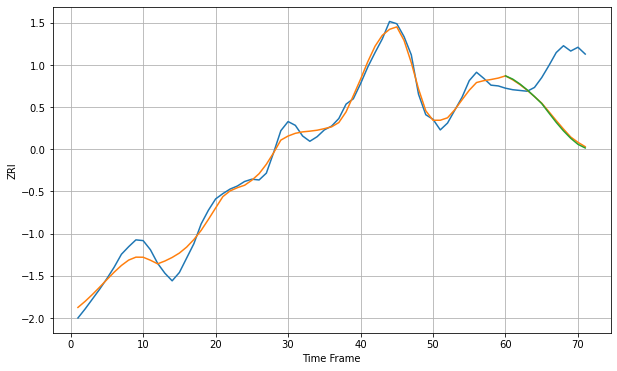

Wall time: 6.32 s
98119 10.995457889995084 75.87675273747675 77.35796149876985 [1908.25547418 1903.97258388 1897.48081063 1889.71696303 1880.99759965
 1871.74405036 1859.22085625 1846.93587782 1835.76384901 1825.97047293
 1818.00521799 1813.18261939]

Got an mse at 0.0100 in round 77 and stopped training

71 71 12


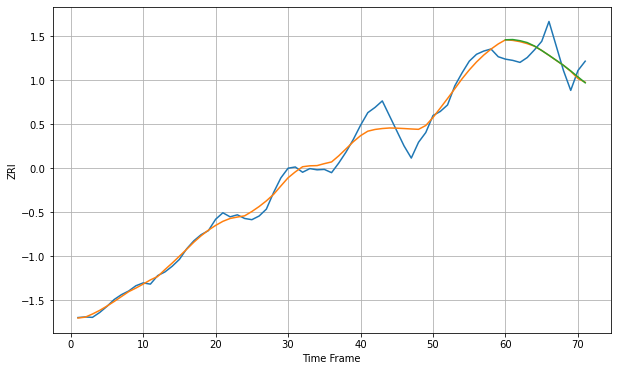

Wall time: 5.75 s
98121 21.585889738525285 43.60680980031176 44.278590640237454 [2359.77516278 2360.38907483 2357.55763865 2352.89408983 2344.35845625
 2333.33135277 2321.51428969 2309.21457036 2296.74574022 2283.01331551
 2268.28749481 2253.67799202]

Got an mse at 0.0100 in round 91 and stopped training

71 71 12


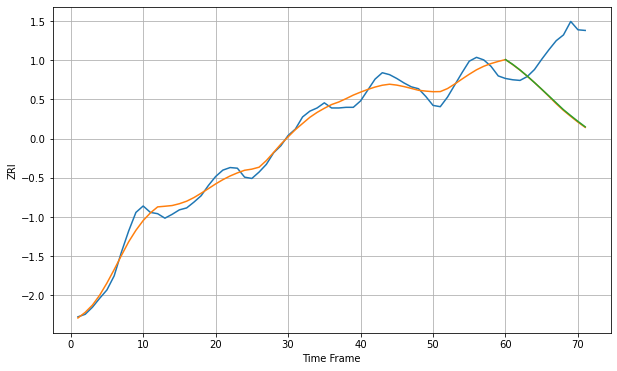

Wall time: 6.01 s
98122 12.123925779677672 90.73796092880399 90.01773733374202 [1918.53129944 1911.01871708 1902.32614301 1892.74285195 1882.61657589
 1872.21320876 1861.65515317 1850.98154587 1840.3197429  1831.04413847
 1822.06616128 1813.56399958]

Got an mse at 0.0099 in round 33 and stopped training

71 71 12


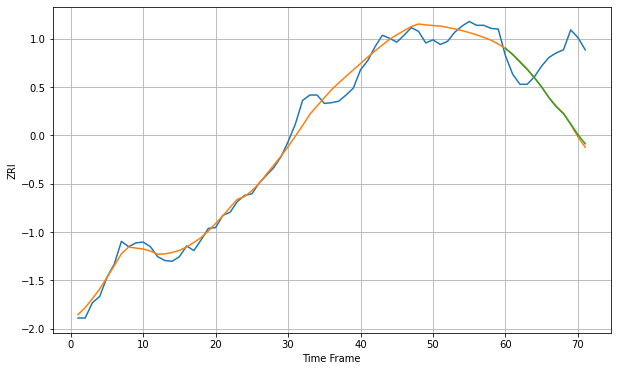

Wall time: 4.96 s
98133 12.47383822641864 73.83856686467286 72.80560817179712 [1740.84202758 1732.66949063 1722.88123562 1713.2242032  1702.64019895
 1690.30430611 1676.29429629 1664.63303988 1655.53804197 1642.20276708
 1628.2280034  1616.38721034]

Got an mse at 0.0099 in round 122 and stopped training

71 71 12


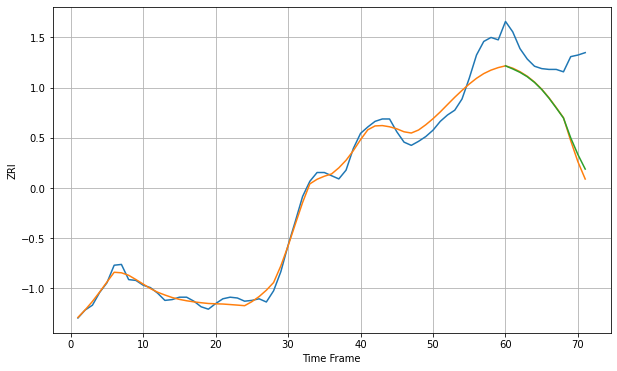

Wall time: 6.5 s
98201 12.319714089756426 75.44782772844607 71.73209249606785 [1438.47529504 1434.61132274 1430.32983887 1424.87706841 1417.78881809
 1408.8654756  1398.05071695 1385.81191868 1373.17564766 1348.38208739
 1327.35145804 1309.30096071]

Got an mse at 0.0098 in round 25 and stopped training

71 71 12


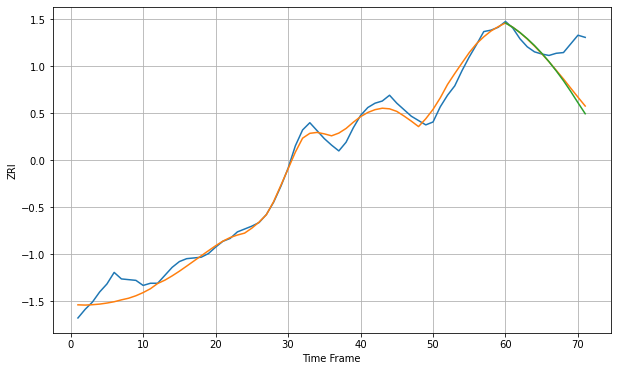

Wall time: 4.85 s
98203 12.683515862907694 43.12667358262444 47.11750014554248 [1538.94226847 1533.00009457 1525.64733034 1517.23820739 1507.74201901
 1497.12994495 1485.41061613 1472.66481815 1459.08722981 1444.29255973
 1428.66182002 1413.42049314]

Got an mse at 0.0091 in round 37 and stopped training

71 71 12


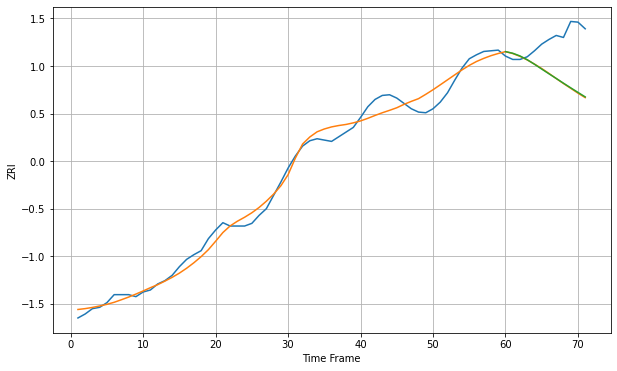

Wall time: 5.07 s
98204 12.997163299093405 61.631915900115274 61.242331091484 [1448.74612663 1446.30366398 1442.23566411 1436.56840544 1429.77394185
 1422.54523842 1415.44065019 1408.48489962 1401.35793313 1394.40465352
 1387.55328655 1380.79498678]

Got an mse at 0.0098 in round 54 and stopped training

71 71 12


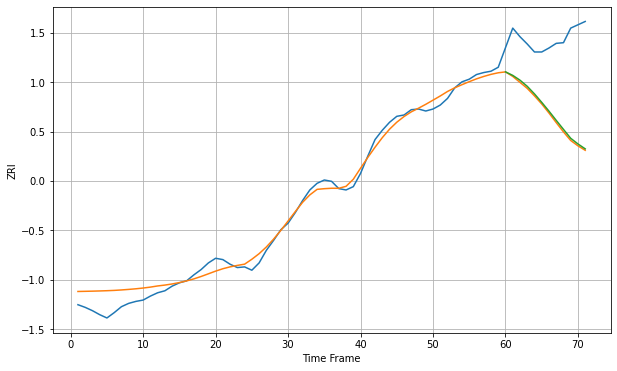

Wall time: 5.36 s
98405 13.967409677881813 118.36337691265389 115.80690033004367 [1235.9878252  1230.72614476 1223.48612646 1214.2114679  1202.78905597
 1190.05762613 1176.79234919 1162.89267904 1149.31509094 1135.84103772
 1127.33048003 1119.94804034]

Got an mse at 0.0099 in round 28 and stopped training

71 71 12


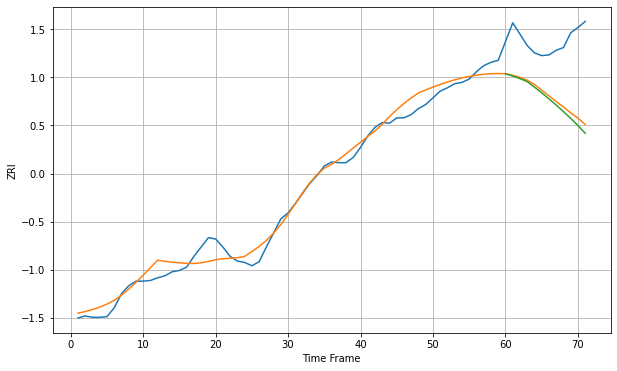

Wall time: 4.92 s
98409 14.06130587919982 88.49595561936601 94.68407403639448 [1245.94718937 1242.42506517 1238.60962104 1233.99433371 1225.96570528
 1217.31955179 1208.3311278  1199.02667206 1189.34425718 1179.17493725
 1168.40626213 1156.96851005]

Got an mse at 0.0090 in round 36 and stopped training

71 71 12


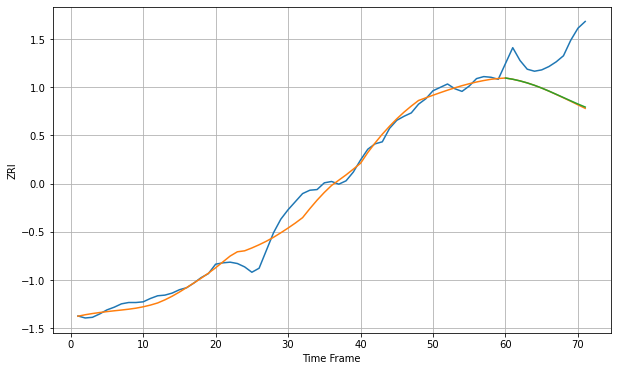

Wall time: 5.05 s
98444 12.99925352710343 65.01150342789298 64.38328039886916 [1227.8726626  1226.05730606 1223.62935947 1220.60970251 1217.02838353
 1212.9378225  1208.41982682 1203.66405147 1198.83582246 1193.97318393
 1189.22650224 1184.72366385]

Got an mse at 0.0096 in round 31 and stopped training

71 71 12


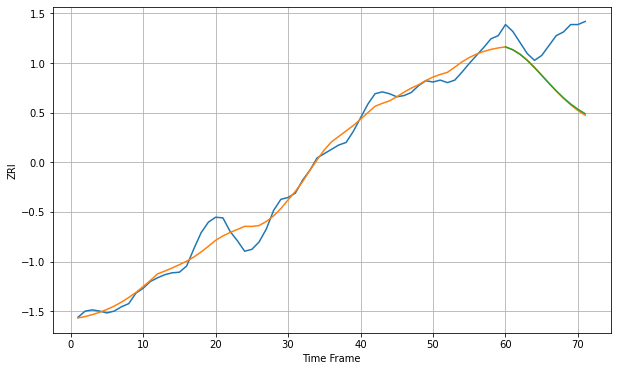

Wall time: 5 s
98466 15.501055274216153 84.86079530257074 83.99945431893421 [1374.85186542 1370.16130536 1362.74472587 1353.02124383 1341.40613702
 1328.72768498 1315.89116187 1303.59793354 1292.31341929 1282.3295638
 1273.7795174  1266.62778757]

Got an mse at 0.0100 in round 64 and stopped training

71 71 12


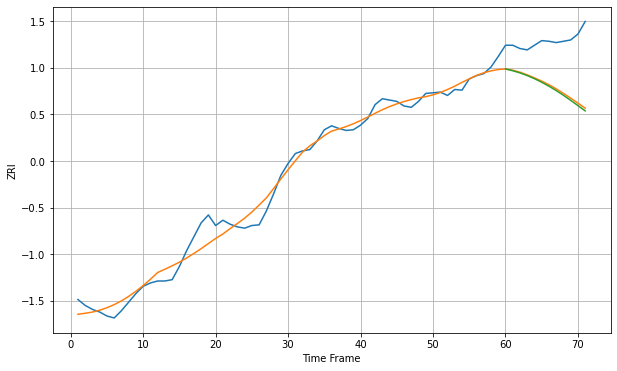

Wall time: 5.53 s
98498 14.05344919164414 72.50452535371332 74.86440387005008 [1367.10251799 1364.36321133 1361.11890455 1357.08742707 1352.34115865
 1346.94516461 1340.93704547 1334.33950283 1327.18496029 1319.54760707
 1311.58655177 1303.59227253]

Got an mse at 0.0096 in round 33 and stopped training

71 71 12


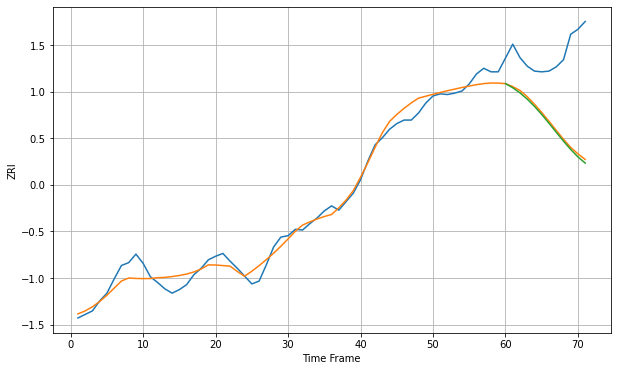

Wall time: 5.22 s
98499 12.609388055835788 105.70043512899538 108.5805333338061 [1263.38276004 1257.55052864 1250.30807501 1241.51836716 1231.30263472
 1219.86872231 1207.55099673 1194.84230352 1182.34956136 1170.51084419
 1160.06428983 1151.3283694 ]

Got an mse at 0.0098 in round 38 and stopped training

71 71 12


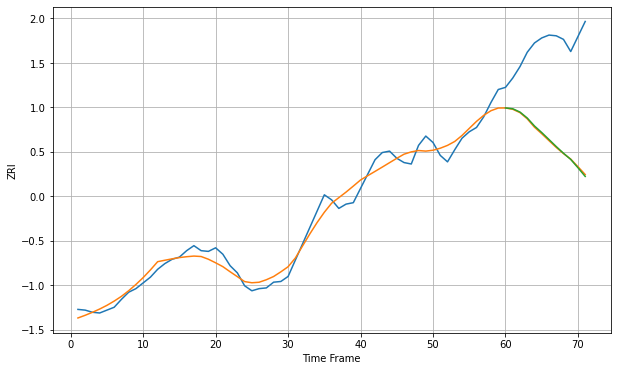

Wall time: 5.09 s
99207 12.074174434734248 135.3741144906482 135.2408791731143 [1000.24886463  999.14979518  994.50379884  986.22760422  975.08606351
  965.93425855  956.19759889  946.38113967  937.06679845  928.4072462
  916.76199568  904.6493642 ]

Got an mse at 0.0099 in round 169 and stopped training

71 71 12


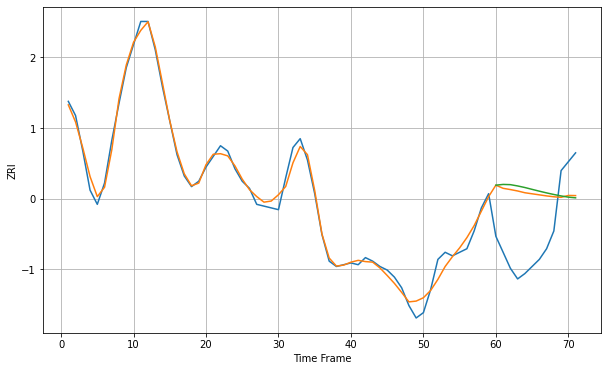

Wall time: 7.33 s
99501 3.9378443294137213 34.20322570325156 36.072737505999456 [1271.80282903 1272.21440655 1272.08921114 1271.36388748 1270.47625445
 1269.43627651 1268.41246709 1267.44226459 1266.54569959 1265.73334221
 1265.05618366 1264.67443485]

Got an mse at 0.0100 in round 180 and stopped training

71 71 12


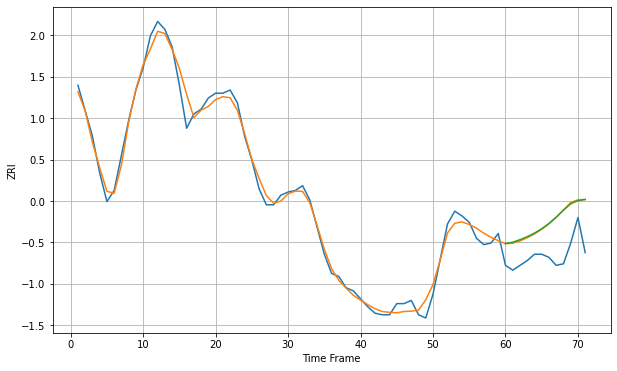

Wall time: 7.49 s
99504 5.160394058617986 21.768090926610874 21.868731087703573 [1429.63050847 1430.53617616 1432.1021114  1433.98781557 1436.24664465
 1438.98311245 1442.30077202 1446.23182295 1450.65688326 1454.64801911
 1456.55953201 1457.33529829]

Got an mse at 0.0098 in round 228 and stopped training

71 71 12


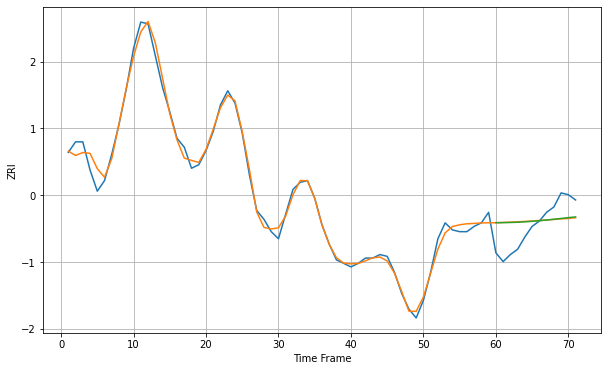

Wall time: 8.28 s
99508 3.7546235260502514 12.996575122392644 12.811626629121639 [1273.08049303 1273.11892646 1273.19730211 1273.35237698 1273.58028211
 1273.87382441 1274.22333437 1274.61805669 1275.04757343 1275.50302698
 1275.97792726 1276.37598648]

Got an mse at 0.0099 in round 267 and stopped training

71 71 12


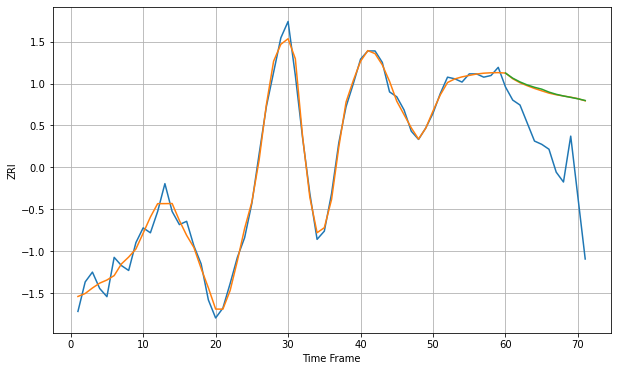

Wall time: 8.94 s
99654 5.102229916771458 43.53272097685171 43.773117913164285 [1337.50707686 1334.38462535 1332.09256237 1330.25949566 1328.82556127
 1327.67980831 1325.88621854 1324.53526031 1323.52372109 1322.66296538
 1321.7806523  1320.75214101]


In [13]:
score_dict = {"zip":[], "RMSE_train":[], "RMSE_test":[], "RMSE_pure":[], "forecast":[]};
with tf.device('/cpu:0'):
    for ZONE in zip_ids:
        %time M_train, M_test, M_pure, forecast = NN_test(ZONE, plot=True);
        print(ZONE, M_train, M_test, M_pure, forecast);

        score_dict["zip"].append(ZONE);
        score_dict["RMSE_train"].append(M_train);
        score_dict["RMSE_test"].append(M_test);
        score_dict["RMSE_pure"].append(M_pure);
        score_dict["forecast"].append(forecast);

In [14]:
print(len(score_dict["RMSE_pure"]), sum(score_dict["RMSE_test"])/len(score_dict["RMSE_test"]),
      sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]));

1301 63.22236963673596 64.82397703607413


In [15]:
test = pd.DataFrame(score_dict);
test.head()

,zip,RMSE_train,RMSE_test,RMSE_pure,forecast
0,1013,7.787344,60.326478,64.755036,"[1128.5242083599803, 1126.2132594817654, 1121...."
1,1020,8.011820,62.746003,64.622967,"[1125.178538921489, 1125.6636114389014, 1125.7..."
2,1040,6.351503,50.856523,51.897278,"[1105.8081653090233, 1097.3023269063212, 1097...."
3,1085,7.698012,46.951040,51.700116,"[1168.3387662201956, 1164.9936184271276, 1160...."
4,1104,7.879132,66.083153,65.604066,"[1124.3109460499472, 1097.5461801054676, 1096...."


In [16]:
test.to_csv('NN_feature_window_1.csv', index = False)